In [1]:
# load required packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
import datetime
%matplotlib inline

from skimage.measure import compare_ssim
from sklearn.model_selection import train_test_split

# load required functionality from keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Reshape
from keras.layers import Conv2D, MaxPooling2D, Conv2DTranspose, AveragePooling2D
from keras.models import Model
from keras.layers import Lambda
from keras.layers import Input
from keras.layers import UpSampling2D, LeakyReLU
from keras.layers import concatenate
from keras.layers import BatchNormalization
from keras.layers import Activation
from keras.layers import Add, Subtract
from keras.callbacks import ModelCheckpoint, EarlyStopping, History 
from keras.optimizers import RMSprop, Adadelta, Adam
from keras.utils import np_utils
from keras import backend as keras_backend


from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())
keras_backend.tensorflow_backend._get_available_gpus()

Using TensorFlow backend.


[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 6521619311272902052
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 6602251960
locality {
  bus_id: 1
  links {
  }
}
incarnation: 12063247702298233137
physical_device_desc: "device: 0, name: GeForce RTX 2070 SUPER, pci bus id: 0000:06:00.0, compute capability: 7.5"
]


['/job:localhost/replica:0/task:0/device:GPU:0']

In [2]:
"""
    Peak Signal-to-Noise Ratio:
         > 40dB: great
        30~40dB: good
        20~30dB: bad
         < 20dB: worse
"""
def PSNR(y_true, y_pred):
    return -10. * np.log10(np.mean(np.square(y_pred - y_true)))

def SSIM(img1, img2, _range=None, multichannel=False):
    return compare_ssim(img1, img2, data_range=_range, multichannel=multichannel)

def printHistory(history): 
    print(history.history.keys())
    # summarize history for accuracy
    plt.plot(history.history['acc'])
    plt.plot(history.history['val_acc'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()
    # summarize history for loss 
    plt.plot(history.history['loss']) 
    plt.plot(history.history['val_loss']) 
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()

In [3]:
"""
    load training data
"""
import gc

dataY = np.zeros((4000,512, 512))

count = 0
for i in range(1, 801):
    picture = f'{i:#04d}'
    img = cv2.imread("../../div2k_train_gray/" + picture + ".png", cv2.IMREAD_GRAYSCALE)
    dataY[count] = img
    dataY[count+1] = img
    dataY[count+2] = img
    dataY[count+3] = img
    dataY[count+4] = img
    count += 5
                 
dataY = dataY.reshape(-1, 512, 512, 1)
dataY = dataY.astype('float32') / 255

In [4]:
"""
    noise image
"""
X = np.zeros((4000,512, 512))
count = 0
for i in range(1, 801):
    picture = f'{i:#04d}'
    img = cv2.imread("../../div2k_train_gray_out/" + picture + "_out50.png", cv2.IMREAD_GRAYSCALE)
    X[count] = img
    img = cv2.imread("../../div2k_train_gray_out/" + picture + "_out60.png", cv2.IMREAD_GRAYSCALE)
    X[count+1] = img
    img = cv2.imread("../../div2k_train_gray_out/" + picture + "_out70.png", cv2.IMREAD_GRAYSCALE)
    X[count+2] = img
    img = cv2.imread("../../div2k_train_gray_out/" + picture + "_out80.png", cv2.IMREAD_GRAYSCALE)
    X[count+3] = img
    img = cv2.imread("../../div2k_train_gray_out/" + picture + "_out90.png", cv2.IMREAD_GRAYSCALE)
    X[count+4] = img
    count += 5

X = X.reshape(-1, 512, 512, 1)
X = X.astype('float32') / 255
                 
X_train, X_test, y_train, y_test = train_test_split(X, dataY, test_size=0.3, random_state=41)

In [5]:
import keras.backend as K
from keras.losses import mean_squared_error, binary_crossentropy

def GANLoss_MSE(y_true, y_pred, label, pred):
    #return K.mean(K.square(y_pred - y_true), axis=-1) + DSSIMObjective(y_true, y_pred)
    return tf.losses.mean_squared_error(y_true, y_pred) + (0.3) * tf.losses.sigmoid_cross_entropy(label, pred)


In [6]:
"""
    GAN model
    
    https://github.com/daymos/simple_keras_GAN/blob/master/gan.py
    https://github.com/MathiasGruber/SRGAN-Keras
"""
class GAN(object):
    """ Generative Adversarial Network class """
    def __init__(self, width=512, height=512, channels=1, batch=8):

        self.width = width
        self.height = height
        self.channels = channels
        self.batch = batch

        self.shape = (self.width, self.height, self.channels)

        #self.optimizer = Adam(lr=0.0001, beta_1=0.5)
        self.optimizer = Adam(lr=0.0001)
    
        self.G = self.__generator()
        self.G.compile(loss='mean_squared_error', optimizer=self.optimizer)
        #self.G.load_weights("SRCNN_0415.h5")

        self.D = self.__discriminator()
        self.D.compile(loss='binary_crossentropy', optimizer=self.optimizer, metrics=['accuracy'])
        #self.D.load_weights("test_Discriminator_0040.h5")
        
        self.stacked_generator_discriminator = self.__stacked_generator_discriminator()
        #self.stacked_generator_discriminator.compile(loss='binary_crossentropy', optimizer=self.optimizer)
    
    def save_weights(self, epoch):
        """Save the generator and discriminator networks"""
        self.G.save_weights("gan5/_generator_{}.h5".format(epoch))
        #self.D.save_weights("gan/_discriminator_{}.h5".format(epoch))

    def load_weights(self, generator_weights=None, discriminator_weights=None, **kwargs):
        if generator_weights:
            self.G.load_weights(generator_weights, **kwargs)
        if discriminator_weights:
            self.D.load_weights(discriminator_weights, **kwargs)
        
    def __generator(self):
        """ Declare generator """

        model = Sequential()
        model.add(Conv2D(64, (3, 3), activation="relu",input_shape=self.shape ,padding="same"))
        model.add(Conv2D(64, (3, 3), activation="relu", padding="same"))
        model.add(Conv2D(64, (3, 3), activation="relu", padding="same"))
        model.add(Conv2D(64, (3, 3), activation="relu", padding="same"))
        model.add(Conv2D(1, (3, 3), activation="relu", padding="same"))
        
        print(model.summary())
        return model

    def __discriminator(self, filters=32):
        """ 
        Declare discriminator 
        """
        """
        model = Sequential()

        model.add(Conv2D(8, kernel_size=3, strides=1, input_shape=self.shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.4))
        model.add(Conv2D(16, kernel_size=3, strides=2, padding="same"))
        #model.add(ZeroPadding2D(padding=((0,1),(0,1))))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.4))
        model.add(Conv2D(32, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.4))
        model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.4))
        model.add(Flatten())
        model.add(Dense(1 , activation='sigmoid'))
        """
        def conv2d_block(input, filters, strides=1, bn=True):
            d = Conv2D(filters, kernel_size=3, strides=strides, padding='same')(input)
            d = LeakyReLU(alpha=0.2)(d)
            if bn:
                d = BatchNormalization(momentum=0.8)(d)
            return d
        """
        # Input high resolution image
        img = Input(shape=self.shape)
        x = conv2d_block(img, filters, bn=False)
        x = conv2d_block(x, filters, strides=2)
        x = conv2d_block(x, filters*2)
        x = conv2d_block(x, filters*2, strides=2)
        x = conv2d_block(x, filters*4)
        x = conv2d_block(x, filters*4, strides=2)
        x = conv2d_block(x, filters*8)
        x = conv2d_block(x, filters*8, strides=2)
        x = Flatten()(x)
        x = Dense(filters*16)(x)
        x = LeakyReLU(alpha=0.2)(x)ㄆ
        x = Dense(1 , activation='sigmoid')(x)
        
        """
        img = Input(shape=(512, 512, 1))
        x = Conv2D(filters, (3, 3), activation="relu")(img)
        x = Conv2D(filters, (3, 3), activation="relu")(x)
        x = Conv2D(filters, (3, 3), activation="relu")(x)
        x = MaxPooling2D()(x)
        x = Conv2D(filters*2, (3, 3), activation="relu")(x)
        x = Conv2D(filters*2, (3, 3), activation="relu")(x)
        x = Conv2D(filters*2, (3, 3), activation="relu")(x)
        x = MaxPooling2D()(x)
        x = Conv2D(filters*4, (3, 3), activation="relu")(x)
        x = Conv2D(filters*4, (3, 3), activation="relu")(x)
        x = Conv2D(filters*4, (3, 3), activation="relu")(x)
        x = MaxPooling2D()(x)
        x = Conv2D(filters*8, (3, 3), activation="relu")(x)
        x = Conv2D(filters*8, (3, 3), activation="relu")(x)
        x = Conv2D(filters*8, (3, 3), activation="relu")(x)
        x = MaxPooling2D()(x)
        x = Flatten()(x)
        x = Dense(128 , activation="relu")(x)
        x = Dense(1 , activation='sigmoid')(x)
       
        # Create model and compile
        model = Model(inputs=img, outputs=x)
        print(model.summary())
        return model

    def __stacked_generator_discriminator(self):
        """Create the combined GAN network"""

        # In the combined model we only train the generator
        self.D.trainable = False

        x_input = Input(shape=self.shape)
        y_true = Input(shape=self.shape, name='y_true' ) # 4000 * 0.7
        label = Input(shape=(1,))
        
        denoise = self.G(x_input)
        check = self.D(denoise)
        model = Model(inputs=[x_input, y_true, label], outputs=check)
        model.add_loss(GANLoss_MSE(y_true, denoise, label, check))
        model.compile(loss=None,
                  optimizer=self.optimizer,
                  metrics=['accuracy'])
        return model

    def train(self, X_train, Y_train, epochs=20000, batch = 8):
        # Each epoch == "update iteration" as defined in the paper        
        #print_losses = {"G": [], "D": []}
        start_time = datetime.datetime.now()
        
        for cnt in range(epochs):

            ## train discriminator
            #d_loss = 0
            #if cnt % 2 == 0:
            random_index = np.random.choice(len(Y_train), np.int64(batch))
            legit_images = Y_train[random_index]
            real_loss = self.D.train_on_batch(legit_images, np.ones((np.int64(batch), 1)))

            random_index = np.random.choice(len(X_train), np.int64(batch))
            noise_images = X_train[random_index]
            synthetic_images = self.G.predict(noise_images)
            fake_loss = self.D.train_on_batch(synthetic_images, np.zeros((np.int64(batch), 1)))
            
            #x_combined_batch = np.concatenate((legit_images, synthetic_images))
            #y_combined_batch = np.concatenate((np.ones((np.int64(batch/2), 1)), np.zeros((np.int64(batch/2), 1))))

            d_loss = 0.5 * np.add(real_loss, fake_loss)


            """
            real_loss = self.discriminator.train_on_batch(imgs_hr, real)
            fake_loss = self.discriminator.train_on_batch(generated_hr, fake)
            discriminator_loss = 0.5 * np.add(real_loss, fake_loss)
            """
            
            ## train generator
            random_index = np.random.choice(len(X_train), np.int64(batch))
            noise_images = X_train[random_index]
            legit_images = Y_train[random_index]
            # The generators want the discriminators to label the generated images as real
            y_mislabled = np.ones((batch, 1))
            
            #combined
            g_loss = self.stacked_generator_discriminator.train_on_batch(x=[noise_images, legit_images, y_mislabled], y=None)

            print ('epoch: %d, [Discriminator :: d_loss: %f], [ Generator :: loss: %f]' % (cnt, d_loss[0], g_loss))
            
            
            elapsed_time = datetime.datetime.now() - start_time
            # Plot the progress
            print ("%d time: %s" % (cnt, elapsed_time))
            if cnt % 100 == 0:
                self.save_weights(cnt)
                result = self.G.predict(X_train[:8], batch_size=8)
                result = result.reshape(-1, 512, 512)
                ytrain = y_train[:8].reshape(-1, 512, 512)
                img = result[1]
                img = img * 255
                cv2.imwrite("gan5/denoise_" + str(cnt) + ".png", img)
                #print(PSNR(ytrain[1], Xtrain[1]) )
                Dresult = self.D.predict(np.concatenate( (X_train[:4], y_train[:4]) ), batch_size=8)
                print(Dresult)
                print(PSNR(ytrain[1], result[1]) )
            
            

"""
if __name__ == '__main__':
    
    ## FIRST STAGE: TRAINING GENERATOR ONLY WITH MSE LOSS
    ######################################################
        
    #done in previous training
    
    
    ## SECOND STAGE: TRAINING GAN WITH HIGH LEARNING RATE
    ######################################################

    gan = GAN()
    gan.train(X_train)
    
    ## THIRD STAGE: FINE TUNE GAN WITH LOW LEARNING RATE
    ######################################################

    gan = GAN()
    gan.train(X_train)
"""


"\nif __name__ == '__main__':\n    \n    ## FIRST STAGE: TRAINING GENERATOR ONLY WITH MSE LOSS\n    ######################################################\n        \n    #done in previous training\n    \n    \n    ## SECOND STAGE: TRAINING GAN WITH HIGH LEARNING RATE\n    ######################################################\n\n    gan = GAN()\n    gan.train(X_train)\n    \n    ## THIRD STAGE: FINE TUNE GAN WITH LOW LEARNING RATE\n    ######################################################\n\n    gan = GAN()\n    gan.train(X_train)\n"

In [7]:
## FIRST STAGE: TRAINING GENERATOR ONLY WITH MSE LOSS
######################################################
  
#done in previous training


## SECOND STAGE: TRAINING GAN WITH HIGH LEARNING RATE
######################################################

gan = GAN()
gan.train(X_train, y_train, epochs=200001)


"""
## THIRD STAGE: FINE TUNE GAN WITH LOW LEARNING RATE
######################################################

gan = GAN()
gan.train(X_train)
"""


Instructions for updating:
Colocations handled automatically by placer.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 512, 512, 64)      640       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 512, 512, 64)      36928     
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 512, 512, 64)      36928     
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 512, 512, 64)      36928     
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 512, 512, 1)       577       
Total params: 112,001
Trainable params: 112,001
Non-trainable params: 0
_________________________________________________________________
None
___________________________________________________________

C:\Users\tomsan\Miniconda3\envs\testJ\lib\site-packages\keras\engine\training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


epoch: 0, [Discriminator :: d_loss: 0.695397], [ Generator :: loss: 0.358732]
0 time: 0:00:10.874936
[[0.5236222 ]
 [0.5275438 ]
 [0.5240465 ]
 [0.5232627 ]
 [0.5243736 ]
 [0.52775294]
 [0.52482796]
 [0.5239142 ]]
3.5108187794685364
epoch: 1, [Discriminator :: d_loss: 0.675699], [ Generator :: loss: 0.320349]
1 time: 0:00:12.080879
epoch: 2, [Discriminator :: d_loss: 0.635497], [ Generator :: loss: 0.369209]
2 time: 0:00:12.888353
epoch: 3, [Discriminator :: d_loss: 0.549385], [ Generator :: loss: 0.308631]
3 time: 0:00:13.706538
epoch: 4, [Discriminator :: d_loss: 0.453935], [ Generator :: loss: 0.348818]
4 time: 0:00:14.517711
epoch: 5, [Discriminator :: d_loss: 0.424391], [ Generator :: loss: 0.330081]
5 time: 0:00:15.321892
epoch: 6, [Discriminator :: d_loss: 0.379291], [ Generator :: loss: 0.322132]
6 time: 0:00:16.136090
epoch: 7, [Discriminator :: d_loss: 0.360700], [ Generator :: loss: 0.265920]
7 time: 0:00:16.944280
epoch: 8, [Discriminator :: d_loss: 0.365043], [ Generator :

epoch: 79, [Discriminator :: d_loss: 0.405025], [ Generator :: loss: 0.178821]
79 time: 0:01:16.606735
epoch: 80, [Discriminator :: d_loss: 0.183540], [ Generator :: loss: 0.192512]
80 time: 0:01:17.438927
epoch: 81, [Discriminator :: d_loss: 0.652806], [ Generator :: loss: 0.189371]
81 time: 0:01:18.247109
epoch: 82, [Discriminator :: d_loss: 0.890552], [ Generator :: loss: 0.193783]
82 time: 0:01:19.087298
epoch: 83, [Discriminator :: d_loss: 0.663230], [ Generator :: loss: 0.190355]
83 time: 0:01:19.932488
epoch: 84, [Discriminator :: d_loss: 0.798942], [ Generator :: loss: 0.184928]
84 time: 0:01:20.786672
epoch: 85, [Discriminator :: d_loss: 0.922739], [ Generator :: loss: 0.176672]
85 time: 0:01:21.624869
epoch: 86, [Discriminator :: d_loss: 0.859169], [ Generator :: loss: 0.169959]
86 time: 0:01:22.454056
epoch: 87, [Discriminator :: d_loss: 0.791409], [ Generator :: loss: 0.162552]
87 time: 0:01:23.295236
epoch: 88, [Discriminator :: d_loss: 0.716606], [ Generator :: loss: 0.15

epoch: 157, [Discriminator :: d_loss: 0.694098], [ Generator :: loss: 0.148171]
157 time: 0:02:22.127972
epoch: 158, [Discriminator :: d_loss: 0.693200], [ Generator :: loss: 0.147049]
158 time: 0:02:22.982173
epoch: 159, [Discriminator :: d_loss: 0.690205], [ Generator :: loss: 0.145598]
159 time: 0:02:23.814361
epoch: 160, [Discriminator :: d_loss: 0.694053], [ Generator :: loss: 0.145687]
160 time: 0:02:24.668544
epoch: 161, [Discriminator :: d_loss: 0.693424], [ Generator :: loss: 0.145480]
161 time: 0:02:25.517743
epoch: 162, [Discriminator :: d_loss: 0.693480], [ Generator :: loss: 0.145992]
162 time: 0:02:26.352931
epoch: 163, [Discriminator :: d_loss: 0.688053], [ Generator :: loss: 0.145606]
163 time: 0:02:27.191120
epoch: 164, [Discriminator :: d_loss: 0.684919], [ Generator :: loss: 0.146176]
164 time: 0:02:28.069310
epoch: 165, [Discriminator :: d_loss: 0.693169], [ Generator :: loss: 0.145570]
165 time: 0:02:28.933504
epoch: 166, [Discriminator :: d_loss: 0.673137], [ Gene

epoch: 234, [Discriminator :: d_loss: 0.693894], [ Generator :: loss: 0.146505]
234 time: 0:03:25.946824
epoch: 235, [Discriminator :: d_loss: 0.693887], [ Generator :: loss: 0.147521]
235 time: 0:03:26.768009
epoch: 236, [Discriminator :: d_loss: 0.693850], [ Generator :: loss: 0.145645]
236 time: 0:03:27.590194
epoch: 237, [Discriminator :: d_loss: 0.693841], [ Generator :: loss: 0.146932]
237 time: 0:03:28.405386
epoch: 238, [Discriminator :: d_loss: 0.693817], [ Generator :: loss: 0.147228]
238 time: 0:03:29.220569
epoch: 239, [Discriminator :: d_loss: 0.693801], [ Generator :: loss: 0.145996]
239 time: 0:03:30.034752
epoch: 240, [Discriminator :: d_loss: 0.693782], [ Generator :: loss: 0.146694]
240 time: 0:03:30.849936
epoch: 241, [Discriminator :: d_loss: 0.693766], [ Generator :: loss: 0.145895]
241 time: 0:03:31.664119
epoch: 242, [Discriminator :: d_loss: 0.693742], [ Generator :: loss: 0.145386]
242 time: 0:03:32.494298
epoch: 243, [Discriminator :: d_loss: 0.693731], [ Gene

epoch: 311, [Discriminator :: d_loss: 0.693407], [ Generator :: loss: 0.146016]
311 time: 0:04:29.563047
epoch: 312, [Discriminator :: d_loss: 0.693421], [ Generator :: loss: 0.144786]
312 time: 0:04:30.382232
epoch: 313, [Discriminator :: d_loss: 0.693435], [ Generator :: loss: 0.145549]
313 time: 0:04:31.195415
epoch: 314, [Discriminator :: d_loss: 0.693419], [ Generator :: loss: 0.144631]
314 time: 0:04:32.015600
epoch: 315, [Discriminator :: d_loss: 0.693422], [ Generator :: loss: 0.144521]
315 time: 0:04:32.837785
epoch: 316, [Discriminator :: d_loss: 0.693432], [ Generator :: loss: 0.144557]
316 time: 0:04:33.667972
epoch: 317, [Discriminator :: d_loss: 0.693418], [ Generator :: loss: 0.145090]
317 time: 0:04:34.486156
epoch: 318, [Discriminator :: d_loss: 0.693423], [ Generator :: loss: 0.144047]
318 time: 0:04:35.344341
epoch: 319, [Discriminator :: d_loss: 0.693419], [ Generator :: loss: 0.145893]
319 time: 0:04:36.192532
epoch: 320, [Discriminator :: d_loss: 0.693416], [ Gene

epoch: 390, [Discriminator :: d_loss: 0.693361], [ Generator :: loss: 0.143688]
390 time: 0:05:35.683880
epoch: 391, [Discriminator :: d_loss: 0.693371], [ Generator :: loss: 0.144224]
391 time: 0:05:36.499072
epoch: 392, [Discriminator :: d_loss: 0.693370], [ Generator :: loss: 0.144084]
392 time: 0:05:37.314248
epoch: 393, [Discriminator :: d_loss: 0.693361], [ Generator :: loss: 0.144435]
393 time: 0:05:38.127439
epoch: 394, [Discriminator :: d_loss: 0.693374], [ Generator :: loss: 0.146657]
394 time: 0:05:38.942622
epoch: 395, [Discriminator :: d_loss: 0.693364], [ Generator :: loss: 0.145642]
395 time: 0:05:39.757806
epoch: 396, [Discriminator :: d_loss: 0.693366], [ Generator :: loss: 0.144830]
396 time: 0:05:40.573293
epoch: 397, [Discriminator :: d_loss: 0.693361], [ Generator :: loss: 0.143992]
397 time: 0:05:41.386815
epoch: 398, [Discriminator :: d_loss: 0.693379], [ Generator :: loss: 0.144050]
398 time: 0:05:42.202018
epoch: 399, [Discriminator :: d_loss: 0.693375], [ Gene

epoch: 467, [Discriminator :: d_loss: 0.693319], [ Generator :: loss: 0.144740]
467 time: 0:06:39.262797
epoch: 468, [Discriminator :: d_loss: 0.693357], [ Generator :: loss: 0.146307]
468 time: 0:06:40.101994
epoch: 469, [Discriminator :: d_loss: 0.693339], [ Generator :: loss: 0.144865]
469 time: 0:06:40.937860
epoch: 470, [Discriminator :: d_loss: 0.693354], [ Generator :: loss: 0.145433]
470 time: 0:06:41.786043
epoch: 471, [Discriminator :: d_loss: 0.693339], [ Generator :: loss: 0.143942]
471 time: 0:06:42.620231
epoch: 472, [Discriminator :: d_loss: 0.693340], [ Generator :: loss: 0.143836]
472 time: 0:06:43.453418
epoch: 473, [Discriminator :: d_loss: 0.693347], [ Generator :: loss: 0.143646]
473 time: 0:06:44.288675
epoch: 474, [Discriminator :: d_loss: 0.693359], [ Generator :: loss: 0.144545]
474 time: 0:06:45.122410
epoch: 475, [Discriminator :: d_loss: 0.693335], [ Generator :: loss: 0.144158]
475 time: 0:06:45.955608
epoch: 476, [Discriminator :: d_loss: 0.693313], [ Gene

epoch: 544, [Discriminator :: d_loss: 0.693332], [ Generator :: loss: 0.144644]
544 time: 0:07:43.752655
epoch: 545, [Discriminator :: d_loss: 0.693307], [ Generator :: loss: 0.146922]
545 time: 0:07:44.563284
epoch: 546, [Discriminator :: d_loss: 0.693309], [ Generator :: loss: 0.144239]
546 time: 0:07:45.378985
epoch: 547, [Discriminator :: d_loss: 0.693340], [ Generator :: loss: 0.143732]
547 time: 0:07:46.194177
epoch: 548, [Discriminator :: d_loss: 0.693316], [ Generator :: loss: 0.144403]
548 time: 0:07:47.009360
epoch: 549, [Discriminator :: d_loss: 0.693319], [ Generator :: loss: 0.145013]
549 time: 0:07:47.825544
epoch: 550, [Discriminator :: d_loss: 0.693307], [ Generator :: loss: 0.144085]
550 time: 0:07:48.641719
epoch: 551, [Discriminator :: d_loss: 0.693316], [ Generator :: loss: 0.144612]
551 time: 0:07:49.499913
epoch: 552, [Discriminator :: d_loss: 0.693317], [ Generator :: loss: 0.144173]
552 time: 0:07:50.357106
epoch: 553, [Discriminator :: d_loss: 0.693298], [ Gene

epoch: 621, [Discriminator :: d_loss: 0.693285], [ Generator :: loss: 0.144053]
621 time: 0:08:47.606334
epoch: 622, [Discriminator :: d_loss: 0.693300], [ Generator :: loss: 0.145666]
622 time: 0:08:48.447515
epoch: 623, [Discriminator :: d_loss: 0.693285], [ Generator :: loss: 0.144104]
623 time: 0:08:49.290704
epoch: 624, [Discriminator :: d_loss: 0.693286], [ Generator :: loss: 0.145015]
624 time: 0:08:50.120900
epoch: 625, [Discriminator :: d_loss: 0.693284], [ Generator :: loss: 0.143819]
625 time: 0:08:50.964081
epoch: 626, [Discriminator :: d_loss: 0.693263], [ Generator :: loss: 0.144485]
626 time: 0:08:51.782255
epoch: 627, [Discriminator :: d_loss: 0.693282], [ Generator :: loss: 0.144186]
627 time: 0:08:52.596439
epoch: 628, [Discriminator :: d_loss: 0.693285], [ Generator :: loss: 0.144780]
628 time: 0:08:53.411622
epoch: 629, [Discriminator :: d_loss: 0.693290], [ Generator :: loss: 0.143633]
629 time: 0:08:54.226806
epoch: 630, [Discriminator :: d_loss: 0.693282], [ Gene

epoch: 700, [Discriminator :: d_loss: 0.693243], [ Generator :: loss: 0.144297]
700 time: 0:09:52.556784
[[0.49941507]
 [0.4994394 ]
 [0.49942085]
 [0.49940017]
 [0.49942887]
 [0.49944136]
 [0.4994309 ]
 [0.49941003]]
34.34988021850586
epoch: 701, [Discriminator :: d_loss: 0.693257], [ Generator :: loss: 0.145233]
701 time: 0:09:53.532015
epoch: 702, [Discriminator :: d_loss: 0.693265], [ Generator :: loss: 0.144494]
702 time: 0:09:54.354200
epoch: 703, [Discriminator :: d_loss: 0.693267], [ Generator :: loss: 0.144580]
703 time: 0:09:55.176127
epoch: 704, [Discriminator :: d_loss: 0.693265], [ Generator :: loss: 0.144162]
704 time: 0:09:56.002313
epoch: 705, [Discriminator :: d_loss: 0.693243], [ Generator :: loss: 0.145361]
705 time: 0:09:56.821117
epoch: 706, [Discriminator :: d_loss: 0.693256], [ Generator :: loss: 0.144250]
706 time: 0:09:57.635611
epoch: 707, [Discriminator :: d_loss: 0.693286], [ Generator :: loss: 0.144183]
707 time: 0:09:58.449795
epoch: 708, [Discriminator ::

epoch: 777, [Discriminator :: d_loss: 0.693224], [ Generator :: loss: 0.145492]
777 time: 0:10:56.721003
epoch: 778, [Discriminator :: d_loss: 0.693218], [ Generator :: loss: 0.144489]
778 time: 0:10:57.556674
epoch: 779, [Discriminator :: d_loss: 0.693231], [ Generator :: loss: 0.143997]
779 time: 0:10:58.393863
epoch: 780, [Discriminator :: d_loss: 0.693246], [ Generator :: loss: 0.144342]
780 time: 0:10:59.229252
epoch: 781, [Discriminator :: d_loss: 0.693227], [ Generator :: loss: 0.145684]
781 time: 0:11:00.067233
epoch: 782, [Discriminator :: d_loss: 0.693255], [ Generator :: loss: 0.143346]
782 time: 0:11:00.904835
epoch: 783, [Discriminator :: d_loss: 0.693267], [ Generator :: loss: 0.144845]
783 time: 0:11:01.742024
epoch: 784, [Discriminator :: d_loss: 0.693220], [ Generator :: loss: 0.143966]
784 time: 0:11:02.577222
epoch: 785, [Discriminator :: d_loss: 0.693213], [ Generator :: loss: 0.144234]
785 time: 0:11:03.416031
epoch: 786, [Discriminator :: d_loss: 0.693247], [ Gene

epoch: 854, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.143656]
854 time: 0:12:01.687606
epoch: 855, [Discriminator :: d_loss: 0.693243], [ Generator :: loss: 0.144190]
855 time: 0:12:02.525894
epoch: 856, [Discriminator :: d_loss: 0.693236], [ Generator :: loss: 0.144619]
856 time: 0:12:03.361564
epoch: 857, [Discriminator :: d_loss: 0.693142], [ Generator :: loss: 0.144545]
857 time: 0:12:04.200822
epoch: 858, [Discriminator :: d_loss: 0.693172], [ Generator :: loss: 0.143820]
858 time: 0:12:05.038017
epoch: 859, [Discriminator :: d_loss: 0.693263], [ Generator :: loss: 0.144353]
859 time: 0:12:05.874882
epoch: 860, [Discriminator :: d_loss: 0.693294], [ Generator :: loss: 0.143738]
860 time: 0:12:06.711886
epoch: 861, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.143903]
861 time: 0:12:07.548074
epoch: 862, [Discriminator :: d_loss: 0.693238], [ Generator :: loss: 0.144818]
862 time: 0:12:08.403258
epoch: 863, [Discriminator :: d_loss: 0.693180], [ Gene

epoch: 931, [Discriminator :: d_loss: 0.693257], [ Generator :: loss: 0.144727]
931 time: 0:13:06.621533
epoch: 932, [Discriminator :: d_loss: 0.693278], [ Generator :: loss: 0.144291]
932 time: 0:13:07.459721
epoch: 933, [Discriminator :: d_loss: 0.693185], [ Generator :: loss: 0.143950]
933 time: 0:13:08.295909
epoch: 934, [Discriminator :: d_loss: 0.693292], [ Generator :: loss: 0.143868]
934 time: 0:13:09.137099
epoch: 935, [Discriminator :: d_loss: 0.693191], [ Generator :: loss: 0.145007]
935 time: 0:13:09.973287
epoch: 936, [Discriminator :: d_loss: 0.693262], [ Generator :: loss: 0.143854]
936 time: 0:13:10.828471
epoch: 937, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144267]
937 time: 0:13:11.669172
epoch: 938, [Discriminator :: d_loss: 0.693183], [ Generator :: loss: 0.146621]
938 time: 0:13:12.508445
epoch: 939, [Discriminator :: d_loss: 0.693250], [ Generator :: loss: 0.144889]
939 time: 0:13:13.357244
epoch: 940, [Discriminator :: d_loss: 0.693255], [ Gene

epoch: 1008, [Discriminator :: d_loss: 0.693233], [ Generator :: loss: 0.143502]
1008 time: 0:14:11.663852
epoch: 1009, [Discriminator :: d_loss: 0.693116], [ Generator :: loss: 0.143546]
1009 time: 0:14:12.503125
epoch: 1010, [Discriminator :: d_loss: 0.693234], [ Generator :: loss: 0.143970]
1010 time: 0:14:13.340314
epoch: 1011, [Discriminator :: d_loss: 0.693172], [ Generator :: loss: 0.144490]
1011 time: 0:14:14.177512
epoch: 1012, [Discriminator :: d_loss: 0.693288], [ Generator :: loss: 0.143530]
1012 time: 0:14:15.021702
epoch: 1013, [Discriminator :: d_loss: 0.693267], [ Generator :: loss: 0.143937]
1013 time: 0:14:15.860174
epoch: 1014, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144147]
1014 time: 0:14:16.721359
epoch: 1015, [Discriminator :: d_loss: 0.693352], [ Generator :: loss: 0.145477]
1015 time: 0:14:17.586554
epoch: 1016, [Discriminator :: d_loss: 0.693115], [ Generator :: loss: 0.144174]
1016 time: 0:14:18.437244
epoch: 1017, [Discriminator :: d_loss

epoch: 1085, [Discriminator :: d_loss: 0.693359], [ Generator :: loss: 0.145194]
1085 time: 0:15:15.693991
epoch: 1086, [Discriminator :: d_loss: 0.693121], [ Generator :: loss: 0.145056]
1086 time: 0:15:16.514567
epoch: 1087, [Discriminator :: d_loss: 0.693195], [ Generator :: loss: 0.144162]
1087 time: 0:15:17.371720
epoch: 1088, [Discriminator :: d_loss: 0.693140], [ Generator :: loss: 0.143359]
1088 time: 0:15:18.217910
epoch: 1089, [Discriminator :: d_loss: 0.693212], [ Generator :: loss: 0.144280]
1089 time: 0:15:19.063092
epoch: 1090, [Discriminator :: d_loss: 0.692928], [ Generator :: loss: 0.143916]
1090 time: 0:15:19.914292
epoch: 1091, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.143412]
1091 time: 0:15:20.774486
epoch: 1092, [Discriminator :: d_loss: 0.693347], [ Generator :: loss: 0.144501]
1092 time: 0:15:21.624677
epoch: 1093, [Discriminator :: d_loss: 0.693109], [ Generator :: loss: 0.143829]
1093 time: 0:15:22.448863
epoch: 1094, [Discriminator :: d_loss

epoch: 1161, [Discriminator :: d_loss: 0.692111], [ Generator :: loss: 0.144753]
1161 time: 0:16:18.885135
epoch: 1162, [Discriminator :: d_loss: 0.692918], [ Generator :: loss: 0.143302]
1162 time: 0:16:19.742320
epoch: 1163, [Discriminator :: d_loss: 0.692872], [ Generator :: loss: 0.144695]
1163 time: 0:16:20.591519
epoch: 1164, [Discriminator :: d_loss: 0.692481], [ Generator :: loss: 0.144799]
1164 time: 0:16:21.432699
epoch: 1165, [Discriminator :: d_loss: 0.692335], [ Generator :: loss: 0.143414]
1165 time: 0:16:22.283900
epoch: 1166, [Discriminator :: d_loss: 0.694006], [ Generator :: loss: 0.144519]
1166 time: 0:16:23.109086
epoch: 1167, [Discriminator :: d_loss: 0.691944], [ Generator :: loss: 0.144549]
1167 time: 0:16:23.923269
epoch: 1168, [Discriminator :: d_loss: 0.692265], [ Generator :: loss: 0.144850]
1168 time: 0:16:24.736452
epoch: 1169, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.143626]
1169 time: 0:16:25.550636
epoch: 1170, [Discriminator :: d_loss

epoch: 1237, [Discriminator :: d_loss: 0.687579], [ Generator :: loss: 0.143293]
1237 time: 0:17:21.800814
epoch: 1238, [Discriminator :: d_loss: 0.695340], [ Generator :: loss: 0.144139]
1238 time: 0:17:22.617998
epoch: 1239, [Discriminator :: d_loss: 0.692468], [ Generator :: loss: 0.143505]
1239 time: 0:17:23.431181
epoch: 1240, [Discriminator :: d_loss: 0.686036], [ Generator :: loss: 0.143739]
1240 time: 0:17:24.245533
epoch: 1241, [Discriminator :: d_loss: 0.702563], [ Generator :: loss: 0.144121]
1241 time: 0:17:25.077712
epoch: 1242, [Discriminator :: d_loss: 0.693629], [ Generator :: loss: 0.144341]
1242 time: 0:17:25.893904
epoch: 1243, [Discriminator :: d_loss: 0.692974], [ Generator :: loss: 0.144745]
1243 time: 0:17:26.727083
epoch: 1244, [Discriminator :: d_loss: 0.693112], [ Generator :: loss: 0.144501]
1244 time: 0:17:27.543275
epoch: 1245, [Discriminator :: d_loss: 0.693584], [ Generator :: loss: 0.144470]
1245 time: 0:17:28.365460
epoch: 1246, [Discriminator :: d_loss

epoch: 1313, [Discriminator :: d_loss: 0.694321], [ Generator :: loss: 0.144872]
1313 time: 0:18:26.208948
epoch: 1314, [Discriminator :: d_loss: 0.681690], [ Generator :: loss: 0.144718]
1314 time: 0:18:27.037135
epoch: 1315, [Discriminator :: d_loss: 0.690751], [ Generator :: loss: 0.143232]
1315 time: 0:18:27.862321
epoch: 1316, [Discriminator :: d_loss: 0.686628], [ Generator :: loss: 0.142464]
1316 time: 0:18:28.691499
epoch: 1317, [Discriminator :: d_loss: 0.701296], [ Generator :: loss: 0.142313]
1317 time: 0:18:29.518693
epoch: 1318, [Discriminator :: d_loss: 0.683356], [ Generator :: loss: 0.144007]
1318 time: 0:18:30.345880
epoch: 1319, [Discriminator :: d_loss: 0.690086], [ Generator :: loss: 0.144683]
1319 time: 0:18:31.177059
epoch: 1320, [Discriminator :: d_loss: 0.691159], [ Generator :: loss: 0.143241]
1320 time: 0:18:32.011255
epoch: 1321, [Discriminator :: d_loss: 0.683386], [ Generator :: loss: 0.143754]
1321 time: 0:18:32.878463
epoch: 1322, [Discriminator :: d_loss

epoch: 1390, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.144654]
1390 time: 0:19:30.656434
epoch: 1391, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.145100]
1391 time: 0:19:31.501616
epoch: 1392, [Discriminator :: d_loss: 0.693174], [ Generator :: loss: 0.143995]
1392 time: 0:19:32.350815
epoch: 1393, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.144621]
1393 time: 0:19:33.199998
epoch: 1394, [Discriminator :: d_loss: 0.693172], [ Generator :: loss: 0.145106]
1394 time: 0:19:34.054190
epoch: 1395, [Discriminator :: d_loss: 0.693174], [ Generator :: loss: 0.144367]
1395 time: 0:19:34.923387
epoch: 1396, [Discriminator :: d_loss: 0.693174], [ Generator :: loss: 0.144113]
1396 time: 0:19:35.743571
epoch: 1397, [Discriminator :: d_loss: 0.693172], [ Generator :: loss: 0.145301]
1397 time: 0:19:36.567756
epoch: 1398, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.144019]
1398 time: 0:19:37.386941
epoch: 1399, [Discriminator :: d_loss

epoch: 1466, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.145485]
1466 time: 0:20:34.999334
epoch: 1467, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.145332]
1467 time: 0:20:35.812517
epoch: 1468, [Discriminator :: d_loss: 0.693169], [ Generator :: loss: 0.144443]
1468 time: 0:20:36.642704
epoch: 1469, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.145431]
1469 time: 0:20:37.497896
epoch: 1470, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.145717]
1470 time: 0:20:38.352089
epoch: 1471, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.143877]
1471 time: 0:20:39.175283
epoch: 1472, [Discriminator :: d_loss: 0.693169], [ Generator :: loss: 0.144156]
1472 time: 0:20:39.988466
epoch: 1473, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.144058]
1473 time: 0:20:40.801649
epoch: 1474, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.145126]
1474 time: 0:20:41.614832
epoch: 1475, [Discriminator :: d_loss

epoch: 1542, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.145262]
1542 time: 0:21:39.610651
epoch: 1543, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.145187]
1543 time: 0:21:40.472926
epoch: 1544, [Discriminator :: d_loss: 0.693165], [ Generator :: loss: 0.145398]
1544 time: 0:21:41.334119
epoch: 1545, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.143828]
1545 time: 0:21:42.186320
epoch: 1546, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.144435]
1546 time: 0:21:43.048505
epoch: 1547, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.144481]
1547 time: 0:21:43.912700
epoch: 1548, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.143638]
1548 time: 0:21:44.771605
epoch: 1549, [Discriminator :: d_loss: 0.693165], [ Generator :: loss: 0.143734]
1549 time: 0:21:45.633603
epoch: 1550, [Discriminator :: d_loss: 0.693165], [ Generator :: loss: 0.143372]
1550 time: 0:21:46.494946
epoch: 1551, [Discriminator :: d_loss

epoch: 1618, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.145547]
1618 time: 0:22:44.344977
epoch: 1619, [Discriminator :: d_loss: 0.693164], [ Generator :: loss: 0.143739]
1619 time: 0:22:45.158914
epoch: 1620, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.144686]
1620 time: 0:22:45.971097
epoch: 1621, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.143976]
1621 time: 0:22:46.785281
epoch: 1622, [Discriminator :: d_loss: 0.693164], [ Generator :: loss: 0.144364]
1622 time: 0:22:47.598464
epoch: 1623, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.143955]
1623 time: 0:22:48.411647
epoch: 1624, [Discriminator :: d_loss: 0.693164], [ Generator :: loss: 0.144058]
1624 time: 0:22:49.221829
epoch: 1625, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.145072]
1625 time: 0:22:50.043006
epoch: 1626, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.146289]
1626 time: 0:22:50.922212
epoch: 1627, [Discriminator :: d_loss

epoch: 1695, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.144774]
1695 time: 0:23:49.551023
epoch: 1696, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.144255]
1696 time: 0:23:50.399000
epoch: 1697, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.144917]
1697 time: 0:23:51.241192
epoch: 1698, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.144026]
1698 time: 0:23:52.077896
epoch: 1699, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.143554]
1699 time: 0:23:52.904516
epoch: 1700, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.145192]
1700 time: 0:23:53.759701
[[0.49911827]
 [0.49911827]
 [0.4991187 ]
 [0.49912035]
 [0.49911857]
 [0.49911827]
 [0.49911872]
 [0.49912035]]
34.535367488861084
epoch: 1701, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.144699]
1701 time: 0:23:54.788932
epoch: 1702, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.143197]
1702 time: 0:23:55.613126
epoch: 1703,

epoch: 1771, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.143746]
1771 time: 0:24:53.332175
epoch: 1772, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.145649]
1772 time: 0:24:54.169364
epoch: 1773, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.143527]
1773 time: 0:24:55.013546
epoch: 1774, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.145412]
1774 time: 0:24:55.860745
epoch: 1775, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144209]
1775 time: 0:24:56.692932
epoch: 1776, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.145223]
1776 time: 0:24:57.519118
epoch: 1777, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144741]
1777 time: 0:24:58.343403
epoch: 1778, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.145545]
1778 time: 0:24:59.162197
epoch: 1779, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144066]
1779 time: 0:24:59.994834
epoch: 1780, [Discriminator :: d_loss

epoch: 1847, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.146357]
1847 time: 0:25:56.884227
epoch: 1848, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144081]
1848 time: 0:25:57.737419
epoch: 1849, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.145833]
1849 time: 0:25:58.573194
epoch: 1850, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144823]
1850 time: 0:25:59.400373
epoch: 1851, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144426]
1851 time: 0:26:00.240554
epoch: 1852, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144491]
1852 time: 0:26:01.069785
epoch: 1853, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144171]
1853 time: 0:26:01.895362
epoch: 1854, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.145616]
1854 time: 0:26:02.742361
epoch: 1855, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.145878]
1855 time: 0:26:03.567369
epoch: 1856, [Discriminator :: d_loss

epoch: 1923, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.145774]
1923 time: 0:27:00.935773
epoch: 1924, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144279]
1924 time: 0:27:01.796975
epoch: 1925, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144469]
1925 time: 0:27:02.659074
epoch: 1926, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144153]
1926 time: 0:27:03.520892
epoch: 1927, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144280]
1927 time: 0:27:04.384078
epoch: 1928, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.145295]
1928 time: 0:27:05.245280
epoch: 1929, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144674]
1929 time: 0:27:06.106466
epoch: 1930, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143210]
1930 time: 0:27:06.941676
epoch: 1931, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.146134]
1931 time: 0:27:07.789860
epoch: 1932, [Discriminator :: d_loss

epoch: 2000, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144806]
2000 time: 0:28:04.769310
[[0.4992621 ]
 [0.49926165]
 [0.499262  ]
 [0.4992622 ]
 [0.4992624 ]
 [0.49926165]
 [0.499262  ]
 [0.49926224]]
34.59700107574463
epoch: 2001, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144119]
2001 time: 0:28:05.754292
epoch: 2002, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.145698]
2002 time: 0:28:06.578310
epoch: 2003, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144336]
2003 time: 0:28:07.403496
epoch: 2004, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144027]
2004 time: 0:28:08.225716
epoch: 2005, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143238]
2005 time: 0:28:09.051301
epoch: 2006, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144530]
2006 time: 0:28:09.876332
epoch: 2007, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144044]
2007 time: 0:28:10.701475
epoch: 2008, 

epoch: 2076, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.145274]
2076 time: 0:29:07.565094
epoch: 2077, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.143400]
2077 time: 0:29:08.389170
epoch: 2078, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144100]
2078 time: 0:29:09.214917
epoch: 2079, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.146014]
2079 time: 0:29:10.052097
epoch: 2080, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144401]
2080 time: 0:29:10.896966
epoch: 2081, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144440]
2081 time: 0:29:11.723445
epoch: 2082, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.143777]
2082 time: 0:29:12.551697
epoch: 2083, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144968]
2083 time: 0:29:13.380892
epoch: 2084, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144948]
2084 time: 0:29:14.206078
epoch: 2085, [Discriminator :: d_loss

epoch: 2152, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.145384]
2152 time: 0:30:11.349966
epoch: 2153, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144990]
2153 time: 0:30:12.178144
epoch: 2154, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.145465]
2154 time: 0:30:13.017333
epoch: 2155, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144087]
2155 time: 0:30:13.863532
epoch: 2156, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144311]
2156 time: 0:30:14.688717
epoch: 2157, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144725]
2157 time: 0:30:15.516926
epoch: 2158, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144558]
2158 time: 0:30:16.338465
epoch: 2159, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144522]
2159 time: 0:30:17.164713
epoch: 2160, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.145680]
2160 time: 0:30:18.000901
epoch: 2161, [Discriminator :: d_loss

epoch: 2228, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143832]
2228 time: 0:31:14.698967
epoch: 2229, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145372]
2229 time: 0:31:15.528207
epoch: 2230, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.143896]
2230 time: 0:31:16.358095
epoch: 2231, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143550]
2231 time: 0:31:17.185315
epoch: 2232, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145128]
2232 time: 0:31:18.015510
epoch: 2233, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144262]
2233 time: 0:31:18.843697
epoch: 2234, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144847]
2234 time: 0:31:19.674885
epoch: 2235, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145076]
2235 time: 0:31:20.498069
epoch: 2236, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144196]
2236 time: 0:31:21.328256
epoch: 2237, [Discriminator :: d_loss

epoch: 2304, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143632]
2304 time: 0:32:18.085583
epoch: 2305, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145215]
2305 time: 0:32:18.914348
epoch: 2306, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144322]
2306 time: 0:32:19.729847
epoch: 2307, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145143]
2307 time: 0:32:20.543880
epoch: 2308, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144904]
2308 time: 0:32:21.358167
epoch: 2309, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144014]
2309 time: 0:32:22.170560
epoch: 2310, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144389]
2310 time: 0:32:22.983743
epoch: 2311, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144972]
2311 time: 0:32:23.796926
epoch: 2312, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143800]
2312 time: 0:32:24.609109
epoch: 2313, [Discriminator :: d_loss

epoch: 2381, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143290]
2381 time: 0:33:21.209214
epoch: 2382, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145662]
2382 time: 0:33:22.030408
epoch: 2383, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144267]
2383 time: 0:33:22.847583
epoch: 2384, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143398]
2384 time: 0:33:23.667776
epoch: 2385, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144527]
2385 time: 0:33:24.488961
epoch: 2386, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144225]
2386 time: 0:33:25.312146
epoch: 2387, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144397]
2387 time: 0:33:26.129330
epoch: 2388, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144486]
2388 time: 0:33:26.949507
epoch: 2389, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144631]
2389 time: 0:33:27.767699
epoch: 2390, [Discriminator :: d_loss

epoch: 2457, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144311]
2457 time: 0:34:23.690083
epoch: 2458, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143819]
2458 time: 0:34:24.516292
epoch: 2459, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145226]
2459 time: 0:34:25.341470
epoch: 2460, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144133]
2460 time: 0:34:26.167684
epoch: 2461, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143683]
2461 time: 0:34:26.994208
epoch: 2462, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144182]
2462 time: 0:34:27.816475
epoch: 2463, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144357]
2463 time: 0:34:28.642662
epoch: 2464, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144907]
2464 time: 0:34:29.466230
epoch: 2465, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.146347]
2465 time: 0:34:30.289169
epoch: 2466, [Discriminator :: d_loss

epoch: 2533, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144115]
2533 time: 0:35:27.347148
epoch: 2534, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144205]
2534 time: 0:35:28.209342
epoch: 2535, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144121]
2535 time: 0:35:29.053540
epoch: 2536, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144957]
2536 time: 0:35:29.915238
epoch: 2537, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144500]
2537 time: 0:35:30.774707
epoch: 2538, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144011]
2538 time: 0:35:31.640550
epoch: 2539, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144779]
2539 time: 0:35:32.513554
epoch: 2540, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144780]
2540 time: 0:35:33.385463
epoch: 2541, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144021]
2541 time: 0:35:34.255659
epoch: 2542, [Discriminator :: d_loss

epoch: 2609, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144615]
2609 time: 0:36:32.822258
epoch: 2610, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144431]
2610 time: 0:36:33.683452
epoch: 2611, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143764]
2611 time: 0:36:34.542646
epoch: 2612, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144381]
2612 time: 0:36:35.414842
epoch: 2613, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.148011]
2613 time: 0:36:36.287038
epoch: 2614, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145327]
2614 time: 0:36:37.161235
epoch: 2615, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145447]
2615 time: 0:36:38.035432
epoch: 2616, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143544]
2616 time: 0:36:38.908629
epoch: 2617, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143930]
2617 time: 0:36:39.779824
epoch: 2618, [Discriminator :: d_loss

epoch: 2686, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143854]
2686 time: 0:37:39.815017
epoch: 2687, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145329]
2687 time: 0:37:40.715220
epoch: 2688, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144418]
2688 time: 0:37:41.620423
epoch: 2689, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144114]
2689 time: 0:37:42.508623
epoch: 2690, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143735]
2690 time: 0:37:43.392822
epoch: 2691, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144727]
2691 time: 0:37:44.268019
epoch: 2692, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143893]
2692 time: 0:37:45.155219
epoch: 2693, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144704]
2693 time: 0:37:46.037417
epoch: 2694, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145227]
2694 time: 0:37:46.911614
epoch: 2695, [Discriminator :: d_loss

epoch: 2762, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145418]
2762 time: 0:38:45.727349
epoch: 2763, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143780]
2763 time: 0:38:46.579569
epoch: 2764, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145040]
2764 time: 0:38:47.442820
epoch: 2765, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144393]
2765 time: 0:38:48.296766
epoch: 2766, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.146289]
2766 time: 0:38:49.116227
epoch: 2767, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144004]
2767 time: 0:38:49.945413
epoch: 2768, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143771]
2768 time: 0:38:50.759597
epoch: 2769, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144449]
2769 time: 0:38:51.581782
epoch: 2770, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143878]
2770 time: 0:38:52.436967
epoch: 2771, [Discriminator :: d_loss

epoch: 2838, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144156]
2838 time: 0:39:48.773770
epoch: 2839, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145236]
2839 time: 0:39:49.589954
epoch: 2840, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144210]
2840 time: 0:39:50.408129
epoch: 2841, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143787]
2841 time: 0:39:51.223321
epoch: 2842, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144752]
2842 time: 0:39:52.040497
epoch: 2843, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143631]
2843 time: 0:39:52.890688
epoch: 2844, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144228]
2844 time: 0:39:53.730877
epoch: 2845, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143459]
2845 time: 0:39:54.571075
epoch: 2846, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144062]
2846 time: 0:39:55.390251
epoch: 2847, [Discriminator :: d_loss

epoch: 2914, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144230]
2914 time: 0:40:51.165779
epoch: 2915, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144534]
2915 time: 0:40:51.978962
epoch: 2916, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144117]
2916 time: 0:40:52.791145
epoch: 2917, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143522]
2917 time: 0:40:53.604328
epoch: 2918, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144612]
2918 time: 0:40:54.417511
epoch: 2919, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144237]
2919 time: 0:40:55.236687
epoch: 2920, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144753]
2920 time: 0:40:56.086879
epoch: 2921, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144281]
2921 time: 0:40:56.921067
epoch: 2922, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144813]
2922 time: 0:40:57.749253
epoch: 2923, [Discriminator :: d_loss

epoch: 2991, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144485]
2991 time: 0:41:55.306239
epoch: 2992, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144413]
2992 time: 0:41:56.132334
epoch: 2993, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143708]
2993 time: 0:41:56.962524
epoch: 2994, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144982]
2994 time: 0:41:57.790337
epoch: 2995, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144656]
2995 time: 0:41:58.619527
epoch: 2996, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144165]
2996 time: 0:41:59.447722
epoch: 2997, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144026]
2997 time: 0:42:00.277937
epoch: 2998, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144646]
2998 time: 0:42:01.104644
epoch: 2999, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145456]
2999 time: 0:42:01.931578
epoch: 3000, [Discriminator :: d_loss

epoch: 3067, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143826]
3067 time: 0:42:58.319350
epoch: 3068, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143613]
3068 time: 0:42:59.135533
epoch: 3069, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.146401]
3069 time: 0:42:59.952717
epoch: 3070, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145086]
3070 time: 0:43:00.771902
epoch: 3071, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.146036]
3071 time: 0:43:01.589086
epoch: 3072, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144099]
3072 time: 0:43:02.430275
epoch: 3073, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143958]
3073 time: 0:43:03.256462
epoch: 3074, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145009]
3074 time: 0:43:04.094642
epoch: 3075, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144911]
3075 time: 0:43:04.926837
epoch: 3076, [Discriminator :: d_loss

epoch: 3143, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.147063]
3143 time: 0:44:01.324696
epoch: 3144, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145033]
3144 time: 0:44:02.155860
epoch: 3145, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143591]
3145 time: 0:44:02.997129
epoch: 3146, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145317]
3146 time: 0:44:03.825316
epoch: 3147, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145104]
3147 time: 0:44:04.679500
epoch: 3148, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144109]
3148 time: 0:44:05.551996
epoch: 3149, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143885]
3149 time: 0:44:06.417183
epoch: 3150, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143714]
3150 time: 0:44:07.266931
epoch: 3151, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144055]
3151 time: 0:44:08.093109
epoch: 3152, [Discriminator :: d_loss

epoch: 3219, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144651]
3219 time: 0:45:04.649588
epoch: 3220, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143131]
3220 time: 0:45:05.475774
epoch: 3221, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144051]
3221 time: 0:45:06.300952
epoch: 3222, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144699]
3222 time: 0:45:07.127146
epoch: 3223, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144739]
3223 time: 0:45:07.956332
epoch: 3224, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143900]
3224 time: 0:45:08.782519
epoch: 3225, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144512]
3225 time: 0:45:09.607704
epoch: 3226, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144839]
3226 time: 0:45:10.434933
epoch: 3227, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143687]
3227 time: 0:45:11.261144
epoch: 3228, [Discriminator :: d_loss

epoch: 3296, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143898]
3296 time: 0:46:08.874744
epoch: 3297, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144306]
3297 time: 0:46:09.744514
epoch: 3298, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144786]
3298 time: 0:46:10.571709
epoch: 3299, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144504]
3299 time: 0:46:11.400486
epoch: 3300, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144785]
3300 time: 0:46:12.223355
[[0.49971375]
 [0.49971375]
 [0.49971375]
 [0.49971375]
 [0.4997138 ]
 [0.49971375]
 [0.49971375]
 [0.49971375]]
34.56068515777588
epoch: 3301, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144542]
3301 time: 0:46:13.247207
epoch: 3302, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144806]
3302 time: 0:46:14.071407
epoch: 3303, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144010]
3303 time: 0:46:14.896166
epoch: 3304, 

epoch: 3372, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143324]
3372 time: 0:47:11.427550
epoch: 3373, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145200]
3373 time: 0:47:12.248735
epoch: 3374, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144473]
3374 time: 0:47:13.071015
epoch: 3375, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144402]
3375 time: 0:47:13.890199
epoch: 3376, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143596]
3376 time: 0:47:14.707383
epoch: 3377, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143934]
3377 time: 0:47:15.524559
epoch: 3378, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144171]
3378 time: 0:47:16.342751
epoch: 3379, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144728]
3379 time: 0:47:17.161949
epoch: 3380, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143846]
3380 time: 0:47:17.982142
epoch: 3381, [Discriminator :: d_loss

epoch: 3448, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144931]
3448 time: 0:48:13.860557
epoch: 3449, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143672]
3449 time: 0:48:14.674740
epoch: 3450, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143730]
3450 time: 0:48:15.485931
epoch: 3451, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143731]
3451 time: 0:48:16.299105
epoch: 3452, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144861]
3452 time: 0:48:17.115289
epoch: 3453, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144831]
3453 time: 0:48:17.927480
epoch: 3454, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144282]
3454 time: 0:48:18.740664
epoch: 3455, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144153]
3455 time: 0:48:19.553846
epoch: 3456, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144503]
3456 time: 0:48:20.366021
epoch: 3457, [Discriminator :: d_loss

epoch: 3524, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144376]
3524 time: 0:49:17.505652
epoch: 3525, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144439]
3525 time: 0:49:18.327838
epoch: 3526, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143939]
3526 time: 0:49:19.137028
epoch: 3527, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143375]
3527 time: 0:49:19.956204
epoch: 3528, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145191]
3528 time: 0:49:20.774388
epoch: 3529, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144020]
3529 time: 0:49:21.593581
epoch: 3530, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144096]
3530 time: 0:49:22.438763
epoch: 3531, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144152]
3531 time: 0:49:23.258166
epoch: 3532, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144933]
3532 time: 0:49:24.093356
epoch: 3533, [Discriminator :: d_loss

epoch: 3601, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144337]
3601 time: 0:50:22.326039
epoch: 3602, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143771]
3602 time: 0:50:23.171094
epoch: 3603, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144598]
3603 time: 0:50:24.015293
epoch: 3604, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143952]
3604 time: 0:50:24.860475
epoch: 3605, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144057]
3605 time: 0:50:25.712675
epoch: 3606, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144493]
3606 time: 0:50:26.558917
epoch: 3607, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144734]
3607 time: 0:50:27.404832
epoch: 3608, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143777]
3608 time: 0:50:28.255023
epoch: 3609, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145566]
3609 time: 0:50:29.100213
epoch: 3610, [Discriminator :: d_loss

epoch: 3678, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144597]
3678 time: 0:51:27.753134
epoch: 3679, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144222]
3679 time: 0:51:28.593323
epoch: 3680, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144319]
3680 time: 0:51:29.437513
epoch: 3681, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143968]
3681 time: 0:51:30.279703
epoch: 3682, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145699]
3682 time: 0:51:31.120893
epoch: 3683, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143511]
3683 time: 0:51:31.960134
epoch: 3684, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144161]
3684 time: 0:51:32.799525
epoch: 3685, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143608]
3685 time: 0:51:33.638803
epoch: 3686, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143644]
3686 time: 0:51:34.481507
epoch: 3687, [Discriminator :: d_loss

epoch: 3754, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145171]
3754 time: 0:52:31.777265
epoch: 3755, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143667]
3755 time: 0:52:32.600442
epoch: 3756, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145716]
3756 time: 0:52:33.458635
epoch: 3757, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144281]
3757 time: 0:52:34.318244
epoch: 3758, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143434]
3758 time: 0:52:35.160039
epoch: 3759, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144571]
3759 time: 0:52:36.018595
epoch: 3760, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143580]
3760 time: 0:52:36.882808
epoch: 3761, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145880]
3761 time: 0:52:37.744002
epoch: 3762, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144457]
3762 time: 0:52:38.608205
epoch: 3763, [Discriminator :: d_loss

epoch: 3830, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144550]
3830 time: 0:53:36.387307
epoch: 3831, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145875]
3831 time: 0:53:37.227496
epoch: 3832, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144170]
3832 time: 0:53:38.070686
epoch: 3833, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143781]
3833 time: 0:53:38.914288
epoch: 3834, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143500]
3834 time: 0:53:39.757973
epoch: 3835, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143515]
3835 time: 0:53:40.601163
epoch: 3836, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143391]
3836 time: 0:53:41.441352
epoch: 3837, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144047]
3837 time: 0:53:42.283534
epoch: 3838, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145399]
3838 time: 0:53:43.126732
epoch: 3839, [Discriminator :: d_loss

epoch: 3906, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144633]
3906 time: 0:54:40.758928
epoch: 3907, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144103]
3907 time: 0:54:41.598122
epoch: 3908, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143778]
3908 time: 0:54:42.436927
epoch: 3909, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145190]
3909 time: 0:54:43.277160
epoch: 3910, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143799]
3910 time: 0:54:44.118374
epoch: 3911, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144384]
3911 time: 0:54:44.962564
epoch: 3912, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143908]
3912 time: 0:54:45.809142
epoch: 3913, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143924]
3913 time: 0:54:46.679872
epoch: 3914, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144537]
3914 time: 0:54:47.543067
epoch: 3915, [Discriminator :: d_loss

epoch: 3983, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144052]
3983 time: 0:55:46.113919
epoch: 3984, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143873]
3984 time: 0:55:46.951116
epoch: 3985, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145097]
3985 time: 0:55:47.790058
epoch: 3986, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143740]
3986 time: 0:55:48.629362
epoch: 3987, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143356]
3987 time: 0:55:49.467091
epoch: 3988, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144031]
3988 time: 0:55:50.306273
epoch: 3989, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143878]
3989 time: 0:55:51.144469
epoch: 3990, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143175]
3990 time: 0:55:51.985658
epoch: 3991, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144306]
3991 time: 0:55:52.823045
epoch: 3992, [Discriminator :: d_loss

epoch: 4059, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144681]
4059 time: 0:56:50.851961
epoch: 4060, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145100]
4060 time: 0:56:51.693150
epoch: 4061, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144042]
4061 time: 0:56:52.535339
epoch: 4062, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143997]
4062 time: 0:56:53.372528
epoch: 4063, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143742]
4063 time: 0:56:54.214717
epoch: 4064, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144037]
4064 time: 0:56:55.054907
epoch: 4065, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144125]
4065 time: 0:56:55.894096
epoch: 4066, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145857]
4066 time: 0:56:56.734285
epoch: 4067, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143793]
4067 time: 0:56:57.575474
epoch: 4068, [Discriminator :: d_loss

epoch: 4135, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144812]
4135 time: 0:57:54.840046
epoch: 4136, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144046]
4136 time: 0:57:55.677314
epoch: 4137, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145685]
4137 time: 0:57:56.548554
epoch: 4138, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143933]
4138 time: 0:57:57.426752
epoch: 4139, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143588]
4139 time: 0:57:58.288946
epoch: 4140, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144029]
4140 time: 0:57:59.130135
epoch: 4141, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143798]
4141 time: 0:57:59.980327
epoch: 4142, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143769]
4142 time: 0:58:00.818572
epoch: 4143, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144680]
4143 time: 0:58:01.661902
epoch: 4144, [Discriminator :: d_loss

epoch: 4211, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145139]
4211 time: 0:58:58.897384
epoch: 4212, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144216]
4212 time: 0:58:59.735581
epoch: 4213, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.146472]
4213 time: 0:59:00.574802
epoch: 4214, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.146154]
4214 time: 0:59:01.412959
epoch: 4215, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143969]
4215 time: 0:59:02.252024
epoch: 4216, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144514]
4216 time: 0:59:03.091566
epoch: 4217, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144727]
4217 time: 0:59:03.928891
epoch: 4218, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143397]
4218 time: 0:59:04.766938
epoch: 4219, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145010]
4219 time: 0:59:05.605127
epoch: 4220, [Discriminator :: d_loss

epoch: 4288, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144947]
4288 time: 1:00:03.626164
epoch: 4289, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144086]
4289 time: 1:00:04.464344
epoch: 4290, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143823]
4290 time: 1:00:05.301541
epoch: 4291, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143533]
4291 time: 1:00:06.137729
epoch: 4292, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143957]
4292 time: 1:00:06.975918
epoch: 4293, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.146043]
4293 time: 1:00:07.816107
epoch: 4294, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143455]
4294 time: 1:00:08.652287
epoch: 4295, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143374]
4295 time: 1:00:09.519482
epoch: 4296, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143489]
4296 time: 1:00:10.398690
epoch: 4297, [Discriminator :: d_loss

epoch: 4364, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144283]
4364 time: 1:01:07.789718
epoch: 4365, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144177]
4365 time: 1:01:08.627988
epoch: 4366, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143663]
4366 time: 1:01:09.464702
epoch: 4367, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143861]
4367 time: 1:01:10.301890
epoch: 4368, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143773]
4368 time: 1:01:11.141079
epoch: 4369, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144443]
4369 time: 1:01:11.979943
epoch: 4370, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145158]
4370 time: 1:01:12.817724
epoch: 4371, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143777]
4371 time: 1:01:13.654913
epoch: 4372, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144073]
4372 time: 1:01:14.494102
epoch: 4373, [Discriminator :: d_loss

epoch: 4440, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143226]
4440 time: 1:02:11.975337
epoch: 4441, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143877]
4441 time: 1:02:12.814515
epoch: 4442, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144725]
4442 time: 1:02:13.654704
epoch: 4443, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144010]
4443 time: 1:02:14.496894
epoch: 4444, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145499]
4444 time: 1:02:15.338093
epoch: 4445, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144552]
4445 time: 1:02:16.182802
epoch: 4446, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143848]
4446 time: 1:02:17.023127
epoch: 4447, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143384]
4447 time: 1:02:17.868701
epoch: 4448, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143879]
4448 time: 1:02:18.746899
epoch: 4449, [Discriminator :: d_loss

epoch: 4516, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143675]
4516 time: 1:03:16.861129
epoch: 4517, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144315]
4517 time: 1:03:17.700821
epoch: 4518, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145381]
4518 time: 1:03:18.550013
epoch: 4519, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144724]
4519 time: 1:03:19.394203
epoch: 4520, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144771]
4520 time: 1:03:20.231007
epoch: 4521, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144522]
4521 time: 1:03:21.069715
epoch: 4522, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143977]
4522 time: 1:03:21.910905
epoch: 4523, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144190]
4523 time: 1:03:22.752109
epoch: 4524, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144279]
4524 time: 1:03:23.600064
epoch: 4525, [Discriminator :: d_loss

epoch: 4593, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144490]
4593 time: 1:04:21.544355
epoch: 4594, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143575]
4594 time: 1:04:22.380543
epoch: 4595, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143687]
4595 time: 1:04:23.214731
epoch: 4596, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144022]
4596 time: 1:04:24.050911
epoch: 4597, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144651]
4597 time: 1:04:24.887107
epoch: 4598, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144526]
4598 time: 1:04:25.722287
epoch: 4599, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144082]
4599 time: 1:04:26.557474
epoch: 4600, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143885]
4600 time: 1:04:27.393671
[[0.499887]
 [0.499887]
 [0.499887]
 [0.499887]
 [0.499887]
 [0.499887]
 [0.499887]
 [0.499887]]
34.927568435668945
epoch: 4601, [Discriminator 

epoch: 4669, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144613]
4669 time: 1:05:25.692842
epoch: 4670, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143477]
4670 time: 1:05:26.530039
epoch: 4671, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143751]
4671 time: 1:05:27.367704
epoch: 4672, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143420]
4672 time: 1:05:28.204904
epoch: 4673, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143658]
4673 time: 1:05:29.042155
epoch: 4674, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145747]
4674 time: 1:05:29.874451
epoch: 4675, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144279]
4675 time: 1:05:30.710665
epoch: 4676, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144770]
4676 time: 1:05:31.542854
epoch: 4677, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144018]
4677 time: 1:05:32.380042
epoch: 4678, [Discriminator :: d_loss

epoch: 4745, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143732]
4745 time: 1:06:29.413997
epoch: 4746, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144304]
4746 time: 1:06:30.250971
epoch: 4747, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144824]
4747 time: 1:06:31.088031
epoch: 4748, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144625]
4748 time: 1:06:31.924301
epoch: 4749, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144306]
4749 time: 1:06:32.759001
epoch: 4750, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144933]
4750 time: 1:06:33.595270
epoch: 4751, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143807]
4751 time: 1:06:34.431464
epoch: 4752, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143913]
4752 time: 1:06:35.268363
epoch: 4753, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144765]
4753 time: 1:06:36.104631
epoch: 4754, [Discriminator :: d_loss

epoch: 4821, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145011]
4821 time: 1:07:33.575326
epoch: 4822, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143249]
4822 time: 1:07:34.428518
epoch: 4823, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144931]
4823 time: 1:07:35.285703
epoch: 4824, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144393]
4824 time: 1:07:36.123891
epoch: 4825, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145303]
4825 time: 1:07:36.961080
epoch: 4826, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144583]
4826 time: 1:07:37.801278
epoch: 4827, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.147035]
4827 time: 1:07:38.642467
epoch: 4828, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144752]
4828 time: 1:07:39.485648
epoch: 4829, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145446]
4829 time: 1:07:40.327838
epoch: 4830, [Discriminator :: d_loss

epoch: 4898, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143353]
4898 time: 1:08:38.561910
epoch: 4899, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143471]
4899 time: 1:08:39.400570
epoch: 4900, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143685]
4900 time: 1:08:40.239316
[[0.49990782]
 [0.49990782]
 [0.49990782]
 [0.49990782]
 [0.49990782]
 [0.49990782]
 [0.49990782]
 [0.49990782]]
34.9562406539917
epoch: 4901, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144505]
4901 time: 1:08:41.238193
epoch: 4902, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144837]
4902 time: 1:08:42.075630
epoch: 4903, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144857]
4903 time: 1:08:42.912810
epoch: 4904, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144289]
4904 time: 1:08:43.750276
epoch: 4905, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144019]
4905 time: 1:08:44.588637
epoch: 4906, [

epoch: 4974, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143463]
4974 time: 1:09:42.400030
epoch: 4975, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144036]
4975 time: 1:09:43.237688
epoch: 4976, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143028]
4976 time: 1:09:44.076181
epoch: 4977, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144741]
4977 time: 1:09:44.913595
epoch: 4978, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144580]
4978 time: 1:09:45.750214
epoch: 4979, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144784]
4979 time: 1:09:46.586776
epoch: 4980, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143523]
4980 time: 1:09:47.424965
epoch: 4981, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143748]
4981 time: 1:09:48.264185
epoch: 4982, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144016]
4982 time: 1:09:49.102621
epoch: 4983, [Discriminator :: d_loss

epoch: 5050, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144573]
5050 time: 1:10:46.237547
epoch: 5051, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144134]
5051 time: 1:10:47.075148
epoch: 5052, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143117]
5052 time: 1:10:47.912607
epoch: 5053, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143818]
5053 time: 1:10:48.751534
epoch: 5054, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144967]
5054 time: 1:10:49.590076
epoch: 5055, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145042]
5055 time: 1:10:50.426605
epoch: 5056, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143249]
5056 time: 1:10:51.264921
epoch: 5057, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143429]
5057 time: 1:10:52.101051
epoch: 5058, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145067]
5058 time: 1:10:52.940166
epoch: 5059, [Discriminator :: d_loss

epoch: 5126, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143863]
5126 time: 1:11:50.076396
epoch: 5127, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145044]
5127 time: 1:11:50.913126
epoch: 5128, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144600]
5128 time: 1:11:51.753362
epoch: 5129, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143873]
5129 time: 1:11:52.589549
epoch: 5130, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144076]
5130 time: 1:11:53.421737
epoch: 5131, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143667]
5131 time: 1:11:54.258457
epoch: 5132, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143770]
5132 time: 1:11:55.094161
epoch: 5133, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144045]
5133 time: 1:11:55.933155
epoch: 5134, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144052]
5134 time: 1:11:56.770436
epoch: 5135, [Discriminator :: d_loss

epoch: 5202, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144418]
5202 time: 1:12:54.085264
epoch: 5203, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143732]
5203 time: 1:12:54.924445
epoch: 5204, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144290]
5204 time: 1:12:55.766644
epoch: 5205, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143354]
5205 time: 1:12:56.610833
epoch: 5206, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143581]
5206 time: 1:12:57.453023
epoch: 5207, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144754]
5207 time: 1:12:58.295213
epoch: 5208, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144949]
5208 time: 1:12:59.133959
epoch: 5209, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143762]
5209 time: 1:12:59.974277
epoch: 5210, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145597]
5210 time: 1:13:00.818499
epoch: 5211, [Discriminator :: d_loss

epoch: 5279, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145409]
5279 time: 1:13:59.193487
epoch: 5280, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144369]
5280 time: 1:14:00.013680
epoch: 5281, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144277]
5281 time: 1:14:00.837866
epoch: 5282, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144204]
5282 time: 1:14:01.696059
epoch: 5283, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144510]
5283 time: 1:14:02.545242
epoch: 5284, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144800]
5284 time: 1:14:03.389432
epoch: 5285, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143913]
5285 time: 1:14:04.234622
epoch: 5286, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144009]
5286 time: 1:14:05.107819
epoch: 5287, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144850]
5287 time: 1:14:05.970013
epoch: 5288, [Discriminator :: d_loss

epoch: 5355, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145022]
5355 time: 1:15:03.657673
epoch: 5356, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144011]
5356 time: 1:15:04.535879
epoch: 5357, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143497]
5357 time: 1:15:05.419515
epoch: 5358, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144994]
5358 time: 1:15:06.297712
epoch: 5359, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144207]
5359 time: 1:15:07.172910
epoch: 5360, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144168]
5360 time: 1:15:08.049157
epoch: 5361, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143484]
5361 time: 1:15:08.924388
epoch: 5362, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144226]
5362 time: 1:15:09.792338
epoch: 5363, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143418]
5363 time: 1:15:10.653531
epoch: 5364, [Discriminator :: d_loss

epoch: 5431, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143513]
5431 time: 1:16:08.104123
epoch: 5432, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143676]
5432 time: 1:16:08.946321
epoch: 5433, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144838]
5433 time: 1:16:09.796151
epoch: 5434, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143702]
5434 time: 1:16:10.651002
epoch: 5435, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144976]
5435 time: 1:16:11.523752
epoch: 5436, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144717]
5436 time: 1:16:12.363768
epoch: 5437, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143826]
5437 time: 1:16:13.224962
epoch: 5438, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144405]
5438 time: 1:16:14.086156
epoch: 5439, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144613]
5439 time: 1:16:14.957344
epoch: 5440, [Discriminator :: d_loss

epoch: 5507, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144120]
5507 time: 1:17:12.854285
epoch: 5508, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144705]
5508 time: 1:17:13.693474
epoch: 5509, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145323]
5509 time: 1:17:14.536655
epoch: 5510, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144120]
5510 time: 1:17:15.373852
epoch: 5511, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143762]
5511 time: 1:17:16.212040
epoch: 5512, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143835]
5512 time: 1:17:17.048229
epoch: 5513, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144450]
5513 time: 1:17:17.878416
epoch: 5514, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144519]
5514 time: 1:17:18.714604
epoch: 5515, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.142979]
5515 time: 1:17:19.550792
epoch: 5516, [Discriminator :: d_loss

epoch: 5584, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144286]
5584 time: 1:18:17.827823
epoch: 5585, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143731]
5585 time: 1:18:18.669480
epoch: 5586, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144656]
5586 time: 1:18:19.510764
epoch: 5587, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143479]
5587 time: 1:18:20.351953
epoch: 5588, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144118]
5588 time: 1:18:21.196144
epoch: 5589, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143715]
5589 time: 1:18:22.033332
epoch: 5590, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145008]
5590 time: 1:18:22.871521
epoch: 5591, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143350]
5591 time: 1:18:23.714710
epoch: 5592, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143531]
5592 time: 1:18:24.553899
epoch: 5593, [Discriminator :: d_loss

epoch: 5660, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144079]
5660 time: 1:19:21.829132
epoch: 5661, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144497]
5661 time: 1:19:22.668829
epoch: 5662, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145070]
5662 time: 1:19:23.507165
epoch: 5663, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143849]
5663 time: 1:19:24.348549
epoch: 5664, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143274]
5664 time: 1:19:25.186816
epoch: 5665, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144203]
5665 time: 1:19:26.025990
epoch: 5666, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143274]
5666 time: 1:19:26.861285
epoch: 5667, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144000]
5667 time: 1:19:27.699308
epoch: 5668, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144572]
5668 time: 1:19:28.537496
epoch: 5669, [Discriminator :: d_loss

epoch: 5736, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145315]
5736 time: 1:20:26.154764
epoch: 5737, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144422]
5737 time: 1:20:26.993953
epoch: 5738, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145111]
5738 time: 1:20:27.836134
epoch: 5739, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144518]
5739 time: 1:20:28.675332
epoch: 5740, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144603]
5740 time: 1:20:29.515521
epoch: 5741, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143991]
5741 time: 1:20:30.357701
epoch: 5742, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144953]
5742 time: 1:20:31.198899
epoch: 5743, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144258]
5743 time: 1:20:32.037088
epoch: 5744, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143528]
5744 time: 1:20:32.881278
epoch: 5745, [Discriminator :: d_loss

epoch: 5812, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143688]
5812 time: 1:21:30.591813
epoch: 5813, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.146348]
5813 time: 1:21:31.426351
epoch: 5814, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143759]
5814 time: 1:21:32.263936
epoch: 5815, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144599]
5815 time: 1:21:33.100821
epoch: 5816, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143981]
5816 time: 1:21:33.938542
epoch: 5817, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143945]
5817 time: 1:21:34.775041
epoch: 5818, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144185]
5818 time: 1:21:35.612255
epoch: 5819, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144348]
5819 time: 1:21:36.449445
epoch: 5820, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144922]
5820 time: 1:21:37.286104
epoch: 5821, [Discriminator :: d_loss

epoch: 5889, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143810]
5889 time: 1:22:35.062824
epoch: 5890, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144979]
5890 time: 1:22:35.904014
epoch: 5891, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145558]
5891 time: 1:22:36.748195
epoch: 5892, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144537]
5892 time: 1:22:37.593394
epoch: 5893, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144452]
5893 time: 1:22:38.434584
epoch: 5894, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144155]
5894 time: 1:22:39.274773
epoch: 5895, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144038]
5895 time: 1:22:40.117867
epoch: 5896, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144967]
5896 time: 1:22:40.959242
epoch: 5897, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143494]
5897 time: 1:22:41.802522
epoch: 5898, [Discriminator :: d_loss

epoch: 5965, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143979]
5965 time: 1:23:39.172123
epoch: 5966, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143894]
5966 time: 1:23:40.009303
epoch: 5967, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145015]
5967 time: 1:23:40.844500
epoch: 5968, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144293]
5968 time: 1:23:41.680688
epoch: 5969, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144544]
5969 time: 1:23:42.516867
epoch: 5970, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144412]
5970 time: 1:23:43.353064
epoch: 5971, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143634]
5971 time: 1:23:44.189253
epoch: 5972, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145673]
5972 time: 1:23:45.026048
epoch: 5973, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143778]
5973 time: 1:23:45.863082
epoch: 5974, [Discriminator :: d_loss

epoch: 6041, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143677]
6041 time: 1:24:43.331350
epoch: 6042, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144220]
6042 time: 1:24:44.170108
epoch: 6043, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143501]
6043 time: 1:24:45.008315
epoch: 6044, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144203]
6044 time: 1:24:45.847057
epoch: 6045, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145497]
6045 time: 1:24:46.685246
epoch: 6046, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143542]
6046 time: 1:24:47.525092
epoch: 6047, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144646]
6047 time: 1:24:48.364497
epoch: 6048, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144194]
6048 time: 1:24:49.203686
epoch: 6049, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144742]
6049 time: 1:24:50.043955
epoch: 6050, [Discriminator :: d_loss

epoch: 6117, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143470]
6117 time: 1:25:47.675252
epoch: 6118, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143277]
6118 time: 1:25:48.521875
epoch: 6119, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144319]
6119 time: 1:25:49.360763
epoch: 6120, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144264]
6120 time: 1:25:50.201970
epoch: 6121, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143411]
6121 time: 1:25:51.041159
epoch: 6122, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143645]
6122 time: 1:25:51.880348
epoch: 6123, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145657]
6123 time: 1:25:52.717537
epoch: 6124, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144626]
6124 time: 1:25:53.557779
epoch: 6125, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145092]
6125 time: 1:25:54.396639
epoch: 6126, [Discriminator :: d_loss

epoch: 6194, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144409]
6194 time: 1:26:52.922474
epoch: 6195, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143781]
6195 time: 1:26:53.774696
epoch: 6196, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144353]
6196 time: 1:26:54.644868
epoch: 6197, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144511]
6197 time: 1:26:55.499068
epoch: 6198, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145124]
6198 time: 1:26:56.336525
epoch: 6199, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144677]
6199 time: 1:26:57.173728
epoch: 6200, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143482]
6200 time: 1:26:58.010909
[[0.49995854]
 [0.49995854]
 [0.49995854]
 [0.49995854]
 [0.49995854]
 [0.49995854]
 [0.49995854]
 [0.49995854]]
34.78940963745117
epoch: 6201, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144298]
6201 time: 1:26:59.010725
epoch: 6202, 

epoch: 6270, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143547]
6270 time: 1:27:57.681660
epoch: 6271, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143980]
6271 time: 1:27:58.533843
epoch: 6272, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143601]
6272 time: 1:27:59.381042
epoch: 6273, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144183]
6273 time: 1:28:00.238015
epoch: 6274, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144766]
6274 time: 1:28:01.111971
epoch: 6275, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144192]
6275 time: 1:28:01.963805
epoch: 6276, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144103]
6276 time: 1:28:02.808970
epoch: 6277, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143803]
6277 time: 1:28:03.660086
epoch: 6278, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144725]
6278 time: 1:28:04.528226
epoch: 6279, [Discriminator :: d_loss

epoch: 6346, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144241]
6346 time: 1:29:02.033173
epoch: 6347, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145787]
6347 time: 1:29:02.876363
epoch: 6348, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143412]
6348 time: 1:29:03.731564
epoch: 6349, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144284]
6349 time: 1:29:04.583747
epoch: 6350, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144379]
6350 time: 1:29:05.443949
epoch: 6351, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144291]
6351 time: 1:29:06.290140
epoch: 6352, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145984]
6352 time: 1:29:07.145332
epoch: 6353, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143815]
6353 time: 1:29:07.986513
epoch: 6354, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143745]
6354 time: 1:29:08.839706
epoch: 6355, [Discriminator :: d_loss

epoch: 6422, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144088]
6422 time: 1:30:07.137832
epoch: 6423, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143654]
6423 time: 1:30:08.001027
epoch: 6424, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144426]
6424 time: 1:30:08.863212
epoch: 6425, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143331]
6425 time: 1:30:09.722414
epoch: 6426, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144512]
6426 time: 1:30:10.583608
epoch: 6427, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143943]
6427 time: 1:30:11.446802
epoch: 6428, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143878]
6428 time: 1:30:12.307996
epoch: 6429, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143808]
6429 time: 1:30:13.166189
epoch: 6430, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145034]
6430 time: 1:30:14.020382
epoch: 6431, [Discriminator :: d_loss

epoch: 6499, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143796]
6499 time: 1:31:12.933377
epoch: 6500, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144151]
6500 time: 1:31:13.771565
[[0.49996477]
 [0.49996477]
 [0.49996477]
 [0.49996477]
 [0.49996477]
 [0.49996477]
 [0.49996477]
 [0.49996477]]
34.90412473678589
epoch: 6501, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144565]
6501 time: 1:31:14.774783
epoch: 6502, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143685]
6502 time: 1:31:15.612980
epoch: 6503, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143685]
6503 time: 1:31:16.454169
epoch: 6504, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144191]
6504 time: 1:31:17.292358
epoch: 6505, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144916]
6505 time: 1:31:18.130547
epoch: 6506, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143739]
6506 time: 1:31:18.968736
epoch: 6507, 

epoch: 6575, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145140]
6575 time: 1:32:17.154173
epoch: 6576, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143417]
6576 time: 1:32:17.993363
epoch: 6577, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143648]
6577 time: 1:32:18.833568
epoch: 6578, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144005]
6578 time: 1:32:19.672756
epoch: 6579, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144409]
6579 time: 1:32:20.511937
epoch: 6580, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144421]
6580 time: 1:32:21.349217
epoch: 6581, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143799]
6581 time: 1:32:22.190549
epoch: 6582, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143733]
6582 time: 1:32:23.031731
epoch: 6583, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144217]
6583 time: 1:32:23.870725
epoch: 6584, [Discriminator :: d_loss

epoch: 6651, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144030]
6651 time: 1:33:20.879371
epoch: 6652, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143480]
6652 time: 1:33:21.704557
epoch: 6653, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144607]
6653 time: 1:33:22.519748
epoch: 6654, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144270]
6654 time: 1:33:23.350927
epoch: 6655, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145125]
6655 time: 1:33:24.173120
epoch: 6656, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144344]
6656 time: 1:33:25.022303
epoch: 6657, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145049]
6657 time: 1:33:25.849498
epoch: 6658, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144441]
6658 time: 1:33:26.663714
epoch: 6659, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143850]
6659 time: 1:33:27.476907
epoch: 6660, [Discriminator :: d_loss

epoch: 6727, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143941]
6727 time: 1:34:22.925769
epoch: 6728, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144623]
6728 time: 1:34:23.737951
epoch: 6729, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144090]
6729 time: 1:34:24.550134
epoch: 6730, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144324]
6730 time: 1:34:25.362317
epoch: 6731, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144157]
6731 time: 1:34:26.174500
epoch: 6732, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144371]
6732 time: 1:34:26.987683
epoch: 6733, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144079]
6733 time: 1:34:27.799866
epoch: 6734, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143400]
6734 time: 1:34:28.612049
epoch: 6735, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144252]
6735 time: 1:34:29.426292
epoch: 6736, [Discriminator :: d_loss

epoch: 6803, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144563]
6803 time: 1:35:24.873692
epoch: 6804, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143527]
6804 time: 1:35:25.686875
epoch: 6805, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143602]
6805 time: 1:35:26.501059
epoch: 6806, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144510]
6806 time: 1:35:27.314242
epoch: 6807, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144729]
6807 time: 1:35:28.126608
epoch: 6808, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144388]
6808 time: 1:35:28.939791
epoch: 6809, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143988]
6809 time: 1:35:29.752974
epoch: 6810, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145244]
6810 time: 1:35:30.566149
epoch: 6811, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144675]
6811 time: 1:35:31.381341
epoch: 6812, [Discriminator :: d_loss

epoch: 6880, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144358]
6880 time: 1:36:27.494698
epoch: 6881, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143436]
6881 time: 1:36:28.307881
epoch: 6882, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145086]
6882 time: 1:36:29.122065
epoch: 6883, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143435]
6883 time: 1:36:29.930247
epoch: 6884, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144414]
6884 time: 1:36:30.745430
epoch: 6885, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145287]
6885 time: 1:36:31.558768
epoch: 6886, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144692]
6886 time: 1:36:32.372943
epoch: 6887, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144895]
6887 time: 1:36:33.186127
epoch: 6888, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143730]
6888 time: 1:36:34.000319
epoch: 6889, [Discriminator :: d_loss

epoch: 6956, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144038]
6956 time: 1:37:29.486768
epoch: 6957, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144922]
6957 time: 1:37:30.299987
epoch: 6958, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144410]
6958 time: 1:37:31.113134
epoch: 6959, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143974]
6959 time: 1:37:31.926318
epoch: 6960, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144347]
6960 time: 1:37:32.739501
epoch: 6961, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143737]
6961 time: 1:37:33.552684
epoch: 6962, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143980]
6962 time: 1:37:34.364866
epoch: 6963, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144672]
6963 time: 1:37:35.178050
epoch: 6964, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143447]
6964 time: 1:37:35.992233
epoch: 6965, [Discriminator :: d_loss

epoch: 7032, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145179]
7032 time: 1:38:31.459744
epoch: 7033, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144684]
7033 time: 1:38:32.274378
epoch: 7034, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145046]
7034 time: 1:38:33.086561
epoch: 7035, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144198]
7035 time: 1:38:33.899744
epoch: 7036, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144125]
7036 time: 1:38:34.713927
epoch: 7037, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144417]
7037 time: 1:38:35.528111
epoch: 7038, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143614]
7038 time: 1:38:36.341294
epoch: 7039, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143900]
7039 time: 1:38:37.150477
epoch: 7040, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.146187]
7040 time: 1:38:37.963659
epoch: 7041, [Discriminator :: d_loss

epoch: 7108, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143921]
7108 time: 1:39:33.417064
epoch: 7109, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143972]
7109 time: 1:39:34.229238
epoch: 7110, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144345]
7110 time: 1:39:35.043421
epoch: 7111, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144701]
7111 time: 1:39:35.856605
epoch: 7112, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143802]
7112 time: 1:39:36.668471
epoch: 7113, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144651]
7113 time: 1:39:37.482899
epoch: 7114, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143729]
7114 time: 1:39:38.297082
epoch: 7115, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143242]
7115 time: 1:39:39.110265
epoch: 7116, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143435]
7116 time: 1:39:39.923440
epoch: 7117, [Discriminator :: d_loss

epoch: 7185, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144116]
7185 time: 1:40:36.024361
epoch: 7186, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145488]
7186 time: 1:40:36.837544
epoch: 7187, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144799]
7187 time: 1:40:37.650727
epoch: 7188, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143554]
7188 time: 1:40:38.462910
epoch: 7189, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143616]
7189 time: 1:40:39.277126
epoch: 7190, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143738]
7190 time: 1:40:40.087318
epoch: 7191, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143287]
7191 time: 1:40:40.900501
epoch: 7192, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143907]
7192 time: 1:40:41.709683
epoch: 7193, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143647]
7193 time: 1:40:42.523867
epoch: 7194, [Discriminator :: d_loss

epoch: 7261, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144271]
7261 time: 1:41:37.984953
epoch: 7262, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143908]
7262 time: 1:41:38.797236
epoch: 7263, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144284]
7263 time: 1:41:39.609419
epoch: 7264, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144102]
7264 time: 1:41:40.422602
epoch: 7265, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143685]
7265 time: 1:41:41.237786
epoch: 7266, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144348]
7266 time: 1:41:42.049969
epoch: 7267, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144410]
7267 time: 1:41:42.862152
epoch: 7268, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143959]
7268 time: 1:41:43.671333
epoch: 7269, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144026]
7269 time: 1:41:44.480516
epoch: 7270, [Discriminator :: d_loss

epoch: 7337, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144204]
7337 time: 1:42:39.925047
epoch: 7338, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145591]
7338 time: 1:42:40.735230
epoch: 7339, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143891]
7339 time: 1:42:41.548621
epoch: 7340, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143536]
7340 time: 1:42:42.361812
epoch: 7341, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144219]
7341 time: 1:42:43.174986
epoch: 7342, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144729]
7342 time: 1:42:43.987178
epoch: 7343, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.146234]
7343 time: 1:42:44.800361
epoch: 7344, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144788]
7344 time: 1:42:45.614536
epoch: 7345, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143583]
7345 time: 1:42:46.427719
epoch: 7346, [Discriminator :: d_loss

epoch: 7413, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143629]
7413 time: 1:43:41.873056
epoch: 7414, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143812]
7414 time: 1:43:42.685206
epoch: 7415, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143777]
7415 time: 1:43:43.496389
epoch: 7416, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143358]
7416 time: 1:43:44.307571
epoch: 7417, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143475]
7417 time: 1:43:45.118754
epoch: 7418, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143989]
7418 time: 1:43:45.931937
epoch: 7419, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.145192]
7419 time: 1:43:46.743119
epoch: 7420, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144674]
7420 time: 1:43:47.555302
epoch: 7421, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144460]
7421 time: 1:43:48.367485
epoch: 7422, [Discriminator :: d_loss

epoch: 7490, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143578]
7490 time: 1:44:44.347796
epoch: 7491, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145061]
7491 time: 1:44:45.159970
epoch: 7492, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144551]
7492 time: 1:44:45.971905
epoch: 7493, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144239]
7493 time: 1:44:46.783088
epoch: 7494, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143469]
7494 time: 1:44:47.594271
epoch: 7495, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143988]
7495 time: 1:44:48.406453
epoch: 7496, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143639]
7496 time: 1:44:49.219628
epoch: 7497, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144638]
7497 time: 1:44:50.026818
epoch: 7498, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144881]
7498 time: 1:44:50.839001
epoch: 7499, [Discriminator :: d_loss

epoch: 7566, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145112]
7566 time: 1:45:46.170247
epoch: 7567, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143398]
7567 time: 1:45:46.980429
epoch: 7568, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143775]
7568 time: 1:45:47.790611
epoch: 7569, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143989]
7569 time: 1:45:48.602794
epoch: 7570, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143900]
7570 time: 1:45:49.410976
epoch: 7571, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143603]
7571 time: 1:45:50.222207
epoch: 7572, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143743]
7572 time: 1:45:51.034342
epoch: 7573, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144206]
7573 time: 1:45:51.845524
epoch: 7574, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143808]
7574 time: 1:45:52.657707
epoch: 7575, [Discriminator :: d_loss

epoch: 7642, [Discriminator :: d_loss: 0.693353], [ Generator :: loss: 0.144556]
7642 time: 1:46:48.005595
epoch: 7643, [Discriminator :: d_loss: 0.693341], [ Generator :: loss: 0.145370]
7643 time: 1:46:48.816777
epoch: 7644, [Discriminator :: d_loss: 0.693334], [ Generator :: loss: 0.144709]
7644 time: 1:46:49.628960
epoch: 7645, [Discriminator :: d_loss: 0.693335], [ Generator :: loss: 0.145063]
7645 time: 1:46:50.438134
epoch: 7646, [Discriminator :: d_loss: 0.693317], [ Generator :: loss: 0.144548]
7646 time: 1:46:51.250325
epoch: 7647, [Discriminator :: d_loss: 0.693323], [ Generator :: loss: 0.145562]
7647 time: 1:46:52.061508
epoch: 7648, [Discriminator :: d_loss: 0.693314], [ Generator :: loss: 0.145165]
7648 time: 1:46:52.870690
epoch: 7649, [Discriminator :: d_loss: 0.693315], [ Generator :: loss: 0.144559]
7649 time: 1:46:53.679872
epoch: 7650, [Discriminator :: d_loss: 0.693300], [ Generator :: loss: 0.144710]
7650 time: 1:46:54.490055
epoch: 7651, [Discriminator :: d_loss

epoch: 7718, [Discriminator :: d_loss: 0.693194], [ Generator :: loss: 0.144471]
7718 time: 1:47:49.785782
epoch: 7719, [Discriminator :: d_loss: 0.693199], [ Generator :: loss: 0.144797]
7719 time: 1:47:50.595964
epoch: 7720, [Discriminator :: d_loss: 0.693209], [ Generator :: loss: 0.144748]
7720 time: 1:47:51.407147
epoch: 7721, [Discriminator :: d_loss: 0.693186], [ Generator :: loss: 0.144687]
7721 time: 1:47:52.217329
epoch: 7722, [Discriminator :: d_loss: 0.693193], [ Generator :: loss: 0.144919]
7722 time: 1:47:53.028313
epoch: 7723, [Discriminator :: d_loss: 0.693199], [ Generator :: loss: 0.144156]
7723 time: 1:47:53.838747
epoch: 7724, [Discriminator :: d_loss: 0.693188], [ Generator :: loss: 0.145594]
7724 time: 1:47:54.649929
epoch: 7725, [Discriminator :: d_loss: 0.693188], [ Generator :: loss: 0.144748]
7725 time: 1:47:55.458111
epoch: 7726, [Discriminator :: d_loss: 0.693204], [ Generator :: loss: 0.145654]
7726 time: 1:47:56.268294
epoch: 7727, [Discriminator :: d_loss

epoch: 7795, [Discriminator :: d_loss: 0.693189], [ Generator :: loss: 0.145160]
7795 time: 1:48:52.223957
epoch: 7796, [Discriminator :: d_loss: 0.693184], [ Generator :: loss: 0.145268]
7796 time: 1:48:53.034140
epoch: 7797, [Discriminator :: d_loss: 0.693178], [ Generator :: loss: 0.144814]
7797 time: 1:48:53.845322
epoch: 7798, [Discriminator :: d_loss: 0.693175], [ Generator :: loss: 0.144245]
7798 time: 1:48:54.657505
epoch: 7799, [Discriminator :: d_loss: 0.693178], [ Generator :: loss: 0.144358]
7799 time: 1:48:55.468688
epoch: 7800, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.144764]
7800 time: 1:48:56.279862
[[0.4984607 ]
 [0.49848548]
 [0.498463  ]
 [0.49845243]
 [0.49846187]
 [0.4984857 ]
 [0.49846473]
 [0.49845344]]
34.79511260986328
epoch: 7801, [Discriminator :: d_loss: 0.693181], [ Generator :: loss: 0.144519]
7801 time: 1:48:57.249089
epoch: 7802, [Discriminator :: d_loss: 0.693172], [ Generator :: loss: 0.144316]
7802 time: 1:48:58.055802
epoch: 7803, 

epoch: 7871, [Discriminator :: d_loss: 0.693169], [ Generator :: loss: 0.143983]
7871 time: 1:49:54.019865
epoch: 7872, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.143372]
7872 time: 1:49:54.830047
epoch: 7873, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.144675]
7873 time: 1:49:55.642230
epoch: 7874, [Discriminator :: d_loss: 0.693178], [ Generator :: loss: 0.143286]
7874 time: 1:49:56.453413
epoch: 7875, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.143849]
7875 time: 1:49:57.263595
epoch: 7876, [Discriminator :: d_loss: 0.693174], [ Generator :: loss: 0.143953]
7876 time: 1:49:58.073778
epoch: 7877, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.144605]
7877 time: 1:49:58.884734
epoch: 7878, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.144484]
7878 time: 1:49:59.694924
epoch: 7879, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.143654]
7879 time: 1:50:00.505098
epoch: 7880, [Discriminator :: d_loss

epoch: 7947, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144283]
7947 time: 1:50:55.786170
epoch: 7948, [Discriminator :: d_loss: 0.693179], [ Generator :: loss: 0.144908]
7948 time: 1:50:56.596352
epoch: 7949, [Discriminator :: d_loss: 0.693179], [ Generator :: loss: 0.144571]
7949 time: 1:50:57.407535
epoch: 7950, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144101]
7950 time: 1:50:58.219710
epoch: 7951, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143751]
7951 time: 1:50:59.028900
epoch: 7952, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.144583]
7952 time: 1:50:59.837074
epoch: 7953, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.145267]
7953 time: 1:51:00.647264
epoch: 7954, [Discriminator :: d_loss: 0.693130], [ Generator :: loss: 0.145168]
7954 time: 1:51:01.458447
epoch: 7955, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.143704]
7955 time: 1:51:02.269635
epoch: 7956, [Discriminator :: d_loss

epoch: 8023, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144207]
8023 time: 1:51:57.573815
epoch: 8024, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143959]
8024 time: 1:51:58.385006
epoch: 8025, [Discriminator :: d_loss: 0.693124], [ Generator :: loss: 0.144428]
8025 time: 1:51:59.195188
epoch: 8026, [Discriminator :: d_loss: 0.693195], [ Generator :: loss: 0.144236]
8026 time: 1:52:00.007364
epoch: 8027, [Discriminator :: d_loss: 0.693203], [ Generator :: loss: 0.144041]
8027 time: 1:52:00.819920
epoch: 8028, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144452]
8028 time: 1:52:01.630094
epoch: 8029, [Discriminator :: d_loss: 0.693214], [ Generator :: loss: 0.144329]
8029 time: 1:52:02.441285
epoch: 8030, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.145212]
8030 time: 1:52:03.251467
epoch: 8031, [Discriminator :: d_loss: 0.693189], [ Generator :: loss: 0.144284]
8031 time: 1:52:04.062650
epoch: 8032, [Discriminator :: d_loss

epoch: 8100, [Discriminator :: d_loss: 0.693192], [ Generator :: loss: 0.144873]
8100 time: 1:53:00.024692
[[0.4988993 ]
 [0.49915227]
 [0.4988913 ]
 [0.49885318]
 [0.49896607]
 [0.4991769 ]
 [0.49896207]
 [0.49889567]]
34.96706247329712
epoch: 8101, [Discriminator :: d_loss: 0.693122], [ Generator :: loss: 0.144600]
8101 time: 1:53:00.992910
epoch: 8102, [Discriminator :: d_loss: 0.693095], [ Generator :: loss: 0.144430]
8102 time: 1:53:01.805092
epoch: 8103, [Discriminator :: d_loss: 0.693115], [ Generator :: loss: 0.144881]
8103 time: 1:53:02.616368
epoch: 8104, [Discriminator :: d_loss: 0.693174], [ Generator :: loss: 0.144543]
8104 time: 1:53:03.428552
epoch: 8105, [Discriminator :: d_loss: 0.693326], [ Generator :: loss: 0.144182]
8105 time: 1:53:04.239742
epoch: 8106, [Discriminator :: d_loss: 0.693241], [ Generator :: loss: 0.144324]
8106 time: 1:53:05.050924
epoch: 8107, [Discriminator :: d_loss: 0.693216], [ Generator :: loss: 0.143399]
8107 time: 1:53:05.861947
epoch: 8108, 

epoch: 8176, [Discriminator :: d_loss: 0.694083], [ Generator :: loss: 0.145002]
8176 time: 1:54:01.832054
epoch: 8177, [Discriminator :: d_loss: 0.692500], [ Generator :: loss: 0.144147]
8177 time: 1:54:02.639227
epoch: 8178, [Discriminator :: d_loss: 0.692525], [ Generator :: loss: 0.146328]
8178 time: 1:54:03.450410
epoch: 8179, [Discriminator :: d_loss: 0.694995], [ Generator :: loss: 0.144767]
8179 time: 1:54:04.260600
epoch: 8180, [Discriminator :: d_loss: 0.692124], [ Generator :: loss: 0.145550]
8180 time: 1:54:05.072783
epoch: 8181, [Discriminator :: d_loss: 0.693106], [ Generator :: loss: 0.144048]
8181 time: 1:54:05.882965
epoch: 8182, [Discriminator :: d_loss: 0.693202], [ Generator :: loss: 0.144606]
8182 time: 1:54:06.693249
epoch: 8183, [Discriminator :: d_loss: 0.693192], [ Generator :: loss: 0.145764]
8183 time: 1:54:07.504432
epoch: 8184, [Discriminator :: d_loss: 0.693195], [ Generator :: loss: 0.143822]
8184 time: 1:54:08.315614
epoch: 8185, [Discriminator :: d_loss

epoch: 8252, [Discriminator :: d_loss: 0.693177], [ Generator :: loss: 0.143664]
8252 time: 1:55:03.623554
epoch: 8253, [Discriminator :: d_loss: 0.693183], [ Generator :: loss: 0.144174]
8253 time: 1:55:04.435706
epoch: 8254, [Discriminator :: d_loss: 0.693185], [ Generator :: loss: 0.144010]
8254 time: 1:55:05.245896
epoch: 8255, [Discriminator :: d_loss: 0.693189], [ Generator :: loss: 0.144401]
8255 time: 1:55:06.057079
epoch: 8256, [Discriminator :: d_loss: 0.693179], [ Generator :: loss: 0.144097]
8256 time: 1:55:06.868261
epoch: 8257, [Discriminator :: d_loss: 0.693179], [ Generator :: loss: 0.143815]
8257 time: 1:55:07.679444
epoch: 8258, [Discriminator :: d_loss: 0.693174], [ Generator :: loss: 0.144794]
8258 time: 1:55:08.490627
epoch: 8259, [Discriminator :: d_loss: 0.693182], [ Generator :: loss: 0.144033]
8259 time: 1:55:09.301809
epoch: 8260, [Discriminator :: d_loss: 0.693181], [ Generator :: loss: 0.144571]
8260 time: 1:55:10.111992
epoch: 8261, [Discriminator :: d_loss

epoch: 8328, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.144357]
8328 time: 1:56:05.405417
epoch: 8329, [Discriminator :: d_loss: 0.693177], [ Generator :: loss: 0.145584]
8329 time: 1:56:06.217600
epoch: 8330, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.144339]
8330 time: 1:56:07.029783
epoch: 8331, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.145133]
8331 time: 1:56:07.839965
epoch: 8332, [Discriminator :: d_loss: 0.693171], [ Generator :: loss: 0.144150]
8332 time: 1:56:08.652148
epoch: 8333, [Discriminator :: d_loss: 0.693171], [ Generator :: loss: 0.143390]
8333 time: 1:56:09.463331
epoch: 8334, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.145214]
8334 time: 1:56:10.274513
epoch: 8335, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.145616]
8335 time: 1:56:11.085696
epoch: 8336, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.144628]
8336 time: 1:56:11.897004
epoch: 8337, [Discriminator :: d_loss

epoch: 8404, [Discriminator :: d_loss: 0.693177], [ Generator :: loss: 0.145992]
8404 time: 1:57:07.209115
epoch: 8405, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143951]
8405 time: 1:57:08.021298
epoch: 8406, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.144609]
8406 time: 1:57:08.831480
epoch: 8407, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.145690]
8407 time: 1:57:09.643663
epoch: 8408, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.144793]
8408 time: 1:57:10.455846
epoch: 8409, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143534]
8409 time: 1:57:11.270030
epoch: 8410, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.143401]
8410 time: 1:57:12.080212
epoch: 8411, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.144118]
8411 time: 1:57:12.891394
epoch: 8412, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.144008]
8412 time: 1:57:13.702577
epoch: 8413, [Discriminator :: d_loss

epoch: 8481, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.144384]
8481 time: 1:58:09.641216
epoch: 8482, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.143887]
8482 time: 1:58:10.452398
epoch: 8483, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143905]
8483 time: 1:58:11.263581
epoch: 8484, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.143858]
8484 time: 1:58:12.074763
epoch: 8485, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143449]
8485 time: 1:58:12.885946
epoch: 8486, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144000]
8486 time: 1:58:13.696128
epoch: 8487, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.145297]
8487 time: 1:58:14.506311
epoch: 8488, [Discriminator :: d_loss: 0.693171], [ Generator :: loss: 0.144363]
8488 time: 1:58:15.317263
epoch: 8489, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.145851]
8489 time: 1:58:16.129445
epoch: 8490, [Discriminator :: d_loss

epoch: 8557, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144266]
8557 time: 1:59:11.443799
epoch: 8558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
8558 time: 1:59:12.253982
epoch: 8559, [Discriminator :: d_loss: 0.693169], [ Generator :: loss: 0.144007]
8559 time: 1:59:13.062164
epoch: 8560, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143984]
8560 time: 1:59:13.873346
epoch: 8561, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.143573]
8561 time: 1:59:14.686529
epoch: 8562, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.144981]
8562 time: 1:59:15.498712
epoch: 8563, [Discriminator :: d_loss: 0.693135], [ Generator :: loss: 0.144526]
8563 time: 1:59:16.308895
epoch: 8564, [Discriminator :: d_loss: 0.693134], [ Generator :: loss: 0.144245]
8564 time: 1:59:17.115076
epoch: 8565, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.143732]
8565 time: 1:59:17.927259
epoch: 8566, [Discriminator :: d_loss

epoch: 8633, [Discriminator :: d_loss: 0.692959], [ Generator :: loss: 0.144988]
8633 time: 2:00:13.227273
epoch: 8634, [Discriminator :: d_loss: 0.692950], [ Generator :: loss: 0.145618]
8634 time: 2:00:14.039456
epoch: 8635, [Discriminator :: d_loss: 0.692974], [ Generator :: loss: 0.144750]
8635 time: 2:00:14.850632
epoch: 8636, [Discriminator :: d_loss: 0.693104], [ Generator :: loss: 0.144592]
8636 time: 2:00:15.661821
epoch: 8637, [Discriminator :: d_loss: 0.692823], [ Generator :: loss: 0.143599]
8637 time: 2:00:16.473004
epoch: 8638, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.146170]
8638 time: 2:00:17.286187
epoch: 8639, [Discriminator :: d_loss: 0.692766], [ Generator :: loss: 0.144113]
8639 time: 2:00:18.098370
epoch: 8640, [Discriminator :: d_loss: 0.692905], [ Generator :: loss: 0.143232]
8640 time: 2:00:18.909552
epoch: 8641, [Discriminator :: d_loss: 0.692940], [ Generator :: loss: 0.144751]
8641 time: 2:00:19.719853
epoch: 8642, [Discriminator :: d_loss

epoch: 8709, [Discriminator :: d_loss: 0.693165], [ Generator :: loss: 0.144817]
8709 time: 2:01:15.024434
epoch: 8710, [Discriminator :: d_loss: 0.693183], [ Generator :: loss: 0.144911]
8710 time: 2:01:15.836617
epoch: 8711, [Discriminator :: d_loss: 0.693183], [ Generator :: loss: 0.143560]
8711 time: 2:01:16.648800
epoch: 8712, [Discriminator :: d_loss: 0.693186], [ Generator :: loss: 0.145413]
8712 time: 2:01:17.459982
epoch: 8713, [Discriminator :: d_loss: 0.693165], [ Generator :: loss: 0.144681]
8713 time: 2:01:18.272165
epoch: 8714, [Discriminator :: d_loss: 0.693184], [ Generator :: loss: 0.144107]
8714 time: 2:01:19.082348
epoch: 8715, [Discriminator :: d_loss: 0.693176], [ Generator :: loss: 0.146297]
8715 time: 2:01:19.893523
epoch: 8716, [Discriminator :: d_loss: 0.693184], [ Generator :: loss: 0.144361]
8716 time: 2:01:20.703713
epoch: 8717, [Discriminator :: d_loss: 0.693179], [ Generator :: loss: 0.146500]
8717 time: 2:01:21.514895
epoch: 8718, [Discriminator :: d_loss

epoch: 8786, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.144410]
8786 time: 2:02:17.468379
epoch: 8787, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.143883]
8787 time: 2:02:18.279561
epoch: 8788, [Discriminator :: d_loss: 0.693144], [ Generator :: loss: 0.143993]
8788 time: 2:02:19.089744
epoch: 8789, [Discriminator :: d_loss: 0.693177], [ Generator :: loss: 0.144855]
8789 time: 2:02:19.900935
epoch: 8790, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.144083]
8790 time: 2:02:20.709109
epoch: 8791, [Discriminator :: d_loss: 0.693174], [ Generator :: loss: 0.144310]
8791 time: 2:02:21.521291
epoch: 8792, [Discriminator :: d_loss: 0.693172], [ Generator :: loss: 0.144548]
8792 time: 2:02:22.331662
epoch: 8793, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.143988]
8793 time: 2:02:23.142845
epoch: 8794, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.144140]
8794 time: 2:02:23.954028
epoch: 8795, [Discriminator :: d_loss

epoch: 8862, [Discriminator :: d_loss: 0.693180], [ Generator :: loss: 0.145852]
8862 time: 2:03:19.259714
epoch: 8863, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145518]
8863 time: 2:03:20.069897
epoch: 8864, [Discriminator :: d_loss: 0.693129], [ Generator :: loss: 0.143796]
8864 time: 2:03:20.882079
epoch: 8865, [Discriminator :: d_loss: 0.693147], [ Generator :: loss: 0.145089]
8865 time: 2:03:21.694298
epoch: 8866, [Discriminator :: d_loss: 0.693169], [ Generator :: loss: 0.143952]
8866 time: 2:03:22.504445
epoch: 8867, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.146113]
8867 time: 2:03:23.314627
epoch: 8868, [Discriminator :: d_loss: 0.693122], [ Generator :: loss: 0.144303]
8868 time: 2:03:24.126810
epoch: 8869, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.143763]
8869 time: 2:03:24.937993
epoch: 8870, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145057]
8870 time: 2:03:25.749175
epoch: 8871, [Discriminator :: d_loss

epoch: 8938, [Discriminator :: d_loss: 0.692943], [ Generator :: loss: 0.143469]
8938 time: 2:04:21.061986
epoch: 8939, [Discriminator :: d_loss: 0.693105], [ Generator :: loss: 0.143399]
8939 time: 2:04:21.873161
epoch: 8940, [Discriminator :: d_loss: 0.692328], [ Generator :: loss: 0.144101]
8940 time: 2:04:22.682351
epoch: 8941, [Discriminator :: d_loss: 0.693362], [ Generator :: loss: 0.144612]
8941 time: 2:04:23.492533
epoch: 8942, [Discriminator :: d_loss: 0.692167], [ Generator :: loss: 0.145953]
8942 time: 2:04:24.299707
epoch: 8943, [Discriminator :: d_loss: 0.692694], [ Generator :: loss: 0.144742]
8943 time: 2:04:25.110890
epoch: 8944, [Discriminator :: d_loss: 0.692436], [ Generator :: loss: 0.144638]
8944 time: 2:04:25.922072
epoch: 8945, [Discriminator :: d_loss: 0.692673], [ Generator :: loss: 0.143579]
8945 time: 2:04:26.733263
epoch: 8946, [Discriminator :: d_loss: 0.691523], [ Generator :: loss: 0.143479]
8946 time: 2:04:27.544987
epoch: 8947, [Discriminator :: d_loss

epoch: 9014, [Discriminator :: d_loss: 0.693223], [ Generator :: loss: 0.144745]
9014 time: 2:05:22.851144
epoch: 9015, [Discriminator :: d_loss: 0.693124], [ Generator :: loss: 0.144400]
9015 time: 2:05:23.662318
epoch: 9016, [Discriminator :: d_loss: 0.693183], [ Generator :: loss: 0.143671]
9016 time: 2:05:24.472501
epoch: 9017, [Discriminator :: d_loss: 0.693240], [ Generator :: loss: 0.144993]
9017 time: 2:05:25.283684
epoch: 9018, [Discriminator :: d_loss: 0.693249], [ Generator :: loss: 0.145533]
9018 time: 2:05:26.095874
epoch: 9019, [Discriminator :: d_loss: 0.693245], [ Generator :: loss: 0.144567]
9019 time: 2:05:26.908340
epoch: 9020, [Discriminator :: d_loss: 0.693237], [ Generator :: loss: 0.145334]
9020 time: 2:05:27.715522
epoch: 9021, [Discriminator :: d_loss: 0.693079], [ Generator :: loss: 0.143729]
9021 time: 2:05:28.522703
epoch: 9022, [Discriminator :: d_loss: 0.693124], [ Generator :: loss: 0.144720]
9022 time: 2:05:29.334886
epoch: 9023, [Discriminator :: d_loss

epoch: 9091, [Discriminator :: d_loss: 0.693178], [ Generator :: loss: 0.144067]
9091 time: 2:06:25.300228
epoch: 9092, [Discriminator :: d_loss: 0.693222], [ Generator :: loss: 0.144953]
9092 time: 2:06:26.111419
epoch: 9093, [Discriminator :: d_loss: 0.693224], [ Generator :: loss: 0.146286]
9093 time: 2:06:26.918601
epoch: 9094, [Discriminator :: d_loss: 0.693279], [ Generator :: loss: 0.145313]
9094 time: 2:06:27.729784
epoch: 9095, [Discriminator :: d_loss: 0.693116], [ Generator :: loss: 0.144553]
9095 time: 2:06:28.539966
epoch: 9096, [Discriminator :: d_loss: 0.693139], [ Generator :: loss: 0.143922]
9096 time: 2:06:29.351148
epoch: 9097, [Discriminator :: d_loss: 0.693120], [ Generator :: loss: 0.144252]
9097 time: 2:06:30.163331
epoch: 9098, [Discriminator :: d_loss: 0.693085], [ Generator :: loss: 0.144596]
9098 time: 2:06:30.974514
epoch: 9099, [Discriminator :: d_loss: 0.693210], [ Generator :: loss: 0.143945]
9099 time: 2:06:31.785697
epoch: 9100, [Discriminator :: d_loss

epoch: 9167, [Discriminator :: d_loss: 0.693250], [ Generator :: loss: 0.145739]
9167 time: 2:07:27.092576
epoch: 9168, [Discriminator :: d_loss: 0.693256], [ Generator :: loss: 0.144124]
9168 time: 2:07:27.903759
epoch: 9169, [Discriminator :: d_loss: 0.693198], [ Generator :: loss: 0.144714]
9169 time: 2:07:28.715453
epoch: 9170, [Discriminator :: d_loss: 0.693146], [ Generator :: loss: 0.144696]
9170 time: 2:07:29.526636
epoch: 9171, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.144448]
9171 time: 2:07:30.338818
epoch: 9172, [Discriminator :: d_loss: 0.693145], [ Generator :: loss: 0.143977]
9172 time: 2:07:31.150000
epoch: 9173, [Discriminator :: d_loss: 0.693218], [ Generator :: loss: 0.146087]
9173 time: 2:07:31.961191
epoch: 9174, [Discriminator :: d_loss: 0.693140], [ Generator :: loss: 0.144619]
9174 time: 2:07:32.771366
epoch: 9175, [Discriminator :: d_loss: 0.693353], [ Generator :: loss: 0.144361]
9175 time: 2:07:33.582556
epoch: 9176, [Discriminator :: d_loss

epoch: 9243, [Discriminator :: d_loss: 0.693094], [ Generator :: loss: 0.144060]
9243 time: 2:08:28.903817
epoch: 9244, [Discriminator :: d_loss: 0.693459], [ Generator :: loss: 0.143451]
9244 time: 2:08:29.715006
epoch: 9245, [Discriminator :: d_loss: 0.693531], [ Generator :: loss: 0.143859]
9245 time: 2:08:30.527189
epoch: 9246, [Discriminator :: d_loss: 0.691532], [ Generator :: loss: 0.144065]
9246 time: 2:08:31.337371
epoch: 9247, [Discriminator :: d_loss: 0.689636], [ Generator :: loss: 0.144066]
9247 time: 2:08:32.149554
epoch: 9248, [Discriminator :: d_loss: 0.679967], [ Generator :: loss: 0.142073]
9248 time: 2:08:32.961729
epoch: 9249, [Discriminator :: d_loss: 0.836826], [ Generator :: loss: 0.143096]
9249 time: 2:08:33.771911
epoch: 9250, [Discriminator :: d_loss: 0.683226], [ Generator :: loss: 0.144098]
9250 time: 2:08:34.583102
epoch: 9251, [Discriminator :: d_loss: 0.691916], [ Generator :: loss: 0.144500]
9251 time: 2:08:35.394285
epoch: 9252, [Discriminator :: d_loss

epoch: 9319, [Discriminator :: d_loss: 0.693244], [ Generator :: loss: 0.143831]
9319 time: 2:09:30.683084
epoch: 9320, [Discriminator :: d_loss: 0.693117], [ Generator :: loss: 0.143808]
9320 time: 2:09:31.494267
epoch: 9321, [Discriminator :: d_loss: 0.693192], [ Generator :: loss: 0.144618]
9321 time: 2:09:32.305449
epoch: 9322, [Discriminator :: d_loss: 0.693143], [ Generator :: loss: 0.143809]
9322 time: 2:09:33.116632
epoch: 9323, [Discriminator :: d_loss: 0.693183], [ Generator :: loss: 0.144655]
9323 time: 2:09:33.926814
epoch: 9324, [Discriminator :: d_loss: 0.693210], [ Generator :: loss: 0.143712]
9324 time: 2:09:34.737997
epoch: 9325, [Discriminator :: d_loss: 0.693145], [ Generator :: loss: 0.144463]
9325 time: 2:09:35.549179
epoch: 9326, [Discriminator :: d_loss: 0.693001], [ Generator :: loss: 0.144590]
9326 time: 2:09:36.360362
epoch: 9327, [Discriminator :: d_loss: 0.693266], [ Generator :: loss: 0.144475]
9327 time: 2:09:37.171545
epoch: 9328, [Discriminator :: d_loss

epoch: 9396, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.147006]
9396 time: 2:10:33.121564
epoch: 9397, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144469]
9397 time: 2:10:33.932783
epoch: 9398, [Discriminator :: d_loss: 0.693224], [ Generator :: loss: 0.144493]
9398 time: 2:10:34.741929
epoch: 9399, [Discriminator :: d_loss: 0.693150], [ Generator :: loss: 0.144356]
9399 time: 2:10:35.553111
epoch: 9400, [Discriminator :: d_loss: 0.693193], [ Generator :: loss: 0.144260]
9400 time: 2:10:36.363294
[[0.49833578]
 [0.49816677]
 [0.4983079 ]
 [0.49836054]
 [0.49833584]
 [0.49816656]
 [0.4983065 ]
 [0.49835965]]
35.044639110565186
epoch: 9401, [Discriminator :: d_loss: 0.693113], [ Generator :: loss: 0.144941]
9401 time: 2:10:37.328511
epoch: 9402, [Discriminator :: d_loss: 0.693182], [ Generator :: loss: 0.143860]
9402 time: 2:10:38.139898
epoch: 9403, [Discriminator :: d_loss: 0.693186], [ Generator :: loss: 0.144896]
9403 time: 2:10:38.952073
epoch: 9404,

epoch: 9472, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.145811]
9472 time: 2:11:34.892927
epoch: 9473, [Discriminator :: d_loss: 0.693146], [ Generator :: loss: 0.145578]
9473 time: 2:11:35.703110
epoch: 9474, [Discriminator :: d_loss: 0.693202], [ Generator :: loss: 0.143789]
9474 time: 2:11:36.516293
epoch: 9475, [Discriminator :: d_loss: 0.693138], [ Generator :: loss: 0.145655]
9475 time: 2:11:37.324856
epoch: 9476, [Discriminator :: d_loss: 0.693195], [ Generator :: loss: 0.144413]
9476 time: 2:11:38.136039
epoch: 9477, [Discriminator :: d_loss: 0.693181], [ Generator :: loss: 0.144376]
9477 time: 2:11:38.947221
epoch: 9478, [Discriminator :: d_loss: 0.693225], [ Generator :: loss: 0.144450]
9478 time: 2:11:39.758404
epoch: 9479, [Discriminator :: d_loss: 0.693238], [ Generator :: loss: 0.144038]
9479 time: 2:11:40.566586
epoch: 9480, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143784]
9480 time: 2:11:41.377760
epoch: 9481, [Discriminator :: d_loss

epoch: 9548, [Discriminator :: d_loss: 0.693169], [ Generator :: loss: 0.144207]
9548 time: 2:12:36.684319
epoch: 9549, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.144205]
9549 time: 2:12:37.497502
epoch: 9550, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.143549]
9550 time: 2:12:38.307685
epoch: 9551, [Discriminator :: d_loss: 0.693175], [ Generator :: loss: 0.144497]
9551 time: 2:12:39.119868
epoch: 9552, [Discriminator :: d_loss: 0.693150], [ Generator :: loss: 0.145433]
9552 time: 2:12:39.931050
epoch: 9553, [Discriminator :: d_loss: 0.693169], [ Generator :: loss: 0.144186]
9553 time: 2:12:40.742233
epoch: 9554, [Discriminator :: d_loss: 0.693184], [ Generator :: loss: 0.143804]
9554 time: 2:12:41.551415
epoch: 9555, [Discriminator :: d_loss: 0.693165], [ Generator :: loss: 0.143784]
9555 time: 2:12:42.363598
epoch: 9556, [Discriminator :: d_loss: 0.693184], [ Generator :: loss: 0.145578]
9556 time: 2:12:43.174781
epoch: 9557, [Discriminator :: d_loss

epoch: 9624, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.145235]
9624 time: 2:13:38.470105
epoch: 9625, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143780]
9625 time: 2:13:39.281288
epoch: 9626, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144380]
9626 time: 2:13:40.091470
epoch: 9627, [Discriminator :: d_loss: 0.693165], [ Generator :: loss: 0.144210]
9627 time: 2:13:40.902652
epoch: 9628, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144042]
9628 time: 2:13:41.713747
epoch: 9629, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.144017]
9629 time: 2:13:42.525963
epoch: 9630, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144662]
9630 time: 2:13:43.337160
epoch: 9631, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143534]
9631 time: 2:13:44.146338
epoch: 9632, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.143651]
9632 time: 2:13:44.957521
epoch: 9633, [Discriminator :: d_loss

epoch: 9701, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.144755]
9701 time: 2:14:41.055283
epoch: 9702, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144273]
9702 time: 2:14:41.867466
epoch: 9703, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.143633]
9703 time: 2:14:42.678663
epoch: 9704, [Discriminator :: d_loss: 0.693164], [ Generator :: loss: 0.143555]
9704 time: 2:14:43.489856
epoch: 9705, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143456]
9705 time: 2:14:44.301030
epoch: 9706, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144055]
9706 time: 2:14:45.110220
epoch: 9707, [Discriminator :: d_loss: 0.693146], [ Generator :: loss: 0.143596]
9707 time: 2:14:45.921395
epoch: 9708, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144400]
9708 time: 2:14:46.731586
epoch: 9709, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144731]
9709 time: 2:14:47.543760
epoch: 9710, [Discriminator :: d_loss

epoch: 9778, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.144004]
9778 time: 2:15:43.495210
epoch: 9779, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.143614]
9779 time: 2:15:44.305391
epoch: 9780, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.144227]
9780 time: 2:15:45.116574
epoch: 9781, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.144313]
9781 time: 2:15:45.926757
epoch: 9782, [Discriminator :: d_loss: 0.693164], [ Generator :: loss: 0.144854]
9782 time: 2:15:46.736939
epoch: 9783, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144123]
9783 time: 2:15:47.548122
epoch: 9784, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.143779]
9784 time: 2:15:48.358304
epoch: 9785, [Discriminator :: d_loss: 0.693164], [ Generator :: loss: 0.144161]
9785 time: 2:15:49.169487
epoch: 9786, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144065]
9786 time: 2:15:49.980858
epoch: 9787, [Discriminator :: d_loss

epoch: 9854, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144050]
9854 time: 2:16:45.328367
epoch: 9855, [Discriminator :: d_loss: 0.693164], [ Generator :: loss: 0.144228]
9855 time: 2:16:46.139550
epoch: 9856, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143419]
9856 time: 2:16:46.950732
epoch: 9857, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.143577]
9857 time: 2:16:47.761915
epoch: 9858, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.144263]
9858 time: 2:16:48.573098
epoch: 9859, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.143965]
9859 time: 2:16:49.385281
epoch: 9860, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.143459]
9860 time: 2:16:50.196463
epoch: 9861, [Discriminator :: d_loss: 0.693147], [ Generator :: loss: 0.144252]
9861 time: 2:16:51.008016
epoch: 9862, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144116]
9862 time: 2:16:51.819305
epoch: 9863, [Discriminator :: d_loss

epoch: 9930, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145065]
9930 time: 2:17:47.144114
epoch: 9931, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.146342]
9931 time: 2:17:47.959298
epoch: 9932, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.145740]
9932 time: 2:17:48.772481
epoch: 9933, [Discriminator :: d_loss: 0.693167], [ Generator :: loss: 0.144319]
9933 time: 2:17:49.586664
epoch: 9934, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.143063]
9934 time: 2:17:50.399856
epoch: 9935, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.144432]
9935 time: 2:17:51.212030
epoch: 9936, [Discriminator :: d_loss: 0.693150], [ Generator :: loss: 0.144314]
9936 time: 2:17:52.025213
epoch: 9937, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144306]
9937 time: 2:17:52.838405
epoch: 9938, [Discriminator :: d_loss: 0.693143], [ Generator :: loss: 0.143398]
9938 time: 2:17:53.651588
epoch: 9939, [Discriminator :: d_loss

epoch: 10006, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.146500]
10006 time: 2:18:48.968918
epoch: 10007, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144646]
10007 time: 2:18:49.780101
epoch: 10008, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.144982]
10008 time: 2:18:50.591300
epoch: 10009, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.145440]
10009 time: 2:18:51.401492
epoch: 10010, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144134]
10010 time: 2:18:52.214247
epoch: 10011, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144425]
10011 time: 2:18:53.026429
epoch: 10012, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144788]
10012 time: 2:18:53.838612
epoch: 10013, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144642]
10013 time: 2:18:54.651008
epoch: 10014, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.145321]
10014 time: 2:18:55.461190
epoch: 10015, [Disc

epoch: 10082, [Discriminator :: d_loss: 0.693169], [ Generator :: loss: 0.143968]
10082 time: 2:19:50.604357
epoch: 10083, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144222]
10083 time: 2:19:51.417364
epoch: 10084, [Discriminator :: d_loss: 0.693164], [ Generator :: loss: 0.144108]
10084 time: 2:19:52.228547
epoch: 10085, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.145226]
10085 time: 2:19:53.039730
epoch: 10086, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.145196]
10086 time: 2:19:53.850912
epoch: 10087, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144563]
10087 time: 2:19:54.661095
epoch: 10088, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144734]
10088 time: 2:19:55.472277
epoch: 10089, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144381]
10089 time: 2:19:56.281459
epoch: 10090, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.143936]
10090 time: 2:19:57.092645
epoch: 10091, [Disc

epoch: 10156, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143427]
10156 time: 2:20:50.770031
epoch: 10157, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143842]
10157 time: 2:20:51.581214
epoch: 10158, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144514]
10158 time: 2:20:52.393397
epoch: 10159, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.146659]
10159 time: 2:20:53.204580
epoch: 10160, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144452]
10160 time: 2:20:54.014762
epoch: 10161, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143240]
10161 time: 2:20:54.826751
epoch: 10162, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.145045]
10162 time: 2:20:55.634943
epoch: 10163, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.145464]
10163 time: 2:20:56.446125
epoch: 10164, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.144295]
10164 time: 2:20:57.257308
epoch: 10165, [Disc

epoch: 10230, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143193]
10230 time: 2:21:50.930003
epoch: 10231, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143829]
10231 time: 2:21:51.741186
epoch: 10232, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143655]
10232 time: 2:21:52.550526
epoch: 10233, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144483]
10233 time: 2:21:53.362701
epoch: 10234, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144989]
10234 time: 2:21:54.173883
epoch: 10235, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143783]
10235 time: 2:21:54.984066
epoch: 10236, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143849]
10236 time: 2:21:55.790248
epoch: 10237, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144299]
10237 time: 2:21:56.601430
epoch: 10238, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143912]
10238 time: 2:21:57.412621
epoch: 10239, [Disc

epoch: 10304, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143179]
10304 time: 2:22:51.075710
epoch: 10305, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143999]
10305 time: 2:22:51.884892
epoch: 10306, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144691]
10306 time: 2:22:52.696075
epoch: 10307, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.145091]
10307 time: 2:22:53.503257
epoch: 10308, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143384]
10308 time: 2:22:54.315439
epoch: 10309, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144109]
10309 time: 2:22:55.125622
epoch: 10310, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144176]
10310 time: 2:22:55.939805
epoch: 10311, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144168]
10311 time: 2:22:56.751988
epoch: 10312, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143871]
10312 time: 2:22:57.563171
epoch: 10313, [Disc

epoch: 10380, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144147]
10380 time: 2:23:52.699164
epoch: 10381, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143625]
10381 time: 2:23:53.510340
epoch: 10382, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143393]
10382 time: 2:23:54.321528
epoch: 10383, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143968]
10383 time: 2:23:55.131703
epoch: 10384, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144051]
10384 time: 2:23:55.942885
epoch: 10385, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144272]
10385 time: 2:23:56.754068
epoch: 10386, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144276]
10386 time: 2:23:57.565250
epoch: 10387, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143975]
10387 time: 2:23:58.374433
epoch: 10388, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144788]
10388 time: 2:23:59.185173
epoch: 10389, [Disc

epoch: 10454, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143742]
10454 time: 2:24:52.873851
epoch: 10455, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143870]
10455 time: 2:24:53.685376
epoch: 10456, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.145247]
10456 time: 2:24:54.495567
epoch: 10457, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144157]
10457 time: 2:24:55.306749
epoch: 10458, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144798]
10458 time: 2:24:56.117932
epoch: 10459, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144446]
10459 time: 2:24:56.929114
epoch: 10460, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144875]
10460 time: 2:24:57.740297
epoch: 10461, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143870]
10461 time: 2:24:58.551479
epoch: 10462, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144541]
10462 time: 2:24:59.361662
epoch: 10463, [Disc

epoch: 10528, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144619]
10528 time: 2:25:53.040402
epoch: 10529, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144523]
10529 time: 2:25:53.851584
epoch: 10530, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144424]
10530 time: 2:25:54.663767
epoch: 10531, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144012]
10531 time: 2:25:55.473950
epoch: 10532, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144041]
10532 time: 2:25:56.286132
epoch: 10533, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.145313]
10533 time: 2:25:57.097315
epoch: 10534, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143662]
10534 time: 2:25:57.906497
epoch: 10535, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143334]
10535 time: 2:25:58.718680
epoch: 10536, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144338]
10536 time: 2:25:59.529863
epoch: 10537, [Disc

epoch: 10602, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144520]
10602 time: 2:26:53.213282
epoch: 10603, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144314]
10603 time: 2:26:54.025467
epoch: 10604, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143084]
10604 time: 2:26:54.832046
epoch: 10605, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.145592]
10605 time: 2:26:55.643236
epoch: 10606, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143664]
10606 time: 2:26:56.454411
epoch: 10607, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.145234]
10607 time: 2:26:57.265601
epoch: 10608, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.145027]
10608 time: 2:26:58.078785
epoch: 10609, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.145643]
10609 time: 2:26:58.889967
epoch: 10610, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143803]
10610 time: 2:26:59.701150
epoch: 10611, [Disc

epoch: 10678, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144094]
10678 time: 2:27:54.839566
epoch: 10679, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143930]
10679 time: 2:27:55.650749
epoch: 10680, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143775]
10680 time: 2:27:56.462932
epoch: 10681, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143520]
10681 time: 2:27:57.275115
epoch: 10682, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144747]
10682 time: 2:27:58.086297
epoch: 10683, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144295]
10683 time: 2:27:58.895479
epoch: 10684, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144743]
10684 time: 2:27:59.705662
epoch: 10685, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143985]
10685 time: 2:28:00.517629
epoch: 10686, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143526]
10686 time: 2:28:01.328803
epoch: 10687, [Disc

epoch: 10752, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144007]
10752 time: 2:28:55.000818
epoch: 10753, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144207]
10753 time: 2:28:55.811000
epoch: 10754, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.146942]
10754 time: 2:28:56.622183
epoch: 10755, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144529]
10755 time: 2:28:57.429365
epoch: 10756, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.146172]
10756 time: 2:28:58.239547
epoch: 10757, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143768]
10757 time: 2:28:59.051730
epoch: 10758, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144202]
10758 time: 2:28:59.861912
epoch: 10759, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144428]
10759 time: 2:29:00.674095
epoch: 10760, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144175]
10760 time: 2:29:01.485278
epoch: 10761, [Disc

epoch: 10826, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144262]
10826 time: 2:29:55.172134
epoch: 10827, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.144321]
10827 time: 2:29:55.984317
epoch: 10828, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143932]
10828 time: 2:29:56.794500
epoch: 10829, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.144879]
10829 time: 2:29:57.606683
epoch: 10830, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144675]
10830 time: 2:29:58.418865
epoch: 10831, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144851]
10831 time: 2:29:59.231048
epoch: 10832, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.143937]
10832 time: 2:30:00.042236
epoch: 10833, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144429]
10833 time: 2:30:00.854414
epoch: 10834, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.145562]
10834 time: 2:30:01.664596
epoch: 10835, [Disc

epoch: 10901, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143498]
10901 time: 2:30:56.152559
epoch: 10902, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144168]
10902 time: 2:30:56.964734
epoch: 10903, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143640]
10903 time: 2:30:57.778917
epoch: 10904, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144345]
10904 time: 2:30:58.591761
epoch: 10905, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.145366]
10905 time: 2:30:59.403954
epoch: 10906, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.143939]
10906 time: 2:31:00.215137
epoch: 10907, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.143902]
10907 time: 2:31:01.026319
epoch: 10908, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.143875]
10908 time: 2:31:01.838767
epoch: 10909, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144544]
10909 time: 2:31:02.648919
epoch: 10910, [Disc

epoch: 10977, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.143846]
10977 time: 2:31:57.776533
epoch: 10978, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144595]
10978 time: 2:31:58.588716
epoch: 10979, [Discriminator :: d_loss: 0.693150], [ Generator :: loss: 0.145458]
10979 time: 2:31:59.399898
epoch: 10980, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143830]
10980 time: 2:32:00.211081
epoch: 10981, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.143321]
10981 time: 2:32:01.021263
epoch: 10982, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143278]
10982 time: 2:32:01.828445
epoch: 10983, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144499]
10983 time: 2:32:02.638628
epoch: 10984, [Discriminator :: d_loss: 0.693150], [ Generator :: loss: 0.143799]
10984 time: 2:32:03.450810
epoch: 10985, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143981]
10985 time: 2:32:04.261993
epoch: 10986, [Disc

epoch: 11051, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143474]
11051 time: 2:32:57.961104
epoch: 11052, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143126]
11052 time: 2:32:58.770256
epoch: 11053, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.143567]
11053 time: 2:32:59.582439
epoch: 11054, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143671]
11054 time: 2:33:00.393621
epoch: 11055, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.144082]
11055 time: 2:33:01.203864
epoch: 11056, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143627]
11056 time: 2:33:02.014048
epoch: 11057, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143415]
11057 time: 2:33:02.824238
epoch: 11058, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.143287]
11058 time: 2:33:03.636412
epoch: 11059, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.143792]
11059 time: 2:33:04.447603
epoch: 11060, [Disc

epoch: 11125, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144225]
11125 time: 2:33:58.134150
epoch: 11126, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.144205]
11126 time: 2:33:58.946332
epoch: 11127, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143815]
11127 time: 2:33:59.756515
epoch: 11128, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.143764]
11128 time: 2:34:00.568698
epoch: 11129, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.143911]
11129 time: 2:34:01.379880
epoch: 11130, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.143270]
11130 time: 2:34:02.187062
epoch: 11131, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.143695]
11131 time: 2:34:02.998245
epoch: 11132, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.143211]
11132 time: 2:34:03.806427
epoch: 11133, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144958]
11133 time: 2:34:04.618720
epoch: 11134, [Disc

epoch: 11201, [Discriminator :: d_loss: 0.693150], [ Generator :: loss: 0.144040]
11201 time: 2:34:59.917345
epoch: 11202, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143927]
11202 time: 2:35:00.729529
epoch: 11203, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.143768]
11203 time: 2:35:01.540711
epoch: 11204, [Discriminator :: d_loss: 0.693147], [ Generator :: loss: 0.144074]
11204 time: 2:35:02.351951
epoch: 11205, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.143917]
11205 time: 2:35:03.163134
epoch: 11206, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143578]
11206 time: 2:35:03.974316
epoch: 11207, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143901]
11207 time: 2:35:04.786491
epoch: 11208, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143709]
11208 time: 2:35:05.597682
epoch: 11209, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.144123]
11209 time: 2:35:06.408864
epoch: 11210, [Disc

epoch: 11277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144249]
11277 time: 2:36:01.560912
epoch: 11278, [Discriminator :: d_loss: 0.693136], [ Generator :: loss: 0.144702]
11278 time: 2:36:02.372086
epoch: 11279, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.143196]
11279 time: 2:36:03.180268
epoch: 11280, [Discriminator :: d_loss: 0.693165], [ Generator :: loss: 0.143916]
11280 time: 2:36:03.991454
epoch: 11281, [Discriminator :: d_loss: 0.693137], [ Generator :: loss: 0.143312]
11281 time: 2:36:04.803634
epoch: 11282, [Discriminator :: d_loss: 0.693150], [ Generator :: loss: 0.144711]
11282 time: 2:36:05.615826
epoch: 11283, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.143073]
11283 time: 2:36:06.427008
epoch: 11284, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.143949]
11284 time: 2:36:07.238182
epoch: 11285, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.145474]
11285 time: 2:36:08.048364
epoch: 11286, [Disc

epoch: 11351, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.145106]
11351 time: 2:37:01.733011
epoch: 11352, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.144093]
11352 time: 2:37:02.543203
epoch: 11353, [Discriminator :: d_loss: 0.693147], [ Generator :: loss: 0.143767]
11353 time: 2:37:03.355379
epoch: 11354, [Discriminator :: d_loss: 0.693166], [ Generator :: loss: 0.143664]
11354 time: 2:37:04.165569
epoch: 11355, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.145186]
11355 time: 2:37:04.976743
epoch: 11356, [Discriminator :: d_loss: 0.693144], [ Generator :: loss: 0.144625]
11356 time: 2:37:05.787934
epoch: 11357, [Discriminator :: d_loss: 0.693145], [ Generator :: loss: 0.144460]
11357 time: 2:37:06.596107
epoch: 11358, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.146414]
11358 time: 2:37:07.405298
epoch: 11359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
11359 time: 2:37:08.216481
epoch: 11360, [Disc

epoch: 11425, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144753]
11425 time: 2:38:01.885478
epoch: 11426, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144407]
11426 time: 2:38:02.697420
epoch: 11427, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.147044]
11427 time: 2:38:03.507603
epoch: 11428, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.145063]
11428 time: 2:38:04.319833
epoch: 11429, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.144549]
11429 time: 2:38:05.130475
epoch: 11430, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143381]
11430 time: 2:38:05.942658
epoch: 11431, [Discriminator :: d_loss: 0.693150], [ Generator :: loss: 0.145583]
11431 time: 2:38:06.753840
epoch: 11432, [Discriminator :: d_loss: 0.693135], [ Generator :: loss: 0.143857]
11432 time: 2:38:07.565023
epoch: 11433, [Discriminator :: d_loss: 0.693125], [ Generator :: loss: 0.144209]
11433 time: 2:38:08.371204
epoch: 11434, [Disc

epoch: 11501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
11501 time: 2:39:03.673982
epoch: 11502, [Discriminator :: d_loss: 0.693171], [ Generator :: loss: 0.144120]
11502 time: 2:39:04.485165
epoch: 11503, [Discriminator :: d_loss: 0.693176], [ Generator :: loss: 0.145064]
11503 time: 2:39:05.295347
epoch: 11504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
11504 time: 2:39:06.105530
epoch: 11505, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.144419]
11505 time: 2:39:06.916712
epoch: 11506, [Discriminator :: d_loss: 0.693144], [ Generator :: loss: 0.144047]
11506 time: 2:39:07.727912
epoch: 11507, [Discriminator :: d_loss: 0.693137], [ Generator :: loss: 0.144016]
11507 time: 2:39:08.539077
epoch: 11508, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144695]
11508 time: 2:39:09.350261
epoch: 11509, [Discriminator :: d_loss: 0.693164], [ Generator :: loss: 0.144689]
11509 time: 2:39:10.160442
epoch: 11510, [Disc

epoch: 11577, [Discriminator :: d_loss: 0.693138], [ Generator :: loss: 0.143620]
11577 time: 2:40:05.318334
epoch: 11578, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143818]
11578 time: 2:40:06.129517
epoch: 11579, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.143948]
11579 time: 2:40:06.941700
epoch: 11580, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143459]
11580 time: 2:40:07.751874
epoch: 11581, [Discriminator :: d_loss: 0.693147], [ Generator :: loss: 0.145083]
11581 time: 2:40:08.563038
epoch: 11582, [Discriminator :: d_loss: 0.693137], [ Generator :: loss: 0.144336]
11582 time: 2:40:09.374213
epoch: 11583, [Discriminator :: d_loss: 0.693177], [ Generator :: loss: 0.145772]
11583 time: 2:40:10.184403
epoch: 11584, [Discriminator :: d_loss: 0.693144], [ Generator :: loss: 0.144247]
11584 time: 2:40:10.995688
epoch: 11585, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.144206]
11585 time: 2:40:11.806880
epoch: 11586, [Disc

epoch: 11651, [Discriminator :: d_loss: 0.693161], [ Generator :: loss: 0.144543]
11651 time: 2:41:05.491930
epoch: 11652, [Discriminator :: d_loss: 0.693181], [ Generator :: loss: 0.144389]
11652 time: 2:41:06.304106
epoch: 11653, [Discriminator :: d_loss: 0.693201], [ Generator :: loss: 0.145035]
11653 time: 2:41:07.114296
epoch: 11654, [Discriminator :: d_loss: 0.693192], [ Generator :: loss: 0.144474]
11654 time: 2:41:07.924478
epoch: 11655, [Discriminator :: d_loss: 0.693142], [ Generator :: loss: 0.145283]
11655 time: 2:41:08.735661
epoch: 11656, [Discriminator :: d_loss: 0.693174], [ Generator :: loss: 0.144715]
11656 time: 2:41:09.548844
epoch: 11657, [Discriminator :: d_loss: 0.693141], [ Generator :: loss: 0.143920]
11657 time: 2:41:10.358542
epoch: 11658, [Discriminator :: d_loss: 0.693139], [ Generator :: loss: 0.145039]
11658 time: 2:41:11.169725
epoch: 11659, [Discriminator :: d_loss: 0.693184], [ Generator :: loss: 0.143942]
11659 time: 2:41:11.982909
epoch: 11660, [Disc

epoch: 11726, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.143803]
11726 time: 2:42:06.483381
epoch: 11727, [Discriminator :: d_loss: 0.693155], [ Generator :: loss: 0.143822]
11727 time: 2:42:07.294572
epoch: 11728, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.144693]
11728 time: 2:42:08.102754
epoch: 11729, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.143731]
11729 time: 2:42:08.914939
epoch: 11730, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.143843]
11730 time: 2:42:09.726119
epoch: 11731, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.144169]
11731 time: 2:42:10.536302
epoch: 11732, [Discriminator :: d_loss: 0.693150], [ Generator :: loss: 0.145399]
11732 time: 2:42:11.347476
epoch: 11733, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.144163]
11733 time: 2:42:12.163660
epoch: 11734, [Discriminator :: d_loss: 0.693146], [ Generator :: loss: 0.143716]
11734 time: 2:42:12.972850
epoch: 11735, [Disc

epoch: 11801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
11801 time: 2:43:07.454627
epoch: 11802, [Discriminator :: d_loss: 0.693151], [ Generator :: loss: 0.144164]
11802 time: 2:43:08.266810
epoch: 11803, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144781]
11803 time: 2:43:09.076992
epoch: 11804, [Discriminator :: d_loss: 0.693153], [ Generator :: loss: 0.142815]
11804 time: 2:43:09.887174
epoch: 11805, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.143722]
11805 time: 2:43:10.699357
epoch: 11806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
11806 time: 2:43:11.511540
epoch: 11807, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144001]
11807 time: 2:43:12.322723
epoch: 11808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
11808 time: 2:43:13.133943
epoch: 11809, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143713]
11809 time: 2:43:13.944135
epoch: 11810, [Disc

epoch: 11877, [Discriminator :: d_loss: 0.693170], [ Generator :: loss: 0.144318]
11877 time: 2:44:09.086844
epoch: 11878, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.144068]
11878 time: 2:44:09.898026
epoch: 11879, [Discriminator :: d_loss: 0.693185], [ Generator :: loss: 0.144227]
11879 time: 2:44:10.709209
epoch: 11880, [Discriminator :: d_loss: 0.693145], [ Generator :: loss: 0.143694]
11880 time: 2:44:11.520391
epoch: 11881, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.146396]
11881 time: 2:44:12.333574
epoch: 11882, [Discriminator :: d_loss: 0.693135], [ Generator :: loss: 0.143932]
11882 time: 2:44:13.144757
epoch: 11883, [Discriminator :: d_loss: 0.693162], [ Generator :: loss: 0.144554]
11883 time: 2:44:13.951939
epoch: 11884, [Discriminator :: d_loss: 0.693168], [ Generator :: loss: 0.144341]
11884 time: 2:44:14.764122
epoch: 11885, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.145789]
11885 time: 2:44:15.576304
epoch: 11886, [Disc

epoch: 11951, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144480]
11951 time: 2:45:09.261669
epoch: 11952, [Discriminator :: d_loss: 0.693164], [ Generator :: loss: 0.143114]
11952 time: 2:45:10.072860
epoch: 11953, [Discriminator :: d_loss: 0.693142], [ Generator :: loss: 0.144434]
11953 time: 2:45:10.885272
epoch: 11954, [Discriminator :: d_loss: 0.693146], [ Generator :: loss: 0.144706]
11954 time: 2:45:11.695463
epoch: 11955, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143965]
11955 time: 2:45:12.505645
epoch: 11956, [Discriminator :: d_loss: 0.693159], [ Generator :: loss: 0.144081]
11956 time: 2:45:13.318820
epoch: 11957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145355]
11957 time: 2:45:14.130011
epoch: 11958, [Discriminator :: d_loss: 0.693157], [ Generator :: loss: 0.143733]
11958 time: 2:45:14.941193
epoch: 11959, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.144221]
11959 time: 2:45:15.751375
epoch: 11960, [Disc

epoch: 12025, [Discriminator :: d_loss: 0.693181], [ Generator :: loss: 0.145615]
12025 time: 2:46:09.443438
epoch: 12026, [Discriminator :: d_loss: 0.693140], [ Generator :: loss: 0.144320]
12026 time: 2:46:10.255621
epoch: 12027, [Discriminator :: d_loss: 0.693160], [ Generator :: loss: 0.143903]
12027 time: 2:46:11.065803
epoch: 12028, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.144478]
12028 time: 2:46:11.876986
epoch: 12029, [Discriminator :: d_loss: 0.693101], [ Generator :: loss: 0.143528]
12029 time: 2:46:12.689161
epoch: 12030, [Discriminator :: d_loss: 0.693141], [ Generator :: loss: 0.143236]
12030 time: 2:46:13.500351
epoch: 12031, [Discriminator :: d_loss: 0.693112], [ Generator :: loss: 0.143517]
12031 time: 2:46:14.310533
epoch: 12032, [Discriminator :: d_loss: 0.693134], [ Generator :: loss: 0.144261]
12032 time: 2:46:15.121716
epoch: 12033, [Discriminator :: d_loss: 0.693072], [ Generator :: loss: 0.143422]
12033 time: 2:46:15.932899
epoch: 12034, [Disc

epoch: 12101, [Discriminator :: d_loss: 0.693139], [ Generator :: loss: 0.143905]
12101 time: 2:47:11.242216
epoch: 12102, [Discriminator :: d_loss: 0.693182], [ Generator :: loss: 0.145196]
12102 time: 2:47:12.058401
epoch: 12103, [Discriminator :: d_loss: 0.693110], [ Generator :: loss: 0.144085]
12103 time: 2:47:12.868920
epoch: 12104, [Discriminator :: d_loss: 0.693176], [ Generator :: loss: 0.143823]
12104 time: 2:47:13.680103
epoch: 12105, [Discriminator :: d_loss: 0.693176], [ Generator :: loss: 0.145531]
12105 time: 2:47:14.491286
epoch: 12106, [Discriminator :: d_loss: 0.693192], [ Generator :: loss: 0.143265]
12106 time: 2:47:15.302468
epoch: 12107, [Discriminator :: d_loss: 0.693142], [ Generator :: loss: 0.143885]
12107 time: 2:47:16.112651
epoch: 12108, [Discriminator :: d_loss: 0.693147], [ Generator :: loss: 0.144158]
12108 time: 2:47:16.924833
epoch: 12109, [Discriminator :: d_loss: 0.693100], [ Generator :: loss: 0.144850]
12109 time: 2:47:17.736016
epoch: 12110, [Disc

epoch: 12177, [Discriminator :: d_loss: 0.693214], [ Generator :: loss: 0.144973]
12177 time: 2:48:12.916980
epoch: 12178, [Discriminator :: d_loss: 0.693233], [ Generator :: loss: 0.143720]
12178 time: 2:48:13.729155
epoch: 12179, [Discriminator :: d_loss: 0.693145], [ Generator :: loss: 0.143813]
12179 time: 2:48:14.540345
epoch: 12180, [Discriminator :: d_loss: 0.693141], [ Generator :: loss: 0.145893]
12180 time: 2:48:15.352529
epoch: 12181, [Discriminator :: d_loss: 0.693082], [ Generator :: loss: 0.144627]
12181 time: 2:48:16.162711
epoch: 12182, [Discriminator :: d_loss: 0.693290], [ Generator :: loss: 0.145407]
12182 time: 2:48:16.973568
epoch: 12183, [Discriminator :: d_loss: 0.693086], [ Generator :: loss: 0.144786]
12183 time: 2:48:17.784751
epoch: 12184, [Discriminator :: d_loss: 0.693116], [ Generator :: loss: 0.143960]
12184 time: 2:48:18.596934
epoch: 12185, [Discriminator :: d_loss: 0.693140], [ Generator :: loss: 0.144722]
12185 time: 2:48:19.409108
epoch: 12186, [Disc

epoch: 12251, [Discriminator :: d_loss: 0.692198], [ Generator :: loss: 0.144142]
12251 time: 2:49:13.098591
epoch: 12252, [Discriminator :: d_loss: 0.695177], [ Generator :: loss: 0.143881]
12252 time: 2:49:13.908773
epoch: 12253, [Discriminator :: d_loss: 0.692565], [ Generator :: loss: 0.143354]
12253 time: 2:49:14.720956
epoch: 12254, [Discriminator :: d_loss: 0.692153], [ Generator :: loss: 0.144412]
12254 time: 2:49:15.531138
epoch: 12255, [Discriminator :: d_loss: 0.692440], [ Generator :: loss: 0.144087]
12255 time: 2:49:16.341321
epoch: 12256, [Discriminator :: d_loss: 0.692524], [ Generator :: loss: 0.145508]
12256 time: 2:49:17.154504
epoch: 12257, [Discriminator :: d_loss: 0.692552], [ Generator :: loss: 0.143858]
12257 time: 2:49:17.964686
epoch: 12258, [Discriminator :: d_loss: 0.691063], [ Generator :: loss: 0.143514]
12258 time: 2:49:18.775869
epoch: 12259, [Discriminator :: d_loss: 0.702325], [ Generator :: loss: 0.143278]
12259 time: 2:49:19.588053
epoch: 12260, [Disc

epoch: 12325, [Discriminator :: d_loss: 0.689927], [ Generator :: loss: 0.144089]
12325 time: 2:50:13.259325
epoch: 12326, [Discriminator :: d_loss: 0.694859], [ Generator :: loss: 0.146680]
12326 time: 2:50:14.071508
epoch: 12327, [Discriminator :: d_loss: 0.693544], [ Generator :: loss: 0.143691]
12327 time: 2:50:14.881682
epoch: 12328, [Discriminator :: d_loss: 0.690985], [ Generator :: loss: 0.142948]
12328 time: 2:50:15.692873
epoch: 12329, [Discriminator :: d_loss: 0.689288], [ Generator :: loss: 0.144816]
12329 time: 2:50:16.505056
epoch: 12330, [Discriminator :: d_loss: 0.689420], [ Generator :: loss: 0.143503]
12330 time: 2:50:17.316238
epoch: 12331, [Discriminator :: d_loss: 0.687736], [ Generator :: loss: 0.143464]
12331 time: 2:50:18.127189
epoch: 12332, [Discriminator :: d_loss: 0.688738], [ Generator :: loss: 0.143505]
12332 time: 2:50:18.937380
epoch: 12333, [Discriminator :: d_loss: 0.692340], [ Generator :: loss: 0.144374]
12333 time: 2:50:19.749563
epoch: 12334, [Disc

epoch: 12401, [Discriminator :: d_loss: 0.693277], [ Generator :: loss: 0.144728]
12401 time: 2:51:15.034541
epoch: 12402, [Discriminator :: d_loss: 0.693283], [ Generator :: loss: 0.144863]
12402 time: 2:51:15.845701
epoch: 12403, [Discriminator :: d_loss: 0.693272], [ Generator :: loss: 0.144930]
12403 time: 2:51:16.655891
epoch: 12404, [Discriminator :: d_loss: 0.693278], [ Generator :: loss: 0.143435]
12404 time: 2:51:17.466066
epoch: 12405, [Discriminator :: d_loss: 0.693264], [ Generator :: loss: 0.143701]
12405 time: 2:51:18.276256
epoch: 12406, [Discriminator :: d_loss: 0.693249], [ Generator :: loss: 0.144582]
12406 time: 2:51:19.087438
epoch: 12407, [Discriminator :: d_loss: 0.693283], [ Generator :: loss: 0.144415]
12407 time: 2:51:19.897621
epoch: 12408, [Discriminator :: d_loss: 0.693247], [ Generator :: loss: 0.143900]
12408 time: 2:51:20.708803
epoch: 12409, [Discriminator :: d_loss: 0.693280], [ Generator :: loss: 0.143881]
12409 time: 2:51:21.519986
epoch: 12410, [Disc

epoch: 12477, [Discriminator :: d_loss: 0.693212], [ Generator :: loss: 0.144731]
12477 time: 2:52:16.649833
epoch: 12478, [Discriminator :: d_loss: 0.693203], [ Generator :: loss: 0.143943]
12478 time: 2:52:17.460468
epoch: 12479, [Discriminator :: d_loss: 0.693206], [ Generator :: loss: 0.143224]
12479 time: 2:52:18.271650
epoch: 12480, [Discriminator :: d_loss: 0.693223], [ Generator :: loss: 0.146262]
12480 time: 2:52:19.082824
epoch: 12481, [Discriminator :: d_loss: 0.693198], [ Generator :: loss: 0.145300]
12481 time: 2:52:19.895007
epoch: 12482, [Discriminator :: d_loss: 0.693204], [ Generator :: loss: 0.144707]
12482 time: 2:52:20.708199
epoch: 12483, [Discriminator :: d_loss: 0.693220], [ Generator :: loss: 0.145196]
12483 time: 2:52:21.518373
epoch: 12484, [Discriminator :: d_loss: 0.693224], [ Generator :: loss: 0.145279]
12484 time: 2:52:22.329556
epoch: 12485, [Discriminator :: d_loss: 0.693214], [ Generator :: loss: 0.144239]
12485 time: 2:52:23.140746
epoch: 12486, [Disc

epoch: 12551, [Discriminator :: d_loss: 0.693175], [ Generator :: loss: 0.144441]
12551 time: 2:53:16.810603
epoch: 12552, [Discriminator :: d_loss: 0.693165], [ Generator :: loss: 0.145845]
12552 time: 2:53:17.621634
epoch: 12553, [Discriminator :: d_loss: 0.693202], [ Generator :: loss: 0.144927]
12553 time: 2:53:18.433817
epoch: 12554, [Discriminator :: d_loss: 0.693219], [ Generator :: loss: 0.146132]
12554 time: 2:53:19.244999
epoch: 12555, [Discriminator :: d_loss: 0.693202], [ Generator :: loss: 0.144956]
12555 time: 2:53:20.055182
epoch: 12556, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.145191]
12556 time: 2:53:20.865364
epoch: 12557, [Discriminator :: d_loss: 0.693216], [ Generator :: loss: 0.144476]
12557 time: 2:53:21.676646
epoch: 12558, [Discriminator :: d_loss: 0.693216], [ Generator :: loss: 0.144031]
12558 time: 2:53:22.488828
epoch: 12559, [Discriminator :: d_loss: 0.693140], [ Generator :: loss: 0.144962]
12559 time: 2:53:23.297010
epoch: 12560, [Disc

epoch: 12625, [Discriminator :: d_loss: 0.693163], [ Generator :: loss: 0.144147]
12625 time: 2:54:16.966912
epoch: 12626, [Discriminator :: d_loss: 0.693202], [ Generator :: loss: 0.143877]
12626 time: 2:54:17.777160
epoch: 12627, [Discriminator :: d_loss: 0.693177], [ Generator :: loss: 0.143363]
12627 time: 2:54:18.589342
epoch: 12628, [Discriminator :: d_loss: 0.693198], [ Generator :: loss: 0.145651]
12628 time: 2:54:19.400533
epoch: 12629, [Discriminator :: d_loss: 0.693152], [ Generator :: loss: 0.144592]
12629 time: 2:54:20.211708
epoch: 12630, [Discriminator :: d_loss: 0.693144], [ Generator :: loss: 0.144356]
12630 time: 2:54:21.022898
epoch: 12631, [Discriminator :: d_loss: 0.693150], [ Generator :: loss: 0.143696]
12631 time: 2:54:21.834074
epoch: 12632, [Discriminator :: d_loss: 0.693173], [ Generator :: loss: 0.143989]
12632 time: 2:54:22.644256
epoch: 12633, [Discriminator :: d_loss: 0.693188], [ Generator :: loss: 0.144519]
12633 time: 2:54:23.455439
epoch: 12634, [Disc

epoch: 12701, [Discriminator :: d_loss: 0.693133], [ Generator :: loss: 0.145441]
12701 time: 2:55:18.761931
epoch: 12702, [Discriminator :: d_loss: 0.693171], [ Generator :: loss: 0.144735]
12702 time: 2:55:19.572114
epoch: 12703, [Discriminator :: d_loss: 0.693154], [ Generator :: loss: 0.144557]
12703 time: 2:55:20.383297
epoch: 12704, [Discriminator :: d_loss: 0.693147], [ Generator :: loss: 0.145352]
12704 time: 2:55:21.193479
epoch: 12705, [Discriminator :: d_loss: 0.693177], [ Generator :: loss: 0.143911]
12705 time: 2:55:22.000660
epoch: 12706, [Discriminator :: d_loss: 0.693169], [ Generator :: loss: 0.144049]
12706 time: 2:55:22.811843
epoch: 12707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
12707 time: 2:55:23.624026
epoch: 12708, [Discriminator :: d_loss: 0.693136], [ Generator :: loss: 0.145228]
12708 time: 2:55:24.435209
epoch: 12709, [Discriminator :: d_loss: 0.693171], [ Generator :: loss: 0.144157]
12709 time: 2:55:25.244391
epoch: 12710, [Disc

epoch: 12777, [Discriminator :: d_loss: 0.693138], [ Generator :: loss: 0.143789]
12777 time: 2:56:20.401161
epoch: 12778, [Discriminator :: d_loss: 0.693120], [ Generator :: loss: 0.143953]
12778 time: 2:56:21.212388
epoch: 12779, [Discriminator :: d_loss: 0.693079], [ Generator :: loss: 0.143387]
12779 time: 2:56:22.023526
epoch: 12780, [Discriminator :: d_loss: 0.693178], [ Generator :: loss: 0.144964]
12780 time: 2:56:22.833708
epoch: 12781, [Discriminator :: d_loss: 0.693075], [ Generator :: loss: 0.144646]
12781 time: 2:56:23.644891
epoch: 12782, [Discriminator :: d_loss: 0.693071], [ Generator :: loss: 0.143642]
12782 time: 2:56:24.453073
epoch: 12783, [Discriminator :: d_loss: 0.693139], [ Generator :: loss: 0.145102]
12783 time: 2:56:25.263255
epoch: 12784, [Discriminator :: d_loss: 0.693141], [ Generator :: loss: 0.144463]
12784 time: 2:56:26.074438
epoch: 12785, [Discriminator :: d_loss: 0.693143], [ Generator :: loss: 0.143525]
12785 time: 2:56:26.885621
epoch: 12786, [Disc

epoch: 12851, [Discriminator :: d_loss: 0.682930], [ Generator :: loss: 0.141718]
12851 time: 2:57:20.579261
epoch: 12852, [Discriminator :: d_loss: 0.702722], [ Generator :: loss: 0.142381]
12852 time: 2:57:21.391444
epoch: 12853, [Discriminator :: d_loss: 0.706592], [ Generator :: loss: 0.141879]
12853 time: 2:57:22.203627
epoch: 12854, [Discriminator :: d_loss: 0.700189], [ Generator :: loss: 0.141942]
12854 time: 2:57:23.014845
epoch: 12855, [Discriminator :: d_loss: 0.689663], [ Generator :: loss: 0.141799]
12855 time: 2:57:23.827028
epoch: 12856, [Discriminator :: d_loss: 0.694993], [ Generator :: loss: 0.142333]
12856 time: 2:57:24.639210
epoch: 12857, [Discriminator :: d_loss: 0.690529], [ Generator :: loss: 0.142291]
12857 time: 2:57:25.450393
epoch: 12858, [Discriminator :: d_loss: 0.692522], [ Generator :: loss: 0.143219]
12858 time: 2:57:26.261576
epoch: 12859, [Discriminator :: d_loss: 0.693156], [ Generator :: loss: 0.145017]
12859 time: 2:57:27.072805
epoch: 12860, [Disc

epoch: 12925, [Discriminator :: d_loss: 0.682087], [ Generator :: loss: 0.145081]
12925 time: 2:58:20.763503
epoch: 12926, [Discriminator :: d_loss: 0.690689], [ Generator :: loss: 0.144156]
12926 time: 2:58:21.574685
epoch: 12927, [Discriminator :: d_loss: 0.698816], [ Generator :: loss: 0.143699]
12927 time: 2:58:22.385868
epoch: 12928, [Discriminator :: d_loss: 0.696537], [ Generator :: loss: 0.145101]
12928 time: 2:58:23.197051
epoch: 12929, [Discriminator :: d_loss: 0.692228], [ Generator :: loss: 0.146797]
12929 time: 2:58:24.008233
epoch: 12930, [Discriminator :: d_loss: 0.693755], [ Generator :: loss: 0.146222]
12930 time: 2:58:24.817416
epoch: 12931, [Discriminator :: d_loss: 0.690641], [ Generator :: loss: 0.145765]
12931 time: 2:58:25.628598
epoch: 12932, [Discriminator :: d_loss: 0.695854], [ Generator :: loss: 0.146031]
12932 time: 2:58:26.438781
epoch: 12933, [Discriminator :: d_loss: 0.688731], [ Generator :: loss: 0.144671]
12933 time: 2:58:27.249963
epoch: 12934, [Disc

epoch: 13001, [Discriminator :: d_loss: 0.694979], [ Generator :: loss: 0.144067]
13001 time: 2:59:22.571669
epoch: 13002, [Discriminator :: d_loss: 0.692550], [ Generator :: loss: 0.144156]
13002 time: 2:59:23.382851
epoch: 13003, [Discriminator :: d_loss: 0.692500], [ Generator :: loss: 0.143373]
13003 time: 2:59:24.193034
epoch: 13004, [Discriminator :: d_loss: 0.695459], [ Generator :: loss: 0.143090]
13004 time: 2:59:25.005216
epoch: 13005, [Discriminator :: d_loss: 0.696638], [ Generator :: loss: 0.143490]
13005 time: 2:59:25.816399
epoch: 13006, [Discriminator :: d_loss: 0.687444], [ Generator :: loss: 0.143545]
13006 time: 2:59:26.628710
epoch: 13007, [Discriminator :: d_loss: 0.694219], [ Generator :: loss: 0.143526]
13007 time: 2:59:27.436797
epoch: 13008, [Discriminator :: d_loss: 0.691380], [ Generator :: loss: 0.146047]
13008 time: 2:59:28.248980
epoch: 13009, [Discriminator :: d_loss: 0.693185], [ Generator :: loss: 0.143894]
13009 time: 2:59:29.060162
epoch: 13010, [Disc

epoch: 13077, [Discriminator :: d_loss: 0.691693], [ Generator :: loss: 0.143580]
13077 time: 3:00:24.215810
epoch: 13078, [Discriminator :: d_loss: 0.687364], [ Generator :: loss: 0.143956]
13078 time: 3:00:25.025993
epoch: 13079, [Discriminator :: d_loss: 0.688306], [ Generator :: loss: 0.145267]
13079 time: 3:00:25.838175
epoch: 13080, [Discriminator :: d_loss: 0.691622], [ Generator :: loss: 0.143981]
13080 time: 3:00:26.650358
epoch: 13081, [Discriminator :: d_loss: 0.689842], [ Generator :: loss: 0.144378]
13081 time: 3:00:27.461541
epoch: 13082, [Discriminator :: d_loss: 0.691081], [ Generator :: loss: 0.144869]
13082 time: 3:00:28.271723
epoch: 13083, [Discriminator :: d_loss: 0.689505], [ Generator :: loss: 0.145131]
13083 time: 3:00:29.083907
epoch: 13084, [Discriminator :: d_loss: 0.685573], [ Generator :: loss: 0.146161]
13084 time: 3:00:29.896089
epoch: 13085, [Discriminator :: d_loss: 0.692491], [ Generator :: loss: 0.144958]
13085 time: 3:00:30.706272
epoch: 13086, [Disc

epoch: 13151, [Discriminator :: d_loss: 0.692907], [ Generator :: loss: 0.143078]
13151 time: 3:01:24.407423
epoch: 13152, [Discriminator :: d_loss: 0.692730], [ Generator :: loss: 0.143937]
13152 time: 3:01:25.219606
epoch: 13153, [Discriminator :: d_loss: 0.693860], [ Generator :: loss: 0.143346]
13153 time: 3:01:26.031789
epoch: 13154, [Discriminator :: d_loss: 0.695408], [ Generator :: loss: 0.143990]
13154 time: 3:01:26.842972
epoch: 13155, [Discriminator :: d_loss: 0.694362], [ Generator :: loss: 0.145228]
13155 time: 3:01:27.656155
epoch: 13156, [Discriminator :: d_loss: 0.694256], [ Generator :: loss: 0.144281]
13156 time: 3:01:28.468337
epoch: 13157, [Discriminator :: d_loss: 0.694182], [ Generator :: loss: 0.143239]
13157 time: 3:01:29.276519
epoch: 13158, [Discriminator :: d_loss: 0.694906], [ Generator :: loss: 0.143927]
13158 time: 3:01:30.086702
epoch: 13159, [Discriminator :: d_loss: 0.693320], [ Generator :: loss: 0.143876]
13159 time: 3:01:30.898885
epoch: 13160, [Disc

epoch: 13225, [Discriminator :: d_loss: 0.691646], [ Generator :: loss: 0.142798]
13225 time: 3:02:24.603293
epoch: 13226, [Discriminator :: d_loss: 0.687487], [ Generator :: loss: 0.143388]
13226 time: 3:02:25.416476
epoch: 13227, [Discriminator :: d_loss: 0.698501], [ Generator :: loss: 0.144824]
13227 time: 3:02:26.227651
epoch: 13228, [Discriminator :: d_loss: 0.711569], [ Generator :: loss: 0.144925]
13228 time: 3:02:27.040628
epoch: 13229, [Discriminator :: d_loss: 0.692386], [ Generator :: loss: 0.145096]
13229 time: 3:02:27.852812
epoch: 13230, [Discriminator :: d_loss: 0.692257], [ Generator :: loss: 0.145471]
13230 time: 3:02:28.665157
epoch: 13231, [Discriminator :: d_loss: 0.693158], [ Generator :: loss: 0.143852]
13231 time: 3:02:29.476340
epoch: 13232, [Discriminator :: d_loss: 0.694021], [ Generator :: loss: 0.143389]
13232 time: 3:02:30.287523
epoch: 13233, [Discriminator :: d_loss: 0.691630], [ Generator :: loss: 0.145558]
13233 time: 3:02:31.099705
epoch: 13234, [Disc

epoch: 13301, [Discriminator :: d_loss: 0.689047], [ Generator :: loss: 0.144121]
13301 time: 3:03:26.404293
epoch: 13302, [Discriminator :: d_loss: 0.692551], [ Generator :: loss: 0.144197]
13302 time: 3:03:27.214476
epoch: 13303, [Discriminator :: d_loss: 0.691653], [ Generator :: loss: 0.144265]
13303 time: 3:03:28.025658
epoch: 13304, [Discriminator :: d_loss: 0.687968], [ Generator :: loss: 0.143911]
13304 time: 3:03:28.837841
epoch: 13305, [Discriminator :: d_loss: 0.689368], [ Generator :: loss: 0.143763]
13305 time: 3:03:29.649024
epoch: 13306, [Discriminator :: d_loss: 0.693737], [ Generator :: loss: 0.140847]
13306 time: 3:03:30.462225
epoch: 13307, [Discriminator :: d_loss: 0.686877], [ Generator :: loss: 0.140749]
13307 time: 3:03:31.273705
epoch: 13308, [Discriminator :: d_loss: 0.684021], [ Generator :: loss: 0.141646]
13308 time: 3:03:32.086576
epoch: 13309, [Discriminator :: d_loss: 0.710642], [ Generator :: loss: 0.137808]
13309 time: 3:03:32.896767
epoch: 13310, [Disc

epoch: 13377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144556]
13377 time: 3:04:28.017510
epoch: 13378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
13378 time: 3:04:28.828692
epoch: 13379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
13379 time: 3:04:29.639544
epoch: 13380, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144603]
13380 time: 3:04:30.448818
epoch: 13381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144692]
13381 time: 3:04:31.259000
epoch: 13382, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143926]
13382 time: 3:04:32.069182
epoch: 13383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
13383 time: 3:04:32.879353
epoch: 13384, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144231]
13384 time: 3:04:33.688535
epoch: 13385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
13385 time: 3:04:34.499717
epoch: 13386, [Disc

epoch: 13451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
13451 time: 3:05:28.132356
epoch: 13452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144975]
13452 time: 3:05:28.944531
epoch: 13453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
13453 time: 3:05:29.753721
epoch: 13454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
13454 time: 3:05:30.563904
epoch: 13455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146066]
13455 time: 3:05:31.374086
epoch: 13456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
13456 time: 3:05:32.184268
epoch: 13457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
13457 time: 3:05:32.994451
epoch: 13458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
13458 time: 3:05:33.805633
epoch: 13459, [Discriminator :: d_loss: 0.693072], [ Generator :: loss: 0.144694]
13459 time: 3:05:34.614816
epoch: 13460, [Disc

epoch: 13526, [Discriminator :: d_loss: 0.692776], [ Generator :: loss: 0.144508]
13526 time: 3:06:29.043608
epoch: 13527, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144436]
13527 time: 3:06:29.853790
epoch: 13528, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143757]
13528 time: 3:06:30.663973
epoch: 13529, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144051]
13529 time: 3:06:31.475155
epoch: 13530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
13530 time: 3:06:32.285338
epoch: 13531, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143522]
13531 time: 3:06:33.096521
epoch: 13532, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144642]
13532 time: 3:06:33.906703
epoch: 13533, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143875]
13533 time: 3:06:34.718886
epoch: 13534, [Discriminator :: d_loss: 0.693072], [ Generator :: loss: 0.144594]
13534 time: 3:06:35.529068
epoch: 13535, [Disc

epoch: 13601, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144597]
13601 time: 3:07:29.980354
epoch: 13602, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143533]
13602 time: 3:07:30.790537
epoch: 13603, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144606]
13603 time: 3:07:31.600719
epoch: 13604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
13604 time: 3:07:32.412902
epoch: 13605, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145222]
13605 time: 3:07:33.222084
epoch: 13606, [Discriminator :: d_loss: 0.693214], [ Generator :: loss: 0.144069]
13606 time: 3:07:34.032266
epoch: 13607, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144565]
13607 time: 3:07:34.839449
epoch: 13608, [Discriminator :: d_loss: 0.693110], [ Generator :: loss: 0.144223]
13608 time: 3:07:35.650632
epoch: 13609, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145462]
13609 time: 3:07:36.460813
epoch: 13610, [Disc

epoch: 13677, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145537]
13677 time: 3:08:31.572435
epoch: 13678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145203]
13678 time: 3:08:32.383618
epoch: 13679, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143552]
13679 time: 3:08:33.195053
epoch: 13680, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.148361]
13680 time: 3:08:34.004243
epoch: 13681, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144144]
13681 time: 3:08:34.814426
epoch: 13682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144346]
13682 time: 3:08:35.624608
epoch: 13683, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145450]
13683 time: 3:08:36.435791
epoch: 13684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
13684 time: 3:08:37.246973
epoch: 13685, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144464]
13685 time: 3:08:38.058156
epoch: 13686, [Disc

epoch: 13752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
13752 time: 3:09:32.479837
epoch: 13753, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144136]
13753 time: 3:09:33.289026
epoch: 13754, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144948]
13754 time: 3:09:34.100201
epoch: 13755, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144560]
13755 time: 3:09:34.910383
epoch: 13756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144937]
13756 time: 3:09:35.720566
epoch: 13757, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144295]
13757 time: 3:09:36.526747
epoch: 13758, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145367]
13758 time: 3:09:37.336929
epoch: 13759, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.146244]
13759 time: 3:09:38.148112
epoch: 13760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
13760 time: 3:09:38.959295
epoch: 13761, [Disc

epoch: 13826, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143841]
13826 time: 3:10:32.607873
epoch: 13827, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143656]
13827 time: 3:10:33.418055
epoch: 13828, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144284]
13828 time: 3:10:34.229238
epoch: 13829, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145206]
13829 time: 3:10:35.039688
epoch: 13830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145383]
13830 time: 3:10:35.850871
epoch: 13831, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144755]
13831 time: 3:10:36.661053
epoch: 13832, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144148]
13832 time: 3:10:37.470235
epoch: 13833, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143888]
13833 time: 3:10:38.282418
epoch: 13834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146171]
13834 time: 3:10:39.092600
epoch: 13835, [Disc

epoch: 13901, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143453]
13901 time: 3:11:33.571614
epoch: 13902, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145565]
13902 time: 3:11:34.383796
epoch: 13903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145478]
13903 time: 3:11:35.195979
epoch: 13904, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144341]
13904 time: 3:11:36.008610
epoch: 13905, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144772]
13905 time: 3:11:36.819785
epoch: 13906, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144683]
13906 time: 3:11:37.626966
epoch: 13907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143605]
13907 time: 3:11:38.438149
epoch: 13908, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143854]
13908 time: 3:11:39.249332
epoch: 13909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
13909 time: 3:11:40.060515
epoch: 13910, [Disc

epoch: 13977, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143892]
13977 time: 3:12:35.174029
epoch: 13978, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144710]
13978 time: 3:12:35.985211
epoch: 13979, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145005]
13979 time: 3:12:36.797438
epoch: 13980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
13980 time: 3:12:37.603576
epoch: 13981, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143921]
13981 time: 3:12:38.413758
epoch: 13982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143617]
13982 time: 3:12:39.223940
epoch: 13983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145056]
13983 time: 3:12:40.033122
epoch: 13984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144360]
13984 time: 3:12:40.844305
epoch: 13985, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144874]
13985 time: 3:12:41.656488
epoch: 13986, [Disc

epoch: 14051, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143234]
14051 time: 3:13:35.297324
epoch: 14052, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143693]
14052 time: 3:13:36.108515
epoch: 14053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
14053 time: 3:13:36.918689
epoch: 14054, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144767]
14054 time: 3:13:37.727879
epoch: 14055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
14055 time: 3:13:38.540054
epoch: 14056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
14056 time: 3:13:39.351345
epoch: 14057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144117]
14057 time: 3:13:40.164528
epoch: 14058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
14058 time: 3:13:40.974711
epoch: 14059, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144558]
14059 time: 3:13:41.784893
epoch: 14060, [Disc

epoch: 14125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
14125 time: 3:14:35.448544
epoch: 14126, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144508]
14126 time: 3:14:36.259726
epoch: 14127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143610]
14127 time: 3:14:37.069909
epoch: 14128, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144230]
14128 time: 3:14:37.881091
epoch: 14129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144074]
14129 time: 3:14:38.692333
epoch: 14130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145794]
14130 time: 3:14:39.504516
epoch: 14131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
14131 time: 3:14:40.314698
epoch: 14132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
14132 time: 3:14:41.124880
epoch: 14133, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144005]
14133 time: 3:14:41.936063
epoch: 14134, [Disc

epoch: 14201, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143911]
14201 time: 3:15:37.224152
epoch: 14202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
14202 time: 3:15:38.036348
epoch: 14203, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144368]
14203 time: 3:15:38.847517
epoch: 14204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
14204 time: 3:15:39.658700
epoch: 14205, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143535]
14205 time: 3:15:40.470717
epoch: 14206, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143544]
14206 time: 3:15:41.281899
epoch: 14207, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143584]
14207 time: 3:15:42.093362
epoch: 14208, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144520]
14208 time: 3:15:42.905545
epoch: 14209, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144648]
14209 time: 3:15:43.714727
epoch: 14210, [Disc

epoch: 14277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143333]
14277 time: 3:16:38.827237
epoch: 14278, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144884]
14278 time: 3:16:39.638818
epoch: 14279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144322]
14279 time: 3:16:40.450001
epoch: 14280, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143955]
14280 time: 3:16:41.260183
epoch: 14281, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143497]
14281 time: 3:16:42.070365
epoch: 14282, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143638]
14282 time: 3:16:42.882548
epoch: 14283, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144374]
14283 time: 3:16:43.692731
epoch: 14284, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143420]
14284 time: 3:16:44.502913
epoch: 14285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145975]
14285 time: 3:16:45.314096
epoch: 14286, [Disc

epoch: 14352, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143993]
14352 time: 3:17:39.796122
epoch: 14353, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144249]
14353 time: 3:17:40.607304
epoch: 14354, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143682]
14354 time: 3:17:41.418487
epoch: 14355, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144419]
14355 time: 3:17:42.228669
epoch: 14356, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143760]
14356 time: 3:17:43.039094
epoch: 14357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
14357 time: 3:17:43.849276
epoch: 14358, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145191]
14358 time: 3:17:44.661454
epoch: 14359, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145038]
14359 time: 3:17:45.472047
epoch: 14360, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144868]
14360 time: 3:17:46.284257
epoch: 14361, [Disc

epoch: 14426, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144076]
14426 time: 3:18:39.943925
epoch: 14427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144888]
14427 time: 3:18:40.753107
epoch: 14428, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145090]
14428 time: 3:18:41.565289
epoch: 14429, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143589]
14429 time: 3:18:42.372471
epoch: 14430, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144038]
14430 time: 3:18:43.182654
epoch: 14431, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144236]
14431 time: 3:18:43.992836
epoch: 14432, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144081]
14432 time: 3:18:44.803018
epoch: 14433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144984]
14433 time: 3:18:45.614201
epoch: 14434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145038]
14434 time: 3:18:46.422383
epoch: 14435, [Disc

epoch: 14501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
14501 time: 3:19:40.899123
epoch: 14502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
14502 time: 3:19:41.706305
epoch: 14503, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144518]
14503 time: 3:19:42.517971
epoch: 14504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
14504 time: 3:19:43.324163
epoch: 14505, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144650]
14505 time: 3:19:44.134345
epoch: 14506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
14506 time: 3:19:44.944528
epoch: 14507, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145560]
14507 time: 3:19:45.754710
epoch: 14508, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144192]
14508 time: 3:19:46.565892
epoch: 14509, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144194]
14509 time: 3:19:47.377068
epoch: 14510, [Disc

epoch: 14577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144795]
14577 time: 3:20:42.501623
epoch: 14578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146051]
14578 time: 3:20:43.311806
epoch: 14579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
14579 time: 3:20:44.122988
epoch: 14580, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144009]
14580 time: 3:20:44.933171
epoch: 14581, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144089]
14581 time: 3:20:45.742353
epoch: 14582, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144598]
14582 time: 3:20:46.554536
epoch: 14583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
14583 time: 3:20:47.364710
epoch: 14584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146035]
14584 time: 3:20:48.176901
epoch: 14585, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144322]
14585 time: 3:20:48.989084
epoch: 14586, [Disc

epoch: 14652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144361]
14652 time: 3:21:43.472992
epoch: 14653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144326]
14653 time: 3:21:44.279174
epoch: 14654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
14654 time: 3:21:45.091357
epoch: 14655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
14655 time: 3:21:45.900539
epoch: 14656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
14656 time: 3:21:46.711713
epoch: 14657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
14657 time: 3:21:47.522907
epoch: 14658, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144361]
14658 time: 3:21:48.334090
epoch: 14659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145786]
14659 time: 3:21:49.141272
epoch: 14660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
14660 time: 3:21:49.952454
epoch: 14661, [Disc

epoch: 14726, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143465]
14726 time: 3:22:43.634376
epoch: 14727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
14727 time: 3:22:44.445593
epoch: 14728, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.147521]
14728 time: 3:22:45.255749
epoch: 14729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
14729 time: 3:22:46.064932
epoch: 14730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
14730 time: 3:22:46.875114
epoch: 14731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144865]
14731 time: 3:22:47.686297
epoch: 14732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
14732 time: 3:22:48.496479
epoch: 14733, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143325]
14733 time: 3:22:49.308662
epoch: 14734, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145971]
14734 time: 3:22:50.115843
epoch: 14735, [Disc

epoch: 14801, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143906]
14801 time: 3:23:44.605219
epoch: 14802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
14802 time: 3:23:45.416393
epoch: 14803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
14803 time: 3:23:46.227595
epoch: 14804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
14804 time: 3:23:47.038767
epoch: 14805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147512]
14805 time: 3:23:47.849950
epoch: 14806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144723]
14806 time: 3:23:48.661132
epoch: 14807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144995]
14807 time: 3:23:49.473315
epoch: 14808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
14808 time: 3:23:50.285498
epoch: 14809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143640]
14809 time: 3:23:51.096680
epoch: 14810, [Disc

epoch: 14877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146076]
14877 time: 3:24:46.248274
epoch: 14878, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144862]
14878 time: 3:24:47.058464
epoch: 14879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144654]
14879 time: 3:24:47.869645
epoch: 14880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145933]
14880 time: 3:24:48.681577
epoch: 14881, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143662]
14881 time: 3:24:49.490783
epoch: 14882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144556]
14882 time: 3:24:50.300941
epoch: 14883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144890]
14883 time: 3:24:51.111124
epoch: 14884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144524]
14884 time: 3:24:51.922306
epoch: 14885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144429]
14885 time: 3:24:52.733489
epoch: 14886, [Disc

epoch: 14951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
14951 time: 3:25:46.405279
epoch: 14952, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143128]
14952 time: 3:25:47.216462
epoch: 14953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
14953 time: 3:25:48.028644
epoch: 14954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145246]
14954 time: 3:25:48.839827
epoch: 14955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
14955 time: 3:25:49.651010
epoch: 14956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
14956 time: 3:25:50.463193
epoch: 14957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144358]
14957 time: 3:25:51.273375
epoch: 14958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145083]
14958 time: 3:25:52.083557
epoch: 14959, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143733]
14959 time: 3:25:52.894741
epoch: 14960, [Disc

epoch: 15025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
15025 time: 3:26:46.535391
epoch: 15026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
15026 time: 3:26:47.345573
epoch: 15027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145757]
15027 time: 3:26:48.156756
epoch: 15028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145569]
15028 time: 3:26:48.963945
epoch: 15029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
15029 time: 3:26:49.776120
epoch: 15030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
15030 time: 3:26:50.587311
epoch: 15031, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144708]
15031 time: 3:26:51.399485
epoch: 15032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
15032 time: 3:26:52.206667
epoch: 15033, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143355]
15033 time: 3:26:53.016850
epoch: 15034, [Disc

epoch: 15101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
15101 time: 3:27:48.293846
epoch: 15102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
15102 time: 3:27:49.106028
epoch: 15103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
15103 time: 3:27:49.917211
epoch: 15104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146486]
15104 time: 3:27:50.728394
epoch: 15105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
15105 time: 3:27:51.539576
epoch: 15106, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143098]
15106 time: 3:27:52.349759
epoch: 15107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
15107 time: 3:27:53.160941
epoch: 15108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143915]
15108 time: 3:27:53.972124
epoch: 15109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144798]
15109 time: 3:27:54.782306
epoch: 15110, [Disc

epoch: 15177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
15177 time: 3:28:49.922323
epoch: 15178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145900]
15178 time: 3:28:50.733506
epoch: 15179, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144189]
15179 time: 3:28:51.544689
epoch: 15180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144174]
15180 time: 3:28:52.356871
epoch: 15181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
15181 time: 3:28:53.167054
epoch: 15182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
15182 time: 3:28:53.979237
epoch: 15183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143953]
15183 time: 3:28:54.791421
epoch: 15184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144955]
15184 time: 3:28:55.602602
epoch: 15185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144028]
15185 time: 3:28:56.413785
epoch: 15186, [Disc

epoch: 15252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145131]
15252 time: 3:29:50.897238
epoch: 15253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144583]
15253 time: 3:29:51.707412
epoch: 15254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144370]
15254 time: 3:29:52.518595
epoch: 15255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144808]
15255 time: 3:29:53.328778
epoch: 15256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
15256 time: 3:29:54.139968
epoch: 15257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143636]
15257 time: 3:29:54.951151
epoch: 15258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
15258 time: 3:29:55.762333
epoch: 15259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
15259 time: 3:29:56.571691
epoch: 15260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
15260 time: 3:29:57.382874
epoch: 15261, [Disc

epoch: 15327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143824]
15327 time: 3:30:51.851149
epoch: 15328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144732]
15328 time: 3:30:52.662333
epoch: 15329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
15329 time: 3:30:53.470515
epoch: 15330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
15330 time: 3:30:54.280698
epoch: 15331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
15331 time: 3:30:55.090880
epoch: 15332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144536]
15332 time: 3:30:55.903064
epoch: 15333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144446]
15333 time: 3:30:56.714245
epoch: 15334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
15334 time: 3:30:57.525428
epoch: 15335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
15335 time: 3:30:58.336611
epoch: 15336, [Disc

epoch: 15401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144502]
15401 time: 3:31:52.018964
epoch: 15402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
15402 time: 3:31:52.830146
epoch: 15403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145771]
15403 time: 3:31:53.636328
epoch: 15404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
15404 time: 3:31:54.446510
epoch: 15405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143070]
15405 time: 3:31:55.257693
epoch: 15406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
15406 time: 3:31:56.068876
epoch: 15407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144508]
15407 time: 3:31:56.879058
epoch: 15408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145135]
15408 time: 3:31:57.690233
epoch: 15409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144676]
15409 time: 3:31:58.501423
epoch: 15410, [Disc

epoch: 15477, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143304]
15477 time: 3:32:53.631070
epoch: 15478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142975]
15478 time: 3:32:54.441253
epoch: 15479, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145117]
15479 time: 3:32:55.252435
epoch: 15480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
15480 time: 3:32:56.062618
epoch: 15481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143297]
15481 time: 3:32:56.872800
epoch: 15482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
15482 time: 3:32:57.682983
epoch: 15483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
15483 time: 3:32:58.493165
epoch: 15484, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143875]
15484 time: 3:32:59.305348
epoch: 15485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144844]
15485 time: 3:33:00.112529
epoch: 15486, [Disc

epoch: 15551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144774]
15551 time: 3:33:53.773376
epoch: 15552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143917]
15552 time: 3:33:54.583558
epoch: 15553, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144080]
15553 time: 3:33:55.393740
epoch: 15554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
15554 time: 3:33:56.205923
epoch: 15555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145467]
15555 time: 3:33:57.017116
epoch: 15556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
15556 time: 3:33:57.829289
epoch: 15557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145382]
15557 time: 3:33:58.639471
epoch: 15558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
15558 time: 3:33:59.450691
epoch: 15559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
15559 time: 3:34:00.263838
epoch: 15560, [Disc

epoch: 15626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
15626 time: 3:34:54.756969
epoch: 15627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144816]
15627 time: 3:34:55.568160
epoch: 15628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143124]
15628 time: 3:34:56.380845
epoch: 15629, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143822]
15629 time: 3:34:57.192174
epoch: 15630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144791]
15630 time: 3:34:58.003323
epoch: 15631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144652]
15631 time: 3:34:58.814499
epoch: 15632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144559]
15632 time: 3:34:59.623688
epoch: 15633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
15633 time: 3:35:00.434871
epoch: 15634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146448]
15634 time: 3:35:01.246045
epoch: 15635, [Disc

epoch: 15701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144763]
15701 time: 3:35:55.737459
epoch: 15702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
15702 time: 3:35:56.549633
epoch: 15703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143390]
15703 time: 3:35:57.360824
epoch: 15704, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143295]
15704 time: 3:35:58.170999
epoch: 15705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145442]
15705 time: 3:35:58.982189
epoch: 15706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
15706 time: 3:35:59.793372
epoch: 15707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
15707 time: 3:36:00.604555
epoch: 15708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144651]
15708 time: 3:36:01.415729
epoch: 15709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
15709 time: 3:36:02.226935
epoch: 15710, [Disc

epoch: 15777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
15777 time: 3:36:57.374840
epoch: 15778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145157]
15778 time: 3:36:58.185053
epoch: 15779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143149]
15779 time: 3:36:58.995213
epoch: 15780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
15780 time: 3:36:59.806396
epoch: 15781, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143788]
15781 time: 3:37:00.617578
epoch: 15782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
15782 time: 3:37:01.429761
epoch: 15783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
15783 time: 3:37:02.240983
epoch: 15784, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145130]
15784 time: 3:37:03.053128
epoch: 15785, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144728]
15785 time: 3:37:03.864309
epoch: 15786, [Disc

epoch: 15851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
15851 time: 3:37:57.540243
epoch: 15852, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145390]
15852 time: 3:37:58.351426
epoch: 15853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145625]
15853 time: 3:37:59.159608
epoch: 15854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
15854 time: 3:37:59.970790
epoch: 15855, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144348]
15855 time: 3:38:00.780973
epoch: 15856, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144019]
15856 time: 3:38:01.592160
epoch: 15857, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144160]
15857 time: 3:38:02.402338
epoch: 15858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
15858 time: 3:38:03.213520
epoch: 15859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143316]
15859 time: 3:38:04.025703
epoch: 15860, [Disc

epoch: 15925, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144090]
15925 time: 3:38:57.711836
epoch: 15926, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145104]
15926 time: 3:38:58.522010
epoch: 15927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145213]
15927 time: 3:38:59.333193
epoch: 15928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
15928 time: 3:39:00.143384
epoch: 15929, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144087]
15929 time: 3:39:00.954558
epoch: 15930, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.146333]
15930 time: 3:39:01.764749
epoch: 15931, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145542]
15931 time: 3:39:02.574931
epoch: 15932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143605]
15932 time: 3:39:03.387114
epoch: 15933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145263]
15933 time: 3:39:04.198288
epoch: 15934, [Disc

epoch: 16001, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145516]
16001 time: 3:39:59.494599
epoch: 16002, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143743]
16002 time: 3:40:00.305782
epoch: 16003, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144271]
16003 time: 3:40:01.116965
epoch: 16004, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144155]
16004 time: 3:40:01.928147
epoch: 16005, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144469]
16005 time: 3:40:02.741341
epoch: 16006, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144085]
16006 time: 3:40:03.549532
epoch: 16007, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144128]
16007 time: 3:40:04.359714
epoch: 16008, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144133]
16008 time: 3:40:05.171888
epoch: 16009, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144146]
16009 time: 3:40:05.983539
epoch: 16010, [Disc

epoch: 16077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
16077 time: 3:41:01.117163
epoch: 16078, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143416]
16078 time: 3:41:01.928354
epoch: 16079, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145343]
16079 time: 3:41:02.740537
epoch: 16080, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144653]
16080 time: 3:41:03.548719
epoch: 16081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
16081 time: 3:41:04.359155
epoch: 16082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143251]
16082 time: 3:41:05.170330
epoch: 16083, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144405]
16083 time: 3:41:05.981513
epoch: 16084, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144895]
16084 time: 3:41:06.792703
epoch: 16085, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144809]
16085 time: 3:41:07.603886
epoch: 16086, [Disc

epoch: 16151, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144024]
16151 time: 3:42:01.280689
epoch: 16152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
16152 time: 3:42:02.091872
epoch: 16153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
16153 time: 3:42:02.903054
epoch: 16154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
16154 time: 3:42:03.712236
epoch: 16155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145411]
16155 time: 3:42:04.523419
epoch: 16156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
16156 time: 3:42:05.335601
epoch: 16157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145494]
16157 time: 3:42:06.146784
epoch: 16158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
16158 time: 3:42:06.957967
epoch: 16159, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144901]
16159 time: 3:42:07.769149
epoch: 16160, [Disc

epoch: 16225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144103]
16225 time: 3:43:01.464072
epoch: 16226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144649]
16226 time: 3:43:02.275263
epoch: 16227, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144688]
16227 time: 3:43:03.087438
epoch: 16228, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144033]
16228 time: 3:43:03.897629
epoch: 16229, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144902]
16229 time: 3:43:04.708803
epoch: 16230, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144021]
16230 time: 3:43:05.518986
epoch: 16231, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143864]
16231 time: 3:43:06.331090
epoch: 16232, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144014]
16232 time: 3:43:07.142272
epoch: 16233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
16233 time: 3:43:07.953457
epoch: 16234, [Disc

epoch: 16301, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.147191]
16301 time: 3:44:03.255314
epoch: 16302, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144697]
16302 time: 3:44:04.066497
epoch: 16303, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144054]
16303 time: 3:44:04.873679
epoch: 16304, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144522]
16304 time: 3:44:05.684861
epoch: 16305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143697]
16305 time: 3:44:06.496044
epoch: 16306, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143649]
16306 time: 3:44:07.307269
epoch: 16307, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143672]
16307 time: 3:44:08.118409
epoch: 16308, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145950]
16308 time: 3:44:08.929592
epoch: 16309, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143508]
16309 time: 3:44:09.740774
epoch: 16310, [Disc

epoch: 16377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145405]
16377 time: 3:45:04.890216
epoch: 16378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145960]
16378 time: 3:45:05.699398
epoch: 16379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
16379 time: 3:45:06.508580
epoch: 16380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144419]
16380 time: 3:45:07.315762
epoch: 16381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144646]
16381 time: 3:45:08.126945
epoch: 16382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144807]
16382 time: 3:45:08.938150
epoch: 16383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144635]
16383 time: 3:45:09.748310
epoch: 16384, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144205]
16384 time: 3:45:10.559493
epoch: 16385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144708]
16385 time: 3:45:11.370719
epoch: 16386, [Disc

epoch: 16451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
16451 time: 3:46:05.061669
epoch: 16452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
16452 time: 3:46:05.873844
epoch: 16453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
16453 time: 3:46:06.684035
epoch: 16454, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144250]
16454 time: 3:46:07.495218
epoch: 16455, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143794]
16455 time: 3:46:08.304399
epoch: 16456, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144408]
16456 time: 3:46:09.114582
epoch: 16457, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143717]
16457 time: 3:46:09.925765
epoch: 16458, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143552]
16458 time: 3:46:10.734947
epoch: 16459, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144174]
16459 time: 3:46:11.547129
epoch: 16460, [Disc

epoch: 16526, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145033]
16526 time: 3:47:06.032886
epoch: 16527, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144702]
16527 time: 3:47:06.843069
epoch: 16528, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143338]
16528 time: 3:47:07.653251
epoch: 16529, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143961]
16529 time: 3:47:08.464434
epoch: 16530, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144544]
16530 time: 3:47:09.272616
epoch: 16531, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144220]
16531 time: 3:47:10.083829
epoch: 16532, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144599]
16532 time: 3:47:10.895981
epoch: 16533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
16533 time: 3:47:11.703163
epoch: 16534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
16534 time: 3:47:12.513345
epoch: 16535, [Disc

epoch: 16601, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144382]
16601 time: 3:48:06.999990
epoch: 16602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
16602 time: 3:48:07.812154
epoch: 16603, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144261]
16603 time: 3:48:08.622336
epoch: 16604, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144278]
16604 time: 3:48:09.434519
epoch: 16605, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144465]
16605 time: 3:48:10.244701
epoch: 16606, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143985]
16606 time: 3:48:11.055884
epoch: 16607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
16607 time: 3:48:11.867067
epoch: 16608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
16608 time: 3:48:12.678249
epoch: 16609, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144623]
16609 time: 3:48:13.489432
epoch: 16610, [Disc

epoch: 16677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
16677 time: 3:49:08.647476
epoch: 16678, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143989]
16678 time: 3:49:09.458659
epoch: 16679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
16679 time: 3:49:10.269842
epoch: 16680, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145177]
16680 time: 3:49:11.081086
epoch: 16681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
16681 time: 3:49:11.892268
epoch: 16682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
16682 time: 3:49:12.703460
epoch: 16683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
16683 time: 3:49:13.514642
epoch: 16684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145611]
16684 time: 3:49:14.325817
epoch: 16685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144935]
16685 time: 3:49:15.137008
epoch: 16686, [Disc

epoch: 16751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145198]
16751 time: 3:50:08.820855
epoch: 16752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143436]
16752 time: 3:50:09.633072
epoch: 16753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
16753 time: 3:50:10.443220
epoch: 16754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
16754 time: 3:50:11.254402
epoch: 16755, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143972]
16755 time: 3:50:12.065585
epoch: 16756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
16756 time: 3:50:12.877821
epoch: 16757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144540]
16757 time: 3:50:13.690011
epoch: 16758, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144139]
16758 time: 3:50:14.502194
epoch: 16759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
16759 time: 3:50:15.308375
epoch: 16760, [Disc

epoch: 16825, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143494]
16825 time: 3:51:08.997446
epoch: 16826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145368]
16826 time: 3:51:09.805628
epoch: 16827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144597]
16827 time: 3:51:10.615811
epoch: 16828, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144058]
16828 time: 3:51:11.426238
epoch: 16829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
16829 time: 3:51:12.237421
epoch: 16830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
16830 time: 3:51:13.047603
epoch: 16831, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143686]
16831 time: 3:51:13.858786
epoch: 16832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
16832 time: 3:51:14.670969
epoch: 16833, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143253]
16833 time: 3:51:15.482151
epoch: 16834, [Disc

epoch: 16901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
16901 time: 3:52:10.769155
epoch: 16902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144541]
16902 time: 3:52:11.580338
epoch: 16903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
16903 time: 3:52:12.396522
epoch: 16904, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143675]
16904 time: 3:52:13.206704
epoch: 16905, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144053]
16905 time: 3:52:14.017887
epoch: 16906, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143861]
16906 time: 3:52:14.829069
epoch: 16907, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145268]
16907 time: 3:52:15.640252
epoch: 16908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
16908 time: 3:52:16.451435
epoch: 16909, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143450]
16909 time: 3:52:17.257616
epoch: 16910, [Disc

epoch: 16977, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144021]
16977 time: 3:53:12.408261
epoch: 16978, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144595]
16978 time: 3:53:13.220444
epoch: 16979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
16979 time: 3:53:14.032622
epoch: 16980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
16980 time: 3:53:14.843810
epoch: 16981, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143191]
16981 time: 3:53:15.653992
epoch: 16982, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144964]
16982 time: 3:53:16.465175
epoch: 16983, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144398]
16983 time: 3:53:17.275357
epoch: 16984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
16984 time: 3:53:18.086540
epoch: 16985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144725]
16985 time: 3:53:18.895722
epoch: 16986, [Disc

epoch: 17051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
17051 time: 3:54:12.570718
epoch: 17052, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144022]
17052 time: 3:54:13.381370
epoch: 17053, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144887]
17053 time: 3:54:14.193553
epoch: 17054, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144329]
17054 time: 3:54:15.003727
epoch: 17055, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143939]
17055 time: 3:54:15.810917
epoch: 17056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
17056 time: 3:54:16.622099
epoch: 17057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
17057 time: 3:54:17.434282
epoch: 17058, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144043]
17058 time: 3:54:18.245465
epoch: 17059, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145127]
17059 time: 3:54:19.055705
epoch: 17060, [Disc

epoch: 17125, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143750]
17125 time: 3:55:12.736369
epoch: 17126, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144241]
17126 time: 3:55:13.547601
epoch: 17127, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144433]
17127 time: 3:55:14.359734
epoch: 17128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
17128 time: 3:55:15.170917
epoch: 17129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
17129 time: 3:55:15.982099
epoch: 17130, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143804]
17130 time: 3:55:16.792400
epoch: 17131, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143552]
17131 time: 3:55:17.604637
epoch: 17132, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144656]
17132 time: 3:55:18.414458
epoch: 17133, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143783]
17133 time: 3:55:19.222632
epoch: 17134, [Disc

epoch: 17201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144967]
17201 time: 3:56:14.516106
epoch: 17202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144448]
17202 time: 3:56:15.323288
epoch: 17203, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145661]
17203 time: 3:56:16.134567
epoch: 17204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144871]
17204 time: 3:56:16.945750
epoch: 17205, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144687]
17205 time: 3:56:17.755955
epoch: 17206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144257]
17206 time: 3:56:18.563146
epoch: 17207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
17207 time: 3:56:19.374329
epoch: 17208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
17208 time: 3:56:20.184511
epoch: 17209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
17209 time: 3:56:20.995225
epoch: 17210, [Disc

epoch: 17277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
17277 time: 3:57:16.145803
epoch: 17278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
17278 time: 3:57:16.956986
epoch: 17279, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144392]
17279 time: 3:57:17.768169
epoch: 17280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145127]
17280 time: 3:57:18.579351
epoch: 17281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
17281 time: 3:57:19.391536
epoch: 17282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144546]
17282 time: 3:57:20.202803
epoch: 17283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
17283 time: 3:57:21.013985
epoch: 17284, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143962]
17284 time: 3:57:21.824168
epoch: 17285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143106]
17285 time: 3:57:22.635350
epoch: 17286, [Disc

epoch: 17351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
17351 time: 3:58:16.294985
epoch: 17352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145591]
17352 time: 3:58:17.105251
epoch: 17353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
17353 time: 3:58:17.916434
epoch: 17354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144518]
17354 time: 3:58:18.725616
epoch: 17355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
17355 time: 3:58:19.535798
epoch: 17356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
17356 time: 3:58:20.346981
epoch: 17357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
17357 time: 3:58:21.158164
epoch: 17358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
17358 time: 3:58:21.968346
epoch: 17359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144236]
17359 time: 3:58:22.778529
epoch: 17360, [Disc

epoch: 17426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
17426 time: 3:59:17.256648
epoch: 17427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
17427 time: 3:59:18.067824
epoch: 17428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144339]
17428 time: 3:59:18.878014
epoch: 17429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
17429 time: 3:59:19.689196
epoch: 17430, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143653]
17430 time: 3:59:20.501379
epoch: 17431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144262]
17431 time: 3:59:21.308561
epoch: 17432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
17432 time: 3:59:22.120743
epoch: 17433, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144444]
17433 time: 3:59:22.932926
epoch: 17434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.148089]
17434 time: 3:59:23.745112
epoch: 17435, [Disc

epoch: 17501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
17501 time: 4:00:18.247490
epoch: 17502, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144139]
17502 time: 4:00:19.055672
epoch: 17503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145536]
17503 time: 4:00:19.861880
epoch: 17504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
17504 time: 4:00:20.673036
epoch: 17505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
17505 time: 4:00:21.485219
epoch: 17506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
17506 time: 4:00:22.295401
epoch: 17507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145489]
17507 time: 4:00:23.107584
epoch: 17508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145207]
17508 time: 4:00:23.919414
epoch: 17509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
17509 time: 4:00:24.730596
epoch: 17510, [Disc

epoch: 17577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144013]
17577 time: 4:01:19.888521
epoch: 17578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145625]
17578 time: 4:01:20.698703
epoch: 17579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144282]
17579 time: 4:01:21.509886
epoch: 17580, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143770]
17580 time: 4:01:22.321069
epoch: 17581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145209]
17581 time: 4:01:23.128250
epoch: 17582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145417]
17582 time: 4:01:23.939433
epoch: 17583, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143558]
17583 time: 4:01:24.750615
epoch: 17584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145550]
17584 time: 4:01:25.559798
epoch: 17585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145487]
17585 time: 4:01:26.369980
epoch: 17586, [Disc

epoch: 17651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
17651 time: 4:02:20.049486
epoch: 17652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144404]
17652 time: 4:02:20.860660
epoch: 17653, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144006]
17653 time: 4:02:21.670850
epoch: 17654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146122]
17654 time: 4:02:22.483033
epoch: 17655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
17655 time: 4:02:23.295216
epoch: 17656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144548]
17656 time: 4:02:24.107399
epoch: 17657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144250]
17657 time: 4:02:24.916581
epoch: 17658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
17658 time: 4:02:25.723763
epoch: 17659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
17659 time: 4:02:26.535946
epoch: 17660, [Disc

epoch: 17726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
17726 time: 4:03:21.008022
epoch: 17727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
17727 time: 4:03:21.818206
epoch: 17728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
17728 time: 4:03:22.630396
epoch: 17729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
17729 time: 4:03:23.441571
epoch: 17730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144871]
17730 time: 4:03:24.252753
epoch: 17731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
17731 time: 4:03:25.063944
epoch: 17732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144655]
17732 time: 4:03:25.875118
epoch: 17733, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144491]
17733 time: 4:03:26.686309
epoch: 17734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144473]
17734 time: 4:03:27.497487
epoch: 17735, [Disc

epoch: 17801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143893]
17801 time: 4:04:21.970185
epoch: 17802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
17802 time: 4:04:22.779367
epoch: 17803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145940]
17803 time: 4:04:23.590156
epoch: 17804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
17804 time: 4:04:24.402338
epoch: 17805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
17805 time: 4:04:25.213529
epoch: 17806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
17806 time: 4:04:26.023711
epoch: 17807, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143794]
17807 time: 4:04:26.834584
epoch: 17808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
17808 time: 4:04:27.646519
epoch: 17809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
17809 time: 4:04:28.455701
epoch: 17810, [Disc

epoch: 17877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
17877 time: 4:05:23.623214
epoch: 17878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
17878 time: 4:05:24.434024
epoch: 17879, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144265]
17879 time: 4:05:25.244207
epoch: 17880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
17880 time: 4:05:26.055389
epoch: 17881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
17881 time: 4:05:26.867572
epoch: 17882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144525]
17882 time: 4:05:27.676754
epoch: 17883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145091]
17883 time: 4:05:28.488937
epoch: 17884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
17884 time: 4:05:29.299120
epoch: 17885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144361]
17885 time: 4:05:30.109423
epoch: 17886, [Disc

epoch: 17952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
17952 time: 4:06:24.608807
epoch: 17953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144993]
17953 time: 4:06:25.419989
epoch: 17954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
17954 time: 4:06:26.230164
epoch: 17955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
17955 time: 4:06:27.045348
epoch: 17956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144783]
17956 time: 4:06:27.860531
epoch: 17957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.148225]
17957 time: 4:06:28.673713
epoch: 17958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
17958 time: 4:06:29.484896
epoch: 17959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144649]
17959 time: 4:06:30.296088
epoch: 17960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146553]
17960 time: 4:06:31.107270
epoch: 17961, [Disc

epoch: 18026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144266]
18026 time: 4:07:24.784520
epoch: 18027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
18027 time: 4:07:25.596703
epoch: 18028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
18028 time: 4:07:26.407885
epoch: 18029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144962]
18029 time: 4:07:27.219060
epoch: 18030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145601]
18030 time: 4:07:28.029251
epoch: 18031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144899]
18031 time: 4:07:28.839433
epoch: 18032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146139]
18032 time: 4:07:29.650616
epoch: 18033, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143582]
18033 time: 4:07:30.462798
epoch: 18034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
18034 time: 4:07:31.273981
epoch: 18035, [Disc

epoch: 18101, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144605]
18101 time: 4:08:25.761602
epoch: 18102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145976]
18102 time: 4:08:26.573221
epoch: 18103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144985]
18103 time: 4:08:27.384396
epoch: 18104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
18104 time: 4:08:28.197640
epoch: 18105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145711]
18105 time: 4:08:29.009761
epoch: 18106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145224]
18106 time: 4:08:29.816951
epoch: 18107, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143975]
18107 time: 4:08:30.628134
epoch: 18108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144235]
18108 time: 4:08:31.440317
epoch: 18109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
18109 time: 4:08:32.252500
epoch: 18110, [Disc

epoch: 18177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
18177 time: 4:09:27.348851
epoch: 18178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
18178 time: 4:09:28.157033
epoch: 18179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
18179 time: 4:09:28.968215
epoch: 18180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
18180 time: 4:09:29.778398
epoch: 18181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
18181 time: 4:09:30.589580
epoch: 18182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
18182 time: 4:09:31.401763
epoch: 18183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
18183 time: 4:09:32.212997
epoch: 18184, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143767]
18184 time: 4:09:33.023128
epoch: 18185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
18185 time: 4:09:33.836311
epoch: 18186, [Disc

epoch: 18251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
18251 time: 4:10:27.516683
epoch: 18252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
18252 time: 4:10:28.326866
epoch: 18253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144228]
18253 time: 4:10:29.138049
epoch: 18254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
18254 time: 4:10:29.945230
epoch: 18255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
18255 time: 4:10:30.757413
epoch: 18256, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144040]
18256 time: 4:10:31.568595
epoch: 18257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145649]
18257 time: 4:10:32.379778
epoch: 18258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145884]
18258 time: 4:10:33.190961
epoch: 18259, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145199]
18259 time: 4:10:34.003143
epoch: 18260, [Disc

epoch: 18325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
18325 time: 4:11:27.673820
epoch: 18326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
18326 time: 4:11:28.484002
epoch: 18327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144638]
18327 time: 4:11:29.295176
epoch: 18328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
18328 time: 4:11:30.104367
epoch: 18329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142928]
18329 time: 4:11:30.915550
epoch: 18330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144239]
18330 time: 4:11:31.727732
epoch: 18331, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144783]
18331 time: 4:11:32.539915
epoch: 18332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
18332 time: 4:11:33.351098
epoch: 18333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
18333 time: 4:11:34.162280
epoch: 18334, [Disc

epoch: 18401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
18401 time: 4:12:29.467958
epoch: 18402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
18402 time: 4:12:30.280173
epoch: 18403, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143533]
18403 time: 4:12:31.090323
epoch: 18404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
18404 time: 4:12:31.902537
epoch: 18405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
18405 time: 4:12:32.712688
epoch: 18406, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144660]
18406 time: 4:12:33.523871
epoch: 18407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143354]
18407 time: 4:12:34.335053
epoch: 18408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145252]
18408 time: 4:12:35.146236
epoch: 18409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144517]
18409 time: 4:12:35.957419
epoch: 18410, [Disc

epoch: 18477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
18477 time: 4:13:31.093913
epoch: 18478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
18478 time: 4:13:31.905096
epoch: 18479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
18479 time: 4:13:32.717279
epoch: 18480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144405]
18480 time: 4:13:33.527461
epoch: 18481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144935]
18481 time: 4:13:34.336712
epoch: 18482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
18482 time: 4:13:35.143894
epoch: 18483, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144460]
18483 time: 4:13:35.955077
epoch: 18484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
18484 time: 4:13:36.767251
epoch: 18485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143993]
18485 time: 4:13:37.577433
epoch: 18486, [Disc

epoch: 18551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
18551 time: 4:14:31.254452
epoch: 18552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
18552 time: 4:14:32.066635
epoch: 18553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145095]
18553 time: 4:14:32.876817
epoch: 18554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143917]
18554 time: 4:14:33.689000
epoch: 18555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143917]
18555 time: 4:14:34.501183
epoch: 18556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
18556 time: 4:14:35.311365
epoch: 18557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
18557 time: 4:14:36.120962
epoch: 18558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
18558 time: 4:14:36.933145
epoch: 18559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
18559 time: 4:14:37.744321
epoch: 18560, [Disc

epoch: 18625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143510]
18625 time: 4:15:31.422655
epoch: 18626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
18626 time: 4:15:32.233838
epoch: 18627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145495]
18627 time: 4:15:33.046021
epoch: 18628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
18628 time: 4:15:33.857203
epoch: 18629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143315]
18629 time: 4:15:34.668386
epoch: 18630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146517]
18630 time: 4:15:35.475568
epoch: 18631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143950]
18631 time: 4:15:36.285750
epoch: 18632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
18632 time: 4:15:37.096933
epoch: 18633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
18633 time: 4:15:37.909116
epoch: 18634, [Disc

epoch: 18701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145467]
18701 time: 4:16:33.224902
epoch: 18702, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143879]
18702 time: 4:16:34.036069
epoch: 18703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
18703 time: 4:16:34.846251
epoch: 18704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143491]
18704 time: 4:16:35.656434
epoch: 18705, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143360]
18705 time: 4:16:36.468609
epoch: 18706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
18706 time: 4:16:37.279799
epoch: 18707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145363]
18707 time: 4:16:38.090982
epoch: 18708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
18708 time: 4:16:38.902165
epoch: 18709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
18709 time: 4:16:39.712341
epoch: 18710, [Disc

epoch: 18777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145770]
18777 time: 4:17:34.870065
epoch: 18778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143636]
18778 time: 4:17:35.681248
epoch: 18779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144880]
18779 time: 4:17:36.493431
epoch: 18780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144775]
18780 time: 4:17:37.304614
epoch: 18781, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143905]
18781 time: 4:17:38.116796
epoch: 18782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143082]
18782 time: 4:17:38.927979
epoch: 18783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
18783 time: 4:17:39.739162
epoch: 18784, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145683]
18784 time: 4:17:40.551345
epoch: 18785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
18785 time: 4:17:41.362527
epoch: 18786, [Disc

epoch: 18851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144490]
18851 time: 4:18:35.014380
epoch: 18852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143174]
18852 time: 4:18:35.826563
epoch: 18853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144887]
18853 time: 4:18:36.635745
epoch: 18854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
18854 time: 4:18:37.443928
epoch: 18855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
18855 time: 4:18:38.255110
epoch: 18856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145560]
18856 time: 4:18:39.066451
epoch: 18857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145713]
18857 time: 4:18:39.877626
epoch: 18858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
18858 time: 4:18:40.688808
epoch: 18859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
18859 time: 4:18:41.500474
epoch: 18860, [Disc

epoch: 18925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
18925 time: 4:19:35.185712
epoch: 18926, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144422]
18926 time: 4:19:35.994868
epoch: 18927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144007]
18927 time: 4:19:36.805050
epoch: 18928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
18928 time: 4:19:37.616233
epoch: 18929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
18929 time: 4:19:38.426415
epoch: 18930, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144081]
18930 time: 4:19:39.238598
epoch: 18931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
18931 time: 4:19:40.047780
epoch: 18932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144457]
18932 time: 4:19:40.859963
epoch: 18933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
18933 time: 4:19:41.671146
epoch: 18934, [Disc

epoch: 19001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
19001 time: 4:20:36.961790
epoch: 19002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
19002 time: 4:20:37.773973
epoch: 19003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145072]
19003 time: 4:20:38.585156
epoch: 19004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
19004 time: 4:20:39.396338
epoch: 19005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
19005 time: 4:20:40.208521
epoch: 19006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
19006 time: 4:20:41.019704
epoch: 19007, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144779]
19007 time: 4:20:41.830886
epoch: 19008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143046]
19008 time: 4:20:42.643069
epoch: 19009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
19009 time: 4:20:43.453251
epoch: 19010, [Disc

epoch: 19077, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143394]
19077 time: 4:21:38.617705
epoch: 19078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145125]
19078 time: 4:21:39.427887
epoch: 19079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143157]
19079 time: 4:21:40.239070
epoch: 19080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144576]
19080 time: 4:21:41.050252
epoch: 19081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144699]
19081 time: 4:21:41.861435
epoch: 19082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145236]
19082 time: 4:21:42.671617
epoch: 19083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146035]
19083 time: 4:21:43.483800
epoch: 19084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
19084 time: 4:21:44.294975
epoch: 19085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
19085 time: 4:21:45.106166
epoch: 19086, [Disc

epoch: 19151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142997]
19151 time: 4:22:38.804861
epoch: 19152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145481]
19152 time: 4:22:39.615043
epoch: 19153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
19153 time: 4:22:40.426226
epoch: 19154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
19154 time: 4:22:41.233408
epoch: 19155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146170]
19155 time: 4:22:42.042590
epoch: 19156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
19156 time: 4:22:42.852772
epoch: 19157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
19157 time: 4:22:43.663955
epoch: 19158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
19158 time: 4:22:44.474137
epoch: 19159, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144083]
19159 time: 4:22:45.285320
epoch: 19160, [Disc

epoch: 19225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
19225 time: 4:23:38.956399
epoch: 19226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
19226 time: 4:23:39.768581
epoch: 19227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
19227 time: 4:23:40.579764
epoch: 19228, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143993]
19228 time: 4:23:41.392688
epoch: 19229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145967]
19229 time: 4:23:42.200878
epoch: 19230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
19230 time: 4:23:43.012060
epoch: 19231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
19231 time: 4:23:43.823110
epoch: 19232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
19232 time: 4:23:44.634292
epoch: 19233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
19233 time: 4:23:45.445475
epoch: 19234, [Disc

epoch: 19301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143134]
19301 time: 4:24:40.741510
epoch: 19302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143617]
19302 time: 4:24:41.551692
epoch: 19303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
19303 time: 4:24:42.362875
epoch: 19304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
19304 time: 4:24:43.174057
epoch: 19305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144223]
19305 time: 4:24:43.985240
epoch: 19306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
19306 time: 4:24:44.795422
epoch: 19307, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144256]
19307 time: 4:24:45.605597
epoch: 19308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
19308 time: 4:24:46.416787
epoch: 19309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144616]
19309 time: 4:24:47.227970
epoch: 19310, [Disc

epoch: 19377, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143673]
19377 time: 4:25:42.364029
epoch: 19378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144494]
19378 time: 4:25:43.175220
epoch: 19379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
19379 time: 4:25:43.985402
epoch: 19380, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143567]
19380 time: 4:25:44.794576
epoch: 19381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
19381 time: 4:25:45.605767
epoch: 19382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
19382 time: 4:25:46.413940
epoch: 19383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145405]
19383 time: 4:25:47.226124
epoch: 19384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
19384 time: 4:25:48.037306
epoch: 19385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
19385 time: 4:25:48.848488
epoch: 19386, [Disc

epoch: 19451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
19451 time: 4:26:42.523537
epoch: 19452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
19452 time: 4:26:43.334720
epoch: 19453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
19453 time: 4:26:44.144902
epoch: 19454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
19454 time: 4:26:44.956085
epoch: 19455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144634]
19455 time: 4:26:45.767275
epoch: 19456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
19456 time: 4:26:46.578450
epoch: 19457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144480]
19457 time: 4:26:47.389633
epoch: 19458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145335]
19458 time: 4:26:48.199815
epoch: 19459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
19459 time: 4:26:49.010990
epoch: 19460, [Disc

epoch: 19525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
19525 time: 4:27:42.689499
epoch: 19526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
19526 time: 4:27:43.499689
epoch: 19527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144227]
19527 time: 4:27:44.310872
epoch: 19528, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145344]
19528 time: 4:27:45.122047
epoch: 19529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144767]
19529 time: 4:27:45.933237
epoch: 19530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
19530 time: 4:27:46.743420
epoch: 19531, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143326]
19531 time: 4:27:47.555350
epoch: 19532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
19532 time: 4:27:48.366542
epoch: 19533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
19533 time: 4:27:49.178725
epoch: 19534, [Disc

epoch: 19601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
19601 time: 4:28:44.481449
epoch: 19602, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143941]
19602 time: 4:28:45.292631
epoch: 19603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144586]
19603 time: 4:28:46.103822
epoch: 19604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144964]
19604 time: 4:28:46.913004
epoch: 19605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
19605 time: 4:28:47.726187
epoch: 19606, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144191]
19606 time: 4:28:48.537370
epoch: 19607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
19607 time: 4:28:49.347552
epoch: 19608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144181]
19608 time: 4:28:50.158735
epoch: 19609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
19609 time: 4:28:50.970765
epoch: 19610, [Disc

epoch: 19677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144801]
19677 time: 4:29:46.101264
epoch: 19678, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143796]
19678 time: 4:29:46.908446
epoch: 19679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146453]
19679 time: 4:29:47.718628
epoch: 19680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144462]
19680 time: 4:29:48.529811
epoch: 19681, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143714]
19681 time: 4:29:49.340994
epoch: 19682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143994]
19682 time: 4:29:50.151176
epoch: 19683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144877]
19683 time: 4:29:50.963359
epoch: 19684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
19684 time: 4:29:51.773541
epoch: 19685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144396]
19685 time: 4:29:52.585724
epoch: 19686, [Disc

epoch: 19752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143618]
19752 time: 4:30:47.063510
epoch: 19753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
19753 time: 4:30:47.874751
epoch: 19754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
19754 time: 4:30:48.686925
epoch: 19755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143605]
19755 time: 4:30:49.499117
epoch: 19756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
19756 time: 4:30:50.311299
epoch: 19757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145402]
19757 time: 4:30:51.122482
epoch: 19758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
19758 time: 4:30:51.933664
epoch: 19759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145194]
19759 time: 4:30:52.743900
epoch: 19760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146012]
19760 time: 4:30:53.556091
epoch: 19761, [Disc

epoch: 19827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
19827 time: 4:31:48.033233
epoch: 19828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144637]
19828 time: 4:31:48.845416
epoch: 19829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144486]
19829 time: 4:31:49.656598
epoch: 19830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144284]
19830 time: 4:31:50.468782
epoch: 19831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143507]
19831 time: 4:31:51.276963
epoch: 19832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144774]
19832 time: 4:31:52.088146
epoch: 19833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146553]
19833 time: 4:31:52.900329
epoch: 19834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143005]
19834 time: 4:31:53.711511
epoch: 19835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144396]
19835 time: 4:31:54.524694
epoch: 19836, [Disc

epoch: 19901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143164]
19901 time: 4:32:48.211614
epoch: 19902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144819]
19902 time: 4:32:49.021796
epoch: 19903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
19903 time: 4:32:49.833984
epoch: 19904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
19904 time: 4:32:50.646192
epoch: 19905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
19905 time: 4:32:51.454376
epoch: 19906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146676]
19906 time: 4:32:52.263566
epoch: 19907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144487]
19907 time: 4:32:53.071748
epoch: 19908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
19908 time: 4:32:53.882922
epoch: 19909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
19909 time: 4:32:54.695113
epoch: 19910, [Disc

epoch: 19977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144811]
19977 time: 4:33:49.822657
epoch: 19978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144392]
19978 time: 4:33:50.633839
epoch: 19979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
19979 time: 4:33:51.445022
epoch: 19980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144930]
19980 time: 4:33:52.252204
epoch: 19981, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144403]
19981 time: 4:33:53.063386
epoch: 19982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
19982 time: 4:33:53.875569
epoch: 19983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
19983 time: 4:33:54.686752
epoch: 19984, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143458]
19984 time: 4:33:55.497934
epoch: 19985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145677]
19985 time: 4:33:56.310117
epoch: 19986, [Disc

epoch: 20051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144971]
20051 time: 4:34:49.990654
epoch: 20052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142989]
20052 time: 4:34:50.802836
epoch: 20053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143496]
20053 time: 4:34:51.614019
epoch: 20054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
20054 time: 4:34:52.424201
epoch: 20055, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143753]
20055 time: 4:34:53.234384
epoch: 20056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143283]
20056 time: 4:34:54.044566
epoch: 20057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144999]
20057 time: 4:34:54.855749
epoch: 20058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
20058 time: 4:34:55.666931
epoch: 20059, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143885]
20059 time: 4:34:56.478114
epoch: 20060, [Disc

epoch: 20125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144944]
20125 time: 4:35:50.157606
epoch: 20126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
20126 time: 4:35:50.968789
epoch: 20127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143956]
20127 time: 4:35:51.775971
epoch: 20128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
20128 time: 4:35:52.586153
epoch: 20129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
20129 time: 4:35:53.397335
epoch: 20130, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144527]
20130 time: 4:35:54.207518
epoch: 20131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144736]
20131 time: 4:35:55.020621
epoch: 20132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143299]
20132 time: 4:35:55.831827
epoch: 20133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
20133 time: 4:35:56.642986
epoch: 20134, [Disc

epoch: 20201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
20201 time: 4:36:51.954564
epoch: 20202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143708]
20202 time: 4:36:52.765746
epoch: 20203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
20203 time: 4:36:53.577929
epoch: 20204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145278]
20204 time: 4:36:54.388111
epoch: 20205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
20205 time: 4:36:55.199294
epoch: 20206, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144442]
20206 time: 4:36:56.010477
epoch: 20207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
20207 time: 4:36:56.821659
epoch: 20208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144814]
20208 time: 4:36:57.627841
epoch: 20209, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143858]
20209 time: 4:36:58.439023
epoch: 20210, [Disc

epoch: 20277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
20277 time: 4:37:53.575718
epoch: 20278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144495]
20278 time: 4:37:54.385900
epoch: 20279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
20279 time: 4:37:55.197075
epoch: 20280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145044]
20280 time: 4:37:56.004257
epoch: 20281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144617]
20281 time: 4:37:56.815447
epoch: 20282, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143743]
20282 time: 4:37:57.627630
epoch: 20283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
20283 time: 4:37:58.438805
epoch: 20284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143161]
20284 time: 4:37:59.248860
epoch: 20285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
20285 time: 4:38:00.060043
epoch: 20286, [Disc

epoch: 20352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
20352 time: 4:38:54.537299
epoch: 20353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
20353 time: 4:38:55.347481
epoch: 20354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
20354 time: 4:38:56.157665
epoch: 20355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
20355 time: 4:38:56.968847
epoch: 20356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
20356 time: 4:38:57.781029
epoch: 20357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
20357 time: 4:38:58.592712
epoch: 20358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
20358 time: 4:38:59.404903
epoch: 20359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
20359 time: 4:39:00.216086
epoch: 20360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144544]
20360 time: 4:39:01.026268
epoch: 20361, [Disc

epoch: 20426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
20426 time: 4:39:54.702010
epoch: 20427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
20427 time: 4:39:55.513192
epoch: 20428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147760]
20428 time: 4:39:56.324375
epoch: 20429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144526]
20429 time: 4:39:57.135599
epoch: 20430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144248]
20430 time: 4:39:57.946740
epoch: 20431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143185]
20431 time: 4:39:58.757923
epoch: 20432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
20432 time: 4:39:59.569106
epoch: 20433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
20433 time: 4:40:00.379288
epoch: 20434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145361]
20434 time: 4:40:01.190470
epoch: 20435, [Disc

epoch: 20501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
20501 time: 4:40:55.674031
epoch: 20502, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143781]
20502 time: 4:40:56.485214
epoch: 20503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
20503 time: 4:40:57.296389
epoch: 20504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
20504 time: 4:40:58.107579
epoch: 20505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144821]
20505 time: 4:40:58.918762
epoch: 20506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
20506 time: 4:40:59.728944
epoch: 20507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145284]
20507 time: 4:41:00.541118
epoch: 20508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146115]
20508 time: 4:41:01.352309
epoch: 20509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144592]
20509 time: 4:41:02.163492
epoch: 20510, [Disc

epoch: 20577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143823]
20577 time: 4:41:57.293463
epoch: 20578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
20578 time: 4:41:58.103645
epoch: 20579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
20579 time: 4:41:58.915820
epoch: 20580, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143333]
20580 time: 4:41:59.727011
epoch: 20581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146958]
20581 time: 4:42:00.536191
epoch: 20582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
20582 time: 4:42:01.347376
epoch: 20583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145209]
20583 time: 4:42:02.158558
epoch: 20584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144672]
20584 time: 4:42:02.968741
epoch: 20585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
20585 time: 4:42:03.779923
epoch: 20586, [Disc

epoch: 20651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
20651 time: 4:42:57.471444
epoch: 20652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143327]
20652 time: 4:42:58.280618
epoch: 20653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
20653 time: 4:42:59.092809
epoch: 20654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143496]
20654 time: 4:42:59.902991
epoch: 20655, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145374]
20655 time: 4:43:00.714174
epoch: 20656, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144059]
20656 time: 4:43:01.526359
epoch: 20657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145414]
20657 time: 4:43:02.336531
epoch: 20658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
20658 time: 4:43:03.146714
epoch: 20659, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143922]
20659 time: 4:43:03.956904
epoch: 20660, [Disc

epoch: 20725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144733]
20725 time: 4:43:57.646868
epoch: 20726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144909]
20726 time: 4:43:58.457051
epoch: 20727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
20727 time: 4:43:59.269234
epoch: 20728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
20728 time: 4:44:00.078416
epoch: 20729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
20729 time: 4:44:00.889598
epoch: 20730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
20730 time: 4:44:01.699781
epoch: 20731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
20731 time: 4:44:02.510964
epoch: 20732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
20732 time: 4:44:03.321146
epoch: 20733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143274]
20733 time: 4:44:04.132621
epoch: 20734, [Disc

epoch: 20801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144296]
20801 time: 4:44:59.430293
epoch: 20802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
20802 time: 4:45:00.241476
epoch: 20803, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144288]
20803 time: 4:45:01.052659
epoch: 20804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
20804 time: 4:45:01.858840
epoch: 20805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
20805 time: 4:45:02.670023
epoch: 20806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144807]
20806 time: 4:45:03.481205
epoch: 20807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
20807 time: 4:45:04.291388
epoch: 20808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144715]
20808 time: 4:45:05.100570
epoch: 20809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144635]
20809 time: 4:45:05.910752
epoch: 20810, [Disc

epoch: 20877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
20877 time: 4:46:01.062966
epoch: 20878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145852]
20878 time: 4:46:01.873801
epoch: 20879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
20879 time: 4:46:02.684982
epoch: 20880, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143308]
20880 time: 4:46:03.496173
epoch: 20881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
20881 time: 4:46:04.306348
epoch: 20882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
20882 time: 4:46:05.118531
epoch: 20883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144138]
20883 time: 4:46:05.926721
epoch: 20884, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143110]
20884 time: 4:46:06.737144
epoch: 20885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144254]
20885 time: 4:46:07.548326
epoch: 20886, [Disc

epoch: 20951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
20951 time: 4:47:01.248123
epoch: 20952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
20952 time: 4:47:02.059306
epoch: 20953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
20953 time: 4:47:02.870520
epoch: 20954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
20954 time: 4:47:03.681672
epoch: 20955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144547]
20955 time: 4:47:04.488853
epoch: 20956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
20956 time: 4:47:05.301036
epoch: 20957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143371]
20957 time: 4:47:06.109217
epoch: 20958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144735]
20958 time: 4:47:06.916399
epoch: 20959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
20959 time: 4:47:07.726582
epoch: 20960, [Disc

epoch: 21025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
21025 time: 4:48:01.401661
epoch: 21026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143382]
21026 time: 4:48:02.213844
epoch: 21027, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144738]
21027 time: 4:48:03.024027
epoch: 21028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144869]
21028 time: 4:48:03.835209
epoch: 21029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144423]
21029 time: 4:48:04.647392
epoch: 21030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144884]
21030 time: 4:48:05.459575
epoch: 21031, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143637]
21031 time: 4:48:06.271758
epoch: 21032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143589]
21032 time: 4:48:07.082940
epoch: 21033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
21033 time: 4:48:07.894123
epoch: 21034, [Disc

epoch: 21101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144658]
21101 time: 4:49:03.183789
epoch: 21102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144488]
21102 time: 4:49:03.993972
epoch: 21103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144287]
21103 time: 4:49:04.806155
epoch: 21104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
21104 time: 4:49:05.616337
epoch: 21105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
21105 time: 4:49:06.428520
epoch: 21106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145970]
21106 time: 4:49:07.239703
epoch: 21107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
21107 time: 4:49:08.050885
epoch: 21108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144773]
21108 time: 4:49:08.861067
epoch: 21109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142879]
21109 time: 4:49:09.674250
epoch: 21110, [Disc

epoch: 21177, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143777]
21177 time: 4:50:04.818410
epoch: 21178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
21178 time: 4:50:05.626592
epoch: 21179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144698]
21179 time: 4:50:06.439813
epoch: 21180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
21180 time: 4:50:07.248957
epoch: 21181, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143580]
21181 time: 4:50:08.060140
epoch: 21182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
21182 time: 4:50:08.872323
epoch: 21183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143727]
21183 time: 4:50:09.682505
epoch: 21184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
21184 time: 4:50:10.493688
epoch: 21185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
21185 time: 4:50:11.302870
epoch: 21186, [Disc

epoch: 21252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143542]
21252 time: 4:51:05.813532
epoch: 21253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145568]
21253 time: 4:51:06.624715
epoch: 21254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
21254 time: 4:51:07.435898
epoch: 21255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143240]
21255 time: 4:51:08.247080
epoch: 21256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144910]
21256 time: 4:51:09.058263
epoch: 21257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
21257 time: 4:51:09.869498
epoch: 21258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
21258 time: 4:51:10.679628
epoch: 21259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
21259 time: 4:51:11.491812
epoch: 21260, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143726]
21260 time: 4:51:12.301993
epoch: 21261, [Disc

epoch: 21326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
21326 time: 4:52:05.989162
epoch: 21327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
21327 time: 4:52:06.799345
epoch: 21328, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143752]
21328 time: 4:52:07.610527
epoch: 21329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
21329 time: 4:52:08.421710
epoch: 21330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145277]
21330 time: 4:52:09.232893
epoch: 21331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
21331 time: 4:52:10.044075
epoch: 21332, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145052]
21332 time: 4:52:10.855258
epoch: 21333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
21333 time: 4:52:11.667441
epoch: 21334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
21334 time: 4:52:12.483624
epoch: 21335, [Disc

epoch: 21401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
21401 time: 4:53:07.002810
epoch: 21402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
21402 time: 4:53:07.812992
epoch: 21403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
21403 time: 4:53:08.625175
epoch: 21404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
21404 time: 4:53:09.435369
epoch: 21405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144445]
21405 time: 4:53:10.244540
epoch: 21406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
21406 time: 4:53:11.055722
epoch: 21407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
21407 time: 4:53:11.867905
epoch: 21408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144010]
21408 time: 4:53:12.679107
epoch: 21409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
21409 time: 4:53:13.490271
epoch: 21410, [Disc

epoch: 21477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
21477 time: 4:54:08.642718
epoch: 21478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144571]
21478 time: 4:54:09.453874
epoch: 21479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144580]
21479 time: 4:54:10.265056
epoch: 21480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144325]
21480 time: 4:54:11.077239
epoch: 21481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145376]
21481 time: 4:54:11.886461
epoch: 21482, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144885]
21482 time: 4:54:12.696604
epoch: 21483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144463]
21483 time: 4:54:13.506786
epoch: 21484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144695]
21484 time: 4:54:14.317969
epoch: 21485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
21485 time: 4:54:15.129152
epoch: 21486, [Disc

epoch: 21551, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143806]
21551 time: 4:55:08.804387
epoch: 21552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
21552 time: 4:55:09.616570
epoch: 21553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145844]
21553 time: 4:55:10.427753
epoch: 21554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145337]
21554 time: 4:55:11.238936
epoch: 21555, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144587]
21555 time: 4:55:12.049118
epoch: 21556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
21556 time: 4:55:12.860334
epoch: 21557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
21557 time: 4:55:13.670483
epoch: 21558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
21558 time: 4:55:14.480665
epoch: 21559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144392]
21559 time: 4:55:15.291922
epoch: 21560, [Disc

epoch: 21626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
21626 time: 4:56:09.786872
epoch: 21627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
21627 time: 4:56:10.597055
epoch: 21628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146652]
21628 time: 4:56:11.408889
epoch: 21629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145254]
21629 time: 4:56:12.220071
epoch: 21630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
21630 time: 4:56:13.030254
epoch: 21631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
21631 time: 4:56:13.839444
epoch: 21632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146143]
21632 time: 4:56:14.651627
epoch: 21633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
21633 time: 4:56:15.462802
epoch: 21634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
21634 time: 4:56:16.272992
epoch: 21635, [Disc

epoch: 21701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
21701 time: 4:57:10.768054
epoch: 21702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144373]
21702 time: 4:57:11.580237
epoch: 21703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
21703 time: 4:57:12.395420
epoch: 21704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144449]
21704 time: 4:57:13.203602
epoch: 21705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
21705 time: 4:57:14.014785
epoch: 21706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144980]
21706 time: 4:57:14.824968
epoch: 21707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
21707 time: 4:57:15.636920
epoch: 21708, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144129]
21708 time: 4:57:16.448204
epoch: 21709, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143849]
21709 time: 4:57:17.259386
epoch: 21710, [Disc

epoch: 21777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143127]
21777 time: 4:58:12.398142
epoch: 21778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
21778 time: 4:58:13.209333
epoch: 21779, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143663]
21779 time: 4:58:14.020515
epoch: 21780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144911]
21780 time: 4:58:14.831698
epoch: 21781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
21781 time: 4:58:15.643873
epoch: 21782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
21782 time: 4:58:16.454055
epoch: 21783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
21783 time: 4:58:17.266662
epoch: 21784, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144391]
21784 time: 4:58:18.077844
epoch: 21785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
21785 time: 4:58:18.890027
epoch: 21786, [Disc

epoch: 21851, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144004]
21851 time: 4:59:12.561633
epoch: 21852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
21852 time: 4:59:13.372816
epoch: 21853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
21853 time: 4:59:14.182998
epoch: 21854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
21854 time: 4:59:14.994181
epoch: 21855, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145428]
21855 time: 4:59:15.805364
epoch: 21856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145123]
21856 time: 4:59:16.616546
epoch: 21857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
21857 time: 4:59:17.428729
epoch: 21858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146040]
21858 time: 4:59:18.240912
epoch: 21859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145127]
21859 time: 4:59:19.052095
epoch: 21860, [Disc

epoch: 21925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
21925 time: 5:00:12.735727
epoch: 21926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143423]
21926 time: 5:00:13.546587
epoch: 21927, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145134]
21927 time: 5:00:14.357770
epoch: 21928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
21928 time: 5:00:15.169245
epoch: 21929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
21929 time: 5:00:15.981135
epoch: 21930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
21930 time: 5:00:16.792310
epoch: 21931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
21931 time: 5:00:17.603500
epoch: 21932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
21932 time: 5:00:18.415683
epoch: 21933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144657]
21933 time: 5:00:19.226866
epoch: 21934, [Disc

epoch: 22001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
22001 time: 5:01:14.528659
epoch: 22002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144721]
22002 time: 5:01:15.340850
epoch: 22003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
22003 time: 5:01:16.153034
epoch: 22004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
22004 time: 5:01:16.966216
epoch: 22005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144963]
22005 time: 5:01:17.777392
epoch: 22006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144654]
22006 time: 5:01:18.588579
epoch: 22007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145793]
22007 time: 5:01:19.399761
epoch: 22008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145049]
22008 time: 5:01:20.209944
epoch: 22009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
22009 time: 5:01:21.021126
epoch: 22010, [Disc

epoch: 22077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144924]
22077 time: 5:02:16.179544
epoch: 22078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
22078 time: 5:02:16.991727
epoch: 22079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144731]
22079 time: 5:02:17.800909
epoch: 22080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143811]
22080 time: 5:02:18.611091
epoch: 22081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143306]
22081 time: 5:02:19.421273
epoch: 22082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
22082 time: 5:02:20.232456
epoch: 22083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144601]
22083 time: 5:02:21.042638
epoch: 22084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143831]
22084 time: 5:02:21.854821
epoch: 22085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144464]
22085 time: 5:02:22.665004
epoch: 22086, [Disc

epoch: 22151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144875]
22151 time: 5:03:16.354981
epoch: 22152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145292]
22152 time: 5:03:17.164238
epoch: 22153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144610]
22153 time: 5:03:17.976421
epoch: 22154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143029]
22154 time: 5:03:18.787596
epoch: 22155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
22155 time: 5:03:19.597777
epoch: 22156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145237]
22156 time: 5:03:20.407981
epoch: 22157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144508]
22157 time: 5:03:21.218173
epoch: 22158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144991]
22158 time: 5:03:22.029356
epoch: 22159, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143966]
22159 time: 5:03:22.840539
epoch: 22160, [Disc

epoch: 22225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
22225 time: 5:04:16.515083
epoch: 22226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
22226 time: 5:04:17.327266
epoch: 22227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144696]
22227 time: 5:04:18.138448
epoch: 22228, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144296]
22228 time: 5:04:18.949662
epoch: 22229, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144237]
22229 time: 5:04:19.760814
epoch: 22230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143424]
22230 time: 5:04:20.571996
epoch: 22231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145589]
22231 time: 5:04:21.383179
epoch: 22232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
22232 time: 5:04:22.193361
epoch: 22233, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145600]
22233 time: 5:04:23.004544
epoch: 22234, [Disc

epoch: 22301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
22301 time: 5:05:18.298730
epoch: 22302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145095]
22302 time: 5:05:19.108912
epoch: 22303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
22303 time: 5:05:19.920095
epoch: 22304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143218]
22304 time: 5:05:20.730277
epoch: 22305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145276]
22305 time: 5:05:21.541460
epoch: 22306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146403]
22306 time: 5:05:22.353643
epoch: 22307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
22307 time: 5:05:23.164825
epoch: 22308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145379]
22308 time: 5:05:23.977008
epoch: 22309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144885]
22309 time: 5:05:24.789191
epoch: 22310, [Disc

epoch: 22377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
22377 time: 5:06:19.927896
epoch: 22378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
22378 time: 5:06:20.739079
epoch: 22379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
22379 time: 5:06:21.550261
epoch: 22380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
22380 time: 5:06:22.363444
epoch: 22381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143178]
22381 time: 5:06:23.174858
epoch: 22382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
22382 time: 5:06:23.986041
epoch: 22383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
22383 time: 5:06:24.797215
epoch: 22384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
22384 time: 5:06:25.608398
epoch: 22385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
22385 time: 5:06:26.419589
epoch: 22386, [Disc

epoch: 22451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
22451 time: 5:07:20.106069
epoch: 22452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
22452 time: 5:07:20.919253
epoch: 22453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144219]
22453 time: 5:07:21.730435
epoch: 22454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
22454 time: 5:07:22.540617
epoch: 22455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
22455 time: 5:07:23.352800
epoch: 22456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145467]
22456 time: 5:07:24.163983
epoch: 22457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
22457 time: 5:07:24.975165
epoch: 22458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143053]
22458 time: 5:07:25.787348
epoch: 22459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144205]
22459 time: 5:07:26.596531
epoch: 22460, [Disc

epoch: 22525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
22525 time: 5:08:20.294643
epoch: 22526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
22526 time: 5:08:21.105826
epoch: 22527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
22527 time: 5:08:21.917009
epoch: 22528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145298]
22528 time: 5:08:22.727191
epoch: 22529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
22529 time: 5:08:23.539374
epoch: 22530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
22530 time: 5:08:24.349556
epoch: 22531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143455]
22531 time: 5:08:25.156738
epoch: 22532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
22532 time: 5:08:25.964920
epoch: 22533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146191]
22533 time: 5:08:26.776102
epoch: 22534, [Disc

epoch: 22601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
22601 time: 5:09:22.089881
epoch: 22602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144151]
22602 time: 5:09:22.901064
epoch: 22603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
22603 time: 5:09:23.711246
epoch: 22604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143247]
22604 time: 5:09:24.521429
epoch: 22605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145303]
22605 time: 5:09:25.331611
epoch: 22606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
22606 time: 5:09:26.142793
epoch: 22607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
22607 time: 5:09:26.953976
epoch: 22608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144739]
22608 time: 5:09:27.763158
epoch: 22609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144330]
22609 time: 5:09:28.574341
epoch: 22610, [Disc

epoch: 22677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
22677 time: 5:10:23.728194
epoch: 22678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
22678 time: 5:10:24.539377
epoch: 22679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145862]
22679 time: 5:10:25.350551
epoch: 22680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144737]
22680 time: 5:10:26.156741
epoch: 22681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145436]
22681 time: 5:10:26.966923
epoch: 22682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144822]
22682 time: 5:10:27.774105
epoch: 22683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144684]
22683 time: 5:10:28.585288
epoch: 22684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144537]
22684 time: 5:10:29.395470
epoch: 22685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
22685 time: 5:10:30.204652
epoch: 22686, [Disc

epoch: 22751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
22751 time: 5:11:23.879236
epoch: 22752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
22752 time: 5:11:24.690419
epoch: 22753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145008]
22753 time: 5:11:25.501602
epoch: 22754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144719]
22754 time: 5:11:26.312784
epoch: 22755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
22755 time: 5:11:27.124967
epoch: 22756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
22756 time: 5:11:27.933149
epoch: 22757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145175]
22757 time: 5:11:28.745332
epoch: 22758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
22758 time: 5:11:29.556515
epoch: 22759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
22759 time: 5:11:30.366697
epoch: 22760, [Disc

epoch: 22825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
22825 time: 5:12:24.030798
epoch: 22826, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145155]
22826 time: 5:12:24.840980
epoch: 22827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
22827 time: 5:12:25.651997
epoch: 22828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
22828 time: 5:12:26.463180
epoch: 22829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
22829 time: 5:12:27.275363
epoch: 22830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144776]
22830 time: 5:12:28.086787
epoch: 22831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
22831 time: 5:12:28.897969
epoch: 22832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
22832 time: 5:12:29.708152
epoch: 22833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145103]
22833 time: 5:12:30.515333
epoch: 22834, [Disc

epoch: 22901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145323]
22901 time: 5:13:25.808204
epoch: 22902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
22902 time: 5:13:26.621387
epoch: 22903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
22903 time: 5:13:27.432570
epoch: 22904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
22904 time: 5:13:28.242752
epoch: 22905, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143811]
22905 time: 5:13:29.053934
epoch: 22906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145018]
22906 time: 5:13:29.860116
epoch: 22907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
22907 time: 5:13:30.671298
epoch: 22908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145208]
22908 time: 5:13:31.482481
epoch: 22909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145721]
22909 time: 5:13:32.293663
epoch: 22910, [Disc

epoch: 22977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143142]
22977 time: 5:14:27.436150
epoch: 22978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
22978 time: 5:14:28.248116
epoch: 22979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144228]
22979 time: 5:14:29.057308
epoch: 22980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
22980 time: 5:14:29.868491
epoch: 22981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143123]
22981 time: 5:14:30.681674
epoch: 22982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
22982 time: 5:14:31.492857
epoch: 22983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145155]
22983 time: 5:14:32.305040
epoch: 22984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
22984 time: 5:14:33.116222
epoch: 22985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144645]
22985 time: 5:14:33.925404
epoch: 22986, [Disc

epoch: 23051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
23051 time: 5:15:27.600391
epoch: 23052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145463]
23052 time: 5:15:28.411573
epoch: 23053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145856]
23053 time: 5:15:29.222814
epoch: 23054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143279]
23054 time: 5:15:30.034007
epoch: 23055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145115]
23055 time: 5:15:30.841180
epoch: 23056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
23056 time: 5:15:31.652371
epoch: 23057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143241]
23057 time: 5:15:32.462553
epoch: 23058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
23058 time: 5:15:33.273736
epoch: 23059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
23059 time: 5:15:34.085627
epoch: 23060, [Disc

epoch: 23126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143068]
23126 time: 5:16:28.559662
epoch: 23127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144812]
23127 time: 5:16:29.370845
epoch: 23128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
23128 time: 5:16:30.181027
epoch: 23129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
23129 time: 5:16:30.992210
epoch: 23130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144624]
23130 time: 5:16:31.797391
epoch: 23131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
23131 time: 5:16:32.608574
epoch: 23132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144713]
23132 time: 5:16:33.418748
epoch: 23133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
23133 time: 5:16:34.229939
epoch: 23134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144710]
23134 time: 5:16:35.040121
epoch: 23135, [Disc

epoch: 23201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145868]
23201 time: 5:17:29.533499
epoch: 23202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
23202 time: 5:17:30.344682
epoch: 23203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143171]
23203 time: 5:17:31.156865
epoch: 23204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
23204 time: 5:17:31.969048
epoch: 23205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
23205 time: 5:17:32.779317
epoch: 23206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144850]
23206 time: 5:17:33.588517
epoch: 23207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144973]
23207 time: 5:17:34.398699
epoch: 23208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
23208 time: 5:17:35.206881
epoch: 23209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
23209 time: 5:17:36.019064
epoch: 23210, [Disc

epoch: 23277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144829]
23277 time: 5:18:31.156126
epoch: 23278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143151]
23278 time: 5:18:31.968309
epoch: 23279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
23279 time: 5:18:32.778483
epoch: 23280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143790]
23280 time: 5:18:33.588673
epoch: 23281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
23281 time: 5:18:34.398856
epoch: 23282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
23282 time: 5:18:35.210038
epoch: 23283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
23283 time: 5:18:36.022213
epoch: 23284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
23284 time: 5:18:36.833404
epoch: 23285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
23285 time: 5:18:37.644586
epoch: 23286, [Disc

epoch: 23351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145206]
23351 time: 5:19:31.322692
epoch: 23352, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145627]
23352 time: 5:19:32.133875
epoch: 23353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144488]
23353 time: 5:19:32.945058
epoch: 23354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143179]
23354 time: 5:19:33.756240
epoch: 23355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
23355 time: 5:19:34.565422
epoch: 23356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
23356 time: 5:19:35.376605
epoch: 23357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
23357 time: 5:19:36.186787
epoch: 23358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
23358 time: 5:19:36.996970
epoch: 23359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144473]
23359 time: 5:19:37.808144
epoch: 23360, [Disc

epoch: 23425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144150]
23425 time: 5:20:31.484771
epoch: 23426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
23426 time: 5:20:32.295954
epoch: 23427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
23427 time: 5:20:33.106136
epoch: 23428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
23428 time: 5:20:33.917319
epoch: 23429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145006]
23429 time: 5:20:34.727501
epoch: 23430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143888]
23430 time: 5:20:35.539769
epoch: 23431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144317]
23431 time: 5:20:36.350951
epoch: 23432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143207]
23432 time: 5:20:37.162134
epoch: 23433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144913]
23433 time: 5:20:37.974317
epoch: 23434, [Disc

epoch: 23501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
23501 time: 5:21:33.284440
epoch: 23502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
23502 time: 5:21:34.094622
epoch: 23503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144749]
23503 time: 5:21:34.904805
epoch: 23504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144989]
23504 time: 5:21:35.716988
epoch: 23505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144842]
23505 time: 5:21:36.529171
epoch: 23506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
23506 time: 5:21:37.340344
epoch: 23507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
23507 time: 5:21:38.150527
epoch: 23508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
23508 time: 5:21:38.962718
epoch: 23509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
23509 time: 5:21:39.774901
epoch: 23510, [Disc

epoch: 23577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
23577 time: 5:22:34.961179
epoch: 23578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144605]
23578 time: 5:22:35.772676
epoch: 23579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
23579 time: 5:22:36.583852
epoch: 23580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
23580 time: 5:22:37.395043
epoch: 23581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144563]
23581 time: 5:22:38.206217
epoch: 23582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144794]
23582 time: 5:22:39.018401
epoch: 23583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
23583 time: 5:22:39.829591
epoch: 23584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
23584 time: 5:22:40.641463
epoch: 23585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
23585 time: 5:22:41.453646
epoch: 23586, [Disc

epoch: 23652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144407]
23652 time: 5:23:35.948168
epoch: 23653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144515]
23653 time: 5:23:36.759351
epoch: 23654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143109]
23654 time: 5:23:37.566532
epoch: 23655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144277]
23655 time: 5:23:38.377715
epoch: 23656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145523]
23656 time: 5:23:39.187897
epoch: 23657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145147]
23657 time: 5:23:39.999080
epoch: 23658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
23658 time: 5:23:40.809262
epoch: 23659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144546]
23659 time: 5:23:41.620438
epoch: 23660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
23660 time: 5:23:42.429627
epoch: 23661, [Disc

epoch: 23726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144739]
23726 time: 5:24:36.090162
epoch: 23727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
23727 time: 5:24:36.899344
epoch: 23728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
23728 time: 5:24:37.710526
epoch: 23729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
23729 time: 5:24:38.520709
epoch: 23730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
23730 time: 5:24:39.332892
epoch: 23731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144492]
23731 time: 5:24:40.145091
epoch: 23732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144518]
23732 time: 5:24:40.953257
epoch: 23733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
23733 time: 5:24:41.762439
epoch: 23734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143144]
23734 time: 5:24:42.573621
epoch: 23735, [Disc

epoch: 23801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144227]
23801 time: 5:25:37.053889
epoch: 23802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
23802 time: 5:25:37.865072
epoch: 23803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
23803 time: 5:25:38.677284
epoch: 23804, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143670]
23804 time: 5:25:39.487437
epoch: 23805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145816]
23805 time: 5:25:40.298620
epoch: 23806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
23806 time: 5:25:41.108802
epoch: 23807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144650]
23807 time: 5:25:41.919985
epoch: 23808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
23808 time: 5:25:42.731167
epoch: 23809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
23809 time: 5:25:43.542350
epoch: 23810, [Disc

epoch: 23877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143085]
23877 time: 5:26:38.695233
epoch: 23878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
23878 time: 5:26:39.505423
epoch: 23879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
23879 time: 5:26:40.316597
epoch: 23880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144817]
23880 time: 5:26:41.126788
epoch: 23881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143238]
23881 time: 5:26:41.937971
epoch: 23882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144999]
23882 time: 5:26:42.749154
epoch: 23883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144519]
23883 time: 5:26:43.559336
epoch: 23884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
23884 time: 5:26:44.369518
epoch: 23885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
23885 time: 5:26:45.181701
epoch: 23886, [Disc

epoch: 23951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
23951 time: 5:27:38.860981
epoch: 23952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
23952 time: 5:27:39.671163
epoch: 23953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144634]
23953 time: 5:27:40.481345
epoch: 23954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143688]
23954 time: 5:27:41.292528
epoch: 23955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144769]
23955 time: 5:27:42.103710
epoch: 23956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
23956 time: 5:27:42.914914
epoch: 23957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144931]
23957 time: 5:27:43.727108
epoch: 23958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
23958 time: 5:27:44.539259
epoch: 23959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144281]
23959 time: 5:27:45.349441
epoch: 23960, [Disc

epoch: 24025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
24025 time: 5:28:39.029999
epoch: 24026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144809]
24026 time: 5:28:39.841182
epoch: 24027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143475]
24027 time: 5:28:40.652365
epoch: 24028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144675]
24028 time: 5:28:41.464588
epoch: 24029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
24029 time: 5:28:42.274730
epoch: 24030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144827]
24030 time: 5:28:43.085904
epoch: 24031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144084]
24031 time: 5:28:43.897095
epoch: 24032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144490]
24032 time: 5:28:44.705277
epoch: 24033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
24033 time: 5:28:45.515744
epoch: 24034, [Disc

epoch: 24101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143376]
24101 time: 5:29:40.826261
epoch: 24102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
24102 time: 5:29:41.637443
epoch: 24103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
24103 time: 5:29:42.449626
epoch: 24104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144282]
24104 time: 5:29:43.257808
epoch: 24105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145293]
24105 time: 5:29:44.068991
epoch: 24106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
24106 time: 5:29:44.880173
epoch: 24107, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145532]
24107 time: 5:29:45.690356
epoch: 24108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
24108 time: 5:29:46.502539
epoch: 24109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146082]
24109 time: 5:29:47.312721
epoch: 24110, [Disc

epoch: 24177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144712]
24177 time: 5:30:42.465504
epoch: 24178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144937]
24178 time: 5:30:43.275231
epoch: 24179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
24179 time: 5:30:44.086456
epoch: 24180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
24180 time: 5:30:44.896649
epoch: 24181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142924]
24181 time: 5:30:45.706831
epoch: 24182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145761]
24182 time: 5:30:46.518014
epoch: 24183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
24183 time: 5:30:47.330189
epoch: 24184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144650]
24184 time: 5:30:48.141530
epoch: 24185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144162]
24185 time: 5:30:48.953712
epoch: 24186, [Disc

epoch: 24251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143181]
24251 time: 5:31:42.634369
epoch: 24252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144536]
24252 time: 5:31:43.444507
epoch: 24253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
24253 time: 5:31:44.256690
epoch: 24254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144556]
24254 time: 5:31:45.067872
epoch: 24255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
24255 time: 5:31:45.880055
epoch: 24256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
24256 time: 5:31:46.688237
epoch: 24257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144212]
24257 time: 5:31:47.499420
epoch: 24258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
24258 time: 5:31:48.309602
epoch: 24259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
24259 time: 5:31:49.120785
epoch: 24260, [Disc

epoch: 24326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
24326 time: 5:32:43.617356
epoch: 24327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
24327 time: 5:32:44.430539
epoch: 24328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
24328 time: 5:32:45.241722
epoch: 24329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
24329 time: 5:32:46.051904
epoch: 24330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
24330 time: 5:32:46.864091
epoch: 24331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144741]
24331 time: 5:32:47.677274
epoch: 24332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144439]
24332 time: 5:32:48.487456
epoch: 24333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
24333 time: 5:32:49.297639
epoch: 24334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144425]
24334 time: 5:32:50.109822
epoch: 24335, [Disc

epoch: 24401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
24401 time: 5:33:44.587149
epoch: 24402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143595]
24402 time: 5:33:45.397331
epoch: 24403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
24403 time: 5:33:46.208514
epoch: 24404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
24404 time: 5:33:47.020690
epoch: 24405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145116]
24405 time: 5:33:47.829879
epoch: 24406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
24406 time: 5:33:48.641062
epoch: 24407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
24407 time: 5:33:49.454056
epoch: 24408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
24408 time: 5:33:50.266231
epoch: 24409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144336]
24409 time: 5:33:51.071420
epoch: 24410, [Disc

epoch: 24477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144876]
24477 time: 5:34:46.221042
epoch: 24478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
24478 time: 5:34:47.033225
epoch: 24479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
24479 time: 5:34:47.844407
epoch: 24480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144983]
24480 time: 5:34:48.656255
epoch: 24481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
24481 time: 5:34:49.469446
epoch: 24482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
24482 time: 5:34:50.278628
epoch: 24483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
24483 time: 5:34:51.089803
epoch: 24484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
24484 time: 5:34:51.901176
epoch: 24485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
24485 time: 5:34:52.711358
epoch: 24486, [Disc

epoch: 24552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
24552 time: 5:35:47.204504
epoch: 24553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145164]
24553 time: 5:35:48.015686
epoch: 24554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
24554 time: 5:35:48.826860
epoch: 24555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
24555 time: 5:35:49.638051
epoch: 24556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
24556 time: 5:35:50.449234
epoch: 24557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144563]
24557 time: 5:35:51.259510
epoch: 24558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
24558 time: 5:35:52.070693
epoch: 24559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144788]
24559 time: 5:35:52.880875
epoch: 24560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144678]
24560 time: 5:35:53.692839
epoch: 24561, [Disc

epoch: 24627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
24627 time: 5:36:48.180853
epoch: 24628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143414]
24628 time: 5:36:48.992035
epoch: 24629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
24629 time: 5:36:49.804218
epoch: 24630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
24630 time: 5:36:50.616440
epoch: 24631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144254]
24631 time: 5:36:51.426648
epoch: 24632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
24632 time: 5:36:52.236830
epoch: 24633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144745]
24633 time: 5:36:53.048013
epoch: 24634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144262]
24634 time: 5:36:53.859195
epoch: 24635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146056]
24635 time: 5:36:54.670378
epoch: 24636, [Disc

epoch: 24701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144207]
24701 time: 5:37:48.369674
epoch: 24702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144990]
24702 time: 5:37:49.179812
epoch: 24703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
24703 time: 5:37:49.991995
epoch: 24704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143834]
24704 time: 5:37:50.803178
epoch: 24705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144545]
24705 time: 5:37:51.613394
epoch: 24706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
24706 time: 5:37:52.425652
epoch: 24707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144148]
24707 time: 5:37:53.238843
epoch: 24708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144985]
24708 time: 5:37:54.050019
epoch: 24709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
24709 time: 5:37:54.860200
epoch: 24710, [Disc

epoch: 24777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
24777 time: 5:38:49.990160
epoch: 24778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144357]
24778 time: 5:38:50.800342
epoch: 24779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
24779 time: 5:38:51.611525
epoch: 24780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
24780 time: 5:38:52.423708
epoch: 24781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144462]
24781 time: 5:38:53.235760
epoch: 24782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
24782 time: 5:38:54.046952
epoch: 24783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144822]
24783 time: 5:38:54.859135
epoch: 24784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
24784 time: 5:38:55.669121
epoch: 24785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144747]
24785 time: 5:38:56.480310
epoch: 24786, [Disc

epoch: 24851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143262]
24851 time: 5:39:50.151471
epoch: 24852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
24852 time: 5:39:50.962653
epoch: 24853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
24853 time: 5:39:51.774848
epoch: 24854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144848]
24854 time: 5:39:52.586032
epoch: 24855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
24855 time: 5:39:53.396223
epoch: 24856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
24856 time: 5:39:54.206405
epoch: 24857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
24857 time: 5:39:55.013587
epoch: 24858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145144]
24858 time: 5:39:55.823769
epoch: 24859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
24859 time: 5:39:56.635088
epoch: 24860, [Disc

epoch: 24925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145634]
24925 time: 5:40:50.312420
epoch: 24926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
24926 time: 5:40:51.123603
epoch: 24927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143851]
24927 time: 5:40:51.934785
epoch: 24928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
24928 time: 5:40:52.745968
epoch: 24929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
24929 time: 5:40:53.554150
epoch: 24930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145046]
24930 time: 5:40:54.363332
epoch: 24931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143811]
24931 time: 5:40:55.174515
epoch: 24932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144848]
24932 time: 5:40:55.983697
epoch: 24933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143712]
24933 time: 5:40:56.795880
epoch: 24934, [Disc

epoch: 25001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
25001 time: 5:41:52.090677
epoch: 25002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
25002 time: 5:41:52.900867
epoch: 25003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
25003 time: 5:41:53.713050
epoch: 25004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144377]
25004 time: 5:41:54.523225
epoch: 25005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145725]
25005 time: 5:41:55.337407
epoch: 25006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144453]
25006 time: 5:41:56.147799
epoch: 25007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
25007 time: 5:41:56.955989
epoch: 25008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
25008 time: 5:41:57.762171
epoch: 25009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143994]
25009 time: 5:41:58.572353
epoch: 25010, [Disc

epoch: 25077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146658]
25077 time: 5:42:53.717081
epoch: 25078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
25078 time: 5:42:54.528265
epoch: 25079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
25079 time: 5:42:55.336445
epoch: 25080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
25080 time: 5:42:56.143101
epoch: 25081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
25081 time: 5:42:56.953283
epoch: 25082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145403]
25082 time: 5:42:57.764466
epoch: 25083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145960]
25083 time: 5:42:58.575649
epoch: 25084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
25084 time: 5:42:59.385831
epoch: 25085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
25085 time: 5:43:00.193013
epoch: 25086, [Disc

epoch: 25151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
25151 time: 5:43:53.852973
epoch: 25152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143131]
25152 time: 5:43:54.663155
epoch: 25153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145032]
25153 time: 5:43:55.474337
epoch: 25154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143404]
25154 time: 5:43:56.285520
epoch: 25155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
25155 time: 5:43:57.095702
epoch: 25156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
25156 time: 5:43:57.906885
epoch: 25157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
25157 time: 5:43:58.718068
epoch: 25158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
25158 time: 5:43:59.529250
epoch: 25159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144688]
25159 time: 5:44:00.340393
epoch: 25160, [Disc

epoch: 25225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144956]
25225 time: 5:44:54.019043
epoch: 25226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
25226 time: 5:44:54.831226
epoch: 25227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
25227 time: 5:44:55.642408
epoch: 25228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144813]
25228 time: 5:44:56.453591
epoch: 25229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143223]
25229 time: 5:44:57.264773
epoch: 25230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144280]
25230 time: 5:44:58.075956
epoch: 25231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144192]
25231 time: 5:44:58.887161
epoch: 25232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
25232 time: 5:44:59.698335
epoch: 25233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143076]
25233 time: 5:45:00.510527
epoch: 25234, [Disc

epoch: 25301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
25301 time: 5:45:55.806273
epoch: 25302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
25302 time: 5:45:56.617464
epoch: 25303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
25303 time: 5:45:57.429638
epoch: 25304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144605]
25304 time: 5:45:58.240821
epoch: 25305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
25305 time: 5:45:59.051012
epoch: 25306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
25306 time: 5:45:59.863195
epoch: 25307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145995]
25307 time: 5:46:00.675476
epoch: 25308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143029]
25308 time: 5:46:01.485668
epoch: 25309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
25309 time: 5:46:02.296842
epoch: 25310, [Disc

epoch: 25377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
25377 time: 5:46:57.441543
epoch: 25378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
25378 time: 5:46:58.251725
epoch: 25379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
25379 time: 5:46:59.062908
epoch: 25380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
25380 time: 5:46:59.874091
epoch: 25381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144808]
25381 time: 5:47:00.685273
epoch: 25382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
25382 time: 5:47:01.496456
epoch: 25383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
25383 time: 5:47:02.307640
epoch: 25384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
25384 time: 5:47:03.118821
epoch: 25385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
25385 time: 5:47:03.931004
epoch: 25386, [Disc

epoch: 25452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
25452 time: 5:47:58.427744
epoch: 25453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145208]
25453 time: 5:47:59.239927
epoch: 25454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
25454 time: 5:48:00.050110
epoch: 25455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143156]
25455 time: 5:48:00.861292
epoch: 25456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144697]
25456 time: 5:48:01.672981
epoch: 25457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
25457 time: 5:48:02.483171
epoch: 25458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143020]
25458 time: 5:48:03.295354
epoch: 25459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
25459 time: 5:48:04.103536
epoch: 25460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144628]
25460 time: 5:48:04.915718
epoch: 25461, [Disc

epoch: 25527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
25527 time: 5:48:59.391416
epoch: 25528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144074]
25528 time: 5:49:00.201598
epoch: 25529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143169]
25529 time: 5:49:01.012781
epoch: 25530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
25530 time: 5:49:01.822963
epoch: 25531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145355]
25531 time: 5:49:02.634146
epoch: 25532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
25532 time: 5:49:03.446329
epoch: 25533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
25533 time: 5:49:04.257511
epoch: 25534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
25534 time: 5:49:05.066453
epoch: 25535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144604]
25535 time: 5:49:05.878637
epoch: 25536, [Disc

epoch: 25601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
25601 time: 5:49:59.554830
epoch: 25602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
25602 time: 5:50:00.362020
epoch: 25603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144969]
25603 time: 5:50:01.172225
epoch: 25604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
25604 time: 5:50:01.982384
epoch: 25605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145315]
25605 time: 5:50:02.793567
epoch: 25606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
25606 time: 5:50:03.603749
epoch: 25607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
25607 time: 5:50:04.416544
epoch: 25608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
25608 time: 5:50:05.227718
epoch: 25609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146348]
25609 time: 5:50:06.038901
epoch: 25610, [Disc

epoch: 25677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143595]
25677 time: 5:51:01.172096
epoch: 25678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
25678 time: 5:51:01.983279
epoch: 25679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
25679 time: 5:51:02.794453
epoch: 25680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144105]
25680 time: 5:51:03.604644
epoch: 25681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
25681 time: 5:51:04.416827
epoch: 25682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146433]
25682 time: 5:51:05.228001
epoch: 25683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144951]
25683 time: 5:51:06.039192
epoch: 25684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144547]
25684 time: 5:51:06.850374
epoch: 25685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144262]
25685 time: 5:51:07.657556
epoch: 25686, [Disc

epoch: 25752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146751]
25752 time: 5:52:02.165941
epoch: 25753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
25753 time: 5:52:02.978124
epoch: 25754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
25754 time: 5:52:03.788306
epoch: 25755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
25755 time: 5:52:04.601489
epoch: 25756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
25756 time: 5:52:05.413672
epoch: 25757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
25757 time: 5:52:06.224855
epoch: 25758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
25758 time: 5:52:07.037038
epoch: 25759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
25759 time: 5:52:07.848220
epoch: 25760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145920]
25760 time: 5:52:08.658403
epoch: 25761, [Disc

epoch: 25826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144453]
25826 time: 5:53:02.334147
epoch: 25827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145067]
25827 time: 5:53:03.145330
epoch: 25828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
25828 time: 5:53:03.957512
epoch: 25829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144203]
25829 time: 5:53:04.768695
epoch: 25830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
25830 time: 5:53:05.580878
epoch: 25831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
25831 time: 5:53:06.393081
epoch: 25832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
25832 time: 5:53:07.200266
epoch: 25833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
25833 time: 5:53:08.012425
epoch: 25834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
25834 time: 5:53:08.823601
epoch: 25835, [Disc

epoch: 25901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
25901 time: 5:54:03.300820
epoch: 25902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
25902 time: 5:54:04.112002
epoch: 25903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144250]
25903 time: 5:54:04.922185
epoch: 25904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145364]
25904 time: 5:54:05.734368
epoch: 25905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
25905 time: 5:54:06.545550
epoch: 25906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142897]
25906 time: 5:54:07.358733
epoch: 25907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143116]
25907 time: 5:54:08.169916
epoch: 25908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144489]
25908 time: 5:54:08.980098
epoch: 25909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145100]
25909 time: 5:54:09.790281
epoch: 25910, [Disc

epoch: 25977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
25977 time: 5:55:04.927694
epoch: 25978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
25978 time: 5:55:05.737876
epoch: 25979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144368]
25979 time: 5:55:06.549059
epoch: 25980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144831]
25980 time: 5:55:07.361241
epoch: 25981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144746]
25981 time: 5:55:08.172424
epoch: 25982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145494]
25982 time: 5:55:08.983606
epoch: 25983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144794]
25983 time: 5:55:09.795789
epoch: 25984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144301]
25984 time: 5:55:10.606972
epoch: 25985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144785]
25985 time: 5:55:11.419155
epoch: 25986, [Disc

epoch: 26051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145179]
26051 time: 5:56:05.099240
epoch: 26052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143917]
26052 time: 5:56:05.910422
epoch: 26053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144237]
26053 time: 5:56:06.721605
epoch: 26054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143929]
26054 time: 5:56:07.533787
epoch: 26055, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144135]
26055 time: 5:56:08.342970
epoch: 26056, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143807]
26056 time: 5:56:09.154152
epoch: 26057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
26057 time: 5:56:09.965352
epoch: 26058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144902]
26058 time: 5:56:10.777535
epoch: 26059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143391]
26059 time: 5:56:11.587717
epoch: 26060, [Disc

epoch: 26125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
26125 time: 5:57:05.284419
epoch: 26126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
26126 time: 5:57:06.095602
epoch: 26127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142692]
26127 time: 5:57:06.905784
epoch: 26128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
26128 time: 5:57:07.716967
epoch: 26129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
26129 time: 5:57:08.528149
epoch: 26130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
26130 time: 5:57:09.338332
epoch: 26131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
26131 time: 5:57:10.149514
epoch: 26132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
26132 time: 5:57:10.960745
epoch: 26133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
26133 time: 5:57:11.771938
epoch: 26134, [Disc

epoch: 26201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145331]
26201 time: 5:58:07.068526
epoch: 26202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
26202 time: 5:58:07.876702
epoch: 26203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143417]
26203 time: 5:58:08.687877
epoch: 26204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
26204 time: 5:58:09.498067
epoch: 26205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146434]
26205 time: 5:58:10.309250
epoch: 26206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
26206 time: 5:58:11.119432
epoch: 26207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
26207 time: 5:58:11.930615
epoch: 26208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
26208 time: 5:58:12.741833
epoch: 26209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144306]
26209 time: 5:58:13.552980
epoch: 26210, [Disc

epoch: 26277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
26277 time: 5:59:08.695243
epoch: 26278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
26278 time: 5:59:09.506425
epoch: 26279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
26279 time: 5:59:10.316607
epoch: 26280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
26280 time: 5:59:11.128790
epoch: 26281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145622]
26281 time: 5:59:11.939965
epoch: 26282, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143180]
26282 time: 5:59:12.751156
epoch: 26283, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144026]
26283 time: 5:59:13.560319
epoch: 26284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145439]
26284 time: 5:59:14.371509
epoch: 26285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144147]
26285 time: 5:59:15.182797
epoch: 26286, [Disc

epoch: 26351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
26351 time: 6:00:08.848821
epoch: 26352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144479]
26352 time: 6:00:09.660062
epoch: 26353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144401]
26353 time: 6:00:10.472246
epoch: 26354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144713]
26354 time: 6:00:11.283429
epoch: 26355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
26355 time: 6:00:12.093619
epoch: 26356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
26356 time: 6:00:12.906803
epoch: 26357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144903]
26357 time: 6:00:13.717977
epoch: 26358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144946]
26358 time: 6:00:14.528167
epoch: 26359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
26359 time: 6:00:15.337404
epoch: 26360, [Disc

epoch: 26425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
26425 time: 6:01:09.028168
epoch: 26426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
26426 time: 6:01:09.834349
epoch: 26427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
26427 time: 6:01:10.643531
epoch: 26428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143712]
26428 time: 6:01:11.454653
epoch: 26429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144287]
26429 time: 6:01:12.265835
epoch: 26430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143265]
26430 time: 6:01:13.077240
epoch: 26431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144632]
26431 time: 6:01:13.888423
epoch: 26432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
26432 time: 6:01:14.698605
epoch: 26433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144473]
26433 time: 6:01:15.509787
epoch: 26434, [Disc

epoch: 26501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
26501 time: 6:02:10.815500
epoch: 26502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144507]
26502 time: 6:02:11.626682
epoch: 26503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143078]
26503 time: 6:02:12.436856
epoch: 26504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
26504 time: 6:02:13.247047
epoch: 26505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
26505 time: 6:02:14.058624
epoch: 26506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143357]
26506 time: 6:02:14.868799
epoch: 26507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144605]
26507 time: 6:02:15.682990
epoch: 26508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
26508 time: 6:02:16.493172
epoch: 26509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145664]
26509 time: 6:02:17.303355
epoch: 26510, [Disc

epoch: 26577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145317]
26577 time: 6:03:12.444475
epoch: 26578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
26578 time: 6:03:13.254657
epoch: 26579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144607]
26579 time: 6:03:14.067832
epoch: 26580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
26580 time: 6:03:14.880023
epoch: 26581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
26581 time: 6:03:15.689205
epoch: 26582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
26582 time: 6:03:16.500388
epoch: 26583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145460]
26583 time: 6:03:17.310570
epoch: 26584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
26584 time: 6:03:18.121753
epoch: 26585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145583]
26585 time: 6:03:18.931935
epoch: 26586, [Disc

epoch: 26652, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144327]
26652 time: 6:04:13.423081
epoch: 26653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143136]
26653 time: 6:04:14.233263
epoch: 26654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
26654 time: 6:04:15.044437
epoch: 26655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146286]
26655 time: 6:04:15.856628
epoch: 26656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
26656 time: 6:04:16.667811
epoch: 26657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
26657 time: 6:04:17.478994
epoch: 26658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
26658 time: 6:04:18.290176
epoch: 26659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
26659 time: 6:04:19.100359
epoch: 26660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
26660 time: 6:04:19.911541
epoch: 26661, [Disc

epoch: 26727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
26727 time: 6:05:14.397036
epoch: 26728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144680]
26728 time: 6:05:15.209218
epoch: 26729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144539]
26729 time: 6:05:16.019400
epoch: 26730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
26730 time: 6:05:16.831583
epoch: 26731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143388]
26731 time: 6:05:17.643767
epoch: 26732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144373]
26732 time: 6:05:18.453949
epoch: 26733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144886]
26733 time: 6:05:19.264161
epoch: 26734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144017]
26734 time: 6:05:20.074313
epoch: 26735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
26735 time: 6:05:20.885496
epoch: 26736, [Disc

epoch: 26801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
26801 time: 6:06:14.562192
epoch: 26802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
26802 time: 6:06:15.375892
epoch: 26803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
26803 time: 6:06:16.186085
epoch: 26804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
26804 time: 6:06:16.996267
epoch: 26805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145853]
26805 time: 6:06:17.807449
epoch: 26806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
26806 time: 6:06:18.619624
epoch: 26807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
26807 time: 6:06:19.426814
epoch: 26808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144222]
26808 time: 6:06:20.238988
epoch: 26809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144184]
26809 time: 6:06:21.049171
epoch: 26810, [Disc

epoch: 26877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
26877 time: 6:07:16.205394
epoch: 26878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
26878 time: 6:07:17.015585
epoch: 26879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144907]
26879 time: 6:07:17.826759
epoch: 26880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
26880 time: 6:07:18.636950
epoch: 26881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
26881 time: 6:07:19.448124
epoch: 26882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
26882 time: 6:07:20.258315
epoch: 26883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
26883 time: 6:07:21.070501
epoch: 26884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143234]
26884 time: 6:07:21.880680
epoch: 26885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144560]
26885 time: 6:07:22.690862
epoch: 26886, [Disc

epoch: 26952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145767]
26952 time: 6:08:17.195561
epoch: 26953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145822]
26953 time: 6:08:18.007744
epoch: 26954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
26954 time: 6:08:18.819918
epoch: 26955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145382]
26955 time: 6:08:19.631109
epoch: 26956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144359]
26956 time: 6:08:20.443292
epoch: 26957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
26957 time: 6:08:21.251474
epoch: 26958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145372]
26958 time: 6:08:22.061656
epoch: 26959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145820]
26959 time: 6:08:22.873839
epoch: 26960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144680]
26960 time: 6:08:23.683013
epoch: 26961, [Disc

epoch: 27026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
27026 time: 6:09:17.373834
epoch: 27027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144309]
27027 time: 6:09:18.183015
epoch: 27028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144882]
27028 time: 6:09:18.994198
epoch: 27029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
27029 time: 6:09:19.804380
epoch: 27030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
27030 time: 6:09:20.616563
epoch: 27031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
27031 time: 6:09:21.426746
epoch: 27032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
27032 time: 6:09:22.236928
epoch: 27033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
27033 time: 6:09:23.047110
epoch: 27034, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144225]
27034 time: 6:09:23.858293
epoch: 27035, [Disc

epoch: 27101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
27101 time: 6:10:18.332014
epoch: 27102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
27102 time: 6:10:19.144197
epoch: 27103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
27103 time: 6:10:19.956380
epoch: 27104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
27104 time: 6:10:20.768563
epoch: 27105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
27105 time: 6:10:21.579745
epoch: 27106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
27106 time: 6:10:22.390928
epoch: 27107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
27107 time: 6:10:23.201110
epoch: 27108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144637]
27108 time: 6:10:24.013293
epoch: 27109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
27109 time: 6:10:24.825131
epoch: 27110, [Disc

epoch: 27177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144971]
27177 time: 6:11:19.982100
epoch: 27178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
27178 time: 6:11:20.791282
epoch: 27179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
27179 time: 6:11:21.603465
epoch: 27180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146093]
27180 time: 6:11:22.415647
epoch: 27181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144588]
27181 time: 6:11:23.227830
epoch: 27182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
27182 time: 6:11:24.039013
epoch: 27183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145261]
27183 time: 6:11:24.845194
epoch: 27184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143615]
27184 time: 6:11:25.655377
epoch: 27185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144514]
27185 time: 6:11:26.466560
epoch: 27186, [Disc

epoch: 27252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
27252 time: 6:12:20.986583
epoch: 27253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
27253 time: 6:12:21.797766
epoch: 27254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
27254 time: 6:12:22.608949
epoch: 27255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144133]
27255 time: 6:12:23.419131
epoch: 27256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144541]
27256 time: 6:12:24.229313
epoch: 27257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
27257 time: 6:12:25.040496
epoch: 27258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
27258 time: 6:12:25.852679
epoch: 27259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
27259 time: 6:12:26.662861
epoch: 27260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144679]
27260 time: 6:12:27.473194
epoch: 27261, [Disc

epoch: 27327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144893]
27327 time: 6:13:21.964026
epoch: 27328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143052]
27328 time: 6:13:22.775209
epoch: 27329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
27329 time: 6:13:23.586391
epoch: 27330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
27330 time: 6:13:24.396574
epoch: 27331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144948]
27331 time: 6:13:25.207756
epoch: 27332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
27332 time: 6:13:26.017939
epoch: 27333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
27333 time: 6:13:26.828121
epoch: 27334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144585]
27334 time: 6:13:27.639304
epoch: 27335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
27335 time: 6:13:28.451487
epoch: 27336, [Disc

epoch: 27401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145030]
27401 time: 6:14:22.143917
epoch: 27402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145238]
27402 time: 6:14:22.955100
epoch: 27403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143501]
27403 time: 6:14:23.767283
epoch: 27404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
27404 time: 6:14:24.579467
epoch: 27405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
27405 time: 6:14:25.386647
epoch: 27406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
27406 time: 6:14:26.197830
epoch: 27407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143178]
27407 time: 6:14:27.008012
epoch: 27408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145840]
27408 time: 6:14:27.820203
epoch: 27409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
27409 time: 6:14:28.630394
epoch: 27410, [Disc

epoch: 27477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
27477 time: 6:15:23.767424
epoch: 27478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145669]
27478 time: 6:15:24.579607
epoch: 27479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143219]
27479 time: 6:15:25.386789
epoch: 27480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144889]
27480 time: 6:15:26.198971
epoch: 27481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
27481 time: 6:15:27.007146
epoch: 27482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146082]
27482 time: 6:15:27.818336
epoch: 27483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143279]
27483 time: 6:15:28.629519
epoch: 27484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
27484 time: 6:15:29.440701
epoch: 27485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
27485 time: 6:15:30.251884
epoch: 27486, [Disc

epoch: 27551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
27551 time: 6:16:23.931820
epoch: 27552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
27552 time: 6:16:24.743004
epoch: 27553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
27553 time: 6:16:25.553185
epoch: 27554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
27554 time: 6:16:26.366368
epoch: 27555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144257]
27555 time: 6:16:27.176551
epoch: 27556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
27556 time: 6:16:27.985733
epoch: 27557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144968]
27557 time: 6:16:28.793915
epoch: 27558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
27558 time: 6:16:29.605097
epoch: 27559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143254]
27559 time: 6:16:30.415280
epoch: 27560, [Disc

epoch: 27625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
27625 time: 6:17:24.092364
epoch: 27626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
27626 time: 6:17:24.899545
epoch: 27627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145228]
27627 time: 6:17:25.709728
epoch: 27628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
27628 time: 6:17:26.519910
epoch: 27629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144747]
27629 time: 6:17:27.331093
epoch: 27630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
27630 time: 6:17:28.141275
epoch: 27631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143394]
27631 time: 6:17:28.952458
epoch: 27632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143053]
27632 time: 6:17:29.761640
epoch: 27633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
27633 time: 6:17:30.572822
epoch: 27634, [Disc

epoch: 27701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146243]
27701 time: 6:18:25.858857
epoch: 27702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
27702 time: 6:18:26.670098
epoch: 27703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
27703 time: 6:18:27.480295
epoch: 27704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145796]
27704 time: 6:18:28.290472
epoch: 27705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
27705 time: 6:18:29.100654
epoch: 27706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144335]
27706 time: 6:18:29.911837
epoch: 27707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
27707 time: 6:18:30.721019
epoch: 27708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
27708 time: 6:18:31.532202
epoch: 27709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144921]
27709 time: 6:18:32.344385
epoch: 27710, [Disc

epoch: 27777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143553]
27777 time: 6:19:27.492354
epoch: 27778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144579]
27778 time: 6:19:28.300535
epoch: 27779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145289]
27779 time: 6:19:29.112718
epoch: 27780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143011]
27780 time: 6:19:29.923901
epoch: 27781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
27781 time: 6:19:30.733083
epoch: 27782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142946]
27782 time: 6:19:31.544266
epoch: 27783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
27783 time: 6:19:32.354448
epoch: 27784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
27784 time: 6:19:33.165631
epoch: 27785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144536]
27785 time: 6:19:33.977814
epoch: 27786, [Disc

epoch: 27852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145205]
27852 time: 6:20:28.464301
epoch: 27853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
27853 time: 6:20:29.275484
epoch: 27854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143400]
27854 time: 6:20:30.087659
epoch: 27855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
27855 time: 6:20:30.898849
epoch: 27856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146721]
27856 time: 6:20:31.711032
epoch: 27857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
27857 time: 6:20:32.522215
epoch: 27858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
27858 time: 6:20:33.334398
epoch: 27859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144659]
27859 time: 6:20:34.146580
epoch: 27860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144235]
27860 time: 6:20:34.954762
epoch: 27861, [Disc

epoch: 27926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
27926 time: 6:21:28.637043
epoch: 27927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144017]
27927 time: 6:21:29.448225
epoch: 27928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
27928 time: 6:21:30.259408
epoch: 27929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145273]
27929 time: 6:21:31.067612
epoch: 27930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
27930 time: 6:21:31.879787
epoch: 27931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
27931 time: 6:21:32.688977
epoch: 27932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
27932 time: 6:21:33.500160
epoch: 27933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144413]
27933 time: 6:21:34.311343
epoch: 27934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
27934 time: 6:21:35.121525
epoch: 27935, [Disc

epoch: 28001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
28001 time: 6:22:29.617398
epoch: 28002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
28002 time: 6:22:30.428090
epoch: 28003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
28003 time: 6:22:31.239287
epoch: 28004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144236]
28004 time: 6:22:32.050456
epoch: 28005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144323]
28005 time: 6:22:32.861638
epoch: 28006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144801]
28006 time: 6:22:33.672821
epoch: 28007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
28007 time: 6:22:34.483003
epoch: 28008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
28008 time: 6:22:35.294186
epoch: 28009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
28009 time: 6:22:36.105368
epoch: 28010, [Disc

epoch: 28077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
28077 time: 6:23:31.253840
epoch: 28078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144589]
28078 time: 6:23:32.064023
epoch: 28079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
28079 time: 6:23:32.876205
epoch: 28080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145336]
28080 time: 6:23:33.687388
epoch: 28081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143725]
28081 time: 6:23:34.497570
epoch: 28082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145993]
28082 time: 6:23:35.307753
epoch: 28083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
28083 time: 6:23:36.120936
epoch: 28084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
28084 time: 6:23:36.932129
epoch: 28085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144719]
28085 time: 6:23:37.743301
epoch: 28086, [Disc

epoch: 28151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144601]
28151 time: 6:24:31.423559
epoch: 28152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144524]
28152 time: 6:24:32.233750
epoch: 28153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144553]
28153 time: 6:24:33.043932
epoch: 28154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
28154 time: 6:24:33.855115
epoch: 28155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
28155 time: 6:24:34.666802
epoch: 28156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
28156 time: 6:24:35.478016
epoch: 28157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
28157 time: 6:24:36.288167
epoch: 28158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143217]
28158 time: 6:24:37.099350
epoch: 28159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144904]
28159 time: 6:24:37.911532
epoch: 28160, [Disc

epoch: 28225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144977]
28225 time: 6:25:31.593296
epoch: 28226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143120]
28226 time: 6:25:32.404478
epoch: 28227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
28227 time: 6:25:33.216661
epoch: 28228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
28228 time: 6:25:34.024843
epoch: 28229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
28229 time: 6:25:34.836026
epoch: 28230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143370]
28230 time: 6:25:35.646208
epoch: 28231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144972]
28231 time: 6:25:36.457391
epoch: 28232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
28232 time: 6:25:37.268573
epoch: 28233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
28233 time: 6:25:38.079772
epoch: 28234, [Disc

epoch: 28301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
28301 time: 6:26:33.367200
epoch: 28302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144803]
28302 time: 6:26:34.178382
epoch: 28303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144819]
28303 time: 6:26:34.988565
epoch: 28304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
28304 time: 6:26:35.800001
epoch: 28305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
28305 time: 6:26:36.611175
epoch: 28306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144749]
28306 time: 6:26:37.420358
epoch: 28307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145248]
28307 time: 6:26:38.231548
epoch: 28308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145896]
28308 time: 6:26:39.042731
epoch: 28309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
28309 time: 6:26:39.854905
epoch: 28310, [Disc

epoch: 28377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145675]
28377 time: 6:27:35.005740
epoch: 28378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145517]
28378 time: 6:27:35.815922
epoch: 28379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
28379 time: 6:27:36.626095
epoch: 28380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
28380 time: 6:27:37.433442
epoch: 28381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
28381 time: 6:27:38.244625
epoch: 28382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144128]
28382 time: 6:27:39.054807
epoch: 28383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143179]
28383 time: 6:27:39.865990
epoch: 28384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143933]
28384 time: 6:27:40.677172
epoch: 28385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144857]
28385 time: 6:27:41.489355
epoch: 28386, [Disc

epoch: 28451, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143899]
28451 time: 6:28:35.170615
epoch: 28452, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144330]
28452 time: 6:28:35.977797
epoch: 28453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146034]
28453 time: 6:28:36.788979
epoch: 28454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144920]
28454 time: 6:28:37.601162
epoch: 28455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
28455 time: 6:28:38.408344
epoch: 28456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
28456 time: 6:28:39.219527
epoch: 28457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
28457 time: 6:28:40.031709
epoch: 28458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145666]
28458 time: 6:28:40.842892
epoch: 28459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143187]
28459 time: 6:28:41.653074
epoch: 28460, [Disc

epoch: 28525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144306]
28525 time: 6:29:35.345165
epoch: 28526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144091]
28526 time: 6:29:36.156348
epoch: 28527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
28527 time: 6:29:36.967530
epoch: 28528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
28528 time: 6:29:37.779713
epoch: 28529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143863]
28529 time: 6:29:38.588895
epoch: 28530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144799]
28530 time: 6:29:39.401078
epoch: 28531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
28531 time: 6:29:40.210260
epoch: 28532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
28532 time: 6:29:41.021443
epoch: 28533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
28533 time: 6:29:41.830379
epoch: 28534, [Disc

epoch: 28601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
28601 time: 6:30:37.134678
epoch: 28602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144636]
28602 time: 6:30:37.945908
epoch: 28603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
28603 time: 6:30:38.757103
epoch: 28604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
28604 time: 6:30:39.568286
epoch: 28605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144733]
28605 time: 6:30:40.380013
epoch: 28606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
28606 time: 6:30:41.192196
epoch: 28607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
28607 time: 6:30:42.003401
epoch: 28608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143863]
28608 time: 6:30:42.813561
epoch: 28609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
28609 time: 6:30:43.623743
epoch: 28610, [Disc

epoch: 28677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144452]
28677 time: 6:31:38.765192
epoch: 28678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
28678 time: 6:31:39.571374
epoch: 28679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144949]
28679 time: 6:31:40.382556
epoch: 28680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
28680 time: 6:31:41.193739
epoch: 28681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145077]
28681 time: 6:31:42.005922
epoch: 28682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
28682 time: 6:31:42.816104
epoch: 28683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143352]
28683 time: 6:31:43.626324
epoch: 28684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143320]
28684 time: 6:31:44.437469
epoch: 28685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146068]
28685 time: 6:31:45.249799
epoch: 28686, [Disc

epoch: 28751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144728]
28751 time: 6:32:38.954839
epoch: 28752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
28752 time: 6:32:39.765106
epoch: 28753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
28753 time: 6:32:40.575268
epoch: 28754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
28754 time: 6:32:41.385450
epoch: 28755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
28755 time: 6:32:42.196633
epoch: 28756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
28756 time: 6:32:43.007815
epoch: 28757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
28757 time: 6:32:43.818998
epoch: 28758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
28758 time: 6:32:44.626330
epoch: 28759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143727]
28759 time: 6:32:45.437513
epoch: 28760, [Disc

epoch: 28825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144192]
28825 time: 6:33:39.109040
epoch: 28826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144616]
28826 time: 6:33:39.919222
epoch: 28827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
28827 time: 6:33:40.729889
epoch: 28828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145370]
28828 time: 6:33:41.541080
epoch: 28829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144492]
28829 time: 6:33:42.351262
epoch: 28830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145767]
28830 time: 6:33:43.162437
epoch: 28831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
28831 time: 6:33:43.972627
epoch: 28832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
28832 time: 6:33:44.783810
epoch: 28833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
28833 time: 6:33:45.593992
epoch: 28834, [Disc

epoch: 28901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
28901 time: 6:34:40.894481
epoch: 28902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
28902 time: 6:34:41.705664
epoch: 28903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
28903 time: 6:34:42.515846
epoch: 28904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
28904 time: 6:34:43.328029
epoch: 28905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
28905 time: 6:34:44.140212
epoch: 28906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144701]
28906 time: 6:34:44.951394
epoch: 28907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
28907 time: 6:34:45.762577
epoch: 28908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
28908 time: 6:34:46.573760
epoch: 28909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143097]
28909 time: 6:34:47.384942
epoch: 28910, [Disc

epoch: 28977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144510]
28977 time: 6:35:42.523580
epoch: 28978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
28978 time: 6:35:43.333762
epoch: 28979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145008]
28979 time: 6:35:44.141945
epoch: 28980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143723]
28980 time: 6:35:44.953127
epoch: 28981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
28981 time: 6:35:45.763310
epoch: 28982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
28982 time: 6:35:46.573492
epoch: 28983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144403]
28983 time: 6:35:47.383674
epoch: 28984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
28984 time: 6:35:48.195857
epoch: 28985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
28985 time: 6:35:49.008032
epoch: 28986, [Disc

epoch: 29051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
29051 time: 6:36:42.681375
epoch: 29052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145311]
29052 time: 6:36:43.493594
epoch: 29053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
29053 time: 6:36:44.303740
epoch: 29054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144964]
29054 time: 6:36:45.114922
epoch: 29055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143340]
29055 time: 6:36:45.926149
epoch: 29056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
29056 time: 6:36:46.737288
epoch: 29057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143295]
29057 time: 6:36:47.548478
epoch: 29058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
29058 time: 6:36:48.358627
epoch: 29059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143736]
29059 time: 6:36:49.169819
epoch: 29060, [Disc

epoch: 29125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144685]
29125 time: 6:37:42.849899
epoch: 29126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
29126 time: 6:37:43.661081
epoch: 29127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144969]
29127 time: 6:37:44.471264
epoch: 29128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144850]
29128 time: 6:37:45.281093
epoch: 29129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
29129 time: 6:37:46.091276
epoch: 29130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143688]
29130 time: 6:37:46.901458
epoch: 29131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
29131 time: 6:37:47.712641
epoch: 29132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144653]
29132 time: 6:37:48.524824
epoch: 29133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
29133 time: 6:37:49.335006
epoch: 29134, [Disc

epoch: 29201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144740]
29201 time: 6:38:44.641283
epoch: 29202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145990]
29202 time: 6:38:45.451458
epoch: 29203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144815]
29203 time: 6:38:46.262648
epoch: 29204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144470]
29204 time: 6:38:47.073823
epoch: 29205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
29205 time: 6:38:47.885013
epoch: 29206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
29206 time: 6:38:48.698188
epoch: 29207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
29207 time: 6:38:49.510331
epoch: 29208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143617]
29208 time: 6:38:50.320522
epoch: 29209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
29209 time: 6:38:51.132704
epoch: 29210, [Disc

epoch: 29277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
29277 time: 6:39:46.274016
epoch: 29278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145940]
29278 time: 6:39:47.085199
epoch: 29279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144882]
29279 time: 6:39:47.893467
epoch: 29280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
29280 time: 6:39:48.705347
epoch: 29281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
29281 time: 6:39:49.517522
epoch: 29282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143195]
29282 time: 6:39:50.328713
epoch: 29283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143389]
29283 time: 6:39:51.141212
epoch: 29284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
29284 time: 6:39:51.951394
epoch: 29285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144184]
29285 time: 6:39:52.762577
epoch: 29286, [Disc

epoch: 29351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145130]
29351 time: 6:40:46.451276
epoch: 29352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144455]
29352 time: 6:40:47.262458
epoch: 29353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145322]
29353 time: 6:40:48.073641
epoch: 29354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145197]
29354 time: 6:40:48.884824
epoch: 29355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145117]
29355 time: 6:40:49.695006
epoch: 29356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144725]
29356 time: 6:40:50.506189
epoch: 29357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
29357 time: 6:40:51.319372
epoch: 29358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144914]
29358 time: 6:40:52.129554
epoch: 29359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
29359 time: 6:40:52.942737
epoch: 29360, [Disc

epoch: 29425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145234]
29425 time: 6:41:46.630232
epoch: 29426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
29426 time: 6:41:47.439414
epoch: 29427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
29427 time: 6:41:48.250598
epoch: 29428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
29428 time: 6:41:49.061803
epoch: 29429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144909]
29429 time: 6:41:49.871963
epoch: 29430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
29430 time: 6:41:50.682144
epoch: 29431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
29431 time: 6:41:51.494327
epoch: 29432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144459]
29432 time: 6:41:52.305509
epoch: 29433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
29433 time: 6:41:53.115692
epoch: 29434, [Disc

epoch: 29501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144731]
29501 time: 6:42:48.434307
epoch: 29502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143089]
29502 time: 6:42:49.245474
epoch: 29503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
29503 time: 6:42:50.055657
epoch: 29504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
29504 time: 6:42:50.867839
epoch: 29505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
29505 time: 6:42:51.680022
epoch: 29506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
29506 time: 6:42:52.491205
epoch: 29507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
29507 time: 6:42:53.302388
epoch: 29508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146126]
29508 time: 6:42:54.113570
epoch: 29509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144661]
29509 time: 6:42:54.923752
epoch: 29510, [Disc

epoch: 29577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
29577 time: 6:43:50.064263
epoch: 29578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
29578 time: 6:43:50.875452
epoch: 29579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
29579 time: 6:43:51.687639
epoch: 29580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
29580 time: 6:43:52.498811
epoch: 29581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
29581 time: 6:43:53.310994
epoch: 29582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144997]
29582 time: 6:43:54.121185
epoch: 29583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
29583 time: 6:43:54.932359
epoch: 29584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
29584 time: 6:43:55.744550
epoch: 29585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145229]
29585 time: 6:43:56.556733
epoch: 29586, [Disc

epoch: 29651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
29651 time: 6:44:50.233975
epoch: 29652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145582]
29652 time: 6:44:51.046158
epoch: 29653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
29653 time: 6:44:51.857340
epoch: 29654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
29654 time: 6:44:52.668523
epoch: 29655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145835]
29655 time: 6:44:53.479705
epoch: 29656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
29656 time: 6:44:54.290888
epoch: 29657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144295]
29657 time: 6:44:55.099070
epoch: 29658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146226]
29658 time: 6:44:55.910253
epoch: 29659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144212]
29659 time: 6:44:56.721435
epoch: 29660, [Disc

epoch: 29725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
29725 time: 6:45:50.395400
epoch: 29726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143600]
29726 time: 6:45:51.205582
epoch: 29727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143275]
29727 time: 6:45:52.016765
epoch: 29728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
29728 time: 6:45:52.828947
epoch: 29729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144253]
29729 time: 6:45:53.641727
epoch: 29730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
29730 time: 6:45:54.452901
epoch: 29731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144339]
29731 time: 6:45:55.265092
epoch: 29732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
29732 time: 6:45:56.077275
epoch: 29733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144458]
29733 time: 6:45:56.888458
epoch: 29734, [Disc

epoch: 29801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
29801 time: 6:46:52.192458
epoch: 29802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
29802 time: 6:46:53.004641
epoch: 29803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144896]
29803 time: 6:46:53.815823
epoch: 29804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
29804 time: 6:46:54.628006
epoch: 29805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144494]
29805 time: 6:46:55.439189
epoch: 29806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143400]
29806 time: 6:46:56.249371
epoch: 29807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
29807 time: 6:46:57.057553
epoch: 29808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
29808 time: 6:46:57.867735
epoch: 29809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
29809 time: 6:46:58.678918
epoch: 29810, [Disc

epoch: 29877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
29877 time: 6:47:53.832459
epoch: 29878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
29878 time: 6:47:54.643642
epoch: 29879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143811]
29879 time: 6:47:55.455824
epoch: 29880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144623]
29880 time: 6:47:56.267999
epoch: 29881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144653]
29881 time: 6:47:57.078190
epoch: 29882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144816]
29882 time: 6:47:57.888372
epoch: 29883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143297]
29883 time: 6:47:58.698554
epoch: 29884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143501]
29884 time: 6:47:59.510737
epoch: 29885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
29885 time: 6:48:00.320920
epoch: 29886, [Disc

epoch: 29951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145548]
29951 time: 6:48:53.989249
epoch: 29952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
29952 time: 6:48:54.800432
epoch: 29953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144533]
29953 time: 6:48:55.612615
epoch: 29954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144254]
29954 time: 6:48:56.418796
epoch: 29955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144468]
29955 time: 6:48:57.226978
epoch: 29956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
29956 time: 6:48:58.037161
epoch: 29957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145455]
29957 time: 6:48:58.847343
epoch: 29958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144550]
29958 time: 6:48:59.658526
epoch: 29959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
29959 time: 6:49:00.471709
epoch: 29960, [Disc

epoch: 30025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144500]
30025 time: 6:49:54.158947
epoch: 30026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
30026 time: 6:49:54.969130
epoch: 30027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145426]
30027 time: 6:49:55.780312
epoch: 30028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145023]
30028 time: 6:49:56.592495
epoch: 30029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
30029 time: 6:49:57.402678
epoch: 30030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
30030 time: 6:49:58.213902
epoch: 30031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
30031 time: 6:49:59.024043
epoch: 30032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143394]
30032 time: 6:49:59.836225
epoch: 30033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
30033 time: 6:50:00.647409
epoch: 30034, [Disc

epoch: 30101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
30101 time: 6:50:55.952464
epoch: 30102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
30102 time: 6:50:56.763366
epoch: 30103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144442]
30103 time: 6:50:57.574549
epoch: 30104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
30104 time: 6:50:58.384731
epoch: 30105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146557]
30105 time: 6:50:59.195914
epoch: 30106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
30106 time: 6:51:00.007097
epoch: 30107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
30107 time: 6:51:00.817279
epoch: 30108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144752]
30108 time: 6:51:01.628462
epoch: 30109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145164]
30109 time: 6:51:02.438644
epoch: 30110, [Disc

epoch: 30177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143186]
30177 time: 6:51:57.582671
epoch: 30178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
30178 time: 6:51:58.393845
epoch: 30179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
30179 time: 6:51:59.206029
epoch: 30180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143316]
30180 time: 6:52:00.016218
epoch: 30181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
30181 time: 6:52:00.828401
epoch: 30182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
30182 time: 6:52:01.639584
epoch: 30183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
30183 time: 6:52:02.449766
epoch: 30184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144254]
30184 time: 6:52:03.261718
epoch: 30185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
30185 time: 6:52:04.073901
epoch: 30186, [Disc

epoch: 30251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
30251 time: 6:52:57.769066
epoch: 30252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
30252 time: 6:52:58.579875
epoch: 30253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
30253 time: 6:52:59.390446
epoch: 30254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144293]
30254 time: 6:53:00.200638
epoch: 30255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144647]
30255 time: 6:53:01.011812
epoch: 30256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145040]
30256 time: 6:53:01.823003
epoch: 30257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
30257 time: 6:53:02.634186
epoch: 30258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
30258 time: 6:53:03.441368
epoch: 30259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144453]
30259 time: 6:53:04.252550
epoch: 30260, [Disc

epoch: 30325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144371]
30325 time: 6:53:57.938870
epoch: 30326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
30326 time: 6:53:58.750052
epoch: 30327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144669]
30327 time: 6:53:59.561242
epoch: 30328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144295]
30328 time: 6:54:00.372425
epoch: 30329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145660]
30329 time: 6:54:01.183599
epoch: 30330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144271]
30330 time: 6:54:01.993782
epoch: 30331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143446]
30331 time: 6:54:02.800972
epoch: 30332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
30332 time: 6:54:03.613118
epoch: 30333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
30333 time: 6:54:04.424566
epoch: 30334, [Disc

epoch: 30401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
30401 time: 6:54:59.708057
epoch: 30402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145428]
30402 time: 6:55:00.519849
epoch: 30403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
30403 time: 6:55:01.331031
epoch: 30404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
30404 time: 6:55:02.142214
epoch: 30405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
30405 time: 6:55:02.954397
epoch: 30406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
30406 time: 6:55:03.764587
epoch: 30407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143127]
30407 time: 6:55:04.575761
epoch: 30408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
30408 time: 6:55:05.386953
epoch: 30409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
30409 time: 6:55:06.199127
epoch: 30410, [Disc

epoch: 30477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
30477 time: 6:56:01.335400
epoch: 30478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146762]
30478 time: 6:56:02.145583
epoch: 30479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144852]
30479 time: 6:56:02.957049
epoch: 30480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144725]
30480 time: 6:56:03.768239
epoch: 30481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
30481 time: 6:56:04.577421
epoch: 30482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144874]
30482 time: 6:56:05.388604
epoch: 30483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
30483 time: 6:56:06.199787
epoch: 30484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144802]
30484 time: 6:56:07.008416
epoch: 30485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143197]
30485 time: 6:56:07.819590
epoch: 30486, [Disc

epoch: 30552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
30552 time: 6:57:02.289250
epoch: 30553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144687]
30553 time: 6:57:03.098432
epoch: 30554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
30554 time: 6:57:03.909388
epoch: 30555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
30555 time: 6:57:04.720571
epoch: 30556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
30556 time: 6:57:05.531753
epoch: 30557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143351]
30557 time: 6:57:06.342936
epoch: 30558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
30558 time: 6:57:07.155119
epoch: 30559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
30559 time: 6:57:07.966293
epoch: 30560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
30560 time: 6:57:08.777484
epoch: 30561, [Disc

epoch: 30626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144663]
30626 time: 6:58:02.454663
epoch: 30627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
30627 time: 6:58:03.264841
epoch: 30628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
30628 time: 6:58:04.076023
epoch: 30629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143301]
30629 time: 6:58:04.883205
epoch: 30630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146044]
30630 time: 6:58:05.694401
epoch: 30631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145144]
30631 time: 6:58:06.504593
epoch: 30632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144324]
30632 time: 6:58:07.315775
epoch: 30633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
30633 time: 6:58:08.126958
epoch: 30634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
30634 time: 6:58:08.933140
epoch: 30635, [Disc

epoch: 30701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144335]
30701 time: 6:59:03.430294
epoch: 30702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
30702 time: 6:59:04.241469
epoch: 30703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
30703 time: 6:59:05.053660
epoch: 30704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
30704 time: 6:59:05.863910
epoch: 30705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
30705 time: 6:59:06.675093
epoch: 30706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145282]
30706 time: 6:59:07.487276
epoch: 30707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
30707 time: 6:59:08.298451
epoch: 30708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144294]
30708 time: 6:59:09.105640
epoch: 30709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
30709 time: 6:59:09.915823
epoch: 30710, [Disc

epoch: 30777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
30777 time: 7:00:05.057284
epoch: 30778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144296]
30778 time: 7:00:05.867467
epoch: 30779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
30779 time: 7:00:06.678649
epoch: 30780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
30780 time: 7:00:07.490832
epoch: 30781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144017]
30781 time: 7:00:08.301795
epoch: 30782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
30782 time: 7:00:09.112978
epoch: 30783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
30783 time: 7:00:09.925161
epoch: 30784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
30784 time: 7:00:10.737343
epoch: 30785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
30785 time: 7:00:11.548526
epoch: 30786, [Disc

epoch: 30852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
30852 time: 7:01:06.040796
epoch: 30853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
30853 time: 7:01:06.851979
epoch: 30854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144826]
30854 time: 7:01:07.665162
epoch: 30855, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144046]
30855 time: 7:01:08.477345
epoch: 30856, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144538]
30856 time: 7:01:09.289528
epoch: 30857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
30857 time: 7:01:10.100710
epoch: 30858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145340]
30858 time: 7:01:10.910893
epoch: 30859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
30859 time: 7:01:11.723086
epoch: 30860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
30860 time: 7:01:12.535278
epoch: 30861, [Disc

epoch: 30926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
30926 time: 7:02:06.206433
epoch: 30927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
30927 time: 7:02:07.018699
epoch: 30928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
30928 time: 7:02:07.829505
epoch: 30929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144695]
30929 time: 7:02:08.641687
epoch: 30930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144856]
30930 time: 7:02:09.452869
epoch: 30931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
30931 time: 7:02:10.264052
epoch: 30932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
30932 time: 7:02:11.073242
epoch: 30933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
30933 time: 7:02:11.884417
epoch: 30934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143278]
30934 time: 7:02:12.695607
epoch: 30935, [Disc

epoch: 31001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
31001 time: 7:03:07.186225
epoch: 31002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
31002 time: 7:03:07.997408
epoch: 31003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145270]
31003 time: 7:03:08.810583
epoch: 31004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
31004 time: 7:03:09.621791
epoch: 31005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
31005 time: 7:03:10.432956
epoch: 31006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144185]
31006 time: 7:03:11.243138
epoch: 31007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
31007 time: 7:03:12.055321
epoch: 31008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143316]
31008 time: 7:03:12.865503
epoch: 31009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144710]
31009 time: 7:03:13.670685
epoch: 31010, [Disc

epoch: 31077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
31077 time: 7:04:08.802302
epoch: 31078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
31078 time: 7:04:09.613496
epoch: 31079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144310]
31079 time: 7:04:10.425668
epoch: 31080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146294]
31080 time: 7:04:11.235850
epoch: 31081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144552]
31081 time: 7:04:12.047033
epoch: 31082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
31082 time: 7:04:12.859216
epoch: 31083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
31083 time: 7:04:13.671398
epoch: 31084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144781]
31084 time: 7:04:14.482581
epoch: 31085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
31085 time: 7:04:15.293755
epoch: 31086, [Disc

epoch: 31152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144492]
31152 time: 7:05:09.829778
epoch: 31153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
31153 time: 7:05:10.641969
epoch: 31154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144487]
31154 time: 7:05:11.454144
epoch: 31155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143357]
31155 time: 7:05:12.267334
epoch: 31156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
31156 time: 7:05:13.080510
epoch: 31157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
31157 time: 7:05:13.893700
epoch: 31158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144949]
31158 time: 7:05:14.705875
epoch: 31159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144887]
31159 time: 7:05:15.518058
epoch: 31160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143674]
31160 time: 7:05:16.330249
epoch: 31161, [Disc

epoch: 31226, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144155]
31226 time: 7:06:10.052370
epoch: 31227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
31227 time: 7:06:10.863553
epoch: 31228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144227]
31228 time: 7:06:11.674467
epoch: 31229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144448]
31229 time: 7:06:12.486650
epoch: 31230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
31230 time: 7:06:13.297833
epoch: 31231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
31231 time: 7:06:14.105014
epoch: 31232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
31232 time: 7:06:14.917190
epoch: 31233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
31233 time: 7:06:15.725379
epoch: 31234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
31234 time: 7:06:16.535562
epoch: 31235, [Disc

epoch: 31301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144990]
31301 time: 7:07:11.019894
epoch: 31302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
31302 time: 7:07:11.831085
epoch: 31303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
31303 time: 7:07:12.641267
epoch: 31304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
31304 time: 7:07:13.455451
epoch: 31305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
31305 time: 7:07:14.267633
epoch: 31306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
31306 time: 7:07:15.077816
epoch: 31307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
31307 time: 7:07:15.888998
epoch: 31308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145076]
31308 time: 7:07:16.700181
epoch: 31309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143296]
31309 time: 7:07:17.510363
epoch: 31310, [Disc

epoch: 31377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
31377 time: 7:08:12.672889
epoch: 31378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
31378 time: 7:08:13.483072
epoch: 31379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144676]
31379 time: 7:08:14.293254
epoch: 31380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146044]
31380 time: 7:08:15.105428
epoch: 31381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
31381 time: 7:08:15.917620
epoch: 31382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143929]
31382 time: 7:08:16.729804
epoch: 31383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
31383 time: 7:08:17.540985
epoch: 31384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143406]
31384 time: 7:08:18.348167
epoch: 31385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
31385 time: 7:08:19.159350
epoch: 31386, [Disc

epoch: 31452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
31452 time: 7:09:13.644603
epoch: 31453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145276]
31453 time: 7:09:14.454795
epoch: 31454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146644]
31454 time: 7:09:15.266969
epoch: 31455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143143]
31455 time: 7:09:16.078161
epoch: 31456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146633]
31456 time: 7:09:16.885334
epoch: 31457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144645]
31457 time: 7:09:17.696525
epoch: 31458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143498]
31458 time: 7:09:18.507707
epoch: 31459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
31459 time: 7:09:19.318890
epoch: 31460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144681]
31460 time: 7:09:20.130073
epoch: 31461, [Disc

epoch: 31526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
31526 time: 7:10:13.802804
epoch: 31527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
31527 time: 7:10:14.613986
epoch: 31528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
31528 time: 7:10:15.427924
epoch: 31529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143006]
31529 time: 7:10:16.238117
epoch: 31530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
31530 time: 7:10:17.048299
epoch: 31531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
31531 time: 7:10:17.861482
epoch: 31532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143386]
31532 time: 7:10:18.668373
epoch: 31533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
31533 time: 7:10:19.479556
epoch: 31534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146062]
31534 time: 7:10:20.289738
epoch: 31535, [Disc

epoch: 31601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
31601 time: 7:11:14.769686
epoch: 31602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145123]
31602 time: 7:11:15.579869
epoch: 31603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142901]
31603 time: 7:11:16.391051
epoch: 31604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143489]
31604 time: 7:11:17.200233
epoch: 31605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144762]
31605 time: 7:11:18.012416
epoch: 31606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143817]
31606 time: 7:11:18.819590
epoch: 31607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
31607 time: 7:11:19.628780
epoch: 31608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
31608 time: 7:11:20.439963
epoch: 31609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144042]
31609 time: 7:11:21.250145
epoch: 31610, [Disc

epoch: 31677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
31677 time: 7:12:16.389594
epoch: 31678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
31678 time: 7:12:17.199776
epoch: 31679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
31679 time: 7:12:18.011959
epoch: 31680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143260]
31680 time: 7:12:18.822156
epoch: 31681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144173]
31681 time: 7:12:19.632324
epoch: 31682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143091]
31682 time: 7:12:20.443506
epoch: 31683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144119]
31683 time: 7:12:21.253689
epoch: 31684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
31684 time: 7:12:22.063871
epoch: 31685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145452]
31685 time: 7:12:22.877054
epoch: 31686, [Disc

epoch: 31751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
31751 time: 7:13:16.556420
epoch: 31752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
31752 time: 7:13:17.368605
epoch: 31753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
31753 time: 7:13:18.178777
epoch: 31754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145233]
31754 time: 7:13:18.988968
epoch: 31755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
31755 time: 7:13:19.800150
epoch: 31756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
31756 time: 7:13:20.611333
epoch: 31757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145013]
31757 time: 7:13:21.420515
epoch: 31758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144862]
31758 time: 7:13:22.232698
epoch: 31759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144716]
31759 time: 7:13:23.044881
epoch: 31760, [Disc

epoch: 31826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143718]
31826 time: 7:14:17.538847
epoch: 31827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
31827 time: 7:14:18.350039
epoch: 31828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
31828 time: 7:14:19.162013
epoch: 31829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
31829 time: 7:14:19.971203
epoch: 31830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
31830 time: 7:14:20.782386
epoch: 31831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
31831 time: 7:14:21.589568
epoch: 31832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143045]
31832 time: 7:14:22.396783
epoch: 31833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143420]
31833 time: 7:14:23.207975
epoch: 31834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144844]
31834 time: 7:14:24.019158
epoch: 31835, [Disc

epoch: 31901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
31901 time: 7:15:18.497053
epoch: 31902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
31902 time: 7:15:19.309228
epoch: 31903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144466]
31903 time: 7:15:20.120418
epoch: 31904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
31904 time: 7:15:20.930593
epoch: 31905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
31905 time: 7:15:21.741783
epoch: 31906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144138]
31906 time: 7:15:22.554966
epoch: 31907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
31907 time: 7:15:23.366141
epoch: 31908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
31908 time: 7:15:24.177332
epoch: 31909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
31909 time: 7:15:24.983505
epoch: 31910, [Disc

epoch: 31977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144147]
31977 time: 7:16:20.114147
epoch: 31978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
31978 time: 7:16:20.924329
epoch: 31979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
31979 time: 7:16:21.735512
epoch: 31980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143239]
31980 time: 7:16:22.546695
epoch: 31981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144872]
31981 time: 7:16:23.355877
epoch: 31982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144632]
31982 time: 7:16:24.168060
epoch: 31983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144760]
31983 time: 7:16:24.978242
epoch: 31984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
31984 time: 7:16:25.789425
epoch: 31985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
31985 time: 7:16:26.601608
epoch: 31986, [Disc

epoch: 32052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144973]
32052 time: 7:17:21.082875
epoch: 32053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146020]
32053 time: 7:17:21.894066
epoch: 32054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142983]
32054 time: 7:17:22.704248
epoch: 32055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
32055 time: 7:17:23.514430
epoch: 32056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
32056 time: 7:17:24.325613
epoch: 32057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
32057 time: 7:17:25.136795
epoch: 32058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
32058 time: 7:17:25.947978
epoch: 32059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144773]
32059 time: 7:17:26.760161
epoch: 32060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
32060 time: 7:17:27.572344
epoch: 32061, [Disc

epoch: 32126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
32126 time: 7:18:21.256637
epoch: 32127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144619]
32127 time: 7:18:22.067820
epoch: 32128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144988]
32128 time: 7:18:22.879584
epoch: 32129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144583]
32129 time: 7:18:23.690766
epoch: 32130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144930]
32130 time: 7:18:24.500949
epoch: 32131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
32131 time: 7:18:25.310131
epoch: 32132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144552]
32132 time: 7:18:26.120313
epoch: 32133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
32133 time: 7:18:26.931496
epoch: 32134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
32134 time: 7:18:27.743679
epoch: 32135, [Disc

epoch: 32201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144750]
32201 time: 7:19:22.231617
epoch: 32202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146744]
32202 time: 7:19:23.037799
epoch: 32203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144568]
32203 time: 7:19:23.848981
epoch: 32204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
32204 time: 7:19:24.661164
epoch: 32205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
32205 time: 7:19:25.471347
epoch: 32206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
32206 time: 7:19:26.282529
epoch: 32207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
32207 time: 7:19:27.092704
epoch: 32208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144692]
32208 time: 7:19:27.903894
epoch: 32209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
32209 time: 7:19:28.714077
epoch: 32210, [Disc

epoch: 32277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
32277 time: 7:20:23.847811
epoch: 32278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
32278 time: 7:20:24.658993
epoch: 32279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
32279 time: 7:20:25.470860
epoch: 32280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144774]
32280 time: 7:20:26.281044
epoch: 32281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
32281 time: 7:20:27.091397
epoch: 32282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144586]
32282 time: 7:20:27.902589
epoch: 32283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146366]
32283 time: 7:20:28.714764
epoch: 32284, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144360]
32284 time: 7:20:29.525947
epoch: 32285, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143614]
32285 time: 7:20:30.337137
epoch: 32286, [Disc

epoch: 32351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
32351 time: 7:21:24.029692
epoch: 32352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
32352 time: 7:21:24.838865
epoch: 32353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143202]
32353 time: 7:21:25.650049
epoch: 32354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142823]
32354 time: 7:21:26.461231
epoch: 32355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
32355 time: 7:21:27.273593
epoch: 32356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
32356 time: 7:21:28.086776
epoch: 32357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
32357 time: 7:21:28.896958
epoch: 32358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145018]
32358 time: 7:21:29.709142
epoch: 32359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144242]
32359 time: 7:21:30.518412
epoch: 32360, [Disc

epoch: 32425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
32425 time: 7:22:24.202193
epoch: 32426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144899]
32426 time: 7:22:25.013376
epoch: 32427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
32427 time: 7:22:25.824559
epoch: 32428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
32428 time: 7:22:26.636741
epoch: 32429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143542]
32429 time: 7:22:27.447924
epoch: 32430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144091]
32430 time: 7:22:28.258106
epoch: 32431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
32431 time: 7:22:29.069289
epoch: 32432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145474]
32432 time: 7:22:29.880472
epoch: 32433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143617]
32433 time: 7:22:30.691654
epoch: 32434, [Disc

epoch: 32501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
32501 time: 7:23:25.982474
epoch: 32502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
32502 time: 7:23:26.794657
epoch: 32503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144767]
32503 time: 7:23:27.604839
epoch: 32504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
32504 time: 7:23:28.416035
epoch: 32505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
32505 time: 7:23:29.227205
epoch: 32506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
32506 time: 7:23:30.039387
epoch: 32507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
32507 time: 7:23:30.850570
epoch: 32508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
32508 time: 7:23:31.662753
epoch: 32509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145065]
32509 time: 7:23:32.474936
epoch: 32510, [Disc

epoch: 32577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143823]
32577 time: 7:24:27.614601
epoch: 32578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145837]
32578 time: 7:24:28.425783
epoch: 32579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144769]
32579 time: 7:24:29.235966
epoch: 32580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
32580 time: 7:24:30.046148
epoch: 32581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144808]
32581 time: 7:24:30.858331
epoch: 32582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145820]
32582 time: 7:24:31.669513
epoch: 32583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143229]
32583 time: 7:24:32.480696
epoch: 32584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
32584 time: 7:24:33.291879
epoch: 32585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
32585 time: 7:24:34.102061
epoch: 32586, [Disc

epoch: 32652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
32652 time: 7:25:28.595703
epoch: 32653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143213]
32653 time: 7:25:29.407886
epoch: 32654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
32654 time: 7:25:30.218069
epoch: 32655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144012]
32655 time: 7:25:31.029244
epoch: 32656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
32656 time: 7:25:31.839566
epoch: 32657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
32657 time: 7:25:32.650762
epoch: 32658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
32658 time: 7:25:33.460806
epoch: 32659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
32659 time: 7:25:34.271990
epoch: 32660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
32660 time: 7:25:35.081171
epoch: 32661, [Disc

epoch: 32726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
32726 time: 7:26:28.766679
epoch: 32727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
32727 time: 7:26:29.578862
epoch: 32728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
32728 time: 7:26:30.390044
epoch: 32729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
32729 time: 7:26:31.201227
epoch: 32730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
32730 time: 7:26:32.013410
epoch: 32731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143069]
32731 time: 7:26:32.821592
epoch: 32732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
32732 time: 7:26:33.632774
epoch: 32733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
32733 time: 7:26:34.445957
epoch: 32734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
32734 time: 7:26:35.257140
epoch: 32735, [Disc

epoch: 32801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
32801 time: 7:27:29.752627
epoch: 32802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144874]
32802 time: 7:27:30.563810
epoch: 32803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
32803 time: 7:27:31.373992
epoch: 32804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
32804 time: 7:27:32.185175
epoch: 32805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144767]
32805 time: 7:27:32.997357
epoch: 32806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144325]
32806 time: 7:27:33.807540
epoch: 32807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
32807 time: 7:27:34.619723
epoch: 32808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
32808 time: 7:27:35.430905
epoch: 32809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
32809 time: 7:27:36.243088
epoch: 32810, [Disc

epoch: 32877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
32877 time: 7:28:31.390207
epoch: 32878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
32878 time: 7:28:32.201389
epoch: 32879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
32879 time: 7:28:33.012571
epoch: 32880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
32880 time: 7:28:33.823754
epoch: 32881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
32881 time: 7:28:34.632936
epoch: 32882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142963]
32882 time: 7:28:35.445119
epoch: 32883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143113]
32883 time: 7:28:36.256302
epoch: 32884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143118]
32884 time: 7:28:37.067514
epoch: 32885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
32885 time: 7:28:37.877667
epoch: 32886, [Disc

epoch: 32951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
32951 time: 7:29:31.545593
epoch: 32952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
32952 time: 7:29:32.357776
epoch: 32953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145187]
32953 time: 7:29:33.166958
epoch: 32954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146078]
32954 time: 7:29:33.972139
epoch: 32955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
32955 time: 7:29:34.781322
epoch: 32956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143317]
32956 time: 7:29:35.592504
epoch: 32957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
32957 time: 7:29:36.403687
epoch: 32958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144931]
32958 time: 7:29:37.215870
epoch: 32959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143976]
32959 time: 7:29:38.027052
epoch: 32960, [Disc

epoch: 33026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144524]
33026 time: 7:30:32.514921
epoch: 33027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144743]
33027 time: 7:30:33.327097
epoch: 33028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143256]
33028 time: 7:30:34.138279
epoch: 33029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
33029 time: 7:30:34.950195
epoch: 33030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
33030 time: 7:30:35.760378
epoch: 33031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144779]
33031 time: 7:30:36.571560
epoch: 33032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145941]
33032 time: 7:30:37.383743
epoch: 33033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
33033 time: 7:30:38.195926
epoch: 33034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144534]
33034 time: 7:30:39.004108
epoch: 33035, [Disc

epoch: 33101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
33101 time: 7:31:33.492916
epoch: 33102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
33102 time: 7:31:34.303098
epoch: 33103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
33103 time: 7:31:35.115281
epoch: 33104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143678]
33104 time: 7:31:35.925463
epoch: 33105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144641]
33105 time: 7:31:36.737646
epoch: 33106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
33106 time: 7:31:37.549829
epoch: 33107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144329]
33107 time: 7:31:38.361011
epoch: 33108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
33108 time: 7:31:39.168193
epoch: 33109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144275]
33109 time: 7:31:39.979376
epoch: 33110, [Disc

epoch: 33177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144419]
33177 time: 7:32:35.101738
epoch: 33178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
33178 time: 7:32:35.913084
epoch: 33179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144281]
33179 time: 7:32:36.724267
epoch: 33180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143953]
33180 time: 7:32:37.535450
epoch: 33181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
33181 time: 7:32:38.346632
epoch: 33182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144942]
33182 time: 7:32:39.157815
epoch: 33183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143393]
33183 time: 7:32:39.967997
epoch: 33184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
33184 time: 7:32:40.779180
epoch: 33185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143011]
33185 time: 7:32:41.590362
epoch: 33186, [Disc

epoch: 33251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
33251 time: 7:33:35.262292
epoch: 33252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
33252 time: 7:33:36.073474
epoch: 33253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145211]
33253 time: 7:33:36.883657
epoch: 33254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
33254 time: 7:33:37.695839
epoch: 33255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144628]
33255 time: 7:33:38.508024
epoch: 33256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
33256 time: 7:33:39.317204
epoch: 33257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
33257 time: 7:33:40.129387
epoch: 33258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143510]
33258 time: 7:33:40.940570
epoch: 33259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143478]
33259 time: 7:33:41.745943
epoch: 33260, [Disc

epoch: 33325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
33325 time: 7:34:35.425275
epoch: 33326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143389]
33326 time: 7:34:36.235457
epoch: 33327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144637]
33327 time: 7:34:37.047640
epoch: 33328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
33328 time: 7:34:37.855822
epoch: 33329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144798]
33329 time: 7:34:38.667005
epoch: 33330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145430]
33330 time: 7:34:39.477187
epoch: 33331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
33331 time: 7:34:40.287370
epoch: 33332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143387]
33332 time: 7:34:41.097552
epoch: 33333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
33333 time: 7:34:41.907734
epoch: 33334, [Disc

epoch: 33401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
33401 time: 7:35:37.195330
epoch: 33402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144404]
33402 time: 7:35:38.006512
epoch: 33403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
33403 time: 7:35:38.816695
epoch: 33404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143557]
33404 time: 7:35:39.626877
epoch: 33405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143491]
33405 time: 7:35:40.439060
epoch: 33406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143320]
33406 time: 7:35:41.246242
epoch: 33407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145008]
33407 time: 7:35:42.056424
epoch: 33408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145169]
33408 time: 7:35:42.867607
epoch: 33409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
33409 time: 7:35:43.677789
epoch: 33410, [Disc

epoch: 33477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143226]
33477 time: 7:36:38.841401
epoch: 33478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144317]
33478 time: 7:36:39.648583
epoch: 33479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
33479 time: 7:36:40.460757
epoch: 33480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144734]
33480 time: 7:36:41.270948
epoch: 33481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
33481 time: 7:36:42.082122
epoch: 33482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
33482 time: 7:36:42.893305
epoch: 33483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144645]
33483 time: 7:36:43.705423
epoch: 33484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
33484 time: 7:36:44.514606
epoch: 33485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145295]
33485 time: 7:36:45.327789
epoch: 33486, [Disc

epoch: 33551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
33551 time: 7:37:39.007408
epoch: 33552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
33552 time: 7:37:39.819591
epoch: 33553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144585]
33553 time: 7:37:40.630774
epoch: 33554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143510]
33554 time: 7:37:41.440960
epoch: 33555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
33555 time: 7:37:42.251139
epoch: 33556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
33556 time: 7:37:43.062321
epoch: 33557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144855]
33557 time: 7:37:43.873504
epoch: 33558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144993]
33558 time: 7:37:44.684686
epoch: 33559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
33559 time: 7:37:45.494869
epoch: 33560, [Disc

epoch: 33625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
33625 time: 7:38:39.164713
epoch: 33626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
33626 time: 7:38:39.974895
epoch: 33627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
33627 time: 7:38:40.784077
epoch: 33628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
33628 time: 7:38:41.596260
epoch: 33629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
33629 time: 7:38:42.408444
epoch: 33630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
33630 time: 7:38:43.219626
epoch: 33631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144498]
33631 time: 7:38:44.031808
epoch: 33632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
33632 time: 7:38:44.842991
epoch: 33633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
33633 time: 7:38:45.653173
epoch: 33634, [Disc

epoch: 33701, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144780]
33701 time: 7:39:40.949500
epoch: 33702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
33702 time: 7:39:41.759691
epoch: 33703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
33703 time: 7:39:42.569873
epoch: 33704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144875]
33704 time: 7:39:43.380048
epoch: 33705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
33705 time: 7:39:44.192230
epoch: 33706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
33706 time: 7:39:45.001421
epoch: 33707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
33707 time: 7:39:45.813596
epoch: 33708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
33708 time: 7:39:46.625786
epoch: 33709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144336]
33709 time: 7:39:47.436969
epoch: 33710, [Disc

epoch: 33777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
33777 time: 7:40:42.572185
epoch: 33778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145577]
33778 time: 7:40:43.384368
epoch: 33779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
33779 time: 7:40:44.195551
epoch: 33780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
33780 time: 7:40:45.007734
epoch: 33781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
33781 time: 7:40:45.813915
epoch: 33782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
33782 time: 7:40:46.624098
epoch: 33783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144016]
33783 time: 7:40:47.435281
epoch: 33784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
33784 time: 7:40:48.245462
epoch: 33785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
33785 time: 7:40:49.056645
epoch: 33786, [Disc

epoch: 33851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
33851 time: 7:41:42.741876
epoch: 33852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
33852 time: 7:41:43.552080
epoch: 33853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143229]
33853 time: 7:41:44.362240
epoch: 33854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
33854 time: 7:41:45.173423
epoch: 33855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
33855 time: 7:41:45.981605
epoch: 33856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
33856 time: 7:41:46.792788
epoch: 33857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144173]
33857 time: 7:41:47.602970
epoch: 33858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
33858 time: 7:41:48.414145
epoch: 33859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
33859 time: 7:41:49.224335
epoch: 33860, [Disc

epoch: 33925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
33925 time: 7:42:42.912244
epoch: 33926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145192]
33926 time: 7:42:43.723426
epoch: 33927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143725]
33927 time: 7:42:44.535610
epoch: 33928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143407]
33928 time: 7:42:45.345792
epoch: 33929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
33929 time: 7:42:46.154325
epoch: 33930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
33930 time: 7:42:46.965508
epoch: 33931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
33931 time: 7:42:47.776691
epoch: 33932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
33932 time: 7:42:48.587873
epoch: 33933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
33933 time: 7:42:49.398056
epoch: 33934, [Disc

epoch: 34001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
34001 time: 7:43:44.698738
epoch: 34002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
34002 time: 7:43:45.510913
epoch: 34003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
34003 time: 7:43:46.323104
epoch: 34004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
34004 time: 7:43:47.134287
epoch: 34005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143171]
34005 time: 7:43:47.945463
epoch: 34006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
34006 time: 7:43:48.753645
epoch: 34007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
34007 time: 7:43:49.565826
epoch: 34008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145451]
34008 time: 7:43:50.376016
epoch: 34009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
34009 time: 7:43:51.187296
epoch: 34010, [Disc

epoch: 34077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144482]
34077 time: 7:44:46.350490
epoch: 34078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
34078 time: 7:44:47.161672
epoch: 34079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143727]
34079 time: 7:44:47.971854
epoch: 34080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
34080 time: 7:44:48.782036
epoch: 34081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
34081 time: 7:44:49.593219
epoch: 34082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
34082 time: 7:44:50.404401
epoch: 34083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
34083 time: 7:44:51.215698
epoch: 34084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145474]
34084 time: 7:44:52.025880
epoch: 34085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144513]
34085 time: 7:44:52.835062
epoch: 34086, [Disc

epoch: 34151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
34151 time: 7:45:46.509325
epoch: 34152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
34152 time: 7:45:47.319508
epoch: 34153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
34153 time: 7:45:48.130690
epoch: 34154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
34154 time: 7:45:48.940873
epoch: 34155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144108]
34155 time: 7:45:49.753055
epoch: 34156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143948]
34156 time: 7:45:50.564238
epoch: 34157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
34157 time: 7:45:51.375421
epoch: 34158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144207]
34158 time: 7:45:52.186603
epoch: 34159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144985]
34159 time: 7:45:52.997786
epoch: 34160, [Disc

epoch: 34225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
34225 time: 7:46:46.682108
epoch: 34226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143318]
34226 time: 7:46:47.492189
epoch: 34227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
34227 time: 7:46:48.303387
epoch: 34228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
34228 time: 7:46:49.114554
epoch: 34229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
34229 time: 7:46:49.926110
epoch: 34230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143507]
34230 time: 7:46:50.739099
epoch: 34231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
34231 time: 7:46:51.551281
epoch: 34232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
34232 time: 7:46:52.362463
epoch: 34233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143228]
34233 time: 7:46:53.173646
epoch: 34234, [Disc

epoch: 34301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
34301 time: 7:47:48.490637
epoch: 34302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
34302 time: 7:47:49.300820
epoch: 34303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
34303 time: 7:47:50.113003
epoch: 34304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
34304 time: 7:47:50.924342
epoch: 34305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145201]
34305 time: 7:47:51.736525
epoch: 34306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
34306 time: 7:47:52.545850
epoch: 34307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144579]
34307 time: 7:47:53.355033
epoch: 34308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
34308 time: 7:47:54.166215
epoch: 34309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144362]
34309 time: 7:47:54.977398
epoch: 34310, [Disc

epoch: 34377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144470]
34377 time: 7:48:50.122905
epoch: 34378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143449]
34378 time: 7:48:50.934088
epoch: 34379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144729]
34379 time: 7:48:51.745270
epoch: 34380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
34380 time: 7:48:52.556453
epoch: 34381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
34381 time: 7:48:53.367635
epoch: 34382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
34382 time: 7:48:54.177818
epoch: 34383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144426]
34383 time: 7:48:54.989000
epoch: 34384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
34384 time: 7:48:55.801183
epoch: 34385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144368]
34385 time: 7:48:56.613358
epoch: 34386, [Disc

epoch: 34451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
34451 time: 7:49:50.272696
epoch: 34452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143122]
34452 time: 7:49:51.082879
epoch: 34453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144315]
34453 time: 7:49:51.894061
epoch: 34454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
34454 time: 7:49:52.705244
epoch: 34455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
34455 time: 7:49:53.515426
epoch: 34456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
34456 time: 7:49:54.326609
epoch: 34457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143776]
34457 time: 7:49:55.133791
epoch: 34458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
34458 time: 7:49:55.944973
epoch: 34459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
34459 time: 7:49:56.756156
epoch: 34460, [Disc

epoch: 34525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145502]
34525 time: 7:50:50.441389
epoch: 34526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144675]
34526 time: 7:50:51.249571
epoch: 34527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143218]
34527 time: 7:50:52.059753
epoch: 34528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
34528 time: 7:50:52.870936
epoch: 34529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144605]
34529 time: 7:50:53.682118
epoch: 34530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
34530 time: 7:50:54.495293
epoch: 34531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
34531 time: 7:50:55.305480
epoch: 34532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143052]
34532 time: 7:50:56.115666
epoch: 34533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
34533 time: 7:50:56.927140
epoch: 34534, [Disc

epoch: 34601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
34601 time: 7:51:52.235095
epoch: 34602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
34602 time: 7:51:53.045300
epoch: 34603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144809]
34603 time: 7:51:53.854460
epoch: 34604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
34604 time: 7:51:54.665643
epoch: 34605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
34605 time: 7:51:55.477825
epoch: 34606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143299]
34606 time: 7:51:56.289008
epoch: 34607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144780]
34607 time: 7:51:57.100191
epoch: 34608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
34608 time: 7:51:57.912374
epoch: 34609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145463]
34609 time: 7:51:58.723161
epoch: 34610, [Disc

epoch: 34677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145775]
34677 time: 7:52:53.886345
epoch: 34678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143610]
34678 time: 7:52:54.696528
epoch: 34679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145143]
34679 time: 7:52:55.504755
epoch: 34680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
34680 time: 7:52:56.314892
epoch: 34681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144412]
34681 time: 7:52:57.126075
epoch: 34682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
34682 time: 7:52:57.937257
epoch: 34683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
34683 time: 7:52:58.749440
epoch: 34684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
34684 time: 7:52:59.560623
epoch: 34685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
34685 time: 7:53:00.372806
epoch: 34686, [Disc

epoch: 34752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142783]
34752 time: 7:53:54.867291
epoch: 34753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143674]
34753 time: 7:53:55.679474
epoch: 34754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
34754 time: 7:53:56.490657
epoch: 34755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143325]
34755 time: 7:53:57.300839
epoch: 34756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
34756 time: 7:53:58.112748
epoch: 34757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145202]
34757 time: 7:53:58.923923
epoch: 34758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143605]
34758 time: 7:53:59.736105
epoch: 34759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144964]
34759 time: 7:54:00.547288
epoch: 34760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143025]
34760 time: 7:54:01.358015
epoch: 34761, [Disc

epoch: 34827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
34827 time: 7:54:55.850532
epoch: 34828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
34828 time: 7:54:56.661714
epoch: 34829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144441]
34829 time: 7:54:57.473897
epoch: 34830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146510]
34830 time: 7:54:58.285080
epoch: 34831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
34831 time: 7:54:59.096262
epoch: 34832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
34832 time: 7:54:59.908445
epoch: 34833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143478]
34833 time: 7:55:00.719628
epoch: 34834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
34834 time: 7:55:01.530810
epoch: 34835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
34835 time: 7:55:02.341993
epoch: 34836, [Disc

epoch: 34901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
34901 time: 7:55:56.025795
epoch: 34902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
34902 time: 7:55:56.836978
epoch: 34903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144467]
34903 time: 7:55:57.648160
epoch: 34904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144850]
34904 time: 7:55:58.458342
epoch: 34905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144615]
34905 time: 7:55:59.270566
epoch: 34906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
34906 time: 7:56:00.081708
epoch: 34907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145532]
34907 time: 7:56:00.893891
epoch: 34908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
34908 time: 7:56:01.704073
epoch: 34909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
34909 time: 7:56:02.515256
epoch: 34910, [Disc

epoch: 34977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
34977 time: 7:56:57.657191
epoch: 34978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
34978 time: 7:56:58.470421
epoch: 34979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143956]
34979 time: 7:56:59.282557
epoch: 34980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
34980 time: 7:57:00.093740
epoch: 34981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142959]
34981 time: 7:57:00.905922
epoch: 34982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143929]
34982 time: 7:57:01.717105
epoch: 34983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
34983 time: 7:57:02.529935
epoch: 34984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
34984 time: 7:57:03.341109
epoch: 34985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
34985 time: 7:57:04.152300
epoch: 34986, [Disc

epoch: 35051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
35051 time: 7:57:57.850235
epoch: 35052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144812]
35052 time: 7:57:58.658452
epoch: 35053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146103]
35053 time: 7:57:59.469760
epoch: 35054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144992]
35054 time: 7:58:00.279950
epoch: 35055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143330]
35055 time: 7:58:01.091125
epoch: 35056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
35056 time: 7:58:01.903308
epoch: 35057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
35057 time: 7:58:02.714490
epoch: 35058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
35058 time: 7:58:03.525673
epoch: 35059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
35059 time: 7:58:04.338856
epoch: 35060, [Disc

epoch: 35125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
35125 time: 7:58:57.993961
epoch: 35126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143776]
35126 time: 7:58:58.802143
epoch: 35127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145739]
35127 time: 7:58:59.612322
epoch: 35128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144474]
35128 time: 7:59:00.424628
epoch: 35129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143287]
35129 time: 7:59:01.236820
epoch: 35130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
35130 time: 7:59:02.048003
epoch: 35131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143892]
35131 time: 7:59:02.858225
epoch: 35132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
35132 time: 7:59:03.668368
epoch: 35133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144541]
35133 time: 7:59:04.480551
epoch: 35134, [Disc

epoch: 35201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144305]
35201 time: 7:59:59.791267
epoch: 35202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
35202 time: 8:00:00.602450
epoch: 35203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143132]
35203 time: 8:00:01.413632
epoch: 35204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144862]
35204 time: 8:00:02.225815
epoch: 35205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145188]
35205 time: 8:00:03.037224
epoch: 35206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143110]
35206 time: 8:00:03.849406
epoch: 35207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143823]
35207 time: 8:00:04.659589
epoch: 35208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
35208 time: 8:00:05.471772
epoch: 35209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
35209 time: 8:00:06.281954
epoch: 35210, [Disc

epoch: 35277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
35277 time: 8:01:01.405581
epoch: 35278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145223]
35278 time: 8:01:02.217764
epoch: 35279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
35279 time: 8:01:03.027947
epoch: 35280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146083]
35280 time: 8:01:03.841130
epoch: 35281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145128]
35281 time: 8:01:04.653313
epoch: 35282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145192]
35282 time: 8:01:05.465496
epoch: 35283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
35283 time: 8:01:06.275678
epoch: 35284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144407]
35284 time: 8:01:07.086852
epoch: 35285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
35285 time: 8:01:07.898034
epoch: 35286, [Disc

epoch: 35352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
35352 time: 8:02:02.385831
epoch: 35353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
35353 time: 8:02:03.196013
epoch: 35354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144424]
35354 time: 8:02:04.007196
epoch: 35355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143123]
35355 time: 8:02:04.818378
epoch: 35356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
35356 time: 8:02:05.629561
epoch: 35357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
35357 time: 8:02:06.441744
epoch: 35358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
35358 time: 8:02:07.252926
epoch: 35359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144728]
35359 time: 8:02:08.065115
epoch: 35360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
35360 time: 8:02:08.876315
epoch: 35361, [Disc

epoch: 35426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
35426 time: 8:03:02.576066
epoch: 35427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143214]
35427 time: 8:03:03.387249
epoch: 35428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143502]
35428 time: 8:03:04.197431
epoch: 35429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144455]
35429 time: 8:03:05.005613
epoch: 35430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144423]
35430 time: 8:03:05.817796
epoch: 35431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
35431 time: 8:03:06.628978
epoch: 35432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
35432 time: 8:03:07.440161
epoch: 35433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
35433 time: 8:03:08.250344
epoch: 35434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143252]
35434 time: 8:03:09.056517
epoch: 35435, [Disc

epoch: 35501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
35501 time: 8:04:03.547620
epoch: 35502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145126]
35502 time: 8:04:04.357803
epoch: 35503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
35503 time: 8:04:05.168985
epoch: 35504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
35504 time: 8:04:05.979168
epoch: 35505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
35505 time: 8:04:06.789350
epoch: 35506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
35506 time: 8:04:07.600533
epoch: 35507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
35507 time: 8:04:08.412715
epoch: 35508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144916]
35508 time: 8:04:09.222898
epoch: 35509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145217]
35509 time: 8:04:10.034081
epoch: 35510, [Disc

epoch: 35577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
35577 time: 8:05:05.163507
epoch: 35578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
35578 time: 8:05:05.974696
epoch: 35579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
35579 time: 8:05:06.785871
epoch: 35580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145154]
35580 time: 8:05:07.597054
epoch: 35581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
35581 time: 8:05:08.409236
epoch: 35582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
35582 time: 8:05:09.221427
epoch: 35583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145098]
35583 time: 8:05:10.031602
epoch: 35584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
35584 time: 8:05:10.843851
epoch: 35585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
35585 time: 8:05:11.655034
epoch: 35586, [Disc

epoch: 35652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144479]
35652 time: 8:06:06.139456
epoch: 35653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145101]
35653 time: 8:06:06.948638
epoch: 35654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144375]
35654 time: 8:06:07.760821
epoch: 35655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145351]
35655 time: 8:06:08.572004
epoch: 35656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143491]
35656 time: 8:06:09.383186
epoch: 35657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
35657 time: 8:06:10.195369
epoch: 35658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
35658 time: 8:06:11.005544
epoch: 35659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
35659 time: 8:06:11.816734
epoch: 35660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
35660 time: 8:06:12.629910
epoch: 35661, [Disc

epoch: 35726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145254]
35726 time: 8:07:06.309271
epoch: 35727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143138]
35727 time: 8:07:07.120454
epoch: 35728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
35728 time: 8:07:07.931628
epoch: 35729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144692]
35729 time: 8:07:08.743819
epoch: 35730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143117]
35730 time: 8:07:09.556002
epoch: 35731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
35731 time: 8:07:10.368185
epoch: 35732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
35732 time: 8:07:11.179368
epoch: 35733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
35733 time: 8:07:11.990550
epoch: 35734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145433]
35734 time: 8:07:12.803733
epoch: 35735, [Disc

epoch: 35801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
35801 time: 8:08:07.310444
epoch: 35802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
35802 time: 8:08:08.121635
epoch: 35803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
35803 time: 8:08:08.932818
epoch: 35804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143398]
35804 time: 8:08:09.743000
epoch: 35805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
35805 time: 8:08:10.553183
epoch: 35806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
35806 time: 8:08:11.364365
epoch: 35807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
35807 time: 8:08:12.175548
epoch: 35808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
35808 time: 8:08:12.986731
epoch: 35809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146289]
35809 time: 8:08:13.797913
epoch: 35810, [Disc

epoch: 35877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
35877 time: 8:09:08.947345
epoch: 35878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
35878 time: 8:09:09.757527
epoch: 35879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
35879 time: 8:09:10.568710
epoch: 35880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
35880 time: 8:09:11.379892
epoch: 35881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143688]
35881 time: 8:09:12.191075
epoch: 35882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144898]
35882 time: 8:09:13.002257
epoch: 35883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
35883 time: 8:09:13.812440
epoch: 35884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143093]
35884 time: 8:09:14.622753
epoch: 35885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
35885 time: 8:09:15.429935
epoch: 35886, [Disc

epoch: 35951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144569]
35951 time: 8:10:09.110112
epoch: 35952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144378]
35952 time: 8:10:09.922295
epoch: 35953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
35953 time: 8:10:10.733479
epoch: 35954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144266]
35954 time: 8:10:11.544660
epoch: 35955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143719]
35955 time: 8:10:12.356844
epoch: 35956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
35956 time: 8:10:13.168026
epoch: 35957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144670]
35957 time: 8:10:13.979208
epoch: 35958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144927]
35958 time: 8:10:14.789391
epoch: 35959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
35959 time: 8:10:15.600573
epoch: 35960, [Disc

epoch: 36025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144284]
36025 time: 8:11:09.284577
epoch: 36026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
36026 time: 8:11:10.095760
epoch: 36027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
36027 time: 8:11:10.906942
epoch: 36028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
36028 time: 8:11:11.718125
epoch: 36029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143320]
36029 time: 8:11:12.528308
epoch: 36030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
36030 time: 8:11:13.341491
epoch: 36031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
36031 time: 8:11:14.152673
epoch: 36032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
36032 time: 8:11:14.964856
epoch: 36033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
36033 time: 8:11:15.776039
epoch: 36034, [Disc

epoch: 36101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145298]
36101 time: 8:12:11.077756
epoch: 36102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
36102 time: 8:12:11.889939
epoch: 36103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143817]
36103 time: 8:12:12.701132
epoch: 36104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
36104 time: 8:12:13.513304
epoch: 36105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143449]
36105 time: 8:12:14.326483
epoch: 36106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
36106 time: 8:12:15.136661
epoch: 36107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
36107 time: 8:12:15.949853
epoch: 36108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
36108 time: 8:12:16.761035
epoch: 36109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143620]
36109 time: 8:12:17.573218
epoch: 36110, [Disc

epoch: 36177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
36177 time: 8:13:12.724802
epoch: 36178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
36178 time: 8:13:13.535984
epoch: 36179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144292]
36179 time: 8:13:14.347203
epoch: 36180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145367]
36180 time: 8:13:15.158341
epoch: 36181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144971]
36181 time: 8:13:15.968532
epoch: 36182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
36182 time: 8:13:16.779714
epoch: 36183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
36183 time: 8:13:17.590897
epoch: 36184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146517]
36184 time: 8:13:18.402080
epoch: 36185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144689]
36185 time: 8:13:19.214263
epoch: 36186, [Disc

epoch: 36252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
36252 time: 8:14:13.722466
epoch: 36253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
36253 time: 8:14:14.533648
epoch: 36254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
36254 time: 8:14:15.345823
epoch: 36255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145875]
36255 time: 8:14:16.155013
epoch: 36256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
36256 time: 8:14:16.966196
epoch: 36257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143461]
36257 time: 8:14:17.775378
epoch: 36258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142903]
36258 time: 8:14:18.586561
epoch: 36259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144181]
36259 time: 8:14:19.397743
epoch: 36260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145304]
36260 time: 8:14:20.207917
epoch: 36261, [Disc

epoch: 36326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145003]
36326 time: 8:15:13.882678
epoch: 36327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143640]
36327 time: 8:15:14.693869
epoch: 36328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144425]
36328 time: 8:15:15.505052
epoch: 36329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143091]
36329 time: 8:15:16.315234
epoch: 36330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144559]
36330 time: 8:15:17.126416
epoch: 36331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
36331 time: 8:15:17.938655
epoch: 36332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145791]
36332 time: 8:15:18.749847
epoch: 36333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
36333 time: 8:15:19.561030
epoch: 36334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
36334 time: 8:15:20.371760
epoch: 36335, [Disc

epoch: 36401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
36401 time: 8:16:14.849308
epoch: 36402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145018]
36402 time: 8:16:15.661499
epoch: 36403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144467]
36403 time: 8:16:16.473682
epoch: 36404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143620]
36404 time: 8:16:17.284865
epoch: 36405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146348]
36405 time: 8:16:18.095047
epoch: 36406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
36406 time: 8:16:18.907230
epoch: 36407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145636]
36407 time: 8:16:19.717412
epoch: 36408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
36408 time: 8:16:20.529617
epoch: 36409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
36409 time: 8:16:21.339799
epoch: 36410, [Disc

epoch: 36477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
36477 time: 8:17:16.503864
epoch: 36478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
36478 time: 8:17:17.314046
epoch: 36479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143453]
36479 time: 8:17:18.125229
epoch: 36480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144639]
36480 time: 8:17:18.932410
epoch: 36481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145020]
36481 time: 8:17:19.742592
epoch: 36482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143419]
36482 time: 8:17:20.553775
epoch: 36483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
36483 time: 8:17:21.365958
epoch: 36484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144260]
36484 time: 8:17:22.176141
epoch: 36485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
36485 time: 8:17:22.982322
epoch: 36486, [Disc

epoch: 36551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
36551 time: 8:18:16.669126
epoch: 36552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
36552 time: 8:18:17.481309
epoch: 36553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
36553 time: 8:18:18.292491
epoch: 36554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
36554 time: 8:18:19.104675
epoch: 36555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
36555 time: 8:18:19.915857
epoch: 36556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
36556 time: 8:18:20.727040
epoch: 36557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
36557 time: 8:18:21.538451
epoch: 36558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144836]
36558 time: 8:18:22.349634
epoch: 36559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
36559 time: 8:18:23.161118
epoch: 36560, [Disc

epoch: 36625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
36625 time: 8:19:16.849278
epoch: 36626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143450]
36626 time: 8:19:17.659460
epoch: 36627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143666]
36627 time: 8:19:18.471643
epoch: 36628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143802]
36628 time: 8:19:19.282825
epoch: 36629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144651]
36629 time: 8:19:20.094008
epoch: 36630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
36630 time: 8:19:20.904190
epoch: 36631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144648]
36631 time: 8:19:21.716373
epoch: 36632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142773]
36632 time: 8:19:22.527556
epoch: 36633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
36633 time: 8:19:23.338738
epoch: 36634, [Disc

epoch: 36701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143208]
36701 time: 8:20:18.645828
epoch: 36702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
36702 time: 8:20:19.457011
epoch: 36703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
36703 time: 8:20:20.268185
epoch: 36704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
36704 time: 8:20:21.078991
epoch: 36705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
36705 time: 8:20:21.890174
epoch: 36706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
36706 time: 8:20:22.700356
epoch: 36707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
36707 time: 8:20:23.512539
epoch: 36708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
36708 time: 8:20:24.324342
epoch: 36709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143219]
36709 time: 8:20:25.133524
epoch: 36710, [Disc

epoch: 36777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
36777 time: 8:21:20.283888
epoch: 36778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
36778 time: 8:21:21.098072
epoch: 36779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
36779 time: 8:21:21.910255
epoch: 36780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
36780 time: 8:21:22.722430
epoch: 36781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144585]
36781 time: 8:21:23.531620
epoch: 36782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143070]
36782 time: 8:21:24.344803
epoch: 36783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
36783 time: 8:21:25.156159
epoch: 36784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144522]
36784 time: 8:21:25.969168
epoch: 36785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143064]
36785 time: 8:21:26.779351
epoch: 36786, [Disc

epoch: 36852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144103]
36852 time: 8:22:21.286300
epoch: 36853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
36853 time: 8:22:22.097483
epoch: 36854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143589]
36854 time: 8:22:22.908665
epoch: 36855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
36855 time: 8:22:23.720848
epoch: 36856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
36856 time: 8:22:24.532031
epoch: 36857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143322]
36857 time: 8:22:25.343213
epoch: 36858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
36858 time: 8:22:26.153396
epoch: 36859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144882]
36859 time: 8:22:26.960578
epoch: 36860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
36860 time: 8:22:27.771760
epoch: 36861, [Disc

epoch: 36926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143933]
36926 time: 8:23:21.456330
epoch: 36927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
36927 time: 8:23:22.266513
epoch: 36928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
36928 time: 8:23:23.078695
epoch: 36929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142945]
36929 time: 8:23:23.889878
epoch: 36930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145468]
36930 time: 8:23:24.700060
epoch: 36931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144246]
36931 time: 8:23:25.512243
epoch: 36932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
36932 time: 8:23:26.323426
epoch: 36933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143419]
36933 time: 8:23:27.134610
epoch: 36934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
36934 time: 8:23:27.944791
epoch: 36935, [Disc

epoch: 37001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144212]
37001 time: 8:24:22.434520
epoch: 37002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
37002 time: 8:24:23.245703
epoch: 37003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
37003 time: 8:24:24.056886
epoch: 37004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145148]
37004 time: 8:24:24.870069
epoch: 37005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
37005 time: 8:24:25.680251
epoch: 37006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
37006 time: 8:24:26.491434
epoch: 37007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
37007 time: 8:24:27.298615
epoch: 37008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
37008 time: 8:24:28.109798
epoch: 37009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145487]
37009 time: 8:24:28.919980
epoch: 37010, [Disc

epoch: 37077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144390]
37077 time: 8:25:24.077194
epoch: 37078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
37078 time: 8:25:24.890377
epoch: 37079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
37079 time: 8:25:25.699560
epoch: 37080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145135]
37080 time: 8:25:26.510742
epoch: 37081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143310]
37081 time: 8:25:27.320925
epoch: 37082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143248]
37082 time: 8:25:28.132107
epoch: 37083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142931]
37083 time: 8:25:28.942290
epoch: 37084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
37084 time: 8:25:29.752472
epoch: 37085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
37085 time: 8:25:30.564677
epoch: 37086, [Disc

epoch: 37151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143406]
37151 time: 8:26:24.224830
epoch: 37152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
37152 time: 8:26:25.035452
epoch: 37153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144539]
37153 time: 8:26:25.846634
epoch: 37154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
37154 time: 8:26:26.657817
epoch: 37155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145589]
37155 time: 8:26:27.470727
epoch: 37156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
37156 time: 8:26:28.282333
epoch: 37157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
37157 time: 8:26:29.092515
epoch: 37158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143192]
37158 time: 8:26:29.903698
epoch: 37159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
37159 time: 8:26:30.714880
epoch: 37160, [Disc

epoch: 37225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144705]
37225 time: 8:27:24.409825
epoch: 37226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
37226 time: 8:27:25.221009
epoch: 37227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
37227 time: 8:27:26.030190
epoch: 37228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
37228 time: 8:27:26.842403
epoch: 37229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145097]
37229 time: 8:27:27.653392
epoch: 37230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
37230 time: 8:27:28.465575
epoch: 37231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
37231 time: 8:27:29.275757
epoch: 37232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144088]
37232 time: 8:27:30.087940
epoch: 37233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
37233 time: 8:27:30.899123
epoch: 37234, [Disc

epoch: 37301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
37301 time: 8:28:26.212177
epoch: 37302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144904]
37302 time: 8:28:27.022351
epoch: 37303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144203]
37303 time: 8:28:27.834534
epoch: 37304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
37304 time: 8:28:28.645724
epoch: 37305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
37305 time: 8:28:29.455000
epoch: 37306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
37306 time: 8:28:30.264140
epoch: 37307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145009]
37307 time: 8:28:31.071322
epoch: 37308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144671]
37308 time: 8:28:31.878503
epoch: 37309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
37309 time: 8:28:32.689686
epoch: 37310, [Disc

epoch: 37377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145075]
37377 time: 8:29:27.837594
epoch: 37378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145839]
37378 time: 8:29:28.648777
epoch: 37379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
37379 time: 8:29:29.458959
epoch: 37380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144694]
37380 time: 8:29:30.271142
epoch: 37381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144346]
37381 time: 8:29:31.081537
epoch: 37382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143674]
37382 time: 8:29:31.889719
epoch: 37383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
37383 time: 8:29:32.700902
epoch: 37384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144737]
37384 time: 8:29:33.511402
epoch: 37385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
37385 time: 8:29:34.322593
epoch: 37386, [Disc

epoch: 37451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
37451 time: 8:30:28.007843
epoch: 37452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145076]
37452 time: 8:30:28.820026
epoch: 37453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144397]
37453 time: 8:30:29.629208
epoch: 37454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
37454 time: 8:30:30.439391
epoch: 37455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145238]
37455 time: 8:30:31.247564
epoch: 37456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144791]
37456 time: 8:30:32.058755
epoch: 37457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
37457 time: 8:30:32.869938
epoch: 37458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
37458 time: 8:30:33.681112
epoch: 37459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
37459 time: 8:30:34.492295
epoch: 37460, [Disc

epoch: 37525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
37525 time: 8:31:28.168480
epoch: 37526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144926]
37526 time: 8:31:28.978655
epoch: 37527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144361]
37527 time: 8:31:29.789845
epoch: 37528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145456]
37528 time: 8:31:30.599027
epoch: 37529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
37529 time: 8:31:31.411210
epoch: 37530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145023]
37530 time: 8:31:32.223393
epoch: 37531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
37531 time: 8:31:33.034575
epoch: 37532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
37532 time: 8:31:33.844758
epoch: 37533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144865]
37533 time: 8:31:34.655943
epoch: 37534, [Disc

epoch: 37601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
37601 time: 8:32:29.963322
epoch: 37602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
37602 time: 8:32:30.773504
epoch: 37603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
37603 time: 8:32:31.585687
epoch: 37604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
37604 time: 8:32:32.395869
epoch: 37605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144506]
37605 time: 8:32:33.208095
epoch: 37606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
37606 time: 8:32:34.019235
epoch: 37607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142922]
37607 time: 8:32:34.829417
epoch: 37608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144457]
37608 time: 8:32:35.639600
epoch: 37609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
37609 time: 8:32:36.450782
epoch: 37610, [Disc

epoch: 37677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143651]
37677 time: 8:33:31.589190
epoch: 37678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
37678 time: 8:33:32.400372
epoch: 37679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144528]
37679 time: 8:33:33.210554
epoch: 37680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
37680 time: 8:33:34.021057
epoch: 37681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144505]
37681 time: 8:33:34.832240
epoch: 37682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
37682 time: 8:33:35.643422
epoch: 37683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
37683 time: 8:33:36.455605
epoch: 37684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
37684 time: 8:33:37.266788
epoch: 37685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144802]
37685 time: 8:33:38.076988
epoch: 37686, [Disc

epoch: 37752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144672]
37752 time: 8:34:32.578610
epoch: 37753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
37753 time: 8:34:33.389760
epoch: 37754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144735]
37754 time: 8:34:34.201943
epoch: 37755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143164]
37755 time: 8:34:35.013126
epoch: 37756, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144693]
37756 time: 8:34:35.820307
epoch: 37757, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143620]
37757 time: 8:34:36.630490
epoch: 37758, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144540]
37758 time: 8:34:37.440672
epoch: 37759, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143537]
37759 time: 8:34:38.251882
epoch: 37760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
37760 time: 8:34:39.061920
epoch: 37761, [Disc

epoch: 37827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
37827 time: 8:35:33.557918
epoch: 37828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143160]
37828 time: 8:35:34.368623
epoch: 37829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144767]
37829 time: 8:35:35.179805
epoch: 37830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144522]
37830 time: 8:35:35.991988
epoch: 37831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
37831 time: 8:35:36.803171
epoch: 37832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143167]
37832 time: 8:35:37.615353
epoch: 37833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
37833 time: 8:35:38.427536
epoch: 37834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
37834 time: 8:35:39.239719
epoch: 37835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144526]
37835 time: 8:35:40.049902
epoch: 37836, [Disc

epoch: 37901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
37901 time: 8:36:33.728157
epoch: 37902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
37902 time: 8:36:34.540100
epoch: 37903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
37903 time: 8:36:35.351283
epoch: 37904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143303]
37904 time: 8:36:36.163465
epoch: 37905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144146]
37905 time: 8:36:36.974460
epoch: 37906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
37906 time: 8:36:37.786649
epoch: 37907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
37907 time: 8:36:38.596825
epoch: 37908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
37908 time: 8:36:39.408008
epoch: 37909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
37909 time: 8:36:40.219190
epoch: 37910, [Disc

epoch: 37977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
37977 time: 8:37:35.370286
epoch: 37978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
37978 time: 8:37:36.181469
epoch: 37979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144637]
37979 time: 8:37:36.993652
epoch: 37980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
37980 time: 8:37:37.805835
epoch: 37981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143046]
37981 time: 8:37:38.617017
epoch: 37982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143276]
37982 time: 8:37:39.427200
epoch: 37983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
37983 time: 8:37:40.237382
epoch: 37984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145492]
37984 time: 8:37:41.047565
epoch: 37985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
37985 time: 8:37:41.858747
epoch: 37986, [Disc

epoch: 38051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144680]
38051 time: 8:38:35.551392
epoch: 38052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144987]
38052 time: 8:38:36.363574
epoch: 38053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
38053 time: 8:38:37.173757
epoch: 38054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144720]
38054 time: 8:38:37.984985
epoch: 38055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
38055 time: 8:38:38.797122
epoch: 38056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143310]
38056 time: 8:38:39.603304
epoch: 38057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
38057 time: 8:38:40.414486
epoch: 38058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144489]
38058 time: 8:38:41.223737
epoch: 38059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
38059 time: 8:38:42.035923
epoch: 38060, [Disc

epoch: 38125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143802]
38125 time: 8:39:35.713416
epoch: 38126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144294]
38126 time: 8:39:36.524599
epoch: 38127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
38127 time: 8:39:37.333781
epoch: 38128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
38128 time: 8:39:38.145964
epoch: 38129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
38129 time: 8:39:38.957147
epoch: 38130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
38130 time: 8:39:39.767329
epoch: 38131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144479]
38131 time: 8:39:40.577511
epoch: 38132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
38132 time: 8:39:41.389694
epoch: 38133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143246]
38133 time: 8:39:42.201877
epoch: 38134, [Disc

epoch: 38201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
38201 time: 8:40:37.501947
epoch: 38202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144455]
38202 time: 8:40:38.312130
epoch: 38203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
38203 time: 8:40:39.123312
epoch: 38204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144646]
38204 time: 8:40:39.934495
epoch: 38205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143897]
38205 time: 8:40:40.744677
epoch: 38206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
38206 time: 8:40:41.555860
epoch: 38207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
38207 time: 8:40:42.367043
epoch: 38208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143001]
38208 time: 8:40:43.177225
epoch: 38209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143416]
38209 time: 8:40:43.989408
epoch: 38210, [Disc

epoch: 38277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145565]
38277 time: 8:41:39.127210
epoch: 38278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
38278 time: 8:41:39.938843
epoch: 38279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143490]
38279 time: 8:41:40.747025
epoch: 38280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
38280 time: 8:41:41.560200
epoch: 38281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143863]
38281 time: 8:41:42.371045
epoch: 38282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
38282 time: 8:41:43.183228
epoch: 38283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144377]
38283 time: 8:41:43.994411
epoch: 38284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
38284 time: 8:41:44.804593
epoch: 38285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
38285 time: 8:41:45.611805
epoch: 38286, [Disc

epoch: 38351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144580]
38351 time: 8:42:39.272702
epoch: 38352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
38352 time: 8:42:40.083885
epoch: 38353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
38353 time: 8:42:40.896068
epoch: 38354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144556]
38354 time: 8:42:41.705250
epoch: 38355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
38355 time: 8:42:42.517432
epoch: 38356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
38356 time: 8:42:43.328615
epoch: 38357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
38357 time: 8:42:44.138797
epoch: 38358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
38358 time: 8:42:44.949980
epoch: 38359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
38359 time: 8:42:45.762163
epoch: 38360, [Disc

epoch: 38425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144446]
38425 time: 8:43:39.453725
epoch: 38426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
38426 time: 8:43:40.264908
epoch: 38427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145440]
38427 time: 8:43:41.078091
epoch: 38428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143688]
38428 time: 8:43:41.888400
epoch: 38429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
38429 time: 8:43:42.700583
epoch: 38430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
38430 time: 8:43:43.511765
epoch: 38431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143276]
38431 time: 8:43:44.321948
epoch: 38432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
38432 time: 8:43:45.134131
epoch: 38433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
38433 time: 8:43:45.944342
epoch: 38434, [Disc

epoch: 38501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144207]
38501 time: 8:44:41.243806
epoch: 38502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
38502 time: 8:44:42.056503
epoch: 38503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145318]
38503 time: 8:44:42.866688
epoch: 38504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142929]
38504 time: 8:44:43.677871
epoch: 38505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145658]
38505 time: 8:44:44.490053
epoch: 38506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
38506 time: 8:44:45.301252
epoch: 38507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143409]
38507 time: 8:44:46.112419
epoch: 38508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
38508 time: 8:44:46.924602
epoch: 38509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
38509 time: 8:44:47.732812
epoch: 38510, [Disc

epoch: 38577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143478]
38577 time: 8:45:42.873951
epoch: 38578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
38578 time: 8:45:43.686126
epoch: 38579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
38579 time: 8:45:44.497308
epoch: 38580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144390]
38580 time: 8:45:45.307436
epoch: 38581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
38581 time: 8:45:46.118619
epoch: 38582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143212]
38582 time: 8:45:46.929801
epoch: 38583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144109]
38583 time: 8:45:47.740984
epoch: 38584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144904]
38584 time: 8:45:48.553167
epoch: 38585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144394]
38585 time: 8:45:49.365350
epoch: 38586, [Disc

epoch: 38651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145016]
38651 time: 8:46:43.059655
epoch: 38652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
38652 time: 8:46:43.871830
epoch: 38653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
38653 time: 8:46:44.684014
epoch: 38654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144915]
38654 time: 8:46:45.495204
epoch: 38655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
38655 time: 8:46:46.307379
epoch: 38656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
38656 time: 8:46:47.119569
epoch: 38657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143215]
38657 time: 8:46:47.930752
epoch: 38658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144246]
38658 time: 8:46:48.741952
epoch: 38659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
38659 time: 8:46:49.554117
epoch: 38660, [Disc

epoch: 38725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
38725 time: 8:47:43.235726
epoch: 38726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
38726 time: 8:47:44.045908
epoch: 38727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144977]
38727 time: 8:47:44.857090
epoch: 38728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144376]
38728 time: 8:47:45.668273
epoch: 38729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144850]
38729 time: 8:47:46.481139
epoch: 38730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146492]
38730 time: 8:47:47.293322
epoch: 38731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
38731 time: 8:47:48.104575
epoch: 38732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143262]
38732 time: 8:47:48.916749
epoch: 38733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
38733 time: 8:47:49.726940
epoch: 38734, [Disc

epoch: 38801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
38801 time: 8:48:45.031103
epoch: 38802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144526]
38802 time: 8:48:45.842278
epoch: 38803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145445]
38803 time: 8:48:46.654468
epoch: 38804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144928]
38804 time: 8:48:47.465643
epoch: 38805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144304]
38805 time: 8:48:48.274833
epoch: 38806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
38806 time: 8:48:49.087008
epoch: 38807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145157]
38807 time: 8:48:49.898083
epoch: 38808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
38808 time: 8:48:50.709266
epoch: 38809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143407]
38809 time: 8:48:51.519440
epoch: 38810, [Disc

epoch: 38877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144248]
38877 time: 8:49:46.651434
epoch: 38878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145150]
38878 time: 8:49:47.460588
epoch: 38879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144823]
38879 time: 8:49:48.271770
epoch: 38880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
38880 time: 8:49:49.082953
epoch: 38881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
38881 time: 8:49:49.893135
epoch: 38882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
38882 time: 8:49:50.703318
epoch: 38883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
38883 time: 8:49:51.515501
epoch: 38884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
38884 time: 8:49:52.326683
epoch: 38885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
38885 time: 8:49:53.137866
epoch: 38886, [Disc

epoch: 38951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143200]
38951 time: 8:50:46.825651
epoch: 38952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
38952 time: 8:50:47.636833
epoch: 38953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
38953 time: 8:50:48.448016
epoch: 38954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
38954 time: 8:50:49.258199
epoch: 38955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143310]
38955 time: 8:50:50.069415
epoch: 38956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
38956 time: 8:50:50.880564
epoch: 38957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
38957 time: 8:50:51.691746
epoch: 38958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144419]
38958 time: 8:50:52.502929
epoch: 38959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144207]
38959 time: 8:50:53.313111
epoch: 38960, [Disc

epoch: 39025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144690]
39025 time: 8:51:47.015618
epoch: 39026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
39026 time: 8:51:47.827801
epoch: 39027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
39027 time: 8:51:48.637983
epoch: 39028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143139]
39028 time: 8:51:49.449165
epoch: 39029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
39029 time: 8:51:50.259348
epoch: 39030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
39030 time: 8:51:51.068530
epoch: 39031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
39031 time: 8:51:51.879762
epoch: 39032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143464]
39032 time: 8:51:52.690755
epoch: 39033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
39033 time: 8:51:53.501938
epoch: 39034, [Disc

epoch: 39101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145783]
39101 time: 8:52:48.801143
epoch: 39102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144644]
39102 time: 8:52:49.613326
epoch: 39103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143947]
39103 time: 8:52:50.424508
epoch: 39104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143131]
39104 time: 8:52:51.233851
epoch: 39105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
39105 time: 8:52:52.045873
epoch: 39106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
39106 time: 8:52:52.856056
epoch: 39107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144489]
39107 time: 8:52:53.671239
epoch: 39108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143001]
39108 time: 8:52:54.481421
epoch: 39109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144910]
39109 time: 8:52:55.293654
epoch: 39110, [Disc

epoch: 39177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
39177 time: 8:53:50.427883
epoch: 39178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
39178 time: 8:53:51.239066
epoch: 39179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145426]
39179 time: 8:53:52.049248
epoch: 39180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144212]
39180 time: 8:53:52.859431
epoch: 39181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
39181 time: 8:53:53.671614
epoch: 39182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144630]
39182 time: 8:53:54.480796
epoch: 39183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143064]
39183 time: 8:53:55.290978
epoch: 39184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
39184 time: 8:53:56.100160
epoch: 39185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
39185 time: 8:53:56.913343
epoch: 39186, [Disc

epoch: 39252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143495]
39252 time: 8:54:51.401830
epoch: 39253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
39253 time: 8:54:52.213012
epoch: 39254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
39254 time: 8:54:53.024195
epoch: 39255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
39255 time: 8:54:53.836386
epoch: 39256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
39256 time: 8:54:54.647568
epoch: 39257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144214]
39257 time: 8:54:55.459743
epoch: 39258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143915]
39258 time: 8:54:56.270926
epoch: 39259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
39259 time: 8:54:57.083109
epoch: 39260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
39260 time: 8:54:57.894296
epoch: 39261, [Disc

epoch: 39326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146035]
39326 time: 8:55:51.568924
epoch: 39327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144526]
39327 time: 8:55:52.380107
epoch: 39328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
39328 time: 8:55:53.192291
epoch: 39329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
39329 time: 8:55:54.002472
epoch: 39330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
39330 time: 8:55:54.812647
epoch: 39331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143385]
39331 time: 8:55:55.624838
epoch: 39332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144507]
39332 time: 8:55:56.434020
epoch: 39333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
39333 time: 8:55:57.246203
epoch: 39334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
39334 time: 8:55:58.058386
epoch: 39335, [Disc

epoch: 39401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
39401 time: 8:56:52.547635
epoch: 39402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
39402 time: 8:56:53.358818
epoch: 39403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
39403 time: 8:56:54.171001
epoch: 39404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
39404 time: 8:56:54.982183
epoch: 39405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
39405 time: 8:56:55.791979
epoch: 39406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143167]
39406 time: 8:56:56.604162
epoch: 39407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143132]
39407 time: 8:56:57.415344
epoch: 39408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144931]
39408 time: 8:56:58.226527
epoch: 39409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144136]
39409 time: 8:56:59.037323
epoch: 39410, [Disc

epoch: 39477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
39477 time: 8:57:54.185719
epoch: 39478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144576]
39478 time: 8:57:54.996901
epoch: 39479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
39479 time: 8:57:55.809084
epoch: 39480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145060]
39480 time: 8:57:56.620259
epoch: 39481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
39481 time: 8:57:57.431450
epoch: 39482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
39482 time: 8:57:58.241632
epoch: 39483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145190]
39483 time: 8:57:59.052814
epoch: 39484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143610]
39484 time: 8:57:59.863997
epoch: 39485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
39485 time: 8:58:00.675180
epoch: 39486, [Disc

epoch: 39551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143719]
39551 time: 8:58:54.373983
epoch: 39552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
39552 time: 8:58:55.186160
epoch: 39553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
39553 time: 8:58:55.995710
epoch: 39554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
39554 time: 8:58:56.806893
epoch: 39555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
39555 time: 8:58:57.617075
epoch: 39556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145566]
39556 time: 8:58:58.429250
epoch: 39557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145801]
39557 time: 8:58:59.240441
epoch: 39558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
39558 time: 8:59:00.050623
epoch: 39559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144205]
39559 time: 8:59:00.862806
epoch: 39560, [Disc

epoch: 39625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
39625 time: 8:59:54.534317
epoch: 39626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143352]
39626 time: 8:59:55.346500
epoch: 39627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144502]
39627 time: 8:59:56.156674
epoch: 39628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
39628 time: 8:59:56.968865
epoch: 39629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144262]
39629 time: 8:59:57.780048
epoch: 39630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
39630 time: 8:59:58.590291
epoch: 39631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
39631 time: 8:59:59.401404
epoch: 39632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
39632 time: 9:00:00.212595
epoch: 39633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144336]
39633 time: 9:00:01.024778
epoch: 39634, [Disc

epoch: 39701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
39701 time: 9:00:56.320937
epoch: 39702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
39702 time: 9:00:57.132120
epoch: 39703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144558]
39703 time: 9:00:57.944303
epoch: 39704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
39704 time: 9:00:58.754485
epoch: 39705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
39705 time: 9:00:59.566669
epoch: 39706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144537]
39706 time: 9:01:00.376850
epoch: 39707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144506]
39707 time: 9:01:01.188033
epoch: 39708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
39708 time: 9:01:02.000216
epoch: 39709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
39709 time: 9:01:02.810398
epoch: 39710, [Disc

epoch: 39777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143306]
39777 time: 9:01:57.946567
epoch: 39778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145434]
39778 time: 9:01:58.757749
epoch: 39779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
39779 time: 9:01:59.566931
epoch: 39780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
39780 time: 9:02:00.378114
epoch: 39781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144896]
39781 time: 9:02:01.190297
epoch: 39782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
39782 time: 9:02:01.999479
epoch: 39783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
39783 time: 9:02:02.810299
epoch: 39784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145190]
39784 time: 9:02:03.619976
epoch: 39785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
39785 time: 9:02:04.430159
epoch: 39786, [Disc

epoch: 39852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144958]
39852 time: 9:02:58.924450
epoch: 39853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
39853 time: 9:02:59.738319
epoch: 39854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
39854 time: 9:03:00.549501
epoch: 39855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
39855 time: 9:03:01.360684
epoch: 39856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144700]
39856 time: 9:03:02.170866
epoch: 39857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144952]
39857 time: 9:03:02.982049
epoch: 39858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144487]
39858 time: 9:03:03.793231
epoch: 39859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
39859 time: 9:03:04.604414
epoch: 39860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
39860 time: 9:03:05.416597
epoch: 39861, [Disc

epoch: 39926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144426]
39926 time: 9:03:59.083699
epoch: 39927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142979]
39927 time: 9:03:59.894882
epoch: 39928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
39928 time: 9:04:00.707057
epoch: 39929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145432]
39929 time: 9:04:01.517875
epoch: 39930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
39930 time: 9:04:02.328057
epoch: 39931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145423]
39931 time: 9:04:03.141240
epoch: 39932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144373]
39932 time: 9:04:03.953423
epoch: 39933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143204]
39933 time: 9:04:04.763605
epoch: 39934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145124]
39934 time: 9:04:05.574788
epoch: 39935, [Disc

epoch: 40001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
40001 time: 9:05:00.078240
epoch: 40002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
40002 time: 9:05:00.890415
epoch: 40003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
40003 time: 9:05:01.701605
epoch: 40004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144103]
40004 time: 9:05:02.511788
epoch: 40005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
40005 time: 9:05:03.322962
epoch: 40006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
40006 time: 9:05:04.132152
epoch: 40007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143230]
40007 time: 9:05:04.945336
epoch: 40008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
40008 time: 9:05:05.756518
epoch: 40009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143240]
40009 time: 9:05:06.568701
epoch: 40010, [Disc

epoch: 40077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
40077 time: 9:06:01.715820
epoch: 40078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
40078 time: 9:06:02.526012
epoch: 40079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145267]
40079 time: 9:06:03.338195
epoch: 40080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144866]
40080 time: 9:06:04.149463
epoch: 40081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
40081 time: 9:06:04.959646
epoch: 40082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144623]
40082 time: 9:06:05.770828
epoch: 40083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143893]
40083 time: 9:06:06.581011
epoch: 40084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
40084 time: 9:06:07.391193
epoch: 40085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144148]
40085 time: 9:06:08.202376
epoch: 40086, [Disc

epoch: 40151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145357]
40151 time: 9:07:01.878926
epoch: 40152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
40152 time: 9:07:02.690108
epoch: 40153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143708]
40153 time: 9:07:03.500291
epoch: 40154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
40154 time: 9:07:04.312473
epoch: 40155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
40155 time: 9:07:05.122656
epoch: 40156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143098]
40156 time: 9:07:05.933838
epoch: 40157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
40157 time: 9:07:06.745021
epoch: 40158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
40158 time: 9:07:07.551203
epoch: 40159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144504]
40159 time: 9:07:08.362385
epoch: 40160, [Disc

epoch: 40226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144422]
40226 time: 9:08:02.866110
epoch: 40227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
40227 time: 9:08:03.677292
epoch: 40228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
40228 time: 9:08:04.488475
epoch: 40229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
40229 time: 9:08:05.295657
epoch: 40230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
40230 time: 9:08:06.106839
epoch: 40231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143152]
40231 time: 9:08:06.917022
epoch: 40232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
40232 time: 9:08:07.727204
epoch: 40233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
40233 time: 9:08:08.539388
epoch: 40234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
40234 time: 9:08:09.351570
epoch: 40235, [Disc

epoch: 40301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
40301 time: 9:09:03.831933
epoch: 40302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
40302 time: 9:09:04.642116
epoch: 40303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144736]
40303 time: 9:09:05.454300
epoch: 40304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145860]
40304 time: 9:09:06.265545
epoch: 40305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
40305 time: 9:09:07.076671
epoch: 40306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
40306 time: 9:09:07.888855
epoch: 40307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
40307 time: 9:09:08.699038
epoch: 40308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
40308 time: 9:09:09.510228
epoch: 40309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
40309 time: 9:09:10.322403
epoch: 40310, [Disc

epoch: 40377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
40377 time: 9:10:05.461798
epoch: 40378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144881]
40378 time: 9:10:06.272281
epoch: 40379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
40379 time: 9:10:07.083472
epoch: 40380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
40380 time: 9:10:07.893654
epoch: 40381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
40381 time: 9:10:08.705829
epoch: 40382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
40382 time: 9:10:09.517020
epoch: 40383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
40383 time: 9:10:10.328202
epoch: 40384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
40384 time: 9:10:11.140061
epoch: 40385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
40385 time: 9:10:11.951244
epoch: 40386, [Disc

epoch: 40452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144133]
40452 time: 9:11:06.437450
epoch: 40453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145342]
40453 time: 9:11:07.248632
epoch: 40454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144655]
40454 time: 9:11:08.058815
epoch: 40455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
40455 time: 9:11:08.868997
epoch: 40456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
40456 time: 9:11:09.681172
epoch: 40457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
40457 time: 9:11:10.491362
epoch: 40458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144290]
40458 time: 9:11:11.301783
epoch: 40459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
40459 time: 9:11:12.112966
epoch: 40460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
40460 time: 9:11:12.925149
epoch: 40461, [Disc

epoch: 40526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
40526 time: 9:12:06.621117
epoch: 40527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
40527 time: 9:12:07.431300
epoch: 40528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
40528 time: 9:12:08.242482
epoch: 40529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
40529 time: 9:12:09.053665
epoch: 40530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
40530 time: 9:12:09.865864
epoch: 40531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145210]
40531 time: 9:12:10.675047
epoch: 40532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
40532 time: 9:12:11.487176
epoch: 40533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
40533 time: 9:12:12.300360
epoch: 40534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
40534 time: 9:12:13.111541
epoch: 40535, [Disc

epoch: 40601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
40601 time: 9:13:07.605992
epoch: 40602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145038]
40602 time: 9:13:08.418175
epoch: 40603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143239]
40603 time: 9:13:09.228358
epoch: 40604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145690]
40604 time: 9:13:10.039540
epoch: 40605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
40605 time: 9:13:10.850723
epoch: 40606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
40606 time: 9:13:11.661906
epoch: 40607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144536]
40607 time: 9:13:12.474117
epoch: 40608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
40608 time: 9:13:13.285271
epoch: 40609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143507]
40609 time: 9:13:14.099454
epoch: 40610, [Disc

epoch: 40677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
40677 time: 9:14:09.261681
epoch: 40678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145647]
40678 time: 9:14:10.071873
epoch: 40679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144644]
40679 time: 9:14:10.883056
epoch: 40680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
40680 time: 9:14:11.693231
epoch: 40681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
40681 time: 9:14:12.503421
epoch: 40682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
40682 time: 9:14:13.314603
epoch: 40683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
40683 time: 9:14:14.120785
epoch: 40684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
40684 time: 9:14:14.930959
epoch: 40685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144750]
40685 time: 9:14:15.741150
epoch: 40686, [Disc

epoch: 40751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
40751 time: 9:15:09.424598
epoch: 40752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
40752 time: 9:15:10.235781
epoch: 40753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142917]
40753 time: 9:15:11.045974
epoch: 40754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
40754 time: 9:15:11.857183
epoch: 40755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
40755 time: 9:15:12.669329
epoch: 40756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
40756 time: 9:15:13.481549
epoch: 40757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
40757 time: 9:15:14.292250
epoch: 40758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145809]
40758 time: 9:15:15.103433
epoch: 40759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143299]
40759 time: 9:15:15.914616
epoch: 40760, [Disc

epoch: 40825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
40825 time: 9:16:09.599702
epoch: 40826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
40826 time: 9:16:10.408868
epoch: 40827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
40827 time: 9:16:11.215049
epoch: 40828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143540]
40828 time: 9:16:12.025232
epoch: 40829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144329]
40829 time: 9:16:12.837415
epoch: 40830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
40830 time: 9:16:13.647658
epoch: 40831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
40831 time: 9:16:14.458841
epoch: 40832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143197]
40832 time: 9:16:15.272024
epoch: 40833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
40833 time: 9:16:16.084207
epoch: 40834, [Disc

epoch: 40901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
40901 time: 9:17:11.398380
epoch: 40902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143865]
40902 time: 9:17:12.210563
epoch: 40903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
40903 time: 9:17:13.021746
epoch: 40904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
40904 time: 9:17:13.836921
epoch: 40905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144249]
40905 time: 9:17:14.648112
epoch: 40906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
40906 time: 9:17:15.460295
epoch: 40907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143543]
40907 time: 9:17:16.272266
epoch: 40908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
40908 time: 9:17:17.085442
epoch: 40909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145635]
40909 time: 9:17:17.896625
epoch: 40910, [Disc

epoch: 40977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
40977 time: 9:18:13.052755
epoch: 40978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
40978 time: 9:18:13.863937
epoch: 40979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
40979 time: 9:18:14.675112
epoch: 40980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144425]
40980 time: 9:18:15.488294
epoch: 40981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
40981 time: 9:18:16.297485
epoch: 40982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
40982 time: 9:18:17.108668
epoch: 40983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144806]
40983 time: 9:18:17.920850
epoch: 40984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145072]
40984 time: 9:18:18.731033
epoch: 40985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144091]
40985 time: 9:18:19.542215
epoch: 40986, [Disc

epoch: 41051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
41051 time: 9:19:13.227354
epoch: 41052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143166]
41052 time: 9:19:14.035537
epoch: 41053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144304]
41053 time: 9:19:14.846719
epoch: 41054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
41054 time: 9:19:15.656910
epoch: 41055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143266]
41055 time: 9:19:16.468984
epoch: 41056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
41056 time: 9:19:17.279167
epoch: 41057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
41057 time: 9:19:18.089349
epoch: 41058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
41058 time: 9:19:18.901532
epoch: 41059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143049]
41059 time: 9:19:19.712714
epoch: 41060, [Disc

epoch: 41125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
41125 time: 9:20:13.402140
epoch: 41126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144163]
41126 time: 9:20:14.214324
epoch: 41127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145618]
41127 time: 9:20:15.025506
epoch: 41128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
41128 time: 9:20:15.837697
epoch: 41129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
41129 time: 9:20:16.649871
epoch: 41130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145943]
41130 time: 9:20:17.460059
epoch: 41131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144271]
41131 time: 9:20:18.271257
epoch: 41132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144396]
41132 time: 9:20:19.082449
epoch: 41133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
41133 time: 9:20:19.893632
epoch: 41134, [Disc

epoch: 41201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
41201 time: 9:21:15.225245
epoch: 41202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144646]
41202 time: 9:21:16.036427
epoch: 41203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
41203 time: 9:21:16.847609
epoch: 41204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145128]
41204 time: 9:21:17.658792
epoch: 41205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
41205 time: 9:21:18.470127
epoch: 41206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143580]
41206 time: 9:21:19.281062
epoch: 41207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
41207 time: 9:21:20.092245
epoch: 41208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144502]
41208 time: 9:21:20.904431
epoch: 41209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
41209 time: 9:21:21.714610
epoch: 41210, [Disc

epoch: 41277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144795]
41277 time: 9:22:16.864108
epoch: 41278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
41278 time: 9:22:17.674290
epoch: 41279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
41279 time: 9:22:18.481548
epoch: 41280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
41280 time: 9:22:19.291732
epoch: 41281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144942]
41281 time: 9:22:20.101923
epoch: 41282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
41282 time: 9:22:20.914097
epoch: 41283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
41283 time: 9:22:21.720348
epoch: 41284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
41284 time: 9:22:22.532615
epoch: 41285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
41285 time: 9:22:23.342798
epoch: 41286, [Disc

epoch: 41352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
41352 time: 9:23:17.841694
epoch: 41353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144275]
41353 time: 9:23:18.652879
epoch: 41354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143464]
41354 time: 9:23:19.463035
epoch: 41355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143976]
41355 time: 9:23:20.273218
epoch: 41356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144342]
41356 time: 9:23:21.083400
epoch: 41357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144630]
41357 time: 9:23:21.894583
epoch: 41358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143159]
41358 time: 9:23:22.706766
epoch: 41359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144483]
41359 time: 9:23:23.516948
epoch: 41360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
41360 time: 9:23:24.329131
epoch: 41361, [Disc

epoch: 41426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
41426 time: 9:24:18.011688
epoch: 41427, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144688]
41427 time: 9:24:18.821870
epoch: 41428, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145622]
41428 time: 9:24:19.633052
epoch: 41429, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144474]
41429 time: 9:24:20.443235
epoch: 41430, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144763]
41430 time: 9:24:21.255418
epoch: 41431, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145936]
41431 time: 9:24:22.066600
epoch: 41432, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144342]
41432 time: 9:24:22.876783
epoch: 41433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145830]
41433 time: 9:24:23.690806
epoch: 41434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
41434 time: 9:24:24.501999
epoch: 41435, [Disc

epoch: 41501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144028]
41501 time: 9:25:19.006279
epoch: 41502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
41502 time: 9:25:19.814422
epoch: 41503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
41503 time: 9:25:20.624604
epoch: 41504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
41504 time: 9:25:21.435787
epoch: 41505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
41505 time: 9:25:22.247969
epoch: 41506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
41506 time: 9:25:23.060152
epoch: 41507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
41507 time: 9:25:23.868261
epoch: 41508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145255]
41508 time: 9:25:24.679444
epoch: 41509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
41509 time: 9:25:25.492627
epoch: 41510, [Disc

epoch: 41577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
41577 time: 9:26:20.623880
epoch: 41578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143151]
41578 time: 9:26:21.433062
epoch: 41579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145674]
41579 time: 9:26:22.243245
epoch: 41580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
41580 time: 9:26:23.054419
epoch: 41581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
41581 time: 9:26:23.865611
epoch: 41582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
41582 time: 9:26:24.676124
epoch: 41583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144991]
41583 time: 9:26:25.488265
epoch: 41584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
41584 time: 9:26:26.300448
epoch: 41585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
41585 time: 9:26:27.111631
epoch: 41586, [Disc

epoch: 41652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143823]
41652 time: 9:27:21.609367
epoch: 41653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
41653 time: 9:27:22.417541
epoch: 41654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144317]
41654 time: 9:27:23.227731
epoch: 41655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
41655 time: 9:27:24.039914
epoch: 41656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
41656 time: 9:27:24.851097
epoch: 41657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
41657 time: 9:27:25.663279
epoch: 41658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144481]
41658 time: 9:27:26.474462
epoch: 41659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144410]
41659 time: 9:27:27.285645
epoch: 41660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
41660 time: 9:27:28.097819
epoch: 41661, [Disc

epoch: 41727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143110]
41727 time: 9:28:22.582303
epoch: 41728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
41728 time: 9:28:23.394486
epoch: 41729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145022]
41729 time: 9:28:24.207663
epoch: 41730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
41730 time: 9:28:25.018852
epoch: 41731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
41731 time: 9:28:25.831034
epoch: 41732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
41732 time: 9:28:26.643218
epoch: 41733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
41733 time: 9:28:27.454400
epoch: 41734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
41734 time: 9:28:28.265582
epoch: 41735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143871]
41735 time: 9:28:29.076765
epoch: 41736, [Disc

epoch: 41801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
41801 time: 9:29:22.749973
epoch: 41802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
41802 time: 9:29:23.560164
epoch: 41803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
41803 time: 9:29:24.371338
epoch: 41804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144773]
41804 time: 9:29:25.182528
epoch: 41805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144248]
41805 time: 9:29:25.993703
epoch: 41806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
41806 time: 9:29:26.805894
epoch: 41807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143351]
41807 time: 9:29:27.617069
epoch: 41808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143420]
41808 time: 9:29:28.424251
epoch: 41809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
41809 time: 9:29:29.234441
epoch: 41810, [Disc

epoch: 41877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145113]
41877 time: 9:30:24.390497
epoch: 41878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
41878 time: 9:30:25.200680
epoch: 41879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
41879 time: 9:30:26.010862
epoch: 41880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145135]
41880 time: 9:30:26.822045
epoch: 41881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
41881 time: 9:30:27.634262
epoch: 41882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
41882 time: 9:30:28.446445
epoch: 41883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
41883 time: 9:30:29.256865
epoch: 41884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143736]
41884 time: 9:30:30.064046
epoch: 41885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
41885 time: 9:30:30.874229
epoch: 41886, [Disc

epoch: 41951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144480]
41951 time: 9:31:24.551525
epoch: 41952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
41952 time: 9:31:25.362708
epoch: 41953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
41953 time: 9:31:26.175891
epoch: 41954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143386]
41954 time: 9:31:26.987074
epoch: 41955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144301]
41955 time: 9:31:27.798256
epoch: 41956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
41956 time: 9:31:28.610439
epoch: 41957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143446]
41957 time: 9:31:29.420621
epoch: 41958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
41958 time: 9:31:30.231804
epoch: 41959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144745]
41959 time: 9:31:31.042987
epoch: 41960, [Disc

epoch: 42025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
42025 time: 9:32:24.722306
epoch: 42026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
42026 time: 9:32:25.534488
epoch: 42027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
42027 time: 9:32:26.346671
epoch: 42028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
42028 time: 9:32:27.153853
epoch: 42029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
42029 time: 9:32:27.965035
epoch: 42030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
42030 time: 9:32:28.771217
epoch: 42031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
42031 time: 9:32:29.583461
epoch: 42032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143478]
42032 time: 9:32:30.393643
epoch: 42033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
42033 time: 9:32:31.204826
epoch: 42034, [Disc

epoch: 42101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
42101 time: 9:33:26.481706
epoch: 42102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
42102 time: 9:33:27.292889
epoch: 42103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
42103 time: 9:33:28.104072
epoch: 42104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
42104 time: 9:33:28.913253
epoch: 42105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143716]
42105 time: 9:33:29.725436
epoch: 42106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143206]
42106 time: 9:33:30.537619
epoch: 42107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
42107 time: 9:33:31.348802
epoch: 42108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144933]
42108 time: 9:33:32.154983
epoch: 42109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143103]
42109 time: 9:33:32.965166
epoch: 42110, [Disc

epoch: 42177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
42177 time: 9:34:28.105452
epoch: 42178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145359]
42178 time: 9:34:28.917646
epoch: 42179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
42179 time: 9:34:29.726831
epoch: 42180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144580]
42180 time: 9:34:30.538021
epoch: 42181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
42181 time: 9:34:31.349533
epoch: 42182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
42182 time: 9:34:32.161727
epoch: 42183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
42183 time: 9:34:32.971898
epoch: 42184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
42184 time: 9:34:33.783081
epoch: 42185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143666]
42185 time: 9:34:34.594263
epoch: 42186, [Disc

epoch: 42251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
42251 time: 9:35:28.272352
epoch: 42252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
42252 time: 9:35:29.083535
epoch: 42253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143278]
42253 time: 9:35:29.894717
epoch: 42254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
42254 time: 9:35:30.706900
epoch: 42255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
42255 time: 9:35:31.517083
epoch: 42256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
42256 time: 9:35:32.329265
epoch: 42257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146057]
42257 time: 9:35:33.140448
epoch: 42258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
42258 time: 9:35:33.951631
epoch: 42259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
42259 time: 9:35:34.762813
epoch: 42260, [Disc

epoch: 42325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144779]
42325 time: 9:36:28.445471
epoch: 42326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145810]
42326 time: 9:36:29.256653
epoch: 42327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
42327 time: 9:36:30.067836
epoch: 42328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144899]
42328 time: 9:36:30.876018
epoch: 42329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144623]
42329 time: 9:36:31.687200
epoch: 42330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
42330 time: 9:36:32.499383
epoch: 42331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146165]
42331 time: 9:36:33.310566
epoch: 42332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143673]
42332 time: 9:36:34.120748
epoch: 42333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145125]
42333 time: 9:36:34.931931
epoch: 42334, [Disc

epoch: 42401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145315]
42401 time: 9:37:30.237311
epoch: 42402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144854]
42402 time: 9:37:31.049494
epoch: 42403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
42403 time: 9:37:31.860676
epoch: 42404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
42404 time: 9:37:32.672859
epoch: 42405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
42405 time: 9:37:33.483262
epoch: 42406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144526]
42406 time: 9:37:34.293444
epoch: 42407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
42407 time: 9:37:35.105619
epoch: 42408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
42408 time: 9:37:35.915810
epoch: 42409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
42409 time: 9:37:36.726992
epoch: 42410, [Disc

epoch: 42477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143557]
42477 time: 9:38:31.870616
epoch: 42478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145622]
42478 time: 9:38:32.680799
epoch: 42479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145900]
42479 time: 9:38:33.492482
epoch: 42480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143421]
42480 time: 9:38:34.303663
epoch: 42481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
42481 time: 9:38:35.113846
epoch: 42482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
42482 time: 9:38:35.925028
epoch: 42483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
42483 time: 9:38:36.735203
epoch: 42484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
42484 time: 9:38:37.546393
epoch: 42485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
42485 time: 9:38:38.356576
epoch: 42486, [Disc

epoch: 42551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144690]
42551 time: 9:39:32.025525
epoch: 42552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145483]
42552 time: 9:39:32.836707
epoch: 42553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
42553 time: 9:39:33.647890
epoch: 42554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144450]
42554 time: 9:39:34.458072
epoch: 42555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
42555 time: 9:39:35.269255
epoch: 42556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
42556 time: 9:39:36.081299
epoch: 42557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
42557 time: 9:39:36.893475
epoch: 42558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145088]
42558 time: 9:39:37.705658
epoch: 42559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
42559 time: 9:39:38.518840
epoch: 42560, [Disc

epoch: 42625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
42625 time: 9:40:32.185355
epoch: 42626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
42626 time: 9:40:32.996669
epoch: 42627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
42627 time: 9:40:33.808852
epoch: 42628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
42628 time: 9:40:34.619034
epoch: 42629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144855]
42629 time: 9:40:35.427216
epoch: 42630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
42630 time: 9:40:36.239399
epoch: 42631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
42631 time: 9:40:37.050582
epoch: 42632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145171]
42632 time: 9:40:37.861764
epoch: 42633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
42633 time: 9:40:38.673947
epoch: 42634, [Disc

epoch: 42701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144716]
42701 time: 9:41:33.991226
epoch: 42702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144056]
42702 time: 9:41:34.802400
epoch: 42703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144177]
42703 time: 9:41:35.613583
epoch: 42704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
42704 time: 9:41:36.424773
epoch: 42705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
42705 time: 9:41:37.235956
epoch: 42706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
42706 time: 9:41:38.048131
epoch: 42707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143501]
42707 time: 9:41:38.860322
epoch: 42708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143018]
42708 time: 9:41:39.671504
epoch: 42709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
42709 time: 9:41:40.482687
epoch: 42710, [Disc

epoch: 42777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
42777 time: 9:42:35.635259
epoch: 42778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
42778 time: 9:42:36.446442
epoch: 42779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144544]
42779 time: 9:42:37.257624
epoch: 42780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
42780 time: 9:42:38.068807
epoch: 42781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
42781 time: 9:42:38.880990
epoch: 42782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143811]
42782 time: 9:42:39.693173
epoch: 42783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143863]
42783 time: 9:42:40.503355
epoch: 42784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145630]
42784 time: 9:42:41.313537
epoch: 42785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144296]
42785 time: 9:42:42.124720
epoch: 42786, [Disc

epoch: 42851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
42851 time: 9:43:35.796764
epoch: 42852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144841]
42852 time: 9:43:36.608943
epoch: 42853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144583]
42853 time: 9:43:37.419126
epoch: 42854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
42854 time: 9:43:38.230311
epoch: 42855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145152]
42855 time: 9:43:39.042491
epoch: 42856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144257]
42856 time: 9:43:39.853682
epoch: 42857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144707]
42857 time: 9:43:40.664671
epoch: 42858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145119]
42858 time: 9:43:41.475854
epoch: 42859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
42859 time: 9:43:42.287036
epoch: 42860, [Disc

epoch: 42925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
42925 time: 9:44:35.950930
epoch: 42926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144368]
42926 time: 9:44:36.762113
epoch: 42927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143304]
42927 time: 9:44:37.574296
epoch: 42928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
42928 time: 9:44:38.381478
epoch: 42929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
42929 time: 9:44:39.192660
epoch: 42930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144603]
42930 time: 9:44:40.002843
epoch: 42931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144767]
42931 time: 9:44:40.815083
epoch: 42932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143408]
42932 time: 9:44:41.626268
epoch: 42933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
42933 time: 9:44:42.436593
epoch: 42934, [Disc

epoch: 43001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143221]
43001 time: 9:45:37.734384
epoch: 43002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
43002 time: 9:45:38.544566
epoch: 43003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
43003 time: 9:45:39.355938
epoch: 43004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143580]
43004 time: 9:45:40.166120
epoch: 43005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
43005 time: 9:45:40.977303
epoch: 43006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
43006 time: 9:45:41.786485
epoch: 43007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145710]
43007 time: 9:45:42.597668
epoch: 43008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
43008 time: 9:45:43.408850
epoch: 43009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144617]
43009 time: 9:45:44.217032
epoch: 43010, [Disc

epoch: 43077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144524]
43077 time: 9:46:39.338441
epoch: 43078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
43078 time: 9:46:40.150624
epoch: 43079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144282]
43079 time: 9:46:40.961856
epoch: 43080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144678]
43080 time: 9:46:41.772989
epoch: 43081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
43081 time: 9:46:42.584172
epoch: 43082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144772]
43082 time: 9:46:43.394354
epoch: 43083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
43083 time: 9:46:44.206537
epoch: 43084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143408]
43084 time: 9:46:45.014719
epoch: 43085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144554]
43085 time: 9:46:45.825902
epoch: 43086, [Disc

epoch: 43152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
43152 time: 9:47:40.308645
epoch: 43153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
43153 time: 9:47:41.119826
epoch: 43154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145365]
43154 time: 9:47:41.931008
epoch: 43155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
43155 time: 9:47:42.742191
epoch: 43156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
43156 time: 9:47:43.555374
epoch: 43157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
43157 time: 9:47:44.364556
epoch: 43158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
43158 time: 9:47:45.174738
epoch: 43159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
43159 time: 9:47:45.984921
epoch: 43160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
43160 time: 9:47:46.796096
epoch: 43161, [Disc

epoch: 43226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
43226 time: 9:48:40.468025
epoch: 43227, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143554]
43227 time: 9:48:41.276207
epoch: 43228, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144725]
43228 time: 9:48:42.087389
epoch: 43229, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143392]
43229 time: 9:48:42.898572
epoch: 43230, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143574]
43230 time: 9:48:43.709754
epoch: 43231, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143702]
43231 time: 9:48:44.520937
epoch: 43232, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143475]
43232 time: 9:48:45.333118
epoch: 43233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
43233 time: 9:48:46.144303
epoch: 43234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
43234 time: 9:48:46.955482
epoch: 43235, [Disc

epoch: 43301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144599]
43301 time: 9:49:41.446106
epoch: 43302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144929]
43302 time: 9:49:42.258289
epoch: 43303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
43303 time: 9:49:43.067471
epoch: 43304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144566]
43304 time: 9:49:43.878654
epoch: 43305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
43305 time: 9:49:44.689837
epoch: 43306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144490]
43306 time: 9:49:45.499019
epoch: 43307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143148]
43307 time: 9:49:46.310201
epoch: 43308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
43308 time: 9:49:47.117383
epoch: 43309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
43309 time: 9:49:47.929566
epoch: 43310, [Disc

epoch: 43377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
43377 time: 9:50:43.076701
epoch: 43378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144227]
43378 time: 9:50:43.888884
epoch: 43379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
43379 time: 9:50:44.701067
epoch: 43380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
43380 time: 9:50:45.510313
epoch: 43381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
43381 time: 9:50:46.321339
epoch: 43382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144895]
43382 time: 9:50:47.131530
epoch: 43383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
43383 time: 9:50:47.943705
epoch: 43384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143618]
43384 time: 9:50:48.754887
epoch: 43385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
43385 time: 9:50:49.566070
epoch: 43386, [Disc

epoch: 43451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143296]
43451 time: 9:51:43.264592
epoch: 43452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145413]
43452 time: 9:51:44.074767
epoch: 43453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143865]
43453 time: 9:51:44.885957
epoch: 43454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
43454 time: 9:51:45.697139
epoch: 43455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
43455 time: 9:51:46.508817
epoch: 43456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144958]
43456 time: 9:51:47.321000
epoch: 43457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
43457 time: 9:51:48.133183
epoch: 43458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143111]
43458 time: 9:51:48.943397
epoch: 43459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
43459 time: 9:51:49.754548
epoch: 43460, [Disc

epoch: 43526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
43526 time: 9:52:44.258637
epoch: 43527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145284]
43527 time: 9:52:45.067819
epoch: 43528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
43528 time: 9:52:45.880002
epoch: 43529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144832]
43529 time: 9:52:46.692185
epoch: 43530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
43530 time: 9:52:47.501367
epoch: 43531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144794]
43531 time: 9:52:48.311549
epoch: 43532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
43532 time: 9:52:49.121732
epoch: 43533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
43533 time: 9:52:49.933915
epoch: 43534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144611]
43534 time: 9:52:50.746098
epoch: 43535, [Disc

epoch: 43601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144706]
43601 time: 9:53:45.238183
epoch: 43602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143824]
43602 time: 9:53:46.049366
epoch: 43603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
43603 time: 9:53:46.860549
epoch: 43604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
43604 time: 9:53:47.671731
epoch: 43605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
43605 time: 9:53:48.483913
epoch: 43606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
43606 time: 9:53:49.295412
epoch: 43607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
43607 time: 9:53:50.106594
epoch: 43608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
43608 time: 9:53:50.918777
epoch: 43609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
43609 time: 9:53:51.729960
epoch: 43610, [Disc

epoch: 43677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
43677 time: 9:54:46.876572
epoch: 43678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
43678 time: 9:54:47.687754
epoch: 43679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
43679 time: 9:54:48.499937
epoch: 43680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143418]
43680 time: 9:54:49.311139
epoch: 43681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144260]
43681 time: 9:54:50.121332
epoch: 43682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144894]
43682 time: 9:54:50.932038
epoch: 43683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
43683 time: 9:54:51.744221
epoch: 43684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144293]
43684 time: 9:54:52.551402
epoch: 43685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143224]
43685 time: 9:54:53.362585
epoch: 43686, [Disc

epoch: 43751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
43751 time: 9:55:47.037075
epoch: 43752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
43752 time: 9:55:47.848308
epoch: 43753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
43753 time: 9:55:48.659440
epoch: 43754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144883]
43754 time: 9:55:49.469622
epoch: 43755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
43755 time: 9:55:50.276804
epoch: 43756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
43756 time: 9:55:51.088987
epoch: 43757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145165]
43757 time: 9:55:51.900170
epoch: 43758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144483]
43758 time: 9:55:52.709382
epoch: 43759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
43759 time: 9:55:53.520534
epoch: 43760, [Disc

epoch: 43825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143137]
43825 time: 9:56:47.184242
epoch: 43826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
43826 time: 9:56:47.995425
epoch: 43827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
43827 time: 9:56:48.806607
epoch: 43828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
43828 time: 9:56:49.618790
epoch: 43829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
43829 time: 9:56:50.430973
epoch: 43830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144620]
43830 time: 9:56:51.241085
epoch: 43831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
43831 time: 9:56:52.051259
epoch: 43832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143417]
43832 time: 9:56:52.860450
epoch: 43833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
43833 time: 9:56:53.667631
epoch: 43834, [Disc

epoch: 43901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
43901 time: 9:57:48.956548
epoch: 43902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143391]
43902 time: 9:57:49.766730
epoch: 43903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
43903 time: 9:57:50.572877
epoch: 43904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144944]
43904 time: 9:57:51.385078
epoch: 43905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143334]
43905 time: 9:57:52.195242
epoch: 43906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
43906 time: 9:57:53.005425
epoch: 43907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144960]
43907 time: 9:57:53.815607
epoch: 43908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
43908 time: 9:57:54.625789
epoch: 43909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
43909 time: 9:57:55.436972
epoch: 43910, [Disc

epoch: 43977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
43977 time: 9:58:50.601550
epoch: 43978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144757]
43978 time: 9:58:51.412732
epoch: 43979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143129]
43979 time: 9:58:52.223926
epoch: 43980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
43980 time: 9:58:53.034097
epoch: 43981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
43981 time: 9:58:53.845280
epoch: 43982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144665]
43982 time: 9:58:54.653462
epoch: 43983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
43983 time: 9:58:55.463644
epoch: 43984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144788]
43984 time: 9:58:56.273827
epoch: 43985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
43985 time: 9:58:57.085009
epoch: 43986, [Disc

epoch: 44051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144585]
44051 time: 9:59:50.752933
epoch: 44052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143716]
44052 time: 9:59:51.566116
epoch: 44053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143320]
44053 time: 9:59:52.377299
epoch: 44054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
44054 time: 9:59:53.187481
epoch: 44055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
44055 time: 9:59:53.998664
epoch: 44056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146105]
44056 time: 9:59:54.809846
epoch: 44057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
44057 time: 9:59:55.620029
epoch: 44058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
44058 time: 9:59:56.431211
epoch: 44059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144829]
44059 time: 9:59:57.242453
epoch: 44060, [Disc

epoch: 44125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
44125 time: 10:00:50.922352
epoch: 44126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144454]
44126 time: 10:00:51.732523
epoch: 44127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
44127 time: 10:00:52.543706
epoch: 44128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145007]
44128 time: 10:00:53.353888
epoch: 44129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145238]
44129 time: 10:00:54.165071
epoch: 44130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
44130 time: 10:00:54.977254
epoch: 44131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143188]
44131 time: 10:00:55.789436
epoch: 44132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
44132 time: 10:00:56.600619
epoch: 44133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143823]
44133 time: 10:00:57.411802
epoch: 441

epoch: 44200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
44200 time: 10:01:51.749355
[[0.49999222]
 [0.49999222]
 [0.49999222]
 [0.49999222]
 [0.49999222]
 [0.49999222]
 [0.49999222]
 [0.49999222]]
35.82576036453247
epoch: 44201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
44201 time: 10:01:52.716573
epoch: 44202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
44202 time: 10:01:53.527756
epoch: 44203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142916]
44203 time: 10:01:54.339722
epoch: 44204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
44204 time: 10:01:55.149905
epoch: 44205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143357]
44205 time: 10:01:55.962093
epoch: 44206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143151]
44206 time: 10:01:56.773270
epoch: 44207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143718]
44207 time: 10:01

epoch: 44274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
44274 time: 10:02:51.946163
epoch: 44275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
44275 time: 10:02:52.758346
epoch: 44276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
44276 time: 10:02:53.563528
epoch: 44277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143490]
44277 time: 10:02:54.374710
epoch: 44278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143251]
44278 time: 10:02:55.185884
epoch: 44279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
44279 time: 10:02:55.995074
epoch: 44280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144042]
44280 time: 10:02:56.806257
epoch: 44281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145009]
44281 time: 10:02:57.617440
epoch: 44282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
44282 time: 10:02:58.428622
epoch: 442

epoch: 44348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
44348 time: 10:03:52.116888
epoch: 44349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
44349 time: 10:03:52.927081
epoch: 44350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143147]
44350 time: 10:03:53.738517
epoch: 44351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144609]
44351 time: 10:03:54.549701
epoch: 44352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144606]
44352 time: 10:03:55.359882
epoch: 44353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
44353 time: 10:03:56.171065
epoch: 44354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145060]
44354 time: 10:03:56.982516
epoch: 44355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
44355 time: 10:03:57.793699
epoch: 44356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
44356 time: 10:03:58.603881
epoch: 443

epoch: 44422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
44422 time: 10:04:52.289631
epoch: 44423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142991]
44423 time: 10:04:53.099814
epoch: 44424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
44424 time: 10:04:53.909996
epoch: 44425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144376]
44425 time: 10:04:54.719178
epoch: 44426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
44426 time: 10:04:55.529411
epoch: 44427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
44427 time: 10:04:56.338321
epoch: 44428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
44428 time: 10:04:57.149503
epoch: 44429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145158]
44429 time: 10:04:57.960686
epoch: 44430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146603]
44430 time: 10:04:58.766867
epoch: 444

epoch: 44497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
44497 time: 10:05:53.096483
epoch: 44498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
44498 time: 10:05:53.908666
epoch: 44499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
44499 time: 10:05:54.718848
epoch: 44500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
44500 time: 10:05:55.530031
[[0.49999243]
 [0.49999243]
 [0.49999243]
 [0.49999243]
 [0.49999243]
 [0.49999243]
 [0.49999243]
 [0.49999243]]
35.84669828414917
epoch: 44501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
44501 time: 10:05:56.497248
epoch: 44502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143183]
44502 time: 10:05:57.309431
epoch: 44503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
44503 time: 10:05:58.121615
epoch: 44504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145297]
44504 time: 10:05

epoch: 44571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
44571 time: 10:06:53.265871
epoch: 44572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144357]
44572 time: 10:06:54.076053
epoch: 44573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
44573 time: 10:06:54.888236
epoch: 44574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
44574 time: 10:06:55.699850
epoch: 44575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
44575 time: 10:06:56.512096
epoch: 44576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144751]
44576 time: 10:06:57.322734
epoch: 44577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143132]
44577 time: 10:06:58.131914
epoch: 44578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146047]
44578 time: 10:06:58.944094
epoch: 44579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142904]
44579 time: 10:06:59.756276
epoch: 445

epoch: 44645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
44645 time: 10:07:53.454836
epoch: 44646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145691]
44646 time: 10:07:54.266019
epoch: 44647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
44647 time: 10:07:55.077201
epoch: 44648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144759]
44648 time: 10:07:55.888384
epoch: 44649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
44649 time: 10:07:56.699567
epoch: 44650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
44650 time: 10:07:57.512742
epoch: 44651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144109]
44651 time: 10:07:58.322932
epoch: 44652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145165]
44652 time: 10:07:59.134115
epoch: 44653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
44653 time: 10:07:59.945289
epoch: 446

epoch: 44719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
44719 time: 10:08:53.633125
epoch: 44720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
44720 time: 10:08:54.444315
epoch: 44721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144695]
44721 time: 10:08:55.254499
epoch: 44722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144801]
44722 time: 10:08:56.066412
epoch: 44723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146154]
44723 time: 10:08:56.876595
epoch: 44724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143324]
44724 time: 10:08:57.687778
epoch: 44725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144679]
44725 time: 10:08:58.499960
epoch: 44726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143226]
44726 time: 10:08:59.311136
epoch: 44727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
44727 time: 10:09:00.121325
epoch: 447

epoch: 44794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144177]
44794 time: 10:09:54.442209
epoch: 44795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
44795 time: 10:09:55.254392
epoch: 44796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144451]
44796 time: 10:09:56.064575
epoch: 44797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145339]
44797 time: 10:09:56.875757
epoch: 44798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
44798 time: 10:09:57.685940
epoch: 44799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143325]
44799 time: 10:09:58.498122
epoch: 44800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145318]
44800 time: 10:09:59.308305
[[0.49999264]
 [0.49999264]
 [0.49999264]
 [0.49999264]
 [0.49999264]
 [0.49999264]
 [0.49999264]
 [0.49999264]]
35.80927610397339
epoch: 44801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144293]
44801 time: 10:10

epoch: 44868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
44868 time: 10:10:54.587276
epoch: 44869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
44869 time: 10:10:55.398459
epoch: 44870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
44870 time: 10:10:56.209641
epoch: 44871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143916]
44871 time: 10:10:57.020824
epoch: 44872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144880]
44872 time: 10:10:57.832007
epoch: 44873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144466]
44873 time: 10:10:58.643189
epoch: 44874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
44874 time: 10:10:59.454372
epoch: 44875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
44875 time: 10:11:00.265555
epoch: 44876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144088]
44876 time: 10:11:01.076737
epoch: 448

epoch: 44942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
44942 time: 10:11:54.739675
epoch: 44943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143223]
44943 time: 10:11:55.551866
epoch: 44944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
44944 time: 10:11:56.363049
epoch: 44945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143896]
44945 time: 10:11:57.176232
epoch: 44946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
44946 time: 10:11:57.986414
epoch: 44947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143085]
44947 time: 10:11:58.795596
epoch: 44948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144642]
44948 time: 10:11:59.607022
epoch: 44949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
44949 time: 10:12:00.418205
epoch: 44950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144417]
44950 time: 10:12:01.229396
epoch: 449

epoch: 45016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
45016 time: 10:12:54.918978
epoch: 45017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144759]
45017 time: 10:12:55.731161
epoch: 45018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144944]
45018 time: 10:12:56.541344
epoch: 45019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
45019 time: 10:12:57.352526
epoch: 45020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143125]
45020 time: 10:12:58.158708
epoch: 45021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143319]
45021 time: 10:12:58.970890
epoch: 45022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
45022 time: 10:12:59.781073
epoch: 45023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144341]
45023 time: 10:13:00.592255
epoch: 45024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
45024 time: 10:13:01.402438
epoch: 450

epoch: 45091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144925]
45091 time: 10:13:55.736778
epoch: 45092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
45092 time: 10:13:56.547961
epoch: 45093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145477]
45093 time: 10:13:57.360144
epoch: 45094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144677]
45094 time: 10:13:58.170326
epoch: 45095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
45095 time: 10:13:58.981149
epoch: 45096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
45096 time: 10:13:59.791332
epoch: 45097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
45097 time: 10:14:00.603506
epoch: 45098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145681]
45098 time: 10:14:01.415493
epoch: 45099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144904]
45099 time: 10:14:02.226674
epoch: 451

epoch: 45165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
45165 time: 10:14:55.918556
epoch: 45166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144742]
45166 time: 10:14:56.729730
epoch: 45167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143028]
45167 time: 10:14:57.540921
epoch: 45168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
45168 time: 10:14:58.353104
epoch: 45169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
45169 time: 10:14:59.163286
epoch: 45170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
45170 time: 10:14:59.974469
epoch: 45171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144734]
45171 time: 10:15:00.784651
epoch: 45172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
45172 time: 10:15:01.593833
epoch: 45173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144689]
45173 time: 10:15:02.406016
epoch: 451

epoch: 45239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
45239 time: 10:15:56.084260
epoch: 45240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
45240 time: 10:15:56.894443
epoch: 45241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145345]
45241 time: 10:15:57.705625
epoch: 45242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
45242 time: 10:15:58.517406
epoch: 45243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143016]
45243 time: 10:15:59.327597
epoch: 45244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
45244 time: 10:16:00.138779
epoch: 45245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
45245 time: 10:16:00.950127
epoch: 45246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
45246 time: 10:16:01.763049
epoch: 45247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
45247 time: 10:16:02.573231
epoch: 452

epoch: 45313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143834]
45313 time: 10:16:56.271468
epoch: 45314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
45314 time: 10:16:57.082651
epoch: 45315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
45315 time: 10:16:57.895826
epoch: 45316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144818]
45316 time: 10:16:58.707986
epoch: 45317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
45317 time: 10:16:59.515168
epoch: 45318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
45318 time: 10:17:00.327351
epoch: 45319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143133]
45319 time: 10:17:01.138533
epoch: 45320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143618]
45320 time: 10:17:01.949708
epoch: 45321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
45321 time: 10:17:02.761858
epoch: 453

epoch: 45388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
45388 time: 10:17:57.100306
epoch: 45389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
45389 time: 10:17:57.910460
epoch: 45390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
45390 time: 10:17:58.722643
epoch: 45391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145952]
45391 time: 10:17:59.528824
epoch: 45392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144831]
45392 time: 10:18:00.340007
epoch: 45393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145071]
45393 time: 10:18:01.151189
epoch: 45394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
45394 time: 10:18:01.957371
epoch: 45395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143993]
45395 time: 10:18:02.768554
epoch: 45396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145983]
45396 time: 10:18:03.579736
epoch: 453

epoch: 45462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
45462 time: 10:18:57.252527
epoch: 45463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144970]
45463 time: 10:18:58.062709
epoch: 45464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143595]
45464 time: 10:18:58.871892
epoch: 45465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144948]
45465 time: 10:18:59.683074
epoch: 45466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
45466 time: 10:19:00.494257
epoch: 45467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145075]
45467 time: 10:19:01.304439
epoch: 45468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143326]
45468 time: 10:19:02.115622
epoch: 45469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145448]
45469 time: 10:19:02.926804
epoch: 45470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143308]
45470 time: 10:19:03.738334
epoch: 454

epoch: 45536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143394]
45536 time: 10:19:57.423066
epoch: 45537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
45537 time: 10:19:58.234249
epoch: 45538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144651]
45538 time: 10:19:59.045423
epoch: 45539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144951]
45539 time: 10:19:59.856614
epoch: 45540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
45540 time: 10:20:00.666796
epoch: 45541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
45541 time: 10:20:01.479980
epoch: 45542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145271]
45542 time: 10:20:02.289153
epoch: 45543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143906]
45543 time: 10:20:03.101337
epoch: 45544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
45544 time: 10:20:03.912527
epoch: 455

epoch: 45610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145441]
45610 time: 10:20:57.590540
epoch: 45611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
45611 time: 10:20:58.401731
epoch: 45612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
45612 time: 10:20:59.212914
epoch: 45613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
45613 time: 10:21:00.022096
epoch: 45614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
45614 time: 10:21:00.833828
epoch: 45615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
45615 time: 10:21:01.645010
epoch: 45616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
45616 time: 10:21:02.457193
epoch: 45617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144495]
45617 time: 10:21:03.268376
epoch: 45618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144370]
45618 time: 10:21:04.079558
epoch: 456

epoch: 45685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
45685 time: 10:21:58.407316
epoch: 45686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
45686 time: 10:21:59.214456
epoch: 45687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
45687 time: 10:22:00.025638
epoch: 45688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143221]
45688 time: 10:22:00.837821
epoch: 45689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
45689 time: 10:22:01.650004
epoch: 45690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
45690 time: 10:22:02.460186
epoch: 45691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144541]
45691 time: 10:22:03.271369
epoch: 45692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
45692 time: 10:22:04.084552
epoch: 45693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143252]
45693 time: 10:22:04.895990
epoch: 456

epoch: 45759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
45759 time: 10:22:58.575981
epoch: 45760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144361]
45760 time: 10:22:59.387164
epoch: 45761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145218]
45761 time: 10:23:00.198346
epoch: 45762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
45762 time: 10:23:01.009529
epoch: 45763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
45763 time: 10:23:01.820712
epoch: 45764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
45764 time: 10:23:02.632886
epoch: 45765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144964]
45765 time: 10:23:03.443077
epoch: 45766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
45766 time: 10:23:04.253307
epoch: 45767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145065]
45767 time: 10:23:05.065442
epoch: 457

epoch: 45833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144917]
45833 time: 10:23:58.743785
epoch: 45834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144294]
45834 time: 10:23:59.554967
epoch: 45835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
45835 time: 10:24:00.366150
epoch: 45836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
45836 time: 10:24:01.178333
epoch: 45837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
45837 time: 10:24:01.990517
epoch: 45838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
45838 time: 10:24:02.802721
epoch: 45839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143241]
45839 time: 10:24:03.611943
epoch: 45840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143219]
45840 time: 10:24:04.423117
epoch: 45841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145690]
45841 time: 10:24:05.233308
epoch: 458

epoch: 45907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
45907 time: 10:24:58.919222
epoch: 45908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
45908 time: 10:24:59.730405
epoch: 45909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145247]
45909 time: 10:25:00.542587
epoch: 45910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
45910 time: 10:25:01.353770
epoch: 45911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
45911 time: 10:25:02.165953
epoch: 45912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
45912 time: 10:25:02.976135
epoch: 45913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142937]
45913 time: 10:25:03.787318
epoch: 45914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
45914 time: 10:25:04.598500
epoch: 45915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144625]
45915 time: 10:25:05.409683
epoch: 459

epoch: 45982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143357]
45982 time: 10:25:59.750380
epoch: 45983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145954]
45983 time: 10:26:00.560562
epoch: 45984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145741]
45984 time: 10:26:01.371745
epoch: 45985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144295]
45985 time: 10:26:02.182928
epoch: 45986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144236]
45986 time: 10:26:02.995110
epoch: 45987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143034]
45987 time: 10:26:03.807286
epoch: 45988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144860]
45988 time: 10:26:04.617475
epoch: 45989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144631]
45989 time: 10:26:05.429658
epoch: 45990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
45990 time: 10:26:06.240841
epoch: 459

epoch: 46056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
46056 time: 10:26:59.927724
epoch: 46057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
46057 time: 10:27:00.737906
epoch: 46058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145917]
46058 time: 10:27:01.548778
epoch: 46059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145783]
46059 time: 10:27:02.361023
epoch: 46060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143251]
46060 time: 10:27:03.172215
epoch: 46061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145579]
46061 time: 10:27:03.983389
epoch: 46062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144941]
46062 time: 10:27:04.794079
epoch: 46063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142974]
46063 time: 10:27:05.605267
epoch: 46064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
46064 time: 10:27:06.416444
epoch: 460

epoch: 46130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
46130 time: 10:28:00.097572
epoch: 46131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144659]
46131 time: 10:28:00.908755
epoch: 46132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
46132 time: 10:28:01.720937
epoch: 46133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144549]
46133 time: 10:28:02.531120
epoch: 46134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
46134 time: 10:28:03.342302
epoch: 46135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
46135 time: 10:28:04.152485
epoch: 46136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143341]
46136 time: 10:28:04.963703
epoch: 46137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
46137 time: 10:28:05.773850
epoch: 46138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
46138 time: 10:28:06.584032
epoch: 461

epoch: 46204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
46204 time: 10:29:00.254342
epoch: 46205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
46205 time: 10:29:01.065480
epoch: 46206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142894]
46206 time: 10:29:01.877701
epoch: 46207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145580]
46207 time: 10:29:02.687845
epoch: 46208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
46208 time: 10:29:03.500028
epoch: 46209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
46209 time: 10:29:04.306210
epoch: 46210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145280]
46210 time: 10:29:05.116392
epoch: 46211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145115]
46211 time: 10:29:05.927575
epoch: 46212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144279]
46212 time: 10:29:06.739758
epoch: 462

epoch: 46279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143303]
46279 time: 10:30:01.063120
epoch: 46280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
46280 time: 10:30:01.873303
epoch: 46281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
46281 time: 10:30:02.685485
epoch: 46282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
46282 time: 10:30:03.497267
epoch: 46283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
46283 time: 10:30:04.309446
epoch: 46284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
46284 time: 10:30:05.119632
epoch: 46285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
46285 time: 10:30:05.930815
epoch: 46286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144150]
46286 time: 10:30:06.741989
epoch: 46287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
46287 time: 10:30:07.553180
epoch: 462

epoch: 46353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145108]
46353 time: 10:31:01.247099
epoch: 46354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
46354 time: 10:31:02.059282
epoch: 46355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
46355 time: 10:31:02.870464
epoch: 46356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
46356 time: 10:31:03.681647
epoch: 46357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145947]
46357 time: 10:31:04.492829
epoch: 46358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
46358 time: 10:31:05.304012
epoch: 46359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
46359 time: 10:31:06.113194
epoch: 46360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
46360 time: 10:31:06.923369
epoch: 46361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
46361 time: 10:31:07.733559
epoch: 463

epoch: 46427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
46427 time: 10:32:01.422652
epoch: 46428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
46428 time: 10:32:02.233835
epoch: 46429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143322]
46429 time: 10:32:03.046018
epoch: 46430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145029]
46430 time: 10:32:03.857200
epoch: 46431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
46431 time: 10:32:04.668383
epoch: 46432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142970]
46432 time: 10:32:05.479566
epoch: 46433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143074]
46433 time: 10:32:06.291748
epoch: 46434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
46434 time: 10:32:07.102931
epoch: 46435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144539]
46435 time: 10:32:07.915114
epoch: 464

epoch: 46501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144249]
46501 time: 10:33:01.608784
epoch: 46502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
46502 time: 10:33:02.420936
epoch: 46503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144410]
46503 time: 10:33:03.226117
epoch: 46504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143069]
46504 time: 10:33:04.036299
epoch: 46505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144457]
46505 time: 10:33:04.849483
epoch: 46506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
46506 time: 10:33:05.659665
epoch: 46507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144015]
46507 time: 10:33:06.471848
epoch: 46508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
46508 time: 10:33:07.282030
epoch: 46509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145295]
46509 time: 10:33:08.091212
epoch: 465

epoch: 46576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
46576 time: 10:34:02.418114
epoch: 46577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144394]
46577 time: 10:34:03.228296
epoch: 46578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
46578 time: 10:34:04.040489
epoch: 46579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144631]
46579 time: 10:34:04.850681
epoch: 46580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
46580 time: 10:34:05.661863
epoch: 46581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143266]
46581 time: 10:34:06.474046
epoch: 46582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144401]
46582 time: 10:34:07.286230
epoch: 46583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
46583 time: 10:34:08.096412
epoch: 46584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144228]
46584 time: 10:34:08.907594
epoch: 465

epoch: 46650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
46650 time: 10:35:02.603882
epoch: 46651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
46651 time: 10:35:03.416065
epoch: 46652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143392]
46652 time: 10:35:04.227247
epoch: 46653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144691]
46653 time: 10:35:05.037429
epoch: 46654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144122]
46654 time: 10:35:05.848244
epoch: 46655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144663]
46655 time: 10:35:06.658426
epoch: 46656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
46656 time: 10:35:07.470601
epoch: 46657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144290]
46657 time: 10:35:08.280791
epoch: 46658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
46658 time: 10:35:09.091966
epoch: 466

epoch: 46724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145533]
46724 time: 10:36:02.767958
epoch: 46725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145357]
46725 time: 10:36:03.581149
epoch: 46726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
46726 time: 10:36:04.393324
epoch: 46727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145612]
46727 time: 10:36:05.204516
epoch: 46728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
46728 time: 10:36:06.012697
epoch: 46729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
46729 time: 10:36:06.824880
epoch: 46730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
46730 time: 10:36:07.637062
epoch: 46731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144190]
46731 time: 10:36:08.449237
epoch: 46732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
46732 time: 10:36:09.260428
epoch: 467

epoch: 46799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
46799 time: 10:37:03.583930
epoch: 46800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
46800 time: 10:37:04.395112
[[0.49999386]
 [0.49999386]
 [0.49999386]
 [0.49999386]
 [0.49999386]
 [0.49999386]
 [0.49999386]
 [0.49999386]]
35.93099594116211
epoch: 46801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
46801 time: 10:37:05.363330
epoch: 46802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143897]
46802 time: 10:37:06.175505
epoch: 46803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144826]
46803 time: 10:37:06.986024
epoch: 46804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
46804 time: 10:37:07.795206
epoch: 46805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
46805 time: 10:37:08.607380
epoch: 46806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
46806 time: 10:37

epoch: 46873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
46873 time: 10:38:03.744731
epoch: 46874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
46874 time: 10:38:04.555901
epoch: 46875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
46875 time: 10:38:05.366060
epoch: 46876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145281]
46876 time: 10:38:06.176459
epoch: 46877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
46877 time: 10:38:06.987642
epoch: 46878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
46878 time: 10:38:07.796816
epoch: 46879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145822]
46879 time: 10:38:08.609007
epoch: 46880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143088]
46880 time: 10:38:09.420189
epoch: 46881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
46881 time: 10:38:10.230042
epoch: 468

epoch: 46947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144505]
46947 time: 10:39:03.913893
epoch: 46948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
46948 time: 10:39:04.725075
epoch: 46949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143292]
46949 time: 10:39:05.535258
epoch: 46950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144531]
46950 time: 10:39:06.346440
epoch: 46951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
46951 time: 10:39:07.157624
epoch: 46952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145863]
46952 time: 10:39:07.968806
epoch: 46953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
46953 time: 10:39:08.778988
epoch: 46954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
46954 time: 10:39:09.591171
epoch: 46955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143170]
46955 time: 10:39:10.398352
epoch: 469

epoch: 47021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
47021 time: 10:40:04.065939
epoch: 47022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143063]
47022 time: 10:40:04.877121
epoch: 47023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
47023 time: 10:40:05.690351
epoch: 47024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145068]
47024 time: 10:40:06.501284
epoch: 47025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
47025 time: 10:40:07.312466
epoch: 47026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144977]
47026 time: 10:40:08.124649
epoch: 47027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
47027 time: 10:40:08.935832
epoch: 47028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
47028 time: 10:40:09.746023
epoch: 47029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
47029 time: 10:40:10.558197
epoch: 470

epoch: 47096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143349]
47096 time: 10:41:04.892461
epoch: 47097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
47097 time: 10:41:05.703644
epoch: 47098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
47098 time: 10:41:06.513826
epoch: 47099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
47099 time: 10:41:07.325009
epoch: 47100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145258]
47100 time: 10:41:08.137192
[[0.499994]
 [0.499994]
 [0.499994]
 [0.499994]
 [0.499994]
 [0.499994]
 [0.499994]
 [0.499994]]
35.960750579833984
epoch: 47101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
47101 time: 10:41:09.103409
epoch: 47102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146099]
47102 time: 10:41:09.916592
epoch: 47103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
47103 time: 10:41:10.726775
epoc

epoch: 47170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143282]
47170 time: 10:42:05.053268
epoch: 47171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
47171 time: 10:42:05.863450
epoch: 47172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
47172 time: 10:42:06.675633
epoch: 47173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144704]
47173 time: 10:42:07.486815
epoch: 47174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
47174 time: 10:42:08.293997
epoch: 47175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
47175 time: 10:42:09.105180
epoch: 47176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
47176 time: 10:42:09.914362
epoch: 47177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
47177 time: 10:42:10.725544
epoch: 47178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
47178 time: 10:42:11.537529
epoch: 471

epoch: 47244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144108]
47244 time: 10:43:05.214976
epoch: 47245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144304]
47245 time: 10:43:06.026221
epoch: 47246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
47246 time: 10:43:06.837403
epoch: 47247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
47247 time: 10:43:07.647586
epoch: 47248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
47248 time: 10:43:08.458206
epoch: 47249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
47249 time: 10:43:09.269389
epoch: 47250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144952]
47250 time: 10:43:10.080816
epoch: 47251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144361]
47251 time: 10:43:10.891999
epoch: 47252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
47252 time: 10:43:11.702785
epoch: 472

epoch: 47318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144679]
47318 time: 10:44:05.364489
epoch: 47319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143974]
47319 time: 10:44:06.175671
epoch: 47320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144580]
47320 time: 10:44:06.985853
epoch: 47321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
47321 time: 10:44:07.799036
epoch: 47322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
47322 time: 10:44:08.610219
epoch: 47323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
47323 time: 10:44:09.422854
epoch: 47324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143239]
47324 time: 10:44:10.233037
epoch: 47325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143281]
47325 time: 10:44:11.045069
epoch: 47326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
47326 time: 10:44:11.855252
epoch: 473

epoch: 47393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
47393 time: 10:45:07.817923
epoch: 47394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
47394 time: 10:45:08.671124
epoch: 47395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
47395 time: 10:45:09.487308
epoch: 47396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
47396 time: 10:45:10.316486
epoch: 47397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
47397 time: 10:45:11.166678
epoch: 47398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
47398 time: 10:45:12.018870
epoch: 47399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144660]
47399 time: 10:45:12.882063
epoch: 47400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
47400 time: 10:45:13.725262
[[0.49999416]
 [0.49999416]
 [0.49999416]
 [0.49999416]
 [0.49999416]
 [0.49999416]
 [0.49999416]
 [0.49999416]]
35.8181

epoch: 47467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
47467 time: 10:46:10.979396
epoch: 47468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144950]
47468 time: 10:46:11.840598
epoch: 47469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143024]
47469 time: 10:46:12.718294
epoch: 47470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
47470 time: 10:46:13.557483
epoch: 47471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
47471 time: 10:46:14.417676
epoch: 47472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144569]
47472 time: 10:46:15.267868
epoch: 47473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144792]
47473 time: 10:46:16.098055
epoch: 47474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
47474 time: 10:46:16.961249
epoch: 47475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144381]
47475 time: 10:46:17.819908
epoch: 474

epoch: 47541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144600]
47541 time: 10:47:13.305191
epoch: 47542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
47542 time: 10:47:14.168394
epoch: 47543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144248]
47543 time: 10:47:15.008152
epoch: 47544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
47544 time: 10:47:15.845349
epoch: 47545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
47545 time: 10:47:16.688812
epoch: 47546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
47546 time: 10:47:17.513998
epoch: 47547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
47547 time: 10:47:18.328190
epoch: 47548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
47548 time: 10:47:19.141372
epoch: 47549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143429]
47549 time: 10:47:19.987555
epoch: 475

epoch: 47615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142997]
47615 time: 10:48:15.641094
epoch: 47616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
47616 time: 10:48:16.505280
epoch: 47617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144911]
47617 time: 10:48:17.367474
epoch: 47618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
47618 time: 10:48:18.238670
epoch: 47619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
47619 time: 10:48:19.083861
epoch: 47620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
47620 time: 10:48:19.940053
epoch: 47621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
47621 time: 10:48:20.811249
epoch: 47622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
47622 time: 10:48:21.643929
epoch: 47623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
47623 time: 10:48:22.490120
epoch: 476

epoch: 47690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
47690 time: 10:49:19.038182
epoch: 47691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143170]
47691 time: 10:49:19.883381
epoch: 47692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142778]
47692 time: 10:49:20.741565
epoch: 47693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144870]
47693 time: 10:49:21.581763
epoch: 47694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
47694 time: 10:49:22.401939
epoch: 47695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
47695 time: 10:49:23.231134
epoch: 47696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
47696 time: 10:49:24.055320
epoch: 47697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145382]
47697 time: 10:49:24.873504
epoch: 47698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
47698 time: 10:49:25.704693
epoch: 476

epoch: 47764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144500]
47764 time: 10:50:21.338522
epoch: 47765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144250]
47765 time: 10:50:22.193715
epoch: 47766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143159]
47766 time: 10:50:23.057909
epoch: 47767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144280]
47767 time: 10:50:23.927549
epoch: 47768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144203]
47768 time: 10:50:24.798548
epoch: 47769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
47769 time: 10:50:25.665546
epoch: 47770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144453]
47770 time: 10:50:26.520542
epoch: 47771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144384]
47771 time: 10:50:27.373129
epoch: 47772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142942]
47772 time: 10:50:28.213318
epoch: 477

epoch: 47838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144818]
47838 time: 10:51:23.901502
epoch: 47839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
47839 time: 10:51:24.714685
epoch: 47840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143245]
47840 time: 10:51:25.528860
epoch: 47841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
47841 time: 10:51:26.347044
epoch: 47842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144724]
47842 time: 10:51:27.161236
epoch: 47843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
47843 time: 10:51:27.976419
epoch: 47844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144368]
47844 time: 10:51:28.791603
epoch: 47845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
47845 time: 10:51:29.606778
epoch: 47846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
47846 time: 10:51:30.421970
epoch: 478

epoch: 47912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144748]
47912 time: 10:52:24.502536
epoch: 47913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144164]
47913 time: 10:52:25.321729
epoch: 47914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
47914 time: 10:52:26.135912
epoch: 47915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
47915 time: 10:52:26.952096
epoch: 47916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
47916 time: 10:52:27.767279
epoch: 47917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
47917 time: 10:52:28.581462
epoch: 47918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
47918 time: 10:52:29.395639
epoch: 47919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144173]
47919 time: 10:52:30.216822
epoch: 47920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
47920 time: 10:52:31.041016
epoch: 479

epoch: 47987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
47987 time: 10:53:26.673049
epoch: 47988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146046]
47988 time: 10:53:27.486224
epoch: 47989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
47989 time: 10:53:28.299407
epoch: 47990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144455]
47990 time: 10:53:29.114599
epoch: 47991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
47991 time: 10:53:29.928774
epoch: 47992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143181]
47992 time: 10:53:30.762964
epoch: 47993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144803]
47993 time: 10:53:31.577023
epoch: 47994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143343]
47994 time: 10:53:32.391206
epoch: 47995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
47995 time: 10:53:33.200388
epoch: 479

epoch: 48061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145047]
48061 time: 10:54:28.289351
epoch: 48062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
48062 time: 10:54:29.103535
epoch: 48063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
48063 time: 10:54:29.917718
epoch: 48064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142999]
48064 time: 10:54:30.730901
epoch: 48065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
48065 time: 10:54:31.541083
epoch: 48066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
48066 time: 10:54:32.354374
epoch: 48067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
48067 time: 10:54:33.168111
epoch: 48068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
48068 time: 10:54:33.981980
epoch: 48069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
48069 time: 10:54:34.810998
epoch: 480

epoch: 48135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
48135 time: 10:55:29.325180
epoch: 48136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144804]
48136 time: 10:55:30.158933
epoch: 48137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145233]
48137 time: 10:55:30.992877
epoch: 48138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
48138 time: 10:55:31.822376
epoch: 48139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144339]
48139 time: 10:55:32.657108
epoch: 48140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145557]
48140 time: 10:55:33.491288
epoch: 48141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
48141 time: 10:55:34.331485
epoch: 48142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
48142 time: 10:55:35.177668
epoch: 48143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
48143 time: 10:55:36.017884
epoch: 481

epoch: 48209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144871]
48209 time: 10:56:31.160447
epoch: 48210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
48210 time: 10:56:31.973800
epoch: 48211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
48211 time: 10:56:32.787991
epoch: 48212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144465]
48212 time: 10:56:33.602166
epoch: 48213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
48213 time: 10:56:34.430107
epoch: 48214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
48214 time: 10:56:35.242290
epoch: 48215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
48215 time: 10:56:36.054473
epoch: 48216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144547]
48216 time: 10:56:36.868656
epoch: 48217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
48217 time: 10:56:37.683104
epoch: 482

epoch: 48284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143224]
48284 time: 10:57:33.001969
epoch: 48285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
48285 time: 10:57:33.824162
epoch: 48286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145274]
48286 time: 10:57:34.642931
epoch: 48287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144798]
48287 time: 10:57:35.459814
epoch: 48288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
48288 time: 10:57:36.275004
epoch: 48289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
48289 time: 10:57:37.097181
epoch: 48290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
48290 time: 10:57:37.920922
epoch: 48291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
48291 time: 10:57:38.742806
epoch: 48292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
48292 time: 10:57:39.554989
epoch: 482

epoch: 48358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
48358 time: 10:58:33.660985
epoch: 48359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
48359 time: 10:58:34.484170
epoch: 48360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
48360 time: 10:58:35.317365
epoch: 48361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
48361 time: 10:58:36.132143
epoch: 48362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
48362 time: 10:58:36.963855
epoch: 48363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144848]
48363 time: 10:58:37.780039
epoch: 48364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
48364 time: 10:58:38.600378
epoch: 48365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
48365 time: 10:58:39.440370
epoch: 48366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
48366 time: 10:58:40.263486
epoch: 483

epoch: 48432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
48432 time: 10:59:34.919274
epoch: 48433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
48433 time: 10:59:35.737458
epoch: 48434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145174]
48434 time: 10:59:36.568654
epoch: 48435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
48435 time: 10:59:37.380829
epoch: 48436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
48436 time: 10:59:38.211016
epoch: 48437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
48437 time: 10:59:39.048731
epoch: 48438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
48438 time: 10:59:39.863803
epoch: 48439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143440]
48439 time: 10:59:40.693002
epoch: 48440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
48440 time: 10:59:41.507530
epoch: 484

epoch: 48506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
48506 time: 11:00:35.663971
epoch: 48507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147692]
48507 time: 11:00:36.494820
epoch: 48508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
48508 time: 11:00:37.310097
epoch: 48509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
48509 time: 11:00:38.123703
epoch: 48510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
48510 time: 11:00:38.964849
epoch: 48511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
48511 time: 11:00:39.803005
epoch: 48512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
48512 time: 11:00:40.614179
epoch: 48513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
48513 time: 11:00:41.429363
epoch: 48514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
48514 time: 11:00:42.247547
epoch: 485

epoch: 48581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
48581 time: 11:01:37.153179
epoch: 48582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
48582 time: 11:01:37.980365
epoch: 48583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143215]
48583 time: 11:01:38.792548
epoch: 48584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145281]
48584 time: 11:01:39.605754
epoch: 48585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
48585 time: 11:01:40.418928
epoch: 48586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143218]
48586 time: 11:01:41.256117
epoch: 48587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
48587 time: 11:01:42.079310
epoch: 48588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
48588 time: 11:01:42.893494
epoch: 48589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145484]
48589 time: 11:01:43.731674
epoch: 485

epoch: 48655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143183]
48655 time: 11:02:37.838655
epoch: 48656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144090]
48656 time: 11:02:38.649892
epoch: 48657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
48657 time: 11:02:39.462194
epoch: 48658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
48658 time: 11:02:40.272931
epoch: 48659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
48659 time: 11:02:41.087875
epoch: 48660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144287]
48660 time: 11:02:41.901216
epoch: 48661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
48661 time: 11:02:42.717644
epoch: 48662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144807]
48662 time: 11:02:43.538828
epoch: 48663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143589]
48663 time: 11:02:44.351011
epoch: 486

epoch: 48729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
48729 time: 11:03:38.879931
epoch: 48730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
48730 time: 11:03:39.727933
epoch: 48731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
48731 time: 11:03:40.564444
epoch: 48732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
48732 time: 11:03:41.408627
epoch: 48733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146833]
48733 time: 11:03:42.251726
epoch: 48734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
48734 time: 11:03:43.093469
epoch: 48735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144608]
48735 time: 11:03:43.939236
epoch: 48736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144020]
48736 time: 11:03:44.772416
epoch: 48737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145375]
48737 time: 11:03:45.593609
epoch: 487

epoch: 48803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
48803 time: 11:04:39.744922
epoch: 48804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144868]
48804 time: 11:04:40.557133
epoch: 48805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144754]
48805 time: 11:04:41.370316
epoch: 48806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
48806 time: 11:04:42.184499
epoch: 48807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144215]
48807 time: 11:04:43.027681
epoch: 48808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144994]
48808 time: 11:04:43.855938
epoch: 48809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
48809 time: 11:04:44.675060
epoch: 48810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
48810 time: 11:04:45.489234
epoch: 48811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
48811 time: 11:04:46.302417
epoch: 488

epoch: 48878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
48878 time: 11:05:41.934734
epoch: 48879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
48879 time: 11:05:42.788934
epoch: 48880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
48880 time: 11:05:43.626123
epoch: 48881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145296]
48881 time: 11:05:44.455524
epoch: 48882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
48882 time: 11:05:45.287242
epoch: 48883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
48883 time: 11:05:46.123094
epoch: 48884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
48884 time: 11:05:46.980253
epoch: 48885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
48885 time: 11:05:47.824443
epoch: 48886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
48886 time: 11:05:48.683954
epoch: 488

epoch: 48952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
48952 time: 11:06:43.564293
epoch: 48953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
48953 time: 11:06:44.382477
epoch: 48954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
48954 time: 11:06:45.203750
epoch: 48955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143047]
48955 time: 11:06:46.030849
epoch: 48956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
48956 time: 11:06:46.845545
epoch: 48957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143282]
48957 time: 11:06:47.658930
epoch: 48958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
48958 time: 11:06:48.483121
epoch: 48959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
48959 time: 11:06:49.318881
epoch: 48960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
48960 time: 11:06:50.156070
epoch: 489

epoch: 49026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143572]
49026 time: 11:07:44.463448
epoch: 49027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
49027 time: 11:07:45.276631
epoch: 49028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144290]
49028 time: 11:07:46.094807
epoch: 49029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
49029 time: 11:07:46.918992
epoch: 49030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143281]
49030 time: 11:07:47.729183
epoch: 49031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
49031 time: 11:07:48.541357
epoch: 49032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143605]
49032 time: 11:07:49.355540
epoch: 49033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143196]
49033 time: 11:07:50.172731
epoch: 49034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
49034 time: 11:07:50.994437
epoch: 490

epoch: 49101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
49101 time: 11:08:46.279723
epoch: 49102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
49102 time: 11:08:47.095907
epoch: 49103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
49103 time: 11:08:47.916657
epoch: 49104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144301]
49104 time: 11:08:48.760001
epoch: 49105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
49105 time: 11:08:49.587981
epoch: 49106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145632]
49106 time: 11:08:50.403210
epoch: 49107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144816]
49107 time: 11:08:51.215213
epoch: 49108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
49108 time: 11:08:52.047215
epoch: 49109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
49109 time: 11:08:52.859215
epoch: 491

epoch: 49176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143135]
49176 time: 11:09:47.934919
epoch: 49177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145634]
49177 time: 11:09:48.747120
epoch: 49178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
49178 time: 11:09:49.565305
epoch: 49179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143008]
49179 time: 11:09:50.379488
epoch: 49180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
49180 time: 11:09:51.194671
epoch: 49181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
49181 time: 11:09:52.006854
epoch: 49182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144955]
49182 time: 11:09:52.817160
epoch: 49183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
49183 time: 11:09:53.627428
epoch: 49184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
49184 time: 11:09:54.442633
epoch: 491

epoch: 49250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
49250 time: 11:10:48.592836
epoch: 49251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
49251 time: 11:10:49.407019
epoch: 49252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
49252 time: 11:10:50.220475
epoch: 49253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
49253 time: 11:10:51.032658
epoch: 49254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
49254 time: 11:10:51.845848
epoch: 49255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
49255 time: 11:10:52.658587
epoch: 49256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
49256 time: 11:10:53.464908
epoch: 49257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143472]
49257 time: 11:10:54.280204
epoch: 49258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
49258 time: 11:10:55.093337
epoch: 492

epoch: 49324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
49324 time: 11:11:49.621407
epoch: 49325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
49325 time: 11:11:50.433591
epoch: 49326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144704]
49326 time: 11:11:51.244873
epoch: 49327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
49327 time: 11:11:52.057808
epoch: 49328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
49328 time: 11:11:52.869385
epoch: 49329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
49329 time: 11:11:53.680629
epoch: 49330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
49330 time: 11:11:54.492809
epoch: 49331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144503]
49331 time: 11:11:55.306053
epoch: 49332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
49332 time: 11:11:56.117236
epoch: 493

epoch: 49399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144384]
49399 time: 11:12:50.761156
epoch: 49400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
49400 time: 11:12:51.576145
[[0.4999951]
 [0.4999951]
 [0.4999951]
 [0.4999951]
 [0.4999951]
 [0.4999951]
 [0.4999951]
 [0.4999951]]
35.581068992614746
epoch: 49401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144660]
49401 time: 11:12:52.547147
epoch: 49402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144657]
49402 time: 11:12:53.358701
epoch: 49403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
49403 time: 11:12:54.173898
epoch: 49404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
49404 time: 11:12:54.986090
epoch: 49405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
49405 time: 11:12:55.800273
epoch: 49406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
49406 time: 11:12:56.613

epoch: 49473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
49473 time: 11:13:51.666096
epoch: 49474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
49474 time: 11:13:52.477851
epoch: 49475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
49475 time: 11:13:53.290717
epoch: 49476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
49476 time: 11:13:54.102909
epoch: 49477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
49477 time: 11:13:54.915091
epoch: 49478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
49478 time: 11:13:55.728267
epoch: 49479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
49479 time: 11:13:56.538546
epoch: 49480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
49480 time: 11:13:57.351139
epoch: 49481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146504]
49481 time: 11:13:58.164147
epoch: 494

epoch: 49547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
49547 time: 11:14:52.179325
epoch: 49548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144602]
49548 time: 11:14:52.993508
epoch: 49549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143446]
49549 time: 11:14:53.807683
epoch: 49550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
49550 time: 11:14:54.620874
epoch: 49551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145084]
49551 time: 11:14:55.436050
epoch: 49552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
49552 time: 11:14:56.244888
epoch: 49553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
49553 time: 11:14:57.059109
epoch: 49554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144330]
49554 time: 11:14:57.872635
epoch: 49555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
49555 time: 11:14:58.685969
epoch: 495

epoch: 49621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
49621 time: 11:15:53.161191
epoch: 49622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143281]
49622 time: 11:15:53.993378
epoch: 49623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144924]
49623 time: 11:15:54.810561
epoch: 49624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
49624 time: 11:15:55.639749
epoch: 49625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
49625 time: 11:15:56.459434
epoch: 49626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
49626 time: 11:15:57.305594
epoch: 49627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
49627 time: 11:15:58.150943
epoch: 49628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145303]
49628 time: 11:15:58.999851
epoch: 49629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
49629 time: 11:15:59.834039
epoch: 496

epoch: 49696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
49696 time: 11:16:55.463574
epoch: 49697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
49697 time: 11:16:56.278108
epoch: 49698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
49698 time: 11:16:57.094284
epoch: 49699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143817]
49699 time: 11:16:57.920478
epoch: 49700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
49700 time: 11:16:58.745656
[[0.49999523]
 [0.49999523]
 [0.49999523]
 [0.49999523]
 [0.49999523]
 [0.49999523]
 [0.49999523]
 [0.49999523]]
35.90289831161499
epoch: 49701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
49701 time: 11:16:59.727877
epoch: 49702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144113]
49702 time: 11:17:00.569442
epoch: 49703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
49703 time: 11:17

epoch: 49770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
49770 time: 11:17:56.132900
epoch: 49771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
49771 time: 11:17:56.945227
epoch: 49772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
49772 time: 11:17:57.759451
epoch: 49773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144630]
49773 time: 11:17:58.572634
epoch: 49774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144923]
49774 time: 11:17:59.385823
epoch: 49775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
49775 time: 11:18:00.198013
epoch: 49776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
49776 time: 11:18:01.012190
epoch: 49777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
49777 time: 11:18:01.825689
epoch: 49778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
49778 time: 11:18:02.638882
epoch: 497

epoch: 49844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143445]
49844 time: 11:18:56.455824
epoch: 49845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145020]
49845 time: 11:18:57.270021
epoch: 49846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145040]
49846 time: 11:18:58.083204
epoch: 49847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
49847 time: 11:18:58.905380
epoch: 49848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145337]
49848 time: 11:18:59.733576
epoch: 49849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145239]
49849 time: 11:19:00.569755
epoch: 49850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144479]
49850 time: 11:19:01.438430
epoch: 49851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144998]
49851 time: 11:19:02.284629
epoch: 49852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143446]
49852 time: 11:19:03.140840
epoch: 498

epoch: 49918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
49918 time: 11:19:57.210968
epoch: 49919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144508]
49919 time: 11:19:58.024146
epoch: 49920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
49920 time: 11:19:58.837896
epoch: 49921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
49921 time: 11:19:59.651098
epoch: 49922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143507]
49922 time: 11:20:00.464273
epoch: 49923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144352]
49923 time: 11:20:01.277464
epoch: 49924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
49924 time: 11:20:02.090648
epoch: 49925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144769]
49925 time: 11:20:02.904844
epoch: 49926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146154]
49926 time: 11:20:03.719409
epoch: 499

epoch: 49993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
49993 time: 11:20:58.853853
epoch: 49994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
49994 time: 11:20:59.670045
epoch: 49995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
49995 time: 11:21:00.483229
epoch: 49996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
49996 time: 11:21:01.296257
epoch: 49997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144246]
49997 time: 11:21:02.108496
epoch: 49998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
49998 time: 11:21:02.921949
epoch: 49999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
49999 time: 11:21:03.734271
epoch: 50000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
50000 time: 11:21:04.548475
[[0.49999535]
 [0.49999535]
 [0.49999535]
 [0.49999535]
 [0.49999535]
 [0.49999535]
 [0.49999535]
 [0.49999535]]
35.6188

epoch: 50067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
50067 time: 11:21:59.570819
epoch: 50068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
50068 time: 11:22:00.384004
epoch: 50069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
50069 time: 11:22:01.197195
epoch: 50070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
50070 time: 11:22:02.014371
epoch: 50071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
50071 time: 11:22:02.827194
epoch: 50072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
50072 time: 11:22:03.639303
epoch: 50073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
50073 time: 11:22:04.448485
epoch: 50074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
50074 time: 11:22:05.262686
epoch: 50075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
50075 time: 11:22:06.076865
epoch: 500

epoch: 50141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144944]
50141 time: 11:23:00.036609
epoch: 50142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
50142 time: 11:23:00.854866
epoch: 50143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
50143 time: 11:23:01.667038
epoch: 50144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144183]
50144 time: 11:23:02.480220
epoch: 50145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145357]
50145 time: 11:23:03.293466
epoch: 50146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144915]
50146 time: 11:23:04.107655
epoch: 50147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144290]
50147 time: 11:23:04.920830
epoch: 50148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
50148 time: 11:23:05.733185
epoch: 50149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
50149 time: 11:23:06.547386
epoch: 501

epoch: 50215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143329]
50215 time: 11:24:01.331801
epoch: 50216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144525]
50216 time: 11:24:02.144806
epoch: 50217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144539]
50217 time: 11:24:02.958065
epoch: 50218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
50218 time: 11:24:03.771179
epoch: 50219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144647]
50219 time: 11:24:04.583463
epoch: 50220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
50220 time: 11:24:05.399726
epoch: 50221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
50221 time: 11:24:06.213180
epoch: 50222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
50222 time: 11:24:07.025795
epoch: 50223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
50223 time: 11:24:07.838978
epoch: 502

epoch: 50290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144508]
50290 time: 11:25:02.576639
epoch: 50291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144490]
50291 time: 11:25:03.388494
epoch: 50292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143265]
50292 time: 11:25:04.199706
epoch: 50293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
50293 time: 11:25:05.012063
epoch: 50294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
50294 time: 11:25:05.823533
epoch: 50295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
50295 time: 11:25:06.634724
epoch: 50296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144942]
50296 time: 11:25:07.456901
epoch: 50297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144528]
50297 time: 11:25:08.284095
epoch: 50298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
50298 time: 11:25:09.096278
epoch: 502

epoch: 50364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
50364 time: 11:26:03.201339
epoch: 50365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145147]
50365 time: 11:26:04.013537
epoch: 50366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143175]
50366 time: 11:26:04.825679
epoch: 50367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144440]
50367 time: 11:26:05.636862
epoch: 50368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
50368 time: 11:26:06.450019
epoch: 50369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
50369 time: 11:26:07.261202
epoch: 50370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144518]
50370 time: 11:26:08.074506
epoch: 50371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
50371 time: 11:26:08.886970
epoch: 50372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
50372 time: 11:26:09.698971
epoch: 503

epoch: 50438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
50438 time: 11:27:03.873083
epoch: 50439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
50439 time: 11:27:04.687257
epoch: 50440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144759]
50440 time: 11:27:05.503449
epoch: 50441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146302]
50441 time: 11:27:06.319633
epoch: 50442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
50442 time: 11:27:07.132817
epoch: 50443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143064]
50443 time: 11:27:07.945999
epoch: 50444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143375]
50444 time: 11:27:08.768185
epoch: 50445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
50445 time: 11:27:09.582368
epoch: 50446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144666]
50446 time: 11:27:10.394551
epoch: 504

epoch: 50512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144633]
50512 time: 11:28:04.480090
epoch: 50513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
50513 time: 11:28:05.295274
epoch: 50514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146078]
50514 time: 11:28:06.109457
epoch: 50515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144548]
50515 time: 11:28:06.926640
epoch: 50516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143352]
50516 time: 11:28:07.756820
epoch: 50517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
50517 time: 11:28:08.580637
epoch: 50518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
50518 time: 11:28:09.393394
epoch: 50519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
50519 time: 11:28:10.208328
epoch: 50520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
50520 time: 11:28:11.031512
epoch: 505

epoch: 50587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144577]
50587 time: 11:29:05.698888
epoch: 50588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145009]
50588 time: 11:29:06.512079
epoch: 50589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144268]
50589 time: 11:29:07.326262
epoch: 50590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
50590 time: 11:29:08.138437
epoch: 50591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
50591 time: 11:29:08.964944
epoch: 50592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
50592 time: 11:29:09.776136
epoch: 50593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
50593 time: 11:29:10.602322
epoch: 50594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143117]
50594 time: 11:29:11.423507
epoch: 50595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144652]
50595 time: 11:29:12.246693
epoch: 505

epoch: 50661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144894]
50661 time: 11:30:06.195481
epoch: 50662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144439]
50662 time: 11:30:07.007742
epoch: 50663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
50663 time: 11:30:07.820925
epoch: 50664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145114]
50664 time: 11:30:08.632378
epoch: 50665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
50665 time: 11:30:09.446895
epoch: 50666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
50666 time: 11:30:10.259897
epoch: 50667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
50667 time: 11:30:11.072897
epoch: 50668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
50668 time: 11:30:11.884901
epoch: 50669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
50669 time: 11:30:12.697879
epoch: 506

epoch: 50735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
50735 time: 11:31:06.516336
epoch: 50736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143381]
50736 time: 11:31:07.329116
epoch: 50737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
50737 time: 11:31:08.142346
epoch: 50738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
50738 time: 11:31:08.956529
epoch: 50739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
50739 time: 11:31:09.770712
epoch: 50740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
50740 time: 11:31:10.584895
epoch: 50741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
50741 time: 11:31:11.398078
epoch: 50742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
50742 time: 11:31:12.210262
epoch: 50743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
50743 time: 11:31:13.022444
epoch: 507

epoch: 50809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
50809 time: 11:32:06.838488
epoch: 50810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142760]
50810 time: 11:32:07.646670
epoch: 50811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
50811 time: 11:32:08.460853
epoch: 50812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
50812 time: 11:32:09.275036
epoch: 50813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143388]
50813 time: 11:32:10.088220
epoch: 50814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
50814 time: 11:32:10.902394
epoch: 50815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144394]
50815 time: 11:32:11.713585
epoch: 50816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142915]
50816 time: 11:32:12.526768
epoch: 50817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143349]
50817 time: 11:32:13.338951
epoch: 508

epoch: 50884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
50884 time: 11:33:07.819852
epoch: 50885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143981]
50885 time: 11:33:08.633850
epoch: 50886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143249]
50886 time: 11:33:09.447851
epoch: 50887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
50887 time: 11:33:10.259232
epoch: 50888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143180]
50888 time: 11:33:11.072415
epoch: 50889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
50889 time: 11:33:11.886599
epoch: 50890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
50890 time: 11:33:12.699779
epoch: 50891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
50891 time: 11:33:13.514957
epoch: 50892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
50892 time: 11:33:14.327629
epoch: 508

epoch: 50958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144292]
50958 time: 11:34:08.167220
epoch: 50959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
50959 time: 11:34:08.980297
epoch: 50960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
50960 time: 11:34:09.793341
epoch: 50961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
50961 time: 11:34:10.606625
epoch: 50962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
50962 time: 11:34:11.421962
epoch: 50963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
50963 time: 11:34:12.234351
epoch: 50964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
50964 time: 11:34:13.048535
epoch: 50965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
50965 time: 11:34:13.862236
epoch: 50966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
50966 time: 11:34:14.671296
epoch: 509

epoch: 51032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145373]
51032 time: 11:35:08.491882
epoch: 51033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
51033 time: 11:35:09.307066
epoch: 51034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144574]
51034 time: 11:35:10.121249
epoch: 51035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
51035 time: 11:35:10.933431
epoch: 51036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
51036 time: 11:35:11.746614
epoch: 51037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144965]
51037 time: 11:35:12.558797
epoch: 51038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144486]
51038 time: 11:35:13.371980
epoch: 51039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
51039 time: 11:35:14.184163
epoch: 51040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
51040 time: 11:35:14.997346
epoch: 510

epoch: 51106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144678]
51106 time: 11:36:08.823029
epoch: 51107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
51107 time: 11:36:09.636212
epoch: 51108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143168]
51108 time: 11:36:10.449396
epoch: 51109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144148]
51109 time: 11:36:11.259578
epoch: 51110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
51110 time: 11:36:12.073761
epoch: 51111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
51111 time: 11:36:12.885944
epoch: 51112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
51112 time: 11:36:13.696126
epoch: 51113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
51113 time: 11:36:14.505308
epoch: 51114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143198]
51114 time: 11:36:15.320492
epoch: 511

epoch: 51181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
51181 time: 11:37:09.808812
epoch: 51182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144388]
51182 time: 11:37:10.621995
epoch: 51183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145112]
51183 time: 11:37:11.435178
epoch: 51184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143073]
51184 time: 11:37:12.248354
epoch: 51185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145584]
51185 time: 11:37:13.059544
epoch: 51186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144226]
51186 time: 11:37:13.872727
epoch: 51187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
51187 time: 11:37:14.688902
epoch: 51188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144287]
51188 time: 11:37:15.502093
epoch: 51189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144402]
51189 time: 11:37:16.316566
epoch: 511

epoch: 51255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
51255 time: 11:38:10.129811
epoch: 51256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
51256 time: 11:38:10.939994
epoch: 51257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145253]
51257 time: 11:38:11.752775
epoch: 51258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
51258 time: 11:38:12.566915
epoch: 51259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143179]
51259 time: 11:38:13.380098
epoch: 51260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145640]
51260 time: 11:38:14.193273
epoch: 51261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144615]
51261 time: 11:38:15.007456
epoch: 51262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
51262 time: 11:38:15.821639
epoch: 51263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143578]
51263 time: 11:38:16.634831
epoch: 512

epoch: 51329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
51329 time: 11:39:11.560382
epoch: 51330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
51330 time: 11:39:12.392569
epoch: 51331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144784]
51331 time: 11:39:13.222756
epoch: 51332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
51332 time: 11:39:14.054944
epoch: 51333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
51333 time: 11:39:14.886131
epoch: 51334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
51334 time: 11:39:15.718309
epoch: 51335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144313]
51335 time: 11:39:16.552506
epoch: 51336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
51336 time: 11:39:17.384693
epoch: 51337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
51337 time: 11:39:18.215880
epoch: 513

epoch: 51403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
51403 time: 11:40:13.318749
epoch: 51404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144373]
51404 time: 11:40:14.153937
epoch: 51405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143067]
51405 time: 11:40:14.987116
epoch: 51406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
51406 time: 11:40:15.820312
epoch: 51407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144103]
51407 time: 11:40:16.652520
epoch: 51408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143436]
51408 time: 11:40:17.484487
epoch: 51409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
51409 time: 11:40:18.316674
epoch: 51410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144396]
51410 time: 11:40:19.149862
epoch: 51411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144119]
51411 time: 11:40:19.981049
epoch: 514

epoch: 51478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
51478 time: 11:41:17.777100
epoch: 51479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
51479 time: 11:41:18.643295
epoch: 51480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145174]
51480 time: 11:41:19.514500
epoch: 51481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
51481 time: 11:41:20.382695
epoch: 51482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
51482 time: 11:41:21.248890
epoch: 51483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144200]
51483 time: 11:41:22.116077
epoch: 51484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144896]
51484 time: 11:41:22.985281
epoch: 51485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144304]
51485 time: 11:41:23.856008
epoch: 51486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
51486 time: 11:41:24.727199
epoch: 514

epoch: 51552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143407]
51552 time: 11:42:22.202204
epoch: 51553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
51553 time: 11:42:23.070398
epoch: 51554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
51554 time: 11:42:23.939356
epoch: 51555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
51555 time: 11:42:24.812553
epoch: 51556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
51556 time: 11:42:25.680739
epoch: 51557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144639]
51557 time: 11:42:26.548935
epoch: 51558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
51558 time: 11:42:27.417111
epoch: 51559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
51559 time: 11:42:28.286702
epoch: 51560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143330]
51560 time: 11:42:29.155704
epoch: 515

epoch: 51626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145027]
51626 time: 11:43:26.664378
epoch: 51627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143445]
51627 time: 11:43:27.533573
epoch: 51628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
51628 time: 11:43:28.402769
epoch: 51629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144912]
51629 time: 11:43:29.270964
epoch: 51630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143615]
51630 time: 11:43:30.136151
epoch: 51631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
51631 time: 11:43:31.004355
epoch: 51632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
51632 time: 11:43:31.873550
epoch: 51633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
51633 time: 11:43:32.744746
epoch: 51634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
51634 time: 11:43:33.612799
epoch: 516

epoch: 51701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
51701 time: 11:44:31.970671
epoch: 51702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
51702 time: 11:44:32.838685
epoch: 51703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
51703 time: 11:44:33.708691
epoch: 51704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
51704 time: 11:44:34.577564
epoch: 51705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
51705 time: 11:44:35.446659
epoch: 51706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
51706 time: 11:44:36.313003
epoch: 51707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144697]
51707 time: 11:44:37.182198
epoch: 51708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144531]
51708 time: 11:44:38.053386
epoch: 51709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
51709 time: 11:44:38.924582
epoch: 517

epoch: 51776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143267]
51776 time: 11:45:37.127817
epoch: 51777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143659]
51777 time: 11:45:37.995020
epoch: 51778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
51778 time: 11:45:38.863216
epoch: 51779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
51779 time: 11:45:39.733412
epoch: 51780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
51780 time: 11:45:40.601607
epoch: 51781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
51781 time: 11:45:41.467802
epoch: 51782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144432]
51782 time: 11:45:42.334998
epoch: 51783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144474]
51783 time: 11:45:43.202193
epoch: 51784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144704]
51784 time: 11:45:44.072389
epoch: 517

epoch: 51850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143209]
51850 time: 11:46:41.547050
epoch: 51851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
51851 time: 11:46:42.415246
epoch: 51852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
51852 time: 11:46:43.285406
epoch: 51853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
51853 time: 11:46:44.151371
epoch: 51854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
51854 time: 11:46:45.019216
epoch: 51855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
51855 time: 11:46:45.886420
epoch: 51856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145083]
51856 time: 11:46:46.756616
epoch: 51857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
51857 time: 11:46:47.624803
epoch: 51858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
51858 time: 11:46:48.493016
epoch: 518

epoch: 51924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
51924 time: 11:47:45.988441
epoch: 51925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
51925 time: 11:47:46.856645
epoch: 51926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
51926 time: 11:47:47.725832
epoch: 51927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
51927 time: 11:47:48.598028
epoch: 51928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
51928 time: 11:47:49.463232
epoch: 51929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
51929 time: 11:47:50.330427
epoch: 51930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
51930 time: 11:47:51.198622
epoch: 51931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143267]
51931 time: 11:47:52.068818
epoch: 51932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144869]
51932 time: 11:47:52.938005
epoch: 519

epoch: 51999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
51999 time: 11:48:50.104361
epoch: 52000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
52000 time: 11:48:50.920544
[[0.49999607]
 [0.49999607]
 [0.49999607]
 [0.49999607]
 [0.49999607]
 [0.49999607]
 [0.49999607]
 [0.49999607]]
35.87295055389404
epoch: 52001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
52001 time: 11:48:51.896764
epoch: 52002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
52002 time: 11:48:52.711948
epoch: 52003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
52003 time: 11:48:53.525131
epoch: 52004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144747]
52004 time: 11:48:54.338314
epoch: 52005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144914]
52005 time: 11:48:55.152497
epoch: 52006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
52006 time: 11:48

epoch: 52073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
52073 time: 11:49:50.479932
epoch: 52074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
52074 time: 11:49:51.294107
epoch: 52075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143376]
52075 time: 11:49:52.107223
epoch: 52076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145441]
52076 time: 11:49:52.919414
epoch: 52077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
52077 time: 11:49:53.728522
epoch: 52078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
52078 time: 11:49:54.544706
epoch: 52079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
52079 time: 11:49:55.357889
epoch: 52080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
52080 time: 11:49:56.171072
epoch: 52081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145393]
52081 time: 11:49:56.983269
epoch: 520

epoch: 52147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144010]
52147 time: 11:50:51.039336
epoch: 52148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
52148 time: 11:50:51.870523
epoch: 52149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
52149 time: 11:50:52.715713
epoch: 52150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
52150 time: 11:50:53.548909
epoch: 52151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143392]
52151 time: 11:50:54.361092
epoch: 52152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144325]
52152 time: 11:50:55.188278
epoch: 52153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
52153 time: 11:50:56.000463
epoch: 52154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145659]
52154 time: 11:50:56.812635
epoch: 52155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144888]
52155 time: 11:50:57.623826
epoch: 521

epoch: 52221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
52221 time: 11:51:52.012299
epoch: 52222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
52222 time: 11:51:52.824570
epoch: 52223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143280]
52223 time: 11:51:53.636744
epoch: 52224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
52224 time: 11:51:54.447935
epoch: 52225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
52225 time: 11:51:55.259109
epoch: 52226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143502]
52226 time: 11:51:56.069300
epoch: 52227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
52227 time: 11:51:56.880571
epoch: 52228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144587]
52228 time: 11:51:57.690776
epoch: 52229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143246]
52229 time: 11:51:58.502959
epoch: 522

epoch: 52296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
52296 time: 11:52:52.936081
epoch: 52297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144392]
52297 time: 11:52:53.748255
epoch: 52298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
52298 time: 11:52:54.559446
epoch: 52299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
52299 time: 11:52:55.371629
epoch: 52300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144262]
52300 time: 11:52:56.184803
[[0.4999962]
 [0.4999962]
 [0.4999962]
 [0.4999962]
 [0.4999962]
 [0.4999962]
 [0.4999962]
 [0.4999962]]
35.88709831237793
epoch: 52301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143650]
52301 time: 11:52:57.154030
epoch: 52302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
52302 time: 11:52:57.966213
epoch: 52303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146339]
52303 time: 11:52:58.7803

epoch: 52370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
52370 time: 11:53:53.184734
epoch: 52371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144725]
52371 time: 11:53:53.996917
epoch: 52372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
52372 time: 11:53:54.810100
epoch: 52373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143495]
52373 time: 11:53:55.622275
epoch: 52374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144113]
52374 time: 11:53:56.433465
epoch: 52375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
52375 time: 11:53:57.243648
epoch: 52376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
52376 time: 11:53:58.056831
epoch: 52377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145579]
52377 time: 11:53:58.869398
epoch: 52378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143888]
52378 time: 11:53:59.681573
epoch: 523

epoch: 52444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145195]
52444 time: 11:54:53.416623
epoch: 52445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145324]
52445 time: 11:54:54.227826
epoch: 52446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144646]
52446 time: 11:54:55.039008
epoch: 52447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145290]
52447 time: 11:54:55.851185
epoch: 52448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
52448 time: 11:54:56.664374
epoch: 52449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
52449 time: 11:54:57.475549
epoch: 52450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
52450 time: 11:54:58.286739
epoch: 52451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
52451 time: 11:54:59.099923
epoch: 52452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
52452 time: 11:54:59.907096
epoch: 524

epoch: 52518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145001]
52518 time: 11:55:53.645640
epoch: 52519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143104]
52519 time: 11:55:54.457960
epoch: 52520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143452]
52520 time: 11:55:55.270151
epoch: 52521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144420]
52521 time: 11:55:56.082337
epoch: 52522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145107]
52522 time: 11:55:56.894519
epoch: 52523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144820]
52523 time: 11:55:57.705710
epoch: 52524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143933]
52524 time: 11:55:58.518887
epoch: 52525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143542]
52525 time: 11:55:59.330074
epoch: 52526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144842]
52526 time: 11:56:00.141259
epoch: 525

epoch: 52593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144839]
52593 time: 11:56:54.539122
epoch: 52594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144719]
52594 time: 11:56:55.351297
epoch: 52595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145061]
52595 time: 11:56:56.162487
epoch: 52596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
52596 time: 11:56:56.975670
epoch: 52597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
52597 time: 11:56:57.787853
epoch: 52598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
52598 time: 11:56:58.596028
epoch: 52599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
52599 time: 11:56:59.408256
epoch: 52600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
52600 time: 11:57:00.219438
[[0.49999627]
 [0.49999627]
 [0.49999627]
 [0.49999627]
 [0.49999627]
 [0.49999627]
 [0.49999627]
 [0.49999627]]
35.9791

epoch: 52667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
52667 time: 11:57:54.776570
epoch: 52668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143896]
52668 time: 11:57:55.588338
epoch: 52669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144323]
52669 time: 11:57:56.400524
epoch: 52670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
52670 time: 11:57:57.211707
epoch: 52671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
52671 time: 11:57:58.022997
epoch: 52672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
52672 time: 11:57:58.835052
epoch: 52673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144758]
52673 time: 11:57:59.645233
epoch: 52674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144776]
52674 time: 11:58:00.456416
epoch: 52675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
52675 time: 11:58:01.268590
epoch: 526

epoch: 52741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
52741 time: 11:58:55.000580
epoch: 52742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144182]
52742 time: 11:58:55.811763
epoch: 52743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
52743 time: 11:58:56.623946
epoch: 52744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
52744 time: 11:58:57.436120
epoch: 52745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
52745 time: 11:58:58.248303
epoch: 52746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145069]
52746 time: 11:58:59.058494
epoch: 52747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
52747 time: 11:58:59.871677
epoch: 52748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
52748 time: 11:59:00.683879
epoch: 52749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143948]
52749 time: 11:59:01.496062
epoch: 527

epoch: 52815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
52815 time: 11:59:55.218907
epoch: 52816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144277]
52816 time: 11:59:56.031101
epoch: 52817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144609]
52817 time: 11:59:56.844276
epoch: 52818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144924]
52818 time: 11:59:57.656459
epoch: 52819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
52819 time: 11:59:58.468533
epoch: 52820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144600]
52820 time: 11:59:59.279724
epoch: 52821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
52821 time: 12:00:00.091947
epoch: 52822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142939]
52822 time: 12:00:00.904501
epoch: 52823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
52823 time: 12:00:01.715697
epoch: 528

epoch: 52890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
52890 time: 12:00:56.153009
epoch: 52891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143178]
52891 time: 12:00:56.962222
epoch: 52892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
52892 time: 12:00:57.774405
epoch: 52893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144904]
52893 time: 12:00:58.585588
epoch: 52894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
52894 time: 12:00:59.396771
epoch: 52895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
52895 time: 12:01:00.208968
epoch: 52896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
52896 time: 12:01:01.020142
epoch: 52897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
52897 time: 12:01:01.831333
epoch: 52898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
52898 time: 12:01:02.643538
epoch: 528

epoch: 52964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
52964 time: 12:01:56.415379
epoch: 52965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
52965 time: 12:01:57.226050
epoch: 52966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
52966 time: 12:01:58.037097
epoch: 52967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144280]
52967 time: 12:01:58.847641
epoch: 52968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
52968 time: 12:01:59.658430
epoch: 52969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
52969 time: 12:02:00.469150
epoch: 52970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144898]
52970 time: 12:02:01.278332
epoch: 52971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
52971 time: 12:02:02.089507
epoch: 52972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
52972 time: 12:02:02.899689
epoch: 529

epoch: 53038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
53038 time: 12:02:56.521535
epoch: 53039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143361]
53039 time: 12:02:57.331726
epoch: 53040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
53040 time: 12:02:58.140908
epoch: 53041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143315]
53041 time: 12:02:58.951372
epoch: 53042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
53042 time: 12:02:59.761581
epoch: 53043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
53043 time: 12:03:00.572119
epoch: 53044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144904]
53044 time: 12:03:01.382324
epoch: 53045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
53045 time: 12:03:02.193506
epoch: 53046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143393]
53046 time: 12:03:03.004689
epoch: 530

epoch: 53112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144498]
53112 time: 12:03:56.648452
epoch: 53113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
53113 time: 12:03:57.457648
epoch: 53114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
53114 time: 12:03:58.262838
epoch: 53115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144621]
53115 time: 12:03:59.074020
epoch: 53116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
53116 time: 12:03:59.885194
epoch: 53117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144119]
53117 time: 12:04:00.694344
epoch: 53118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
53118 time: 12:04:01.506076
epoch: 53119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
53119 time: 12:04:02.317272
epoch: 53120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
53120 time: 12:04:03.126462
epoch: 531

epoch: 53187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144495]
53187 time: 12:04:57.422831
epoch: 53188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143012]
53188 time: 12:04:58.235731
epoch: 53189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144856]
53189 time: 12:04:59.045926
epoch: 53190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146480]
53190 time: 12:04:59.855117
epoch: 53191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144148]
53191 time: 12:05:00.665299
epoch: 53192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146429]
53192 time: 12:05:01.476482
epoch: 53193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
53193 time: 12:05:02.285618
epoch: 53194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
53194 time: 12:05:03.092822
epoch: 53195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144788]
53195 time: 12:05:03.904004
epoch: 531

epoch: 53261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
53261 time: 12:05:57.524758
epoch: 53262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
53262 time: 12:05:58.334460
epoch: 53263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
53263 time: 12:05:59.145642
epoch: 53264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143222]
53264 time: 12:05:59.955837
epoch: 53265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
53265 time: 12:06:00.767029
epoch: 53266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
53266 time: 12:06:01.577211
epoch: 53267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
53267 time: 12:06:02.387393
epoch: 53268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142924]
53268 time: 12:06:03.197576
epoch: 53269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
53269 time: 12:06:04.007750
epoch: 532

epoch: 53335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144747]
53335 time: 12:06:57.642896
epoch: 53336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
53336 time: 12:06:58.452118
epoch: 53337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
53337 time: 12:06:59.262322
epoch: 53338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144626]
53338 time: 12:07:00.071504
epoch: 53339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
53339 time: 12:07:00.882687
epoch: 53340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
53340 time: 12:07:01.692869
epoch: 53341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145491]
53341 time: 12:07:02.502051
epoch: 53342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
53342 time: 12:07:03.311233
epoch: 53343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
53343 time: 12:07:04.121416
epoch: 533

epoch: 53409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
53409 time: 12:07:57.750587
epoch: 53410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
53410 time: 12:07:58.560836
epoch: 53411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
53411 time: 12:07:59.371026
epoch: 53412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
53412 time: 12:08:00.180209
epoch: 53413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145838]
53413 time: 12:08:00.990407
epoch: 53414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144817]
53414 time: 12:08:01.800603
epoch: 53415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143252]
53415 time: 12:08:02.640956
epoch: 53416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
53416 time: 12:08:03.451160
epoch: 53417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
53417 time: 12:08:04.260342
epoch: 534

epoch: 53484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
53484 time: 12:08:58.539361
epoch: 53485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
53485 time: 12:08:59.349543
epoch: 53486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
53486 time: 12:09:00.159722
epoch: 53487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144007]
53487 time: 12:09:00.969908
epoch: 53488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
53488 time: 12:09:01.780090
epoch: 53489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145018]
53489 time: 12:09:02.591355
epoch: 53490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
53490 time: 12:09:03.400529
epoch: 53491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
53491 time: 12:09:04.210719
epoch: 53492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143109]
53492 time: 12:09:05.021893
epoch: 534

epoch: 53558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
53558 time: 12:09:58.651338
epoch: 53559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144836]
53559 time: 12:09:59.461149
epoch: 53560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
53560 time: 12:10:00.272345
epoch: 53561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
53561 time: 12:10:01.082528
epoch: 53562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
53562 time: 12:10:01.892701
epoch: 53563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144587]
53563 time: 12:10:02.707497
epoch: 53564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144407]
53564 time: 12:10:03.517679
epoch: 53565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
53565 time: 12:10:04.327862
epoch: 53566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143165]
53566 time: 12:10:05.137044
epoch: 535

epoch: 53632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143087]
53632 time: 12:10:58.761002
epoch: 53633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
53633 time: 12:10:59.571192
epoch: 53634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144616]
53634 time: 12:11:00.381471
epoch: 53635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
53635 time: 12:11:01.186119
epoch: 53636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
53636 time: 12:11:01.996302
epoch: 53637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
53637 time: 12:11:02.807484
epoch: 53638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
53638 time: 12:11:03.617667
epoch: 53639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143152]
53639 time: 12:11:04.428841
epoch: 53640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143301]
53640 time: 12:11:05.238031
epoch: 536

epoch: 53706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144494]
53706 time: 12:11:58.862736
epoch: 53707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144963]
53707 time: 12:11:59.673925
epoch: 53708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142854]
53708 time: 12:12:00.483105
epoch: 53709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144991]
53709 time: 12:12:01.291050
epoch: 53710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143345]
53710 time: 12:12:02.102226
epoch: 53711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145126]
53711 time: 12:12:02.912411
epoch: 53712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144449]
53712 time: 12:12:03.722764
epoch: 53713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
53713 time: 12:12:04.532951
epoch: 53714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144562]
53714 time: 12:12:05.342679
epoch: 537

epoch: 53781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143939]
53781 time: 12:12:59.784451
epoch: 53782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143327]
53782 time: 12:13:00.596626
epoch: 53783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
53783 time: 12:13:01.403815
epoch: 53784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
53784 time: 12:13:02.215999
epoch: 53785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
53785 time: 12:13:03.026180
epoch: 53786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145011]
53786 time: 12:13:03.838355
epoch: 53787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
53787 time: 12:13:04.645548
epoch: 53788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143187]
53788 time: 12:13:05.457728
epoch: 53789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
53789 time: 12:13:06.268910
epoch: 537

epoch: 53855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142894]
53855 time: 12:14:00.463955
epoch: 53856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144091]
53856 time: 12:14:01.277139
epoch: 53857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
53857 time: 12:14:02.090321
epoch: 53858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
53858 time: 12:14:02.902504
epoch: 53859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143305]
53859 time: 12:14:03.714684
epoch: 53860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
53860 time: 12:14:04.525870
epoch: 53861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
53861 time: 12:14:05.339046
epoch: 53862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144577]
53862 time: 12:14:06.150235
epoch: 53863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
53863 time: 12:14:06.963049
epoch: 538

epoch: 53929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
53929 time: 12:15:01.303041
epoch: 53930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
53930 time: 12:15:02.115222
epoch: 53931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146136]
53931 time: 12:15:02.926413
epoch: 53932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
53932 time: 12:15:03.738026
epoch: 53933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
53933 time: 12:15:04.550209
epoch: 53934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
53934 time: 12:15:05.362391
epoch: 53935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
53935 time: 12:15:06.173574
epoch: 53936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143660]
53936 time: 12:15:06.985284
epoch: 53937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
53937 time: 12:15:07.796467
epoch: 539

epoch: 54003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143790]
54003 time: 12:16:02.583463
epoch: 54004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
54004 time: 12:16:03.409196
epoch: 54005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
54005 time: 12:16:04.239382
epoch: 54006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
54006 time: 12:16:05.071578
epoch: 54007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144718]
54007 time: 12:16:05.891486
epoch: 54008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144906]
54008 time: 12:16:06.707292
epoch: 54009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
54009 time: 12:16:07.521332
epoch: 54010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
54010 time: 12:16:08.332338
epoch: 54011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
54011 time: 12:16:09.160250
epoch: 540

epoch: 54078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
54078 time: 12:17:04.228435
epoch: 54079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
54079 time: 12:17:05.040700
epoch: 54080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
54080 time: 12:17:05.867887
epoch: 54081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144516]
54081 time: 12:17:06.682078
epoch: 54082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
54082 time: 12:17:07.494261
epoch: 54083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
54083 time: 12:17:08.307436
epoch: 54084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
54084 time: 12:17:09.119618
epoch: 54085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145408]
54085 time: 12:17:09.951814
epoch: 54086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142989]
54086 time: 12:17:10.764997
epoch: 540

epoch: 54152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143091]
54152 time: 12:18:05.710690
epoch: 54153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
54153 time: 12:18:06.548479
epoch: 54154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
54154 time: 12:18:07.377815
epoch: 54155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143398]
54155 time: 12:18:08.200153
epoch: 54156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144762]
54156 time: 12:18:09.042412
epoch: 54157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143230]
54157 time: 12:18:09.884593
epoch: 54158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
54158 time: 12:18:10.735793
epoch: 54159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
54159 time: 12:18:11.567980
epoch: 54160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
54160 time: 12:18:12.393166
epoch: 541

epoch: 54226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
54226 time: 12:19:07.346721
epoch: 54227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
54227 time: 12:19:08.215917
epoch: 54228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144784]
54228 time: 12:19:09.061116
epoch: 54229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
54229 time: 12:19:09.888294
epoch: 54230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
54230 time: 12:19:10.743487
epoch: 54231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
54231 time: 12:19:11.581684
epoch: 54232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
54232 time: 12:19:12.438868
epoch: 54233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
54233 time: 12:19:13.275058
epoch: 54234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144374]
54234 time: 12:19:14.111274
epoch: 542

epoch: 54301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
54301 time: 12:20:09.901972
epoch: 54302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
54302 time: 12:20:10.730819
epoch: 54303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
54303 time: 12:20:11.559599
epoch: 54304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145912]
54304 time: 12:20:12.387805
epoch: 54305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
54305 time: 12:20:13.216024
epoch: 54306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143473]
54306 time: 12:20:14.043429
epoch: 54307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145837]
54307 time: 12:20:14.872644
epoch: 54308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145004]
54308 time: 12:20:15.702839
epoch: 54309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
54309 time: 12:20:16.530094
epoch: 543

epoch: 54376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144215]
54376 time: 12:21:12.008855
epoch: 54377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
54377 time: 12:21:12.837788
epoch: 54378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
54378 time: 12:21:13.666127
epoch: 54379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
54379 time: 12:21:14.495124
epoch: 54380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
54380 time: 12:21:15.325453
epoch: 54381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
54381 time: 12:21:16.153639
epoch: 54382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
54382 time: 12:21:16.980825
epoch: 54383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
54383 time: 12:21:17.833009
epoch: 54384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
54384 time: 12:21:18.694203
epoch: 543

epoch: 54450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
54450 time: 12:22:13.603724
epoch: 54451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
54451 time: 12:22:14.439597
epoch: 54452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143179]
54452 time: 12:22:15.277702
epoch: 54453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
54453 time: 12:22:16.113002
epoch: 54454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143595]
54454 time: 12:22:16.948481
epoch: 54455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144828]
54455 time: 12:22:17.784654
epoch: 54456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
54456 time: 12:22:18.616842
epoch: 54457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
54457 time: 12:22:19.450671
epoch: 54458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144557]
54458 time: 12:22:20.285874
epoch: 544

epoch: 54524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
54524 time: 12:23:15.372799
epoch: 54525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142900]
54525 time: 12:23:16.204622
epoch: 54526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144776]
54526 time: 12:23:17.037368
epoch: 54527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144575]
54527 time: 12:23:17.868555
epoch: 54528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
54528 time: 12:23:18.699742
epoch: 54529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
54529 time: 12:23:19.527000
epoch: 54530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143421]
54530 time: 12:23:20.358641
epoch: 54531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
54531 time: 12:23:21.190468
epoch: 54532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
54532 time: 12:23:22.021663
epoch: 545

epoch: 54599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145688]
54599 time: 12:24:16.931666
epoch: 54600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
54600 time: 12:24:17.745850
[[0.49999684]
 [0.49999684]
 [0.49999684]
 [0.49999684]
 [0.49999684]
 [0.49999684]
 [0.49999684]
 [0.49999684]]
35.951406955718994
epoch: 54601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
54601 time: 12:24:18.717069
epoch: 54602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
54602 time: 12:24:19.530251
epoch: 54603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144745]
54603 time: 12:24:20.345435
epoch: 54604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144555]
54604 time: 12:24:21.157618
epoch: 54605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
54605 time: 12:24:21.970801
epoch: 54606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
54606 time: 12:2

epoch: 54673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144666]
54673 time: 12:25:18.039412
epoch: 54674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
54674 time: 12:25:18.866597
epoch: 54675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144921]
54675 time: 12:25:19.689783
epoch: 54676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144602]
54676 time: 12:25:20.522970
epoch: 54677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
54677 time: 12:25:21.337162
epoch: 54678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
54678 time: 12:25:22.151345
epoch: 54679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
54679 time: 12:25:22.965530
epoch: 54680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
54680 time: 12:25:23.792706
epoch: 54681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145074]
54681 time: 12:25:24.612892
epoch: 546

epoch: 54747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144687]
54747 time: 12:26:18.529462
epoch: 54748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
54748 time: 12:26:19.343684
epoch: 54749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
54749 time: 12:26:20.160868
epoch: 54750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
54750 time: 12:26:20.978052
epoch: 54751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
54751 time: 12:26:21.793236
epoch: 54752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
54752 time: 12:26:22.605423
epoch: 54753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
54753 time: 12:26:23.418603
epoch: 54754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143950]
54754 time: 12:26:24.233785
epoch: 54755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
54755 time: 12:26:25.043967
epoch: 547

epoch: 54821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
54821 time: 12:27:19.148502
epoch: 54822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
54822 time: 12:27:19.961685
epoch: 54823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
54823 time: 12:27:20.779869
epoch: 54824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144931]
54824 time: 12:27:21.592566
epoch: 54825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
54825 time: 12:27:22.404758
epoch: 54826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145304]
54826 time: 12:27:23.217941
epoch: 54827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145604]
54827 time: 12:27:24.033125
epoch: 54828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146030]
54828 time: 12:27:24.846300
epoch: 54829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
54829 time: 12:27:25.660482
epoch: 548

epoch: 54896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144478]
54896 time: 12:28:20.174011
epoch: 54897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
54897 time: 12:28:20.988217
epoch: 54898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
54898 time: 12:28:21.802410
epoch: 54899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
54899 time: 12:28:22.614621
epoch: 54900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
54900 time: 12:28:23.428804
[[0.4999969]
 [0.4999969]
 [0.4999969]
 [0.4999969]
 [0.4999969]
 [0.4999969]
 [0.4999969]
 [0.4999969]]
35.8020806312561
epoch: 54901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
54901 time: 12:28:24.400043
epoch: 54902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
54902 time: 12:28:25.213226
epoch: 54903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
54903 time: 12:28:26.02742

epoch: 54970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145592]
54970 time: 12:29:20.527451
epoch: 54971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
54971 time: 12:29:21.339765
epoch: 54972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144317]
54972 time: 12:29:22.152948
epoch: 54973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144862]
54973 time: 12:29:22.966131
epoch: 54974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145611]
54974 time: 12:29:23.779314
epoch: 54975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144620]
54975 time: 12:29:24.592497
epoch: 54976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
54976 time: 12:29:25.406680
epoch: 54977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
54977 time: 12:29:26.217863
epoch: 54978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
54978 time: 12:29:27.028045
epoch: 549

epoch: 55044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
55044 time: 12:30:20.856528
epoch: 55045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
55045 time: 12:30:21.669782
epoch: 55046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143029]
55046 time: 12:30:22.482033
epoch: 55047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144947]
55047 time: 12:30:23.297287
epoch: 55048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145171]
55048 time: 12:30:24.109470
epoch: 55049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
55049 time: 12:30:24.921653
epoch: 55050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
55050 time: 12:30:25.734836
epoch: 55051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
55051 time: 12:30:26.548019
epoch: 55052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142937]
55052 time: 12:30:27.362224
epoch: 550

epoch: 55118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144592]
55118 time: 12:31:22.041193
epoch: 55119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144504]
55119 time: 12:31:22.892384
epoch: 55120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
55120 time: 12:31:23.745124
epoch: 55121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143595]
55121 time: 12:31:24.586391
epoch: 55122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
55122 time: 12:31:25.428657
epoch: 55123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142926]
55123 time: 12:31:26.268839
epoch: 55124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
55124 time: 12:31:27.107027
epoch: 55125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142827]
55125 time: 12:31:27.955210
epoch: 55126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144852]
55126 time: 12:31:28.803043
epoch: 551

epoch: 55193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144760]
55193 time: 12:32:24.084781
epoch: 55194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144626]
55194 time: 12:32:24.897616
epoch: 55195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143906]
55195 time: 12:32:25.709043
epoch: 55196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144512]
55196 time: 12:32:26.521674
epoch: 55197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
55197 time: 12:32:27.332856
epoch: 55198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142935]
55198 time: 12:32:28.147040
epoch: 55199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
55199 time: 12:32:28.959222
epoch: 55200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145452]
55200 time: 12:32:29.771405
[[0.49999696]
 [0.49999696]
 [0.49999696]
 [0.49999696]
 [0.49999696]
 [0.49999696]
 [0.49999696]
 [0.49999696]]
35.9229

epoch: 55267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144779]
55267 time: 12:33:24.614301
epoch: 55268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144811]
55268 time: 12:33:25.425484
epoch: 55269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
55269 time: 12:33:26.237667
epoch: 55270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144644]
55270 time: 12:33:27.049865
epoch: 55271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
55271 time: 12:33:27.863048
epoch: 55272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
55272 time: 12:33:28.675231
epoch: 55273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144131]
55273 time: 12:33:29.487432
epoch: 55274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145302]
55274 time: 12:33:30.300615
epoch: 55275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144318]
55275 time: 12:33:31.108819
epoch: 552

epoch: 55341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
55341 time: 12:34:25.077055
epoch: 55342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
55342 time: 12:34:25.888247
epoch: 55343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144924]
55343 time: 12:34:26.698429
epoch: 55344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144205]
55344 time: 12:34:27.510612
epoch: 55345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
55345 time: 12:34:28.319790
epoch: 55346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143065]
55346 time: 12:34:29.146980
epoch: 55347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
55347 time: 12:34:29.959155
epoch: 55348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
55348 time: 12:34:30.771338
epoch: 55349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
55349 time: 12:34:31.586522
epoch: 553

epoch: 55415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144336]
55415 time: 12:35:25.910205
epoch: 55416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
55416 time: 12:35:26.722388
epoch: 55417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
55417 time: 12:35:27.535571
epoch: 55418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
55418 time: 12:35:28.348778
epoch: 55419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
55419 time: 12:35:29.160981
epoch: 55420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
55420 time: 12:35:29.973202
epoch: 55421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
55421 time: 12:35:30.786385
epoch: 55422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
55422 time: 12:35:31.598568
epoch: 55423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144903]
55423 time: 12:35:32.421779
epoch: 554

epoch: 55490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
55490 time: 12:36:27.504112
epoch: 55491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
55491 time: 12:36:28.398313
epoch: 55492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
55492 time: 12:36:29.268508
epoch: 55493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
55493 time: 12:36:30.158709
epoch: 55494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
55494 time: 12:36:31.032906
epoch: 55495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
55495 time: 12:36:31.861092
epoch: 55496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143162]
55496 time: 12:36:32.677276
epoch: 55497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143051]
55497 time: 12:36:33.494461
epoch: 55498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
55498 time: 12:36:34.320646
epoch: 554

epoch: 55564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
55564 time: 12:37:32.977260
epoch: 55565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144823]
55565 time: 12:37:33.867452
epoch: 55566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
55566 time: 12:37:34.755661
epoch: 55567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143282]
55567 time: 12:37:35.646853
epoch: 55568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143354]
55568 time: 12:37:36.536857
epoch: 55569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
55569 time: 12:37:37.425071
epoch: 55570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143424]
55570 time: 12:37:38.312271
epoch: 55571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
55571 time: 12:37:39.200480
epoch: 55572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144553]
55572 time: 12:37:40.088680
epoch: 555

epoch: 55638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
55638 time: 12:38:38.889668
epoch: 55639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
55639 time: 12:38:39.802882
epoch: 55640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
55640 time: 12:38:40.698075
epoch: 55641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147099]
55641 time: 12:38:41.618282
epoch: 55642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144978]
55642 time: 12:38:42.559494
epoch: 55643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
55643 time: 12:38:43.460705
epoch: 55644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
55644 time: 12:38:44.341895
epoch: 55645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142843]
55645 time: 12:38:45.180083
epoch: 55646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144392]
55646 time: 12:38:46.023274
epoch: 556

epoch: 55712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144513]
55712 time: 12:39:39.783912
epoch: 55713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
55713 time: 12:39:40.596094
epoch: 55714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
55714 time: 12:39:41.409277
epoch: 55715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
55715 time: 12:39:42.221452
epoch: 55716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
55716 time: 12:39:43.033643
epoch: 55717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143243]
55717 time: 12:39:43.845826
epoch: 55718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
55718 time: 12:39:44.658380
epoch: 55719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
55719 time: 12:39:45.469563
epoch: 55720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
55720 time: 12:39:46.284746
epoch: 557

epoch: 55787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145162]
55787 time: 12:40:40.701640
epoch: 55788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
55788 time: 12:40:41.513823
epoch: 55789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
55789 time: 12:40:42.326006
epoch: 55790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
55790 time: 12:40:43.139189
epoch: 55791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143249]
55791 time: 12:40:43.951365
epoch: 55792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
55792 time: 12:40:44.764555
epoch: 55793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
55793 time: 12:40:45.575885
epoch: 55794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
55794 time: 12:40:46.385417
epoch: 55795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
55795 time: 12:40:47.197600
epoch: 557

epoch: 55861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144933]
55861 time: 12:41:40.973353
epoch: 55862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143419]
55862 time: 12:41:41.786192
epoch: 55863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
55863 time: 12:41:42.599435
epoch: 55864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144744]
55864 time: 12:41:43.412634
epoch: 55865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
55865 time: 12:41:44.225817
epoch: 55866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
55866 time: 12:41:45.038694
epoch: 55867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144294]
55867 time: 12:41:45.851877
epoch: 55868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143090]
55868 time: 12:41:46.663281
epoch: 55869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
55869 time: 12:41:47.476464
epoch: 558

epoch: 55935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143851]
55935 time: 12:42:41.259165
epoch: 55936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144722]
55936 time: 12:42:42.072348
epoch: 55937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
55937 time: 12:42:42.885531
epoch: 55938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145414]
55938 time: 12:42:43.696713
epoch: 55939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
55939 time: 12:42:44.508871
epoch: 55940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143149]
55940 time: 12:42:45.322046
epoch: 55941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145252]
55941 time: 12:42:46.134258
epoch: 55942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145055]
55942 time: 12:42:46.946441
epoch: 55943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144568]
55943 time: 12:42:47.757623
epoch: 559

epoch: 56009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
56009 time: 12:43:41.520918
epoch: 56010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144185]
56010 time: 12:43:42.329101
epoch: 56011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145053]
56011 time: 12:43:43.142276
epoch: 56012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
56012 time: 12:43:43.954466
epoch: 56013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
56013 time: 12:43:44.765649
epoch: 56014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144503]
56014 time: 12:43:45.577832
epoch: 56015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
56015 time: 12:43:46.390007
epoch: 56016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144692]
56016 time: 12:43:47.203199
epoch: 56017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144482]
56017 time: 12:43:48.015381
epoch: 560

epoch: 56084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144761]
56084 time: 12:44:42.418762
epoch: 56085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
56085 time: 12:44:43.230945
epoch: 56086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142893]
56086 time: 12:44:44.039135
epoch: 56087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
56087 time: 12:44:44.851309
epoch: 56088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143424]
56088 time: 12:44:45.663366
epoch: 56089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143092]
56089 time: 12:44:46.475549
epoch: 56090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143137]
56090 time: 12:44:47.287499
epoch: 56091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144426]
56091 time: 12:44:48.098673
epoch: 56092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144254]
56092 time: 12:44:48.910879
epoch: 560

epoch: 56158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144295]
56158 time: 12:45:42.730986
epoch: 56159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144816]
56159 time: 12:45:43.545169
epoch: 56160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
56160 time: 12:45:44.358357
epoch: 56161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
56161 time: 12:45:45.172548
epoch: 56162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144803]
56162 time: 12:45:45.985731
epoch: 56163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
56163 time: 12:45:46.798908
epoch: 56164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
56164 time: 12:45:47.610097
epoch: 56165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144554]
56165 time: 12:45:48.422272
epoch: 56166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144726]
56166 time: 12:45:49.232454
epoch: 561

epoch: 56232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144571]
56232 time: 12:46:43.116600
epoch: 56233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144458]
56233 time: 12:46:43.928783
epoch: 56234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144020]
56234 time: 12:46:44.743041
epoch: 56235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
56235 time: 12:46:45.555161
epoch: 56236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144375]
56236 time: 12:46:46.369359
epoch: 56237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
56237 time: 12:46:47.181549
epoch: 56238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
56238 time: 12:46:47.996733
epoch: 56239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
56239 time: 12:46:48.808907
epoch: 56240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
56240 time: 12:46:49.623099
epoch: 562

epoch: 56306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
56306 time: 12:47:43.431231
epoch: 56307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
56307 time: 12:47:44.243422
epoch: 56308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
56308 time: 12:47:45.057598
epoch: 56309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
56309 time: 12:47:45.868788
epoch: 56310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
56310 time: 12:47:46.682972
epoch: 56311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143399]
56311 time: 12:47:47.495177
epoch: 56312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
56312 time: 12:47:48.308360
epoch: 56313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
56313 time: 12:47:49.121557
epoch: 56314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
56314 time: 12:47:49.934473
epoch: 563

epoch: 56381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
56381 time: 12:48:44.457521
epoch: 56382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143824]
56382 time: 12:48:45.267712
epoch: 56383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144115]
56383 time: 12:48:46.076894
epoch: 56384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
56384 time: 12:48:46.887076
epoch: 56385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145290]
56385 time: 12:48:47.699259
epoch: 56386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144555]
56386 time: 12:48:48.510433
epoch: 56387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
56387 time: 12:48:49.323649
epoch: 56388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
56388 time: 12:48:50.133831
epoch: 56389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144342]
56389 time: 12:48:50.945014
epoch: 563

epoch: 56455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
56455 time: 12:49:44.625301
epoch: 56456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144623]
56456 time: 12:49:45.436492
epoch: 56457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143172]
56457 time: 12:49:46.246665
epoch: 56458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
56458 time: 12:49:47.055856
epoch: 56459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
56459 time: 12:49:47.868054
epoch: 56460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
56460 time: 12:49:48.677219
epoch: 56461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143981]
56461 time: 12:49:49.489402
epoch: 56462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142892]
56462 time: 12:49:50.300585
epoch: 56463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
56463 time: 12:49:51.112117
epoch: 564

epoch: 56529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
56529 time: 12:50:44.768174
epoch: 56530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144989]
56530 time: 12:50:45.578364
epoch: 56531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
56531 time: 12:50:46.389988
epoch: 56532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
56532 time: 12:50:47.200170
epoch: 56533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
56533 time: 12:50:48.011344
epoch: 56534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144568]
56534 time: 12:50:48.822536
epoch: 56535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144604]
56535 time: 12:50:49.633710
epoch: 56536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144015]
56536 time: 12:50:50.439900
epoch: 56537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144013]
56537 time: 12:50:51.251082
epoch: 565

epoch: 56603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144558]
56603 time: 12:51:44.931205
epoch: 56604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
56604 time: 12:51:45.744418
epoch: 56605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
56605 time: 12:51:46.555601
epoch: 56606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
56606 time: 12:51:47.366799
epoch: 56607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143419]
56607 time: 12:51:48.176981
epoch: 56608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144487]
56608 time: 12:51:48.989157
epoch: 56609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144249]
56609 time: 12:51:49.800347
epoch: 56610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
56610 time: 12:51:50.611529
epoch: 56611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
56611 time: 12:51:51.423795
epoch: 566

epoch: 56678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142828]
56678 time: 12:52:45.751690
epoch: 56679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143144]
56679 time: 12:52:46.562873
epoch: 56680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144146]
56680 time: 12:52:47.367413
epoch: 56681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
56681 time: 12:52:48.179596
epoch: 56682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143204]
56682 time: 12:52:48.990777
epoch: 56683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146121]
56683 time: 12:52:49.797960
epoch: 56684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
56684 time: 12:52:50.608143
epoch: 56685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144554]
56685 time: 12:52:51.419317
epoch: 56686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
56686 time: 12:52:52.230508
epoch: 566

epoch: 56752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
56752 time: 12:53:45.900286
epoch: 56753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
56753 time: 12:53:46.712089
epoch: 56754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
56754 time: 12:53:47.523278
epoch: 56755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
56755 time: 12:53:48.333462
epoch: 56756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144564]
56756 time: 12:53:49.143645
epoch: 56757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144235]
56757 time: 12:53:49.955828
epoch: 56758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
56758 time: 12:53:50.767360
epoch: 56759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144663]
56759 time: 12:53:51.577550
epoch: 56760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
56760 time: 12:53:52.389354
epoch: 567

epoch: 56826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
56826 time: 12:54:46.066154
epoch: 56827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144920]
56827 time: 12:54:46.876336
epoch: 56828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143300]
56828 time: 12:54:47.687519
epoch: 56829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144759]
56829 time: 12:54:48.498701
epoch: 56830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143054]
56830 time: 12:54:49.310884
epoch: 56831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
56831 time: 12:54:50.122089
epoch: 56832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143132]
56832 time: 12:54:50.935579
epoch: 56833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144672]
56833 time: 12:54:51.745762
epoch: 56834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
56834 time: 12:54:52.556395
epoch: 568

epoch: 56901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
56901 time: 12:55:47.035198
epoch: 56902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
56902 time: 12:55:47.845461
epoch: 56903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
56903 time: 12:55:48.651651
epoch: 56904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
56904 time: 12:55:49.462833
epoch: 56905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144475]
56905 time: 12:55:50.275007
epoch: 56906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144507]
56906 time: 12:55:51.085198
epoch: 56907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143128]
56907 time: 12:55:51.895311
epoch: 56908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
56908 time: 12:55:52.705874
epoch: 56909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
56909 time: 12:55:53.518056
epoch: 569

epoch: 56976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
56976 time: 12:56:47.848157
epoch: 56977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
56977 time: 12:56:48.660224
epoch: 56978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
56978 time: 12:56:49.472424
epoch: 56979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143393]
56979 time: 12:56:50.283615
epoch: 56980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144970]
56980 time: 12:56:51.094796
epoch: 56981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
56981 time: 12:56:51.900978
epoch: 56982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144983]
56982 time: 12:56:52.713152
epoch: 56983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
56983 time: 12:56:53.523343
epoch: 56984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144441]
56984 time: 12:56:54.334526
epoch: 569

epoch: 57050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143461]
57050 time: 12:57:48.026759
epoch: 57051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
57051 time: 12:57:48.836941
epoch: 57052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
57052 time: 12:57:49.649703
epoch: 57053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
57053 time: 12:57:50.460894
epoch: 57054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143578]
57054 time: 12:57:51.272068
epoch: 57055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143309]
57055 time: 12:57:52.083259
epoch: 57056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
57056 time: 12:57:52.892442
epoch: 57057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
57057 time: 12:57:53.704617
epoch: 57058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
57058 time: 12:57:54.515931
epoch: 570

epoch: 57124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
57124 time: 12:58:48.189664
epoch: 57125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143776]
57125 time: 12:58:49.001515
epoch: 57126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
57126 time: 12:58:49.812697
epoch: 57127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
57127 time: 12:58:50.623880
epoch: 57128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144652]
57128 time: 12:58:51.435083
epoch: 57129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143186]
57129 time: 12:58:52.246266
epoch: 57130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
57130 time: 12:58:53.058445
epoch: 57131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143390]
57131 time: 12:58:53.868631
epoch: 57132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143697]
57132 time: 12:58:54.679814
epoch: 571

epoch: 57199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
57199 time: 12:59:49.001255
epoch: 57200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
57200 time: 12:59:49.807436
[[0.4999974]
 [0.4999974]
 [0.4999974]
 [0.4999974]
 [0.4999974]
 [0.4999974]
 [0.4999974]
 [0.4999974]]
36.0009503364563
epoch: 57201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143404]
57201 time: 12:59:50.775107
epoch: 57202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142937]
57202 time: 12:59:51.586290
epoch: 57203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145278]
57203 time: 12:59:52.397473
epoch: 57204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144042]
57204 time: 12:59:53.208655
epoch: 57205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144806]
57205 time: 12:59:54.019832
epoch: 57206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
57206 time: 12:59:54.83061

epoch: 57273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143650]
57273 time: 13:00:49.155848
epoch: 57274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
57274 time: 13:00:49.967039
epoch: 57275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144688]
57275 time: 13:00:50.779222
epoch: 57276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
57276 time: 13:00:51.589396
epoch: 57277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
57277 time: 13:00:52.400587
epoch: 57278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
57278 time: 13:00:53.212770
epoch: 57279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
57279 time: 13:00:54.025953
epoch: 57280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143486]
57280 time: 13:00:54.836211
epoch: 57281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144698]
57281 time: 13:00:55.648394
epoch: 572

epoch: 57347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143615]
57347 time: 13:01:49.324191
epoch: 57348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144405]
57348 time: 13:01:50.135366
epoch: 57349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
57349 time: 13:01:50.945556
epoch: 57350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
57350 time: 13:01:51.756739
epoch: 57351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144621]
57351 time: 13:01:52.568913
epoch: 57352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145073]
57352 time: 13:01:53.379104
epoch: 57353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
57353 time: 13:01:54.190287
epoch: 57354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143109]
57354 time: 13:01:55.001185
epoch: 57355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
57355 time: 13:01:55.812360
epoch: 573

epoch: 57421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144609]
57421 time: 13:02:49.490452
epoch: 57422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145101]
57422 time: 13:02:50.303635
epoch: 57423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
57423 time: 13:02:51.115810
epoch: 57424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145208]
57424 time: 13:02:51.926992
epoch: 57425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
57425 time: 13:02:52.735255
epoch: 57426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
57426 time: 13:02:53.545437
epoch: 57427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
57427 time: 13:02:54.356620
epoch: 57428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145161]
57428 time: 13:02:55.167100
epoch: 57429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
57429 time: 13:02:55.979294
epoch: 574

epoch: 57496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144266]
57496 time: 13:03:50.313352
epoch: 57497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
57497 time: 13:03:51.125534
epoch: 57498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
57498 time: 13:03:51.935717
epoch: 57499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
57499 time: 13:03:52.746921
epoch: 57500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
57500 time: 13:03:53.557103
[[0.49999747]
 [0.49999747]
 [0.49999747]
 [0.49999747]
 [0.49999747]
 [0.49999747]
 [0.49999747]
 [0.49999747]]
35.87566137313843
epoch: 57501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
57501 time: 13:03:54.525321
epoch: 57502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144636]
57502 time: 13:03:55.336504
epoch: 57503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145818]
57503 time: 13:03

epoch: 57570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145023]
57570 time: 13:04:50.474404
epoch: 57571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
57571 time: 13:04:51.285585
epoch: 57572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143395]
57572 time: 13:04:52.096768
epoch: 57573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143678]
57573 time: 13:04:52.907950
epoch: 57574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144647]
57574 time: 13:04:53.718152
epoch: 57575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144074]
57575 time: 13:04:54.529335
epoch: 57576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
57576 time: 13:04:55.340517
epoch: 57577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
57577 time: 13:04:56.152700
epoch: 57578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
57578 time: 13:04:56.964883
epoch: 575

epoch: 57644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143776]
57644 time: 13:05:50.635200
epoch: 57645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
57645 time: 13:05:51.442385
epoch: 57646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144438]
57646 time: 13:05:52.253560
epoch: 57647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
57647 time: 13:05:53.064742
epoch: 57648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144470]
57648 time: 13:05:53.875933
epoch: 57649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
57649 time: 13:05:54.686107
epoch: 57650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143259]
57650 time: 13:05:55.499350
epoch: 57651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
57651 time: 13:05:56.309564
epoch: 57652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
57652 time: 13:05:57.120746
epoch: 576

epoch: 57718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143074]
57718 time: 13:06:50.822137
epoch: 57719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
57719 time: 13:06:51.632483
epoch: 57720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
57720 time: 13:06:52.443679
epoch: 57721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
57721 time: 13:06:53.254675
epoch: 57722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144574]
57722 time: 13:06:54.069817
epoch: 57723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
57723 time: 13:06:54.879999
epoch: 57724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
57724 time: 13:06:55.691182
epoch: 57725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
57725 time: 13:06:56.499355
epoch: 57726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144939]
57726 time: 13:06:57.309546
epoch: 577

epoch: 57793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143659]
57793 time: 13:07:51.649637
epoch: 57794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
57794 time: 13:07:52.462820
epoch: 57795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
57795 time: 13:07:53.276003
epoch: 57796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
57796 time: 13:07:54.090186
epoch: 57797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142986]
57797 time: 13:07:54.901377
epoch: 57798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
57798 time: 13:07:55.713552
epoch: 57799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145296]
57799 time: 13:07:56.523737
epoch: 57800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144704]
57800 time: 13:07:57.334706
[[0.49999753]
 [0.49999753]
 [0.49999753]
 [0.49999753]
 [0.49999753]
 [0.49999753]
 [0.49999753]
 [0.49999753]]
35.9348

epoch: 57867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
57867 time: 13:08:51.817870
epoch: 57868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143059]
57868 time: 13:08:52.629046
epoch: 57869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145135]
57869 time: 13:08:53.439236
epoch: 57870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145057]
57870 time: 13:08:54.249419
epoch: 57871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144241]
57871 time: 13:08:55.060593
epoch: 57872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144897]
57872 time: 13:08:55.870784
epoch: 57873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144138]
57873 time: 13:08:56.681576
epoch: 57874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145260]
57874 time: 13:08:57.492750
epoch: 57875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
57875 time: 13:08:58.304933
epoch: 578

epoch: 57941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
57941 time: 13:09:51.979101
epoch: 57942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143120]
57942 time: 13:09:52.789275
epoch: 57943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144621]
57943 time: 13:09:53.599466
epoch: 57944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145248]
57944 time: 13:09:54.409648
epoch: 57945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143122]
57945 time: 13:09:55.219831
epoch: 57946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
57946 time: 13:09:56.030013
epoch: 57947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144422]
57947 time: 13:09:56.842187
epoch: 57948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143330]
57948 time: 13:09:57.651378
epoch: 57949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
57949 time: 13:09:58.462552
epoch: 579

epoch: 58015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144703]
58015 time: 13:10:52.129735
epoch: 58016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144952]
58016 time: 13:10:52.939917
epoch: 58017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
58017 time: 13:10:53.752092
epoch: 58018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
58018 time: 13:10:54.563275
epoch: 58019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
58019 time: 13:10:55.376464
epoch: 58020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
58020 time: 13:10:56.186648
epoch: 58021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144455]
58021 time: 13:10:56.997823
epoch: 58022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
58022 time: 13:10:57.809014
epoch: 58023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
58023 time: 13:10:58.619196
epoch: 580

epoch: 58090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
58090 time: 13:11:52.941127
epoch: 58091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144558]
58091 time: 13:11:53.752301
epoch: 58092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
58092 time: 13:11:54.563503
epoch: 58093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
58093 time: 13:11:55.374686
epoch: 58094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145401]
58094 time: 13:11:56.185869
epoch: 58095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
58095 time: 13:11:56.997051
epoch: 58096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145815]
58096 time: 13:11:57.807226
epoch: 58097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
58097 time: 13:11:58.619416
epoch: 58098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
58098 time: 13:11:59.430590
epoch: 580

epoch: 58164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
58164 time: 13:12:53.115704
epoch: 58165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
58165 time: 13:12:53.925886
epoch: 58166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
58166 time: 13:12:54.736069
epoch: 58167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
58167 time: 13:12:55.547251
epoch: 58168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
58168 time: 13:12:56.357434
epoch: 58169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
58169 time: 13:12:57.168616
epoch: 58170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
58170 time: 13:12:57.978799
epoch: 58171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143317]
58171 time: 13:12:58.791665
epoch: 58172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
58172 time: 13:12:59.603860
epoch: 581

epoch: 58238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144090]
58238 time: 13:13:53.281249
epoch: 58239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
58239 time: 13:13:54.094430
epoch: 58240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145455]
58240 time: 13:13:54.903626
epoch: 58241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
58241 time: 13:13:55.714996
epoch: 58242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
58242 time: 13:13:56.526178
epoch: 58243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
58243 time: 13:13:57.337380
epoch: 58244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
58244 time: 13:13:58.147562
epoch: 58245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
58245 time: 13:13:58.958770
epoch: 58246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
58246 time: 13:13:59.769952
epoch: 582

epoch: 58312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144239]
58312 time: 13:14:53.430534
epoch: 58313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144567]
58313 time: 13:14:54.241707
epoch: 58314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144119]
58314 time: 13:14:55.052899
epoch: 58315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
58315 time: 13:14:55.863081
epoch: 58316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
58316 time: 13:14:56.675256
epoch: 58317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
58317 time: 13:14:57.484446
epoch: 58318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
58318 time: 13:14:58.295629
epoch: 58319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142868]
58319 time: 13:14:59.106804
epoch: 58320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144262]
58320 time: 13:14:59.917989
epoch: 583

epoch: 58387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
58387 time: 13:15:54.232586
epoch: 58388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143347]
58388 time: 13:15:55.043768
epoch: 58389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
58389 time: 13:15:55.854943
epoch: 58390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144215]
58390 time: 13:15:56.663125
epoch: 58391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
58391 time: 13:15:57.473315
epoch: 58392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144721]
58392 time: 13:15:58.284498
epoch: 58393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145031]
58393 time: 13:15:59.090679
epoch: 58394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143398]
58394 time: 13:15:59.902862
epoch: 58395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143362]
58395 time: 13:16:00.712934
epoch: 583

epoch: 58461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145298]
58461 time: 13:16:54.389518
epoch: 58462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
58462 time: 13:16:55.201701
epoch: 58463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142948]
58463 time: 13:16:56.011875
epoch: 58464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
58464 time: 13:16:56.823058
epoch: 58465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144704]
58465 time: 13:16:57.633248
epoch: 58466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145155]
58466 time: 13:16:58.444431
epoch: 58467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144802]
58467 time: 13:16:59.255201
epoch: 58468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144282]
58468 time: 13:17:00.065383
epoch: 58469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
58469 time: 13:17:00.876568
epoch: 584

epoch: 58535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144352]
58535 time: 13:17:54.547884
epoch: 58536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144486]
58536 time: 13:17:55.362086
epoch: 58537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
58537 time: 13:17:56.173268
epoch: 58538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144909]
58538 time: 13:17:56.982524
epoch: 58539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143060]
58539 time: 13:17:57.793707
epoch: 58540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
58540 time: 13:17:58.605890
epoch: 58541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
58541 time: 13:17:59.417072
epoch: 58542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
58542 time: 13:18:00.230247
epoch: 58543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
58543 time: 13:18:01.041430
epoch: 585

epoch: 58609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
58609 time: 13:18:54.720123
epoch: 58610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144028]
58610 time: 13:18:55.533298
epoch: 58611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
58611 time: 13:18:56.342528
epoch: 58612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
58612 time: 13:18:57.154720
epoch: 58613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144570]
58613 time: 13:18:57.965612
epoch: 58614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
58614 time: 13:18:58.776826
epoch: 58615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
58615 time: 13:18:59.588009
epoch: 58616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
58616 time: 13:19:00.395190
epoch: 58617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
58617 time: 13:19:01.206373
epoch: 586

epoch: 58684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
58684 time: 13:19:55.539785
epoch: 58685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
58685 time: 13:19:56.350967
epoch: 58686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144305]
58686 time: 13:19:57.161150
epoch: 58687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
58687 time: 13:19:57.972325
epoch: 58688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
58688 time: 13:19:58.784214
epoch: 58689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142970]
58689 time: 13:19:59.594406
epoch: 58690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143993]
58690 time: 13:20:00.406602
epoch: 58691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
58691 time: 13:20:01.217784
epoch: 58692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143446]
58692 time: 13:20:02.027967
epoch: 586

epoch: 58758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
58758 time: 13:20:55.711404
epoch: 58759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143229]
58759 time: 13:20:56.523400
epoch: 58760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145033]
58760 time: 13:20:57.330600
epoch: 58761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144515]
58761 time: 13:20:58.141788
epoch: 58762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143572]
58762 time: 13:20:58.952406
epoch: 58763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144556]
58763 time: 13:20:59.763956
epoch: 58764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143299]
58764 time: 13:21:00.574138
epoch: 58765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
58765 time: 13:21:01.384321
epoch: 58766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145179]
58766 time: 13:21:02.195526
epoch: 587

epoch: 58832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
58832 time: 13:21:55.865148
epoch: 58833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144584]
58833 time: 13:21:56.671330
epoch: 58834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
58834 time: 13:21:57.481515
epoch: 58835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
58835 time: 13:21:58.292706
epoch: 58836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145772]
58836 time: 13:21:59.103889
epoch: 58837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144564]
58837 time: 13:21:59.915064
epoch: 58838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144141]
58838 time: 13:22:00.725245
epoch: 58839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
58839 time: 13:22:01.535436
epoch: 58840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145776]
58840 time: 13:22:02.345619
epoch: 588

epoch: 58906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
58906 time: 13:22:56.039444
epoch: 58907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145362]
58907 time: 13:22:56.850619
epoch: 58908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
58908 time: 13:22:57.660809
epoch: 58909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
58909 time: 13:22:58.472991
epoch: 58910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
58910 time: 13:22:59.284174
epoch: 58911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
58911 time: 13:23:00.096349
epoch: 58912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
58912 time: 13:23:00.907537
epoch: 58913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143200]
58913 time: 13:23:01.719723
epoch: 58914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
58914 time: 13:23:02.530905
epoch: 589

epoch: 58981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
58981 time: 13:23:56.856327
epoch: 58982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
58982 time: 13:23:57.666501
epoch: 58983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
58983 time: 13:23:58.479928
epoch: 58984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
58984 time: 13:23:59.290118
epoch: 58985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145202]
58985 time: 13:24:00.102301
epoch: 58986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
58986 time: 13:24:00.912476
epoch: 58987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
58987 time: 13:24:01.722666
epoch: 58988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143179]
58988 time: 13:24:02.532848
epoch: 58989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145195]
58989 time: 13:24:03.345026
epoch: 589

epoch: 59055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144859]
59055 time: 13:24:57.013860
epoch: 59056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
59056 time: 13:24:57.824042
epoch: 59057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
59057 time: 13:24:58.636225
epoch: 59058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143933]
59058 time: 13:24:59.447408
epoch: 59059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
59059 time: 13:25:00.259591
epoch: 59060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145534]
59060 time: 13:25:01.066848
epoch: 59061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144558]
59061 time: 13:25:01.877030
epoch: 59062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145579]
59062 time: 13:25:02.686212
epoch: 59063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145021]
59063 time: 13:25:03.497393
epoch: 590

epoch: 59129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
59129 time: 13:25:57.167191
epoch: 59130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
59130 time: 13:25:57.977550
epoch: 59131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
59131 time: 13:25:58.787772
epoch: 59132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
59132 time: 13:25:59.598955
epoch: 59133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
59133 time: 13:26:00.408974
epoch: 59134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144805]
59134 time: 13:26:01.221157
epoch: 59135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143178]
59135 time: 13:26:02.032347
epoch: 59136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
59136 time: 13:26:02.843523
epoch: 59137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
59137 time: 13:26:03.653705
epoch: 591

epoch: 59203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
59203 time: 13:26:57.345165
epoch: 59204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
59204 time: 13:26:58.155795
epoch: 59205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143247]
59205 time: 13:26:58.966999
epoch: 59206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
59206 time: 13:26:59.777190
epoch: 59207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143246]
59207 time: 13:27:00.587653
epoch: 59208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
59208 time: 13:27:01.400836
epoch: 59209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143697]
59209 time: 13:27:02.211018
epoch: 59210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
59210 time: 13:27:03.022201
epoch: 59211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143103]
59211 time: 13:27:03.833384
epoch: 592

epoch: 59278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
59278 time: 13:27:58.167750
epoch: 59279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144973]
59279 time: 13:27:58.977933
epoch: 59280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
59280 time: 13:27:59.789116
epoch: 59281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
59281 time: 13:28:00.599708
epoch: 59282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145018]
59282 time: 13:28:01.409908
epoch: 59283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
59283 time: 13:28:02.219828
epoch: 59284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
59284 time: 13:28:03.031010
epoch: 59285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
59285 time: 13:28:03.844186
epoch: 59286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144494]
59286 time: 13:28:04.655376
epoch: 592

epoch: 59352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
59352 time: 13:28:58.314858
epoch: 59353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144555]
59353 time: 13:28:59.125049
epoch: 59354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144663]
59354 time: 13:28:59.935231
epoch: 59355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
59355 time: 13:29:00.745405
epoch: 59356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144905]
59356 time: 13:29:01.555596
epoch: 59357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145395]
59357 time: 13:29:02.366778
epoch: 59358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
59358 time: 13:29:03.177961
epoch: 59359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
59359 time: 13:29:03.989024
epoch: 59360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144368]
59360 time: 13:29:04.800207
epoch: 593

epoch: 59426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
59426 time: 13:29:58.487730
epoch: 59427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
59427 time: 13:29:59.298905
epoch: 59428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143220]
59428 time: 13:30:00.105094
epoch: 59429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
59429 time: 13:30:00.915823
epoch: 59430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144811]
59430 time: 13:30:01.726997
epoch: 59431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
59431 time: 13:30:02.538140
epoch: 59432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
59432 time: 13:30:03.349078
epoch: 59433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143064]
59433 time: 13:30:04.159264
epoch: 59434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
59434 time: 13:30:04.969451
epoch: 594

epoch: 59501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
59501 time: 13:30:59.461266
epoch: 59502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144462]
59502 time: 13:31:00.271450
epoch: 59503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
59503 time: 13:31:01.081641
epoch: 59504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
59504 time: 13:31:01.890823
epoch: 59505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144498]
59505 time: 13:31:02.702006
epoch: 59506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
59506 time: 13:31:03.513188
epoch: 59507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
59507 time: 13:31:04.324390
epoch: 59508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143245]
59508 time: 13:31:05.135573
epoch: 59509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
59509 time: 13:31:05.946768
epoch: 595

epoch: 59576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
59576 time: 13:32:00.275588
epoch: 59577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144877]
59577 time: 13:32:01.082769
epoch: 59578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
59578 time: 13:32:01.892950
epoch: 59579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
59579 time: 13:32:02.703167
epoch: 59580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146237]
59580 time: 13:32:03.510348
epoch: 59581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
59581 time: 13:32:04.323523
epoch: 59582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
59582 time: 13:32:05.133714
epoch: 59583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
59583 time: 13:32:05.944896
epoch: 59584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
59584 time: 13:32:06.756234
epoch: 595

epoch: 59650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144893]
59650 time: 13:33:00.436520
epoch: 59651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144598]
59651 time: 13:33:01.244702
epoch: 59652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
59652 time: 13:33:02.050883
epoch: 59653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
59653 time: 13:33:02.862066
epoch: 59654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144576]
59654 time: 13:33:03.672248
epoch: 59655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145237]
59655 time: 13:33:04.482431
epoch: 59656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144452]
59656 time: 13:33:05.294616
epoch: 59657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145480]
59657 time: 13:33:06.105797
epoch: 59658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
59658 time: 13:33:06.916136
epoch: 596

epoch: 59724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145490]
59724 time: 13:34:00.587489
epoch: 59725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
59725 time: 13:34:01.398668
epoch: 59726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
59726 time: 13:34:02.209855
epoch: 59727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
59727 time: 13:34:03.021037
epoch: 59728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144219]
59728 time: 13:34:03.830218
epoch: 59729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
59729 time: 13:34:04.642393
epoch: 59730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
59730 time: 13:34:05.451918
epoch: 59731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143187]
59731 time: 13:34:06.264658
epoch: 59732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144767]
59732 time: 13:34:07.075881
epoch: 597

epoch: 59799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
59799 time: 13:35:01.398991
epoch: 59800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143448]
59800 time: 13:35:02.206165
[[0.49999785]
 [0.49999785]
 [0.49999785]
 [0.49999785]
 [0.49999785]
 [0.49999785]
 [0.49999785]
 [0.49999785]]
35.89364290237427
epoch: 59801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143249]
59801 time: 13:35:03.172382
epoch: 59802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
59802 time: 13:35:03.983565
epoch: 59803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
59803 time: 13:35:04.794755
epoch: 59804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
59804 time: 13:35:05.605938
epoch: 59805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
59805 time: 13:35:06.416114
epoch: 59806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
59806 time: 13:35

epoch: 59873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
59873 time: 13:36:01.571873
epoch: 59874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146165]
59874 time: 13:36:02.383047
epoch: 59875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143291]
59875 time: 13:36:03.193230
epoch: 59876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
59876 time: 13:36:04.004712
epoch: 59877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
59877 time: 13:36:04.815895
epoch: 59878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
59878 time: 13:36:05.626876
epoch: 59879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144760]
59879 time: 13:36:06.448052
epoch: 59880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
59880 time: 13:36:07.269246
epoch: 59881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144377]
59881 time: 13:36:08.090413
epoch: 598

epoch: 59947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
59947 time: 13:37:02.387733
epoch: 59948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
59948 time: 13:37:03.198916
epoch: 59949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
59949 time: 13:37:04.010090
epoch: 59950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144936]
59950 time: 13:37:04.820280
epoch: 59951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142910]
59951 time: 13:37:05.631463
epoch: 59952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
59952 time: 13:37:06.442646
epoch: 59953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
59953 time: 13:37:07.253865
epoch: 59954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
59954 time: 13:37:08.065048
epoch: 59955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145764]
59955 time: 13:37:08.879233
epoch: 599

epoch: 60021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145573]
60021 time: 13:38:03.373569
epoch: 60022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
60022 time: 13:38:04.195754
epoch: 60023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
60023 time: 13:38:05.020971
epoch: 60024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144138]
60024 time: 13:38:05.840159
epoch: 60025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144287]
60025 time: 13:38:06.670346
epoch: 60026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
60026 time: 13:38:07.485529
epoch: 60027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144371]
60027 time: 13:38:08.318632
epoch: 60028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
60028 time: 13:38:09.131844
epoch: 60029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
60029 time: 13:38:09.945179
epoch: 600

epoch: 60096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
60096 time: 13:39:04.294423
epoch: 60097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145654]
60097 time: 13:39:05.105606
epoch: 60098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
60098 time: 13:39:05.916780
epoch: 60099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
60099 time: 13:39:06.726971
epoch: 60100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
60100 time: 13:39:07.537153
[[0.49999788]
 [0.49999788]
 [0.49999788]
 [0.49999788]
 [0.49999788]
 [0.49999788]
 [0.49999788]
 [0.49999788]]
35.61511516571045
epoch: 60101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
60101 time: 13:39:08.506372
epoch: 60102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
60102 time: 13:39:09.315736
epoch: 60103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143038]
60103 time: 13:39

epoch: 60170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144775]
60170 time: 13:40:04.420672
epoch: 60171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143660]
60171 time: 13:40:05.231488
epoch: 60172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
60172 time: 13:40:06.042678
epoch: 60173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
60173 time: 13:40:06.852852
epoch: 60174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
60174 time: 13:40:07.664035
epoch: 60175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
60175 time: 13:40:08.475226
epoch: 60176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
60176 time: 13:40:09.288409
epoch: 60177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144696]
60177 time: 13:40:10.099584
epoch: 60178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
60178 time: 13:40:10.910767
epoch: 601

epoch: 60244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
60244 time: 13:41:04.552654
epoch: 60245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
60245 time: 13:41:05.363854
epoch: 60246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143064]
60246 time: 13:41:06.174036
epoch: 60247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
60247 time: 13:41:06.985219
epoch: 60248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
60248 time: 13:41:07.795402
epoch: 60249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
60249 time: 13:41:08.605584
epoch: 60250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143389]
60250 time: 13:41:09.416767
epoch: 60251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144226]
60251 time: 13:41:10.227949
epoch: 60252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
60252 time: 13:41:11.039155
epoch: 602

epoch: 60318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
60318 time: 13:42:04.682033
epoch: 60319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
60319 time: 13:42:05.492224
epoch: 60320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143260]
60320 time: 13:42:06.304406
epoch: 60321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144816]
60321 time: 13:42:07.113580
epoch: 60322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
60322 time: 13:42:07.924771
epoch: 60323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143416]
60323 time: 13:42:08.735065
epoch: 60324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144599]
60324 time: 13:42:09.544256
epoch: 60325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144609]
60325 time: 13:42:10.355675
epoch: 60326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
60326 time: 13:42:11.167881
epoch: 603

epoch: 60393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
60393 time: 13:43:05.475911
epoch: 60394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
60394 time: 13:43:06.284093
epoch: 60395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142897]
60395 time: 13:43:07.095276
epoch: 60396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
60396 time: 13:43:07.906459
epoch: 60397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
60397 time: 13:43:08.716741
epoch: 60398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143315]
60398 time: 13:43:09.527920
epoch: 60399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144148]
60399 time: 13:43:10.340109
epoch: 60400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145184]
60400 time: 13:43:11.149280
[[0.49999794]
 [0.49999794]
 [0.49999794]
 [0.49999794]
 [0.49999794]
 [0.49999794]
 [0.49999794]
 [0.49999794]]
35.9501

epoch: 60467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
60467 time: 13:44:05.621048
epoch: 60468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
60468 time: 13:44:06.434253
epoch: 60469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
60469 time: 13:44:07.244435
epoch: 60470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143674]
60470 time: 13:44:08.055618
epoch: 60471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
60471 time: 13:44:08.868801
epoch: 60472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143180]
60472 time: 13:44:09.678984
epoch: 60473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144545]
60473 time: 13:44:10.488166
epoch: 60474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
60474 time: 13:44:11.299348
epoch: 60475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144122]
60475 time: 13:44:12.112299
epoch: 604

epoch: 60541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
60541 time: 13:45:05.762268
epoch: 60542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143719]
60542 time: 13:45:06.572450
epoch: 60543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144867]
60543 time: 13:45:07.383646
epoch: 60544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
60544 time: 13:45:08.193837
epoch: 60545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
60545 time: 13:45:09.005057
epoch: 60546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
60546 time: 13:45:09.815247
epoch: 60547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144831]
60547 time: 13:45:10.625568
epoch: 60548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144721]
60548 time: 13:45:11.435772
epoch: 60549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
60549 time: 13:45:12.246954
epoch: 605

epoch: 60615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
60615 time: 13:46:05.891866
epoch: 60616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144961]
60616 time: 13:46:06.703057
epoch: 60617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144413]
60617 time: 13:46:07.514232
epoch: 60618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143032]
60618 time: 13:46:08.325422
epoch: 60619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
60619 time: 13:46:09.136597
epoch: 60620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144860]
60620 time: 13:46:09.947779
epoch: 60621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
60621 time: 13:46:10.757970
epoch: 60622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
60622 time: 13:46:11.568280
epoch: 60623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144783]
60623 time: 13:46:12.377462
epoch: 606

epoch: 60690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145212]
60690 time: 13:47:06.710468
epoch: 60691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
60691 time: 13:47:07.520650
epoch: 60692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
60692 time: 13:47:08.331365
epoch: 60693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
60693 time: 13:47:09.142562
epoch: 60694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143919]
60694 time: 13:47:09.953196
epoch: 60695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
60695 time: 13:47:10.765351
epoch: 60696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
60696 time: 13:47:11.575538
epoch: 60697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
60697 time: 13:47:12.387721
epoch: 60698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143197]
60698 time: 13:47:13.199505
epoch: 606

epoch: 60764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145600]
60764 time: 13:48:06.869932
epoch: 60765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144284]
60765 time: 13:48:07.681094
epoch: 60766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143678]
60766 time: 13:48:08.492285
epoch: 60767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146802]
60767 time: 13:48:09.302489
epoch: 60768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
60768 time: 13:48:10.113663
epoch: 60769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
60769 time: 13:48:10.919937
epoch: 60770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145033]
60770 time: 13:48:11.732112
epoch: 60771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
60771 time: 13:48:12.543302
epoch: 60772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
60772 time: 13:48:13.354485
epoch: 607

epoch: 60838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
60838 time: 13:49:07.023276
epoch: 60839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
60839 time: 13:49:07.833461
epoch: 60840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
60840 time: 13:49:08.643476
epoch: 60841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
60841 time: 13:49:09.454673
epoch: 60842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144465]
60842 time: 13:49:10.264863
epoch: 60843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
60843 time: 13:49:11.076038
epoch: 60844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143352]
60844 time: 13:49:11.888229
epoch: 60845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144322]
60845 time: 13:49:12.698411
epoch: 60846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
60846 time: 13:49:13.508585
epoch: 608

epoch: 60912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144128]
60912 time: 13:50:07.147465
epoch: 60913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
60913 time: 13:50:07.959656
epoch: 60914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
60914 time: 13:50:08.770839
epoch: 60915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143131]
60915 time: 13:50:09.582022
epoch: 60916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
60916 time: 13:50:10.389376
epoch: 60917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142961]
60917 time: 13:50:11.199559
epoch: 60918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
60918 time: 13:50:12.010634
epoch: 60919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
60919 time: 13:50:12.821816
epoch: 60920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
60920 time: 13:50:13.632025
epoch: 609

epoch: 60987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143281]
60987 time: 13:51:07.958575
epoch: 60988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
60988 time: 13:51:08.769748
epoch: 60989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
60989 time: 13:51:09.579477
epoch: 60990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
60990 time: 13:51:10.390660
epoch: 60991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
60991 time: 13:51:11.201864
epoch: 60992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144771]
60992 time: 13:51:12.013047
epoch: 60993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145452]
60993 time: 13:51:12.822239
epoch: 60994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
60994 time: 13:51:13.633407
epoch: 60995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145663]
60995 time: 13:51:14.445607
epoch: 609

epoch: 61061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144222]
61061 time: 13:52:08.107802
epoch: 61062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
61062 time: 13:52:08.917984
epoch: 61063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
61063 time: 13:52:09.728198
epoch: 61064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143452]
61064 time: 13:52:10.538067
epoch: 61065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144966]
61065 time: 13:52:11.349249
epoch: 61066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144279]
61066 time: 13:52:12.160424
epoch: 61067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143154]
61067 time: 13:52:12.969606
epoch: 61068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144341]
61068 time: 13:52:13.779978
epoch: 61069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146489]
61069 time: 13:52:14.591160
epoch: 610

epoch: 61135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
61135 time: 13:53:08.263576
epoch: 61136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144370]
61136 time: 13:53:09.073780
epoch: 61137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
61137 time: 13:53:09.884963
epoch: 61138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144285]
61138 time: 13:53:10.695145
epoch: 61139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
61139 time: 13:53:11.505328
epoch: 61140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
61140 time: 13:53:12.314510
epoch: 61141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
61141 time: 13:53:13.125940
epoch: 61142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
61142 time: 13:53:13.936120
epoch: 61143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
61143 time: 13:53:14.747299
epoch: 611

epoch: 61209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
61209 time: 13:54:08.406077
epoch: 61210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
61210 time: 13:54:09.217882
epoch: 61211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144819]
61211 time: 13:54:10.030078
epoch: 61212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
61212 time: 13:54:10.840083
epoch: 61213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144526]
61213 time: 13:54:11.651354
epoch: 61214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144620]
61214 time: 13:54:12.462528
epoch: 61215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144519]
61215 time: 13:54:13.273719
epoch: 61216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145201]
61216 time: 13:54:14.085902
epoch: 61217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
61217 time: 13:54:14.897076
epoch: 612

epoch: 61284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
61284 time: 13:55:09.215774
epoch: 61285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143259]
61285 time: 13:55:10.021955
epoch: 61286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
61286 time: 13:55:10.832301
epoch: 61287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
61287 time: 13:55:11.644228
epoch: 61288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142959]
61288 time: 13:55:12.450410
epoch: 61289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
61289 time: 13:55:13.261604
epoch: 61290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
61290 time: 13:55:14.073783
epoch: 61291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
61291 time: 13:55:14.883969
epoch: 61292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
61292 time: 13:55:15.694144
epoch: 612

epoch: 61358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143148]
61358 time: 13:56:09.388149
epoch: 61359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
61359 time: 13:56:10.198601
epoch: 61360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
61360 time: 13:56:11.010142
epoch: 61361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
61361 time: 13:56:11.822013
epoch: 61362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144560]
61362 time: 13:56:12.632204
epoch: 61363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
61363 time: 13:56:13.443386
epoch: 61364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143278]
61364 time: 13:56:14.253583
epoch: 61365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
61365 time: 13:56:15.066758
epoch: 61366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
61366 time: 13:56:15.877941
epoch: 613

epoch: 61432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
61432 time: 13:57:09.572385
epoch: 61433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143404]
61433 time: 13:57:10.383579
epoch: 61434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145534]
61434 time: 13:57:11.193761
epoch: 61435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
61435 time: 13:57:12.005937
epoch: 61436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143084]
61436 time: 13:57:12.816127
epoch: 61437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144925]
61437 time: 13:57:13.627309
epoch: 61438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
61438 time: 13:57:14.437484
epoch: 61439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
61439 time: 13:57:15.248674
epoch: 61440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144463]
61440 time: 13:57:16.062974
epoch: 614

epoch: 61506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
61506 time: 13:58:09.735852
epoch: 61507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
61507 time: 13:58:10.548053
epoch: 61508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
61508 time: 13:58:11.358710
epoch: 61509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
61509 time: 13:58:12.170729
epoch: 61510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143312]
61510 time: 13:58:12.981999
epoch: 61511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143132]
61511 time: 13:58:13.792172
epoch: 61512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
61512 time: 13:58:14.601419
epoch: 61513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
61513 time: 13:58:15.414602
epoch: 61514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
61514 time: 13:58:16.224779
epoch: 615

epoch: 61581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
61581 time: 13:59:10.560855
epoch: 61582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
61582 time: 13:59:11.371694
epoch: 61583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
61583 time: 13:59:12.182877
epoch: 61584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143390]
61584 time: 13:59:12.993059
epoch: 61585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
61585 time: 13:59:13.804485
epoch: 61586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145472]
61586 time: 13:59:14.615660
epoch: 61587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144397]
61587 time: 13:59:15.426704
epoch: 61588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145733]
61588 time: 13:59:16.237895
epoch: 61589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144200]
61589 time: 13:59:17.050078
epoch: 615

epoch: 61655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145568]
61655 time: 14:00:10.755164
epoch: 61656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
61656 time: 14:00:11.566147
epoch: 61657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145804]
61657 time: 14:00:12.378019
epoch: 61658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144375]
61658 time: 14:00:13.189194
epoch: 61659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144467]
61659 time: 14:00:13.999384
epoch: 61660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
61660 time: 14:00:14.808911
epoch: 61661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
61661 time: 14:00:15.621086
epoch: 61662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145194]
61662 time: 14:00:16.432277
epoch: 61663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
61663 time: 14:00:17.243460
epoch: 616

epoch: 61729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143453]
61729 time: 14:01:10.917687
epoch: 61730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144462]
61730 time: 14:01:11.728884
epoch: 61731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144401]
61731 time: 14:01:12.540067
epoch: 61732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
61732 time: 14:01:13.351400
epoch: 61733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145016]
61733 time: 14:01:14.161597
epoch: 61734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
61734 time: 14:01:14.971779
epoch: 61735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143033]
61735 time: 14:01:15.781969
epoch: 61736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
61736 time: 14:01:16.594144
epoch: 61737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
61737 time: 14:01:17.403291
epoch: 617

epoch: 61803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143241]
61803 time: 14:02:11.062442
epoch: 61804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144705]
61804 time: 14:02:11.874617
epoch: 61805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
61805 time: 14:02:12.684555
epoch: 61806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
61806 time: 14:02:13.495760
epoch: 61807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145176]
61807 time: 14:02:14.305943
epoch: 61808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144235]
61808 time: 14:02:15.118117
epoch: 61809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
61809 time: 14:02:15.934301
epoch: 61810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145161]
61810 time: 14:02:16.741862
epoch: 61811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145181]
61811 time: 14:02:17.553067
epoch: 618

epoch: 61878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
61878 time: 14:03:11.879006
epoch: 61879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
61879 time: 14:03:12.688752
epoch: 61880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
61880 time: 14:03:13.499946
epoch: 61881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
61881 time: 14:03:14.310711
epoch: 61882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
61882 time: 14:03:15.122216
epoch: 61883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146093]
61883 time: 14:03:15.933399
epoch: 61884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144502]
61884 time: 14:03:16.745582
epoch: 61885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
61885 time: 14:03:17.557760
epoch: 61886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143392]
61886 time: 14:03:18.366947
epoch: 618

epoch: 61952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
61952 time: 14:04:12.053561
epoch: 61953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145233]
61953 time: 14:04:12.864742
epoch: 61954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143429]
61954 time: 14:04:13.675924
epoch: 61955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
61955 time: 14:04:14.486107
epoch: 61956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145353]
61956 time: 14:04:15.300290
epoch: 61957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
61957 time: 14:04:16.111472
epoch: 61958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
61958 time: 14:04:16.922655
epoch: 61959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
61959 time: 14:04:17.733913
epoch: 61960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
61960 time: 14:04:18.544095
epoch: 619

epoch: 62026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
62026 time: 14:05:12.210627
epoch: 62027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
62027 time: 14:05:13.020818
epoch: 62028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
62028 time: 14:05:13.831000
epoch: 62029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
62029 time: 14:05:14.643571
epoch: 62030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
62030 time: 14:05:15.453753
epoch: 62031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
62031 time: 14:05:16.262958
epoch: 62032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
62032 time: 14:05:17.073132
epoch: 62033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
62033 time: 14:05:17.885024
epoch: 62034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144358]
62034 time: 14:05:18.695215
epoch: 620

epoch: 62101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144459]
62101 time: 14:06:13.391248
epoch: 62102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
62102 time: 14:06:14.202248
epoch: 62103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
62103 time: 14:06:15.014362
epoch: 62104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144545]
62104 time: 14:06:15.832592
epoch: 62105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
62105 time: 14:06:16.645783
epoch: 62106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
62106 time: 14:06:17.456966
epoch: 62107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143242]
62107 time: 14:06:18.270269
epoch: 62108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144438]
62108 time: 14:06:19.100464
epoch: 62109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144522]
62109 time: 14:06:19.915682
epoch: 621

epoch: 62176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146357]
62176 time: 14:07:14.513315
epoch: 62177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145698]
62177 time: 14:07:15.324506
epoch: 62178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
62178 time: 14:07:16.140305
epoch: 62179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143308]
62179 time: 14:07:16.950621
epoch: 62180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144555]
62180 time: 14:07:17.762010
epoch: 62181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
62181 time: 14:07:18.572225
epoch: 62182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144686]
62182 time: 14:07:19.383407
epoch: 62183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
62183 time: 14:07:20.193590
epoch: 62184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
62184 time: 14:07:21.004796
epoch: 621

epoch: 62250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
62250 time: 14:08:14.715653
epoch: 62251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145163]
62251 time: 14:08:15.527850
epoch: 62252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143274]
62252 time: 14:08:16.338434
epoch: 62253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
62253 time: 14:08:17.148638
epoch: 62254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144280]
62254 time: 14:08:17.959820
epoch: 62255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
62255 time: 14:08:18.773545
epoch: 62256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143688]
62256 time: 14:08:19.584727
epoch: 62257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143580]
62257 time: 14:08:20.395919
epoch: 62258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
62258 time: 14:08:21.206787
epoch: 622

epoch: 62324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143915]
62324 time: 14:09:14.903765
epoch: 62325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144505]
62325 time: 14:09:15.714426
epoch: 62326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
62326 time: 14:09:16.524617
epoch: 62327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
62327 time: 14:09:17.334799
epoch: 62328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144737]
62328 time: 14:09:18.145973
epoch: 62329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143027]
62329 time: 14:09:18.956618
epoch: 62330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
62330 time: 14:09:19.767808
epoch: 62331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145590]
62331 time: 14:09:20.578991
epoch: 62332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143171]
62332 time: 14:09:21.390165
epoch: 623

epoch: 62399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
62399 time: 14:10:15.714220
epoch: 62400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143282]
62400 time: 14:10:16.524473
[[0.49999818]
 [0.49999818]
 [0.49999818]
 [0.49999818]
 [0.49999818]
 [0.49999818]
 [0.49999818]
 [0.49999818]]
36.0252046585083
epoch: 62401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
62401 time: 14:10:17.491058
epoch: 62402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144760]
62402 time: 14:10:18.303232
epoch: 62403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
62403 time: 14:10:19.113415
epoch: 62404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
62404 time: 14:10:19.923605
epoch: 62405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144992]
62405 time: 14:10:20.732787
epoch: 62406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
62406 time: 14:10:

epoch: 62473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
62473 time: 14:11:15.860879
epoch: 62474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145656]
62474 time: 14:11:16.672063
epoch: 62475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
62475 time: 14:11:17.484246
epoch: 62476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143618]
62476 time: 14:11:18.296428
epoch: 62477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
62477 time: 14:11:19.107651
epoch: 62478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
62478 time: 14:11:19.918826
epoch: 62479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143345]
62479 time: 14:11:20.729016
epoch: 62480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144621]
62480 time: 14:11:21.540222
epoch: 62481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
62481 time: 14:11:22.352397
epoch: 624

epoch: 62547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142771]
62547 time: 14:12:16.039848
epoch: 62548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143452]
62548 time: 14:12:16.851056
epoch: 62549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144277]
62549 time: 14:12:17.662235
epoch: 62550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145409]
62550 time: 14:12:18.472418
epoch: 62551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145403]
62551 time: 14:12:19.283600
epoch: 62552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143281]
62552 time: 14:12:20.095783
epoch: 62553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
62553 time: 14:12:20.906958
epoch: 62554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144091]
62554 time: 14:12:21.717141
epoch: 62555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
62555 time: 14:12:22.527363
epoch: 625

epoch: 62621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
62621 time: 14:13:16.197933
epoch: 62622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
62622 time: 14:13:17.009119
epoch: 62623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
62623 time: 14:13:17.820388
epoch: 62624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143099]
62624 time: 14:13:18.630590
epoch: 62625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
62625 time: 14:13:19.437763
epoch: 62626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
62626 time: 14:13:20.247954
epoch: 62627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
62627 time: 14:13:21.058136
epoch: 62628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143888]
62628 time: 14:13:21.869310
epoch: 62629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
62629 time: 14:13:22.680493
epoch: 626

epoch: 62696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
62696 time: 14:14:17.034149
epoch: 62697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
62697 time: 14:14:17.844331
epoch: 62698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
62698 time: 14:14:18.656514
epoch: 62699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
62699 time: 14:14:19.465791
epoch: 62700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
62700 time: 14:14:20.276973
[[0.4999982]
 [0.4999982]
 [0.4999982]
 [0.4999982]
 [0.4999982]
 [0.4999982]
 [0.4999982]
 [0.4999982]]
36.00990533828735
epoch: 62701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
62701 time: 14:14:21.246192
epoch: 62702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145062]
62702 time: 14:14:22.056374
epoch: 62703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
62703 time: 14:14:22.8682

epoch: 62770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143309]
62770 time: 14:15:17.189546
epoch: 62771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144275]
62771 time: 14:15:18.000773
epoch: 62772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144603]
62772 time: 14:15:18.811641
epoch: 62773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143316]
62773 time: 14:15:19.622832
epoch: 62774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
62774 time: 14:15:20.430013
epoch: 62775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
62775 time: 14:15:21.240196
epoch: 62776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145999]
62776 time: 14:15:22.051379
epoch: 62777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144407]
62777 time: 14:15:22.862503
epoch: 62778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
62778 time: 14:15:23.674678
epoch: 627

epoch: 62844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
62844 time: 14:16:17.354359
epoch: 62845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
62845 time: 14:16:18.164663
epoch: 62846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144606]
62846 time: 14:16:18.973845
epoch: 62847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143009]
62847 time: 14:16:19.784036
epoch: 62848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
62848 time: 14:16:20.594210
epoch: 62849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144669]
62849 time: 14:16:21.404401
epoch: 62850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145707]
62850 time: 14:16:22.214583
epoch: 62851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
62851 time: 14:16:23.025766
epoch: 62852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144924]
62852 time: 14:16:23.835948
epoch: 628

epoch: 62918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
62918 time: 14:17:17.529909
epoch: 62919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
62919 time: 14:17:18.340100
epoch: 62920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
62920 time: 14:17:19.150283
epoch: 62921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
62921 time: 14:17:19.961465
epoch: 62922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
62922 time: 14:17:20.773648
epoch: 62923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
62923 time: 14:17:21.583822
epoch: 62924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
62924 time: 14:17:22.397005
epoch: 62925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144200]
62925 time: 14:17:23.209188
epoch: 62926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
62926 time: 14:17:24.020379
epoch: 629

epoch: 62993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
62993 time: 14:18:18.335760
epoch: 62994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
62994 time: 14:18:19.145951
epoch: 62995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
62995 time: 14:18:19.956125
epoch: 62996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146168]
62996 time: 14:18:20.767309
epoch: 62997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144552]
62997 time: 14:18:21.577843
epoch: 62998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
62998 time: 14:18:22.385046
epoch: 62999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144510]
62999 time: 14:18:23.194228
epoch: 63000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
63000 time: 14:18:24.005411
[[0.49999824]
 [0.49999824]
 [0.49999824]
 [0.49999824]
 [0.49999824]
 [0.49999824]
 [0.49999824]
 [0.49999824]]
35.9885

epoch: 63067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
63067 time: 14:19:18.466861
epoch: 63068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
63068 time: 14:19:19.278062
epoch: 63069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145533]
63069 time: 14:19:20.088244
epoch: 63070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
63070 time: 14:19:20.898450
epoch: 63071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145031]
63071 time: 14:19:21.708633
epoch: 63072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144532]
63072 time: 14:19:22.518807
epoch: 63073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
63073 time: 14:19:23.330553
epoch: 63074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
63074 time: 14:19:24.139748
epoch: 63075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
63075 time: 14:19:24.949952
epoch: 630

epoch: 63141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
63141 time: 14:20:18.586148
epoch: 63142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
63142 time: 14:20:19.392330
epoch: 63143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
63143 time: 14:20:20.203528
epoch: 63144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
63144 time: 14:20:21.014710
epoch: 63145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
63145 time: 14:20:21.823894
epoch: 63146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
63146 time: 14:20:22.635075
epoch: 63147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
63147 time: 14:20:23.445911
epoch: 63148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143319]
63148 time: 14:20:24.256117
epoch: 63149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144494]
63149 time: 14:20:25.067291
epoch: 631

epoch: 63215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
63215 time: 14:21:18.717716
epoch: 63216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143069]
63216 time: 14:21:19.528898
epoch: 63217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
63217 time: 14:21:20.340146
epoch: 63218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
63218 time: 14:21:21.151329
epoch: 63219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144764]
63219 time: 14:21:21.958519
epoch: 63220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
63220 time: 14:21:22.768702
epoch: 63221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
63221 time: 14:21:23.578875
epoch: 63222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144223]
63222 time: 14:21:24.389066
epoch: 63223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143306]
63223 time: 14:21:25.203241
epoch: 632

epoch: 63290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
63290 time: 14:22:19.502152
epoch: 63291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143666]
63291 time: 14:22:20.311342
epoch: 63292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143236]
63292 time: 14:22:21.121544
epoch: 63293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144262]
63293 time: 14:22:21.932749
epoch: 63294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144844]
63294 time: 14:22:22.743922
epoch: 63295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
63295 time: 14:22:23.553570
epoch: 63296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145048]
63296 time: 14:22:24.364753
epoch: 63297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144698]
63297 time: 14:22:25.175935
epoch: 63298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
63298 time: 14:22:25.987118
epoch: 632

epoch: 63364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
63364 time: 14:23:19.680003
epoch: 63365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
63365 time: 14:23:20.492176
epoch: 63366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
63366 time: 14:23:21.297366
epoch: 63367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143350]
63367 time: 14:23:22.108549
epoch: 63368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144117]
63368 time: 14:23:22.919731
epoch: 63369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144528]
63369 time: 14:23:23.730914
epoch: 63370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
63370 time: 14:23:24.543089
epoch: 63371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
63371 time: 14:23:25.353398
epoch: 63372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144652]
63372 time: 14:23:26.163589
epoch: 633

epoch: 63438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143495]
63438 time: 14:24:19.827105
epoch: 63439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
63439 time: 14:24:20.639288
epoch: 63440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
63440 time: 14:24:21.448470
epoch: 63441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143154]
63441 time: 14:24:22.259652
epoch: 63442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143266]
63442 time: 14:24:23.068827
epoch: 63443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
63443 time: 14:24:23.880017
epoch: 63444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
63444 time: 14:24:24.691200
epoch: 63445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
63445 time: 14:24:25.502940
epoch: 63446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
63446 time: 14:24:26.314144
epoch: 634

epoch: 63512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144623]
63512 time: 14:25:19.979911
epoch: 63513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143716]
63513 time: 14:25:20.788093
epoch: 63514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
63514 time: 14:25:21.598275
epoch: 63515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
63515 time: 14:25:22.408458
epoch: 63516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
63516 time: 14:25:23.220725
epoch: 63517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145135]
63517 time: 14:25:24.031899
epoch: 63518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
63518 time: 14:25:24.843103
epoch: 63519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
63519 time: 14:25:25.653277
epoch: 63520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
63520 time: 14:25:26.464468
epoch: 635

epoch: 63587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
63587 time: 14:26:20.813510
epoch: 63588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143209]
63588 time: 14:26:21.625701
epoch: 63589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
63589 time: 14:26:22.437163
epoch: 63590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144633]
63590 time: 14:26:23.248354
epoch: 63591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
63591 time: 14:26:24.061529
epoch: 63592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
63592 time: 14:26:24.871719
epoch: 63593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144641]
63593 time: 14:26:25.682955
epoch: 63594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144329]
63594 time: 14:26:26.496138
epoch: 63595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
63595 time: 14:26:27.306312
epoch: 635

epoch: 63661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
63661 time: 14:27:20.985903
epoch: 63662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145498]
63662 time: 14:27:21.798094
epoch: 63663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
63663 time: 14:27:22.608276
epoch: 63664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144722]
63664 time: 14:27:23.419451
epoch: 63665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144871]
63665 time: 14:27:24.230633
epoch: 63666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144769]
63666 time: 14:27:25.040816
epoch: 63667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144760]
63667 time: 14:27:25.850006
epoch: 63668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143091]
63668 time: 14:27:26.661188
epoch: 63669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144335]
63669 time: 14:27:27.471371
epoch: 636

epoch: 63735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
63735 time: 14:28:21.145097
epoch: 63736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
63736 time: 14:28:21.954272
epoch: 63737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
63737 time: 14:28:22.764953
epoch: 63738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
63738 time: 14:28:23.574126
epoch: 63739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
63739 time: 14:28:24.385317
epoch: 63740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
63740 time: 14:28:25.197343
epoch: 63741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
63741 time: 14:28:26.009547
epoch: 63742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144498]
63742 time: 14:28:26.820649
epoch: 63743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145059]
63743 time: 14:28:27.630831
epoch: 637

epoch: 63809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
63809 time: 14:29:21.297834
epoch: 63810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
63810 time: 14:29:22.110190
epoch: 63811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
63811 time: 14:29:22.920372
epoch: 63812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
63812 time: 14:29:23.731555
epoch: 63813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144623]
63813 time: 14:29:24.539756
epoch: 63814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144806]
63814 time: 14:29:25.350932
epoch: 63815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
63815 time: 14:29:26.161136
epoch: 63816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144151]
63816 time: 14:29:26.967394
epoch: 63817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143111]
63817 time: 14:29:27.779041
epoch: 638

epoch: 63884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144595]
63884 time: 14:30:22.115847
epoch: 63885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
63885 time: 14:30:22.926882
epoch: 63886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
63886 time: 14:30:23.738078
epoch: 63887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
63887 time: 14:30:24.550261
epoch: 63888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
63888 time: 14:30:25.368453
epoch: 63889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144475]
63889 time: 14:30:26.180638
epoch: 63890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144880]
63890 time: 14:30:26.988341
epoch: 63891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143266]
63891 time: 14:30:27.800042
epoch: 63892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145849]
63892 time: 14:30:28.612900
epoch: 638

epoch: 63958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
63958 time: 14:31:22.274481
epoch: 63959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
63959 time: 14:31:23.084664
epoch: 63960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
63960 time: 14:31:23.894846
epoch: 63961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
63961 time: 14:31:24.706029
epoch: 63962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144891]
63962 time: 14:31:25.517211
epoch: 63963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143147]
63963 time: 14:31:26.327394
epoch: 63964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
63964 time: 14:31:27.138592
epoch: 63965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
63965 time: 14:31:27.949782
epoch: 63966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144177]
63966 time: 14:31:28.759965
epoch: 639

epoch: 64032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142823]
64032 time: 14:32:22.847999
epoch: 64033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145597]
64033 time: 14:32:23.658088
epoch: 64034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145128]
64034 time: 14:32:24.469271
epoch: 64035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
64035 time: 14:32:25.279454
epoch: 64036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
64036 time: 14:32:26.091628
epoch: 64037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144452]
64037 time: 14:32:26.901819
epoch: 64038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144290]
64038 time: 14:32:27.713001
epoch: 64039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
64039 time: 14:32:28.524687
epoch: 64040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144827]
64040 time: 14:32:29.334870
epoch: 640

epoch: 64106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
64106 time: 14:33:23.031176
epoch: 64107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
64107 time: 14:33:23.844359
epoch: 64108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
64108 time: 14:33:24.655542
epoch: 64109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
64109 time: 14:33:25.466729
epoch: 64110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
64110 time: 14:33:26.276919
epoch: 64111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
64111 time: 14:33:27.087094
epoch: 64112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
64112 time: 14:33:27.897276
epoch: 64113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
64113 time: 14:33:28.707466
epoch: 64114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143188]
64114 time: 14:33:29.520649
epoch: 641

epoch: 64181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
64181 time: 14:34:23.842613
epoch: 64182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
64182 time: 14:34:24.652796
epoch: 64183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
64183 time: 14:34:25.462991
epoch: 64184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143165]
64184 time: 14:34:26.274182
epoch: 64185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
64185 time: 14:34:27.085365
epoch: 64186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144451]
64186 time: 14:34:27.896166
epoch: 64187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143156]
64187 time: 14:34:28.707432
epoch: 64188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144813]
64188 time: 14:34:29.517810
epoch: 64189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
64189 time: 14:34:30.329014
epoch: 641

epoch: 64255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144821]
64255 time: 14:35:23.978881
epoch: 64256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
64256 time: 14:35:24.789705
epoch: 64257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144653]
64257 time: 14:35:25.599906
epoch: 64258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
64258 time: 14:35:26.411140
epoch: 64259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144192]
64259 time: 14:35:27.221322
epoch: 64260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
64260 time: 14:35:28.031927
epoch: 64261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
64261 time: 14:35:28.843110
epoch: 64262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146089]
64262 time: 14:35:29.653292
epoch: 64263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
64263 time: 14:35:30.464474
epoch: 642

epoch: 64329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
64329 time: 14:36:24.243545
epoch: 64330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144190]
64330 time: 14:36:25.054468
epoch: 64331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
64331 time: 14:36:25.865659
epoch: 64332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144540]
64332 time: 14:36:26.677833
epoch: 64333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
64333 time: 14:36:27.489217
epoch: 64334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
64334 time: 14:36:28.299609
epoch: 64335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
64335 time: 14:36:29.110791
epoch: 64336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144627]
64336 time: 14:36:29.921974
epoch: 64337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142861]
64337 time: 14:36:30.733150
epoch: 643

epoch: 64403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144061]
64403 time: 14:37:24.414845
epoch: 64404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
64404 time: 14:37:25.226301
epoch: 64405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144693]
64405 time: 14:37:26.037471
epoch: 64406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
64406 time: 14:37:26.847661
epoch: 64407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
64407 time: 14:37:27.659844
epoch: 64408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
64408 time: 14:37:28.471034
epoch: 64409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
64409 time: 14:37:29.282227
epoch: 64410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145203]
64410 time: 14:37:30.093408
epoch: 64411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143192]
64411 time: 14:37:30.904590
epoch: 644

epoch: 64478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143148]
64478 time: 14:38:25.213819
epoch: 64479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143540]
64479 time: 14:38:26.021001
epoch: 64480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144891]
64480 time: 14:38:26.831183
epoch: 64481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
64481 time: 14:38:27.642366
epoch: 64482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
64482 time: 14:38:28.453540
epoch: 64483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
64483 time: 14:38:29.263731
epoch: 64484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144109]
64484 time: 14:38:30.074912
epoch: 64485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
64485 time: 14:38:30.882964
epoch: 64486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
64486 time: 14:38:31.693168
epoch: 644

epoch: 64552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
64552 time: 14:39:25.341494
epoch: 64553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144961]
64553 time: 14:39:26.152676
epoch: 64554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
64554 time: 14:39:26.963859
epoch: 64555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144358]
64555 time: 14:39:27.770683
epoch: 64556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
64556 time: 14:39:28.581857
epoch: 64557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
64557 time: 14:39:29.394048
epoch: 64558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143440]
64558 time: 14:39:30.200230
epoch: 64559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
64559 time: 14:39:31.011412
epoch: 64560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144607]
64560 time: 14:39:31.822616
epoch: 645

epoch: 64626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143193]
64626 time: 14:40:25.463022
epoch: 64627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
64627 time: 14:40:26.273998
epoch: 64628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
64628 time: 14:40:27.085199
epoch: 64629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
64629 time: 14:40:27.895653
epoch: 64630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144953]
64630 time: 14:40:28.704827
epoch: 64631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
64631 time: 14:40:29.512008
epoch: 64632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
64632 time: 14:40:30.322199
epoch: 64633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
64633 time: 14:40:31.134382
epoch: 64634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
64634 time: 14:40:31.945084
epoch: 646

epoch: 64701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
64701 time: 14:41:26.382599
epoch: 64702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145185]
64702 time: 14:41:27.192882
epoch: 64703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144578]
64703 time: 14:41:28.004065
epoch: 64704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143021]
64704 time: 14:41:28.815247
epoch: 64705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
64705 time: 14:41:29.626422
epoch: 64706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
64706 time: 14:41:30.437613
epoch: 64707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145253]
64707 time: 14:41:31.246787
epoch: 64708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145159]
64708 time: 14:41:32.056975
epoch: 64709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143501]
64709 time: 14:41:32.867151
epoch: 647

epoch: 64776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144743]
64776 time: 14:42:27.177616
epoch: 64777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145124]
64777 time: 14:42:27.988798
epoch: 64778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144664]
64778 time: 14:42:28.799024
epoch: 64779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144988]
64779 time: 14:42:29.609009
epoch: 64780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143376]
64780 time: 14:42:30.420184
epoch: 64781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145050]
64781 time: 14:42:31.228373
epoch: 64782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144734]
64782 time: 14:42:32.039556
epoch: 64783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145270]
64783 time: 14:42:32.852739
epoch: 64784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144664]
64784 time: 14:42:33.661921
epoch: 647

epoch: 64850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
64850 time: 14:43:27.317410
epoch: 64851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143237]
64851 time: 14:43:28.127629
epoch: 64852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
64852 time: 14:43:28.939827
epoch: 64853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
64853 time: 14:43:29.750502
epoch: 64854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
64854 time: 14:43:30.560692
epoch: 64855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
64855 time: 14:43:31.371618
epoch: 64856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
64856 time: 14:43:32.182809
epoch: 64857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144795]
64857 time: 14:43:32.993992
epoch: 64858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
64858 time: 14:43:33.800231
epoch: 648

epoch: 64924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
64924 time: 14:44:27.437095
epoch: 64925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
64925 time: 14:44:28.247285
epoch: 64926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144874]
64926 time: 14:44:29.058467
epoch: 64927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143461]
64927 time: 14:44:29.868650
epoch: 64928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
64928 time: 14:44:30.679846
epoch: 64929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
64929 time: 14:44:31.491040
epoch: 64930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143286]
64930 time: 14:44:32.303223
epoch: 64931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143790]
64931 time: 14:44:33.114405
epoch: 64932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
64932 time: 14:44:33.923590
epoch: 649

epoch: 64999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
64999 time: 14:45:28.227091
epoch: 65000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
65000 time: 14:45:29.038279
[[0.49999845]
 [0.49999845]
 [0.49999845]
 [0.49999845]
 [0.49999845]
 [0.49999845]
 [0.49999845]
 [0.49999845]]
35.96573829650879
epoch: 65001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
65001 time: 14:45:30.005496
epoch: 65002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
65002 time: 14:45:30.816679
epoch: 65003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144413]
65003 time: 14:45:31.627853
epoch: 65004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
65004 time: 14:45:32.439035
epoch: 65005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
65005 time: 14:45:33.249219
epoch: 65006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
65006 time: 14:45

epoch: 65073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144088]
65073 time: 14:46:28.370239
epoch: 65074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144432]
65074 time: 14:46:29.180430
epoch: 65075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
65075 time: 14:46:29.991305
epoch: 65076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
65076 time: 14:46:30.802503
epoch: 65077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144368]
65077 time: 14:46:31.613687
epoch: 65078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144184]
65078 time: 14:46:32.423972
epoch: 65079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143268]
65079 time: 14:46:33.234271
epoch: 65080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
65080 time: 14:46:34.047126
epoch: 65081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
65081 time: 14:46:34.858309
epoch: 650

epoch: 65147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
65147 time: 14:47:28.504570
epoch: 65148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
65148 time: 14:47:29.315795
epoch: 65149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144559]
65149 time: 14:47:30.126978
epoch: 65150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
65150 time: 14:47:30.936160
epoch: 65151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144827]
65151 time: 14:47:31.747343
epoch: 65152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
65152 time: 14:47:32.558525
epoch: 65153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
65153 time: 14:47:33.368700
epoch: 65154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144394]
65154 time: 14:47:34.178547
epoch: 65155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
65155 time: 14:47:34.988751
epoch: 651

epoch: 65221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144696]
65221 time: 14:48:28.635125
epoch: 65222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143330]
65222 time: 14:48:29.445954
epoch: 65223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145085]
65223 time: 14:48:30.253128
epoch: 65224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
65224 time: 14:48:31.063319
epoch: 65225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
65225 time: 14:48:31.874850
epoch: 65226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144737]
65226 time: 14:48:32.686046
epoch: 65227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144861]
65227 time: 14:48:33.496237
epoch: 65228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
65228 time: 14:48:34.307419
epoch: 65229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
65229 time: 14:48:35.113601
epoch: 652

epoch: 65296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
65296 time: 14:49:29.400719
epoch: 65297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145423]
65297 time: 14:49:30.210599
epoch: 65298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
65298 time: 14:49:31.021803
epoch: 65299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
65299 time: 14:49:31.832986
epoch: 65300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143113]
65300 time: 14:49:32.645160
[[0.49999848]
 [0.49999848]
 [0.49999848]
 [0.49999848]
 [0.49999848]
 [0.49999848]
 [0.49999848]
 [0.49999848]]
35.99738597869873
epoch: 65301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
65301 time: 14:49:33.611934
epoch: 65302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
65302 time: 14:49:34.423899
epoch: 65303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
65303 time: 14:49

epoch: 65370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
65370 time: 14:50:29.524754
epoch: 65371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
65371 time: 14:50:30.335937
epoch: 65372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143212]
65372 time: 14:50:31.146112
epoch: 65373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144849]
65373 time: 14:50:31.955517
epoch: 65374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144623]
65374 time: 14:50:32.766444
epoch: 65375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143638]
65375 time: 14:50:33.578627
epoch: 65376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
65376 time: 14:50:34.389903
epoch: 65377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145061]
65377 time: 14:50:35.201109
epoch: 65378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144020]
65378 time: 14:50:36.010291
epoch: 653

epoch: 65444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
65444 time: 14:51:29.641157
epoch: 65445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
65445 time: 14:51:30.451347
epoch: 65446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143697]
65446 time: 14:51:31.262521
epoch: 65447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
65447 time: 14:51:32.072712
epoch: 65448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143013]
65448 time: 14:51:32.882895
epoch: 65449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144735]
65449 time: 14:51:33.693099
epoch: 65450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
65450 time: 14:51:34.503300
epoch: 65451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
65451 time: 14:51:35.313480
epoch: 65452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145308]
65452 time: 14:51:36.125196
epoch: 654

epoch: 65518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145101]
65518 time: 14:52:29.773263
epoch: 65519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
65519 time: 14:52:30.583446
epoch: 65520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
65520 time: 14:52:31.394620
epoch: 65521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
65521 time: 14:52:32.204579
epoch: 65522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
65522 time: 14:52:33.014774
epoch: 65523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143205]
65523 time: 14:52:33.823964
epoch: 65524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
65524 time: 14:52:34.635146
epoch: 65525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145298]
65525 time: 14:52:35.445329
epoch: 65526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145222]
65526 time: 14:52:36.255511
epoch: 655

epoch: 65593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
65593 time: 14:53:30.562071
epoch: 65594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144370]
65594 time: 14:53:31.373254
epoch: 65595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
65595 time: 14:53:32.183436
epoch: 65596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144657]
65596 time: 14:53:32.993618
epoch: 65597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
65597 time: 14:53:33.804796
epoch: 65598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
65598 time: 14:53:34.611982
epoch: 65599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
65599 time: 14:53:35.422165
epoch: 65600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
65600 time: 14:53:36.233347
[[0.4999985]
 [0.4999985]
 [0.4999985]
 [0.4999985]
 [0.4999985]
 [0.4999985]
 [0.4999985]
 [0.4999985]]
35.885329246520

epoch: 65667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
65667 time: 14:54:30.691565
epoch: 65668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
65668 time: 14:54:31.502750
epoch: 65669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
65669 time: 14:54:32.313939
epoch: 65670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144745]
65670 time: 14:54:33.125121
epoch: 65671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142790]
65671 time: 14:54:33.934303
epoch: 65672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
65672 time: 14:54:34.740484
epoch: 65673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143010]
65673 time: 14:54:35.551667
epoch: 65674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144295]
65674 time: 14:54:36.362841
epoch: 65675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
65675 time: 14:54:37.172032
epoch: 656

epoch: 65741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
65741 time: 14:55:30.824579
epoch: 65742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144128]
65742 time: 14:55:31.635761
epoch: 65743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144769]
65743 time: 14:55:32.446944
epoch: 65744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
65744 time: 14:55:33.258147
epoch: 65745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143489]
65745 time: 14:55:34.068323
epoch: 65746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144404]
65746 time: 14:55:34.878513
epoch: 65747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
65747 time: 14:55:35.689688
epoch: 65748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
65748 time: 14:55:36.500878
epoch: 65749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144518]
65749 time: 14:55:37.311052
epoch: 657

epoch: 65815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144908]
65815 time: 14:56:31.200746
epoch: 65816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145919]
65816 time: 14:56:32.015921
epoch: 65817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144489]
65817 time: 14:56:32.845116
epoch: 65818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144362]
65818 time: 14:56:33.661291
epoch: 65819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147047]
65819 time: 14:56:34.490487
epoch: 65820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145366]
65820 time: 14:56:35.307670
epoch: 65821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146111]
65821 time: 14:56:36.139857
epoch: 65822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
65822 time: 14:56:36.958042
epoch: 65823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143275]
65823 time: 14:56:37.786220
epoch: 658

epoch: 65890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144898]
65890 time: 14:57:32.722045
epoch: 65891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144765]
65891 time: 14:57:33.532853
epoch: 65892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
65892 time: 14:57:34.343036
epoch: 65893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
65893 time: 14:57:35.153893
epoch: 65894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145245]
65894 time: 14:57:35.964096
epoch: 65895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
65895 time: 14:57:36.775281
epoch: 65896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
65896 time: 14:57:37.585472
epoch: 65897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
65897 time: 14:57:38.397647
epoch: 65898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
65898 time: 14:57:39.206837
epoch: 658

epoch: 65964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
65964 time: 14:58:33.475384
epoch: 65965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
65965 time: 14:58:34.288381
epoch: 65966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144489]
65966 time: 14:58:35.105566
epoch: 65967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143572]
65967 time: 14:58:35.916748
epoch: 65968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
65968 time: 14:58:36.727923
epoch: 65969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
65969 time: 14:58:37.537578
epoch: 65970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
65970 time: 14:58:38.348760
epoch: 65971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145103]
65971 time: 14:58:39.159965
epoch: 65972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
65972 time: 14:58:39.967146
epoch: 659

epoch: 66038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143350]
66038 time: 14:59:33.705433
epoch: 66039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
66039 time: 14:59:34.515606
epoch: 66040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
66040 time: 14:59:35.326798
epoch: 66041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143449]
66041 time: 14:59:36.137980
epoch: 66042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143195]
66042 time: 14:59:36.949163
epoch: 66043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143082]
66043 time: 14:59:37.761395
epoch: 66044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
66044 time: 14:59:38.572484
epoch: 66045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144994]
66045 time: 14:59:39.383666
epoch: 66046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
66046 time: 14:59:40.194872
epoch: 660

epoch: 66112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
66112 time: 15:00:33.859988
epoch: 66113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
66113 time: 15:00:34.670179
epoch: 66114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144598]
66114 time: 15:00:35.482353
epoch: 66115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
66115 time: 15:00:36.293537
epoch: 66116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144621]
66116 time: 15:00:37.103189
epoch: 66117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144600]
66117 time: 15:00:37.914385
epoch: 66118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
66118 time: 15:00:38.725447
epoch: 66119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143673]
66119 time: 15:00:39.535644
epoch: 66120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143915]
66120 time: 15:00:40.345836
epoch: 661

epoch: 66187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
66187 time: 15:01:34.659903
epoch: 66188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
66188 time: 15:01:35.469089
epoch: 66189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
66189 time: 15:01:36.279263
epoch: 66190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
66190 time: 15:01:37.089473
epoch: 66191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
66191 time: 15:01:37.899666
epoch: 66192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
66192 time: 15:01:38.710848
epoch: 66193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
66193 time: 15:01:39.521350
epoch: 66194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143947]
66194 time: 15:01:40.331553
epoch: 66195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
66195 time: 15:01:41.142735
epoch: 661

epoch: 66261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
66261 time: 15:02:34.793998
epoch: 66262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
66262 time: 15:02:35.605189
epoch: 66263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
66263 time: 15:02:36.417363
epoch: 66264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144877]
66264 time: 15:02:37.227545
epoch: 66265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144018]
66265 time: 15:02:38.034863
epoch: 66266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144237]
66266 time: 15:02:38.846133
epoch: 66267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
66267 time: 15:02:39.659324
epoch: 66268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143993]
66268 time: 15:02:40.469567
epoch: 66269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144260]
66269 time: 15:02:41.275767
epoch: 662

epoch: 66335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144335]
66335 time: 15:03:34.932607
epoch: 66336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
66336 time: 15:03:35.743780
epoch: 66337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
66337 time: 15:03:36.554318
epoch: 66338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142909]
66338 time: 15:03:37.364526
epoch: 66339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
66339 time: 15:03:38.174642
epoch: 66340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
66340 time: 15:03:38.984832
epoch: 66341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
66341 time: 15:03:39.793006
epoch: 66342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
66342 time: 15:03:40.602196
epoch: 66343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
66343 time: 15:03:41.414379
epoch: 663

epoch: 66409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
66409 time: 15:04:35.060792
epoch: 66410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144576]
66410 time: 15:04:35.871380
epoch: 66411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143610]
66411 time: 15:04:36.682563
epoch: 66412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
66412 time: 15:04:37.492745
epoch: 66413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145032]
66413 time: 15:04:38.302927
epoch: 66414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
66414 time: 15:04:39.111109
epoch: 66415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
66415 time: 15:04:39.922646
epoch: 66416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
66416 time: 15:04:40.732851
epoch: 66417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
66417 time: 15:04:41.543784
epoch: 664

epoch: 66484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142991]
66484 time: 15:05:35.845023
epoch: 66485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144010]
66485 time: 15:05:36.656206
epoch: 66486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144556]
66486 time: 15:05:37.467468
epoch: 66487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142890]
66487 time: 15:05:38.276705
epoch: 66488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
66488 time: 15:05:39.085666
epoch: 66489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
66489 time: 15:05:39.896848
epoch: 66490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
66490 time: 15:05:40.707052
epoch: 66491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
66491 time: 15:05:41.514234
epoch: 66492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
66492 time: 15:05:42.324836
epoch: 664

epoch: 66558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
66558 time: 15:06:35.971795
epoch: 66559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144525]
66559 time: 15:06:36.782006
epoch: 66560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143200]
66560 time: 15:06:37.592197
epoch: 66561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
66561 time: 15:06:38.402400
epoch: 66562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143418]
66562 time: 15:06:39.214574
epoch: 66563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143498]
66563 time: 15:06:40.024765
epoch: 66564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
66564 time: 15:06:40.835940
epoch: 66565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144643]
66565 time: 15:06:41.646540
epoch: 66566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144017]
66566 time: 15:06:42.455722
epoch: 665

epoch: 66632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
66632 time: 15:07:36.299706
epoch: 66633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
66633 time: 15:07:37.127947
epoch: 66634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
66634 time: 15:07:37.943130
epoch: 66635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
66635 time: 15:07:38.776318
epoch: 66636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144736]
66636 time: 15:07:39.591493
epoch: 66637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
66637 time: 15:07:40.418454
epoch: 66638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144909]
66638 time: 15:07:41.229752
epoch: 66639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
66639 time: 15:07:42.039943
epoch: 66640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144551]
66640 time: 15:07:42.850117
epoch: 666

epoch: 66706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
66706 time: 15:08:36.726796
epoch: 66707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144910]
66707 time: 15:08:37.532985
epoch: 66708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
66708 time: 15:08:38.345168
epoch: 66709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
66709 time: 15:08:39.155773
epoch: 66710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
66710 time: 15:08:39.966956
epoch: 66711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
66711 time: 15:08:40.777150
epoch: 66712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143956]
66712 time: 15:08:41.588324
epoch: 66713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145002]
66713 time: 15:08:42.398515
epoch: 66714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
66714 time: 15:08:43.209698
epoch: 667

epoch: 66781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
66781 time: 15:09:37.608236
epoch: 66782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
66782 time: 15:09:38.419418
epoch: 66783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145233]
66783 time: 15:09:39.228609
epoch: 66784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
66784 time: 15:09:40.040069
epoch: 66785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144780]
66785 time: 15:09:40.851252
epoch: 66786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145313]
66786 time: 15:09:41.662455
epoch: 66787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
66787 time: 15:09:42.473638
epoch: 66788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144591]
66788 time: 15:09:43.284820
epoch: 66789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143718]
66789 time: 15:09:44.095994
epoch: 667

epoch: 66855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
66855 time: 15:10:37.753406
epoch: 66856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
66856 time: 15:10:38.564588
epoch: 66857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
66857 time: 15:10:39.372548
epoch: 66858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
66858 time: 15:10:40.183730
epoch: 66859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143595]
66859 time: 15:10:40.993913
epoch: 66860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
66860 time: 15:10:41.805113
epoch: 66861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143394]
66861 time: 15:10:42.614296
epoch: 66862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145456]
66862 time: 15:10:43.425478
epoch: 66863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143651]
66863 time: 15:10:44.234660
epoch: 668

epoch: 66929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
66929 time: 15:11:37.914153
epoch: 66930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143263]
66930 time: 15:11:38.725759
epoch: 66931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
66931 time: 15:11:39.535942
epoch: 66932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
66932 time: 15:11:40.343124
epoch: 66933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
66933 time: 15:11:41.152240
epoch: 66934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
66934 time: 15:11:41.963422
epoch: 66935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144887]
66935 time: 15:11:42.773605
epoch: 66936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143478]
66936 time: 15:11:43.585240
epoch: 66937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
66937 time: 15:11:44.396422
epoch: 669

epoch: 67003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
67003 time: 15:12:38.061191
epoch: 67004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143209]
67004 time: 15:12:38.872366
epoch: 67005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
67005 time: 15:12:39.682556
epoch: 67006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
67006 time: 15:12:40.493739
epoch: 67007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
67007 time: 15:12:41.305914
epoch: 67008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
67008 time: 15:12:42.117096
epoch: 67009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
67009 time: 15:12:42.928279
epoch: 67010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
67010 time: 15:12:43.738462
epoch: 67011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144861]
67011 time: 15:12:44.549692
epoch: 670

epoch: 67078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
67078 time: 15:13:38.882679
epoch: 67079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143651]
67079 time: 15:13:39.693863
epoch: 67080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
67080 time: 15:13:40.505045
epoch: 67081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
67081 time: 15:13:41.316236
epoch: 67082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144684]
67082 time: 15:13:42.126418
epoch: 67083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144710]
67083 time: 15:13:42.940601
epoch: 67084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144242]
67084 time: 15:13:43.751784
epoch: 67085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
67085 time: 15:13:44.562958
epoch: 67086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145426]
67086 time: 15:13:45.374141
epoch: 670

epoch: 67152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144575]
67152 time: 15:14:39.054657
epoch: 67153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
67153 time: 15:14:39.864840
epoch: 67154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144555]
67154 time: 15:14:40.674014
epoch: 67155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143974]
67155 time: 15:14:41.485486
epoch: 67156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
67156 time: 15:14:42.295673
epoch: 67157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145923]
67157 time: 15:14:43.105864
epoch: 67158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
67158 time: 15:14:43.916119
epoch: 67159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145463]
67159 time: 15:14:44.726982
epoch: 67160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144736]
67160 time: 15:14:45.537162
epoch: 671

epoch: 67226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
67226 time: 15:15:39.180633
epoch: 67227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143109]
67227 time: 15:15:39.987831
epoch: 67228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144448]
67228 time: 15:15:40.798021
epoch: 67229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145044]
67229 time: 15:15:41.609263
epoch: 67230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
67230 time: 15:15:42.420467
epoch: 67231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146852]
67231 time: 15:15:43.229658
epoch: 67232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143915]
67232 time: 15:15:44.040841
epoch: 67233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
67233 time: 15:15:44.852016
epoch: 67234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
67234 time: 15:15:45.664199
epoch: 672

epoch: 67301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144891]
67301 time: 15:16:40.124496
epoch: 67302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145004]
67302 time: 15:16:40.935671
epoch: 67303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
67303 time: 15:16:41.746861
epoch: 67304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
67304 time: 15:16:42.553043
epoch: 67305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
67305 time: 15:16:43.364226
epoch: 67306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145498]
67306 time: 15:16:44.175408
epoch: 67307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143195]
67307 time: 15:16:44.985591
epoch: 67308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
67308 time: 15:16:45.796765
epoch: 67309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142899]
67309 time: 15:16:46.607956
epoch: 673

epoch: 67376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144445]
67376 time: 15:17:40.893047
epoch: 67377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
67377 time: 15:17:41.702951
epoch: 67378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
67378 time: 15:17:42.513161
epoch: 67379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143214]
67379 time: 15:17:43.322351
epoch: 67380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
67380 time: 15:17:44.133534
epoch: 67381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144223]
67381 time: 15:17:44.944717
epoch: 67382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143072]
67382 time: 15:17:45.755899
epoch: 67383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
67383 time: 15:17:46.566082
epoch: 67384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
67384 time: 15:17:47.376264
epoch: 673

epoch: 67450, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143443]
67450 time: 15:18:41.035760
epoch: 67451, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145599]
67451 time: 15:18:41.844943
epoch: 67452, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145506]
67452 time: 15:18:42.656817
epoch: 67453, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143759]
67453 time: 15:18:43.465999
epoch: 67454, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143556]
67454 time: 15:18:44.275181
epoch: 67455, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143518]
67455 time: 15:18:45.085424
epoch: 67456, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143497]
67456 time: 15:18:45.895615
epoch: 67457, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143749]
67457 time: 15:18:46.707121
epoch: 67458, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144262]
67458 time: 15:18:47.517325
epoch: 674

epoch: 67524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
67524 time: 15:19:41.151169
epoch: 67525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
67525 time: 15:19:41.962376
epoch: 67526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
67526 time: 15:19:42.771081
epoch: 67527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144359]
67527 time: 15:19:43.578284
epoch: 67528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144654]
67528 time: 15:19:44.389469
epoch: 67529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
67529 time: 15:19:45.200651
epoch: 67530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145334]
67530 time: 15:19:46.010076
epoch: 67531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144969]
67531 time: 15:19:46.821258
epoch: 67532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143953]
67532 time: 15:19:47.631441
epoch: 675

epoch: 67599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144270]
67599 time: 15:20:41.925996
epoch: 67600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
67600 time: 15:20:42.736179
[[0.49999866]
 [0.49999866]
 [0.49999866]
 [0.49999866]
 [0.49999866]
 [0.49999866]
 [0.49999866]
 [0.49999866]]
36.01729869842529
epoch: 67601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144463]
67601 time: 15:20:43.703415
epoch: 67602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
67602 time: 15:20:44.514142
epoch: 67603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144789]
67603 time: 15:20:45.324346
epoch: 67604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
67604 time: 15:20:46.135523
epoch: 67605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
67605 time: 15:20:46.945706
epoch: 67606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144839]
67606 time: 15:20

epoch: 67673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
67673 time: 15:21:42.061469
epoch: 67674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144404]
67674 time: 15:21:42.871651
epoch: 67675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144090]
67675 time: 15:21:43.683834
epoch: 67676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
67676 time: 15:21:44.494017
epoch: 67677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
67677 time: 15:21:45.305199
epoch: 67678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144609]
67678 time: 15:21:46.115382
epoch: 67679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
67679 time: 15:21:46.926564
epoch: 67680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143263]
67680 time: 15:21:47.736747
epoch: 67681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
67681 time: 15:21:48.547929
epoch: 676

epoch: 67747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144616]
67747 time: 15:22:42.197648
epoch: 67748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145462]
67748 time: 15:22:43.006838
epoch: 67749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144766]
67749 time: 15:22:43.818021
epoch: 67750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144973]
67750 time: 15:22:44.627939
epoch: 67751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143137]
67751 time: 15:22:45.438719
epoch: 67752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143557]
67752 time: 15:22:46.248893
epoch: 67753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
67753 time: 15:22:47.060084
epoch: 67754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
67754 time: 15:22:47.871267
epoch: 67755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143917]
67755 time: 15:22:48.681449
epoch: 677

epoch: 67821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
67821 time: 15:23:42.324030
epoch: 67822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
67822 time: 15:23:43.133891
epoch: 67823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
67823 time: 15:23:43.944053
epoch: 67824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145347]
67824 time: 15:23:44.753256
epoch: 67825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
67825 time: 15:23:45.564430
epoch: 67826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145164]
67826 time: 15:23:46.375612
epoch: 67827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
67827 time: 15:23:47.185814
epoch: 67828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
67828 time: 15:23:47.995996
epoch: 67829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
67829 time: 15:23:48.806179
epoch: 678

epoch: 67896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144109]
67896 time: 15:24:43.112777
epoch: 67897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
67897 time: 15:24:43.923959
epoch: 67898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
67898 time: 15:24:44.734142
epoch: 67899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144738]
67899 time: 15:24:45.545338
epoch: 67900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143640]
67900 time: 15:24:46.356520
[[0.49999866]
 [0.49999866]
 [0.49999866]
 [0.49999866]
 [0.49999866]
 [0.49999866]
 [0.49999866]
 [0.49999866]]
36.0481333732605
epoch: 67901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
67901 time: 15:24:47.325739
epoch: 67902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144851]
67902 time: 15:24:48.134921
epoch: 67903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
67903 time: 15:24:

epoch: 67970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
67970 time: 15:25:43.232335
epoch: 67971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
67971 time: 15:25:44.041525
epoch: 67972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
67972 time: 15:25:44.852741
epoch: 67973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
67973 time: 15:25:45.663924
epoch: 67974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143545]
67974 time: 15:25:46.474106
epoch: 67975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
67975 time: 15:25:47.284289
epoch: 67976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
67976 time: 15:25:48.095210
epoch: 67977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
67977 time: 15:25:48.906409
epoch: 67978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
67978 time: 15:25:49.713591
epoch: 679

epoch: 68044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145256]
68044 time: 15:26:43.371837
epoch: 68045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143278]
68045 time: 15:26:44.184033
epoch: 68046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144789]
68046 time: 15:26:44.993274
epoch: 68047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143382]
68047 time: 15:26:45.804132
epoch: 68048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145291]
68048 time: 15:26:46.615616
epoch: 68049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
68049 time: 15:26:47.425800
epoch: 68050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143026]
68050 time: 15:26:48.235989
epoch: 68051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144481]
68051 time: 15:26:49.047163
epoch: 68052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145832]
68052 time: 15:26:49.859354
epoch: 680

epoch: 68118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
68118 time: 15:27:43.503348
epoch: 68119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146162]
68119 time: 15:27:44.310304
epoch: 68120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
68120 time: 15:27:45.120486
epoch: 68121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
68121 time: 15:27:45.929688
epoch: 68122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
68122 time: 15:27:46.740870
epoch: 68123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
68123 time: 15:27:47.550052
epoch: 68124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
68124 time: 15:27:48.361253
epoch: 68125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145168]
68125 time: 15:27:49.171435
epoch: 68126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144246]
68126 time: 15:27:49.982618
epoch: 681

epoch: 68193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145301]
68193 time: 15:28:44.258647
epoch: 68194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
68194 time: 15:28:45.069837
epoch: 68195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
68195 time: 15:28:45.880012
epoch: 68196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
68196 time: 15:28:46.691202
epoch: 68197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
68197 time: 15:28:47.500384
epoch: 68198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144212]
68198 time: 15:28:48.310566
epoch: 68199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144723]
68199 time: 15:28:49.122027
epoch: 68200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143044]
68200 time: 15:28:49.931208
[[0.4999987]
 [0.4999987]
 [0.4999987]
 [0.4999987]
 [0.4999987]
 [0.4999987]
 [0.4999987]
 [0.4999987]]
36.061122417449

epoch: 68267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145080]
68267 time: 15:29:44.393129
epoch: 68268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143195]
68268 time: 15:29:45.202305
epoch: 68269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
68269 time: 15:29:46.013309
epoch: 68270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
68270 time: 15:29:46.823491
epoch: 68271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144747]
68271 time: 15:29:47.633682
epoch: 68272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
68272 time: 15:29:48.443947
epoch: 68273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
68273 time: 15:29:49.255131
epoch: 68274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145211]
68274 time: 15:29:50.067307
epoch: 68275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
68275 time: 15:29:50.877490
epoch: 682

epoch: 68341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
68341 time: 15:30:44.506761
epoch: 68342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
68342 time: 15:30:45.312943
epoch: 68343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144776]
68343 time: 15:30:46.122125
epoch: 68344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
68344 time: 15:30:46.932307
epoch: 68345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
68345 time: 15:30:47.743490
epoch: 68346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144798]
68346 time: 15:30:48.554673
epoch: 68347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
68347 time: 15:30:49.364855
epoch: 68348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
68348 time: 15:30:50.175029
epoch: 68349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
68349 time: 15:30:50.986220
epoch: 683

epoch: 68415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143312]
68415 time: 15:31:44.646987
epoch: 68416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144200]
68416 time: 15:31:45.457161
epoch: 68417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
68417 time: 15:31:46.267351
epoch: 68418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
68418 time: 15:31:47.078586
epoch: 68419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
68419 time: 15:31:47.888768
epoch: 68420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
68420 time: 15:31:48.697962
epoch: 68421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
68421 time: 15:31:49.508136
epoch: 68422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
68422 time: 15:31:50.317325
epoch: 68423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
68423 time: 15:31:51.128508
epoch: 684

epoch: 68490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
68490 time: 15:32:45.415378
epoch: 68491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
68491 time: 15:32:46.225627
epoch: 68492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
68492 time: 15:32:47.036880
epoch: 68493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
68493 time: 15:32:47.847070
epoch: 68494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144015]
68494 time: 15:32:48.654243
epoch: 68495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143502]
68495 time: 15:32:49.465435
epoch: 68496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
68496 time: 15:32:50.276608
epoch: 68497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143892]
68497 time: 15:32:51.086800
epoch: 68498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
68498 time: 15:32:51.892973
epoch: 684

epoch: 68564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
68564 time: 15:33:45.531222
epoch: 68565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144781]
68565 time: 15:33:46.340413
epoch: 68566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145094]
68566 time: 15:33:47.152589
epoch: 68567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144007]
68567 time: 15:33:47.962778
epoch: 68568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
68568 time: 15:33:48.773956
epoch: 68569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144173]
68569 time: 15:33:49.585143
epoch: 68570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
68570 time: 15:33:50.396326
epoch: 68571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
68571 time: 15:33:51.208501
epoch: 68572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143398]
68572 time: 15:33:52.016691
epoch: 685

epoch: 68638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144214]
68638 time: 15:34:45.655867
epoch: 68639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144698]
68639 time: 15:34:46.467050
epoch: 68640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144322]
68640 time: 15:34:47.278233
epoch: 68641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
68641 time: 15:34:48.084414
epoch: 68642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145375]
68642 time: 15:34:48.891617
epoch: 68643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143213]
68643 time: 15:34:49.702800
epoch: 68644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
68644 time: 15:34:50.513982
epoch: 68645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144594]
68645 time: 15:34:51.324165
epoch: 68646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
68646 time: 15:34:52.135347
epoch: 686

epoch: 68712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144020]
68712 time: 15:35:45.781438
epoch: 68713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
68713 time: 15:35:46.591622
epoch: 68714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
68714 time: 15:35:47.401812
epoch: 68715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
68715 time: 15:35:48.212986
epoch: 68716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
68716 time: 15:35:49.023177
epoch: 68717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145179]
68717 time: 15:35:49.834000
epoch: 68718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144342]
68718 time: 15:35:50.645195
epoch: 68719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144653]
68719 time: 15:35:51.455377
epoch: 68720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
68720 time: 15:35:52.265560
epoch: 687

epoch: 68787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
68787 time: 15:36:46.579939
epoch: 68788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143736]
68788 time: 15:36:47.390129
epoch: 68789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144791]
68789 time: 15:36:48.200312
epoch: 68790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
68790 time: 15:36:49.012454
epoch: 68791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143580]
68791 time: 15:36:49.822644
epoch: 68792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
68792 time: 15:36:50.634125
epoch: 68793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144871]
68793 time: 15:36:51.445308
epoch: 68794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143580]
68794 time: 15:36:52.256209
epoch: 68795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
68795 time: 15:36:53.063178
epoch: 687

epoch: 68861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143948]
68861 time: 15:37:46.696171
epoch: 68862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
68862 time: 15:37:47.507354
epoch: 68863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
68863 time: 15:37:48.317538
epoch: 68864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
68864 time: 15:37:49.127719
epoch: 68865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145730]
68865 time: 15:37:49.937604
epoch: 68866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
68866 time: 15:37:50.748789
epoch: 68867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143303]
68867 time: 15:37:51.558969
epoch: 68868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
68868 time: 15:37:52.371152
epoch: 68869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
68869 time: 15:37:53.181340
epoch: 688

epoch: 68935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143207]
68935 time: 15:38:46.823297
epoch: 68936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144808]
68936 time: 15:38:47.634479
epoch: 68937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143171]
68937 time: 15:38:48.445662
epoch: 68938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
68938 time: 15:38:49.250843
epoch: 68939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
68939 time: 15:38:50.063018
epoch: 68940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
68940 time: 15:38:50.873208
epoch: 68941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
68941 time: 15:38:51.683391
epoch: 68942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
68942 time: 15:38:52.493573
epoch: 68943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145058]
68943 time: 15:38:53.304756
epoch: 689

epoch: 69009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
69009 time: 15:39:46.926755
epoch: 69010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
69010 time: 15:39:47.738406
epoch: 69011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
69011 time: 15:39:48.548589
epoch: 69012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144971]
69012 time: 15:39:49.359784
epoch: 69013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145923]
69013 time: 15:39:50.169967
epoch: 69014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
69014 time: 15:39:50.976148
epoch: 69015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145561]
69015 time: 15:39:51.781338
epoch: 69016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142996]
69016 time: 15:39:52.592716
epoch: 69017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
69017 time: 15:39:53.403899
epoch: 690

epoch: 69084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145103]
69084 time: 15:40:47.712171
epoch: 69085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144507]
69085 time: 15:40:48.522354
epoch: 69086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143286]
69086 time: 15:40:49.332536
epoch: 69087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144946]
69087 time: 15:40:50.142757
epoch: 69088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
69088 time: 15:40:50.953940
epoch: 69089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
69089 time: 15:40:51.765122
epoch: 69090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
69090 time: 15:40:52.575305
epoch: 69091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
69091 time: 15:40:53.385596
epoch: 69092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144945]
69092 time: 15:40:54.195779
epoch: 690

epoch: 69158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143104]
69158 time: 15:41:47.847159
epoch: 69159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
69159 time: 15:41:48.658446
epoch: 69160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
69160 time: 15:41:49.468630
epoch: 69161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
69161 time: 15:41:50.279298
epoch: 69162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144633]
69162 time: 15:41:51.089480
epoch: 69163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
69163 time: 15:41:51.899855
epoch: 69164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
69164 time: 15:41:52.710029
epoch: 69165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145676]
69165 time: 15:41:53.520211
epoch: 69166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144965]
69166 time: 15:41:54.330402
epoch: 691

epoch: 69232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
69232 time: 15:42:47.991826
epoch: 69233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
69233 time: 15:42:48.803016
epoch: 69234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
69234 time: 15:42:49.613198
epoch: 69235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
69235 time: 15:42:50.420811
epoch: 69236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144325]
69236 time: 15:42:51.226690
epoch: 69237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144732]
69237 time: 15:42:52.037865
epoch: 69238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
69238 time: 15:42:52.848055
epoch: 69239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144766]
69239 time: 15:42:53.659229
epoch: 69240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145529]
69240 time: 15:42:54.469420
epoch: 692

epoch: 69306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
69306 time: 15:43:48.092604
epoch: 69307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
69307 time: 15:43:48.903810
epoch: 69308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145127]
69308 time: 15:43:49.714989
epoch: 69309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
69309 time: 15:43:50.526176
epoch: 69310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143345]
69310 time: 15:43:51.336349
epoch: 69311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
69311 time: 15:43:52.146540
epoch: 69312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
69312 time: 15:43:52.957720
epoch: 69313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
69313 time: 15:43:53.766905
epoch: 69314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144978]
69314 time: 15:43:54.579080
epoch: 693

epoch: 69381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
69381 time: 15:44:48.870582
epoch: 69382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
69382 time: 15:44:49.680776
epoch: 69383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
69383 time: 15:44:50.491785
epoch: 69384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
69384 time: 15:44:51.302967
epoch: 69385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
69385 time: 15:44:52.114150
epoch: 69386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
69386 time: 15:44:52.924324
epoch: 69387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144546]
69387 time: 15:44:53.735514
epoch: 69388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144866]
69388 time: 15:44:54.546698
epoch: 69389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143326]
69389 time: 15:44:55.357880
epoch: 693

epoch: 69455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
69455 time: 15:45:48.993659
epoch: 69456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143334]
69456 time: 15:45:49.803841
epoch: 69457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
69457 time: 15:45:50.616024
epoch: 69458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144967]
69458 time: 15:45:51.424206
epoch: 69459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143350]
69459 time: 15:45:52.234388
epoch: 69460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
69460 time: 15:45:53.045563
epoch: 69461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144685]
69461 time: 15:45:53.855745
epoch: 69462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144689]
69462 time: 15:45:54.665927
epoch: 69463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
69463 time: 15:45:55.477118
epoch: 694

epoch: 69529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
69529 time: 15:46:49.113636
epoch: 69530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144403]
69530 time: 15:46:49.924834
epoch: 69531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143063]
69531 time: 15:46:50.735016
epoch: 69532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145078]
69532 time: 15:46:51.545198
epoch: 69533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
69533 time: 15:46:52.356422
epoch: 69534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
69534 time: 15:46:53.165604
epoch: 69535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145319]
69535 time: 15:46:53.976778
epoch: 69536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143131]
69536 time: 15:46:54.786992
epoch: 69537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144557]
69537 time: 15:46:55.597164
epoch: 695

epoch: 69603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
69603 time: 15:47:49.240123
epoch: 69604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145147]
69604 time: 15:47:50.051312
epoch: 69605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143418]
69605 time: 15:47:50.861416
epoch: 69606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
69606 time: 15:47:51.672599
epoch: 69607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
69607 time: 15:47:52.482948
epoch: 69608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
69608 time: 15:47:53.293151
epoch: 69609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
69609 time: 15:47:54.104334
epoch: 69610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143939]
69610 time: 15:47:54.914516
epoch: 69611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
69611 time: 15:47:55.725691
epoch: 696

epoch: 69678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
69678 time: 15:48:50.013750
epoch: 69679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
69679 time: 15:48:50.824933
epoch: 69680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147245]
69680 time: 15:48:51.634115
epoch: 69681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144479]
69681 time: 15:48:52.444297
epoch: 69682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
69682 time: 15:48:53.254479
epoch: 69683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
69683 time: 15:48:54.065654
epoch: 69684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143206]
69684 time: 15:48:54.871835
epoch: 69685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
69685 time: 15:48:55.682018
epoch: 69686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
69686 time: 15:48:56.493201
epoch: 696

epoch: 69752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
69752 time: 15:49:50.136576
epoch: 69753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
69753 time: 15:49:50.947759
epoch: 69754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
69754 time: 15:49:51.757942
epoch: 69755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
69755 time: 15:49:52.564123
epoch: 69756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143415]
69756 time: 15:49:53.373317
epoch: 69757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144638]
69757 time: 15:49:54.184500
epoch: 69758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
69758 time: 15:49:54.995674
epoch: 69759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142946]
69759 time: 15:49:55.805865
epoch: 69760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
69760 time: 15:49:56.616387
epoch: 697

epoch: 69826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145172]
69826 time: 15:50:50.263410
epoch: 69827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
69827 time: 15:50:51.074593
epoch: 69828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143099]
69828 time: 15:50:51.884794
epoch: 69829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145554]
69829 time: 15:50:52.695977
epoch: 69830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
69830 time: 15:50:53.506174
epoch: 69831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145047]
69831 time: 15:50:54.317066
epoch: 69832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
69832 time: 15:50:55.130249
epoch: 69833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
69833 time: 15:50:55.941454
epoch: 69834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
69834 time: 15:50:56.752637
epoch: 698

epoch: 69901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
69901 time: 15:51:51.218336
epoch: 69902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
69902 time: 15:51:52.029526
epoch: 69903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143617]
69903 time: 15:51:52.839709
epoch: 69904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
69904 time: 15:51:53.648891
epoch: 69905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144870]
69905 time: 15:51:54.460073
epoch: 69906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144336]
69906 time: 15:51:55.269255
epoch: 69907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
69907 time: 15:51:56.079438
epoch: 69908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143064]
69908 time: 15:51:56.889620
epoch: 69909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144519]
69909 time: 15:51:57.700803
epoch: 699

epoch: 69976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
69976 time: 15:52:52.007958
epoch: 69977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
69977 time: 15:52:52.818140
epoch: 69978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143543]
69978 time: 15:52:53.629323
epoch: 69979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143350]
69979 time: 15:52:54.438899
epoch: 69980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
69980 time: 15:52:55.253091
epoch: 69981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143595]
69981 time: 15:52:56.063265
epoch: 69982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
69982 time: 15:52:56.874448
epoch: 69983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142966]
69983 time: 15:52:57.684638
epoch: 69984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145064]
69984 time: 15:52:58.495818
epoch: 699

epoch: 70050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144462]
70050 time: 15:53:52.143425
epoch: 70051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
70051 time: 15:53:52.950694
epoch: 70052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143790]
70052 time: 15:53:53.759889
epoch: 70053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144215]
70053 time: 15:53:54.570071
epoch: 70054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144564]
70054 time: 15:53:55.381254
epoch: 70055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144831]
70055 time: 15:53:56.191436
epoch: 70056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
70056 time: 15:53:57.003148
epoch: 70057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142976]
70057 time: 15:53:57.814340
epoch: 70058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144903]
70058 time: 15:53:58.623564
epoch: 700

epoch: 70124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
70124 time: 15:54:52.266604
epoch: 70125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144853]
70125 time: 15:54:53.075786
epoch: 70126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
70126 time: 15:54:53.886969
epoch: 70127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144254]
70127 time: 15:54:54.698144
epoch: 70128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
70128 time: 15:54:55.508271
epoch: 70129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
70129 time: 15:54:56.319453
epoch: 70130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
70130 time: 15:54:57.129658
epoch: 70131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
70131 time: 15:54:57.940840
epoch: 70132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144550]
70132 time: 15:54:58.751116
epoch: 701

epoch: 70199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144947]
70199 time: 15:55:53.060483
epoch: 70200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144361]
70200 time: 15:55:53.871657
[[0.4999988]
 [0.4999988]
 [0.4999988]
 [0.4999988]
 [0.4999988]
 [0.4999988]
 [0.4999988]
 [0.4999988]]
35.98423957824707
epoch: 70201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143186]
70201 time: 15:55:54.839874
epoch: 70202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
70202 time: 15:55:55.651065
epoch: 70203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142966]
70203 time: 15:55:56.462248
epoch: 70204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
70204 time: 15:55:57.273422
epoch: 70205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
70205 time: 15:55:58.084924
epoch: 70206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144848]
70206 time: 15:55:58.8950

epoch: 70273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
70273 time: 15:56:53.189982
epoch: 70274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
70274 time: 15:56:54.001165
epoch: 70275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
70275 time: 15:56:54.812348
epoch: 70276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143620]
70276 time: 15:56:55.622530
epoch: 70277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143267]
70277 time: 15:56:56.433713
epoch: 70278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
70278 time: 15:56:57.243895
epoch: 70279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
70279 time: 15:56:58.054072
epoch: 70280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144648]
70280 time: 15:56:58.859251
epoch: 70281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144295]
70281 time: 15:56:59.669433
epoch: 702

epoch: 70347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144840]
70347 time: 15:57:53.312229
epoch: 70348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
70348 time: 15:57:54.122420
epoch: 70349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
70349 time: 15:57:54.934590
epoch: 70350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
70350 time: 15:57:55.744765
epoch: 70351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144357]
70351 time: 15:57:56.554955
epoch: 70352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144997]
70352 time: 15:57:57.366137
epoch: 70353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
70353 time: 15:57:58.177320
epoch: 70354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
70354 time: 15:57:58.988494
epoch: 70355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144396]
70355 time: 15:57:59.799685
epoch: 703

epoch: 70421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144381]
70421 time: 15:58:53.438663
epoch: 70422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
70422 time: 15:58:54.250725
epoch: 70423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
70423 time: 15:58:55.061258
epoch: 70424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144727]
70424 time: 15:58:55.870452
epoch: 70425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145261]
70425 time: 15:58:56.681633
epoch: 70426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143157]
70426 time: 15:58:57.491809
epoch: 70427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
70427 time: 15:58:58.302013
epoch: 70428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145166]
70428 time: 15:58:59.112195
epoch: 70429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146171]
70429 time: 15:58:59.918436
epoch: 704

epoch: 70496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
70496 time: 15:59:54.200541
epoch: 70497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
70497 time: 15:59:55.010563
epoch: 70498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
70498 time: 15:59:55.820745
epoch: 70499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
70499 time: 15:59:56.629927
epoch: 70500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
70500 time: 15:59:57.440110
[[0.49999884]
 [0.49999884]
 [0.49999884]
 [0.49999884]
 [0.49999884]
 [0.49999884]
 [0.49999884]
 [0.49999884]]
36.06915235519409
epoch: 70501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144543]
70501 time: 15:59:58.409328
epoch: 70502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
70502 time: 15:59:59.223503
epoch: 70503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
70503 time: 16:00

epoch: 70570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
70570 time: 16:00:54.342302
epoch: 70571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
70571 time: 16:00:55.156477
epoch: 70572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
70572 time: 16:00:55.966668
epoch: 70573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143222]
70573 time: 16:00:56.776850
epoch: 70574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144010]
70574 time: 16:00:57.587053
epoch: 70575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
70575 time: 16:00:58.397235
epoch: 70576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144099]
70576 time: 16:00:59.208418
epoch: 70577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
70577 time: 16:01:00.020240
epoch: 70578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
70578 time: 16:01:00.830447
epoch: 705

epoch: 70644, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144369]
70644 time: 16:01:54.463619
epoch: 70645, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143853]
70645 time: 16:01:55.274814
epoch: 70646, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144712]
70646 time: 16:01:56.085018
epoch: 70647, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143156]
70647 time: 16:01:56.896200
epoch: 70648, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143619]
70648 time: 16:01:57.706856
epoch: 70649, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144167]
70649 time: 16:01:58.518039
epoch: 70650, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144081]
70650 time: 16:01:59.329670
epoch: 70651, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143038]
70651 time: 16:02:00.139853
epoch: 70652, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143722]
70652 time: 16:02:00.951060
epoch: 706

epoch: 70718, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143290]
70718 time: 16:02:54.589722
epoch: 70719, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144022]
70719 time: 16:02:55.399905
epoch: 70720, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144520]
70720 time: 16:02:56.211079
epoch: 70721, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144276]
70721 time: 16:02:57.021267
epoch: 70722, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144041]
70722 time: 16:02:57.831452
epoch: 70723, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145585]
70723 time: 16:02:58.641635
epoch: 70724, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145022]
70724 time: 16:02:59.452809
epoch: 70725, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144747]
70725 time: 16:03:00.263000
epoch: 70726, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144289]
70726 time: 16:03:01.073182
epoch: 707

epoch: 70793, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143252]
70793 time: 16:03:55.365957
epoch: 70794, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143323]
70794 time: 16:03:56.176202
epoch: 70795, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144283]
70795 time: 16:03:56.984376
epoch: 70796, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143985]
70796 time: 16:03:57.795567
epoch: 70797, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143652]
70797 time: 16:03:58.605749
epoch: 70798, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144011]
70798 time: 16:03:59.414933
epoch: 70799, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144665]
70799 time: 16:04:00.225330
epoch: 70800, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143204]
70800 time: 16:04:01.039513
[[0.49999884]
 [0.49999884]
 [0.49999884]
 [0.49999884]
 [0.49999884]
 [0.49999884]
 [0.49999884]
 [0.49999884]]
36.0019

epoch: 70867, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143555]
70867 time: 16:04:55.496395
epoch: 70868, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144135]
70868 time: 16:04:56.308578
epoch: 70869, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143405]
70869 time: 16:04:57.118752
epoch: 70870, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143670]
70870 time: 16:04:57.927942
epoch: 70871, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143701]
70871 time: 16:04:58.739125
epoch: 70872, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143446]
70872 time: 16:04:59.550308
epoch: 70873, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143611]
70873 time: 16:05:00.359490
epoch: 70874, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143863]
70874 time: 16:05:01.168643
epoch: 70875, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144555]
70875 time: 16:05:01.980654
epoch: 708

epoch: 70941, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144997]
70941 time: 16:05:55.622021
epoch: 70942, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144536]
70942 time: 16:05:56.433203
epoch: 70943, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143869]
70943 time: 16:05:57.243386
epoch: 70944, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144585]
70944 time: 16:05:58.054565
epoch: 70945, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145456]
70945 time: 16:05:58.865751
epoch: 70946, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144223]
70946 time: 16:05:59.676933
epoch: 70947, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.146421]
70947 time: 16:06:00.487116
epoch: 70948, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143914]
70948 time: 16:06:01.298298
epoch: 70949, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143885]
70949 time: 16:06:02.109473
epoch: 709

epoch: 71015, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144338]
71015 time: 16:06:55.755094
epoch: 71016, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143261]
71016 time: 16:06:56.566268
epoch: 71017, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144041]
71017 time: 16:06:57.379459
epoch: 71018, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145673]
71018 time: 16:06:58.190642
epoch: 71019, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143717]
71019 time: 16:06:58.999952
epoch: 71020, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.145028]
71020 time: 16:06:59.811136
epoch: 71021, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143536]
71021 time: 16:07:00.621652
epoch: 71022, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.144285]
71022 time: 16:07:01.432849
epoch: 71023, [Discriminator :: d_loss: 0.693149], [ Generator :: loss: 0.143722]
71023 time: 16:07:02.243645
epoch: 710

epoch: 71090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
71090 time: 16:07:56.551303
epoch: 71091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
71091 time: 16:07:57.361512
epoch: 71092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
71092 time: 16:07:58.173707
epoch: 71093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145422]
71093 time: 16:07:58.983889
epoch: 71094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
71094 time: 16:07:59.796219
epoch: 71095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
71095 time: 16:08:00.606971
epoch: 71096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
71096 time: 16:08:01.416899
epoch: 71097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144236]
71097 time: 16:08:02.228080
epoch: 71098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143486]
71098 time: 16:08:03.039263
epoch: 710

epoch: 71164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143151]
71164 time: 16:08:56.681490
epoch: 71165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145256]
71165 time: 16:08:57.492367
epoch: 71166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
71166 time: 16:08:58.303549
epoch: 71167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
71167 time: 16:08:59.113740
epoch: 71168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
71168 time: 16:08:59.924915
epoch: 71169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143214]
71169 time: 16:09:00.735105
epoch: 71170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144335]
71170 time: 16:09:01.542305
epoch: 71171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
71171 time: 16:09:02.353482
epoch: 71172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143404]
71172 time: 16:09:03.162669
epoch: 711

epoch: 71238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144248]
71238 time: 16:09:56.818106
epoch: 71239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144639]
71239 time: 16:09:57.625288
epoch: 71240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
71240 time: 16:09:58.435470
epoch: 71241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
71241 time: 16:09:59.245653
epoch: 71242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143540]
71242 time: 16:10:00.056870
epoch: 71243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143165]
71243 time: 16:10:00.868052
epoch: 71244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
71244 time: 16:10:01.679235
epoch: 71245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143406]
71245 time: 16:10:02.490418
epoch: 71246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
71246 time: 16:10:03.299600
epoch: 712

epoch: 71312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145235]
71312 time: 16:10:56.945138
epoch: 71313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144539]
71313 time: 16:10:57.756342
epoch: 71314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
71314 time: 16:10:58.566808
epoch: 71315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145131]
71315 time: 16:10:59.377448
epoch: 71316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143327]
71316 time: 16:11:00.187631
epoch: 71317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143896]
71317 time: 16:11:00.998813
epoch: 71318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
71318 time: 16:11:01.810019
epoch: 71319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144846]
71319 time: 16:11:02.620196
epoch: 71320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
71320 time: 16:11:03.430384
epoch: 713

epoch: 71387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
71387 time: 16:11:57.731705
epoch: 71388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144084]
71388 time: 16:11:58.542919
epoch: 71389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145150]
71389 time: 16:11:59.355093
epoch: 71390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
71390 time: 16:12:00.164283
epoch: 71391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144208]
71391 time: 16:12:00.975458
epoch: 71392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
71392 time: 16:12:01.784673
epoch: 71393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
71393 time: 16:12:02.595856
epoch: 71394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144235]
71394 time: 16:12:03.402050
epoch: 71395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144205]
71395 time: 16:12:04.212224
epoch: 713

epoch: 71461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
71461 time: 16:12:57.843313
epoch: 71462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
71462 time: 16:12:58.654503
epoch: 71463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144900]
71463 time: 16:12:59.465412
epoch: 71464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144427]
71464 time: 16:13:00.275604
epoch: 71465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
71465 time: 16:13:01.082599
epoch: 71466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
71466 time: 16:13:01.888788
epoch: 71467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
71467 time: 16:13:02.695970
epoch: 71468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
71468 time: 16:13:03.506166
epoch: 71469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
71469 time: 16:13:04.316357
epoch: 714

epoch: 71535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144607]
71535 time: 16:13:57.960870
epoch: 71536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144743]
71536 time: 16:13:58.771052
epoch: 71537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143275]
71537 time: 16:13:59.582235
epoch: 71538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
71538 time: 16:14:00.393418
epoch: 71539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
71539 time: 16:14:01.204591
epoch: 71540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
71540 time: 16:14:02.015775
epoch: 71541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
71541 time: 16:14:02.825968
epoch: 71542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
71542 time: 16:14:03.637140
epoch: 71543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
71543 time: 16:14:04.444330
epoch: 715

epoch: 71609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
71609 time: 16:14:58.074703
epoch: 71610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
71610 time: 16:14:58.885877
epoch: 71611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142801]
71611 time: 16:14:59.695068
epoch: 71612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
71612 time: 16:15:00.503250
epoch: 71613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
71613 time: 16:15:01.313433
epoch: 71614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
71614 time: 16:15:02.120840
epoch: 71615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143310]
71615 time: 16:15:02.931043
epoch: 71616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
71616 time: 16:15:03.741233
epoch: 71617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
71617 time: 16:15:04.551416
epoch: 716

epoch: 71684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
71684 time: 16:15:58.833865
epoch: 71685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144341]
71685 time: 16:15:59.644070
epoch: 71686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
71686 time: 16:16:00.450275
epoch: 71687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144824]
71687 time: 16:16:01.260450
epoch: 71688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
71688 time: 16:16:02.070632
epoch: 71689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
71689 time: 16:16:02.881846
epoch: 71690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
71690 time: 16:16:03.692529
epoch: 71691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
71691 time: 16:16:04.504711
epoch: 71692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
71692 time: 16:16:05.315632
epoch: 716

epoch: 71758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
71758 time: 16:16:58.951988
epoch: 71759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
71759 time: 16:16:59.763163
epoch: 71760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143811]
71760 time: 16:17:00.573616
epoch: 71761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
71761 time: 16:17:01.379679
epoch: 71762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
71762 time: 16:17:02.190861
epoch: 71763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144664]
71763 time: 16:17:03.001044
epoch: 71764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
71764 time: 16:17:03.812218
epoch: 71765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
71765 time: 16:17:04.621409
epoch: 71766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144423]
71766 time: 16:17:05.431584
epoch: 717

epoch: 71832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144373]
71832 time: 16:17:59.082860
epoch: 71833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143139]
71833 time: 16:17:59.893051
epoch: 71834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
71834 time: 16:18:00.703225
epoch: 71835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144693]
71835 time: 16:18:01.513407
epoch: 71836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
71836 time: 16:18:02.324590
epoch: 71837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144537]
71837 time: 16:18:03.134780
epoch: 71838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143300]
71838 time: 16:18:03.943955
epoch: 71839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
71839 time: 16:18:04.754145
epoch: 71840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143197]
71840 time: 16:18:05.565999
epoch: 718

epoch: 71906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
71906 time: 16:18:59.204975
epoch: 71907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143418]
71907 time: 16:19:00.016372
epoch: 71908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144099]
71908 time: 16:19:00.828057
epoch: 71909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
71909 time: 16:19:01.638239
epoch: 71910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
71910 time: 16:19:02.449422
epoch: 71911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
71911 time: 16:19:03.256625
epoch: 71912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
71912 time: 16:19:04.068800
epoch: 71913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
71913 time: 16:19:04.878990
epoch: 71914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144730]
71914 time: 16:19:05.689172
epoch: 719

epoch: 71981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
71981 time: 16:19:59.985275
epoch: 71982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143073]
71982 time: 16:20:00.792457
epoch: 71983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
71983 time: 16:20:01.602648
epoch: 71984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143210]
71984 time: 16:20:02.412826
epoch: 71985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142950]
71985 time: 16:20:03.224300
epoch: 71986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144570]
71986 time: 16:20:04.035504
epoch: 71987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
71987 time: 16:20:04.846687
epoch: 71988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
71988 time: 16:20:05.656843
epoch: 71989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
71989 time: 16:20:06.467026
epoch: 719

epoch: 72055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
72055 time: 16:21:00.099863
epoch: 72056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
72056 time: 16:21:00.907045
epoch: 72057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
72057 time: 16:21:01.716239
epoch: 72058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
72058 time: 16:21:02.527421
epoch: 72059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
72059 time: 16:21:03.338604
epoch: 72060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
72060 time: 16:21:04.148786
epoch: 72061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143187]
72061 time: 16:21:04.958969
epoch: 72062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
72062 time: 16:21:05.769151
epoch: 72063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
72063 time: 16:21:06.580326
epoch: 720

epoch: 72129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143117]
72129 time: 16:22:00.229560
epoch: 72130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143939]
72130 time: 16:22:01.039735
epoch: 72131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
72131 time: 16:22:01.849925
epoch: 72132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143305]
72132 time: 16:22:02.661108
epoch: 72133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144726]
72133 time: 16:22:03.471290
epoch: 72134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143382]
72134 time: 16:22:04.281464
epoch: 72135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
72135 time: 16:22:05.091655
epoch: 72136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144330]
72136 time: 16:22:05.901837
epoch: 72137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146171]
72137 time: 16:22:06.712084
epoch: 721

epoch: 72203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144242]
72203 time: 16:23:00.376251
epoch: 72204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144426]
72204 time: 16:23:01.186433
epoch: 72205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144228]
72205 time: 16:23:01.997608
epoch: 72206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144099]
72206 time: 16:23:02.807798
epoch: 72207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144226]
72207 time: 16:23:03.617980
epoch: 72208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144099]
72208 time: 16:23:04.428163
epoch: 72209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143219]
72209 time: 16:23:05.238345
epoch: 72210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145823]
72210 time: 16:23:06.048528
epoch: 72211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143175]
72211 time: 16:23:06.859815
epoch: 722

epoch: 72278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144517]
72278 time: 16:24:01.151681
epoch: 72279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144923]
72279 time: 16:24:01.962865
epoch: 72280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
72280 time: 16:24:02.773054
epoch: 72281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144257]
72281 time: 16:24:03.584229
epoch: 72282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
72282 time: 16:24:04.394419
epoch: 72283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145083]
72283 time: 16:24:05.200601
epoch: 72284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143244]
72284 time: 16:24:06.006782
epoch: 72285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144677]
72285 time: 16:24:06.816965
epoch: 72286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
72286 time: 16:24:07.628147
epoch: 722

epoch: 72352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
72352 time: 16:25:01.282365
epoch: 72353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144780]
72353 time: 16:25:02.093556
epoch: 72354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144729]
72354 time: 16:25:02.903730
epoch: 72355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144330]
72355 time: 16:25:03.709920
epoch: 72356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143407]
72356 time: 16:25:04.520103
epoch: 72357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144467]
72357 time: 16:25:05.331278
epoch: 72358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143255]
72358 time: 16:25:06.141459
epoch: 72359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
72359 time: 16:25:06.952650
epoch: 72360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
72360 time: 16:25:07.763833
epoch: 723

epoch: 72426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144763]
72426 time: 16:26:01.411359
epoch: 72427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143187]
72427 time: 16:26:02.220498
epoch: 72428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143015]
72428 time: 16:26:03.031681
epoch: 72429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
72429 time: 16:26:03.842864
epoch: 72430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
72430 time: 16:26:04.655046
epoch: 72431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
72431 time: 16:26:05.464229
epoch: 72432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
72432 time: 16:26:06.274411
epoch: 72433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143284]
72433 time: 16:26:07.085585
epoch: 72434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144220]
72434 time: 16:26:07.895776
epoch: 724

epoch: 72501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
72501 time: 16:27:02.357461
epoch: 72502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
72502 time: 16:27:03.167651
epoch: 72503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144012]
72503 time: 16:27:03.977834
epoch: 72504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144846]
72504 time: 16:27:04.788016
epoch: 72505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
72505 time: 16:27:05.599199
epoch: 72506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
72506 time: 16:27:06.410381
epoch: 72507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146692]
72507 time: 16:27:07.220564
epoch: 72508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
72508 time: 16:27:08.031746
epoch: 72509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
72509 time: 16:27:08.842880
epoch: 725

epoch: 72576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143296]
72576 time: 16:28:03.120897
epoch: 72577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144922]
72577 time: 16:28:03.931080
epoch: 72578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144482]
72578 time: 16:28:04.741551
epoch: 72579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142941]
72579 time: 16:28:05.552725
epoch: 72580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
72580 time: 16:28:06.362730
epoch: 72581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144588]
72581 time: 16:28:07.173912
epoch: 72582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145408]
72582 time: 16:28:07.984115
epoch: 72583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
72583 time: 16:28:08.794297
epoch: 72584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144889]
72584 time: 16:28:09.605939
epoch: 725

epoch: 72650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143140]
72650 time: 16:29:03.236941
epoch: 72651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
72651 time: 16:29:04.047116
epoch: 72652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
72652 time: 16:29:04.857299
epoch: 72653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
72653 time: 16:29:05.668176
epoch: 72654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
72654 time: 16:29:06.479350
epoch: 72655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
72655 time: 16:29:07.290532
epoch: 72656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145294]
72656 time: 16:29:08.100388
epoch: 72657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143232]
72657 time: 16:29:08.910570
epoch: 72658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
72658 time: 16:29:09.720766
epoch: 726

epoch: 72724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143188]
72724 time: 16:30:03.357043
epoch: 72725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
72725 time: 16:30:04.168226
epoch: 72726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143498]
72726 time: 16:30:04.978408
epoch: 72727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142819]
72727 time: 16:30:05.789583
epoch: 72728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145091]
72728 time: 16:30:06.598764
epoch: 72729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
72729 time: 16:30:07.408913
epoch: 72730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
72730 time: 16:30:08.220110
epoch: 72731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
72731 time: 16:30:09.032323
epoch: 72732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144666]
72732 time: 16:30:09.843967
epoch: 727

epoch: 72799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
72799 time: 16:31:04.140173
epoch: 72800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
72800 time: 16:31:04.950356
[[0.49999893]
 [0.49999893]
 [0.49999893]
 [0.49999893]
 [0.49999893]
 [0.49999893]
 [0.49999893]
 [0.49999893]]
36.01138114929199
epoch: 72801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
72801 time: 16:31:05.915581
epoch: 72802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143307]
72802 time: 16:31:06.725763
epoch: 72803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
72803 time: 16:31:07.535981
epoch: 72804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
72804 time: 16:31:08.346154
epoch: 72805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146406]
72805 time: 16:31:09.154345
epoch: 72806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
72806 time: 16:31

epoch: 72873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
72873 time: 16:32:04.266931
epoch: 72874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144635]
72874 time: 16:32:05.077116
epoch: 72875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144738]
72875 time: 16:32:05.888297
epoch: 72876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
72876 time: 16:32:06.698477
epoch: 72877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145744]
72877 time: 16:32:07.509663
epoch: 72878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
72878 time: 16:32:08.319846
epoch: 72879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
72879 time: 16:32:09.130028
epoch: 72880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
72880 time: 16:32:09.941203
epoch: 72881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
72881 time: 16:32:10.751385
epoch: 728

epoch: 72947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143440]
72947 time: 16:33:04.396155
epoch: 72948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
72948 time: 16:33:05.206338
epoch: 72949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
72949 time: 16:33:06.017520
epoch: 72950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
72950 time: 16:33:06.828703
epoch: 72951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
72951 time: 16:33:07.639885
epoch: 72952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144282]
72952 time: 16:33:08.450146
epoch: 72953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
72953 time: 16:33:09.260349
epoch: 72954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144846]
72954 time: 16:33:10.071532
epoch: 72955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
72955 time: 16:33:10.881706
epoch: 729

epoch: 73021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
73021 time: 16:34:04.517561
epoch: 73022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144815]
73022 time: 16:34:05.329494
epoch: 73023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
73023 time: 16:34:06.139206
epoch: 73024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
73024 time: 16:34:06.949389
epoch: 73025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
73025 time: 16:34:07.758571
epoch: 73026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143399]
73026 time: 16:34:08.569754
epoch: 73027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
73027 time: 16:34:09.380929
epoch: 73028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
73028 time: 16:34:10.189974
epoch: 73029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
73029 time: 16:34:10.999540
epoch: 730

epoch: 73096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144632]
73096 time: 16:35:05.297124
epoch: 73097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
73097 time: 16:35:06.108675
epoch: 73098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
73098 time: 16:35:06.917902
epoch: 73099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
73099 time: 16:35:07.728727
epoch: 73100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
73100 time: 16:35:08.538909
[[0.49999893]
 [0.49999893]
 [0.49999893]
 [0.49999893]
 [0.49999893]
 [0.49999893]
 [0.49999893]
 [0.49999893]]
35.934836864471436
epoch: 73101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
73101 time: 16:35:09.505634
epoch: 73102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
73102 time: 16:35:10.317306
epoch: 73103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
73103 time: 16:3

epoch: 73170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
73170 time: 16:36:05.427290
epoch: 73171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
73171 time: 16:36:06.238481
epoch: 73172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144257]
73172 time: 16:36:07.047663
epoch: 73173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
73173 time: 16:36:07.857837
epoch: 73174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
73174 time: 16:36:08.667019
epoch: 73175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
73175 time: 16:36:09.477210
epoch: 73176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
73176 time: 16:36:10.287704
epoch: 73177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
73177 time: 16:36:11.098967
epoch: 73178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144346]
73178 time: 16:36:11.905924
epoch: 731

epoch: 73244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144870]
73244 time: 16:37:05.560407
epoch: 73245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
73245 time: 16:37:06.371614
epoch: 73246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
73246 time: 16:37:07.181855
epoch: 73247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
73247 time: 16:37:07.988068
epoch: 73248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
73248 time: 16:37:08.798250
epoch: 73249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
73249 time: 16:37:09.609429
epoch: 73250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143286]
73250 time: 16:37:10.419615
epoch: 73251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143589]
73251 time: 16:37:11.229798
epoch: 73252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
73252 time: 16:37:12.039980
epoch: 732

epoch: 73318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
73318 time: 16:38:05.669639
epoch: 73319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
73319 time: 16:38:06.475846
epoch: 73320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
73320 time: 16:38:07.287020
epoch: 73321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144016]
73321 time: 16:38:08.093210
epoch: 73322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
73322 time: 16:38:08.904392
epoch: 73323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143414]
73323 time: 16:38:09.714566
epoch: 73324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144287]
73324 time: 16:38:10.523757
epoch: 73325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
73325 time: 16:38:11.333931
epoch: 73326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143423]
73326 time: 16:38:12.145537
epoch: 733

epoch: 73393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
73393 time: 16:39:06.435805
epoch: 73394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144716]
73394 time: 16:39:07.245996
epoch: 73395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
73395 time: 16:39:08.056178
epoch: 73396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
73396 time: 16:39:08.867354
epoch: 73397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
73397 time: 16:39:09.678979
epoch: 73398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
73398 time: 16:39:10.489170
epoch: 73399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144693]
73399 time: 16:39:11.299352
epoch: 73400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143719]
73400 time: 16:39:12.110535
[[0.49999896]
 [0.49999896]
 [0.49999896]
 [0.49999896]
 [0.49999896]
 [0.49999896]
 [0.49999896]
 [0.49999896]]
36.0250

epoch: 73467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
73467 time: 16:40:06.571202
epoch: 73468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
73468 time: 16:40:07.380409
epoch: 73469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145003]
73469 time: 16:40:08.186608
epoch: 73470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
73470 time: 16:40:08.997791
epoch: 73471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144099]
73471 time: 16:40:09.808993
epoch: 73472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142945]
73472 time: 16:40:10.619187
epoch: 73473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144765]
73473 time: 16:40:11.430369
epoch: 73474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
73474 time: 16:40:12.240552
epoch: 73475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
73475 time: 16:40:13.052726
epoch: 734

epoch: 73541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143105]
73541 time: 16:41:06.694728
epoch: 73542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143064]
73542 time: 16:41:07.505910
epoch: 73543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143207]
73543 time: 16:41:08.316616
epoch: 73544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
73544 time: 16:41:09.124789
epoch: 73545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146479]
73545 time: 16:41:09.934982
epoch: 73546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
73546 time: 16:41:10.745164
epoch: 73547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144219]
73547 time: 16:41:11.555359
epoch: 73548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143417]
73548 time: 16:41:12.362541
epoch: 73549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
73549 time: 16:41:13.171746
epoch: 735

epoch: 73615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144516]
73615 time: 16:42:06.814135
epoch: 73616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145114]
73616 time: 16:42:07.624319
epoch: 73617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144226]
73617 time: 16:42:08.435585
epoch: 73618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
73618 time: 16:42:09.246803
epoch: 73619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144422]
73619 time: 16:42:10.056986
epoch: 73620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
73620 time: 16:42:10.862389
epoch: 73621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143098]
73621 time: 16:42:11.672571
epoch: 73622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143445]
73622 time: 16:42:12.483768
epoch: 73623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
73623 time: 16:42:13.294947
epoch: 736

epoch: 73690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
73690 time: 16:43:07.590019
epoch: 73691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
73691 time: 16:43:08.400202
epoch: 73692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145205]
73692 time: 16:43:09.211384
epoch: 73693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145218]
73693 time: 16:43:10.022559
epoch: 73694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143174]
73694 time: 16:43:10.832749
epoch: 73695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142923]
73695 time: 16:43:11.642789
epoch: 73696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
73696 time: 16:43:12.449962
epoch: 73697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144748]
73697 time: 16:43:13.260153
epoch: 73698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
73698 time: 16:43:14.069335
epoch: 736

epoch: 73764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
73764 time: 16:44:07.708350
epoch: 73765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
73765 time: 16:44:08.515532
epoch: 73766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
73766 time: 16:44:09.325600
epoch: 73767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
73767 time: 16:44:10.135774
epoch: 73768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
73768 time: 16:44:10.946965
epoch: 73769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144404]
73769 time: 16:44:11.757147
epoch: 73770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143282]
73770 time: 16:44:12.567330
epoch: 73771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145020]
73771 time: 16:44:13.378512
epoch: 73772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144703]
73772 time: 16:44:14.188695
epoch: 737

epoch: 73838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144781]
73838 time: 16:45:07.838645
epoch: 73839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
73839 time: 16:45:08.649828
epoch: 73840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144632]
73840 time: 16:45:09.461003
epoch: 73841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
73841 time: 16:45:10.270193
epoch: 73842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145027]
73842 time: 16:45:11.081367
epoch: 73843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144850]
73843 time: 16:45:11.890557
epoch: 73844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145329]
73844 time: 16:45:12.700740
epoch: 73845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
73845 time: 16:45:13.509922
epoch: 73846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
73846 time: 16:45:14.321038
epoch: 738

epoch: 73912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146011]
73912 time: 16:46:07.972004
epoch: 73913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
73913 time: 16:46:08.783178
epoch: 73914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
73914 time: 16:46:09.592490
epoch: 73915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
73915 time: 16:46:10.404673
epoch: 73916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
73916 time: 16:46:11.215357
epoch: 73917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
73917 time: 16:46:12.025563
epoch: 73918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
73918 time: 16:46:12.834746
epoch: 73919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143056]
73919 time: 16:46:13.644922
epoch: 73920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
73920 time: 16:46:14.455103
epoch: 739

epoch: 73987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143600]
73987 time: 16:47:08.757009
epoch: 73988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
73988 time: 16:47:09.566211
epoch: 73989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144979]
73989 time: 16:47:10.377044
epoch: 73990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144976]
73990 time: 16:47:11.188156
epoch: 73991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
73991 time: 16:47:11.999271
epoch: 73992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
73992 time: 16:47:12.809597
epoch: 73993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
73993 time: 16:47:13.619960
epoch: 73994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
73994 time: 16:47:14.432143
epoch: 73995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
73995 time: 16:47:15.242325
epoch: 739

epoch: 74061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144836]
74061 time: 16:48:08.878277
epoch: 74062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146174]
74062 time: 16:48:09.688459
epoch: 74063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
74063 time: 16:48:10.498642
epoch: 74064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
74064 time: 16:48:11.309314
epoch: 74065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
74065 time: 16:48:12.119519
epoch: 74066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143014]
74066 time: 16:48:12.929702
epoch: 74067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144945]
74067 time: 16:48:13.740400
epoch: 74068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
74068 time: 16:48:14.550582
epoch: 74069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
74069 time: 16:48:15.364202
epoch: 740

epoch: 74135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143164]
74135 time: 16:49:08.999950
epoch: 74136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145018]
74136 time: 16:49:09.810158
epoch: 74137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144335]
74137 time: 16:49:10.621341
epoch: 74138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
74138 time: 16:49:11.432543
epoch: 74139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144902]
74139 time: 16:49:12.244725
epoch: 74140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
74140 time: 16:49:13.053931
epoch: 74141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144813]
74141 time: 16:49:13.865105
epoch: 74142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145244]
74142 time: 16:49:14.675296
epoch: 74143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
74143 time: 16:49:15.484478
epoch: 741

epoch: 74209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143502]
74209 time: 16:50:09.127013
epoch: 74210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
74210 time: 16:50:09.937402
epoch: 74211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145261]
74211 time: 16:50:10.748576
epoch: 74212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143674]
74212 time: 16:50:11.558767
epoch: 74213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
74213 time: 16:50:12.369942
epoch: 74214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
74214 time: 16:50:13.180838
epoch: 74215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
74215 time: 16:50:13.989884
epoch: 74216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145211]
74216 time: 16:50:14.800814
epoch: 74217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
74217 time: 16:50:15.612018
epoch: 742

epoch: 74284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
74284 time: 16:51:09.903797
epoch: 74285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144237]
74285 time: 16:51:10.713987
epoch: 74286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
74286 time: 16:51:11.524728
epoch: 74287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
74287 time: 16:51:12.335932
epoch: 74288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144631]
74288 time: 16:51:13.147115
epoch: 74289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
74289 time: 16:51:13.959062
epoch: 74290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144564]
74290 time: 16:51:14.769267
epoch: 74291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
74291 time: 16:51:15.579682
epoch: 74292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143404]
74292 time: 16:51:16.389875
epoch: 742

epoch: 74358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
74358 time: 16:52:10.040312
epoch: 74359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
74359 time: 16:52:10.851503
epoch: 74360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
74360 time: 16:52:11.661686
epoch: 74361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
74361 time: 16:52:12.471868
epoch: 74362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
74362 time: 16:52:13.281730
epoch: 74363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142900]
74363 time: 16:52:14.092904
epoch: 74364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143110]
74364 time: 16:52:14.902087
epoch: 74365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143464]
74365 time: 16:52:15.714278
epoch: 74366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
74366 time: 16:52:16.527461
epoch: 743

epoch: 74432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
74432 time: 16:53:10.175485
epoch: 74433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
74433 time: 16:53:10.985675
epoch: 74434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
74434 time: 16:53:11.795858
epoch: 74435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144533]
74435 time: 16:53:12.607040
epoch: 74436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
74436 time: 16:53:13.417223
epoch: 74437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
74437 time: 16:53:14.227405
epoch: 74438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
74438 time: 16:53:15.037588
epoch: 74439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
74439 time: 16:53:15.846762
epoch: 74440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
74440 time: 16:53:16.657952
epoch: 744

epoch: 74506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143058]
74506 time: 16:54:10.293967
epoch: 74507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
74507 time: 16:54:11.104149
epoch: 74508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143223]
74508 time: 16:54:11.915374
epoch: 74509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
74509 time: 16:54:12.725557
epoch: 74510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145545]
74510 time: 16:54:13.536739
epoch: 74511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144594]
74511 time: 16:54:14.347980
epoch: 74512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
74512 time: 16:54:15.157527
epoch: 74513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144696]
74513 time: 16:54:15.968718
epoch: 74514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143906]
74514 time: 16:54:16.778838
epoch: 745

epoch: 74581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
74581 time: 16:55:11.072622
epoch: 74582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143124]
74582 time: 16:55:11.882837
epoch: 74583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
74583 time: 16:55:12.694020
epoch: 74584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144228]
74584 time: 16:55:13.504441
epoch: 74585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143102]
74585 time: 16:55:14.314303
epoch: 74586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
74586 time: 16:55:15.124494
epoch: 74587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144741]
74587 time: 16:55:15.935676
epoch: 74588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
74588 time: 16:55:16.746859
epoch: 74589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
74589 time: 16:55:17.557042
epoch: 745

epoch: 74655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
74655 time: 16:56:11.202639
epoch: 74656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
74656 time: 16:56:12.012934
epoch: 74657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
74657 time: 16:56:12.822138
epoch: 74658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146334]
74658 time: 16:56:13.630318
epoch: 74659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
74659 time: 16:56:14.441501
epoch: 74660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144657]
74660 time: 16:56:15.253675
epoch: 74661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
74661 time: 16:56:16.065866
epoch: 74662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144794]
74662 time: 16:56:16.877049
epoch: 74663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143486]
74663 time: 16:56:17.686231
epoch: 746

epoch: 74729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145851]
74729 time: 16:57:11.320209
epoch: 74730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
74730 time: 16:57:12.130392
epoch: 74731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
74731 time: 16:57:12.940360
epoch: 74732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
74732 time: 16:57:13.751542
epoch: 74733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145680]
74733 time: 16:57:14.561716
epoch: 74734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144481]
74734 time: 16:57:15.371899
epoch: 74735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145104]
74735 time: 16:57:16.179080
epoch: 74736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143078]
74736 time: 16:57:16.993272
epoch: 74737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
74737 time: 16:57:17.803446
epoch: 747

epoch: 74803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
74803 time: 16:58:11.436965
epoch: 74804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
74804 time: 16:58:12.248148
epoch: 74805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144557]
74805 time: 16:58:13.059323
epoch: 74806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
74806 time: 16:58:13.868576
epoch: 74807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
74807 time: 16:58:14.679758
epoch: 74808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143144]
74808 time: 16:58:15.490942
epoch: 74809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144996]
74809 time: 16:58:16.301123
epoch: 74810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
74810 time: 16:58:17.111624
epoch: 74811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
74811 time: 16:58:17.922828
epoch: 748

epoch: 74878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
74878 time: 16:59:12.209435
epoch: 74879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
74879 time: 16:59:13.019618
epoch: 74880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
74880 time: 16:59:13.829800
epoch: 74881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
74881 time: 16:59:14.640975
epoch: 74882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143078]
74882 time: 16:59:15.446160
epoch: 74883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
74883 time: 16:59:16.252346
epoch: 74884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
74884 time: 16:59:17.063520
epoch: 74885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
74885 time: 16:59:17.872634
epoch: 74886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144832]
74886 time: 16:59:18.683816
epoch: 748

epoch: 74952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144192]
74952 time: 17:00:12.321413
epoch: 74953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
74953 time: 17:00:13.132595
epoch: 74954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144650]
74954 time: 17:00:13.943770
epoch: 74955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
74955 time: 17:00:14.754960
epoch: 74956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143152]
74956 time: 17:00:15.562134
epoch: 74957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
74957 time: 17:00:16.372325
epoch: 74958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144925]
74958 time: 17:00:17.183503
epoch: 74959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144937]
74959 time: 17:00:17.990681
epoch: 74960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
74960 time: 17:00:18.800871
epoch: 749

epoch: 75026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
75026 time: 17:01:12.442630
epoch: 75027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145184]
75027 time: 17:01:13.253808
epoch: 75028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
75028 time: 17:01:14.064667
epoch: 75029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144783]
75029 time: 17:01:14.875849
epoch: 75030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
75030 time: 17:01:15.686031
epoch: 75031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143326]
75031 time: 17:01:16.497254
epoch: 75032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143067]
75032 time: 17:01:17.308437
epoch: 75033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144342]
75033 time: 17:01:18.116619
epoch: 75034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
75034 time: 17:01:18.927802
epoch: 750

epoch: 75101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145809]
75101 time: 17:02:13.368741
epoch: 75102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144410]
75102 time: 17:02:14.175922
epoch: 75103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
75103 time: 17:02:14.986097
epoch: 75104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
75104 time: 17:02:15.798279
epoch: 75105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
75105 time: 17:02:16.611462
epoch: 75106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143892]
75106 time: 17:02:17.421653
epoch: 75107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144726]
75107 time: 17:02:18.228639
epoch: 75108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
75108 time: 17:02:19.038821
epoch: 75109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
75109 time: 17:02:19.851782
epoch: 751

epoch: 75176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143202]
75176 time: 17:03:14.225561
epoch: 75177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
75177 time: 17:03:15.036865
epoch: 75178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
75178 time: 17:03:15.846059
epoch: 75179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
75179 time: 17:03:16.657241
epoch: 75180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
75180 time: 17:03:17.467424
epoch: 75181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
75181 time: 17:03:18.277606
epoch: 75182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144466]
75182 time: 17:03:19.088780
epoch: 75183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143408]
75183 time: 17:03:19.899963
epoch: 75184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144715]
75184 time: 17:03:20.710154
epoch: 751

epoch: 75250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145115]
75250 time: 17:04:14.423684
epoch: 75251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
75251 time: 17:04:15.237867
epoch: 75252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
75252 time: 17:04:16.049058
epoch: 75253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
75253 time: 17:04:16.860232
epoch: 75254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
75254 time: 17:04:17.671423
epoch: 75255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143674]
75255 time: 17:04:18.482605
epoch: 75256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144315]
75256 time: 17:04:19.293780
epoch: 75257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143834]
75257 time: 17:04:20.103971
epoch: 75258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
75258 time: 17:04:20.915153
epoch: 752

epoch: 75324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144208]
75324 time: 17:05:14.565972
epoch: 75325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144512]
75325 time: 17:05:15.377145
epoch: 75326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143329]
75326 time: 17:05:16.187336
epoch: 75327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143259]
75327 time: 17:05:16.998519
epoch: 75328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
75328 time: 17:05:17.809702
epoch: 75329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144782]
75329 time: 17:05:18.621877
epoch: 75330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
75330 time: 17:05:19.432067
epoch: 75331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
75331 time: 17:05:20.242249
epoch: 75332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
75332 time: 17:05:21.052423
epoch: 753

epoch: 75399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
75399 time: 17:06:15.356786
epoch: 75400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
75400 time: 17:06:16.167969
[[0.49999902]
 [0.49999902]
 [0.49999902]
 [0.49999902]
 [0.49999902]
 [0.49999902]
 [0.49999902]
 [0.49999902]]
36.101505756378174
epoch: 75401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145468]
75401 time: 17:06:17.134849
epoch: 75402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
75402 time: 17:06:17.944031
epoch: 75403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144604]
75403 time: 17:06:18.755232
epoch: 75404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
75404 time: 17:06:19.565929
epoch: 75405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
75405 time: 17:06:20.376103
epoch: 75406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144260]
75406 time: 17:0

epoch: 75473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
75473 time: 17:07:15.488081
epoch: 75474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
75474 time: 17:07:16.297983
epoch: 75475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
75475 time: 17:07:17.112166
epoch: 75476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145022]
75476 time: 17:07:17.922340
epoch: 75477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
75477 time: 17:07:18.732531
epoch: 75478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145178]
75478 time: 17:07:19.543713
epoch: 75479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144151]
75479 time: 17:07:20.354896
epoch: 75480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
75480 time: 17:07:21.165078
epoch: 75481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143276]
75481 time: 17:07:21.975261
epoch: 754

epoch: 75547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
75547 time: 17:08:15.637290
epoch: 75548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144680]
75548 time: 17:08:16.448473
epoch: 75549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
75549 time: 17:08:17.259647
epoch: 75550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
75550 time: 17:08:18.068830
epoch: 75551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
75551 time: 17:08:18.879011
epoch: 75552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
75552 time: 17:08:19.691195
epoch: 75553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
75553 time: 17:08:20.501385
epoch: 75554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143355]
75554 time: 17:08:21.312568
epoch: 75555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
75555 time: 17:08:22.124751
epoch: 755

epoch: 75621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145709]
75621 time: 17:09:15.757311
epoch: 75622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
75622 time: 17:09:16.567486
epoch: 75623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
75623 time: 17:09:17.377676
epoch: 75624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145085]
75624 time: 17:09:18.188858
epoch: 75625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
75625 time: 17:09:19.001332
epoch: 75626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
75626 time: 17:09:19.810732
epoch: 75627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144395]
75627 time: 17:09:20.622915
epoch: 75628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146083]
75628 time: 17:09:21.433494
epoch: 75629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
75629 time: 17:09:22.240690
epoch: 756

epoch: 75696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
75696 time: 17:10:16.538854
epoch: 75697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
75697 time: 17:10:17.349030
epoch: 75698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144593]
75698 time: 17:10:18.160219
epoch: 75699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
75699 time: 17:10:18.967401
epoch: 75700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
75700 time: 17:10:19.773582
[[0.49999902]
 [0.49999902]
 [0.49999902]
 [0.49999902]
 [0.49999902]
 [0.49999902]
 [0.49999902]
 [0.49999902]]
35.96590518951416
epoch: 75701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
75701 time: 17:10:20.740800
epoch: 75702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
75702 time: 17:10:21.550982
epoch: 75703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
75703 time: 17:10

epoch: 75770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
75770 time: 17:11:16.655444
epoch: 75771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
75771 time: 17:11:17.466623
epoch: 75772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143545]
75772 time: 17:11:18.276904
epoch: 75773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
75773 time: 17:11:19.083085
epoch: 75774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
75774 time: 17:11:19.893268
epoch: 75775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
75775 time: 17:11:20.703688
epoch: 75776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145109]
75776 time: 17:11:21.514870
epoch: 75777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
75777 time: 17:11:22.325052
epoch: 75778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
75778 time: 17:11:23.136235
epoch: 757

epoch: 75844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
75844 time: 17:12:16.773863
epoch: 75845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144557]
75845 time: 17:12:17.584054
epoch: 75846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
75846 time: 17:12:18.396091
epoch: 75847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144453]
75847 time: 17:12:19.203273
epoch: 75848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
75848 time: 17:12:20.013455
epoch: 75849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145913]
75849 time: 17:12:20.823637
epoch: 75850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143149]
75850 time: 17:12:21.633820
epoch: 75851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
75851 time: 17:12:22.440001
epoch: 75852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144712]
75852 time: 17:12:23.250184
epoch: 758

epoch: 75918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
75918 time: 17:13:16.894764
epoch: 75919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
75919 time: 17:13:17.704955
epoch: 75920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144905]
75920 time: 17:13:18.516130
epoch: 75921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
75921 time: 17:13:19.325320
epoch: 75922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
75922 time: 17:13:20.136530
epoch: 75923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
75923 time: 17:13:20.945719
epoch: 75924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
75924 time: 17:13:21.755894
epoch: 75925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145358]
75925 time: 17:13:22.566077
epoch: 75926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
75926 time: 17:13:23.375266
epoch: 759

epoch: 75993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146338]
75993 time: 17:14:17.665890
epoch: 75994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
75994 time: 17:14:18.476065
epoch: 75995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144752]
75995 time: 17:14:19.286254
epoch: 75996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143404]
75996 time: 17:14:20.096437
epoch: 75997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144631]
75997 time: 17:14:20.906611
epoch: 75998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144090]
75998 time: 17:14:21.717794
epoch: 75999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
75999 time: 17:14:22.530985
epoch: 76000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
76000 time: 17:14:23.341160
[[0.49999905]
 [0.49999905]
 [0.49999905]
 [0.49999905]
 [0.49999905]
 [0.49999905]
 [0.49999905]
 [0.49999905]]
36.0796

epoch: 76067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
76067 time: 17:15:17.791806
epoch: 76068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
76068 time: 17:15:18.601020
epoch: 76069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
76069 time: 17:15:19.411202
epoch: 76070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
76070 time: 17:15:20.218384
epoch: 76071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
76071 time: 17:15:21.029559
epoch: 76072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
76072 time: 17:15:21.839741
epoch: 76073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144615]
76073 time: 17:15:22.650923
epoch: 76074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
76074 time: 17:15:23.462107
epoch: 76075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
76075 time: 17:15:24.272371
epoch: 760

epoch: 76141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
76141 time: 17:16:17.933263
epoch: 76142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145639]
76142 time: 17:16:18.742445
epoch: 76143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
76143 time: 17:16:19.553627
epoch: 76144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145675]
76144 time: 17:16:20.363817
epoch: 76145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
76145 time: 17:16:21.175080
epoch: 76146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144514]
76146 time: 17:16:21.985536
epoch: 76147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143191]
76147 time: 17:16:22.796702
epoch: 76148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145579]
76148 time: 17:16:23.607896
epoch: 76149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143205]
76149 time: 17:16:24.419087
epoch: 761

epoch: 76215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
76215 time: 17:17:18.076665
epoch: 76216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
76216 time: 17:17:18.886750
epoch: 76217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
76217 time: 17:17:19.698946
epoch: 76218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
76218 time: 17:17:20.509136
epoch: 76219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
76219 time: 17:17:21.320319
epoch: 76220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
76220 time: 17:17:22.131502
epoch: 76221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144492]
76221 time: 17:17:22.940676
epoch: 76222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
76222 time: 17:17:23.750866
epoch: 76223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
76223 time: 17:17:24.562040
epoch: 762

epoch: 76290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143279]
76290 time: 17:18:18.860296
epoch: 76291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
76291 time: 17:18:19.666499
epoch: 76292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143650]
76292 time: 17:18:20.476099
epoch: 76293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143063]
76293 time: 17:18:21.287871
epoch: 76294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
76294 time: 17:18:22.098054
epoch: 76295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
76295 time: 17:18:22.908236
epoch: 76296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
76296 time: 17:18:23.719258
epoch: 76297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143448]
76297 time: 17:18:24.529441
epoch: 76298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143640]
76298 time: 17:18:25.340615
epoch: 762

epoch: 76364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
76364 time: 17:19:18.982517
epoch: 76365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
76365 time: 17:19:19.794270
epoch: 76366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
76366 time: 17:19:20.603627
epoch: 76367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
76367 time: 17:19:21.413810
epoch: 76368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
76368 time: 17:19:22.224992
epoch: 76369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144397]
76369 time: 17:19:23.035175
epoch: 76370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
76370 time: 17:19:23.846357
epoch: 76371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143284]
76371 time: 17:19:24.657533
epoch: 76372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145024]
76372 time: 17:19:25.467799
epoch: 763

epoch: 76438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144842]
76438 time: 17:20:19.100232
epoch: 76439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
76439 time: 17:20:19.911525
epoch: 76440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
76440 time: 17:20:20.721707
epoch: 76441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
76441 time: 17:20:21.532725
epoch: 76442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
76442 time: 17:20:22.343928
epoch: 76443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
76443 time: 17:20:23.154110
epoch: 76444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142970]
76444 time: 17:20:23.964292
epoch: 76445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144760]
76445 time: 17:20:24.774475
epoch: 76446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143308]
76446 time: 17:20:25.584657
epoch: 764

epoch: 76512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
76512 time: 17:21:19.235809
epoch: 76513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
76513 time: 17:21:20.045983
epoch: 76514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
76514 time: 17:21:20.857174
epoch: 76515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144770]
76515 time: 17:21:21.667391
epoch: 76516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
76516 time: 17:21:22.477564
epoch: 76517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
76517 time: 17:21:23.286755
epoch: 76518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144417]
76518 time: 17:21:24.097887
epoch: 76519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143452]
76519 time: 17:21:24.908109
epoch: 76520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144605]
76520 time: 17:21:25.721284
epoch: 765

epoch: 76587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
76587 time: 17:22:20.035534
epoch: 76588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
76588 time: 17:22:20.845724
epoch: 76589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
76589 time: 17:22:21.656898
epoch: 76590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145088]
76590 time: 17:22:22.468089
epoch: 76591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
76591 time: 17:22:23.278993
epoch: 76592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
76592 time: 17:22:24.089065
epoch: 76593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144568]
76593 time: 17:22:24.899260
epoch: 76594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143330]
76594 time: 17:22:25.709451
epoch: 76595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
76595 time: 17:22:26.519633
epoch: 765

epoch: 76661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144439]
76661 time: 17:23:20.176656
epoch: 76662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144468]
76662 time: 17:23:20.988074
epoch: 76663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
76663 time: 17:23:21.798249
epoch: 76664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145159]
76664 time: 17:23:22.608596
epoch: 76665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
76665 time: 17:23:23.417333
epoch: 76666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
76666 time: 17:23:24.226513
epoch: 76667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
76667 time: 17:23:25.037696
epoch: 76668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144578]
76668 time: 17:23:25.848878
epoch: 76669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143070]
76669 time: 17:23:26.655060
epoch: 766

epoch: 76735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143718]
76735 time: 17:24:20.306880
epoch: 76736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144376]
76736 time: 17:24:21.118055
epoch: 76737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
76737 time: 17:24:21.927246
epoch: 76738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143971]
76738 time: 17:24:22.737068
epoch: 76739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144323]
76739 time: 17:24:23.547270
epoch: 76740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144007]
76740 time: 17:24:24.358007
epoch: 76741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
76741 time: 17:24:25.169182
epoch: 76742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
76742 time: 17:24:25.980372
epoch: 76743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
76743 time: 17:24:26.791555
epoch: 767

epoch: 76809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
76809 time: 17:25:20.430237
epoch: 76810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
76810 time: 17:25:21.240433
epoch: 76811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
76811 time: 17:25:22.049957
epoch: 76812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142904]
76812 time: 17:25:22.860162
epoch: 76813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145836]
76813 time: 17:25:23.670345
epoch: 76814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
76814 time: 17:25:24.482528
epoch: 76815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
76815 time: 17:25:25.292702
epoch: 76816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
76816 time: 17:25:26.103885
epoch: 76817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
76817 time: 17:25:26.914067
epoch: 768

epoch: 76884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144931]
76884 time: 17:26:21.206813
epoch: 76885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
76885 time: 17:26:22.017996
epoch: 76886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143461]
76886 time: 17:26:22.828178
epoch: 76887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144395]
76887 time: 17:26:23.639360
epoch: 76888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143994]
76888 time: 17:26:24.450543
epoch: 76889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
76889 time: 17:26:25.262631
epoch: 76890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
76890 time: 17:26:26.072811
epoch: 76891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
76891 time: 17:26:26.883994
epoch: 76892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
76892 time: 17:26:27.693176
epoch: 768

epoch: 76958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143651]
76958 time: 17:27:21.326220
epoch: 76959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145528]
76959 time: 17:27:22.137131
epoch: 76960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143098]
76960 time: 17:27:22.947322
epoch: 76961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
76961 time: 17:27:23.758496
epoch: 76962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143673]
76962 time: 17:27:24.567687
epoch: 76963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144525]
76963 time: 17:27:25.378934
epoch: 76964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
76964 time: 17:27:26.189116
epoch: 76965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145090]
76965 time: 17:27:26.999298
epoch: 76966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143939]
76966 time: 17:27:27.810514
epoch: 769

epoch: 77032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
77032 time: 17:28:21.449923
epoch: 77033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
77033 time: 17:28:22.260024
epoch: 77034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143535]
77034 time: 17:28:23.070214
epoch: 77035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144453]
77035 time: 17:28:23.881406
epoch: 77036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
77036 time: 17:28:24.691579
epoch: 77037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145448]
77037 time: 17:28:25.502763
epoch: 77038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
77038 time: 17:28:26.313946
epoch: 77039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
77039 time: 17:28:27.123451
epoch: 77040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
77040 time: 17:28:27.934634
epoch: 770

epoch: 77106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
77106 time: 17:29:21.593371
epoch: 77107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144722]
77107 time: 17:29:22.403553
epoch: 77108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
77108 time: 17:29:23.213727
epoch: 77109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142881]
77109 time: 17:29:24.023140
epoch: 77110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
77110 time: 17:29:24.834323
epoch: 77111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144828]
77111 time: 17:29:25.645800
epoch: 77112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145790]
77112 time: 17:29:26.456984
epoch: 77113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
77113 time: 17:29:27.268424
epoch: 77114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
77114 time: 17:29:28.078607
epoch: 771

epoch: 77181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
77181 time: 17:30:22.372882
epoch: 77182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
77182 time: 17:30:23.184064
epoch: 77183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145025]
77183 time: 17:30:23.994239
epoch: 77184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
77184 time: 17:30:24.805567
epoch: 77185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145211]
77185 time: 17:30:25.616749
epoch: 77186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
77186 time: 17:30:26.427936
epoch: 77187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
77187 time: 17:30:27.237127
epoch: 77188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
77188 time: 17:30:28.047309
epoch: 77189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143169]
77189 time: 17:30:28.859483
epoch: 771

epoch: 77255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144183]
77255 time: 17:31:22.496405
epoch: 77256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143375]
77256 time: 17:31:23.307588
epoch: 77257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
77257 time: 17:31:24.118792
epoch: 77258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
77258 time: 17:31:24.924973
epoch: 77259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
77259 time: 17:31:25.737148
epoch: 77260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143716]
77260 time: 17:31:26.547514
epoch: 77261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143640]
77261 time: 17:31:27.357710
epoch: 77262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
77262 time: 17:31:28.168893
epoch: 77263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145484]
77263 time: 17:31:28.979180
epoch: 772

epoch: 77329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143669]
77329 time: 17:32:22.633353
epoch: 77330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
77330 time: 17:32:23.444008
epoch: 77331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143993]
77331 time: 17:32:24.255199
epoch: 77332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
77332 time: 17:32:25.063381
epoch: 77333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
77333 time: 17:32:25.874320
epoch: 77334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143309]
77334 time: 17:32:26.684502
epoch: 77335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
77335 time: 17:32:27.494684
epoch: 77336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143429]
77336 time: 17:32:28.305860
epoch: 77337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
77337 time: 17:32:29.116049
epoch: 773

epoch: 77403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
77403 time: 17:33:22.749941
epoch: 77404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
77404 time: 17:33:23.561779
epoch: 77405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144540]
77405 time: 17:33:24.371969
epoch: 77406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144012]
77406 time: 17:33:25.182152
epoch: 77407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
77407 time: 17:33:25.993410
epoch: 77408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143306]
77408 time: 17:33:26.803593
epoch: 77409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
77409 time: 17:33:27.613766
epoch: 77410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
77410 time: 17:33:28.422957
epoch: 77411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143417]
77411 time: 17:33:29.232140
epoch: 774

epoch: 77478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143669]
77478 time: 17:34:23.537066
epoch: 77479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
77479 time: 17:34:24.346256
epoch: 77480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144270]
77480 time: 17:34:25.157439
epoch: 77481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
77481 time: 17:34:25.968622
epoch: 77482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143161]
77482 time: 17:34:26.779807
epoch: 77483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144988]
77483 time: 17:34:27.588987
epoch: 77484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
77484 time: 17:34:28.399169
epoch: 77485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144779]
77485 time: 17:34:29.210352
epoch: 77486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145130]
77486 time: 17:34:30.017526
epoch: 774

epoch: 77552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
77552 time: 17:35:23.672443
epoch: 77553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
77553 time: 17:35:24.479625
epoch: 77554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144645]
77554 time: 17:35:25.289807
epoch: 77555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
77555 time: 17:35:26.099528
epoch: 77556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144455]
77556 time: 17:35:26.910702
epoch: 77557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
77557 time: 17:35:27.720893
epoch: 77558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144483]
77558 time: 17:35:28.531288
epoch: 77559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145197]
77559 time: 17:35:29.340483
epoch: 77560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
77560 time: 17:35:30.150753
epoch: 775

epoch: 77626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
77626 time: 17:36:23.791055
epoch: 77627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
77627 time: 17:36:24.602235
epoch: 77628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
77628 time: 17:36:25.411511
epoch: 77629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144370]
77629 time: 17:36:26.224694
epoch: 77630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144743]
77630 time: 17:36:27.035877
epoch: 77631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143871]
77631 time: 17:36:27.848073
epoch: 77632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
77632 time: 17:36:28.658686
epoch: 77633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
77633 time: 17:36:29.467868
epoch: 77634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
77634 time: 17:36:30.275050
epoch: 776

epoch: 77701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144357]
77701 time: 17:37:24.725178
epoch: 77702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
77702 time: 17:37:25.532368
epoch: 77703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
77703 time: 17:37:26.342544
epoch: 77704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145587]
77704 time: 17:37:27.153226
epoch: 77705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145676]
77705 time: 17:37:27.963409
epoch: 77706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
77706 time: 17:37:28.774583
epoch: 77707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
77707 time: 17:37:29.585774
epoch: 77708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
77708 time: 17:37:30.397492
epoch: 77709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
77709 time: 17:37:31.202530
epoch: 777

epoch: 77776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143420]
77776 time: 17:38:25.510444
epoch: 77777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
77777 time: 17:38:26.321639
epoch: 77778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
77778 time: 17:38:27.131821
epoch: 77779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
77779 time: 17:38:27.942004
epoch: 77780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
77780 time: 17:38:28.753178
epoch: 77781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143723]
77781 time: 17:38:29.560360
epoch: 77782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143234]
77782 time: 17:38:30.371551
epoch: 77783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144996]
77783 time: 17:38:31.182892
epoch: 77784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
77784 time: 17:38:31.993096
epoch: 777

epoch: 77850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
77850 time: 17:39:25.628584
epoch: 77851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145238]
77851 time: 17:39:26.440758
epoch: 77852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
77852 time: 17:39:27.250949
epoch: 77853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144642]
77853 time: 17:39:28.060746
epoch: 77854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
77854 time: 17:39:28.871942
epoch: 77855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
77855 time: 17:39:29.682812
epoch: 77856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142610]
77856 time: 17:39:30.492994
epoch: 77857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
77857 time: 17:39:31.303177
epoch: 77858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
77858 time: 17:39:32.112359
epoch: 778

epoch: 77924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144020]
77924 time: 17:40:25.758675
epoch: 77925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144850]
77925 time: 17:40:26.570858
epoch: 77926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
77926 time: 17:40:27.382037
epoch: 77927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
77927 time: 17:40:28.192223
epoch: 77928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
77928 time: 17:40:28.999396
epoch: 77929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
77929 time: 17:40:29.808587
epoch: 77930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
77930 time: 17:40:30.619939
epoch: 77931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
77931 time: 17:40:31.430256
epoch: 77932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
77932 time: 17:40:32.240446
epoch: 779

epoch: 77999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
77999 time: 17:41:26.528806
epoch: 78000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144547]
78000 time: 17:41:27.337809
[[0.49999908]
 [0.49999908]
 [0.49999908]
 [0.49999908]
 [0.49999908]
 [0.49999908]
 [0.49999908]
 [0.49999908]]
35.823867321014404
epoch: 78001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
78001 time: 17:41:28.307035
epoch: 78002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143098]
78002 time: 17:41:29.118414
epoch: 78003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144013]
78003 time: 17:41:29.929589
epoch: 78004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144277]
78004 time: 17:41:30.740781
epoch: 78005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144342]
78005 time: 17:41:31.550954
epoch: 78006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
78006 time: 17:4

epoch: 78073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
78073 time: 17:42:26.658685
epoch: 78074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145178]
78074 time: 17:42:27.469867
epoch: 78075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143294]
78075 time: 17:42:28.280049
epoch: 78076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144779]
78076 time: 17:42:29.091232
epoch: 78077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
78077 time: 17:42:29.897406
epoch: 78078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
78078 time: 17:42:30.707596
epoch: 78079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
78079 time: 17:42:31.517778
epoch: 78080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
78080 time: 17:42:32.328961
epoch: 78081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143375]
78081 time: 17:42:33.140135
epoch: 780

epoch: 78147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
78147 time: 17:43:26.772938
epoch: 78148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
78148 time: 17:43:27.584114
epoch: 78149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
78149 time: 17:43:28.395303
epoch: 78150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
78150 time: 17:43:29.206486
epoch: 78151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144091]
78151 time: 17:43:30.016668
epoch: 78152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144017]
78152 time: 17:43:30.826842
epoch: 78153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143248]
78153 time: 17:43:31.638024
epoch: 78154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
78154 time: 17:43:32.448215
epoch: 78155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143404]
78155 time: 17:43:33.259398
epoch: 781

epoch: 78221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
78221 time: 17:44:26.907109
epoch: 78222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
78222 time: 17:44:27.718291
epoch: 78223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144835]
78223 time: 17:44:28.528568
epoch: 78224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
78224 time: 17:44:29.339751
epoch: 78225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
78225 time: 17:44:30.151647
epoch: 78226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145329]
78226 time: 17:44:30.960840
epoch: 78227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
78227 time: 17:44:31.771022
epoch: 78228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
78228 time: 17:44:32.585206
epoch: 78229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143192]
78229 time: 17:44:33.396388
epoch: 782

epoch: 78296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
78296 time: 17:45:27.690527
epoch: 78297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143079]
78297 time: 17:45:28.501701
epoch: 78298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
78298 time: 17:45:29.311767
epoch: 78299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
78299 time: 17:45:30.121950
epoch: 78300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
78300 time: 17:45:30.932132
[[0.4999991]
 [0.4999991]
 [0.4999991]
 [0.4999991]
 [0.4999991]
 [0.4999991]
 [0.4999991]
 [0.4999991]]
36.13032102584839
epoch: 78301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143708]
78301 time: 17:45:31.901046
epoch: 78302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
78302 time: 17:45:32.711155
epoch: 78303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143329]
78303 time: 17:45:33.5206

epoch: 78370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143496]
78370 time: 17:46:27.815932
epoch: 78371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143267]
78371 time: 17:46:28.627122
epoch: 78372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143424]
78372 time: 17:46:29.438436
epoch: 78373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144634]
78373 time: 17:46:30.247639
epoch: 78374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
78374 time: 17:46:31.058813
epoch: 78375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
78375 time: 17:46:31.868004
epoch: 78376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
78376 time: 17:46:32.678186
epoch: 78377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146404]
78377 time: 17:46:33.488557
epoch: 78378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
78378 time: 17:46:34.297739
epoch: 783

epoch: 78444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
78444 time: 17:47:27.942549
epoch: 78445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143540]
78445 time: 17:47:28.751738
epoch: 78446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143357]
78446 time: 17:47:29.561912
epoch: 78447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144681]
78447 time: 17:47:30.373103
epoch: 78448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
78448 time: 17:47:31.183286
epoch: 78449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
78449 time: 17:47:31.994461
epoch: 78450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
78450 time: 17:47:32.804651
epoch: 78451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
78451 time: 17:47:33.614833
epoch: 78452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
78452 time: 17:47:34.426016
epoch: 784

epoch: 78518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
78518 time: 17:48:28.066585
epoch: 78519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143235]
78519 time: 17:48:28.875775
epoch: 78520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
78520 time: 17:48:29.686949
epoch: 78521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145221]
78521 time: 17:48:30.498153
epoch: 78522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
78522 time: 17:48:31.308647
epoch: 78523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
78523 time: 17:48:32.119829
epoch: 78524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
78524 time: 17:48:32.931012
epoch: 78525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144318]
78525 time: 17:48:33.743195
epoch: 78526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143302]
78526 time: 17:48:34.554390
epoch: 785

epoch: 78593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143723]
78593 time: 17:49:28.829867
epoch: 78594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144257]
78594 time: 17:49:29.642071
epoch: 78595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
78595 time: 17:49:30.448867
epoch: 78596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
78596 time: 17:49:31.260049
epoch: 78597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143249]
78597 time: 17:49:32.070245
epoch: 78598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
78598 time: 17:49:32.877435
epoch: 78599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146185]
78599 time: 17:49:33.684645
epoch: 78600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144684]
78600 time: 17:49:34.494919
[[0.4999991]
 [0.4999991]
 [0.4999991]
 [0.4999991]
 [0.4999991]
 [0.4999991]
 [0.4999991]
 [0.4999991]]
36.088795661926

epoch: 78667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
78667 time: 17:50:28.949907
epoch: 78668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
78668 time: 17:50:29.760008
epoch: 78669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144072]
78669 time: 17:50:30.571190
epoch: 78670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
78670 time: 17:50:31.382374
epoch: 78671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143175]
78671 time: 17:50:32.191555
epoch: 78672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143424]
78672 time: 17:50:33.002738
epoch: 78673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
78673 time: 17:50:33.813920
epoch: 78674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142918]
78674 time: 17:50:34.621094
epoch: 78675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143284]
78675 time: 17:50:35.427275
epoch: 786

epoch: 78741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
78741 time: 17:51:29.054876
epoch: 78742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
78742 time: 17:51:29.866059
epoch: 78743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
78743 time: 17:51:30.676241
epoch: 78744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
78744 time: 17:51:31.486423
epoch: 78745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
78745 time: 17:51:32.296606
epoch: 78746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
78746 time: 17:51:33.106794
epoch: 78747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
78747 time: 17:51:33.917979
epoch: 78748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
78748 time: 17:51:34.730162
epoch: 78749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143220]
78749 time: 17:51:35.540337
epoch: 787

epoch: 78815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
78815 time: 17:52:29.179753
epoch: 78816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
78816 time: 17:52:29.990936
epoch: 78817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
78817 time: 17:52:30.802118
epoch: 78818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
78818 time: 17:52:31.613295
epoch: 78819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143149]
78819 time: 17:52:32.422483
epoch: 78820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145487]
78820 time: 17:52:33.232665
epoch: 78821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144594]
78821 time: 17:52:34.042848
epoch: 78822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
78822 time: 17:52:34.853044
epoch: 78823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144335]
78823 time: 17:52:35.663237
epoch: 788

epoch: 78890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
78890 time: 17:53:29.961044
epoch: 78891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
78891 time: 17:53:30.770235
epoch: 78892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
78892 time: 17:53:31.581418
epoch: 78893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
78893 time: 17:53:32.392600
epoch: 78894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143308]
78894 time: 17:53:33.202783
epoch: 78895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
78895 time: 17:53:34.009964
epoch: 78896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
78896 time: 17:53:34.821147
epoch: 78897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142726]
78897 time: 17:53:35.632330
epoch: 78898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
78898 time: 17:53:36.441504
epoch: 788

epoch: 78964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
78964 time: 17:54:30.070945
epoch: 78965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
78965 time: 17:54:30.881216
epoch: 78966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143379]
78966 time: 17:54:31.691407
epoch: 78967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142793]
78967 time: 17:54:32.501581
epoch: 78968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
78968 time: 17:54:33.311772
epoch: 78969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144876]
78969 time: 17:54:34.123623
epoch: 78970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
78970 time: 17:54:34.935143
epoch: 78971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144656]
78971 time: 17:54:35.748334
epoch: 78972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145037]
78972 time: 17:54:36.559509
epoch: 789

epoch: 79038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143341]
79038 time: 17:55:30.235273
epoch: 79039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
79039 time: 17:55:31.047509
epoch: 79040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
79040 time: 17:55:31.857707
epoch: 79041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
79041 time: 17:55:32.669889
epoch: 79042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144570]
79042 time: 17:55:33.482019
epoch: 79043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143009]
79043 time: 17:55:34.293202
epoch: 79044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144146]
79044 time: 17:55:35.104284
epoch: 79045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143406]
79045 time: 17:55:35.914467
epoch: 79046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
79046 time: 17:55:36.725649
epoch: 790

epoch: 79112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
79112 time: 17:56:30.398634
epoch: 79113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
79113 time: 17:56:31.208889
epoch: 79114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143716]
79114 time: 17:56:32.020072
epoch: 79115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
79115 time: 17:56:32.826264
epoch: 79116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143445]
79116 time: 17:56:33.636447
epoch: 79117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
79117 time: 17:56:34.447621
epoch: 79118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
79118 time: 17:56:35.257812
epoch: 79119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143167]
79119 time: 17:56:36.068530
epoch: 79120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143615]
79120 time: 17:56:36.877571
epoch: 791

epoch: 79187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144016]
79187 time: 17:57:31.187566
epoch: 79188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144301]
79188 time: 17:57:31.998209
epoch: 79189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
79189 time: 17:57:32.809404
epoch: 79190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
79190 time: 17:57:33.620587
epoch: 79191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144222]
79191 time: 17:57:34.430769
epoch: 79192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
79192 time: 17:57:35.240943
epoch: 79193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
79193 time: 17:57:36.051134
epoch: 79194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144450]
79194 time: 17:57:36.862338
epoch: 79195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
79195 time: 17:57:37.672520
epoch: 791

epoch: 79261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
79261 time: 17:58:31.337981
epoch: 79262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
79262 time: 17:58:32.146165
epoch: 79263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144736]
79263 time: 17:58:32.956353
epoch: 79264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
79264 time: 17:58:33.768528
epoch: 79265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144792]
79265 time: 17:58:34.580711
epoch: 79266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
79266 time: 17:58:35.390901
epoch: 79267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
79267 time: 17:58:36.201080
epoch: 79268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144510]
79268 time: 17:58:37.012266
epoch: 79269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
79269 time: 17:58:37.822448
epoch: 792

epoch: 79335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144959]
79335 time: 17:59:31.484285
epoch: 79336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
79336 time: 17:59:32.296476
epoch: 79337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
79337 time: 17:59:33.107659
epoch: 79338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
79338 time: 17:59:33.917841
epoch: 79339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
79339 time: 17:59:34.729019
epoch: 79340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
79340 time: 17:59:35.540198
epoch: 79341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
79341 time: 17:59:36.351381
epoch: 79342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
79342 time: 17:59:37.162572
epoch: 79343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
79343 time: 17:59:37.973746
epoch: 793

epoch: 79409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144855]
79409 time: 18:00:31.655454
epoch: 79410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143132]
79410 time: 18:00:32.465644
epoch: 79411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144560]
79411 time: 18:00:33.274826
epoch: 79412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
79412 time: 18:00:34.085008
epoch: 79413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144981]
79413 time: 18:00:34.896183
epoch: 79414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144713]
79414 time: 18:00:35.707373
epoch: 79415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
79415 time: 18:00:36.518044
epoch: 79416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143450]
79416 time: 18:00:37.333228
epoch: 79417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144916]
79417 time: 18:00:38.144410
epoch: 794

epoch: 79484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
79484 time: 18:01:32.483297
epoch: 79485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143666]
79485 time: 18:01:33.293826
epoch: 79486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
79486 time: 18:01:34.106001
epoch: 79487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143144]
79487 time: 18:01:34.917183
epoch: 79488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
79488 time: 18:01:35.728614
epoch: 79489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144014]
79489 time: 18:01:36.539797
epoch: 79490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
79490 time: 18:01:37.351980
epoch: 79491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
79491 time: 18:01:38.163217
epoch: 79492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
79492 time: 18:01:38.973408
epoch: 794

epoch: 79558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
79558 time: 18:02:32.678291
epoch: 79559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
79559 time: 18:02:33.489474
epoch: 79560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
79560 time: 18:02:34.299665
epoch: 79561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
79561 time: 18:02:35.110848
epoch: 79562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
79562 time: 18:02:35.921021
epoch: 79563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144872]
79563 time: 18:02:36.732204
epoch: 79564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
79564 time: 18:02:37.544387
epoch: 79565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143708]
79565 time: 18:02:38.353578
epoch: 79566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
79566 time: 18:02:39.164308
epoch: 795

epoch: 79632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143074]
79632 time: 18:03:32.831379
epoch: 79633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143283]
79633 time: 18:03:33.642561
epoch: 79634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144827]
79634 time: 18:03:34.449765
epoch: 79635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
79635 time: 18:03:35.260948
epoch: 79636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
79636 time: 18:03:36.072121
epoch: 79637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
79637 time: 18:03:36.882304
epoch: 79638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
79638 time: 18:03:37.692495
epoch: 79639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
79639 time: 18:03:38.504678
epoch: 79640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
79640 time: 18:03:39.314860
epoch: 796

epoch: 79706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
79706 time: 18:04:32.986317
epoch: 79707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
79707 time: 18:04:33.796508
epoch: 79708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
79708 time: 18:04:34.606631
epoch: 79709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144237]
79709 time: 18:04:35.417814
epoch: 79710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143917]
79710 time: 18:04:36.227989
epoch: 79711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
79711 time: 18:04:37.039171
epoch: 79712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144249]
79712 time: 18:04:37.849353
epoch: 79713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145999]
79713 time: 18:04:38.661536
epoch: 79714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145116]
79714 time: 18:04:39.471700
epoch: 797

epoch: 79781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
79781 time: 18:05:33.795399
epoch: 79782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
79782 time: 18:05:34.601402
epoch: 79783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144470]
79783 time: 18:05:35.411584
epoch: 79784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143125]
79784 time: 18:05:36.222767
epoch: 79785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144721]
79785 time: 18:05:37.033954
epoch: 79786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
79786 time: 18:05:37.844144
epoch: 79787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
79787 time: 18:05:38.656318
epoch: 79788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
79788 time: 18:05:39.467501
epoch: 79789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
79789 time: 18:05:40.279051
epoch: 797

epoch: 79855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145142]
79855 time: 18:06:33.946069
epoch: 79856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144752]
79856 time: 18:06:34.757251
epoch: 79857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145130]
79857 time: 18:06:35.567434
epoch: 79858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
79858 time: 18:06:36.377616
epoch: 79859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143032]
79859 time: 18:06:37.188790
epoch: 79860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
79860 time: 18:06:37.997591
epoch: 79861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
79861 time: 18:06:38.808773
epoch: 79862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144906]
79862 time: 18:06:39.618975
epoch: 79863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
79863 time: 18:06:40.430162
epoch: 798

epoch: 79929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144358]
79929 time: 18:07:34.100407
epoch: 79930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144769]
79930 time: 18:07:34.910611
epoch: 79931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
79931 time: 18:07:35.721785
epoch: 79932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145492]
79932 time: 18:07:36.532823
epoch: 79933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
79933 time: 18:07:37.345014
epoch: 79934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
79934 time: 18:07:38.155188
epoch: 79935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144609]
79935 time: 18:07:38.965379
epoch: 79936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
79936 time: 18:07:39.775561
epoch: 79937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143100]
79937 time: 18:07:40.585744
epoch: 799

epoch: 80003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144185]
80003 time: 18:08:34.275555
epoch: 80004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
80004 time: 18:08:35.086738
epoch: 80005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145693]
80005 time: 18:08:35.893911
epoch: 80006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145002]
80006 time: 18:08:36.705102
epoch: 80007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
80007 time: 18:08:37.516966
epoch: 80008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
80008 time: 18:08:38.326162
epoch: 80009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
80009 time: 18:08:39.136344
epoch: 80010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144295]
80010 time: 18:08:39.946535
epoch: 80011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144478]
80011 time: 18:08:40.756717
epoch: 800

epoch: 80078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
80078 time: 18:09:35.076422
epoch: 80079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
80079 time: 18:09:35.888596
epoch: 80080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143302]
80080 time: 18:09:36.698787
epoch: 80081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144392]
80081 time: 18:09:37.509969
epoch: 80082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
80082 time: 18:09:38.321152
epoch: 80083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
80083 time: 18:09:39.128326
epoch: 80084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
80084 time: 18:09:39.939516
epoch: 80085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143464]
80085 time: 18:09:40.750611
epoch: 80086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144809]
80086 time: 18:09:41.561805
epoch: 800

epoch: 80152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144363]
80152 time: 18:10:35.232986
epoch: 80153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144571]
80153 time: 18:10:36.042175
epoch: 80154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143475]
80154 time: 18:10:36.854360
epoch: 80155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
80155 time: 18:10:37.663540
epoch: 80156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144842]
80156 time: 18:10:38.474723
epoch: 80157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
80157 time: 18:10:39.285906
epoch: 80158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
80158 time: 18:10:40.097088
epoch: 80159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144480]
80159 time: 18:10:40.908263
epoch: 80160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
80160 time: 18:10:41.719467
epoch: 801

epoch: 80226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
80226 time: 18:11:35.375963
epoch: 80227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
80227 time: 18:11:36.186146
epoch: 80228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
80228 time: 18:11:36.996336
epoch: 80229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146151]
80229 time: 18:11:37.806510
epoch: 80230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
80230 time: 18:11:38.617701
epoch: 80231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143168]
80231 time: 18:11:39.428883
epoch: 80232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
80232 time: 18:11:40.240066
epoch: 80233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144117]
80233 time: 18:11:41.050248
epoch: 80234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
80234 time: 18:11:41.862431
epoch: 802

epoch: 80301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143712]
80301 time: 18:12:36.337790
epoch: 80302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144587]
80302 time: 18:12:37.148976
epoch: 80303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144412]
80303 time: 18:12:37.959150
epoch: 80304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144084]
80304 time: 18:12:38.770341
epoch: 80305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144859]
80305 time: 18:12:39.581524
epoch: 80306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
80306 time: 18:12:40.392698
epoch: 80307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144028]
80307 time: 18:12:41.204465
epoch: 80308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
80308 time: 18:12:42.014678
epoch: 80309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
80309 time: 18:12:42.824860
epoch: 803

epoch: 80376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
80376 time: 18:13:37.152704
epoch: 80377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145825]
80377 time: 18:13:37.958885
epoch: 80378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143400]
80378 time: 18:13:38.770068
epoch: 80379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
80379 time: 18:13:39.581243
epoch: 80380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144465]
80380 time: 18:13:40.391433
epoch: 80381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144239]
80381 time: 18:13:41.202638
epoch: 80382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
80382 time: 18:13:42.011827
epoch: 80383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
80383 time: 18:13:42.823442
epoch: 80384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144694]
80384 time: 18:13:43.634633
epoch: 803

epoch: 80450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
80450 time: 18:14:37.302376
epoch: 80451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
80451 time: 18:14:38.113551
epoch: 80452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144607]
80452 time: 18:14:38.923741
epoch: 80453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
80453 time: 18:14:39.734945
epoch: 80454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143029]
80454 time: 18:14:40.546119
epoch: 80455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143947]
80455 time: 18:14:41.357311
epoch: 80456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142919]
80456 time: 18:14:42.168485
epoch: 80457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144339]
80457 time: 18:14:42.978756
epoch: 80458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145023]
80458 time: 18:14:43.789930
epoch: 804

epoch: 80524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
80524 time: 18:15:37.446528
epoch: 80525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
80525 time: 18:15:38.258711
epoch: 80526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
80526 time: 18:15:39.070196
epoch: 80527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145495]
80527 time: 18:15:39.881387
epoch: 80528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
80528 time: 18:15:40.692569
epoch: 80529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144776]
80529 time: 18:15:41.503752
epoch: 80530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143228]
80530 time: 18:15:42.314926
epoch: 80531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144631]
80531 time: 18:15:43.125456
epoch: 80532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
80532 time: 18:15:43.936639
epoch: 805

epoch: 80599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
80599 time: 18:16:38.263391
epoch: 80600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
80600 time: 18:16:39.074574
[[0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]]
36.02521896362305
epoch: 80601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
80601 time: 18:16:40.041791
epoch: 80602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
80602 time: 18:16:40.852974
epoch: 80603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
80603 time: 18:16:41.665178
epoch: 80604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143051]
80604 time: 18:16:42.474361
epoch: 80605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
80605 time: 18:16:43.285543
epoch: 80606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144773]
80606 time: 18:16

epoch: 80673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144335]
80673 time: 18:17:38.425260
epoch: 80674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
80674 time: 18:17:39.236443
epoch: 80675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145839]
80675 time: 18:17:40.046625
epoch: 80676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
80676 time: 18:17:40.857808
epoch: 80677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
80677 time: 18:17:41.668991
epoch: 80678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
80678 time: 18:17:42.480164
epoch: 80679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
80679 time: 18:17:43.291356
epoch: 80680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
80680 time: 18:17:44.102852
epoch: 80681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144691]
80681 time: 18:17:44.910025
epoch: 806

epoch: 80747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144663]
80747 time: 18:18:38.584610
epoch: 80748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
80748 time: 18:18:39.396793
epoch: 80749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142915]
80749 time: 18:18:40.208967
epoch: 80750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
80750 time: 18:18:41.019150
epoch: 80751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143092]
80751 time: 18:18:41.829341
epoch: 80752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144929]
80752 time: 18:18:42.639523
epoch: 80753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
80753 time: 18:18:43.452699
epoch: 80754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
80754 time: 18:18:44.259879
epoch: 80755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144341]
80755 time: 18:18:45.071071
epoch: 807

epoch: 80821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144983]
80821 time: 18:19:38.723163
epoch: 80822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
80822 time: 18:19:39.533346
epoch: 80823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
80823 time: 18:19:40.345521
epoch: 80824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
80824 time: 18:19:41.155742
epoch: 80825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
80825 time: 18:19:41.965967
epoch: 80826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145671]
80826 time: 18:19:42.776150
epoch: 80827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
80827 time: 18:19:43.586385
epoch: 80828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
80828 time: 18:19:44.397568
epoch: 80829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
80829 time: 18:19:45.209010
epoch: 808

epoch: 80896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
80896 time: 18:20:39.541710
epoch: 80897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144989]
80897 time: 18:20:40.353065
epoch: 80898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144483]
80898 time: 18:20:41.160246
epoch: 80899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
80899 time: 18:20:41.971429
epoch: 80900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
80900 time: 18:20:42.782612
[[0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]]
35.59466600418091
epoch: 80901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
80901 time: 18:20:43.750851
epoch: 80902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144423]
80902 time: 18:20:44.562026
epoch: 80903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
80903 time: 18:20

epoch: 80970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144017]
80970 time: 18:21:39.701174
epoch: 80971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144552]
80971 time: 18:21:40.510421
epoch: 80972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146239]
80972 time: 18:21:41.322604
epoch: 80973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145407]
80973 time: 18:21:42.133801
epoch: 80974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142933]
80974 time: 18:21:42.942047
epoch: 80975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
80975 time: 18:21:43.752490
epoch: 80976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
80976 time: 18:21:44.562945
epoch: 80977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
80977 time: 18:21:45.373212
epoch: 80978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
80978 time: 18:21:46.185372
epoch: 809

epoch: 81044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144837]
81044 time: 18:22:39.861262
epoch: 81045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
81045 time: 18:22:40.674517
epoch: 81046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142665]
81046 time: 18:22:41.486709
epoch: 81047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145103]
81047 time: 18:22:42.297891
epoch: 81048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144228]
81048 time: 18:22:43.109074
epoch: 81049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
81049 time: 18:22:43.921257
epoch: 81050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145278]
81050 time: 18:22:44.732439
epoch: 81051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
81051 time: 18:22:45.541621
epoch: 81052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143929]
81052 time: 18:22:46.353797
epoch: 810

epoch: 81118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
81118 time: 18:23:40.027447
epoch: 81119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
81119 time: 18:23:40.837629
epoch: 81120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
81120 time: 18:23:41.647812
epoch: 81121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143297]
81121 time: 18:23:42.457987
epoch: 81122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144547]
81122 time: 18:23:43.269177
epoch: 81123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
81123 time: 18:23:44.079374
epoch: 81124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
81124 time: 18:23:44.889556
epoch: 81125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
81125 time: 18:23:45.700776
epoch: 81126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
81126 time: 18:23:46.510999
epoch: 811

epoch: 81193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
81193 time: 18:24:40.835447
epoch: 81194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143253]
81194 time: 18:24:41.642620
epoch: 81195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
81195 time: 18:24:42.452811
epoch: 81196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144013]
81196 time: 18:24:43.264535
epoch: 81197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
81197 time: 18:24:44.074710
epoch: 81198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
81198 time: 18:24:44.884899
epoch: 81199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145148]
81199 time: 18:24:45.697074
epoch: 81200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
81200 time: 18:24:46.503371
[[0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]
 [0.49999914]]
35.9884

epoch: 81267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145018]
81267 time: 18:25:40.967523
epoch: 81268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144335]
81268 time: 18:25:41.777991
epoch: 81269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144440]
81269 time: 18:25:42.588173
epoch: 81270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
81270 time: 18:25:43.398356
epoch: 81271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
81271 time: 18:25:44.208538
epoch: 81272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
81272 time: 18:25:45.016720
epoch: 81273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
81273 time: 18:25:45.828904
epoch: 81274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144361]
81274 time: 18:25:46.639078
epoch: 81275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144644]
81275 time: 18:25:47.450260
epoch: 812

epoch: 81341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144904]
81341 time: 18:26:41.124659
epoch: 81342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
81342 time: 18:26:41.934841
epoch: 81343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
81343 time: 18:26:42.745909
epoch: 81344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144392]
81344 time: 18:26:43.557127
epoch: 81345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
81345 time: 18:26:44.367309
epoch: 81346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144857]
81346 time: 18:26:45.176484
epoch: 81347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
81347 time: 18:26:45.987496
epoch: 81348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
81348 time: 18:26:46.798699
epoch: 81349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
81349 time: 18:26:47.609893
epoch: 813

epoch: 81415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143180]
81415 time: 18:27:41.287512
epoch: 81416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
81416 time: 18:27:42.097714
epoch: 81417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
81417 time: 18:27:42.909899
epoch: 81418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
81418 time: 18:27:43.721217
epoch: 81419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142964]
81419 time: 18:27:44.531400
epoch: 81420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144394]
81420 time: 18:27:45.343596
epoch: 81421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
81421 time: 18:27:46.153787
epoch: 81422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
81422 time: 18:27:46.964970
epoch: 81423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
81423 time: 18:27:47.776153
epoch: 814

epoch: 81490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144214]
81490 time: 18:28:42.091619
epoch: 81491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
81491 time: 18:28:42.902810
epoch: 81492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145019]
81492 time: 18:28:43.713984
epoch: 81493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
81493 time: 18:28:44.525175
epoch: 81494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146411]
81494 time: 18:28:45.335358
epoch: 81495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
81495 time: 18:28:46.147532
epoch: 81496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
81496 time: 18:28:46.953714
epoch: 81497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
81497 time: 18:28:47.760904
epoch: 81498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
81498 time: 18:28:48.572078
epoch: 814

epoch: 81564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
81564 time: 18:29:42.228687
epoch: 81565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144701]
81565 time: 18:29:43.038878
epoch: 81566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
81566 time: 18:29:43.849060
epoch: 81567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
81567 time: 18:29:44.660243
epoch: 81568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145855]
81568 time: 18:29:45.470444
epoch: 81569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144917]
81569 time: 18:29:46.282626
epoch: 81570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143495]
81570 time: 18:29:47.093809
epoch: 81571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
81571 time: 18:29:47.903992
epoch: 81572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
81572 time: 18:29:48.715174
epoch: 815

epoch: 81638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
81638 time: 18:30:42.391536
epoch: 81639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
81639 time: 18:30:43.203719
epoch: 81640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
81640 time: 18:30:44.014517
epoch: 81641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
81641 time: 18:30:44.826696
epoch: 81642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143306]
81642 time: 18:30:45.636883
epoch: 81643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143896]
81643 time: 18:30:46.448065
epoch: 81644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
81644 time: 18:30:47.259399
epoch: 81645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143268]
81645 time: 18:30:48.069581
epoch: 81646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
81646 time: 18:30:48.880764
epoch: 816

epoch: 81712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143158]
81712 time: 18:31:42.564565
epoch: 81713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145457]
81713 time: 18:31:43.375741
epoch: 81714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
81714 time: 18:31:44.182921
epoch: 81715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
81715 time: 18:31:44.992609
epoch: 81716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
81716 time: 18:31:45.803792
epoch: 81717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
81717 time: 18:31:46.613643
epoch: 81718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142899]
81718 time: 18:31:47.424898
epoch: 81719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
81719 time: 18:31:48.235081
epoch: 81720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143307]
81720 time: 18:31:49.047263
epoch: 817

epoch: 81787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143382]
81787 time: 18:32:43.366838
epoch: 81788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
81788 time: 18:32:44.177020
epoch: 81789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144099]
81789 time: 18:32:44.989203
epoch: 81790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
81790 time: 18:32:45.801378
epoch: 81791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146017]
81791 time: 18:32:46.611568
epoch: 81792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
81792 time: 18:32:47.423751
epoch: 81793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143202]
81793 time: 18:32:48.234955
epoch: 81794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143370]
81794 time: 18:32:49.047137
epoch: 81795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
81795 time: 18:32:49.858320
epoch: 817

epoch: 81861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144241]
81861 time: 18:33:43.529725
epoch: 81862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
81862 time: 18:33:44.341908
epoch: 81863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
81863 time: 18:33:45.153090
epoch: 81864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
81864 time: 18:33:45.965265
epoch: 81865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
81865 time: 18:33:46.775455
epoch: 81866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
81866 time: 18:33:47.585631
epoch: 81867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
81867 time: 18:33:48.395812
epoch: 81868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
81868 time: 18:33:49.207003
epoch: 81869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144012]
81869 time: 18:33:50.018185
epoch: 818

epoch: 81935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143947]
81935 time: 18:34:43.687402
epoch: 81936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
81936 time: 18:34:44.498593
epoch: 81937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143512]
81937 time: 18:34:45.307775
epoch: 81938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144084]
81938 time: 18:34:46.119950
epoch: 81939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145040]
81939 time: 18:34:46.930140
epoch: 81940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143496]
81940 time: 18:34:47.742323
epoch: 81941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
81941 time: 18:34:48.553506
epoch: 81942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
81942 time: 18:34:49.365689
epoch: 81943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
81943 time: 18:34:50.177872
epoch: 819

epoch: 82009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
82009 time: 18:35:43.852585
epoch: 82010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
82010 time: 18:35:44.662767
epoch: 82011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
82011 time: 18:35:45.473950
epoch: 82012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145440]
82012 time: 18:35:46.285133
epoch: 82013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
82013 time: 18:35:47.096315
epoch: 82014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
82014 time: 18:35:47.907517
epoch: 82015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143157]
82015 time: 18:35:48.718691
epoch: 82016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
82016 time: 18:35:49.527882
epoch: 82017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143371]
82017 time: 18:35:50.335064
epoch: 820

epoch: 82084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145462]
82084 time: 18:36:44.667143
epoch: 82085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
82085 time: 18:36:45.477317
epoch: 82086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
82086 time: 18:36:46.289788
epoch: 82087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
82087 time: 18:36:47.100979
epoch: 82088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145081]
82088 time: 18:36:47.913162
epoch: 82089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
82089 time: 18:36:48.724336
epoch: 82090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
82090 time: 18:36:49.534527
epoch: 82091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144676]
82091 time: 18:36:50.346639
epoch: 82092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143241]
82092 time: 18:36:51.157831
epoch: 820

epoch: 82158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
82158 time: 18:37:44.834441
epoch: 82159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
82159 time: 18:37:45.644633
epoch: 82160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
82160 time: 18:37:46.455815
epoch: 82161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144667]
82161 time: 18:37:47.266002
epoch: 82162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143151]
82162 time: 18:37:48.077185
epoch: 82163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
82163 time: 18:37:48.888078
epoch: 82164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
82164 time: 18:37:49.695960
epoch: 82165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
82165 time: 18:37:50.507302
epoch: 82166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
82166 time: 18:37:51.316498
epoch: 821

epoch: 82232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
82232 time: 18:38:44.983727
epoch: 82233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
82233 time: 18:38:45.794548
epoch: 82234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143823]
82234 time: 18:38:46.604739
epoch: 82235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144122]
82235 time: 18:38:47.417284
epoch: 82236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
82236 time: 18:38:48.227385
epoch: 82237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143238]
82237 time: 18:38:49.039579
epoch: 82238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145476]
82238 time: 18:38:49.846677
epoch: 82239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
82239 time: 18:38:50.658860
epoch: 82240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144487]
82240 time: 18:38:51.470035
epoch: 822

epoch: 82306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
82306 time: 18:39:45.130529
epoch: 82307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
82307 time: 18:39:45.942712
epoch: 82308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
82308 time: 18:39:46.752737
epoch: 82309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
82309 time: 18:39:47.564920
epoch: 82310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145243]
82310 time: 18:39:48.375115
epoch: 82311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
82311 time: 18:39:49.186912
epoch: 82312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144304]
82312 time: 18:39:49.997086
epoch: 82313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144898]
82313 time: 18:39:50.804267
epoch: 82314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
82314 time: 18:39:51.614790
epoch: 823

epoch: 82381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
82381 time: 18:40:45.924105
epoch: 82382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
82382 time: 18:40:46.734287
epoch: 82383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145243]
82383 time: 18:40:47.545470
epoch: 82384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
82384 time: 18:40:48.356653
epoch: 82385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143116]
82385 time: 18:40:49.168835
epoch: 82386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142822]
82386 time: 18:40:49.981019
epoch: 82387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
82387 time: 18:40:50.792350
epoch: 82388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
82388 time: 18:40:51.603533
epoch: 82389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
82389 time: 18:40:52.414708
epoch: 823

epoch: 82455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
82455 time: 18:41:46.085417
epoch: 82456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
82456 time: 18:41:46.896710
epoch: 82457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
82457 time: 18:41:47.708478
epoch: 82458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143221]
82458 time: 18:41:48.518661
epoch: 82459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145098]
82459 time: 18:41:49.329834
epoch: 82460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143888]
82460 time: 18:41:50.142477
epoch: 82461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
82461 time: 18:41:50.953688
epoch: 82462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142943]
82462 time: 18:41:51.764734
epoch: 82463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144498]
82463 time: 18:41:52.573941
epoch: 824

epoch: 82529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
82529 time: 18:42:46.234075
epoch: 82530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143719]
82530 time: 18:42:47.045250
epoch: 82531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
82531 time: 18:42:47.855502
epoch: 82532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
82532 time: 18:42:48.669676
epoch: 82533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
82533 time: 18:42:49.480859
epoch: 82534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143361]
82534 time: 18:42:50.293043
epoch: 82535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
82535 time: 18:42:51.103233
epoch: 82536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144883]
82536 time: 18:42:51.915416
epoch: 82537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145301]
82537 time: 18:42:52.726590
epoch: 825

epoch: 82603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145210]
82603 time: 18:43:46.403749
epoch: 82604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145294]
82604 time: 18:43:47.215940
epoch: 82605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
82605 time: 18:43:48.025122
epoch: 82606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
82606 time: 18:43:48.836305
epoch: 82607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
82607 time: 18:43:49.646487
epoch: 82608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143892]
82608 time: 18:43:50.458662
epoch: 82609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144635]
82609 time: 18:43:51.269853
epoch: 82610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
82610 time: 18:43:52.081035
epoch: 82611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144341]
82611 time: 18:43:52.891218
epoch: 826

epoch: 82678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
82678 time: 18:44:47.224626
epoch: 82679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146499]
82679 time: 18:44:48.035107
epoch: 82680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
82680 time: 18:44:48.846299
epoch: 82681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144236]
82681 time: 18:44:49.656481
epoch: 82682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
82682 time: 18:44:50.467678
epoch: 82683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144341]
82683 time: 18:44:51.278874
epoch: 82684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
82684 time: 18:44:52.089065
epoch: 82685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144128]
82685 time: 18:44:52.899461
epoch: 82686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143802]
82686 time: 18:44:53.711944
epoch: 826

epoch: 82752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144279]
82752 time: 18:45:47.382771
epoch: 82753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143420]
82753 time: 18:45:48.193962
epoch: 82754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
82754 time: 18:45:49.004144
epoch: 82755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
82755 time: 18:45:49.814327
epoch: 82756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
82756 time: 18:45:50.625509
epoch: 82757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143229]
82757 time: 18:45:51.436090
epoch: 82758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143472]
82758 time: 18:45:52.247308
epoch: 82759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
82759 time: 18:45:53.058491
epoch: 82760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144237]
82760 time: 18:45:53.871666
epoch: 827

epoch: 82826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143834]
82826 time: 18:46:47.548327
epoch: 82827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144850]
82827 time: 18:46:48.359500
epoch: 82828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145440]
82828 time: 18:46:49.169690
epoch: 82829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
82829 time: 18:46:49.980868
epoch: 82830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
82830 time: 18:46:50.792056
epoch: 82831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
82831 time: 18:46:51.604298
epoch: 82832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
82832 time: 18:46:52.414715
epoch: 82833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
82833 time: 18:46:53.224902
epoch: 82834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143003]
82834 time: 18:46:54.035102
epoch: 828

epoch: 82901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144474]
82901 time: 18:47:48.504604
epoch: 82902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143038]
82902 time: 18:47:49.316787
epoch: 82903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
82903 time: 18:47:50.128970
epoch: 82904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
82904 time: 18:47:50.939087
epoch: 82905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
82905 time: 18:47:51.750278
epoch: 82906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144420]
82906 time: 18:47:52.561461
epoch: 82907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
82907 time: 18:47:53.373644
epoch: 82908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
82908 time: 18:47:54.183826
epoch: 82909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
82909 time: 18:47:54.994030
epoch: 829

epoch: 82976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
82976 time: 18:48:49.324268
epoch: 82977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144728]
82977 time: 18:48:50.134536
epoch: 82978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145296]
82978 time: 18:48:50.944718
epoch: 82979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
82979 time: 18:48:51.755922
epoch: 82980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
82980 time: 18:48:52.566105
epoch: 82981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
82981 time: 18:48:53.376287
epoch: 82982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
82982 time: 18:48:54.187461
epoch: 82983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144310]
82983 time: 18:48:54.998652
epoch: 82984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143024]
82984 time: 18:48:55.808835
epoch: 829

epoch: 83050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
83050 time: 18:49:49.493372
epoch: 83051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145162]
83051 time: 18:49:50.305555
epoch: 83052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144628]
83052 time: 18:49:51.115730
epoch: 83053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144292]
83053 time: 18:49:51.925920
epoch: 83054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
83054 time: 18:49:52.736102
epoch: 83055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
83055 time: 18:49:53.547285
epoch: 83056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143068]
83056 time: 18:49:54.357459
epoch: 83057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143281]
83057 time: 18:49:55.167649
epoch: 83058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146251]
83058 time: 18:49:55.977832
epoch: 830

epoch: 83124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145505]
83124 time: 18:50:49.631571
epoch: 83125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144227]
83125 time: 18:50:50.439752
epoch: 83126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144375]
83126 time: 18:50:51.249927
epoch: 83127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144270]
83127 time: 18:50:52.060109
epoch: 83128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
83128 time: 18:50:52.870300
epoch: 83129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
83129 time: 18:50:53.681474
epoch: 83130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
83130 time: 18:50:54.492656
epoch: 83131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144562]
83131 time: 18:50:55.303840
epoch: 83132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143666]
83132 time: 18:50:56.114030
epoch: 831

epoch: 83199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
83199 time: 18:51:50.442843
epoch: 83200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
83200 time: 18:51:51.252026
[[0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]]
36.0753607749939
epoch: 83201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144694]
83201 time: 18:51:52.222533
epoch: 83202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145434]
83202 time: 18:51:53.033730
epoch: 83203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144454]
83203 time: 18:51:53.845611
epoch: 83204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143259]
83204 time: 18:51:54.656805
epoch: 83205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144603]
83205 time: 18:51:55.467979
epoch: 83206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
83206 time: 18:51:56.27517

epoch: 83273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
83273 time: 18:52:50.588065
epoch: 83274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
83274 time: 18:52:51.398256
epoch: 83275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
83275 time: 18:52:52.210457
epoch: 83276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
83276 time: 18:52:53.020639
epoch: 83277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
83277 time: 18:52:53.831822
epoch: 83278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144914]
83278 time: 18:52:54.643004
epoch: 83279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145130]
83279 time: 18:52:55.453430
epoch: 83280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
83280 time: 18:52:56.264613
epoch: 83281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
83281 time: 18:52:57.075787
epoch: 832

epoch: 83347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
83347 time: 18:53:50.751994
epoch: 83348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
83348 time: 18:53:51.562189
epoch: 83349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
83349 time: 18:53:52.373434
epoch: 83350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
83350 time: 18:53:53.185617
epoch: 83351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
83351 time: 18:53:53.996822
epoch: 83352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144826]
83352 time: 18:53:54.807997
epoch: 83353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
83353 time: 18:53:55.619179
epoch: 83354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
83354 time: 18:53:56.431370
epoch: 83355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
83355 time: 18:53:57.242553
epoch: 833

epoch: 83421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
83421 time: 18:54:50.927306
epoch: 83422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144837]
83422 time: 18:54:51.738490
epoch: 83423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
83423 time: 18:54:52.548679
epoch: 83424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
83424 time: 18:54:53.359854
epoch: 83425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
83425 time: 18:54:54.171037
epoch: 83426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144453]
83426 time: 18:54:54.982220
epoch: 83427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144702]
83427 time: 18:54:55.792410
epoch: 83428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
83428 time: 18:54:56.602592
epoch: 83429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
83429 time: 18:54:57.413775
epoch: 834

epoch: 83496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143186]
83496 time: 18:55:51.722894
epoch: 83497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
83497 time: 18:55:52.532306
epoch: 83498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
83498 time: 18:55:53.343489
epoch: 83499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144016]
83499 time: 18:55:54.154690
epoch: 83500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143727]
83500 time: 18:55:54.965872
[[0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]]
36.11138582229614
epoch: 83501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
83501 time: 18:55:55.933167
epoch: 83502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
83502 time: 18:55:56.744350
epoch: 83503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
83503 time: 18:55:57.5565

epoch: 83570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
83570 time: 18:56:51.878396
epoch: 83571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
83571 time: 18:56:52.688578
epoch: 83572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144919]
83572 time: 18:56:53.500775
epoch: 83573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144758]
83573 time: 18:56:54.307965
epoch: 83574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
83574 time: 18:56:55.119148
epoch: 83575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
83575 time: 18:56:55.929322
epoch: 83576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
83576 time: 18:56:56.739513
epoch: 83577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143993]
83577 time: 18:56:57.550691
epoch: 83578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144931]
83578 time: 18:56:58.360878
epoch: 835

epoch: 83644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145090]
83644 time: 18:57:52.046105
epoch: 83645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
83645 time: 18:57:52.857288
epoch: 83646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144228]
83646 time: 18:57:53.668187
epoch: 83647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144133]
83647 time: 18:57:54.480192
epoch: 83648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143248]
83648 time: 18:57:55.293383
epoch: 83649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
83649 time: 18:57:56.103566
epoch: 83650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
83650 time: 18:57:56.914625
epoch: 83651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144521]
83651 time: 18:57:57.725808
epoch: 83652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
83652 time: 18:57:58.535982
epoch: 836

epoch: 83718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144706]
83718 time: 18:58:52.408802
epoch: 83719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143385]
83719 time: 18:58:53.220998
epoch: 83720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143330]
83720 time: 18:58:54.032189
epoch: 83721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
83721 time: 18:58:54.846465
epoch: 83722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
83722 time: 18:58:55.661526
epoch: 83723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
83723 time: 18:58:56.475718
epoch: 83724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144794]
83724 time: 18:58:57.287892
epoch: 83725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144734]
83725 time: 18:58:58.101098
epoch: 83726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
83726 time: 18:58:58.912289
epoch: 837

epoch: 83793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144612]
83793 time: 18:59:56.286580
epoch: 83794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
83794 time: 18:59:57.248364
epoch: 83795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
83795 time: 18:59:58.201122
epoch: 83796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
83796 time: 18:59:59.162346
epoch: 83797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
83797 time: 19:00:00.120100
epoch: 83798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
83798 time: 19:00:01.081309
epoch: 83799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144492]
83799 time: 19:00:02.043525
epoch: 83800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
83800 time: 19:00:03.006742
[[0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]
 [0.4999992]]
36.102795600891

epoch: 83867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145001]
83867 time: 19:01:06.807362
epoch: 83868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144750]
83868 time: 19:01:07.719152
epoch: 83869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145184]
83869 time: 19:01:08.633349
epoch: 83870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144292]
83870 time: 19:01:09.567568
epoch: 83871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143697]
83871 time: 19:01:10.492768
epoch: 83872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
83872 time: 19:01:11.423986
epoch: 83873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
83873 time: 19:01:12.344193
epoch: 83874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144916]
83874 time: 19:01:13.259390
epoch: 83875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
83875 time: 19:01:14.171604
epoch: 838

epoch: 83941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
83941 time: 19:02:14.126144
epoch: 83942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
83942 time: 19:02:15.018337
epoch: 83943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
83943 time: 19:02:15.911537
epoch: 83944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144674]
83944 time: 19:02:16.797770
epoch: 83945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144776]
83945 time: 19:02:17.694973
epoch: 83946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144260]
83946 time: 19:02:18.582172
epoch: 83947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
83947 time: 19:02:19.470407
epoch: 83948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
83948 time: 19:02:20.356620
epoch: 83949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144342]
83949 time: 19:02:21.244820
epoch: 839

epoch: 84015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144720]
84015 time: 19:03:19.990895
epoch: 84016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144894]
84016 time: 19:03:20.879095
epoch: 84017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143050]
84017 time: 19:03:21.767286
epoch: 84018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145090]
84018 time: 19:03:22.654494
epoch: 84019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143171]
84019 time: 19:03:23.543695
epoch: 84020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144801]
84020 time: 19:03:24.431894
epoch: 84021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
84021 time: 19:03:25.321086
epoch: 84022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
84022 time: 19:03:26.208316
epoch: 84023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144420]
84023 time: 19:03:27.096140
epoch: 840

epoch: 84090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
84090 time: 19:04:26.605746
epoch: 84091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143180]
84091 time: 19:04:27.494496
epoch: 84092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145486]
84092 time: 19:04:28.383703
epoch: 84093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144409]
84093 time: 19:04:29.272895
epoch: 84094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
84094 time: 19:04:30.160106
epoch: 84095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144638]
84095 time: 19:04:31.049303
epoch: 84096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
84096 time: 19:04:31.938496
epoch: 84097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145287]
84097 time: 19:04:32.823695
epoch: 84098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
84098 time: 19:04:33.711903
epoch: 840

epoch: 84164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143326]
84164 time: 19:05:32.519722
epoch: 84165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143202]
84165 time: 19:05:33.406925
epoch: 84166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145540]
84166 time: 19:05:34.295133
epoch: 84167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144318]
84167 time: 19:05:35.182333
epoch: 84168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
84168 time: 19:05:36.070610
epoch: 84169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
84169 time: 19:05:36.957809
epoch: 84170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
84170 time: 19:05:37.844031
epoch: 84171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
84171 time: 19:05:38.731231
epoch: 84172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144426]
84172 time: 19:05:39.619423
epoch: 841

epoch: 84238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
84238 time: 19:06:38.374911
epoch: 84239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
84239 time: 19:06:39.262302
epoch: 84240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144690]
84240 time: 19:06:40.150494
epoch: 84241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145143]
84241 time: 19:06:41.038694
epoch: 84242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144563]
84242 time: 19:06:41.925902
epoch: 84243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144851]
84243 time: 19:06:42.813093
epoch: 84244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
84244 time: 19:06:43.701116
epoch: 84245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
84245 time: 19:06:44.587845
epoch: 84246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143234]
84246 time: 19:06:45.474314
epoch: 842

epoch: 84312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
84312 time: 19:07:44.240976
epoch: 84313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144612]
84313 time: 19:07:45.129176
epoch: 84314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
84314 time: 19:07:46.018369
epoch: 84315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
84315 time: 19:07:46.906577
epoch: 84316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
84316 time: 19:07:47.794777
epoch: 84317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
84317 time: 19:07:48.682969
epoch: 84318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144467]
84318 time: 19:07:49.570168
epoch: 84319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145124]
84319 time: 19:07:50.462369
epoch: 84320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145184]
84320 time: 19:07:51.352569
epoch: 843

epoch: 84387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
84387 time: 19:08:50.838897
epoch: 84388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145167]
84388 time: 19:08:51.727090
epoch: 84389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144928]
84389 time: 19:08:52.610288
epoch: 84390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144810]
84390 time: 19:08:53.498489
epoch: 84391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
84391 time: 19:08:54.386724
epoch: 84392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
84392 time: 19:08:55.274932
epoch: 84393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
84393 time: 19:08:56.163124
epoch: 84394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
84394 time: 19:08:57.051332
epoch: 84395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146352]
84395 time: 19:08:57.938523
epoch: 843

epoch: 84461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144432]
84461 time: 19:09:56.671635
epoch: 84462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
84462 time: 19:09:57.559727
epoch: 84463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144552]
84463 time: 19:09:58.447948
epoch: 84464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143287]
84464 time: 19:09:59.335148
epoch: 84465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143131]
84465 time: 19:10:00.222348
epoch: 84466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144425]
84466 time: 19:10:01.109539
epoch: 84467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
84467 time: 19:10:01.997739
epoch: 84468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
84468 time: 19:10:02.885970
epoch: 84469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143831]
84469 time: 19:10:03.774181
epoch: 844

epoch: 84535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
84535 time: 19:11:02.544381
epoch: 84536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
84536 time: 19:11:03.432581
epoch: 84537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
84537 time: 19:11:04.320781
epoch: 84538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
84538 time: 19:11:05.208973
epoch: 84539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143605]
84539 time: 19:11:06.094180
epoch: 84540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145139]
84540 time: 19:11:06.981380
epoch: 84541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145673]
84541 time: 19:11:07.869197
epoch: 84542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144595]
84542 time: 19:11:08.757397
epoch: 84543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
84543 time: 19:11:09.644596
epoch: 845

epoch: 84609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144805]
84609 time: 19:12:08.437548
epoch: 84610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144540]
84610 time: 19:12:09.319738
epoch: 84611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
84611 time: 19:12:10.200944
epoch: 84612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143226]
84612 time: 19:12:11.087144
epoch: 84613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144705]
84613 time: 19:12:11.973344
epoch: 84614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
84614 time: 19:12:12.860543
epoch: 84615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
84615 time: 19:12:13.747743
epoch: 84616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144464]
84616 time: 19:12:14.633934
epoch: 84617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144492]
84617 time: 19:12:15.524135
epoch: 846

epoch: 84684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144600]
84684 time: 19:13:14.852465
epoch: 84685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
84685 time: 19:13:15.738684
epoch: 84686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
84686 time: 19:13:16.621882
epoch: 84687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
84687 time: 19:13:17.506095
epoch: 84688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145331]
84688 time: 19:13:18.392287
epoch: 84689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
84689 time: 19:13:19.276493
epoch: 84690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
84690 time: 19:13:20.162716
epoch: 84691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
84691 time: 19:13:21.047934
epoch: 84692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
84692 time: 19:13:21.933133
epoch: 846

epoch: 84758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
84758 time: 19:14:20.564317
epoch: 84759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
84759 time: 19:14:21.453516
epoch: 84760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144441]
84760 time: 19:14:22.334714
epoch: 84761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144322]
84761 time: 19:14:23.221428
epoch: 84762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144743]
84762 time: 19:14:24.107447
epoch: 84763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
84763 time: 19:14:24.997744
epoch: 84764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
84764 time: 19:14:25.887966
epoch: 84765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
84765 time: 19:14:26.774166
epoch: 84766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
84766 time: 19:14:27.660360
epoch: 847

epoch: 84832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143345]
84832 time: 19:15:26.301358
epoch: 84833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
84833 time: 19:15:27.188558
epoch: 84834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
84834 time: 19:15:28.073757
epoch: 84835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144737]
84835 time: 19:15:28.959852
epoch: 84836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
84836 time: 19:15:29.845091
epoch: 84837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144731]
84837 time: 19:15:30.731312
epoch: 84838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
84838 time: 19:15:31.615511
epoch: 84839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
84839 time: 19:15:32.500710
epoch: 84840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144271]
84840 time: 19:15:33.387910
epoch: 848

epoch: 84906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
84906 time: 19:16:32.041544
epoch: 84907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
84907 time: 19:16:32.927223
epoch: 84908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
84908 time: 19:16:33.813959
epoch: 84909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144371]
84909 time: 19:16:34.699158
epoch: 84910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
84910 time: 19:16:35.585385
epoch: 84911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
84911 time: 19:16:36.470426
epoch: 84912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145266]
84912 time: 19:16:37.357074
epoch: 84913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144602]
84913 time: 19:16:38.241274
epoch: 84914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144319]
84914 time: 19:16:39.126495
epoch: 849

epoch: 84981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
84981 time: 19:17:38.458419
epoch: 84982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
84982 time: 19:17:39.344626
epoch: 84983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
84983 time: 19:17:40.230238
epoch: 84984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144482]
84984 time: 19:17:41.116450
epoch: 84985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
84985 time: 19:17:42.002642
epoch: 84986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
84986 time: 19:17:42.887849
epoch: 84987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
84987 time: 19:17:43.773048
epoch: 84988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145207]
84988 time: 19:17:44.657247
epoch: 84989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
84989 time: 19:17:45.543769
epoch: 849

epoch: 85055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
85055 time: 19:18:44.177295
epoch: 85056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144284]
85056 time: 19:18:45.064495
epoch: 85057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
85057 time: 19:18:45.951695
epoch: 85058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
85058 time: 19:18:46.837636
epoch: 85059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
85059 time: 19:18:47.724055
epoch: 85060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144719]
85060 time: 19:18:48.609254
epoch: 85061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
85061 time: 19:18:49.496454
epoch: 85062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143351]
85062 time: 19:18:50.382653
epoch: 85063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
85063 time: 19:18:51.268872
epoch: 850

epoch: 85129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145064]
85129 time: 19:19:49.900344
epoch: 85130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
85130 time: 19:19:50.785544
epoch: 85131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
85131 time: 19:19:51.672125
epoch: 85132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
85132 time: 19:19:52.558342
epoch: 85133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143293]
85133 time: 19:19:53.444533
epoch: 85134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
85134 time: 19:19:54.329732
epoch: 85135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144375]
85135 time: 19:19:55.215931
epoch: 85136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145041]
85136 time: 19:19:56.101139
epoch: 85137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
85137 time: 19:19:56.987209
epoch: 851

epoch: 85203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
85203 time: 19:20:55.635162
epoch: 85204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
85204 time: 19:20:56.521370
epoch: 85205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
85205 time: 19:20:57.407463
epoch: 85206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
85206 time: 19:20:58.294675
epoch: 85207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
85207 time: 19:20:59.179883
epoch: 85208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144505]
85208 time: 19:21:00.066145
epoch: 85209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143725]
85209 time: 19:21:00.952344
epoch: 85210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143915]
85210 time: 19:21:01.838937
epoch: 85211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144619]
85211 time: 19:21:02.723900
epoch: 852

epoch: 85278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144442]
85278 time: 19:22:02.072324
epoch: 85279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
85279 time: 19:22:02.958524
epoch: 85280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144775]
85280 time: 19:22:03.841786
epoch: 85281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
85281 time: 19:22:04.727986
epoch: 85282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
85282 time: 19:22:05.614197
epoch: 85283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
85283 time: 19:22:06.500395
epoch: 85284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144553]
85284 time: 19:22:07.384595
epoch: 85285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144239]
85285 time: 19:22:08.269795
epoch: 85286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144929]
85286 time: 19:22:09.156994
epoch: 852

epoch: 85352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144426]
85352 time: 19:23:07.802820
epoch: 85353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144973]
85353 time: 19:23:08.687787
epoch: 85354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143151]
85354 time: 19:23:09.574019
epoch: 85355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145822]
85355 time: 19:23:10.460700
epoch: 85356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
85356 time: 19:23:11.346909
epoch: 85357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
85357 time: 19:23:12.229099
epoch: 85358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
85358 time: 19:23:13.115364
epoch: 85359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
85359 time: 19:23:14.002577
epoch: 85360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
85360 time: 19:23:14.886784
epoch: 853

epoch: 85426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
85426 time: 19:24:13.525704
epoch: 85427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
85427 time: 19:24:14.410918
epoch: 85428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144570]
85428 time: 19:24:15.300119
epoch: 85429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144326]
85429 time: 19:24:16.187318
epoch: 85430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
85430 time: 19:24:17.073086
epoch: 85431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
85431 time: 19:24:17.961700
epoch: 85432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144598]
85432 time: 19:24:18.847899
epoch: 85433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
85433 time: 19:24:19.734099
epoch: 85434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
85434 time: 19:24:20.619298
epoch: 854

epoch: 85501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144917]
85501 time: 19:25:20.140449
epoch: 85502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144093]
85502 time: 19:25:21.027657
epoch: 85503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145807]
85503 time: 19:25:21.913848
epoch: 85504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144396]
85504 time: 19:25:22.800047
epoch: 85505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
85505 time: 19:25:23.685250
epoch: 85506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
85506 time: 19:25:24.571455
epoch: 85507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
85507 time: 19:25:25.456654
epoch: 85508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144773]
85508 time: 19:25:26.341853
epoch: 85509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
85509 time: 19:25:27.229047
epoch: 855

epoch: 85576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144900]
85576 time: 19:26:26.584947
epoch: 85577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143961]
85577 time: 19:26:27.471351
epoch: 85578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144793]
85578 time: 19:26:28.358564
epoch: 85579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144618]
85579 time: 19:26:29.242771
epoch: 85580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
85580 time: 19:26:30.129851
epoch: 85581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
85581 time: 19:26:31.016058
epoch: 85582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145098]
85582 time: 19:26:31.903258
epoch: 85583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
85583 time: 19:26:32.788457
epoch: 85584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144395]
85584 time: 19:26:33.674791
epoch: 855

epoch: 85650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144425]
85650 time: 19:27:32.304724
epoch: 85651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142975]
85651 time: 19:27:33.190924
epoch: 85652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144117]
85652 time: 19:27:34.075123
epoch: 85653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
85653 time: 19:27:34.960322
epoch: 85654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
85654 time: 19:27:35.844521
epoch: 85655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
85655 time: 19:27:36.729720
epoch: 85656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
85656 time: 19:27:37.616915
epoch: 85657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142923]
85657 time: 19:27:38.500157
epoch: 85658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
85658 time: 19:27:39.387357
epoch: 856

epoch: 85724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
85724 time: 19:28:38.030478
epoch: 85725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
85725 time: 19:28:38.915678
epoch: 85726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
85726 time: 19:28:39.801877
epoch: 85727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
85727 time: 19:28:40.685076
epoch: 85728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
85728 time: 19:28:41.570275
epoch: 85729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144968]
85729 time: 19:28:42.456475
epoch: 85730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143725]
85730 time: 19:28:43.342666
epoch: 85731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144610]
85731 time: 19:28:44.228868
epoch: 85732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143510]
85732 time: 19:28:45.114073
epoch: 857

epoch: 85799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
85799 time: 19:29:44.458766
epoch: 85800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
85800 time: 19:29:45.344974
[[0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]]
36.027116775512695
epoch: 85801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143209]
85801 time: 19:29:46.402203
epoch: 85802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
85802 time: 19:29:47.290404
epoch: 85803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144580]
85803 time: 19:29:48.171610
epoch: 85804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
85804 time: 19:29:49.057809
epoch: 85805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145240]
85805 time: 19:29:49.944001
epoch: 85806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143423]
85806 time: 19:2

epoch: 85873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145052]
85873 time: 19:30:50.191457
epoch: 85874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
85874 time: 19:30:51.078656
epoch: 85875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144718]
85875 time: 19:30:51.963864
epoch: 85876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145481]
85876 time: 19:30:52.850064
epoch: 85877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
85877 time: 19:30:53.736263
epoch: 85878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
85878 time: 19:30:54.622454
epoch: 85879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
85879 time: 19:30:55.509662
epoch: 85880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144174]
85880 time: 19:30:56.395890
epoch: 85881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144599]
85881 time: 19:30:57.282098
epoch: 858

epoch: 85947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143300]
85947 time: 19:31:55.924103
epoch: 85948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
85948 time: 19:31:56.811302
epoch: 85949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
85949 time: 19:31:57.697523
epoch: 85950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144704]
85950 time: 19:31:58.582715
epoch: 85951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
85951 time: 19:31:59.468092
epoch: 85952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144507]
85952 time: 19:32:00.354304
epoch: 85953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143249]
85953 time: 19:32:01.241513
epoch: 85954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
85954 time: 19:32:02.127712
epoch: 85955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
85955 time: 19:32:03.012970
epoch: 859

epoch: 86021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143802]
86021 time: 19:33:01.650740
epoch: 86022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145149]
86022 time: 19:33:02.537440
epoch: 86023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
86023 time: 19:33:03.422914
epoch: 86024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
86024 time: 19:33:04.309113
epoch: 86025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143226]
86025 time: 19:33:05.194784
epoch: 86026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144141]
86026 time: 19:33:06.079991
epoch: 86027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
86027 time: 19:33:06.966191
epoch: 86028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
86028 time: 19:33:07.851390
epoch: 86029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
86029 time: 19:33:08.736589
epoch: 860

epoch: 86096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
86096 time: 19:34:08.084951
epoch: 86097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144576]
86097 time: 19:34:08.971143
epoch: 86098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144811]
86098 time: 19:34:09.856354
epoch: 86099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143312]
86099 time: 19:34:10.738548
epoch: 86100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144569]
86100 time: 19:34:11.624744
[[0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]]
35.892789363861084
epoch: 86101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
86101 time: 19:34:12.681004
epoch: 86102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
86102 time: 19:34:13.569756
epoch: 86103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145844]
86103 time: 19:3

epoch: 86170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
86170 time: 19:35:13.818672
epoch: 86171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
86171 time: 19:35:14.703872
epoch: 86172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145086]
86172 time: 19:35:15.590071
epoch: 86173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145076]
86173 time: 19:35:16.476204
epoch: 86174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144103]
86174 time: 19:35:17.362403
epoch: 86175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144568]
86175 time: 19:35:18.248624
epoch: 86176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145454]
86176 time: 19:35:19.133823
epoch: 86177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144531]
86177 time: 19:35:20.019663
epoch: 86178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144938]
86178 time: 19:35:20.905854
epoch: 861

epoch: 86244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144732]
86244 time: 19:36:19.546148
epoch: 86245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143350]
86245 time: 19:36:20.431347
epoch: 86246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
86246 time: 19:36:21.317560
epoch: 86247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145264]
86247 time: 19:36:22.203760
epoch: 86248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
86248 time: 19:36:23.089967
epoch: 86249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
86249 time: 19:36:23.976159
epoch: 86250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143389]
86250 time: 19:36:24.862358
epoch: 86251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144388]
86251 time: 19:36:25.749559
epoch: 86252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144868]
86252 time: 19:36:26.635758
epoch: 862

epoch: 86318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
86318 time: 19:37:25.262082
epoch: 86319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143230]
86319 time: 19:37:26.149290
epoch: 86320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145256]
86320 time: 19:37:27.033480
epoch: 86321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144921]
86321 time: 19:37:27.919736
epoch: 86322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145272]
86322 time: 19:37:28.805936
epoch: 86323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144941]
86323 time: 19:37:29.691127
epoch: 86324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
86324 time: 19:37:30.576334
epoch: 86325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143993]
86325 time: 19:37:31.463527
epoch: 86326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
86326 time: 19:37:32.344732
epoch: 863

epoch: 86393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144635]
86393 time: 19:38:31.702523
epoch: 86394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145157]
86394 time: 19:38:32.587722
epoch: 86395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144449]
86395 time: 19:38:33.472922
epoch: 86396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144907]
86396 time: 19:38:34.359121
epoch: 86397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
86397 time: 19:38:35.240117
epoch: 86398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
86398 time: 19:38:36.128317
epoch: 86399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145198]
86399 time: 19:38:37.015517
epoch: 86400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144728]
86400 time: 19:38:37.902716
[[0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]
 [0.49999923]]
36.0488

epoch: 86467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144320]
86467 time: 19:39:37.426272
epoch: 86468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
86468 time: 19:39:38.311498
epoch: 86469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
86469 time: 19:39:39.198697
epoch: 86470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
86470 time: 19:39:40.083889
epoch: 86471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143589]
86471 time: 19:39:40.970097
epoch: 86472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144163]
86472 time: 19:39:41.855650
epoch: 86473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142685]
86473 time: 19:39:42.741034
epoch: 86474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
86474 time: 19:39:43.627234
epoch: 86475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145208]
86475 time: 19:39:44.512433
epoch: 864

epoch: 86541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
86541 time: 19:40:43.153071
epoch: 86542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
86542 time: 19:40:44.037270
epoch: 86543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
86543 time: 19:40:44.924244
epoch: 86544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
86544 time: 19:40:45.809443
epoch: 86545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
86545 time: 19:40:46.696219
epoch: 86546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
86546 time: 19:40:47.582455
epoch: 86547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
86547 time: 19:40:48.467659
epoch: 86548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
86548 time: 19:40:49.353858
epoch: 86549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
86549 time: 19:40:50.240806
epoch: 865

epoch: 86615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144362]
86615 time: 19:41:48.857067
epoch: 86616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143406]
86616 time: 19:41:49.743370
epoch: 86617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
86617 time: 19:41:50.629681
epoch: 86618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143077]
86618 time: 19:41:51.514889
epoch: 86619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
86619 time: 19:41:52.401089
epoch: 86620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145037]
86620 time: 19:41:53.286868
epoch: 86621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
86621 time: 19:41:54.173067
epoch: 86622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145202]
86622 time: 19:41:55.060258
epoch: 86623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
86623 time: 19:41:55.945466
epoch: 866

epoch: 86690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144173]
86690 time: 19:42:55.310202
epoch: 86691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145043]
86691 time: 19:42:56.195420
epoch: 86692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144233]
86692 time: 19:42:57.080634
epoch: 86693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
86693 time: 19:42:57.966826
epoch: 86694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
86694 time: 19:42:58.852033
epoch: 86695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
86695 time: 19:42:59.737224
epoch: 86696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144182]
86696 time: 19:43:00.622432
epoch: 86697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145154]
86697 time: 19:43:01.508631
epoch: 86698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
86698 time: 19:43:02.395823
epoch: 866

epoch: 86764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
86764 time: 19:44:01.030201
epoch: 86765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145816]
86765 time: 19:44:01.916474
epoch: 86766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145545]
86766 time: 19:44:02.801673
epoch: 86767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
86767 time: 19:44:03.687872
epoch: 86768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143228]
86768 time: 19:44:04.574072
epoch: 86769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
86769 time: 19:44:05.460165
epoch: 86770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144028]
86770 time: 19:44:06.346388
epoch: 86771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
86771 time: 19:44:07.232588
epoch: 86772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
86772 time: 19:44:08.118810
epoch: 867

epoch: 86838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144687]
86838 time: 19:45:06.780698
epoch: 86839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144718]
86839 time: 19:45:07.667919
epoch: 86840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
86840 time: 19:45:08.553118
epoch: 86841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
86841 time: 19:45:09.440318
epoch: 86842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143228]
86842 time: 19:45:10.325518
epoch: 86843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
86843 time: 19:45:11.211709
epoch: 86844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143326]
86844 time: 19:45:12.097917
epoch: 86845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144574]
86845 time: 19:45:12.984107
epoch: 86846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
86846 time: 19:45:13.870061
epoch: 868

epoch: 86912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
86912 time: 19:46:12.512932
epoch: 86913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143043]
86913 time: 19:46:13.400124
epoch: 86914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144093]
86914 time: 19:46:14.286331
epoch: 86915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
86915 time: 19:46:15.173523
epoch: 86916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
86916 time: 19:46:16.064726
epoch: 86917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
86917 time: 19:46:16.950923
epoch: 86918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143159]
86918 time: 19:46:17.841124
epoch: 86919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
86919 time: 19:46:18.727331
epoch: 86920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145245]
86920 time: 19:46:19.612530
epoch: 869

epoch: 86987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144451]
86987 time: 19:47:18.953574
epoch: 86988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144352]
86988 time: 19:47:19.839774
epoch: 86989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144639]
86989 time: 19:47:20.724965
epoch: 86990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
86990 time: 19:47:21.609955
epoch: 86991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143335]
86991 time: 19:47:22.495146
epoch: 86992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144808]
86992 time: 19:47:23.380353
epoch: 86993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144602]
86993 time: 19:47:24.266553
epoch: 86994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
86994 time: 19:47:25.152752
epoch: 86995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
86995 time: 19:47:26.037952
epoch: 869

epoch: 87061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142717]
87061 time: 19:48:24.680145
epoch: 87062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143214]
87062 time: 19:48:25.567345
epoch: 87063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
87063 time: 19:48:26.453544
epoch: 87064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144896]
87064 time: 19:48:27.338744
epoch: 87065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143948]
87065 time: 19:48:28.224943
epoch: 87066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142953]
87066 time: 19:48:29.112138
epoch: 87067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143718]
87067 time: 19:48:29.993341
epoch: 87068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
87068 time: 19:48:30.878532
epoch: 87069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144864]
87069 time: 19:48:31.764740
epoch: 870

epoch: 87135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
87135 time: 19:49:30.390961
epoch: 87136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144705]
87136 time: 19:49:31.277195
epoch: 87137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
87137 time: 19:49:32.163395
epoch: 87138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
87138 time: 19:49:33.048627
epoch: 87139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144246]
87139 time: 19:49:33.934827
epoch: 87140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
87140 time: 19:49:34.821026
epoch: 87141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
87141 time: 19:49:35.706225
epoch: 87142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144743]
87142 time: 19:49:36.592425
epoch: 87143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144113]
87143 time: 19:49:37.478619
epoch: 871

epoch: 87209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144885]
87209 time: 19:50:36.138954
epoch: 87210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145339]
87210 time: 19:50:37.025160
epoch: 87211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
87211 time: 19:50:37.912360
epoch: 87212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
87212 time: 19:50:38.797551
epoch: 87213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
87213 time: 19:50:39.683750
epoch: 87214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
87214 time: 19:50:40.568951
epoch: 87215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144148]
87215 time: 19:50:41.454157
epoch: 87216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144442]
87216 time: 19:50:42.341357
epoch: 87217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143304]
87217 time: 19:50:43.227591
epoch: 872

epoch: 87284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145228]
87284 time: 19:51:42.579070
epoch: 87285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
87285 time: 19:51:43.464270
epoch: 87286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144566]
87286 time: 19:51:44.350472
epoch: 87287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
87287 time: 19:51:45.237672
epoch: 87288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
87288 time: 19:51:46.123880
epoch: 87289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
87289 time: 19:51:47.011072
epoch: 87290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
87290 time: 19:51:47.897279
epoch: 87291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144282]
87291 time: 19:51:48.783478
epoch: 87292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
87292 time: 19:51:49.668670
epoch: 872

epoch: 87358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144466]
87358 time: 19:52:48.315052
epoch: 87359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
87359 time: 19:52:49.201022
epoch: 87360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144200]
87360 time: 19:52:50.086221
epoch: 87361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145651]
87361 time: 19:52:50.973413
epoch: 87362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144424]
87362 time: 19:52:51.859656
epoch: 87363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144656]
87363 time: 19:52:52.745847
epoch: 87364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
87364 time: 19:52:53.626053
epoch: 87365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
87365 time: 19:52:54.512253
epoch: 87366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
87366 time: 19:52:55.398452
epoch: 873

epoch: 87432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145462]
87432 time: 19:53:54.033883
epoch: 87433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144721]
87433 time: 19:53:54.920082
epoch: 87434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
87434 time: 19:53:55.803273
epoch: 87435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144404]
87435 time: 19:53:56.688473
epoch: 87436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144281]
87436 time: 19:53:57.574681
epoch: 87437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
87437 time: 19:53:58.459879
epoch: 87438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
87438 time: 19:53:59.345071
epoch: 87439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144899]
87439 time: 19:54:00.230278
epoch: 87440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
87440 time: 19:54:01.116477
epoch: 874

epoch: 87506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143440]
87506 time: 19:54:59.754348
epoch: 87507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145418]
87507 time: 19:55:00.776570
epoch: 87508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144907]
87508 time: 19:55:01.695785
epoch: 87509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
87509 time: 19:55:02.582068
epoch: 87510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
87510 time: 19:55:03.468452
epoch: 87511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
87511 time: 19:55:04.356673
epoch: 87512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
87512 time: 19:55:05.243872
epoch: 87513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144851]
87513 time: 19:55:06.158070
epoch: 87514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144857]
87514 time: 19:55:07.095281
epoch: 875

epoch: 87581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145430]
87581 time: 19:56:08.291999
epoch: 87582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144630]
87582 time: 19:56:09.192193
epoch: 87583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
87583 time: 19:56:10.078401
epoch: 87584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
87584 time: 19:56:10.966601
epoch: 87585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
87585 time: 19:56:11.867804
epoch: 87586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
87586 time: 19:56:12.792012
epoch: 87587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143650]
87587 time: 19:56:13.684205
epoch: 87588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
87588 time: 19:56:14.591146
epoch: 87589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
87589 time: 19:56:15.487348
epoch: 875

epoch: 87655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
87655 time: 19:57:15.297616
epoch: 87656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
87656 time: 19:57:16.207889
epoch: 87657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
87657 time: 19:57:17.118577
epoch: 87658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
87658 time: 19:57:18.022930
epoch: 87659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143507]
87659 time: 19:57:18.930153
epoch: 87660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144214]
87660 time: 19:57:19.835357
epoch: 87661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
87661 time: 19:57:20.743098
epoch: 87662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144663]
87662 time: 19:57:21.630296
epoch: 87663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
87663 time: 19:57:22.528196
epoch: 876

epoch: 87729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
87729 time: 19:58:22.157663
epoch: 87730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
87730 time: 19:58:23.079862
epoch: 87731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144867]
87731 time: 19:58:23.989075
epoch: 87732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
87732 time: 19:58:24.920276
epoch: 87733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143449]
87733 time: 19:58:25.831482
epoch: 87734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
87734 time: 19:58:26.779704
epoch: 87735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
87735 time: 19:58:27.709904
epoch: 87736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144932]
87736 time: 19:58:28.641114
epoch: 87737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143971]
87737 time: 19:58:29.551319
epoch: 877

epoch: 87803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144812]
87803 time: 19:59:29.828051
epoch: 87804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
87804 time: 19:59:30.736248
epoch: 87805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144502]
87805 time: 19:59:31.668465
epoch: 87806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
87806 time: 19:59:32.580670
epoch: 87807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
87807 time: 19:59:33.471886
epoch: 87808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
87808 time: 19:59:34.388070
epoch: 87809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
87809 time: 19:59:35.320287
epoch: 87810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
87810 time: 19:59:36.235493
epoch: 87811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
87811 time: 19:59:37.163695
epoch: 878

epoch: 87878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
87878 time: 20:00:38.308435
epoch: 87879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
87879 time: 20:00:39.227650
epoch: 87880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142975]
87880 time: 20:00:40.182858
epoch: 87881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
87881 time: 20:00:41.101254
epoch: 87882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
87882 time: 20:00:42.053552
epoch: 87883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143128]
87883 time: 20:00:42.998996
epoch: 87884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
87884 time: 20:00:43.923204
epoch: 87885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144574]
87885 time: 20:00:44.833408
epoch: 87886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144848]
87886 time: 20:00:45.752607
epoch: 878

epoch: 87952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
87952 time: 20:01:41.253820
epoch: 87953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
87953 time: 20:01:42.066010
epoch: 87954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144745]
87954 time: 20:01:42.880185
epoch: 87955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
87955 time: 20:01:43.704378
epoch: 87956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144801]
87956 time: 20:01:44.534565
epoch: 87957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
87957 time: 20:01:45.374960
epoch: 87958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143618]
87958 time: 20:01:46.224152
epoch: 87959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143111]
87959 time: 20:01:47.081336
epoch: 87960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144749]
87960 time: 20:01:47.938530
epoch: 879

epoch: 88026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
88026 time: 20:02:42.827948
epoch: 88027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144488]
88027 time: 20:02:43.684132
epoch: 88028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
88028 time: 20:02:44.551328
epoch: 88029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
88029 time: 20:02:45.384524
epoch: 88030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
88030 time: 20:02:46.239716
epoch: 88031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
88031 time: 20:02:47.082431
epoch: 88032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144889]
88032 time: 20:02:47.924654
epoch: 88033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
88033 time: 20:02:48.768375
epoch: 88034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143177]
88034 time: 20:02:49.609362
epoch: 880

epoch: 88101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144656]
88101 time: 20:03:46.686370
epoch: 88102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145079]
88102 time: 20:03:47.509546
epoch: 88103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144540]
88103 time: 20:03:48.354745
epoch: 88104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143620]
88104 time: 20:03:49.187933
epoch: 88105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
88105 time: 20:03:50.013119
epoch: 88106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145181]
88106 time: 20:03:50.860310
epoch: 88107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
88107 time: 20:03:51.712502
epoch: 88108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
88108 time: 20:03:52.556196
epoch: 88109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
88109 time: 20:03:53.394488
epoch: 881

epoch: 88176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
88176 time: 20:04:48.662080
epoch: 88177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
88177 time: 20:04:49.476263
epoch: 88178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142924]
88178 time: 20:04:50.286446
epoch: 88179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
88179 time: 20:04:51.099629
epoch: 88180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145480]
88180 time: 20:04:51.913813
epoch: 88181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
88181 time: 20:04:52.726995
epoch: 88182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
88182 time: 20:04:53.543179
epoch: 88183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143297]
88183 time: 20:04:54.357353
epoch: 88184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
88184 time: 20:04:55.169537
epoch: 881

epoch: 88250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144815]
88250 time: 20:05:49.747739
epoch: 88251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144117]
88251 time: 20:05:50.614943
epoch: 88252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
88252 time: 20:05:51.461134
epoch: 88253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
88253 time: 20:05:52.275317
epoch: 88254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
88254 time: 20:05:53.087505
epoch: 88255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143074]
88255 time: 20:05:53.900689
epoch: 88256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143125]
88256 time: 20:05:54.730875
epoch: 88257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
88257 time: 20:05:55.569063
epoch: 88258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
88258 time: 20:05:56.425257
epoch: 882

epoch: 88324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145900]
88324 time: 20:06:51.026849
epoch: 88325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
88325 time: 20:06:51.860036
epoch: 88326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144459]
88326 time: 20:06:52.692224
epoch: 88327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
88327 time: 20:06:53.508408
epoch: 88328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144699]
88328 time: 20:06:54.331593
epoch: 88329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
88329 time: 20:06:55.170790
epoch: 88330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144792]
88330 time: 20:06:56.004978
epoch: 88331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143542]
88331 time: 20:06:56.816809
epoch: 88332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
88332 time: 20:06:57.632984
epoch: 883

epoch: 88399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
88399 time: 20:07:52.591016
epoch: 88400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145184]
88400 time: 20:07:53.424213
[[0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]]
36.129605770111084
epoch: 88401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144715]
88401 time: 20:07:54.395423
epoch: 88402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
88402 time: 20:07:55.211615
epoch: 88403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
88403 time: 20:07:56.024798
epoch: 88404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143254]
88404 time: 20:07:56.837973
epoch: 88405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144612]
88405 time: 20:07:57.651156
epoch: 88406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
88406 time: 20:0

epoch: 88473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147364]
88473 time: 20:08:53.162973
epoch: 88474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
88474 time: 20:08:53.986165
epoch: 88475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
88475 time: 20:08:54.801348
epoch: 88476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
88476 time: 20:08:55.616523
epoch: 88477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144041]
88477 time: 20:08:56.430715
epoch: 88478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
88478 time: 20:08:57.247905
epoch: 88479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
88479 time: 20:08:58.066089
epoch: 88480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144442]
88480 time: 20:08:58.883273
epoch: 88481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143376]
88481 time: 20:08:59.715460
epoch: 884

epoch: 88547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
88547 time: 20:10:02.317856
epoch: 88548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
88548 time: 20:10:03.339086
epoch: 88549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
88549 time: 20:10:04.347313
epoch: 88550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144702]
88550 time: 20:10:05.357540
epoch: 88551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144215]
88551 time: 20:10:06.295751
epoch: 88552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144850]
88552 time: 20:10:07.338986
epoch: 88553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146342]
88553 time: 20:10:08.438234
epoch: 88554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143824]
88554 time: 20:10:09.508475
epoch: 88555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144374]
88555 time: 20:10:10.635737
epoch: 885

epoch: 88621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
88621 time: 20:11:16.193186
epoch: 88622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143410]
88622 time: 20:11:17.213416
epoch: 88623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
88623 time: 20:11:18.221165
epoch: 88624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
88624 time: 20:11:19.208393
epoch: 88625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
88625 time: 20:11:20.200658
epoch: 88626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144475]
88626 time: 20:11:21.198915
epoch: 88627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
88627 time: 20:11:22.234264
epoch: 88628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144269]
88628 time: 20:11:23.235545
epoch: 88629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
88629 time: 20:11:24.221767
epoch: 886

epoch: 88696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
88696 time: 20:12:31.184999
epoch: 88697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144833]
88697 time: 20:12:32.174213
epoch: 88698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144184]
88698 time: 20:12:33.163436
epoch: 88699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
88699 time: 20:12:34.149658
epoch: 88700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
88700 time: 20:12:35.143881
[[0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]]
36.03905439376831
epoch: 88701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144163]
88701 time: 20:12:36.318145
epoch: 88702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145444]
88702 time: 20:12:37.318371
epoch: 88703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
88703 time: 20:12

epoch: 88770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143452]
88770 time: 20:13:45.578169
epoch: 88771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
88771 time: 20:13:46.568392
epoch: 88772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144831]
88772 time: 20:13:47.561616
epoch: 88773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
88773 time: 20:13:48.558840
epoch: 88774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
88774 time: 20:13:49.548063
epoch: 88775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
88775 time: 20:13:50.534294
epoch: 88776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142968]
88776 time: 20:13:51.516507
epoch: 88777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
88777 time: 20:13:52.500728
epoch: 88778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144315]
88778 time: 20:13:53.496959
epoch: 887

epoch: 88844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143222]
88844 time: 20:15:00.025194
epoch: 88845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
88845 time: 20:15:01.014416
epoch: 88846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
88846 time: 20:15:02.001638
epoch: 88847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
88847 time: 20:15:03.009866
epoch: 88848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
88848 time: 20:15:04.018092
epoch: 88849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
88849 time: 20:15:05.013317
epoch: 88850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
88850 time: 20:15:06.034547
epoch: 88851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
88851 time: 20:15:07.085784
epoch: 88852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
88852 time: 20:15:08.097011
epoch: 888

epoch: 88918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144304]
88918 time: 20:16:15.228039
epoch: 88919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144323]
88919 time: 20:16:16.235993
epoch: 88920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143026]
88920 time: 20:16:17.209212
epoch: 88921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
88921 time: 20:16:18.228441
epoch: 88922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
88922 time: 20:16:19.240669
epoch: 88923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143255]
88923 time: 20:16:20.247896
epoch: 88924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
88924 time: 20:16:21.260207
epoch: 88925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146009]
88925 time: 20:16:22.259432
epoch: 88926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
88926 time: 20:16:23.260658
epoch: 889

epoch: 88993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
88993 time: 20:17:30.912834
epoch: 88994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
88994 time: 20:17:31.916060
epoch: 88995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
88995 time: 20:17:32.927287
epoch: 88996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
88996 time: 20:17:33.930513
epoch: 88997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143933]
88997 time: 20:17:34.931738
epoch: 88998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144839]
88998 time: 20:17:35.934964
epoch: 88999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
88999 time: 20:17:36.936189
epoch: 89000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
89000 time: 20:17:37.946418
[[0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]]
35.9086

epoch: 89067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
89067 time: 20:18:48.122314
epoch: 89068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144222]
89068 time: 20:18:49.163548
epoch: 89069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
89069 time: 20:18:50.205784
epoch: 89070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146394]
89070 time: 20:18:51.237015
epoch: 89071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
89071 time: 20:18:52.254244
epoch: 89072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144371]
89072 time: 20:18:53.228463
epoch: 89073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
89073 time: 20:18:54.154198
epoch: 89074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145342]
89074 time: 20:18:55.087218
epoch: 89075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143196]
89075 time: 20:18:55.918612
epoch: 890

epoch: 89141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144596]
89141 time: 20:19:55.141553
epoch: 89142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143824]
89142 time: 20:19:55.970324
epoch: 89143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
89143 time: 20:19:57.076068
epoch: 89144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
89144 time: 20:19:58.479015
epoch: 89145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145387]
89145 time: 20:19:59.569261
epoch: 89146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
89146 time: 20:20:00.737973
epoch: 89147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144370]
89147 time: 20:20:02.123889
epoch: 89148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144812]
89148 time: 20:20:03.439185
epoch: 89149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
89149 time: 20:20:04.794555
epoch: 891

epoch: 89215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
89215 time: 20:21:32.551600
epoch: 89216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
89216 time: 20:21:33.799880
epoch: 89217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
89217 time: 20:21:35.044210
epoch: 89218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
89218 time: 20:21:36.305346
epoch: 89219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143375]
89219 time: 20:21:37.563629
epoch: 89220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
89220 time: 20:21:38.833925
epoch: 89221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
89221 time: 20:21:40.119538
epoch: 89222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
89222 time: 20:21:41.429931
epoch: 89223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144735]
89223 time: 20:21:42.716429
epoch: 892

epoch: 89290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143153]
89290 time: 20:23:03.498736
epoch: 89291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143408]
89291 time: 20:23:04.745016
epoch: 89292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144621]
89292 time: 20:23:06.032306
epoch: 89293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144378]
89293 time: 20:23:07.277586
epoch: 89294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
89294 time: 20:23:08.558896
epoch: 89295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143545]
89295 time: 20:23:09.847186
epoch: 89296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
89296 time: 20:23:11.114471
epoch: 89297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
89297 time: 20:23:12.366753
epoch: 89298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143308]
89298 time: 20:23:13.634051
epoch: 892

epoch: 89364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
89364 time: 20:24:35.841850
epoch: 89365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
89365 time: 20:24:37.102249
epoch: 89366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143073]
89366 time: 20:24:38.335527
epoch: 89367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
89367 time: 20:24:39.520794
epoch: 89368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
89368 time: 20:24:40.725066
epoch: 89369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144305]
89369 time: 20:24:41.911331
epoch: 89370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
89370 time: 20:24:43.142609
epoch: 89371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145179]
89371 time: 20:24:44.341879
epoch: 89372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142971]
89372 time: 20:24:45.539149
epoch: 893

epoch: 89438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
89438 time: 20:26:05.207926
epoch: 89439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143335]
89439 time: 20:26:06.398428
epoch: 89440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
89440 time: 20:26:07.574925
epoch: 89441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
89441 time: 20:26:08.749189
epoch: 89442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
89442 time: 20:26:09.932456
epoch: 89443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143595]
89443 time: 20:26:11.071713
epoch: 89444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
89444 time: 20:26:12.251458
epoch: 89445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145952]
89445 time: 20:26:13.451850
epoch: 89446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144835]
89446 time: 20:26:14.682127
epoch: 894

epoch: 89512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
89512 time: 20:27:35.853250
epoch: 89513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144249]
89513 time: 20:27:37.045537
epoch: 89514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144556]
89514 time: 20:27:38.235801
epoch: 89515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
89515 time: 20:27:39.454075
epoch: 89516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144968]
89516 time: 20:27:40.681352
epoch: 89517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144567]
89517 time: 20:27:41.905627
epoch: 89518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
89518 time: 20:27:43.118804
epoch: 89519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144549]
89519 time: 20:27:44.311073
epoch: 89520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144559]
89520 time: 20:27:45.516344
epoch: 895

epoch: 89587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
89587 time: 20:29:07.987630
epoch: 89588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144346]
89588 time: 20:29:09.212865
epoch: 89589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144483]
89589 time: 20:29:10.439141
epoch: 89590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142980]
89590 time: 20:29:11.665427
epoch: 89591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145466]
89591 time: 20:29:12.878978
epoch: 89592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
89592 time: 20:29:14.101253
epoch: 89593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144409]
89593 time: 20:29:15.313525
epoch: 89594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
89594 time: 20:29:16.544042
epoch: 89595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
89595 time: 20:29:17.797324
epoch: 895

epoch: 89661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145426]
89661 time: 20:30:40.455048
epoch: 89662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
89662 time: 20:30:41.705332
epoch: 89663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143300]
89663 time: 20:30:42.981698
epoch: 89664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144329]
89664 time: 20:30:44.254984
epoch: 89665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143093]
89665 time: 20:30:45.522286
epoch: 89666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
89666 time: 20:30:46.787572
epoch: 89667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
89667 time: 20:30:48.059858
epoch: 89668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
89668 time: 20:30:49.312140
epoch: 89669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
89669 time: 20:30:50.548419
epoch: 896

epoch: 89735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143535]
89735 time: 20:32:09.379370
epoch: 89736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144757]
89736 time: 20:32:10.603105
epoch: 89737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
89737 time: 20:32:11.819380
epoch: 89738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
89738 time: 20:32:13.048667
epoch: 89739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
89739 time: 20:32:14.287525
epoch: 89740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143229]
89740 time: 20:32:15.486876
epoch: 89741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
89741 time: 20:32:16.685146
epoch: 89742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
89742 time: 20:32:17.930426
epoch: 89743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143540]
89743 time: 20:32:19.170458
epoch: 897

epoch: 89809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
89809 time: 20:33:41.425034
epoch: 89810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145374]
89810 time: 20:33:42.658591
epoch: 89811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
89811 time: 20:33:43.878865
epoch: 89812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
89812 time: 20:33:45.124146
epoch: 89813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143215]
89813 time: 20:33:46.370426
epoch: 89814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
89814 time: 20:33:47.610706
epoch: 89815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143636]
89815 time: 20:33:48.858987
epoch: 89816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
89816 time: 20:33:50.126272
epoch: 89817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
89817 time: 20:33:51.391391
epoch: 898

epoch: 89884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
89884 time: 20:35:14.642794
epoch: 89885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143206]
89885 time: 20:35:15.861068
epoch: 89886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145703]
89886 time: 20:35:17.091344
epoch: 89887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144749]
89887 time: 20:35:18.340639
epoch: 89888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
89888 time: 20:35:19.622119
epoch: 89889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
89889 time: 20:35:20.890945
epoch: 89890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
89890 time: 20:35:22.145623
epoch: 89891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
89891 time: 20:35:23.390904
epoch: 89892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
89892 time: 20:35:24.641197
epoch: 898

epoch: 89958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
89958 time: 20:36:43.726049
epoch: 89959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
89959 time: 20:36:44.968328
epoch: 89960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
89960 time: 20:36:46.228612
epoch: 89961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
89961 time: 20:36:47.545701
epoch: 89962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
89962 time: 20:36:48.824100
epoch: 89963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
89963 time: 20:36:50.075381
epoch: 89964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142938]
89964 time: 20:36:51.309774
epoch: 89965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
89965 time: 20:36:52.534050
epoch: 89966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143436]
89966 time: 20:36:53.744322
epoch: 899

epoch: 90032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144519]
90032 time: 20:38:12.863412
epoch: 90033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145596]
90033 time: 20:38:13.989667
epoch: 90034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
90034 time: 20:38:15.092915
epoch: 90035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143802]
90035 time: 20:38:16.169157
epoch: 90036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143697]
90036 time: 20:38:17.327418
epoch: 90037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144772]
90037 time: 20:38:18.530689
epoch: 90038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144926]
90038 time: 20:38:19.726958
epoch: 90039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145470]
90039 time: 20:38:20.942232
epoch: 90040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144547]
90040 time: 20:38:22.179510
epoch: 900

epoch: 90106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143181]
90106 time: 20:39:41.802588
epoch: 90107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145169]
90107 time: 20:39:42.973161
epoch: 90108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145345]
90108 time: 20:39:44.156453
epoch: 90109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143229]
90109 time: 20:39:45.376727
epoch: 90110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
90110 time: 20:39:46.574996
epoch: 90111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
90111 time: 20:39:47.808274
epoch: 90112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
90112 time: 20:39:49.013545
epoch: 90113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
90113 time: 20:39:50.225818
epoch: 90114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
90114 time: 20:39:51.440091
epoch: 901

epoch: 90181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143210]
90181 time: 20:41:09.164058
epoch: 90182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145799]
90182 time: 20:41:10.306315
epoch: 90183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146002]
90183 time: 20:41:11.461575
epoch: 90184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
90184 time: 20:41:12.644842
epoch: 90185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145200]
90185 time: 20:41:13.821107
epoch: 90186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
90186 time: 20:41:15.017376
epoch: 90187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
90187 time: 20:41:16.199642
epoch: 90188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
90188 time: 20:41:17.405913
epoch: 90189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
90189 time: 20:41:18.592691
epoch: 901

epoch: 90255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143545]
90255 time: 20:42:35.978210
epoch: 90256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
90256 time: 20:42:37.150474
epoch: 90257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
90257 time: 20:42:38.290731
epoch: 90258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
90258 time: 20:42:39.462996
epoch: 90259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
90259 time: 20:42:40.660298
epoch: 90260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
90260 time: 20:42:41.844564
epoch: 90261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
90261 time: 20:42:43.121287
epoch: 90262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145524]
90262 time: 20:42:44.364567
epoch: 90263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
90263 time: 20:42:45.575840
epoch: 902

epoch: 90329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
90329 time: 20:44:03.689492
epoch: 90330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
90330 time: 20:44:04.948775
epoch: 90331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144586]
90331 time: 20:44:06.197057
epoch: 90332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
90332 time: 20:44:07.359318
epoch: 90333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143535]
90333 time: 20:44:08.563589
epoch: 90334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144775]
90334 time: 20:44:09.820873
epoch: 90335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144093]
90335 time: 20:44:11.063663
epoch: 90336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145056]
90336 time: 20:44:12.293379
epoch: 90337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
90337 time: 20:44:13.570071
epoch: 903

epoch: 90403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145245]
90403 time: 20:45:33.248772
epoch: 90404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145453]
90404 time: 20:45:34.477048
epoch: 90405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
90405 time: 20:45:35.686320
epoch: 90406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
90406 time: 20:45:36.894609
epoch: 90407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143204]
90407 time: 20:45:38.119894
epoch: 90408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144597]
90408 time: 20:45:39.326165
epoch: 90409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
90409 time: 20:45:40.529436
epoch: 90410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
90410 time: 20:45:41.703700
epoch: 90411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146457]
90411 time: 20:45:42.872963
epoch: 904

epoch: 90478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144151]
90478 time: 20:47:02.127757
epoch: 90479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144854]
90479 time: 20:47:03.366036
epoch: 90480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
90480 time: 20:47:04.606315
epoch: 90481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
90481 time: 20:47:05.856596
epoch: 90482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
90482 time: 20:47:07.105616
epoch: 90483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
90483 time: 20:47:08.354897
epoch: 90484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
90484 time: 20:47:09.542165
epoch: 90485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143206]
90485 time: 20:47:10.724430
epoch: 90486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
90486 time: 20:47:11.935703
epoch: 904

epoch: 90552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
90552 time: 20:48:30.211846
epoch: 90553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144775]
90553 time: 20:48:31.408706
epoch: 90554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
90554 time: 20:48:32.594806
epoch: 90555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
90555 time: 20:48:33.766070
epoch: 90556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
90556 time: 20:48:34.960339
epoch: 90557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145090]
90557 time: 20:48:36.143605
epoch: 90558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
90558 time: 20:48:37.314869
epoch: 90559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
90559 time: 20:48:38.489877
epoch: 90560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145662]
90560 time: 20:48:39.652155
epoch: 905

epoch: 90626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
90626 time: 20:49:56.632854
epoch: 90627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
90627 time: 20:49:57.839127
epoch: 90628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
90628 time: 20:49:59.046398
epoch: 90629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
90629 time: 20:50:00.246668
epoch: 90630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
90630 time: 20:50:01.446938
epoch: 90631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145599]
90631 time: 20:50:02.638206
epoch: 90632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
90632 time: 20:50:03.825473
epoch: 90633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
90633 time: 20:50:05.015741
epoch: 90634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145268]
90634 time: 20:50:06.196008
epoch: 906

[[0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]
 [0.49999925]]
36.14901542663574
epoch: 90701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
90701 time: 20:51:23.566998
epoch: 90702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144637]
90702 time: 20:51:24.836291
epoch: 90703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
90703 time: 20:51:26.032561
epoch: 90704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144834]
90704 time: 20:51:27.241833
epoch: 90705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144373]
90705 time: 20:51:28.455765
epoch: 90706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
90706 time: 20:51:29.669037
epoch: 90707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
90707 time: 20:51:30.915914
epoch: 90708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
90708 time: 20:51

epoch: 90775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143097]
90775 time: 20:52:52.267190
epoch: 90776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143824]
90776 time: 20:52:53.497468
epoch: 90777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
90777 time: 20:52:54.726744
epoch: 90778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
90778 time: 20:52:55.931015
epoch: 90779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
90779 time: 20:52:57.131286
epoch: 90780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
90780 time: 20:52:58.347559
epoch: 90781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
90781 time: 20:52:59.533826
epoch: 90782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
90782 time: 20:53:00.759102
epoch: 90783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
90783 time: 20:53:01.977376
epoch: 907

epoch: 90849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144249]
90849 time: 20:54:20.589607
epoch: 90850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
90850 time: 20:54:21.818063
epoch: 90851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
90851 time: 20:54:22.991120
epoch: 90852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
90852 time: 20:54:24.159396
epoch: 90853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
90853 time: 20:54:25.307656
epoch: 90854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
90854 time: 20:54:26.458915
epoch: 90855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144599]
90855 time: 20:54:27.631179
epoch: 90856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144190]
90856 time: 20:54:28.834449
epoch: 90857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
90857 time: 20:54:30.052724
epoch: 908

epoch: 90923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143495]
90923 time: 20:55:48.002757
epoch: 90924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
90924 time: 20:55:49.181418
epoch: 90925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
90925 time: 20:55:50.376686
epoch: 90926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
90926 time: 20:55:51.541949
epoch: 90927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
90927 time: 20:55:52.684206
epoch: 90928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
90928 time: 20:55:53.832464
epoch: 90929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
90929 time: 20:55:54.988724
epoch: 90930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
90930 time: 20:55:56.160989
epoch: 90931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
90931 time: 20:55:57.326251
epoch: 909

epoch: 90998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144174]
90998 time: 20:57:16.254629
epoch: 90999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
90999 time: 20:57:17.437896
epoch: 91000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
91000 time: 20:57:18.648168
[[0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]]
36.090664863586426
epoch: 91001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
91001 time: 20:57:20.063313
epoch: 91002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
91002 time: 20:57:21.255581
epoch: 91003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145743]
91003 time: 20:57:22.429845
epoch: 91004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
91004 time: 20:57:23.595106
epoch: 91005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144874]
91005 time: 20:5

epoch: 91072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
91072 time: 20:58:44.072366
epoch: 91073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
91073 time: 20:58:45.273638
epoch: 91074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144422]
91074 time: 20:58:46.441900
epoch: 91075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
91075 time: 20:58:47.637170
epoch: 91076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144593]
91076 time: 20:58:48.812434
epoch: 91077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144403]
91077 time: 20:58:49.993700
epoch: 91078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143157]
91078 time: 20:58:51.193970
epoch: 91079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145065]
91079 time: 20:58:52.352231
epoch: 91080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
91080 time: 20:58:53.549500
epoch: 910

epoch: 91146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144816]
91146 time: 21:00:12.169403
epoch: 91147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
91147 time: 21:00:13.406681
epoch: 91148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143817]
91148 time: 21:00:14.636361
epoch: 91149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143502]
91149 time: 21:00:15.779619
epoch: 91150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144220]
91150 time: 21:00:16.952883
epoch: 91151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144215]
91151 time: 21:00:18.189161
epoch: 91152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
91152 time: 21:00:19.457447
epoch: 91153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
91153 time: 21:00:20.801174
epoch: 91154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
91154 time: 21:00:22.051562
epoch: 911

epoch: 91220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
91220 time: 21:01:41.332801
epoch: 91221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145244]
91221 time: 21:01:42.490062
epoch: 91222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
91222 time: 21:01:43.655324
epoch: 91223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143600]
91223 time: 21:01:44.977028
epoch: 91224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
91224 time: 21:01:46.233302
epoch: 91225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
91225 time: 21:01:47.382561
epoch: 91226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
91226 time: 21:01:48.544823
epoch: 91227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143440]
91227 time: 21:01:49.702084
epoch: 91228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
91228 time: 21:01:50.914357
epoch: 912

epoch: 91295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
91295 time: 21:03:01.375525
epoch: 91296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
91296 time: 21:03:02.294732
epoch: 91297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
91297 time: 21:03:03.186933
epoch: 91298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
91298 time: 21:03:04.079133
epoch: 91299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
91299 time: 21:03:04.993339
epoch: 91300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
91300 time: 21:03:05.901544
[[0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]]
36.11408233642578
epoch: 91301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
91301 time: 21:03:06.994791
epoch: 91302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145613]
91302 time: 21:03

epoch: 91369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
91369 time: 21:04:03.678988
epoch: 91370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
91370 time: 21:04:04.495181
epoch: 91371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
91371 time: 21:04:05.308363
epoch: 91372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144292]
91372 time: 21:04:06.126754
epoch: 91373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145110]
91373 time: 21:04:06.944939
epoch: 91374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
91374 time: 21:04:07.771125
epoch: 91375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144778]
91375 time: 21:04:08.586308
epoch: 91376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
91376 time: 21:04:09.404492
epoch: 91377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143423]
91377 time: 21:04:10.221676
epoch: 913

epoch: 91443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
91443 time: 21:05:04.542293
epoch: 91444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144812]
91444 time: 21:05:05.368478
epoch: 91445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144284]
91445 time: 21:05:06.186663
epoch: 91446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143268]
91446 time: 21:05:07.001846
epoch: 91447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
91447 time: 21:05:07.822031
epoch: 91448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145226]
91448 time: 21:05:08.636214
epoch: 91449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
91449 time: 21:05:09.454398
epoch: 91450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145255]
91450 time: 21:05:10.276603
epoch: 91451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144279]
91451 time: 21:05:11.096779
epoch: 914

epoch: 91517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143553]
91517 time: 21:06:05.664344
epoch: 91518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146286]
91518 time: 21:06:06.487529
epoch: 91519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
91519 time: 21:06:07.310715
epoch: 91520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
91520 time: 21:06:08.133900
epoch: 91521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145677]
91521 time: 21:06:08.969088
epoch: 91522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
91522 time: 21:06:09.825281
epoch: 91523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
91523 time: 21:06:10.646466
epoch: 91524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145161]
91524 time: 21:06:11.471652
epoch: 91525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
91525 time: 21:06:12.294837
epoch: 915

epoch: 91592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
91592 time: 21:07:08.167416
epoch: 91593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145347]
91593 time: 21:07:08.990600
epoch: 91594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144586]
91594 time: 21:07:09.810785
epoch: 91595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144606]
91595 time: 21:07:10.633971
epoch: 91596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
91596 time: 21:07:11.458156
epoch: 91597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144524]
91597 time: 21:07:12.282342
epoch: 91598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145509]
91598 time: 21:07:13.107527
epoch: 91599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
91599 time: 21:07:13.930712
epoch: 91600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144442]
91600 time: 21:07:14.754898
[[0.499999

epoch: 91666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
91666 time: 21:08:09.330184
epoch: 91667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144788]
91667 time: 21:08:10.153370
epoch: 91668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
91668 time: 21:08:10.977555
epoch: 91669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
91669 time: 21:08:11.803741
epoch: 91670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
91670 time: 21:08:12.625926
epoch: 91671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
91671 time: 21:08:13.451112
epoch: 91672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
91672 time: 21:08:14.276298
epoch: 91673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144182]
91673 time: 21:08:15.103484
epoch: 91674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144506]
91674 time: 21:08:15.929670
epoch: 916

epoch: 91740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144790]
91740 time: 21:09:10.446943
epoch: 91741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
91741 time: 21:09:11.307140
epoch: 91742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143235]
91742 time: 21:09:12.173331
epoch: 91743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
91743 time: 21:09:13.018522
epoch: 91744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
91744 time: 21:09:13.858711
epoch: 91745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143106]
91745 time: 21:09:14.699901
epoch: 91746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
91746 time: 21:09:15.530087
epoch: 91747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144394]
91747 time: 21:09:16.359274
epoch: 91748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
91748 time: 21:09:17.187461
epoch: 917

epoch: 91814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144933]
91814 time: 21:10:11.290640
epoch: 91815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
91815 time: 21:10:12.109825
epoch: 91816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144417]
91816 time: 21:10:12.927009
epoch: 91817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145075]
91817 time: 21:10:13.746193
epoch: 91818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
91818 time: 21:10:14.561377
epoch: 91819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
91819 time: 21:10:15.383562
epoch: 91820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
91820 time: 21:10:16.199745
epoch: 91821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144290]
91821 time: 21:10:17.017930
epoch: 91822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145019]
91822 time: 21:10:17.834113
epoch: 918

epoch: 91889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144450]
91889 time: 21:11:13.956202
epoch: 91890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
91890 time: 21:11:14.821396
epoch: 91891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
91891 time: 21:11:15.689591
epoch: 91892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144228]
91892 time: 21:11:16.559787
epoch: 91893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
91893 time: 21:11:17.427983
epoch: 91894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
91894 time: 21:11:18.301180
epoch: 91895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143947]
91895 time: 21:11:19.175376
epoch: 91896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144181]
91896 time: 21:11:20.045572
epoch: 91897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146320]
91897 time: 21:11:20.918769
epoch: 918

epoch: 91963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
91963 time: 21:12:16.745507
epoch: 91964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
91964 time: 21:12:17.594697
epoch: 91965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145276]
91965 time: 21:12:18.425884
epoch: 91966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
91966 time: 21:12:19.243069
epoch: 91967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144288]
91967 time: 21:12:20.082257
epoch: 91968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144764]
91968 time: 21:12:20.929448
epoch: 91969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144200]
91969 time: 21:12:21.775639
epoch: 91970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143345]
91970 time: 21:12:22.611827
epoch: 91971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143956]
91971 time: 21:12:23.430011
epoch: 919

epoch: 92037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144128]
92037 time: 21:13:19.196037
epoch: 92038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
92038 time: 21:13:20.034226
epoch: 92039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
92039 time: 21:13:20.892418
epoch: 92040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
92040 time: 21:13:21.732608
epoch: 92041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144903]
92041 time: 21:13:22.568797
epoch: 92042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
92042 time: 21:13:23.410986
epoch: 92043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143162]
92043 time: 21:13:24.258176
epoch: 92044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
92044 time: 21:13:25.094365
epoch: 92045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
92045 time: 21:13:25.931554
epoch: 920

epoch: 92111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
92111 time: 21:14:21.776606
epoch: 92112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144827]
92112 time: 21:14:22.612794
epoch: 92113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145731]
92113 time: 21:14:23.465987
epoch: 92114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
92114 time: 21:14:24.322180
epoch: 92115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144544]
92115 time: 21:14:25.176372
epoch: 92116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143343]
92116 time: 21:14:26.020562
epoch: 92117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143956]
92117 time: 21:14:26.864752
epoch: 92118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
92118 time: 21:14:27.738949
epoch: 92119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145312]
92119 time: 21:14:28.603143
epoch: 921

epoch: 92186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
92186 time: 21:15:24.816197
epoch: 92187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144676]
92187 time: 21:15:25.646437
epoch: 92188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
92188 time: 21:15:26.482632
epoch: 92189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
92189 time: 21:15:27.327822
epoch: 92190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
92190 time: 21:15:28.182014
epoch: 92191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144016]
92191 time: 21:15:29.009201
epoch: 92192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
92192 time: 21:15:29.845389
epoch: 92193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143279]
92193 time: 21:15:30.681577
epoch: 92194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143255]
92194 time: 21:15:31.522766
epoch: 921

epoch: 92260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144396]
92260 time: 21:16:27.058149
epoch: 92261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
92261 time: 21:16:27.911342
epoch: 92262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
92262 time: 21:16:28.774535
epoch: 92263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144480]
92263 time: 21:16:29.625728
epoch: 92264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
92264 time: 21:16:30.480920
epoch: 92265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144846]
92265 time: 21:16:31.330111
epoch: 92266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142882]
92266 time: 21:16:32.171300
epoch: 92267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145437]
92267 time: 21:16:33.007489
epoch: 92268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
92268 time: 21:16:33.851678
epoch: 922

epoch: 92334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
92334 time: 21:17:29.411374
epoch: 92335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145327]
92335 time: 21:17:30.282269
epoch: 92336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143048]
92336 time: 21:17:31.156113
epoch: 92337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
92337 time: 21:17:32.026309
epoch: 92338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144765]
92338 time: 21:17:32.897506
epoch: 92339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
92339 time: 21:17:33.774703
epoch: 92340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143871]
92340 time: 21:17:34.644899
epoch: 92341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
92341 time: 21:17:35.520095
epoch: 92342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
92342 time: 21:17:36.392292
epoch: 923

epoch: 92408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
92408 time: 21:18:33.587867
epoch: 92409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
92409 time: 21:18:34.451062
epoch: 92410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143101]
92410 time: 21:18:35.314256
epoch: 92411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143132]
92411 time: 21:18:36.175450
epoch: 92412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
92412 time: 21:18:37.037644
epoch: 92413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
92413 time: 21:18:37.899838
epoch: 92414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144531]
92414 time: 21:18:38.765033
epoch: 92415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
92415 time: 21:18:39.629227
epoch: 92416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
92416 time: 21:18:40.487430
epoch: 924

epoch: 92483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
92483 time: 21:19:38.402386
epoch: 92484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145410]
92484 time: 21:19:39.267591
epoch: 92485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144499]
92485 time: 21:19:40.135776
epoch: 92486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
92486 time: 21:19:41.000971
epoch: 92487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
92487 time: 21:19:41.866165
epoch: 92488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144226]
92488 time: 21:19:42.731361
epoch: 92489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144487]
92489 time: 21:19:43.592040
epoch: 92490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144478]
92490 time: 21:19:44.458233
epoch: 92491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
92491 time: 21:19:45.322308
epoch: 924

epoch: 92557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142854]
92557 time: 21:20:42.526151
epoch: 92558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144214]
92558 time: 21:20:43.388346
epoch: 92559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
92559 time: 21:20:44.252540
epoch: 92560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
92560 time: 21:20:45.115226
epoch: 92561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143302]
92561 time: 21:20:45.979420
epoch: 92562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
92562 time: 21:20:46.843648
epoch: 92563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
92563 time: 21:20:47.708498
epoch: 92564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
92564 time: 21:20:48.571693
epoch: 92565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
92565 time: 21:20:49.434887
epoch: 925

epoch: 92631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
92631 time: 21:21:46.729899
epoch: 92632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144445]
92632 time: 21:21:47.592987
epoch: 92633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
92633 time: 21:21:48.453453
epoch: 92634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143572]
92634 time: 21:21:49.316298
epoch: 92635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
92635 time: 21:21:50.179492
epoch: 92636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
92636 time: 21:21:51.044687
epoch: 92637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144072]
92637 time: 21:21:51.908881
epoch: 92638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143005]
92638 time: 21:21:52.772086
epoch: 92639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
92639 time: 21:21:53.637270
epoch: 926

epoch: 92705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
92705 time: 21:22:50.807939
epoch: 92706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
92706 time: 21:22:51.671134
epoch: 92707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144315]
92707 time: 21:22:52.534328
epoch: 92708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
92708 time: 21:22:53.397522
epoch: 92709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144696]
92709 time: 21:22:54.263717
epoch: 92710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145479]
92710 time: 21:22:55.126911
epoch: 92711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
92711 time: 21:22:55.991106
epoch: 92712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
92712 time: 21:22:56.854300
epoch: 92713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
92713 time: 21:22:57.719495
epoch: 927

epoch: 92780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145098]
92780 time: 21:23:55.566149
epoch: 92781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
92781 time: 21:23:56.429343
epoch: 92782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
92782 time: 21:23:57.291537
epoch: 92783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
92783 time: 21:23:58.152731
epoch: 92784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
92784 time: 21:23:59.014925
epoch: 92785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145182]
92785 time: 21:23:59.879120
epoch: 92786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
92786 time: 21:24:00.743315
epoch: 92787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144554]
92787 time: 21:24:01.608143
epoch: 92788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144452]
92788 time: 21:24:02.469336
epoch: 927

epoch: 92854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142802]
92854 time: 21:24:59.659922
epoch: 92855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
92855 time: 21:25:00.529113
epoch: 92856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
92856 time: 21:25:01.399309
epoch: 92857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143326]
92857 time: 21:25:02.275071
epoch: 92858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
92858 time: 21:25:03.146079
epoch: 92859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
92859 time: 21:25:04.011274
epoch: 92860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144362]
92860 time: 21:25:04.872468
epoch: 92861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145273]
92861 time: 21:25:05.736662
epoch: 92862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143069]
92862 time: 21:25:06.601857
epoch: 928

epoch: 92928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143708]
92928 time: 21:26:03.687411
epoch: 92929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145002]
92929 time: 21:26:04.549606
epoch: 92930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144119]
92930 time: 21:26:05.407799
epoch: 92931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143191]
92931 time: 21:26:06.268228
epoch: 92932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
92932 time: 21:26:07.128694
epoch: 92933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
92933 time: 21:26:07.990849
epoch: 92934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
92934 time: 21:26:08.852043
epoch: 92935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143666]
92935 time: 21:26:09.714237
epoch: 92936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
92936 time: 21:26:10.574431
epoch: 929

epoch: 93002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144611]
93002 time: 21:27:07.603835
epoch: 93003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
93003 time: 21:27:08.476657
epoch: 93004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
93004 time: 21:27:09.348866
epoch: 93005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
93005 time: 21:27:10.220062
epoch: 93006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
93006 time: 21:27:11.092259
epoch: 93007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144830]
93007 time: 21:27:11.963455
epoch: 93008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144748]
93008 time: 21:27:12.834651
epoch: 93009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
93009 time: 21:27:13.709848
epoch: 93010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
93010 time: 21:27:14.581044
epoch: 930

epoch: 93077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144280]
93077 time: 21:28:12.465223
epoch: 93078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
93078 time: 21:28:13.328417
epoch: 93079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145514]
93079 time: 21:28:14.188611
epoch: 93080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
93080 time: 21:28:15.046803
epoch: 93081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
93081 time: 21:28:15.907997
epoch: 93082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144686]
93082 time: 21:28:16.768191
epoch: 93083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144357]
93083 time: 21:28:17.630385
epoch: 93084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
93084 time: 21:28:18.492579
epoch: 93085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143122]
93085 time: 21:28:19.354773
epoch: 930

epoch: 93151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143610]
93151 time: 21:29:16.329918
epoch: 93152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
93152 time: 21:29:17.192112
epoch: 93153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144761]
93153 time: 21:29:18.051305
epoch: 93154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
93154 time: 21:29:18.910498
epoch: 93155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
93155 time: 21:29:19.771692
epoch: 93156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
93156 time: 21:29:20.634887
epoch: 93157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143219]
93157 time: 21:29:21.494081
epoch: 93158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143974]
93158 time: 21:29:22.354274
epoch: 93159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
93159 time: 21:29:23.214468
epoch: 931

epoch: 93225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143354]
93225 time: 21:30:20.323128
epoch: 93226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
93226 time: 21:30:21.182321
epoch: 93227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145334]
93227 time: 21:30:22.043515
epoch: 93228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
93228 time: 21:30:22.903710
epoch: 93229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
93229 time: 21:30:23.763903
epoch: 93230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
93230 time: 21:30:24.623096
epoch: 93231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
93231 time: 21:30:25.480289
epoch: 93232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
93232 time: 21:30:26.340483
epoch: 93233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
93233 time: 21:30:27.201677
epoch: 932

epoch: 93300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144146]
93300 time: 21:31:24.842985
[[0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]]
36.13126039505005
epoch: 93301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144288]
93301 time: 21:31:25.872216
epoch: 93302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142993]
93302 time: 21:31:26.732410
epoch: 93303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144518]
93303 time: 21:31:27.591603
epoch: 93304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
93304 time: 21:31:28.453797
epoch: 93305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
93305 time: 21:31:29.314991
epoch: 93306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143727]
93306 time: 21:31:30.174185
epoch: 93307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145077]
93307 time: 21:31

epoch: 93374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
93374 time: 21:32:28.677688
epoch: 93375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
93375 time: 21:32:29.535880
epoch: 93376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145336]
93376 time: 21:32:30.396074
epoch: 93377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144549]
93377 time: 21:32:31.257268
epoch: 93378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145091]
93378 time: 21:32:32.121462
epoch: 93379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
93379 time: 21:32:32.983656
epoch: 93380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142860]
93380 time: 21:32:33.845851
epoch: 93381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
93381 time: 21:32:34.706044
epoch: 93382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
93382 time: 21:32:35.565237
epoch: 933

epoch: 93448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
93448 time: 21:33:32.504856
epoch: 93449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
93449 time: 21:33:33.367051
epoch: 93450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
93450 time: 21:33:34.226245
epoch: 93451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
93451 time: 21:33:35.085438
epoch: 93452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144377]
93452 time: 21:33:35.944631
epoch: 93453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144583]
93453 time: 21:33:36.805825
epoch: 93454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
93454 time: 21:33:37.666019
epoch: 93455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
93455 time: 21:33:38.523212
epoch: 93456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
93456 time: 21:33:39.382938
epoch: 934

epoch: 93522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142929]
93522 time: 21:34:36.333102
epoch: 93523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144594]
93523 time: 21:34:37.194813
epoch: 93524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144680]
93524 time: 21:34:38.057038
epoch: 93525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142713]
93525 time: 21:34:38.917232
epoch: 93526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
93526 time: 21:34:39.777455
epoch: 93527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144378]
93527 time: 21:34:40.637375
epoch: 93528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
93528 time: 21:34:41.498222
epoch: 93529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143094]
93529 time: 21:34:42.359914
epoch: 93530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
93530 time: 21:34:43.219107
epoch: 935

epoch: 93597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
93597 time: 21:35:40.852864
epoch: 93598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144274]
93598 time: 21:35:41.709098
epoch: 93599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144016]
93599 time: 21:35:42.570940
epoch: 93600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
93600 time: 21:35:43.429133
[[0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]]
36.00657939910889
epoch: 93601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146235]
93601 time: 21:35:44.457897
epoch: 93602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144618]
93602 time: 21:35:45.318372
epoch: 93603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144541]
93603 time: 21:35:46.178197
epoch: 93604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144284]
93604 time: 21:35

epoch: 93671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
93671 time: 21:36:44.835158
epoch: 93672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
93672 time: 21:36:45.693351
epoch: 93673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
93673 time: 21:36:46.553545
epoch: 93674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
93674 time: 21:36:47.414767
epoch: 93675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143144]
93675 time: 21:36:48.273008
epoch: 93676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144442]
93676 time: 21:36:49.128301
epoch: 93677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143265]
93677 time: 21:36:49.990654
epoch: 93678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143418]
93678 time: 21:36:50.851851
epoch: 93679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143961]
93679 time: 21:36:51.714045
epoch: 936

epoch: 93745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
93745 time: 21:37:48.852411
epoch: 93746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
93746 time: 21:37:49.711604
epoch: 93747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143291]
93747 time: 21:37:50.572832
epoch: 93748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144942]
93748 time: 21:37:51.433234
epoch: 93749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
93749 time: 21:37:52.290674
epoch: 93750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
93750 time: 21:37:53.153873
epoch: 93751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144466]
93751 time: 21:37:54.012066
epoch: 93752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
93752 time: 21:37:54.872259
epoch: 93753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
93753 time: 21:37:55.734453
epoch: 937

epoch: 93819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
93819 time: 21:38:52.657923
epoch: 93820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
93820 time: 21:38:53.520519
epoch: 93821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
93821 time: 21:38:54.380723
epoch: 93822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143352]
93822 time: 21:38:55.242917
epoch: 93823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
93823 time: 21:38:56.101111
epoch: 93824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144966]
93824 time: 21:38:56.961304
epoch: 93825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144305]
93825 time: 21:38:57.822498
epoch: 93826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
93826 time: 21:38:58.681692
epoch: 93827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
93827 time: 21:38:59.542884
epoch: 938

epoch: 93894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
93894 time: 21:39:57.155065
epoch: 93895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143450]
93895 time: 21:39:58.013259
epoch: 93896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
93896 time: 21:39:58.872452
epoch: 93897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
93897 time: 21:39:59.731645
epoch: 93898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
93898 time: 21:40:00.594840
epoch: 93899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143917]
93899 time: 21:40:01.456034
epoch: 93900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
93900 time: 21:40:02.316227
[[0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]
 [0.49999928]]
36.08481168746948
epoch: 93901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144782]
93901 time: 21:40

epoch: 93968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
93968 time: 21:41:00.965099
epoch: 93969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
93969 time: 21:41:01.825292
epoch: 93970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144448]
93970 time: 21:41:02.683486
epoch: 93971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144042]
93971 time: 21:41:03.540678
epoch: 93972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
93972 time: 21:41:04.399872
epoch: 93973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143831]
93973 time: 21:41:05.261066
epoch: 93974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
93974 time: 21:41:06.118259
epoch: 93975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
93975 time: 21:41:06.974452
epoch: 93976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
93976 time: 21:41:07.835646
epoch: 939

epoch: 94042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144220]
94042 time: 21:42:04.766402
epoch: 94043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
94043 time: 21:42:05.624898
epoch: 94044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
94044 time: 21:42:06.487092
epoch: 94045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142868]
94045 time: 21:42:07.347286
epoch: 94046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144699]
94046 time: 21:42:08.210480
epoch: 94047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
94047 time: 21:42:09.071674
epoch: 94048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
94048 time: 21:42:09.931867
epoch: 94049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
94049 time: 21:42:10.789060
epoch: 94050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144190]
94050 time: 21:42:11.648254
epoch: 940

epoch: 94116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
94116 time: 21:43:08.647046
epoch: 94117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146833]
94117 time: 21:43:09.509239
epoch: 94118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
94118 time: 21:43:10.371433
epoch: 94119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142886]
94119 time: 21:43:11.229627
epoch: 94120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145074]
94120 time: 21:43:12.089821
epoch: 94121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143961]
94121 time: 21:43:12.950014
epoch: 94122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144449]
94122 time: 21:43:13.811208
epoch: 94123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
94123 time: 21:43:14.672402
epoch: 94124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
94124 time: 21:43:15.529595
epoch: 941

epoch: 94191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
94191 time: 21:44:13.144076
epoch: 94192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
94192 time: 21:44:14.006270
epoch: 94193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
94193 time: 21:44:14.863463
epoch: 94194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
94194 time: 21:44:15.725657
epoch: 94195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
94195 time: 21:44:16.584851
epoch: 94196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142738]
94196 time: 21:44:17.446045
epoch: 94197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
94197 time: 21:44:18.307238
epoch: 94198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144492]
94198 time: 21:44:19.165432
epoch: 94199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144584]
94199 time: 21:44:20.025625
epoch: 942

epoch: 94265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144891]
94265 time: 21:45:16.966712
epoch: 94266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145375]
94266 time: 21:45:17.827905
epoch: 94267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144122]
94267 time: 21:45:18.689099
epoch: 94268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
94268 time: 21:45:19.549293
epoch: 94269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
94269 time: 21:45:20.408487
epoch: 94270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143362]
94270 time: 21:45:21.267680
epoch: 94271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144694]
94271 time: 21:45:22.128874
epoch: 94272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145288]
94272 time: 21:45:22.990067
epoch: 94273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
94273 time: 21:45:23.852262
epoch: 942

epoch: 94339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
94339 time: 21:46:20.838697
epoch: 94340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
94340 time: 21:46:21.708893
epoch: 94341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144395]
94341 time: 21:46:22.581089
epoch: 94342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
94342 time: 21:46:23.447284
epoch: 94343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144660]
94343 time: 21:46:24.306478
epoch: 94344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
94344 time: 21:46:25.166671
epoch: 94345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144767]
94345 time: 21:46:26.028866
epoch: 94346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
94346 time: 21:46:26.888059
epoch: 94347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
94347 time: 21:46:27.747253
epoch: 943

epoch: 94413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
94413 time: 21:47:24.683523
epoch: 94414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
94414 time: 21:47:25.544717
epoch: 94415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144857]
94415 time: 21:47:26.404911
epoch: 94416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
94416 time: 21:47:27.266104
epoch: 94417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
94417 time: 21:47:28.124297
epoch: 94418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
94418 time: 21:47:28.982491
epoch: 94419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
94419 time: 21:47:29.842684
epoch: 94420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143052]
94420 time: 21:47:30.700878
epoch: 94421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143222]
94421 time: 21:47:31.561071
epoch: 944

epoch: 94488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
94488 time: 21:48:29.197256
epoch: 94489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
94489 time: 21:48:30.057449
epoch: 94490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
94490 time: 21:48:30.916642
epoch: 94491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
94491 time: 21:48:31.777836
epoch: 94492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144568]
94492 time: 21:48:32.637029
epoch: 94493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
94493 time: 21:48:33.498224
epoch: 94494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
94494 time: 21:48:34.358417
epoch: 94495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
94495 time: 21:48:35.217610
epoch: 94496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142993]
94496 time: 21:48:36.078804
epoch: 944

epoch: 94562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
94562 time: 21:49:33.007863
epoch: 94563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
94563 time: 21:49:33.869057
epoch: 94564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144310]
94564 time: 21:49:34.730251
epoch: 94565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144417]
94565 time: 21:49:35.591445
epoch: 94566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
94566 time: 21:49:36.452638
epoch: 94567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
94567 time: 21:49:37.313833
epoch: 94568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144342]
94568 time: 21:49:38.171537
epoch: 94569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
94569 time: 21:49:39.031001
epoch: 94570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
94570 time: 21:49:39.891758
epoch: 945

epoch: 94636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145154]
94636 time: 21:50:36.826836
epoch: 94637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
94637 time: 21:50:37.687028
epoch: 94638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
94638 time: 21:50:38.548779
epoch: 94639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
94639 time: 21:50:39.408973
epoch: 94640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
94640 time: 21:50:40.267719
epoch: 94641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143173]
94641 time: 21:50:41.127879
epoch: 94642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
94642 time: 21:50:41.987097
epoch: 94643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
94643 time: 21:50:42.850656
epoch: 94644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144260]
94644 time: 21:50:43.712850
epoch: 946

epoch: 94710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143301]
94710 time: 21:51:40.659712
epoch: 94711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
94711 time: 21:51:41.519970
epoch: 94712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145396]
94712 time: 21:51:42.380668
epoch: 94713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
94713 time: 21:51:43.239861
epoch: 94714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
94714 time: 21:51:44.098574
epoch: 94715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144108]
94715 time: 21:51:44.959818
epoch: 94716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145294]
94716 time: 21:51:45.819617
epoch: 94717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143863]
94717 time: 21:51:46.680811
epoch: 94718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144205]
94718 time: 21:51:47.540005
epoch: 947

epoch: 94785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
94785 time: 21:52:45.157770
epoch: 94786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
94786 time: 21:52:46.019963
epoch: 94787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
94787 time: 21:52:46.883684
epoch: 94788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144648]
94788 time: 21:52:47.745717
epoch: 94789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
94789 time: 21:52:48.604946
epoch: 94790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145691]
94790 time: 21:52:49.463726
epoch: 94791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
94791 time: 21:52:50.319918
epoch: 94792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
94792 time: 21:52:51.181651
epoch: 94793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
94793 time: 21:52:52.038869
epoch: 947

epoch: 94859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
94859 time: 21:53:48.979914
epoch: 94860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144635]
94860 time: 21:53:49.838657
epoch: 94861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144690]
94861 time: 21:53:50.699525
epoch: 94862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
94862 time: 21:53:51.559719
epoch: 94863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143326]
94863 time: 21:53:52.419912
epoch: 94864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
94864 time: 21:53:53.278105
epoch: 94865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
94865 time: 21:53:54.136299
epoch: 94866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
94866 time: 21:53:54.996498
epoch: 94867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
94867 time: 21:53:55.857710
epoch: 948

epoch: 94933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
94933 time: 21:54:52.785434
epoch: 94934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143032]
94934 time: 21:54:53.647427
epoch: 94935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
94935 time: 21:54:54.507621
epoch: 94936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144553]
94936 time: 21:54:55.367815
epoch: 94937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
94937 time: 21:54:56.228008
epoch: 94938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
94938 time: 21:54:57.087202
epoch: 94939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
94939 time: 21:54:57.949396
epoch: 94940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145239]
94940 time: 21:54:58.809590
epoch: 94941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
94941 time: 21:54:59.667783
epoch: 949

epoch: 95007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142814]
95007 time: 21:55:56.609654
epoch: 95008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
95008 time: 21:55:57.469848
epoch: 95009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
95009 time: 21:55:58.327041
epoch: 95010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144720]
95010 time: 21:55:59.188234
epoch: 95011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144015]
95011 time: 21:56:00.050428
epoch: 95012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145224]
95012 time: 21:56:00.909622
epoch: 95013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144136]
95013 time: 21:56:01.765823
epoch: 95014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146067]
95014 time: 21:56:02.625008
epoch: 95015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143150]
95015 time: 21:56:03.485202
epoch: 950

epoch: 95082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
95082 time: 21:57:01.118478
epoch: 95083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144131]
95083 time: 21:57:01.978671
epoch: 95084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145125]
95084 time: 21:57:02.836864
epoch: 95085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
95085 time: 21:57:03.694058
epoch: 95086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145413]
95086 time: 21:57:04.556251
epoch: 95087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144099]
95087 time: 21:57:05.416445
epoch: 95088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
95088 time: 21:57:06.272638
epoch: 95089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
95089 time: 21:57:07.132832
epoch: 95090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143188]
95090 time: 21:57:07.992025
epoch: 950

epoch: 95156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143173]
95156 time: 21:58:04.948484
epoch: 95157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145148]
95157 time: 21:58:05.809677
epoch: 95158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
95158 time: 21:58:06.669871
epoch: 95159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144691]
95159 time: 21:58:07.528064
epoch: 95160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144028]
95160 time: 21:58:08.388258
epoch: 95161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143510]
95161 time: 21:58:09.246451
epoch: 95162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145184]
95162 time: 21:58:10.105645
epoch: 95163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
95163 time: 21:58:10.967839
epoch: 95164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144716]
95164 time: 21:58:11.827032
epoch: 951

epoch: 95230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144133]
95230 time: 21:59:08.749887
epoch: 95231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
95231 time: 21:59:09.610082
epoch: 95232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
95232 time: 21:59:10.470275
epoch: 95233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144623]
95233 time: 21:59:11.331469
epoch: 95234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143994]
95234 time: 21:59:12.191663
epoch: 95235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
95235 time: 21:59:13.047856
epoch: 95236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
95236 time: 21:59:13.908049
epoch: 95237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
95237 time: 21:59:14.769243
epoch: 95238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143449]
95238 time: 21:59:15.628437
epoch: 952

epoch: 95304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145027]
95304 time: 22:00:12.567285
epoch: 95305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
95305 time: 22:00:13.427478
epoch: 95306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143149]
95306 time: 22:00:14.289673
epoch: 95307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143378]
95307 time: 22:00:15.149867
epoch: 95308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
95308 time: 22:00:16.011061
epoch: 95309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
95309 time: 22:00:16.869254
epoch: 95310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
95310 time: 22:00:17.733448
epoch: 95311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
95311 time: 22:00:18.593642
epoch: 95312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143227]
95312 time: 22:00:19.455835
epoch: 953

epoch: 95379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143489]
95379 time: 22:01:17.125568
epoch: 95380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
95380 time: 22:01:17.983761
epoch: 95381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
95381 time: 22:01:18.845955
epoch: 95382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143008]
95382 time: 22:01:19.706149
epoch: 95383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
95383 time: 22:01:20.570343
epoch: 95384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
95384 time: 22:01:21.432538
epoch: 95385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
95385 time: 22:01:22.293731
epoch: 95386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
95386 time: 22:01:23.153925
epoch: 95387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144721]
95387 time: 22:01:24.014118
epoch: 953

epoch: 95453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
95453 time: 22:02:20.963854
epoch: 95454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
95454 time: 22:02:21.823048
epoch: 95455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145018]
95455 time: 22:02:22.681240
epoch: 95456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144690]
95456 time: 22:02:23.542434
epoch: 95457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144807]
95457 time: 22:02:24.404628
epoch: 95458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
95458 time: 22:02:25.266507
epoch: 95459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
95459 time: 22:02:26.126722
epoch: 95460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143050]
95460 time: 22:02:26.988588
epoch: 95461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144927]
95461 time: 22:02:27.849782
epoch: 954

epoch: 95527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
95527 time: 22:03:24.804558
epoch: 95528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
95528 time: 22:03:25.665752
epoch: 95529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
95529 time: 22:03:26.525472
epoch: 95530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
95530 time: 22:03:27.388516
epoch: 95531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
95531 time: 22:03:28.247735
epoch: 95532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
95532 time: 22:03:29.104356
epoch: 95533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
95533 time: 22:03:29.966550
epoch: 95534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144783]
95534 time: 22:03:30.826743
epoch: 95535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
95535 time: 22:03:31.688938
epoch: 955

epoch: 95601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
95601 time: 22:04:28.623741
epoch: 95602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144419]
95602 time: 22:04:29.484965
epoch: 95603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145023]
95603 time: 22:04:30.343742
epoch: 95604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144994]
95604 time: 22:04:31.204936
epoch: 95605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
95605 time: 22:04:32.067130
epoch: 95606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
95606 time: 22:04:32.928330
epoch: 95607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143334]
95607 time: 22:04:33.789764
epoch: 95608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
95608 time: 22:04:34.651276
epoch: 95609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
95609 time: 22:04:35.510469
epoch: 956

epoch: 95676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146421]
95676 time: 22:05:33.141870
epoch: 95677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
95677 time: 22:05:34.002063
epoch: 95678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144976]
95678 time: 22:05:34.860259
epoch: 95679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143083]
95679 time: 22:05:35.719482
epoch: 95680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144420]
95680 time: 22:05:36.577143
epoch: 95681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143182]
95681 time: 22:05:37.439546
epoch: 95682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
95682 time: 22:05:38.294738
epoch: 95683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145403]
95683 time: 22:05:39.155933
epoch: 95684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143071]
95684 time: 22:05:40.017126
epoch: 956

epoch: 95750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145472]
95750 time: 22:06:36.974304
epoch: 95751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145290]
95751 time: 22:06:37.836498
epoch: 95752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143189]
95752 time: 22:06:38.695691
epoch: 95753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
95753 time: 22:06:39.556886
epoch: 95754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
95754 time: 22:06:40.412078
epoch: 95755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143394]
95755 time: 22:06:41.273272
epoch: 95756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144093]
95756 time: 22:06:42.137467
epoch: 95757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144323]
95757 time: 22:06:42.999660
epoch: 95758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
95758 time: 22:06:43.858854
epoch: 957

epoch: 95824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
95824 time: 22:07:40.843206
epoch: 95825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144269]
95825 time: 22:07:41.697397
epoch: 95826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143605]
95826 time: 22:07:42.557592
epoch: 95827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
95827 time: 22:07:43.417786
epoch: 95828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144979]
95828 time: 22:07:44.275979
epoch: 95829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
95829 time: 22:07:45.136172
epoch: 95830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
95830 time: 22:07:45.992365
epoch: 95831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
95831 time: 22:07:46.847557
epoch: 95832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144948]
95832 time: 22:07:47.707751
epoch: 958

epoch: 95899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
95899 time: 22:08:45.370246
epoch: 95900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
95900 time: 22:08:46.230440
[[0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]]
36.038780212402344
epoch: 95901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
95901 time: 22:08:47.257671
epoch: 95902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
95902 time: 22:08:48.119865
epoch: 95903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
95903 time: 22:08:48.980059
epoch: 95904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143266]
95904 time: 22:08:49.841253
epoch: 95905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
95905 time: 22:08:50.697446
epoch: 95906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
95906 time: 22:08:51.557

epoch: 95973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
95973 time: 22:09:49.196269
epoch: 95974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
95974 time: 22:09:50.058463
epoch: 95975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145309]
95975 time: 22:09:50.920658
epoch: 95976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
95976 time: 22:09:51.780851
epoch: 95977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
95977 time: 22:09:52.635044
epoch: 95978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
95978 time: 22:09:53.497237
epoch: 95979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
95979 time: 22:09:54.359432
epoch: 95980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144451]
95980 time: 22:09:55.218626
epoch: 95981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
95981 time: 22:09:56.079819
epoch: 959

epoch: 96047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
96047 time: 22:10:53.048561
epoch: 96048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143640]
96048 time: 22:10:53.908649
epoch: 96049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142860]
96049 time: 22:10:54.772471
epoch: 96050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144558]
96050 time: 22:10:55.631663
epoch: 96051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145404]
96051 time: 22:10:56.490856
epoch: 96052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143994]
96052 time: 22:10:57.352051
epoch: 96053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
96053 time: 22:10:58.213244
epoch: 96054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
96054 time: 22:10:59.076439
epoch: 96055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144947]
96055 time: 22:10:59.937633
epoch: 960

epoch: 96121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
96121 time: 22:11:56.877535
epoch: 96122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
96122 time: 22:11:57.739254
epoch: 96123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
96123 time: 22:11:58.599215
epoch: 96124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144787]
96124 time: 22:11:59.463409
epoch: 96125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143251]
96125 time: 22:12:00.325603
epoch: 96126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
96126 time: 22:12:01.183796
epoch: 96127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
96127 time: 22:12:02.043990
epoch: 96128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
96128 time: 22:12:02.904185
epoch: 96129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143049]
96129 time: 22:12:03.765417
epoch: 961

epoch: 96196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
96196 time: 22:13:01.540494
epoch: 96197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145090]
96197 time: 22:13:02.401356
epoch: 96198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
96198 time: 22:13:03.260498
epoch: 96199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145515]
96199 time: 22:13:04.120692
epoch: 96200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145206]
96200 time: 22:13:04.979885
[[0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]]
36.11078977584839
epoch: 96201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143092]
96201 time: 22:13:06.008117
epoch: 96202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
96202 time: 22:13:06.865362
epoch: 96203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
96203 time: 22:13:07.7265

epoch: 96270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144552]
96270 time: 22:14:05.354929
epoch: 96271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
96271 time: 22:14:06.210121
epoch: 96272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145190]
96272 time: 22:14:07.067898
epoch: 96273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
96273 time: 22:14:07.928113
epoch: 96274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144163]
96274 time: 22:14:08.789307
epoch: 96275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143464]
96275 time: 22:14:09.649500
epoch: 96276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
96276 time: 22:14:10.512695
epoch: 96277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
96277 time: 22:14:11.371888
epoch: 96278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143461]
96278 time: 22:14:12.233082
epoch: 962

epoch: 96344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
96344 time: 22:15:09.163339
epoch: 96345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
96345 time: 22:15:10.026533
epoch: 96346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
96346 time: 22:15:10.887727
epoch: 96347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
96347 time: 22:15:11.745920
epoch: 96348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144105]
96348 time: 22:15:12.606114
epoch: 96349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145026]
96349 time: 22:15:13.466307
epoch: 96350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145829]
96350 time: 22:15:14.328501
epoch: 96351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144779]
96351 time: 22:15:15.189695
epoch: 96352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
96352 time: 22:15:16.048889
epoch: 963

epoch: 96418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145024]
96418 time: 22:16:13.010769
epoch: 96419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144763]
96419 time: 22:16:13.869962
epoch: 96420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
96420 time: 22:16:14.728156
epoch: 96421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144647]
96421 time: 22:16:15.589350
epoch: 96422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
96422 time: 22:16:16.451544
epoch: 96423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144487]
96423 time: 22:16:17.312738
epoch: 96424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
96424 time: 22:16:18.173931
epoch: 96425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
96425 time: 22:16:19.034125
epoch: 96426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
96426 time: 22:16:19.893318
epoch: 964

epoch: 96493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
96493 time: 22:17:17.534273
epoch: 96494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
96494 time: 22:17:18.396466
epoch: 96495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144566]
96495 time: 22:17:19.258660
epoch: 96496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143140]
96496 time: 22:17:20.116854
epoch: 96497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
96497 time: 22:17:20.979048
epoch: 96498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143892]
96498 time: 22:17:21.840242
epoch: 96499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145723]
96499 time: 22:17:22.704437
epoch: 96500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143535]
96500 time: 22:17:23.563630
[[0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]]
36.001403331756

epoch: 96567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
96567 time: 22:18:21.362618
epoch: 96568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
96568 time: 22:18:22.225811
epoch: 96569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143361]
96569 time: 22:18:23.085005
epoch: 96570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143166]
96570 time: 22:18:23.945198
epoch: 96571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
96571 time: 22:18:24.803391
epoch: 96572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145930]
96572 time: 22:18:25.665586
epoch: 96573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
96573 time: 22:18:26.529780
epoch: 96574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
96574 time: 22:18:27.390974
epoch: 96575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
96575 time: 22:18:28.250167
epoch: 965

epoch: 96641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
96641 time: 22:19:25.207047
epoch: 96642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
96642 time: 22:19:26.069241
epoch: 96643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144889]
96643 time: 22:19:26.928435
epoch: 96644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
96644 time: 22:19:27.786628
epoch: 96645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
96645 time: 22:19:28.646821
epoch: 96646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
96646 time: 22:19:29.508016
epoch: 96647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
96647 time: 22:19:30.366208
epoch: 96648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144698]
96648 time: 22:19:31.226402
epoch: 96649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
96649 time: 22:19:32.087544
epoch: 966

epoch: 96715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
96715 time: 22:20:29.052443
epoch: 96716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
96716 time: 22:20:29.912346
epoch: 96717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
96717 time: 22:20:30.773102
epoch: 96718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144481]
96718 time: 22:20:31.631295
epoch: 96719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
96719 time: 22:20:32.492489
epoch: 96720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
96720 time: 22:20:33.351395
epoch: 96721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
96721 time: 22:20:34.212397
epoch: 96722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144781]
96722 time: 22:20:35.070560
epoch: 96723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144860]
96723 time: 22:20:35.930754
epoch: 967

epoch: 96790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
96790 time: 22:21:33.574063
epoch: 96791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
96791 time: 22:21:34.435257
epoch: 96792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
96792 time: 22:21:35.297451
epoch: 96793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
96793 time: 22:21:36.157645
epoch: 96794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
96794 time: 22:21:37.019354
epoch: 96795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144740]
96795 time: 22:21:37.879590
epoch: 96796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144486]
96796 time: 22:21:38.737498
epoch: 96797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
96797 time: 22:21:39.600316
epoch: 96798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
96798 time: 22:21:40.460086
epoch: 967

epoch: 96864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
96864 time: 22:22:36.372183
epoch: 96865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
96865 time: 22:22:37.191367
epoch: 96866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
96866 time: 22:22:38.008552
epoch: 96867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
96867 time: 22:22:38.822286
epoch: 96868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143450]
96868 time: 22:22:39.644195
epoch: 96869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
96869 time: 22:22:40.461379
epoch: 96870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144861]
96870 time: 22:22:41.279182
epoch: 96871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
96871 time: 22:22:42.094409
epoch: 96872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144728]
96872 time: 22:22:42.911465
epoch: 968

epoch: 96938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144756]
96938 time: 22:23:40.284792
epoch: 96939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
96939 time: 22:23:41.266510
epoch: 96940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
96940 time: 22:23:42.249732
epoch: 96941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
96941 time: 22:23:43.231953
epoch: 96942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144677]
96942 time: 22:23:44.214174
epoch: 96943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144182]
96943 time: 22:23:45.196407
epoch: 96944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
96944 time: 22:23:46.179617
epoch: 96945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
96945 time: 22:23:47.162838
epoch: 96946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144607]
96946 time: 22:23:48.145059
epoch: 969

epoch: 97012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144808]
97012 time: 22:24:55.337246
epoch: 97013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
97013 time: 22:24:56.375480
epoch: 97014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145013]
97014 time: 22:24:57.398710
epoch: 97015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
97015 time: 22:24:58.428943
epoch: 97016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146540]
97016 time: 22:24:59.451173
epoch: 97017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
97017 time: 22:25:00.492407
epoch: 97018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143390]
97018 time: 22:25:01.540642
epoch: 97019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
97019 time: 22:25:02.578877
epoch: 97020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
97020 time: 22:25:03.610109
epoch: 970

epoch: 97087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144478]
97087 time: 22:26:10.702138
epoch: 97088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145276]
97088 time: 22:26:11.628345
epoch: 97089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
97089 time: 22:26:12.556069
epoch: 97090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144783]
97090 time: 22:26:13.488362
epoch: 97091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144219]
97091 time: 22:26:14.426574
epoch: 97092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
97092 time: 22:26:15.395792
epoch: 97093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
97093 time: 22:26:16.332009
epoch: 97094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145104]
97094 time: 22:26:17.273297
epoch: 97095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
97095 time: 22:26:18.223178
epoch: 970

epoch: 97161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144422]
97161 time: 22:27:25.042158
epoch: 97162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145985]
97162 time: 22:27:26.119400
epoch: 97163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
97163 time: 22:27:27.149631
epoch: 97164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143390]
97164 time: 22:27:28.245878
epoch: 97165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143310]
97165 time: 22:27:29.302118
epoch: 97166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
97166 time: 22:27:30.325346
epoch: 97167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
97167 time: 22:27:31.319136
epoch: 97168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
97168 time: 22:27:32.305991
epoch: 97169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
97169 time: 22:27:33.296214
epoch: 971

epoch: 97235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
97235 time: 22:28:41.608614
epoch: 97236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
97236 time: 22:28:42.627059
epoch: 97237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
97237 time: 22:28:43.640286
epoch: 97238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143491]
97238 time: 22:28:44.650514
epoch: 97239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
97239 time: 22:28:45.656741
epoch: 97240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144329]
97240 time: 22:28:46.664967
epoch: 97241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
97241 time: 22:28:47.673195
epoch: 97242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
97242 time: 22:28:48.703427
epoch: 97243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144091]
97243 time: 22:28:49.744661
epoch: 972

epoch: 97309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
97309 time: 22:29:58.558517
epoch: 97310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143933]
97310 time: 22:29:59.562743
epoch: 97311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
97311 time: 22:30:00.557968
epoch: 97312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
97312 time: 22:30:01.558192
epoch: 97313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143971]
97313 time: 22:30:02.563419
epoch: 97314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143248]
97314 time: 22:30:03.572312
epoch: 97315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144325]
97315 time: 22:30:04.582260
epoch: 97316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144699]
97316 time: 22:30:05.605067
epoch: 97317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
97317 time: 22:30:06.621187
epoch: 973

epoch: 97384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
97384 time: 22:31:11.902510
epoch: 97385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
97385 time: 22:31:12.834720
epoch: 97386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143811]
97386 time: 22:31:13.765937
epoch: 97387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
97387 time: 22:31:14.713194
epoch: 97388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145669]
97388 time: 22:31:15.704189
epoch: 97389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143047]
97389 time: 22:31:16.703414
epoch: 97390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144115]
97390 time: 22:31:17.708640
epoch: 97391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
97391 time: 22:31:18.701864
epoch: 97392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
97392 time: 22:31:19.700089
epoch: 973

epoch: 97458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144115]
97458 time: 22:32:28.724194
epoch: 97459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
97459 time: 22:32:29.729421
epoch: 97460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
97460 time: 22:32:30.738648
epoch: 97461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
97461 time: 22:32:31.754877
epoch: 97462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143888]
97462 time: 22:32:32.752102
epoch: 97463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145038]
97463 time: 22:32:33.751326
epoch: 97464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145286]
97464 time: 22:32:34.799102
epoch: 97465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
97465 time: 22:32:35.855734
epoch: 97466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143312]
97466 time: 22:32:36.938979
epoch: 974

epoch: 97532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145242]
97532 time: 22:33:43.923030
epoch: 97533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144513]
97533 time: 22:33:44.932242
epoch: 97534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145116]
97534 time: 22:33:45.937447
epoch: 97535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
97535 time: 22:33:46.954779
epoch: 97536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143077]
97536 time: 22:33:47.965018
epoch: 97537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
97537 time: 22:33:48.969246
epoch: 97538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143956]
97538 time: 22:33:49.977488
epoch: 97539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
97539 time: 22:33:50.983715
epoch: 97540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144694]
97540 time: 22:33:51.996944
epoch: 975

epoch: 97606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
97606 time: 22:34:59.157939
epoch: 97607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143389]
97607 time: 22:35:00.167166
epoch: 97608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144405]
97608 time: 22:35:01.169392
epoch: 97609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145343]
97609 time: 22:35:02.173617
epoch: 97610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
97610 time: 22:35:03.181845
epoch: 97611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
97611 time: 22:35:04.182070
epoch: 97612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
97612 time: 22:35:05.187296
epoch: 97613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143234]
97613 time: 22:35:06.203525
epoch: 97614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
97614 time: 22:35:07.214753
epoch: 976

epoch: 97681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
97681 time: 22:36:13.244218
epoch: 97682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144562]
97682 time: 22:36:14.113437
epoch: 97683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
97683 time: 22:36:14.945171
epoch: 97684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143395]
97684 time: 22:36:15.787869
epoch: 97685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
97685 time: 22:36:16.633087
epoch: 97686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143831]
97686 time: 22:36:17.473296
epoch: 97687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
97687 time: 22:36:18.327191
epoch: 97688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146882]
97688 time: 22:36:19.172381
epoch: 97689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
97689 time: 22:36:20.019572
epoch: 976

epoch: 97755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144309]
97755 time: 22:37:35.750072
epoch: 97756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
97756 time: 22:37:37.143831
epoch: 97757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145359]
97757 time: 22:37:38.573455
epoch: 97758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
97758 time: 22:37:40.041333
epoch: 97759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144838]
97759 time: 22:37:41.485514
epoch: 97760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145561]
97760 time: 22:37:42.954845
epoch: 97761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
97761 time: 22:37:44.446181
epoch: 97762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
97762 time: 22:37:45.877246
epoch: 97763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
97763 time: 22:37:47.319663
epoch: 977

epoch: 97829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143242]
97829 time: 22:39:11.448103
epoch: 97830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144658]
97830 time: 22:39:12.713687
epoch: 97831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
97831 time: 22:39:13.994975
epoch: 97832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
97832 time: 22:39:15.290267
epoch: 97833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
97833 time: 22:39:16.566018
epoch: 97834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
97834 time: 22:39:17.824432
epoch: 97835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
97835 time: 22:39:19.071712
epoch: 97836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144585]
97836 time: 22:39:20.329996
epoch: 97837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144119]
97837 time: 22:39:21.568275
epoch: 978

epoch: 97903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143173]
97903 time: 22:40:42.803113
epoch: 97904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
97904 time: 22:40:44.050394
epoch: 97905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
97905 time: 22:40:45.262737
epoch: 97906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145614]
97906 time: 22:40:46.420997
epoch: 97907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
97907 time: 22:40:47.598262
epoch: 97908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
97908 time: 22:40:48.818537
epoch: 97909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
97909 time: 22:40:50.037812
epoch: 97910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143802]
97910 time: 22:40:51.174068
epoch: 97911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
97911 time: 22:40:52.259312
epoch: 979

epoch: 97978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
97978 time: 22:42:11.495117
epoch: 97979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
97979 time: 22:42:12.707094
epoch: 97980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145287]
97980 time: 22:42:13.899853
epoch: 97981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143994]
97981 time: 22:42:15.061205
epoch: 97982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143265]
97982 time: 22:42:16.192459
epoch: 97983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144899]
97983 time: 22:42:17.346721
epoch: 97984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
97984 time: 22:42:18.544138
epoch: 97985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143834]
97985 time: 22:42:19.737675
epoch: 97986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144995]
97986 time: 22:42:20.915942
epoch: 979

epoch: 98052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
98052 time: 22:43:40.939514
epoch: 98053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143915]
98053 time: 22:43:42.143785
epoch: 98054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
98054 time: 22:43:43.366060
epoch: 98055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144266]
98055 time: 22:43:44.592336
epoch: 98056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143310]
98056 time: 22:43:45.831615
epoch: 98057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
98057 time: 22:43:47.048889
epoch: 98058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
98058 time: 22:43:48.287167
epoch: 98059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
98059 time: 22:43:49.519445
epoch: 98060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
98060 time: 22:43:50.746876
epoch: 980

epoch: 98126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
98126 time: 22:45:10.597618
epoch: 98127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
98127 time: 22:45:11.760880
epoch: 98128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143270]
98128 time: 22:45:12.904138
epoch: 98129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
98129 time: 22:45:14.047395
epoch: 98130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
98130 time: 22:45:15.193652
epoch: 98131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
98131 time: 22:45:16.344912
epoch: 98132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
98132 time: 22:45:17.509174
epoch: 98133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145844]
98133 time: 22:45:18.615423
epoch: 98134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
98134 time: 22:45:19.678663
epoch: 981

[[0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]]
36.07343912124634
epoch: 98201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
98201 time: 22:46:40.073438
epoch: 98202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143379]
98202 time: 22:46:41.324969
epoch: 98203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143381]
98203 time: 22:46:42.592715
epoch: 98204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143132]
98204 time: 22:46:43.795444
epoch: 98205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144706]
98205 time: 22:46:44.974294
epoch: 98206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
98206 time: 22:46:46.152560
epoch: 98207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
98207 time: 22:46:47.349655
epoch: 98208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
98208 time: 22:46:48.5259

epoch: 98275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144352]
98275 time: 22:48:07.276617
epoch: 98276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
98276 time: 22:48:08.491890
epoch: 98277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
98277 time: 22:48:09.636148
epoch: 98278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142824]
98278 time: 22:48:10.824415
epoch: 98279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
98279 time: 22:48:12.043243
epoch: 98280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
98280 time: 22:48:13.232511
epoch: 98281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146925]
98281 time: 22:48:14.425784
epoch: 98282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144814]
98282 time: 22:48:15.611055
epoch: 98283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145092]
98283 time: 22:48:16.758314
epoch: 982

epoch: 98349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143605]
98349 time: 22:49:37.067605
epoch: 98350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
98350 time: 22:49:38.181856
epoch: 98351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
98351 time: 22:49:39.265100
epoch: 98352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145514]
98352 time: 22:49:40.391353
epoch: 98353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143636]
98353 time: 22:49:41.618630
epoch: 98354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
98354 time: 22:49:42.862910
epoch: 98355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144732]
98355 time: 22:49:44.113192
epoch: 98356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144486]
98356 time: 22:49:45.362473
epoch: 98357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
98357 time: 22:49:46.658765
epoch: 983

epoch: 98423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145282]
98423 time: 22:51:06.119644
epoch: 98424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
98424 time: 22:51:07.273839
epoch: 98425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144833]
98425 time: 22:51:08.472464
epoch: 98426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143161]
98426 time: 22:51:09.665742
epoch: 98427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
98427 time: 22:51:10.880015
epoch: 98428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143062]
98428 time: 22:51:12.083286
epoch: 98429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144250]
98429 time: 22:51:13.335340
epoch: 98430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
98430 time: 22:51:14.547613
epoch: 98431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144248]
98431 time: 22:51:15.724878
epoch: 984

epoch: 98498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
98498 time: 22:52:33.430747
epoch: 98499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
98499 time: 22:52:34.503989
epoch: 98500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144093]
98500 time: 22:52:35.620241
[[0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]]
36.02116823196411
epoch: 98501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
98501 time: 22:52:37.023556
epoch: 98502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
98502 time: 22:52:38.193820
epoch: 98503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
98503 time: 22:52:39.383088
epoch: 98504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
98504 time: 22:52:40.555352
epoch: 98505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144557]
98505 time: 22:52:41.7536

epoch: 98572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144762]
98572 time: 22:54:01.376034
epoch: 98573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
98573 time: 22:54:02.653323
epoch: 98574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
98574 time: 22:54:03.924608
epoch: 98575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
98575 time: 22:54:05.203896
epoch: 98576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
98576 time: 22:54:06.475182
epoch: 98577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
98577 time: 22:54:07.706460
epoch: 98578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
98578 time: 22:54:08.897728
epoch: 98579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144858]
98579 time: 22:54:10.064991
epoch: 98580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
98580 time: 22:54:11.243256
epoch: 985

epoch: 98646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142991]
98646 time: 22:55:26.980907
epoch: 98647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145471]
98647 time: 22:55:28.149597
epoch: 98648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
98648 time: 22:55:29.326097
epoch: 98649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
98649 time: 22:55:30.498362
epoch: 98650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142977]
98650 time: 22:55:31.692480
epoch: 98651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145004]
98651 time: 22:55:32.886021
epoch: 98652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
98652 time: 22:55:34.100919
epoch: 98653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143400]
98653 time: 22:55:35.304190
epoch: 98654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
98654 time: 22:55:36.507461
epoch: 986

epoch: 98720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
98720 time: 22:56:54.838776
epoch: 98721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
98721 time: 22:56:56.054049
epoch: 98722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145155]
98722 time: 22:56:57.237315
epoch: 98723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
98723 time: 22:56:58.417581
epoch: 98724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142989]
98724 time: 22:56:59.599847
epoch: 98725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144304]
98725 time: 22:57:00.849129
epoch: 98726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
98726 time: 22:57:02.069403
epoch: 98727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143168]
98727 time: 22:57:03.293679
epoch: 98728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
98728 time: 22:57:04.521956
epoch: 987

epoch: 98795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144699]
98795 time: 22:58:11.743373
epoch: 98796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144676]
98796 time: 22:58:12.738597
epoch: 98797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
98797 time: 22:58:13.738822
epoch: 98798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
98798 time: 22:58:14.734046
epoch: 98799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144724]
98799 time: 22:58:15.738273
epoch: 98800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143578]
98800 time: 22:58:16.733497
[[0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]]
36.103553771972656
epoch: 98801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143651]
98801 time: 22:58:17.924765
epoch: 98802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
98802 time: 22:58:18.935

epoch: 98869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
98869 time: 22:59:27.016523
epoch: 98870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144883]
98870 time: 22:59:28.030751
epoch: 98871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
98871 time: 22:59:29.054983
epoch: 98872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
98872 time: 22:59:30.069210
epoch: 98873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143939]
98873 time: 22:59:31.086440
epoch: 98874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
98874 time: 22:59:32.104058
epoch: 98875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
98875 time: 22:59:33.119764
epoch: 98876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
98876 time: 22:59:34.142995
epoch: 98877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145200]
98877 time: 22:59:35.157223
epoch: 988

epoch: 98943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
98943 time: 23:00:42.717098
epoch: 98944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
98944 time: 23:00:43.735327
epoch: 98945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
98945 time: 23:00:44.752557
epoch: 98946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144823]
98946 time: 23:00:45.763784
epoch: 98947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
98947 time: 23:00:46.796017
epoch: 98948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
98948 time: 23:00:47.803244
epoch: 98949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
98949 time: 23:00:48.806469
epoch: 98950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144913]
98950 time: 23:00:49.822697
epoch: 98951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146553]
98951 time: 23:00:50.833925
epoch: 989

epoch: 99017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144288]
99017 time: 23:01:57.694467
epoch: 99018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
99018 time: 23:01:58.670686
epoch: 99019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
99019 time: 23:01:59.649907
epoch: 99020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144317]
99020 time: 23:02:00.710758
epoch: 99021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
99021 time: 23:02:01.777876
epoch: 99022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143600]
99022 time: 23:02:02.779102
epoch: 99023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
99023 time: 23:02:03.779327
epoch: 99024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
99024 time: 23:02:04.782591
epoch: 99025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
99025 time: 23:02:05.786036
epoch: 990

epoch: 99092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144673]
99092 time: 23:03:03.735567
epoch: 99093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144394]
99093 time: 23:03:04.580757
epoch: 99094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
99094 time: 23:03:05.428455
epoch: 99095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143115]
99095 time: 23:03:06.289649
epoch: 99096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144695]
99096 time: 23:03:07.160845
epoch: 99097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143036]
99097 time: 23:03:08.044044
epoch: 99098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143375]
99098 time: 23:03:08.906238
epoch: 99099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
99099 time: 23:03:09.754428
epoch: 99100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144438]
99100 time: 23:03:10.599619
[[0.499999

epoch: 99166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145126]
99166 time: 23:04:22.277899
epoch: 99167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
99167 time: 23:04:23.782514
epoch: 99168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143046]
99168 time: 23:04:25.283859
epoch: 99169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
99169 time: 23:04:26.798973
epoch: 99170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
99170 time: 23:04:28.308317
epoch: 99171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143114]
99171 time: 23:04:29.807424
epoch: 99172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
99172 time: 23:04:31.337777
epoch: 99173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144897]
99173 time: 23:04:32.836298
epoch: 99174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
99174 time: 23:04:34.337800
epoch: 991

epoch: 99240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
99240 time: 23:06:02.290798
epoch: 99241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145560]
99241 time: 23:06:03.532079
epoch: 99242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
99242 time: 23:06:04.785359
epoch: 99243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145006]
99243 time: 23:06:06.050644
epoch: 99244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144821]
99244 time: 23:06:07.322931
epoch: 99245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
99245 time: 23:06:08.570212
epoch: 99246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
99246 time: 23:06:09.821494
epoch: 99247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143981]
99247 time: 23:06:11.071775
epoch: 99248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
99248 time: 23:06:12.345062
epoch: 992

epoch: 99314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144250]
99314 time: 23:07:34.383572
epoch: 99315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143512]
99315 time: 23:07:35.626852
epoch: 99316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
99316 time: 23:07:36.863131
epoch: 99317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
99317 time: 23:07:38.111412
epoch: 99318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145003]
99318 time: 23:07:39.338687
epoch: 99319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
99319 time: 23:07:40.538958
epoch: 99320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
99320 time: 23:07:41.753231
epoch: 99321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
99321 time: 23:07:42.980508
epoch: 99322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
99322 time: 23:07:44.202782
epoch: 993

epoch: 99389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
99389 time: 23:09:05.321763
epoch: 99390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
99390 time: 23:09:06.595049
epoch: 99391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
99391 time: 23:09:07.873337
epoch: 99392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144163]
99392 time: 23:09:09.103614
epoch: 99393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144376]
99393 time: 23:09:10.329890
epoch: 99394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143167]
99394 time: 23:09:11.557166
epoch: 99395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
99395 time: 23:09:12.780441
epoch: 99396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142999]
99396 time: 23:09:13.990714
epoch: 99397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
99397 time: 23:09:15.192504
epoch: 993

epoch: 99463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
99463 time: 23:10:37.658228
epoch: 99464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
99464 time: 23:10:38.923656
epoch: 99465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144735]
99465 time: 23:10:40.151933
epoch: 99466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
99466 time: 23:10:41.404215
epoch: 99467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
99467 time: 23:10:42.657497
epoch: 99468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
99468 time: 23:10:43.898777
epoch: 99469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
99469 time: 23:10:45.110050
epoch: 99470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
99470 time: 23:10:46.344327
epoch: 99471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144181]
99471 time: 23:10:47.575604
epoch: 994

epoch: 99537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
99537 time: 23:12:07.738462
epoch: 99538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144465]
99538 time: 23:12:08.952764
epoch: 99539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
99539 time: 23:12:10.148750
epoch: 99540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
99540 time: 23:12:11.349019
epoch: 99541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
99541 time: 23:12:12.593305
epoch: 99542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
99542 time: 23:12:13.783831
epoch: 99543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143450]
99543 time: 23:12:14.940602
epoch: 99544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
99544 time: 23:12:16.073857
epoch: 99545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
99545 time: 23:12:17.293132
epoch: 995

epoch: 99611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
99611 time: 23:13:35.162087
epoch: 99612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
99612 time: 23:13:36.346353
epoch: 99613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
99613 time: 23:13:37.529621
epoch: 99614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144253]
99614 time: 23:13:38.699883
epoch: 99615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145728]
99615 time: 23:13:39.839139
epoch: 99616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
99616 time: 23:13:41.022405
epoch: 99617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
99617 time: 23:13:42.246681
epoch: 99618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
99618 time: 23:13:43.448951
epoch: 99619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
99619 time: 23:13:44.638220
epoch: 996

epoch: 99686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
99686 time: 23:15:06.117116
epoch: 99687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144602]
99687 time: 23:15:07.359396
epoch: 99688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145057]
99688 time: 23:15:08.613840
epoch: 99689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144619]
99689 time: 23:15:09.883125
epoch: 99690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
99690 time: 23:15:11.135407
epoch: 99691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
99691 time: 23:15:12.388689
epoch: 99692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
99692 time: 23:15:13.600962
epoch: 99693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
99693 time: 23:15:14.802233
epoch: 99694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
99694 time: 23:15:16.008504
epoch: 996

epoch: 99760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144889]
99760 time: 23:16:34.926369
epoch: 99761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144275]
99761 time: 23:16:36.186653
epoch: 99762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
99762 time: 23:16:37.445917
epoch: 99763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
99763 time: 23:16:38.710604
epoch: 99764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143712]
99764 time: 23:16:39.979890
epoch: 99765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
99765 time: 23:16:41.246175
epoch: 99766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
99766 time: 23:16:42.532498
epoch: 99767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142959]
99767 time: 23:16:43.796291
epoch: 99768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
99768 time: 23:16:45.037571
epoch: 997

epoch: 99834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144860]
99834 time: 23:18:06.403855
epoch: 99835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144636]
99835 time: 23:18:07.564116
epoch: 99836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
99836 time: 23:18:08.730378
epoch: 99837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
99837 time: 23:18:09.926648
epoch: 99838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145405]
99838 time: 23:18:11.083909
epoch: 99839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
99839 time: 23:18:12.291180
epoch: 99840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
99840 time: 23:18:13.519457
epoch: 99841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
99841 time: 23:18:14.740732
epoch: 99842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144588]
99842 time: 23:18:15.891992
epoch: 998

epoch: 99908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144419]
99908 time: 23:19:32.866723
epoch: 99909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144732]
99909 time: 23:19:33.959969
epoch: 99910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145035]
99910 time: 23:19:35.033211
epoch: 99911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146218]
99911 time: 23:19:36.168467
epoch: 99912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
99912 time: 23:19:37.324238
epoch: 99913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144586]
99913 time: 23:19:38.470247
epoch: 99914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143421]
99914 time: 23:19:39.609504
epoch: 99915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
99915 time: 23:19:40.756762
epoch: 99916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
99916 time: 23:19:41.844007
epoch: 999

epoch: 99983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144108]
99983 time: 23:21:01.417315
epoch: 99984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143190]
99984 time: 23:21:02.566574
epoch: 99985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143196]
99985 time: 23:21:03.739837
epoch: 99986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144375]
99986 time: 23:21:04.974115
epoch: 99987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144644]
99987 time: 23:21:06.215452
epoch: 99988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
99988 time: 23:21:07.462733
epoch: 99989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
99989 time: 23:21:08.722016
epoch: 99990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
99990 time: 23:21:09.994302
epoch: 99991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144749]
99991 time: 23:21:11.254158
epoch: 999

epoch: 100056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
100056 time: 23:22:27.282526
epoch: 100057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
100057 time: 23:22:28.484255
epoch: 100058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
100058 time: 23:22:29.677701
epoch: 100059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
100059 time: 23:22:30.886621
epoch: 100060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142965]
100060 time: 23:22:32.092892
epoch: 100061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
100061 time: 23:22:33.334183
epoch: 100062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143776]
100062 time: 23:22:34.557875
epoch: 100063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144651]
100063 time: 23:22:35.798368
epoch: 100064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
100064 time: 23:22:37

epoch: 100129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144817]
100129 time: 23:23:54.881465
epoch: 100130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
100130 time: 23:23:55.960708
epoch: 100131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
100131 time: 23:23:57.034949
epoch: 100132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
100132 time: 23:23:58.133196
epoch: 100133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144147]
100133 time: 23:23:59.320464
epoch: 100134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
100134 time: 23:24:00.507731
epoch: 100135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143892]
100135 time: 23:24:01.739009
epoch: 100136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144220]
100136 time: 23:24:02.975287
epoch: 100137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144424]
100137 time: 23:24:04

epoch: 100202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143888]
100202 time: 23:25:22.118479
epoch: 100203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143659]
100203 time: 23:25:23.321749
epoch: 100204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144573]
100204 time: 23:25:24.536022
epoch: 100205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143043]
100205 time: 23:25:25.776302
epoch: 100206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143319]
100206 time: 23:25:26.998577
epoch: 100207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144163]
100207 time: 23:25:28.227375
epoch: 100208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145646]
100208 time: 23:25:29.428293
epoch: 100209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
100209 time: 23:25:30.655569
epoch: 100210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
100210 time: 23:25:31

epoch: 100276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144714]
100276 time: 23:26:49.831849
epoch: 100277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144617]
100277 time: 23:26:51.001112
epoch: 100278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
100278 time: 23:26:52.160373
epoch: 100279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
100279 time: 23:26:53.324635
epoch: 100280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
100280 time: 23:26:54.508901
epoch: 100281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
100281 time: 23:26:55.687167
epoch: 100282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146436]
100282 time: 23:26:56.880435
epoch: 100283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
100283 time: 23:26:58.072430
epoch: 100284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
100284 time: 23:26:59

epoch: 100349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
100349 time: 23:28:15.721303
epoch: 100350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
100350 time: 23:28:16.889565
epoch: 100351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145077]
100351 time: 23:28:18.065831
epoch: 100352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143489]
100352 time: 23:28:19.227092
epoch: 100353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
100353 time: 23:28:20.402357
epoch: 100354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
100354 time: 23:28:21.603627
epoch: 100355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
100355 time: 23:28:22.793895
epoch: 100356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
100356 time: 23:28:24.007168
epoch: 100357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
100357 time: 23:28:25

epoch: 100422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
100422 time: 23:29:45.165106
epoch: 100423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143218]
100423 time: 23:29:46.330368
epoch: 100424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
100424 time: 23:29:47.542178
epoch: 100425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144910]
100425 time: 23:29:48.735446
epoch: 100426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
100426 time: 23:29:49.923714
epoch: 100427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
100427 time: 23:29:51.081975
epoch: 100428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
100428 time: 23:29:52.230233
epoch: 100429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
100429 time: 23:29:53.400497
epoch: 100430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
100430 time: 23:29:54

epoch: 100496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143919]
100496 time: 23:31:06.520167
epoch: 100497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145396]
100497 time: 23:31:07.471736
epoch: 100498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
100498 time: 23:31:08.427980
epoch: 100499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
100499 time: 23:31:09.407558
epoch: 100500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143461]
100500 time: 23:31:10.348770
[[0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]]
36.00852966308594
epoch: 100501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
100501 time: 23:31:11.466021
epoch: 100502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
100502 time: 23:31:12.439240
epoch: 100503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
100503 tim

epoch: 100569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143129]
100569 time: 23:32:16.681243
epoch: 100570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
100570 time: 23:32:17.615453
epoch: 100571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143167]
100571 time: 23:32:18.549662
epoch: 100572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
100572 time: 23:32:19.482873
epoch: 100573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
100573 time: 23:32:20.415083
epoch: 100574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143802]
100574 time: 23:32:21.342292
epoch: 100575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145295]
100575 time: 23:32:22.291506
epoch: 100576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
100576 time: 23:32:23.262724
epoch: 100577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
100577 time: 23:32:24

epoch: 100642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
100642 time: 23:33:29.275066
epoch: 100643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144735]
100643 time: 23:33:30.283309
epoch: 100644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145190]
100644 time: 23:33:31.288552
epoch: 100645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143169]
100645 time: 23:33:32.285351
epoch: 100646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
100646 time: 23:33:33.289106
epoch: 100647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143198]
100647 time: 23:33:34.291365
epoch: 100648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145895]
100648 time: 23:33:35.294183
epoch: 100649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143399]
100649 time: 23:33:36.301410
epoch: 100650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144360]
100650 time: 23:33:37

epoch: 100715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
100715 time: 23:34:42.560011
epoch: 100716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
100716 time: 23:34:43.431240
epoch: 100717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
100717 time: 23:34:44.287455
epoch: 100718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
100718 time: 23:34:45.132656
epoch: 100719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
100719 time: 23:34:45.975872
epoch: 100720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
100720 time: 23:34:46.841073
epoch: 100721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
100721 time: 23:34:47.756278
epoch: 100722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
100722 time: 23:34:48.618473
epoch: 100723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
100723 time: 23:34:49

epoch: 100789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
100789 time: 23:35:52.225080
epoch: 100790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144378]
100790 time: 23:35:53.549377
epoch: 100791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
100791 time: 23:35:54.817663
epoch: 100792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144012]
100792 time: 23:35:56.119956
epoch: 100793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
100793 time: 23:35:57.431251
epoch: 100794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144088]
100794 time: 23:35:58.755065
epoch: 100795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
100795 time: 23:36:00.068127
epoch: 100796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145037]
100796 time: 23:36:01.377724
epoch: 100797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144887]
100797 time: 23:36:02

epoch: 100862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143688]
100862 time: 23:37:02.238630
epoch: 100863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144494]
100863 time: 23:37:03.507915
epoch: 100864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144741]
100864 time: 23:37:04.768199
epoch: 100865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143184]
100865 time: 23:37:06.034270
epoch: 100866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
100866 time: 23:37:07.302193
epoch: 100867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144388]
100867 time: 23:37:08.596252
epoch: 100868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
100868 time: 23:37:09.855536
epoch: 100869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143355]
100869 time: 23:37:11.107818
epoch: 100870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
100870 time: 23:37:12

epoch: 100935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
100935 time: 23:38:30.485151
epoch: 100936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
100936 time: 23:38:31.732432
epoch: 100937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
100937 time: 23:38:32.977713
epoch: 100938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
100938 time: 23:38:34.190986
epoch: 100939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
100939 time: 23:38:35.436266
epoch: 100940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
100940 time: 23:38:36.658541
epoch: 100941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144326]
100941 time: 23:38:37.847808
epoch: 100942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
100942 time: 23:38:39.017072
epoch: 100943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
100943 time: 23:38:40

epoch: 101008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
101008 time: 23:39:54.300301
epoch: 101009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144573]
101009 time: 23:39:55.486568
epoch: 101010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
101010 time: 23:39:56.676836
epoch: 101011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
101011 time: 23:39:57.870105
epoch: 101012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
101012 time: 23:39:59.053875
epoch: 101013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
101013 time: 23:40:00.226040
epoch: 101014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
101014 time: 23:40:01.408306
epoch: 101015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144473]
101015 time: 23:40:02.612578
epoch: 101016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
101016 time: 23:40:03

epoch: 101082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143110]
101082 time: 23:41:21.830847
epoch: 101083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
101083 time: 23:41:22.997109
epoch: 101084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144481]
101084 time: 23:41:24.144368
epoch: 101085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143327]
101085 time: 23:41:25.295627
epoch: 101086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146315]
101086 time: 23:41:26.429883
epoch: 101087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144888]
101087 time: 23:41:27.554135
epoch: 101088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
101088 time: 23:41:28.697393
epoch: 101089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
101089 time: 23:41:29.864656
epoch: 101090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144876]
101090 time: 23:41:31

epoch: 101155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145052]
101155 time: 23:42:47.609191
epoch: 101156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144611]
101156 time: 23:42:48.764451
epoch: 101157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
101157 time: 23:42:49.932714
epoch: 101158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
101158 time: 23:42:51.098977
epoch: 101159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
101159 time: 23:42:52.260238
epoch: 101160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
101160 time: 23:42:53.447023
epoch: 101161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
101161 time: 23:42:54.603593
epoch: 101162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143156]
101162 time: 23:42:55.751855
epoch: 101163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
101163 time: 23:42:56

epoch: 101228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144432]
101228 time: 23:44:13.971599
epoch: 101229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
101229 time: 23:44:15.114855
epoch: 101230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
101230 time: 23:44:16.283118
epoch: 101231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145098]
101231 time: 23:44:17.452381
epoch: 101232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
101232 time: 23:44:18.628646
epoch: 101233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
101233 time: 23:44:19.797909
epoch: 101234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143355]
101234 time: 23:44:20.973174
epoch: 101235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
101235 time: 23:44:22.180456
epoch: 101236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
101236 time: 23:44:23

epoch: 101301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144589]
101301 time: 23:45:39.715753
epoch: 101302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
101302 time: 23:45:40.890017
epoch: 101303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143446]
101303 time: 23:45:42.078285
epoch: 101304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145005]
101304 time: 23:45:43.259015
epoch: 101305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
101305 time: 23:45:44.446282
epoch: 101306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
101306 time: 23:45:45.624547
epoch: 101307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146002]
101307 time: 23:45:46.809801
epoch: 101308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144719]
101308 time: 23:45:47.997649
epoch: 101309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
101309 time: 23:45:49

epoch: 101375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144141]
101375 time: 23:47:07.342720
epoch: 101376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145282]
101376 time: 23:47:08.441968
epoch: 101377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143392]
101377 time: 23:47:09.476200
epoch: 101378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143953]
101378 time: 23:47:10.702476
epoch: 101379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
101379 time: 23:47:11.894744
epoch: 101380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
101380 time: 23:47:12.987991
epoch: 101381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
101381 time: 23:47:14.108243
epoch: 101382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144401]
101382 time: 23:47:15.181485
epoch: 101383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
101383 time: 23:47:16

epoch: 101448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
101448 time: 23:48:32.960971
epoch: 101449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
101449 time: 23:48:34.176423
epoch: 101450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143234]
101450 time: 23:48:35.396917
epoch: 101451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144310]
101451 time: 23:48:36.601190
epoch: 101452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144992]
101452 time: 23:48:37.817463
epoch: 101453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
101453 time: 23:48:39.030740
epoch: 101454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
101454 time: 23:48:40.225568
epoch: 101455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
101455 time: 23:48:41.391081
epoch: 101456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143143]
101456 time: 23:48:42

epoch: 101521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
101521 time: 23:49:59.759318
epoch: 101522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145502]
101522 time: 23:50:00.927581
epoch: 101523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
101523 time: 23:50:02.108848
epoch: 101524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144352]
101524 time: 23:50:03.291114
epoch: 101525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146481]
101525 time: 23:50:04.468378
epoch: 101526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143256]
101526 time: 23:50:05.638642
epoch: 101527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
101527 time: 23:50:06.819908
epoch: 101528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144301]
101528 time: 23:50:07.904152
epoch: 101529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145206]
101529 time: 23:50:08

epoch: 101595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
101595 time: 23:51:26.968021
epoch: 101596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143453]
101596 time: 23:51:28.211301
epoch: 101597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
101597 time: 23:51:29.421574
epoch: 101598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
101598 time: 23:51:30.632809
epoch: 101599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144755]
101599 time: 23:51:31.841112
epoch: 101600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
101600 time: 23:51:33.062386
[[0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]]
36.13071918487549
epoch: 101601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
101601 time: 23:51:34.417691
epoch: 101602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144455]
101602 tim

epoch: 101668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144935]
101668 time: 23:52:53.983494
epoch: 101669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
101669 time: 23:52:55.173762
epoch: 101670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143939]
101670 time: 23:52:56.343025
epoch: 101671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144150]
101671 time: 23:52:57.493284
epoch: 101672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143047]
101672 time: 23:52:58.677551
epoch: 101673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
101673 time: 23:52:59.879821
epoch: 101674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
101674 time: 23:53:01.070089
epoch: 101675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
101675 time: 23:53:02.271360
epoch: 101676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
101676 time: 23:53:03

epoch: 101741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
101741 time: 23:54:21.762848
epoch: 101742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
101742 time: 23:54:22.986123
epoch: 101743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
101743 time: 23:54:24.245407
epoch: 101744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144473]
101744 time: 23:54:25.522693
epoch: 101745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144510]
101745 time: 23:54:26.804983
epoch: 101746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144746]
101746 time: 23:54:28.051264
epoch: 101747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
101747 time: 23:54:29.337553
epoch: 101748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
101748 time: 23:54:30.602837
epoch: 101749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144301]
101749 time: 23:54:31

epoch: 101814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
101814 time: 23:55:48.935365
epoch: 101815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
101815 time: 23:55:50.141637
epoch: 101816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
101816 time: 23:55:51.338906
epoch: 101817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
101817 time: 23:55:52.610191
epoch: 101818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
101818 time: 23:55:53.894481
epoch: 101819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143038]
101819 time: 23:55:55.165767
epoch: 101820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
101820 time: 23:55:56.449056
epoch: 101821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
101821 time: 23:55:57.707796
epoch: 101822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145119]
101822 time: 23:55:58

epoch: 101888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145642]
101888 time: 23:57:18.170624
epoch: 101889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
101889 time: 23:57:19.326885
epoch: 101890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146632]
101890 time: 23:57:20.518153
epoch: 101891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
101891 time: 23:57:21.676414
epoch: 101892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
101892 time: 23:57:22.793666
epoch: 101893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
101893 time: 23:57:23.902915
epoch: 101894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
101894 time: 23:57:25.025168
epoch: 101895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
101895 time: 23:57:26.203432
epoch: 101896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
101896 time: 23:57:27

epoch: 101961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144103]
101961 time: 23:58:43.121097
epoch: 101962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
101962 time: 23:58:44.289360
epoch: 101963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144290]
101963 time: 23:58:45.447621
epoch: 101964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143292]
101964 time: 23:58:46.586888
epoch: 101965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144549]
101965 time: 23:58:47.714145
epoch: 101966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144608]
101966 time: 23:58:48.881408
epoch: 101967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
101967 time: 23:58:50.030667
epoch: 101968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145388]
101968 time: 23:58:51.195929
epoch: 101969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
101969 time: 23:58:52

epoch: 102033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
102033 time: 1 day, 0:00:08.903596
epoch: 102034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
102034 time: 1 day, 0:00:10.088863
epoch: 102035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143915]
102035 time: 1 day, 0:00:11.282130
epoch: 102036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144948]
102036 time: 1 day, 0:00:12.508407
epoch: 102037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
102037 time: 1 day, 0:00:13.686673
epoch: 102038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
102038 time: 1 day, 0:00:14.859937
epoch: 102039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143248]
102039 time: 1 day, 0:00:15.989191
epoch: 102040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144515]
102040 time: 1 day, 0:00:17.064433
epoch: 102041, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144953]
102102 time: 1 day, 0:01:31.385585
epoch: 102103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144700]
102103 time: 1 day, 0:01:32.577853
epoch: 102104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
102104 time: 1 day, 0:01:33.707107
epoch: 102105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144745]
102105 time: 1 day, 0:01:34.880371
epoch: 102106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144649]
102106 time: 1 day, 0:01:36.027630
epoch: 102107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
102107 time: 1 day, 0:01:37.214624
epoch: 102108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
102108 time: 1 day, 0:01:38.427897
epoch: 102109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
102109 time: 1 day, 0:01:39.658174
epoch: 102110, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145177]
102172 time: 1 day, 0:02:54.713674
epoch: 102173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
102173 time: 1 day, 0:02:55.870935
epoch: 102174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143256]
102174 time: 1 day, 0:02:57.003190
epoch: 102175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142920]
102175 time: 1 day, 0:02:58.136445
epoch: 102176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
102176 time: 1 day, 0:02:59.268699
epoch: 102177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144109]
102177 time: 1 day, 0:03:00.415958
epoch: 102178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
102178 time: 1 day, 0:03:01.553214
epoch: 102179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145124]
102179 time: 1 day, 0:03:02.693471
epoch: 102180, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
102241 time: 1 day, 0:04:16.006843
epoch: 102242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
102242 time: 1 day, 0:04:17.181107
epoch: 102243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144318]
102243 time: 1 day, 0:04:18.383378
epoch: 102244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
102244 time: 1 day, 0:04:19.574646
epoch: 102245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143578]
102245 time: 1 day, 0:04:20.782935
epoch: 102246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144467]
102246 time: 1 day, 0:04:21.935195
epoch: 102247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143450]
102247 time: 1 day, 0:04:23.077451
epoch: 102248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145668]
102248 time: 1 day, 0:04:24.207706
epoch: 102249, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143182]
102310 time: 1 day, 0:05:37.123756
epoch: 102311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
102311 time: 1 day, 0:05:38.276537
epoch: 102312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
102312 time: 1 day, 0:05:39.449114
epoch: 102313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
102313 time: 1 day, 0:05:40.609502
epoch: 102314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
102314 time: 1 day, 0:05:41.763762
epoch: 102315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
102315 time: 1 day, 0:05:42.913021
epoch: 102316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144239]
102316 time: 1 day, 0:05:44.054277
epoch: 102317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144913]
102317 time: 1 day, 0:05:45.187996
epoch: 102318, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145748]
102380 time: 1 day, 0:06:57.708342
epoch: 102381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144515]
102381 time: 1 day, 0:06:58.879605
epoch: 102382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
102382 time: 1 day, 0:07:00.062872
epoch: 102383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144190]
102383 time: 1 day, 0:07:01.214131
epoch: 102384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144531]
102384 time: 1 day, 0:07:02.303376
epoch: 102385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
102385 time: 1 day, 0:07:03.398623
epoch: 102386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144426]
102386 time: 1 day, 0:07:04.516875
epoch: 102387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145975]
102387 time: 1 day, 0:07:05.690138
epoch: 102388, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145000]
102449 time: 1 day, 0:08:16.856814
epoch: 102450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144361]
102450 time: 1 day, 0:08:17.828032
epoch: 102451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
102451 time: 1 day, 0:08:18.787515
epoch: 102452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
102452 time: 1 day, 0:08:19.738871
epoch: 102453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143333]
102453 time: 1 day, 0:08:20.699557
epoch: 102454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
102454 time: 1 day, 0:08:21.652771
epoch: 102455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
102455 time: 1 day, 0:08:22.605803
epoch: 102456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
102456 time: 1 day, 0:08:23.562811
epoch: 102457, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
102518 time: 1 day, 0:09:24.501373
epoch: 102519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145074]
102519 time: 1 day, 0:09:25.523603
epoch: 102520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
102520 time: 1 day, 0:09:26.576840
epoch: 102521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144632]
102521 time: 1 day, 0:09:27.618074
epoch: 102522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
102522 time: 1 day, 0:09:28.645307
epoch: 102523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
102523 time: 1 day, 0:09:29.669536
epoch: 102524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
102524 time: 1 day, 0:09:30.688765
epoch: 102525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
102525 time: 1 day, 0:09:31.712996
epoch: 102526, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
102588 time: 1 day, 0:10:36.778930
epoch: 102589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144450]
102589 time: 1 day, 0:10:37.789158
epoch: 102590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
102590 time: 1 day, 0:10:38.804387
epoch: 102591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144409]
102591 time: 1 day, 0:10:39.819615
epoch: 102592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144753]
102592 time: 1 day, 0:10:40.844845
epoch: 102593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
102593 time: 1 day, 0:10:41.847681
epoch: 102594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
102594 time: 1 day, 0:10:42.853953
epoch: 102595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144922]
102595 time: 1 day, 0:10:43.862728
epoch: 102596, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144441]
102657 time: 1 day, 0:11:44.018532
epoch: 102658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
102658 time: 1 day, 0:11:44.867772
epoch: 102659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144423]
102659 time: 1 day, 0:11:45.710962
epoch: 102660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144862]
102660 time: 1 day, 0:11:46.555151
epoch: 102661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
102661 time: 1 day, 0:11:47.402861
epoch: 102662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
102662 time: 1 day, 0:11:48.245594
epoch: 102663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
102663 time: 1 day, 0:11:49.091834
epoch: 102664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
102664 time: 1 day, 0:11:49.936043
epoch: 102665, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144727]
102726 time: 1 day, 0:13:09.267086
epoch: 102727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
102727 time: 1 day, 0:13:10.650825
epoch: 102728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142950]
102728 time: 1 day, 0:13:12.022167
epoch: 102729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
102729 time: 1 day, 0:13:13.410751
epoch: 102730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144874]
102730 time: 1 day, 0:13:14.812768
epoch: 102731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
102731 time: 1 day, 0:13:16.160070
epoch: 102732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
102732 time: 1 day, 0:13:17.494847
epoch: 102733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144141]
102733 time: 1 day, 0:13:18.802612
epoch: 102734, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
102796 time: 1 day, 0:14:38.530476
epoch: 102797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143281]
102797 time: 1 day, 0:14:39.758752
epoch: 102798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
102798 time: 1 day, 0:14:40.986029
epoch: 102799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143244]
102799 time: 1 day, 0:14:42.228196
epoch: 102800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
102800 time: 1 day, 0:14:43.490481
[[0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]
 [0.4999993]]
36.092708110809326
epoch: 102801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
102801 time: 1 day, 0:14:44.991819
epoch: 102802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
102802 time: 1 day, 0:14:46.267106
epoch: 102803, [Discriminator :: d_loss: 0.693148]

epoch: 102865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144363]
102865 time: 1 day, 0:16:05.484298
epoch: 102866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
102866 time: 1 day, 0:16:06.729577
epoch: 102867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
102867 time: 1 day, 0:16:07.979364
epoch: 102868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144502]
102868 time: 1 day, 0:16:09.219410
epoch: 102869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
102869 time: 1 day, 0:16:10.438311
epoch: 102870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144223]
102870 time: 1 day, 0:16:11.662801
epoch: 102871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
102871 time: 1 day, 0:16:12.878061
epoch: 102872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144734]
102872 time: 1 day, 0:16:14.115837
epoch: 102873, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 102934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
102934 time: 1 day, 0:17:32.307781
epoch: 102935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
102935 time: 1 day, 0:17:33.573528
epoch: 102936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
102936 time: 1 day, 0:17:34.858818
epoch: 102937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
102937 time: 1 day, 0:17:36.164111
epoch: 102938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
102938 time: 1 day, 0:17:37.420395
epoch: 102939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
102939 time: 1 day, 0:17:38.673677
epoch: 102940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145192]
102940 time: 1 day, 0:17:39.924958
epoch: 102941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146142]
102941 time: 1 day, 0:17:41.176240
epoch: 102942, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
103003 time: 1 day, 0:18:55.619009
epoch: 103004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
103004 time: 1 day, 0:18:56.886293
epoch: 103005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
103005 time: 1 day, 0:18:58.138575
epoch: 103006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
103006 time: 1 day, 0:18:59.410372
epoch: 103007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
103007 time: 1 day, 0:19:00.663384
epoch: 103008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145012]
103008 time: 1 day, 0:19:01.939671
epoch: 103009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
103009 time: 1 day, 0:19:03.183951
epoch: 103010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
103010 time: 1 day, 0:19:04.418229
epoch: 103011, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
103073 time: 1 day, 0:20:21.122655
epoch: 103074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
103074 time: 1 day, 0:20:22.332928
epoch: 103075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143507]
103075 time: 1 day, 0:20:23.542200
epoch: 103076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143981]
103076 time: 1 day, 0:20:24.743470
epoch: 103077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
103077 time: 1 day, 0:20:25.963745
epoch: 103078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145995]
103078 time: 1 day, 0:20:27.227029
epoch: 103079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
103079 time: 1 day, 0:20:28.464308
epoch: 103080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
103080 time: 1 day, 0:20:29.682761
epoch: 103081, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
103142 time: 1 day, 0:21:45.146417
epoch: 103143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143301]
103143 time: 1 day, 0:21:46.379695
epoch: 103144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
103144 time: 1 day, 0:21:47.607971
epoch: 103145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
103145 time: 1 day, 0:21:48.841250
epoch: 103146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
103146 time: 1 day, 0:21:50.079528
epoch: 103147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144760]
103147 time: 1 day, 0:21:51.282799
epoch: 103148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144551]
103148 time: 1 day, 0:21:52.507074
epoch: 103149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145676]
103149 time: 1 day, 0:21:53.749354
epoch: 103150, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
103211 time: 1 day, 0:23:06.717462
epoch: 103212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
103212 time: 1 day, 0:23:07.941737
epoch: 103213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
103213 time: 1 day, 0:23:09.154009
epoch: 103214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
103214 time: 1 day, 0:23:10.396290
epoch: 103215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144804]
103215 time: 1 day, 0:23:11.650573
epoch: 103216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
103216 time: 1 day, 0:23:12.908855
epoch: 103217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144965]
103217 time: 1 day, 0:23:14.151135
epoch: 103218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144734]
103218 time: 1 day, 0:23:15.367409
epoch: 103219, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144248]
103281 time: 1 day, 0:24:31.510609
epoch: 103282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143215]
103282 time: 1 day, 0:24:32.709878
epoch: 103283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143473]
103283 time: 1 day, 0:24:33.883142
epoch: 103284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
103284 time: 1 day, 0:24:35.075411
epoch: 103285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
103285 time: 1 day, 0:24:36.285684
epoch: 103286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
103286 time: 1 day, 0:24:37.507958
epoch: 103287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
103287 time: 1 day, 0:24:38.746307
epoch: 103288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144613]
103288 time: 1 day, 0:24:39.971598
epoch: 103289, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144392]
103350 time: 1 day, 0:25:55.912756
epoch: 103351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
103351 time: 1 day, 0:25:57.123029
epoch: 103352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
103352 time: 1 day, 0:25:58.321299
epoch: 103353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
103353 time: 1 day, 0:25:59.521568
epoch: 103354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
103354 time: 1 day, 0:26:00.754155
epoch: 103355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
103355 time: 1 day, 0:26:01.967428
epoch: 103356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143325]
103356 time: 1 day, 0:26:03.184702
epoch: 103357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
103357 time: 1 day, 0:26:04.405977
epoch: 103358, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143496]
103419 time: 1 day, 0:27:16.441040
epoch: 103420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
103420 time: 1 day, 0:27:17.629307
epoch: 103421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
103421 time: 1 day, 0:27:18.843580
epoch: 103422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
103422 time: 1 day, 0:27:20.066856
epoch: 103423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
103423 time: 1 day, 0:27:21.279128
epoch: 103424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
103424 time: 1 day, 0:27:22.493402
epoch: 103425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144284]
103425 time: 1 day, 0:27:23.738682
epoch: 103426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143230]
103426 time: 1 day, 0:27:24.958957
epoch: 103427, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144778]
103489 time: 1 day, 0:28:41.309668
epoch: 103490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
103490 time: 1 day, 0:28:42.543946
epoch: 103491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
103491 time: 1 day, 0:28:43.796045
epoch: 103492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
103492 time: 1 day, 0:28:45.013634
epoch: 103493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
103493 time: 1 day, 0:28:46.227335
epoch: 103494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144184]
103494 time: 1 day, 0:28:47.450611
epoch: 103495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
103495 time: 1 day, 0:28:48.643879
epoch: 103496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
103496 time: 1 day, 0:28:49.829146
epoch: 103497, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
103558 time: 1 day, 0:30:01.358544
epoch: 103559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144536]
103559 time: 1 day, 0:30:02.566816
epoch: 103560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
103560 time: 1 day, 0:30:03.771087
epoch: 103561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145329]
103561 time: 1 day, 0:30:04.963354
epoch: 103562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
103562 time: 1 day, 0:30:06.126617
epoch: 103563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
103563 time: 1 day, 0:30:07.272875
epoch: 103564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
103564 time: 1 day, 0:30:08.398128
epoch: 103565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
103565 time: 1 day, 0:30:09.565391
epoch: 103566, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
103627 time: 1 day, 0:31:22.236018
epoch: 103628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
103628 time: 1 day, 0:31:23.346268
epoch: 103629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143355]
103629 time: 1 day, 0:31:24.464519
epoch: 103630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
103630 time: 1 day, 0:31:25.584772
epoch: 103631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
103631 time: 1 day, 0:31:26.731030
epoch: 103632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
103632 time: 1 day, 0:31:27.872278
epoch: 103633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
103633 time: 1 day, 0:31:28.997531
epoch: 103634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
103634 time: 1 day, 0:31:30.139788
epoch: 103635, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145016]
103697 time: 1 day, 0:32:44.630261
epoch: 103698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144819]
103698 time: 1 day, 0:32:45.801525
epoch: 103699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143221]
103699 time: 1 day, 0:32:46.936395
epoch: 103700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143719]
103700 time: 1 day, 0:32:48.036248
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.125590801239014
epoch: 103701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143122]
103701 time: 1 day, 0:32:49.334539
epoch: 103702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
103702 time: 1 day, 0:32:50.450792
epoch: 103703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144539]
103703 time: 1 day, 0:32:51.559041
epoch: 103704, [Discriminator :: d_loss: 0

epoch: 103766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
103766 time: 1 day, 0:34:05.064877
epoch: 103767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
103767 time: 1 day, 0:34:06.182137
epoch: 103768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143851]
103768 time: 1 day, 0:34:07.318740
epoch: 103769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145766]
103769 time: 1 day, 0:34:08.534141
epoch: 103770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144553]
103770 time: 1 day, 0:34:09.748414
epoch: 103771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
103771 time: 1 day, 0:34:10.962687
epoch: 103772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
103772 time: 1 day, 0:34:12.139952
epoch: 103773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
103773 time: 1 day, 0:34:13.315217
epoch: 103774, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
103835 time: 1 day, 0:35:26.798185
epoch: 103836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
103836 time: 1 day, 0:35:27.968449
epoch: 103837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
103837 time: 1 day, 0:35:29.154716
epoch: 103838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
103838 time: 1 day, 0:35:30.366989
epoch: 103839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144407]
103839 time: 1 day, 0:35:31.574260
epoch: 103840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
103840 time: 1 day, 0:35:32.695513
epoch: 103841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144483]
103841 time: 1 day, 0:35:33.899784
epoch: 103842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144266]
103842 time: 1 day, 0:35:35.115058
epoch: 103843, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144584]
103904 time: 1 day, 0:36:46.689337
epoch: 103905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
103905 time: 1 day, 0:36:47.899610
epoch: 103906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
103906 time: 1 day, 0:36:49.080876
epoch: 103907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143865]
103907 time: 1 day, 0:36:50.273144
epoch: 103908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
103908 time: 1 day, 0:36:51.476415
epoch: 103909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145173]
103909 time: 1 day, 0:36:52.653225
epoch: 103910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143851]
103910 time: 1 day, 0:36:53.819488
epoch: 103911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
103911 time: 1 day, 0:36:54.997753
epoch: 103912, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 103974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
103974 time: 1 day, 0:38:10.003686
epoch: 103975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
103975 time: 1 day, 0:38:11.200215
epoch: 103976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
103976 time: 1 day, 0:38:12.390483
epoch: 103977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144503]
103977 time: 1 day, 0:38:13.567747
epoch: 103978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
103978 time: 1 day, 0:38:14.756015
epoch: 103979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144789]
103979 time: 1 day, 0:38:15.908274
epoch: 103980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143222]
103980 time: 1 day, 0:38:17.055533
epoch: 103981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143330]
103981 time: 1 day, 0:38:18.229798
epoch: 103982, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145216]
104043 time: 1 day, 0:39:30.371444
epoch: 104044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143260]
104044 time: 1 day, 0:39:31.542708
epoch: 104045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143175]
104045 time: 1 day, 0:39:32.703970
epoch: 104046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
104046 time: 1 day, 0:39:33.875233
epoch: 104047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
104047 time: 1 day, 0:39:35.056499
epoch: 104048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
104048 time: 1 day, 0:39:36.240767
epoch: 104049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145334]
104049 time: 1 day, 0:39:37.391025
epoch: 104050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
104050 time: 1 day, 0:39:38.488272
epoch: 104051, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145456]
104112 time: 1 day, 0:40:51.148562
epoch: 104113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
104113 time: 1 day, 0:40:52.334830
epoch: 104114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145813]
104114 time: 1 day, 0:40:53.473085
epoch: 104115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144458]
104115 time: 1 day, 0:40:54.642348
epoch: 104116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
104116 time: 1 day, 0:40:55.805610
epoch: 104117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
104117 time: 1 day, 0:40:57.002880
epoch: 104118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145150]
104118 time: 1 day, 0:40:58.178144
epoch: 104119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145645]
104119 time: 1 day, 0:40:59.342407
epoch: 104120, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144483]
104182 time: 1 day, 0:42:09.102498
epoch: 104183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143370]
104183 time: 1 day, 0:42:10.201745
epoch: 104184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
104184 time: 1 day, 0:42:11.297992
epoch: 104185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
104185 time: 1 day, 0:42:12.408242
epoch: 104186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
104186 time: 1 day, 0:42:13.607513
epoch: 104187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143211]
104187 time: 1 day, 0:42:14.770774
epoch: 104188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143220]
104188 time: 1 day, 0:42:15.903029
epoch: 104189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144946]
104189 time: 1 day, 0:42:17.077293
epoch: 104190, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144874]
104251 time: 1 day, 0:43:29.146383
epoch: 104252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
104252 time: 1 day, 0:43:30.132606
epoch: 104253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145904]
104253 time: 1 day, 0:43:31.135831
epoch: 104254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
104254 time: 1 day, 0:43:32.089079
epoch: 104255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
104255 time: 1 day, 0:43:33.038016
epoch: 104256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
104256 time: 1 day, 0:43:34.014237
epoch: 104257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143409]
104257 time: 1 day, 0:43:34.987455
epoch: 104258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
104258 time: 1 day, 0:43:35.941670
epoch: 104259, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143790]
104320 time: 1 day, 0:44:32.223660
epoch: 104321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145304]
104321 time: 1 day, 0:44:33.118861
epoch: 104322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143400]
104322 time: 1 day, 0:44:34.017071
epoch: 104323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
104323 time: 1 day, 0:44:34.908263
epoch: 104324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143249]
104324 time: 1 day, 0:44:35.800752
epoch: 104325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144205]
104325 time: 1 day, 0:44:36.688957
epoch: 104326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145059]
104326 time: 1 day, 0:44:37.579298
epoch: 104327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
104327 time: 1 day, 0:44:38.469512
epoch: 104328, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144673]
104390 time: 1 day, 0:45:34.695846
epoch: 104391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
104391 time: 1 day, 0:45:35.585078
epoch: 104392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144131]
104392 time: 1 day, 0:45:36.474299
epoch: 104393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
104393 time: 1 day, 0:45:37.365507
epoch: 104394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
104394 time: 1 day, 0:45:38.252715
epoch: 104395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
104395 time: 1 day, 0:45:39.143907
epoch: 104396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145036]
104396 time: 1 day, 0:45:40.037117
epoch: 104397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
104397 time: 1 day, 0:45:40.931318
epoch: 104398, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145051]
104459 time: 1 day, 0:46:36.639930
epoch: 104460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
104460 time: 1 day, 0:46:37.544148
epoch: 104461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
104461 time: 1 day, 0:46:38.448352
epoch: 104462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143175]
104462 time: 1 day, 0:46:39.355564
epoch: 104463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143790]
104463 time: 1 day, 0:46:40.262760
epoch: 104464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
104464 time: 1 day, 0:46:41.155963
epoch: 104465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
104465 time: 1 day, 0:46:42.058172
epoch: 104466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144935]
104466 time: 1 day, 0:46:42.968377
epoch: 104467, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
104528 time: 1 day, 0:47:38.528238
epoch: 104529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143091]
104529 time: 1 day, 0:47:39.418439
epoch: 104530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
104530 time: 1 day, 0:47:40.308639
epoch: 104531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145117]
104531 time: 1 day, 0:47:41.198839
epoch: 104532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
104532 time: 1 day, 0:47:42.087039
epoch: 104533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
104533 time: 1 day, 0:47:42.973239
epoch: 104534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143235]
104534 time: 1 day, 0:47:43.863431
epoch: 104535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
104535 time: 1 day, 0:47:44.753632
epoch: 104536, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
104598 time: 1 day, 0:48:40.821111
epoch: 104599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
104599 time: 1 day, 0:48:41.710307
epoch: 104600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
104600 time: 1 day, 0:48:42.599516
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.1865496635437
epoch: 104601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143893]
104601 time: 1 day, 0:48:43.660747
epoch: 104602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
104602 time: 1 day, 0:48:44.551956
epoch: 104603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
104603 time: 1 day, 0:48:45.441469
epoch: 104604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
104604 time: 1 day, 0:48:46.331681
epoch: 104605, [Discriminator :: d_loss: 0.6

epoch: 104667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
104667 time: 1 day, 0:49:42.421299
epoch: 104668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
104668 time: 1 day, 0:49:43.310419
epoch: 104669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
104669 time: 1 day, 0:49:44.202617
epoch: 104670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
104670 time: 1 day, 0:49:45.092813
epoch: 104671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145348]
104671 time: 1 day, 0:49:45.983522
epoch: 104672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145555]
104672 time: 1 day, 0:49:46.873734
epoch: 104673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
104673 time: 1 day, 0:49:47.759934
epoch: 104674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144660]
104674 time: 1 day, 0:49:48.646124
epoch: 104675, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145297]
104736 time: 1 day, 0:50:44.008064
epoch: 104737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
104737 time: 1 day, 0:50:44.898255
epoch: 104738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
104738 time: 1 day, 0:50:45.789465
epoch: 104739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145430]
104739 time: 1 day, 0:50:46.678656
epoch: 104740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146540]
104740 time: 1 day, 0:50:47.568865
epoch: 104741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
104741 time: 1 day, 0:50:48.461058
epoch: 104742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
104742 time: 1 day, 0:50:49.351267
epoch: 104743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144617]
104743 time: 1 day, 0:50:50.242467
epoch: 104744, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
104805 time: 1 day, 0:51:45.586397
epoch: 104806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
104806 time: 1 day, 0:51:46.475589
epoch: 104807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144567]
104807 time: 1 day, 0:51:47.365798
epoch: 104808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
104808 time: 1 day, 0:51:48.256998
epoch: 104809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144091]
104809 time: 1 day, 0:51:49.148290
epoch: 104810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
104810 time: 1 day, 0:51:50.039504
epoch: 104811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
104811 time: 1 day, 0:51:50.930705
epoch: 104812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
104812 time: 1 day, 0:51:51.820905
epoch: 104813, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144918]
104875 time: 1 day, 0:52:47.895851
epoch: 104876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
104876 time: 1 day, 0:52:48.787051
epoch: 104877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144306]
104877 time: 1 day, 0:52:49.677243
epoch: 104878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
104878 time: 1 day, 0:52:50.568566
epoch: 104879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
104879 time: 1 day, 0:52:51.457787
epoch: 104880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145024]
104880 time: 1 day, 0:52:52.346987
epoch: 104881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
104881 time: 1 day, 0:52:53.236207
epoch: 104882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143040]
104882 time: 1 day, 0:52:54.125399
epoch: 104883, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 104944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
104944 time: 1 day, 0:53:49.448744
epoch: 104945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145005]
104945 time: 1 day, 0:53:50.339945
epoch: 104946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145049]
104946 time: 1 day, 0:53:51.230136
epoch: 104947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143038]
104947 time: 1 day, 0:53:52.121346
epoch: 104948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
104948 time: 1 day, 0:53:53.007545
epoch: 104949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
104949 time: 1 day, 0:53:53.896739
epoch: 104950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144809]
104950 time: 1 day, 0:53:54.787951
epoch: 104951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144899]
104951 time: 1 day, 0:53:55.677143
epoch: 104952, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
105013 time: 1 day, 0:54:51.021122
epoch: 105014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144648]
105014 time: 1 day, 0:54:51.911320
epoch: 105015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
105015 time: 1 day, 0:54:52.803515
epoch: 105016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144832]
105016 time: 1 day, 0:54:53.692715
epoch: 105017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
105017 time: 1 day, 0:54:54.581915
epoch: 105018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
105018 time: 1 day, 0:54:55.472168
epoch: 105019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144275]
105019 time: 1 day, 0:54:56.364247
epoch: 105020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144246]
105020 time: 1 day, 0:54:57.256441
epoch: 105021, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
105083 time: 1 day, 0:55:53.325737
epoch: 105084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146161]
105084 time: 1 day, 0:55:54.215937
epoch: 105085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143213]
105085 time: 1 day, 0:55:55.109138
epoch: 105086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
105086 time: 1 day, 0:55:56.000339
epoch: 105087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144701]
105087 time: 1 day, 0:55:56.890535
epoch: 105088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
105088 time: 1 day, 0:55:57.779761
epoch: 105089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143224]
105089 time: 1 day, 0:55:58.667961
epoch: 105090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
105090 time: 1 day, 0:55:59.558126
epoch: 105091, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143636]
105152 time: 1 day, 0:56:54.889998
epoch: 105153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145101]
105153 time: 1 day, 0:56:55.775368
epoch: 105154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
105154 time: 1 day, 0:56:56.664567
epoch: 105155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143543]
105155 time: 1 day, 0:56:57.555767
epoch: 105156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
105156 time: 1 day, 0:56:58.446026
epoch: 105157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
105157 time: 1 day, 0:56:59.335229
epoch: 105158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
105158 time: 1 day, 0:57:00.224437
epoch: 105159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
105159 time: 1 day, 0:57:01.115631
epoch: 105160, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
105221 time: 1 day, 0:57:56.405781
epoch: 105222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
105222 time: 1 day, 0:57:57.292989
epoch: 105223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143543]
105223 time: 1 day, 0:57:58.181190
epoch: 105224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142875]
105224 time: 1 day, 0:57:59.068427
epoch: 105225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
105225 time: 1 day, 0:57:59.957619
epoch: 105226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144183]
105226 time: 1 day, 0:58:00.844818
epoch: 105227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143296]
105227 time: 1 day, 0:58:01.732018
epoch: 105228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
105228 time: 1 day, 0:58:02.619226
epoch: 105229, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
105291 time: 1 day, 0:58:58.522443
epoch: 105292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
105292 time: 1 day, 0:58:59.409643
epoch: 105293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145104]
105293 time: 1 day, 0:59:00.295842
epoch: 105294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
105294 time: 1 day, 0:59:01.184035
epoch: 105295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144733]
105295 time: 1 day, 0:59:02.070242
epoch: 105296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143184]
105296 time: 1 day, 0:59:02.958433
epoch: 105297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144274]
105297 time: 1 day, 0:59:03.845642
epoch: 105298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
105298 time: 1 day, 0:59:04.734090
epoch: 105299, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
105360 time: 1 day, 0:59:59.909153
epoch: 105361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143370]
105361 time: 1 day, 1:00:00.797358
epoch: 105362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
105362 time: 1 day, 1:00:01.684559
epoch: 105363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
105363 time: 1 day, 1:00:02.571757
epoch: 105364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144492]
105364 time: 1 day, 1:00:03.459093
epoch: 105365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144487]
105365 time: 1 day, 1:00:04.345292
epoch: 105366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
105366 time: 1 day, 1:00:05.232624
epoch: 105367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
105367 time: 1 day, 1:00:06.119302
epoch: 105368, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143190]
105429 time: 1 day, 1:01:01.305079
epoch: 105430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143230]
105430 time: 1 day, 1:01:02.193627
epoch: 105431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144352]
105431 time: 1 day, 1:01:03.080836
epoch: 105432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
105432 time: 1 day, 1:01:03.968035
epoch: 105433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
105433 time: 1 day, 1:01:04.854235
epoch: 105434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144301]
105434 time: 1 day, 1:01:05.743427
epoch: 105435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145461]
105435 time: 1 day, 1:01:06.629626
epoch: 105436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
105436 time: 1 day, 1:01:07.516834
epoch: 105437, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144313]
105499 time: 1 day, 1:02:03.407615
epoch: 105500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
105500 time: 1 day, 1:02:04.294381
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.08341693878174
epoch: 105501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
105501 time: 1 day, 1:02:05.352619
epoch: 105502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144769]
105502 time: 1 day, 1:02:06.240828
epoch: 105503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
105503 time: 1 day, 1:02:07.126019
epoch: 105504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
105504 time: 1 day, 1:02:08.013227
epoch: 105505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
105505 time: 1 day, 1:02:08.897418
epoch: 105506, [Discriminator :: d_loss: 0.

epoch: 105568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
105568 time: 1 day, 1:03:04.788749
epoch: 105569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144939]
105569 time: 1 day, 1:03:05.676942
epoch: 105570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
105570 time: 1 day, 1:03:06.564141
epoch: 105571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
105571 time: 1 day, 1:03:07.452340
epoch: 105572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143243]
105572 time: 1 day, 1:03:08.338548
epoch: 105573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
105573 time: 1 day, 1:03:09.226740
epoch: 105574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145163]
105574 time: 1 day, 1:03:10.114948
epoch: 105575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144375]
105575 time: 1 day, 1:03:11.002148
epoch: 105576, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
105637 time: 1 day, 1:04:06.170150
epoch: 105638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
105638 time: 1 day, 1:04:07.058351
epoch: 105639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144633]
105639 time: 1 day, 1:04:07.944557
epoch: 105640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144730]
105640 time: 1 day, 1:04:08.830748
epoch: 105641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
105641 time: 1 day, 1:04:09.714119
epoch: 105642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143540]
105642 time: 1 day, 1:04:10.602310
epoch: 105643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143712]
105643 time: 1 day, 1:04:11.489518
epoch: 105644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
105644 time: 1 day, 1:04:12.377711
epoch: 105645, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144639]
105706 time: 1 day, 1:05:07.576059
epoch: 105707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145274]
105707 time: 1 day, 1:05:08.463276
epoch: 105708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
105708 time: 1 day, 1:05:09.349475
epoch: 105709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
105709 time: 1 day, 1:05:10.237675
epoch: 105710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
105710 time: 1 day, 1:05:11.124333
epoch: 105711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
105711 time: 1 day, 1:05:12.012424
epoch: 105712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
105712 time: 1 day, 1:05:12.898615
epoch: 105713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
105713 time: 1 day, 1:05:13.785790
epoch: 105714, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145110]
105776 time: 1 day, 1:06:09.674796
epoch: 105777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144767]
105777 time: 1 day, 1:06:10.562988
epoch: 105778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
105778 time: 1 day, 1:06:11.449219
epoch: 105779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
105779 time: 1 day, 1:06:12.336411
epoch: 105780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
105780 time: 1 day, 1:06:13.222618
epoch: 105781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144292]
105781 time: 1 day, 1:06:14.111818
epoch: 105782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142890]
105782 time: 1 day, 1:06:15.000010
epoch: 105783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
105783 time: 1 day, 1:06:15.887210
epoch: 105784, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143246]
105845 time: 1 day, 1:07:11.075883
epoch: 105846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
105846 time: 1 day, 1:07:11.964075
epoch: 105847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
105847 time: 1 day, 1:07:12.850282
epoch: 105848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143309]
105848 time: 1 day, 1:07:13.737482
epoch: 105849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
105849 time: 1 day, 1:07:14.622682
epoch: 105850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
105850 time: 1 day, 1:07:15.509881
epoch: 105851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
105851 time: 1 day, 1:07:16.397873
epoch: 105852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144184]
105852 time: 1 day, 1:07:17.284649
epoch: 105853, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145682]
105914 time: 1 day, 1:08:12.478860
epoch: 105915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
105915 time: 1 day, 1:08:13.365825
epoch: 105916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
105916 time: 1 day, 1:08:14.254025
epoch: 105917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145153]
105917 time: 1 day, 1:08:15.141232
epoch: 105918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144317]
105918 time: 1 day, 1:08:16.029440
epoch: 105919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
105919 time: 1 day, 1:08:16.918072
epoch: 105920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144352]
105920 time: 1 day, 1:08:17.804271
epoch: 105921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
105921 time: 1 day, 1:08:18.691480
epoch: 105922, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 105984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
105984 time: 1 day, 1:09:14.593884
epoch: 105985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145297]
105985 time: 1 day, 1:09:15.481084
epoch: 105986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
105986 time: 1 day, 1:09:16.369284
epoch: 105987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143296]
105987 time: 1 day, 1:09:17.257521
epoch: 105988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
105988 time: 1 day, 1:09:18.144699
epoch: 105989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144940]
105989 time: 1 day, 1:09:19.032892
epoch: 105990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144745]
105990 time: 1 day, 1:09:19.920099
epoch: 105991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
105991 time: 1 day, 1:09:20.808363
epoch: 105992, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143896]
106053 time: 1 day, 1:10:15.986594
epoch: 106054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
106054 time: 1 day, 1:10:16.873754
epoch: 106055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143436]
106055 time: 1 day, 1:10:17.761962
epoch: 106056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
106056 time: 1 day, 1:10:18.649162
epoch: 106057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144702]
106057 time: 1 day, 1:10:19.537362
epoch: 106058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
106058 time: 1 day, 1:10:20.424253
epoch: 106059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144702]
106059 time: 1 day, 1:10:21.311462
epoch: 106060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
106060 time: 1 day, 1:10:22.199662
epoch: 106061, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146021]
106122 time: 1 day, 1:11:17.377062
epoch: 106123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
106123 time: 1 day, 1:11:18.263253
epoch: 106124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144591]
106124 time: 1 day, 1:11:19.150462
epoch: 106125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143163]
106125 time: 1 day, 1:11:20.037661
epoch: 106126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145145]
106126 time: 1 day, 1:11:20.922854
epoch: 106127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143318]
106127 time: 1 day, 1:11:21.809060
epoch: 106128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143600]
106128 time: 1 day, 1:11:22.696251
epoch: 106129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
106129 time: 1 day, 1:11:23.583459
epoch: 106130, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145499]
106192 time: 1 day, 1:12:19.476859
epoch: 106193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
106193 time: 1 day, 1:12:20.364068
epoch: 106194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
106194 time: 1 day, 1:12:21.251268
epoch: 106195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
106195 time: 1 day, 1:12:22.135489
epoch: 106196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145062]
106196 time: 1 day, 1:12:23.022680
epoch: 106197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
106197 time: 1 day, 1:12:23.909888
epoch: 106198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
106198 time: 1 day, 1:12:24.796087
epoch: 106199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
106199 time: 1 day, 1:12:25.684287
epoch: 106200, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
106261 time: 1 day, 1:13:20.866204
epoch: 106262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145023]
106262 time: 1 day, 1:13:21.753404
epoch: 106263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
106263 time: 1 day, 1:13:22.636624
epoch: 106264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145418]
106264 time: 1 day, 1:13:23.524946
epoch: 106265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
106265 time: 1 day, 1:13:24.412166
epoch: 106266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144649]
106266 time: 1 day, 1:13:25.300366
epoch: 106267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
106267 time: 1 day, 1:13:26.186576
epoch: 106268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144665]
106268 time: 1 day, 1:13:27.073776
epoch: 106269, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144507]
106330 time: 1 day, 1:14:22.250076
epoch: 106331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
106331 time: 1 day, 1:14:23.138276
epoch: 106332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
106332 time: 1 day, 1:14:24.025476
epoch: 106333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144219]
106333 time: 1 day, 1:14:24.913676
epoch: 106334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
106334 time: 1 day, 1:14:25.801868
epoch: 106335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
106335 time: 1 day, 1:14:26.689098
epoch: 106336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
106336 time: 1 day, 1:14:27.577323
epoch: 106337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
106337 time: 1 day, 1:14:28.465523
epoch: 106338, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
106400 time: 1 day, 1:15:24.363746
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.17039203643799
epoch: 106401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
106401 time: 1 day, 1:15:25.423520
epoch: 106402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145718]
106402 time: 1 day, 1:15:26.311736
epoch: 106403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
106403 time: 1 day, 1:15:27.199943
epoch: 106404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144235]
106404 time: 1 day, 1:15:28.089135
epoch: 106405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143545]
106405 time: 1 day, 1:15:28.975742
epoch: 106406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144041]
106406 time: 1 day, 1:15:29.863942
epoch: 106407, [Discriminator :: d_loss: 0.

epoch: 106469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144548]
106469 time: 1 day, 1:16:25.767515
epoch: 106470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
106470 time: 1 day, 1:16:26.656715
epoch: 106471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
106471 time: 1 day, 1:16:27.543915
epoch: 106472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143436]
106472 time: 1 day, 1:16:28.426114
epoch: 106473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144962]
106473 time: 1 day, 1:16:29.313313
epoch: 106474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143415]
106474 time: 1 day, 1:16:30.199505
epoch: 106475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143016]
106475 time: 1 day, 1:16:31.085561
epoch: 106476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143916]
106476 time: 1 day, 1:16:31.973828
epoch: 106477, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145127]
106538 time: 1 day, 1:17:27.161890
epoch: 106539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
106539 time: 1 day, 1:17:28.049828
epoch: 106540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
106540 time: 1 day, 1:17:28.938028
epoch: 106541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
106541 time: 1 day, 1:17:29.825223
epoch: 106542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
106542 time: 1 day, 1:17:30.712419
epoch: 106543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144417]
106543 time: 1 day, 1:17:31.600417
epoch: 106544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
106544 time: 1 day, 1:17:32.487557
epoch: 106545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144463]
106545 time: 1 day, 1:17:33.373756
epoch: 106546, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145280]
106607 time: 1 day, 1:18:28.548321
epoch: 106608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
106608 time: 1 day, 1:18:29.434531
epoch: 106609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145012]
106609 time: 1 day, 1:18:30.321739
epoch: 106610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145107]
106610 time: 1 day, 1:18:31.209753
epoch: 106611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
106611 time: 1 day, 1:18:32.093294
epoch: 106612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144517]
106612 time: 1 day, 1:18:32.981100
epoch: 106613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144268]
106613 time: 1 day, 1:18:33.864299
epoch: 106614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143543]
106614 time: 1 day, 1:18:34.751691
epoch: 106615, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
106677 time: 1 day, 1:19:30.651783
epoch: 106678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
106678 time: 1 day, 1:19:31.540974
epoch: 106679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144227]
106679 time: 1 day, 1:19:32.428183
epoch: 106680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143708]
106680 time: 1 day, 1:19:33.315741
epoch: 106681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144754]
106681 time: 1 day, 1:19:34.202952
epoch: 106682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144805]
106682 time: 1 day, 1:19:35.091143
epoch: 106683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
106683 time: 1 day, 1:19:35.977352
epoch: 106684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
106684 time: 1 day, 1:19:36.864544
epoch: 106685, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
106746 time: 1 day, 1:20:32.046506
epoch: 106747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143193]
106747 time: 1 day, 1:20:32.934698
epoch: 106748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
106748 time: 1 day, 1:20:33.818939
epoch: 106749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143292]
106749 time: 1 day, 1:20:34.706139
epoch: 106750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
106750 time: 1 day, 1:20:35.593338
epoch: 106751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
106751 time: 1 day, 1:20:36.480142
epoch: 106752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144508]
106752 time: 1 day, 1:20:37.368205
epoch: 106753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
106753 time: 1 day, 1:20:38.255412
epoch: 106754, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144010]
106815 time: 1 day, 1:21:33.445305
epoch: 106816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
106816 time: 1 day, 1:21:34.332375
epoch: 106817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144786]
106817 time: 1 day, 1:21:35.220436
epoch: 106818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
106818 time: 1 day, 1:21:36.108636
epoch: 106819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143896]
106819 time: 1 day, 1:21:36.995835
epoch: 106820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145182]
106820 time: 1 day, 1:21:37.883035
epoch: 106821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143472]
106821 time: 1 day, 1:21:38.770235
epoch: 106822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144628]
106822 time: 1 day, 1:21:39.657435
epoch: 106823, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
106885 time: 1 day, 1:22:35.557911
epoch: 106886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
106886 time: 1 day, 1:22:36.447104
epoch: 106887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
106887 time: 1 day, 1:22:37.334311
epoch: 106888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144804]
106888 time: 1 day, 1:22:38.223511
epoch: 106889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
106889 time: 1 day, 1:22:39.112704
epoch: 106890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144615]
106890 time: 1 day, 1:22:39.999933
epoch: 106891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
106891 time: 1 day, 1:22:40.887354
epoch: 106892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
106892 time: 1 day, 1:22:41.774567
epoch: 106893, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 106954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
106954 time: 1 day, 1:23:36.955403
epoch: 106955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143240]
106955 time: 1 day, 1:23:37.842602
epoch: 106956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
106956 time: 1 day, 1:23:38.727802
epoch: 106957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
106957 time: 1 day, 1:23:39.616002
epoch: 106958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143888]
106958 time: 1 day, 1:23:40.504202
epoch: 106959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143049]
106959 time: 1 day, 1:23:41.390918
epoch: 106960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
106960 time: 1 day, 1:23:42.277139
epoch: 106961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
106961 time: 1 day, 1:23:43.165331
epoch: 106962, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
107023 time: 1 day, 1:24:38.342579
epoch: 107024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
107024 time: 1 day, 1:24:39.230791
epoch: 107025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
107025 time: 1 day, 1:24:40.118754
epoch: 107026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
107026 time: 1 day, 1:24:41.005946
epoch: 107027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143926]
107027 time: 1 day, 1:24:41.893155
epoch: 107028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
107028 time: 1 day, 1:24:42.780353
epoch: 107029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145051]
107029 time: 1 day, 1:24:43.668545
epoch: 107030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143228]
107030 time: 1 day, 1:24:44.554753
epoch: 107031, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145146]
107093 time: 1 day, 1:25:40.468670
epoch: 107094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
107094 time: 1 day, 1:25:41.355870
epoch: 107095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
107095 time: 1 day, 1:25:42.245070
epoch: 107096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
107096 time: 1 day, 1:25:43.131270
epoch: 107097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
107097 time: 1 day, 1:25:44.019462
epoch: 107098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
107098 time: 1 day, 1:25:44.906783
epoch: 107099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
107099 time: 1 day, 1:25:45.794991
epoch: 107100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144184]
107100 time: 1 day, 1:25:46.683191
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]


epoch: 107162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
107162 time: 1 day, 1:26:41.872864
epoch: 107163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144185]
107163 time: 1 day, 1:26:42.760063
epoch: 107164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143424]
107164 time: 1 day, 1:26:43.646263
epoch: 107165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144524]
107165 time: 1 day, 1:26:44.533462
epoch: 107166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
107166 time: 1 day, 1:26:45.420662
epoch: 107167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
107167 time: 1 day, 1:26:46.307862
epoch: 107168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
107168 time: 1 day, 1:26:47.195062
epoch: 107169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143981]
107169 time: 1 day, 1:26:48.083262
epoch: 107170, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145187]
107231 time: 1 day, 1:27:43.256496
epoch: 107232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143176]
107232 time: 1 day, 1:27:44.143696
epoch: 107233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145168]
107233 time: 1 day, 1:27:45.031896
epoch: 107234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144606]
107234 time: 1 day, 1:27:45.920096
epoch: 107235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
107235 time: 1 day, 1:27:46.807295
epoch: 107236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144772]
107236 time: 1 day, 1:27:47.696495
epoch: 107237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
107237 time: 1 day, 1:27:48.583688
epoch: 107238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144370]
107238 time: 1 day, 1:27:49.468895
epoch: 107239, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144531]
107301 time: 1 day, 1:28:45.535626
epoch: 107302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
107302 time: 1 day, 1:28:46.422834
epoch: 107303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
107303 time: 1 day, 1:28:47.309211
epoch: 107304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
107304 time: 1 day, 1:28:48.196095
epoch: 107305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
107305 time: 1 day, 1:28:49.083286
epoch: 107306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
107306 time: 1 day, 1:28:49.970494
epoch: 107307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
107307 time: 1 day, 1:28:50.858522
epoch: 107308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144668]
107308 time: 1 day, 1:28:51.745722
epoch: 107309, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143407]
107371 time: 1 day, 1:29:47.635191
epoch: 107372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145971]
107372 time: 1 day, 1:29:48.523369
epoch: 107373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143037]
107373 time: 1 day, 1:29:49.410226
epoch: 107374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
107374 time: 1 day, 1:29:50.296425
epoch: 107375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
107375 time: 1 day, 1:29:51.185204
epoch: 107376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144041]
107376 time: 1 day, 1:29:52.073480
epoch: 107377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
107377 time: 1 day, 1:29:52.960744
epoch: 107378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
107378 time: 1 day, 1:29:53.847953
epoch: 107379, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
107440 time: 1 day, 1:30:49.027358
epoch: 107441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144779]
107441 time: 1 day, 1:30:49.915558
epoch: 107442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143618]
107442 time: 1 day, 1:30:50.803758
epoch: 107443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
107443 time: 1 day, 1:30:51.690958
epoch: 107444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
107444 time: 1 day, 1:30:52.579150
epoch: 107445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143916]
107445 time: 1 day, 1:30:53.465349
epoch: 107446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143440]
107446 time: 1 day, 1:30:54.351620
epoch: 107447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
107447 time: 1 day, 1:30:55.239843
epoch: 107448, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
107509 time: 1 day, 1:31:50.418419
epoch: 107510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
107510 time: 1 day, 1:31:51.306625
epoch: 107511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144802]
107511 time: 1 day, 1:31:52.194823
epoch: 107512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
107512 time: 1 day, 1:31:53.081031
epoch: 107513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142917]
107513 time: 1 day, 1:31:53.968222
epoch: 107514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
107514 time: 1 day, 1:31:54.855422
epoch: 107515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
107515 time: 1 day, 1:31:55.743630
epoch: 107516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145120]
107516 time: 1 day, 1:31:56.630830
epoch: 107517, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
107579 time: 1 day, 1:32:52.537124
epoch: 107580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
107580 time: 1 day, 1:32:53.424315
epoch: 107581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
107581 time: 1 day, 1:32:54.306522
epoch: 107582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
107582 time: 1 day, 1:32:55.194722
epoch: 107583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145167]
107583 time: 1 day, 1:32:56.077912
epoch: 107584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
107584 time: 1 day, 1:32:56.965112
epoch: 107585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
107585 time: 1 day, 1:32:57.848319
epoch: 107586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
107586 time: 1 day, 1:32:58.735519
epoch: 107587, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143115]
107648 time: 1 day, 1:33:53.917435
epoch: 107649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
107649 time: 1 day, 1:33:54.805635
epoch: 107650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144384]
107650 time: 1 day, 1:33:55.691843
epoch: 107651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144237]
107651 time: 1 day, 1:33:56.580043
epoch: 107652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144808]
107652 time: 1 day, 1:33:57.467242
epoch: 107653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
107653 time: 1 day, 1:33:58.355435
epoch: 107654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143347]
107654 time: 1 day, 1:33:59.241642
epoch: 107655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
107655 time: 1 day, 1:34:00.129781
epoch: 107656, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143381]
107717 time: 1 day, 1:34:55.314083
epoch: 107718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144591]
107718 time: 1 day, 1:34:56.201283
epoch: 107719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
107719 time: 1 day, 1:34:57.088482
epoch: 107720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
107720 time: 1 day, 1:34:57.975682
epoch: 107721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144413]
107721 time: 1 day, 1:34:58.862882
epoch: 107722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
107722 time: 1 day, 1:34:59.750082
epoch: 107723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144420]
107723 time: 1 day, 1:35:00.638282
epoch: 107724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
107724 time: 1 day, 1:35:01.524481
epoch: 107725, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
107787 time: 1 day, 1:35:57.432998
epoch: 107788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
107788 time: 1 day, 1:35:58.319198
epoch: 107789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144605]
107789 time: 1 day, 1:35:59.206397
epoch: 107790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144608]
107790 time: 1 day, 1:36:00.093597
epoch: 107791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
107791 time: 1 day, 1:36:00.979797
epoch: 107792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144548]
107792 time: 1 day, 1:36:01.867997
epoch: 107793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143115]
107793 time: 1 day, 1:36:02.755197
epoch: 107794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
107794 time: 1 day, 1:36:03.642396
epoch: 107795, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
107856 time: 1 day, 1:36:58.824434
epoch: 107857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143084]
107857 time: 1 day, 1:36:59.711642
epoch: 107858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
107858 time: 1 day, 1:37:00.599834
epoch: 107859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
107859 time: 1 day, 1:37:01.487033
epoch: 107860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
107860 time: 1 day, 1:37:02.374241
epoch: 107861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
107861 time: 1 day, 1:37:03.259440
epoch: 107862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
107862 time: 1 day, 1:37:04.147640
epoch: 107863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145247]
107863 time: 1 day, 1:37:05.036840
epoch: 107864, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143545]
107925 time: 1 day, 1:38:00.224407
epoch: 107926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
107926 time: 1 day, 1:38:01.111640
epoch: 107927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144633]
107927 time: 1 day, 1:38:01.999832
epoch: 107928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143245]
107928 time: 1 day, 1:38:02.887039
epoch: 107929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
107929 time: 1 day, 1:38:03.774239
epoch: 107930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144666]
107930 time: 1 day, 1:38:04.660441
epoch: 107931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145442]
107931 time: 1 day, 1:38:05.548639
epoch: 107932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
107932 time: 1 day, 1:38:06.436202
epoch: 107933, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 107995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143926]
107995 time: 1 day, 1:39:02.332513
epoch: 107996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
107996 time: 1 day, 1:39:03.219704
epoch: 107997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
107997 time: 1 day, 1:39:04.106142
epoch: 107998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
107998 time: 1 day, 1:39:04.991342
epoch: 107999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144517]
107999 time: 1 day, 1:39:05.878551
epoch: 108000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
108000 time: 1 day, 1:39:06.766743
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.122941970825195
epoch: 108001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144888]
108001 time: 1 day, 1:39:07.827841
epoch: 108002, [Discriminator :: d_loss: 0

epoch: 108064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
108064 time: 1 day, 1:40:03.715013
epoch: 108065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144586]
108065 time: 1 day, 1:40:04.602220
epoch: 108066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
108066 time: 1 day, 1:40:05.489420
epoch: 108067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144614]
108067 time: 1 day, 1:40:06.372619
epoch: 108068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144802]
108068 time: 1 day, 1:40:07.258819
epoch: 108069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142973]
108069 time: 1 day, 1:40:08.147924
epoch: 108070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143049]
108070 time: 1 day, 1:40:09.035125
epoch: 108071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
108071 time: 1 day, 1:40:09.919345
epoch: 108072, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
108133 time: 1 day, 1:41:05.099705
epoch: 108134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
108134 time: 1 day, 1:41:05.986904
epoch: 108135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144352]
108135 time: 1 day, 1:41:06.875104
epoch: 108136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
108136 time: 1 day, 1:41:07.762304
epoch: 108137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144360]
108137 time: 1 day, 1:41:08.648504
epoch: 108138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
108138 time: 1 day, 1:41:09.533172
epoch: 108139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145746]
108139 time: 1 day, 1:41:10.420372
epoch: 108140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144390]
108140 time: 1 day, 1:41:11.308564
epoch: 108141, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
108202 time: 1 day, 1:42:06.498819
epoch: 108203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
108203 time: 1 day, 1:42:07.387064
epoch: 108204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
108204 time: 1 day, 1:42:08.275288
epoch: 108205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
108205 time: 1 day, 1:42:09.160487
epoch: 108206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144618]
108206 time: 1 day, 1:42:10.046698
epoch: 108207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143888]
108207 time: 1 day, 1:42:10.933897
epoch: 108208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
108208 time: 1 day, 1:42:11.821097
epoch: 108209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
108209 time: 1 day, 1:42:12.708297
epoch: 108210, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145104]
108272 time: 1 day, 1:43:08.610300
epoch: 108273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
108273 time: 1 day, 1:43:09.498491
epoch: 108274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
108274 time: 1 day, 1:43:10.383826
epoch: 108275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
108275 time: 1 day, 1:43:11.271026
epoch: 108276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
108276 time: 1 day, 1:43:12.159226
epoch: 108277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
108277 time: 1 day, 1:43:13.047053
epoch: 108278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
108278 time: 1 day, 1:43:13.935252
epoch: 108279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
108279 time: 1 day, 1:43:14.822144
epoch: 108280, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
108341 time: 1 day, 1:44:10.018537
epoch: 108342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
108342 time: 1 day, 1:44:10.905736
epoch: 108343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144320]
108343 time: 1 day, 1:44:11.793537
epoch: 108344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
108344 time: 1 day, 1:44:12.680744
epoch: 108345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
108345 time: 1 day, 1:44:13.567944
epoch: 108346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
108346 time: 1 day, 1:44:14.455144
epoch: 108347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
108347 time: 1 day, 1:44:15.346337
epoch: 108348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
108348 time: 1 day, 1:44:16.234544
epoch: 108349, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144735]
108410 time: 1 day, 1:45:11.420371
epoch: 108411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
108411 time: 1 day, 1:45:12.309572
epoch: 108412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144852]
108412 time: 1 day, 1:45:13.195771
epoch: 108413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143723]
108413 time: 1 day, 1:45:14.082994
epoch: 108414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145131]
108414 time: 1 day, 1:45:14.970028
epoch: 108415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
108415 time: 1 day, 1:45:15.857228
epoch: 108416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145154]
108416 time: 1 day, 1:45:16.743913
epoch: 108417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144579]
108417 time: 1 day, 1:45:17.632084
epoch: 108418, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
108480 time: 1 day, 1:46:13.538735
epoch: 108481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
108481 time: 1 day, 1:46:14.420935
epoch: 108482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
108482 time: 1 day, 1:46:15.311201
epoch: 108483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144136]
108483 time: 1 day, 1:46:16.199300
epoch: 108484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
108484 time: 1 day, 1:46:17.086259
epoch: 108485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
108485 time: 1 day, 1:46:17.973456
epoch: 108486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
108486 time: 1 day, 1:46:18.860651
epoch: 108487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144974]
108487 time: 1 day, 1:46:19.748850
epoch: 108488, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
108549 time: 1 day, 1:47:14.910014
epoch: 108550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143557]
108550 time: 1 day, 1:47:15.794222
epoch: 108551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
108551 time: 1 day, 1:47:16.684908
epoch: 108552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
108552 time: 1 day, 1:47:17.570107
epoch: 108553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
108553 time: 1 day, 1:47:18.452305
epoch: 108554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144519]
108554 time: 1 day, 1:47:19.339505
epoch: 108555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
108555 time: 1 day, 1:47:20.229706
epoch: 108556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143651]
108556 time: 1 day, 1:47:21.117906
epoch: 108557, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
108618 time: 1 day, 1:48:16.298864
epoch: 108619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145076]
108619 time: 1 day, 1:48:17.186071
epoch: 108620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
108620 time: 1 day, 1:48:18.073271
epoch: 108621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144759]
108621 time: 1 day, 1:48:18.961463
epoch: 108622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143005]
108622 time: 1 day, 1:48:19.849186
epoch: 108623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
108623 time: 1 day, 1:48:20.735397
epoch: 108624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143000]
108624 time: 1 day, 1:48:21.622596
epoch: 108625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144547]
108625 time: 1 day, 1:48:22.509796
epoch: 108626, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144700]
108688 time: 1 day, 1:49:18.412431
epoch: 108689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145284]
108689 time: 1 day, 1:49:19.299652
epoch: 108690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143019]
108690 time: 1 day, 1:49:20.185868
epoch: 108691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
108691 time: 1 day, 1:49:21.073067
epoch: 108692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
108692 time: 1 day, 1:49:21.959267
epoch: 108693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
108693 time: 1 day, 1:49:22.845475
epoch: 108694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144714]
108694 time: 1 day, 1:49:23.732674
epoch: 108695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
108695 time: 1 day, 1:49:24.620866
epoch: 108696, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
108757 time: 1 day, 1:50:19.790825
epoch: 108758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
108758 time: 1 day, 1:50:20.678025
epoch: 108759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142757]
108759 time: 1 day, 1:50:21.565224
epoch: 108760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
108760 time: 1 day, 1:50:22.452424
epoch: 108761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
108761 time: 1 day, 1:50:23.339294
epoch: 108762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
108762 time: 1 day, 1:50:24.227525
epoch: 108763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
108763 time: 1 day, 1:50:25.114726
epoch: 108764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
108764 time: 1 day, 1:50:26.000934
epoch: 108765, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144555]
108826 time: 1 day, 1:51:22.054340
epoch: 108827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145435]
108827 time: 1 day, 1:51:22.943531
epoch: 108828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145176]
108828 time: 1 day, 1:51:23.834732
epoch: 108829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
108829 time: 1 day, 1:51:24.724003
epoch: 108830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145786]
108830 time: 1 day, 1:51:25.616196
epoch: 108831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
108831 time: 1 day, 1:51:26.508396
epoch: 108832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144773]
108832 time: 1 day, 1:51:27.398605
epoch: 108833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
108833 time: 1 day, 1:51:28.289806
epoch: 108834, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 108896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
108896 time: 1 day, 1:52:25.100034
epoch: 108897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
108897 time: 1 day, 1:52:26.011239
epoch: 108898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
108898 time: 1 day, 1:52:26.942449
epoch: 108899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
108899 time: 1 day, 1:52:27.879660
epoch: 108900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143490]
108900 time: 1 day, 1:52:28.793874
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.07570171356201
epoch: 108901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
108901 time: 1 day, 1:52:29.913117
epoch: 108902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144279]
108902 time: 1 day, 1:52:30.844335
epoch: 108903, [Discriminator :: d_loss: 0.

epoch: 108965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
108965 time: 1 day, 1:53:28.601832
epoch: 108966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144644]
108966 time: 1 day, 1:53:29.522039
epoch: 108967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143235]
108967 time: 1 day, 1:53:30.441246
epoch: 108968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143064]
108968 time: 1 day, 1:53:31.350450
epoch: 108969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144639]
108969 time: 1 day, 1:53:32.258655
epoch: 108970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144483]
108970 time: 1 day, 1:53:33.163859
epoch: 108971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144688]
108971 time: 1 day, 1:53:34.127076
epoch: 108972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146199]
108972 time: 1 day, 1:53:35.050275
epoch: 108973, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143361]
109034 time: 1 day, 1:54:31.910460
epoch: 109035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144794]
109035 time: 1 day, 1:54:32.823665
epoch: 109036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
109036 time: 1 day, 1:54:33.741864
epoch: 109037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
109037 time: 1 day, 1:54:34.703080
epoch: 109038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
109038 time: 1 day, 1:54:35.634290
epoch: 109039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144993]
109039 time: 1 day, 1:54:36.542502
epoch: 109040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144109]
109040 time: 1 day, 1:54:37.443705
epoch: 109041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144141]
109041 time: 1 day, 1:54:38.348909
epoch: 109042, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
109103 time: 1 day, 1:55:34.945251
epoch: 109104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
109104 time: 1 day, 1:55:35.863439
epoch: 109105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
109105 time: 1 day, 1:55:36.762642
epoch: 109106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
109106 time: 1 day, 1:55:37.676848
epoch: 109107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
109107 time: 1 day, 1:55:38.577379
epoch: 109108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
109108 time: 1 day, 1:55:39.490585
epoch: 109109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
109109 time: 1 day, 1:55:40.401790
epoch: 109110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
109110 time: 1 day, 1:55:41.323989
epoch: 109111, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
109173 time: 1 day, 1:56:38.560531
epoch: 109174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143817]
109174 time: 1 day, 1:56:39.452724
epoch: 109175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
109175 time: 1 day, 1:56:40.349934
epoch: 109176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
109176 time: 1 day, 1:56:41.242135
epoch: 109177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
109177 time: 1 day, 1:56:42.140337
epoch: 109178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
109178 time: 1 day, 1:56:43.037531
epoch: 109179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142963]
109179 time: 1 day, 1:56:43.942734
epoch: 109180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145048]
109180 time: 1 day, 1:56:44.864951
epoch: 109181, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
109242 time: 1 day, 1:57:40.618626
epoch: 109243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144807]
109243 time: 1 day, 1:57:41.512828
epoch: 109244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
109244 time: 1 day, 1:57:42.405055
epoch: 109245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144926]
109245 time: 1 day, 1:57:43.296247
epoch: 109246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
109246 time: 1 day, 1:57:44.187456
epoch: 109247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142835]
109247 time: 1 day, 1:57:45.079729
epoch: 109248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145193]
109248 time: 1 day, 1:57:45.970527
epoch: 109249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
109249 time: 1 day, 1:57:46.861735
epoch: 109250, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144586]
109311 time: 1 day, 1:58:43.154266
epoch: 109312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144148]
109312 time: 1 day, 1:58:44.045120
epoch: 109313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
109313 time: 1 day, 1:58:44.961328
epoch: 109314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144226]
109314 time: 1 day, 1:58:45.902548
epoch: 109315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
109315 time: 1 day, 1:58:46.843751
epoch: 109316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143101]
109316 time: 1 day, 1:58:47.790972
epoch: 109317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
109317 time: 1 day, 1:58:48.715181
epoch: 109318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144541]
109318 time: 1 day, 1:58:49.632388
epoch: 109319, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145095]
109381 time: 1 day, 1:59:46.091636
epoch: 109382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144271]
109382 time: 1 day, 1:59:46.988838
epoch: 109383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
109383 time: 1 day, 1:59:47.884048
epoch: 109384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
109384 time: 1 day, 1:59:48.774240
epoch: 109385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144479]
109385 time: 1 day, 1:59:49.665441
epoch: 109386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
109386 time: 1 day, 1:59:50.559644
epoch: 109387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144720]
109387 time: 1 day, 1:59:51.451852
epoch: 109388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
109388 time: 1 day, 1:59:52.345053
epoch: 109389, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
109450 time: 1 day, 2:00:47.926959
epoch: 109451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
109451 time: 1 day, 2:00:48.833163
epoch: 109452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
109452 time: 1 day, 2:00:49.745369
epoch: 109453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
109453 time: 1 day, 2:00:50.637578
epoch: 109454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
109454 time: 1 day, 2:00:51.535780
epoch: 109455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144604]
109455 time: 1 day, 2:00:52.450986
epoch: 109456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
109456 time: 1 day, 2:00:53.341903
epoch: 109457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143392]
109457 time: 1 day, 2:00:54.234104
epoch: 109458, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144506]
109519 time: 1 day, 2:01:50.464223
epoch: 109520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145057]
109520 time: 1 day, 2:01:51.381429
epoch: 109521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144842]
109521 time: 1 day, 2:01:52.280632
epoch: 109522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
109522 time: 1 day, 2:01:53.170840
epoch: 109523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
109523 time: 1 day, 2:01:54.059032
epoch: 109524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144409]
109524 time: 1 day, 2:01:54.948232
epoch: 109525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
109525 time: 1 day, 2:01:55.837432
epoch: 109526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143423]
109526 time: 1 day, 2:01:56.754649
epoch: 109527, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
109589 time: 1 day, 2:02:53.726635
epoch: 109590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143054]
109590 time: 1 day, 2:02:54.617835
epoch: 109591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145623]
109591 time: 1 day, 2:02:55.508036
epoch: 109592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
109592 time: 1 day, 2:02:56.399228
epoch: 109593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
109593 time: 1 day, 2:02:57.286427
epoch: 109594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144318]
109594 time: 1 day, 2:02:58.177637
epoch: 109595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
109595 time: 1 day, 2:02:59.063836
epoch: 109596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144749]
109596 time: 1 day, 2:02:59.954029
epoch: 109597, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
109658 time: 1 day, 2:03:55.814944
epoch: 109659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144642]
109659 time: 1 day, 2:03:56.706145
epoch: 109660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145642]
109660 time: 1 day, 2:03:57.596337
epoch: 109661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145123]
109661 time: 1 day, 2:03:58.486546
epoch: 109662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
109662 time: 1 day, 2:03:59.378747
epoch: 109663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145003]
109663 time: 1 day, 2:04:00.268947
epoch: 109664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
109664 time: 1 day, 2:04:01.160140
epoch: 109665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145122]
109665 time: 1 day, 2:04:02.050340
epoch: 109666, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143660]
109727 time: 1 day, 2:04:58.329426
epoch: 109728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
109728 time: 1 day, 2:04:59.241631
epoch: 109729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
109729 time: 1 day, 2:05:00.136825
epoch: 109730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143416]
109730 time: 1 day, 2:05:01.032034
epoch: 109731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
109731 time: 1 day, 2:05:01.925228
epoch: 109732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
109732 time: 1 day, 2:05:02.841441
epoch: 109733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
109733 time: 1 day, 2:05:03.739644
epoch: 109734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147090]
109734 time: 1 day, 2:05:04.636845
epoch: 109735, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
109797 time: 1 day, 2:06:01.539971
epoch: 109798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145692]
109798 time: 1 day, 2:06:02.431195
epoch: 109799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
109799 time: 1 day, 2:06:03.323389
epoch: 109800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145219]
109800 time: 1 day, 2:06:04.214597
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
35.97666025161743
epoch: 109801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144572]
109801 time: 1 day, 2:06:05.275827
epoch: 109802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
109802 time: 1 day, 2:06:06.166027
epoch: 109803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
109803 time: 1 day, 2:06:07.052906
epoch: 109804, [Discriminator :: d_loss: 0.

epoch: 109866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
109866 time: 1 day, 2:07:03.591066
epoch: 109867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
109867 time: 1 day, 2:07:04.505264
epoch: 109868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144028]
109868 time: 1 day, 2:07:05.423479
epoch: 109869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
109869 time: 1 day, 2:07:06.315680
epoch: 109870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143138]
109870 time: 1 day, 2:07:07.205880
epoch: 109871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146369]
109871 time: 1 day, 2:07:08.096081
epoch: 109872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
109872 time: 1 day, 2:07:08.986272
epoch: 109873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143230]
109873 time: 1 day, 2:07:09.874472
epoch: 109874, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 109935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
109935 time: 1 day, 2:08:05.411582
epoch: 109936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143387]
109936 time: 1 day, 2:08:06.301782
epoch: 109937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
109937 time: 1 day, 2:08:07.194991
epoch: 109938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143248]
109938 time: 1 day, 2:08:08.086437
epoch: 109939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
109939 time: 1 day, 2:08:08.976637
epoch: 109940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
109940 time: 1 day, 2:08:09.864723
epoch: 109941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
109941 time: 1 day, 2:08:10.754954
epoch: 109942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144904]
109942 time: 1 day, 2:08:11.646146
epoch: 109943, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
110004 time: 1 day, 2:09:07.603548
epoch: 110005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143284]
110005 time: 1 day, 2:09:08.495639
epoch: 110006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144601]
110006 time: 1 day, 2:09:09.386839
epoch: 110007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145241]
110007 time: 1 day, 2:09:10.278040
epoch: 110008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144822]
110008 time: 1 day, 2:09:11.169233
epoch: 110009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145328]
110009 time: 1 day, 2:09:12.059433
epoch: 110010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143243]
110010 time: 1 day, 2:09:12.950634
epoch: 110011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
110011 time: 1 day, 2:09:13.840834
epoch: 110012, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
110074 time: 1 day, 2:10:10.958801
epoch: 110075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
110075 time: 1 day, 2:10:11.847375
epoch: 110076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143312]
110076 time: 1 day, 2:10:12.738576
epoch: 110077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144228]
110077 time: 1 day, 2:10:13.629776
epoch: 110078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144809]
110078 time: 1 day, 2:10:14.519969
epoch: 110079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
110079 time: 1 day, 2:10:15.412169
epoch: 110080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143106]
110080 time: 1 day, 2:10:16.303374
epoch: 110081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
110081 time: 1 day, 2:10:17.194579
epoch: 110082, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143961]
110143 time: 1 day, 2:11:12.897564
epoch: 110144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
110144 time: 1 day, 2:11:13.789021
epoch: 110145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142977]
110145 time: 1 day, 2:11:14.679221
epoch: 110146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
110146 time: 1 day, 2:11:15.569421
epoch: 110147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
110147 time: 1 day, 2:11:16.459613
epoch: 110148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
110148 time: 1 day, 2:11:17.350814
epoch: 110149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144148]
110149 time: 1 day, 2:11:18.238014
epoch: 110150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145017]
110150 time: 1 day, 2:11:19.127214
epoch: 110151, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
110212 time: 1 day, 2:12:14.576604
epoch: 110213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144463]
110213 time: 1 day, 2:12:15.472806
epoch: 110214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143159]
110214 time: 1 day, 2:12:16.371008
epoch: 110215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
110215 time: 1 day, 2:12:17.263209
epoch: 110216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145246]
110216 time: 1 day, 2:12:18.156410
epoch: 110217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
110217 time: 1 day, 2:12:19.047797
epoch: 110218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143299]
110218 time: 1 day, 2:12:19.947723
epoch: 110219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145350]
110219 time: 1 day, 2:12:20.837932
epoch: 110220, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
110282 time: 1 day, 2:13:17.927451
epoch: 110283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143409]
110283 time: 1 day, 2:13:18.817588
epoch: 110284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
110284 time: 1 day, 2:13:19.707788
epoch: 110285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
110285 time: 1 day, 2:13:20.595869
epoch: 110286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144368]
110286 time: 1 day, 2:13:21.485944
epoch: 110287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
110287 time: 1 day, 2:13:22.376145
epoch: 110288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
110288 time: 1 day, 2:13:23.267337
epoch: 110289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144821]
110289 time: 1 day, 2:13:24.155545
epoch: 110290, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
110351 time: 1 day, 2:14:19.983073
epoch: 110352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144719]
110352 time: 1 day, 2:14:20.874283
epoch: 110353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
110353 time: 1 day, 2:14:21.762560
epoch: 110354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144489]
110354 time: 1 day, 2:14:22.653785
epoch: 110355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
110355 time: 1 day, 2:14:23.545986
epoch: 110356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144384]
110356 time: 1 day, 2:14:24.437182
epoch: 110357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144826]
110357 time: 1 day, 2:14:25.328387
epoch: 110358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
110358 time: 1 day, 2:14:26.220588
epoch: 110359, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
110420 time: 1 day, 2:15:22.220304
epoch: 110421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144564]
110421 time: 1 day, 2:15:23.123499
epoch: 110422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144227]
110422 time: 1 day, 2:15:24.016700
epoch: 110423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144903]
110423 time: 1 day, 2:15:24.907901
epoch: 110424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
110424 time: 1 day, 2:15:25.802477
epoch: 110425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144090]
110425 time: 1 day, 2:15:26.690676
epoch: 110426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
110426 time: 1 day, 2:15:27.581628
epoch: 110427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
110427 time: 1 day, 2:15:28.474948
epoch: 110428, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144757]
110490 time: 1 day, 2:16:24.841312
epoch: 110491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143195]
110491 time: 1 day, 2:16:25.732512
epoch: 110492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
110492 time: 1 day, 2:16:26.626714
epoch: 110493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
110493 time: 1 day, 2:16:27.520915
epoch: 110494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
110494 time: 1 day, 2:16:28.413794
epoch: 110495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
110495 time: 1 day, 2:16:29.306995
epoch: 110496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144439]
110496 time: 1 day, 2:16:30.198195
epoch: 110497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
110497 time: 1 day, 2:16:31.090409
epoch: 110498, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
110559 time: 1 day, 2:17:27.077889
epoch: 110560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143222]
110560 time: 1 day, 2:17:27.971090
epoch: 110561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
110561 time: 1 day, 2:17:28.862951
epoch: 110562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144626]
110562 time: 1 day, 2:17:29.756143
epoch: 110563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
110563 time: 1 day, 2:17:30.650345
epoch: 110564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
110564 time: 1 day, 2:17:31.543547
epoch: 110565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
110565 time: 1 day, 2:17:32.431754
epoch: 110566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
110566 time: 1 day, 2:17:33.323955
epoch: 110567, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
110628 time: 1 day, 2:18:29.320202
epoch: 110629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
110629 time: 1 day, 2:18:30.220396
epoch: 110630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144074]
110630 time: 1 day, 2:18:31.120599
epoch: 110631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144306]
110631 time: 1 day, 2:18:32.025811
epoch: 110632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
110632 time: 1 day, 2:18:32.923013
epoch: 110633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
110633 time: 1 day, 2:18:33.867217
epoch: 110634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
110634 time: 1 day, 2:18:34.772421
epoch: 110635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143496]
110635 time: 1 day, 2:18:35.666623
epoch: 110636, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144378]
110698 time: 1 day, 2:19:32.543435
epoch: 110699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
110699 time: 1 day, 2:19:33.437636
epoch: 110700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
110700 time: 1 day, 2:19:34.332838
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
35.94449996948242
epoch: 110701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
110701 time: 1 day, 2:19:35.401070
epoch: 110702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143143]
110702 time: 1 day, 2:19:36.296280
epoch: 110703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
110703 time: 1 day, 2:19:37.191481
epoch: 110704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
110704 time: 1 day, 2:19:38.087683
epoch: 110705, [Discriminator :: d_loss: 0.

epoch: 110767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144518]
110767 time: 1 day, 2:20:34.469376
epoch: 110768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143486]
110768 time: 1 day, 2:20:35.364569
epoch: 110769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
110769 time: 1 day, 2:20:36.255778
epoch: 110770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144528]
110770 time: 1 day, 2:20:37.152981
epoch: 110771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143260]
110771 time: 1 day, 2:20:38.049173
epoch: 110772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
110772 time: 1 day, 2:20:38.943383
epoch: 110773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
110773 time: 1 day, 2:20:39.839615
epoch: 110774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
110774 time: 1 day, 2:20:40.733786
epoch: 110775, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143053]
110836 time: 1 day, 2:21:36.425315
epoch: 110837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143315]
110837 time: 1 day, 2:21:37.321517
epoch: 110838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
110838 time: 1 day, 2:21:38.214718
epoch: 110839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
110839 time: 1 day, 2:21:39.107927
epoch: 110840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
110840 time: 1 day, 2:21:40.006121
epoch: 110841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
110841 time: 1 day, 2:21:40.900333
epoch: 110842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
110842 time: 1 day, 2:21:41.796533
epoch: 110843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142999]
110843 time: 1 day, 2:21:42.691726
epoch: 110844, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
110905 time: 1 day, 2:22:38.383272
epoch: 110906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
110906 time: 1 day, 2:22:39.276473
epoch: 110907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144597]
110907 time: 1 day, 2:22:40.173666
epoch: 110908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
110908 time: 1 day, 2:22:41.068876
epoch: 110909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142981]
110909 time: 1 day, 2:22:41.964070
epoch: 110910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
110910 time: 1 day, 2:22:42.857270
epoch: 110911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
110911 time: 1 day, 2:22:43.752480
epoch: 110912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144719]
110912 time: 1 day, 2:22:44.648682
epoch: 110913, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 110975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143638]
110975 time: 1 day, 2:23:41.049379
epoch: 110976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
110976 time: 1 day, 2:23:41.942572
epoch: 110977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
110977 time: 1 day, 2:23:42.836781
epoch: 110978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
110978 time: 1 day, 2:23:43.731976
epoch: 110979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144313]
110979 time: 1 day, 2:23:44.625176
epoch: 110980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145139]
110980 time: 1 day, 2:23:45.521386
epoch: 110981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145535]
110981 time: 1 day, 2:23:46.416588
epoch: 110982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143307]
110982 time: 1 day, 2:23:47.310789
epoch: 110983, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143157]
111044 time: 1 day, 2:24:42.978321
epoch: 111045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144628]
111045 time: 1 day, 2:24:43.873522
epoch: 111046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145064]
111046 time: 1 day, 2:24:44.768716
epoch: 111047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
111047 time: 1 day, 2:24:45.663917
epoch: 111048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145040]
111048 time: 1 day, 2:24:46.554117
epoch: 111049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
111049 time: 1 day, 2:24:47.456329
epoch: 111050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143324]
111050 time: 1 day, 2:24:48.353531
epoch: 111051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
111051 time: 1 day, 2:24:49.258727
epoch: 111052, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144701]
111113 time: 1 day, 2:25:44.900253
epoch: 111114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
111114 time: 1 day, 2:25:45.796463
epoch: 111115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
111115 time: 1 day, 2:25:46.690656
epoch: 111116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143117]
111116 time: 1 day, 2:25:47.585865
epoch: 111117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143240]
111117 time: 1 day, 2:25:48.482067
epoch: 111118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
111118 time: 1 day, 2:25:49.376268
epoch: 111119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
111119 time: 1 day, 2:25:50.273463
epoch: 111120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
111120 time: 1 day, 2:25:51.165671
epoch: 111121, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145207]
111183 time: 1 day, 2:26:47.553365
epoch: 111184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
111184 time: 1 day, 2:26:48.449567
epoch: 111185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
111185 time: 1 day, 2:26:49.349762
epoch: 111186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144985]
111186 time: 1 day, 2:26:50.242971
epoch: 111187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144870]
111187 time: 1 day, 2:26:51.137172
epoch: 111188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
111188 time: 1 day, 2:26:52.032366
epoch: 111189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144545]
111189 time: 1 day, 2:26:52.924575
epoch: 111190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
111190 time: 1 day, 2:26:53.818776
epoch: 111191, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143193]
111252 time: 1 day, 2:27:49.443298
epoch: 111253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
111253 time: 1 day, 2:27:50.338500
epoch: 111254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
111254 time: 1 day, 2:27:51.232693
epoch: 111255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145247]
111255 time: 1 day, 2:27:52.125902
epoch: 111256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
111256 time: 1 day, 2:27:53.021095
epoch: 111257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
111257 time: 1 day, 2:27:53.914305
epoch: 111258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
111258 time: 1 day, 2:27:54.810506
epoch: 111259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143260]
111259 time: 1 day, 2:27:55.706700
epoch: 111260, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
111321 time: 1 day, 2:28:51.424264
epoch: 111322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145101]
111322 time: 1 day, 2:28:52.316452
epoch: 111323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143168]
111323 time: 1 day, 2:28:53.208653
epoch: 111324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
111324 time: 1 day, 2:28:54.099854
epoch: 111325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
111325 time: 1 day, 2:28:54.993047
epoch: 111326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
111326 time: 1 day, 2:28:55.882255
epoch: 111327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
111327 time: 1 day, 2:28:56.772456
epoch: 111328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
111328 time: 1 day, 2:28:57.663656
epoch: 111329, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142902]
111391 time: 1 day, 2:29:53.755302
epoch: 111392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143039]
111392 time: 1 day, 2:29:54.645502
epoch: 111393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144693]
111393 time: 1 day, 2:29:55.536695
epoch: 111394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
111394 time: 1 day, 2:29:56.426895
epoch: 111395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143262]
111395 time: 1 day, 2:29:57.318104
epoch: 111396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143114]
111396 time: 1 day, 2:29:58.209305
epoch: 111397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143393]
111397 time: 1 day, 2:29:59.098497
epoch: 111398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
111398 time: 1 day, 2:29:59.988697
epoch: 111399, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
111460 time: 1 day, 2:30:55.382176
epoch: 111461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
111461 time: 1 day, 2:30:56.272378
epoch: 111462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
111462 time: 1 day, 2:30:57.162577
epoch: 111463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143424]
111463 time: 1 day, 2:30:58.051777
epoch: 111464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
111464 time: 1 day, 2:30:58.940977
epoch: 111465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
111465 time: 1 day, 2:30:59.834233
epoch: 111466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
111466 time: 1 day, 2:31:00.724370
epoch: 111467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144654]
111467 time: 1 day, 2:31:01.613570
epoch: 111468, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
111529 time: 1 day, 2:31:56.995046
epoch: 111530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144271]
111530 time: 1 day, 2:31:57.884246
epoch: 111531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144634]
111531 time: 1 day, 2:31:58.774438
epoch: 111532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143871]
111532 time: 1 day, 2:31:59.665639
epoch: 111533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144056]
111533 time: 1 day, 2:32:00.554847
epoch: 111534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144425]
111534 time: 1 day, 2:32:01.445048
epoch: 111535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145179]
111535 time: 1 day, 2:32:02.335248
epoch: 111536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
111536 time: 1 day, 2:32:03.225449
epoch: 111537, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144020]
111599 time: 1 day, 2:32:59.321077
epoch: 111600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143678]
111600 time: 1 day, 2:33:00.212278
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.22222900390625
epoch: 111601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
111601 time: 1 day, 2:33:01.275509
epoch: 111602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145386]
111602 time: 1 day, 2:33:02.165717
epoch: 111603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
111603 time: 1 day, 2:33:03.054918
epoch: 111604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145380]
111604 time: 1 day, 2:33:03.945118
epoch: 111605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
111605 time: 1 day, 2:33:04.835346
epoch: 111606, [Discriminator :: d_loss: 0.

epoch: 111668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143179]
111668 time: 1 day, 2:34:00.918936
epoch: 111669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143956]
111669 time: 1 day, 2:34:01.808136
epoch: 111670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144818]
111670 time: 1 day, 2:34:02.697344
epoch: 111671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143496]
111671 time: 1 day, 2:34:03.587545
epoch: 111672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
111672 time: 1 day, 2:34:04.477737
epoch: 111673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
111673 time: 1 day, 2:34:05.366945
epoch: 111674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143615]
111674 time: 1 day, 2:34:06.258138
epoch: 111675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
111675 time: 1 day, 2:34:07.148346
epoch: 111676, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144041]
111737 time: 1 day, 2:35:02.522812
epoch: 111738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143320]
111738 time: 1 day, 2:35:03.413013
epoch: 111739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
111739 time: 1 day, 2:35:04.305214
epoch: 111740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
111740 time: 1 day, 2:35:05.192405
epoch: 111741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
111741 time: 1 day, 2:35:06.081605
epoch: 111742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
111742 time: 1 day, 2:35:06.972814
epoch: 111743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
111743 time: 1 day, 2:35:07.864015
epoch: 111744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144504]
111744 time: 1 day, 2:35:08.755215
epoch: 111745, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145014]
111806 time: 1 day, 2:36:04.137675
epoch: 111807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145590]
111807 time: 1 day, 2:36:05.027884
epoch: 111808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144313]
111808 time: 1 day, 2:36:05.918084
epoch: 111809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144708]
111809 time: 1 day, 2:36:06.807284
epoch: 111810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145011]
111810 time: 1 day, 2:36:07.697477
epoch: 111811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
111811 time: 1 day, 2:36:08.588685
epoch: 111812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145443]
111812 time: 1 day, 2:36:09.480878
epoch: 111813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144394]
111813 time: 1 day, 2:36:10.370086
epoch: 111814, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143994]
111876 time: 1 day, 2:37:06.467715
epoch: 111877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
111877 time: 1 day, 2:37:07.358916
epoch: 111878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
111878 time: 1 day, 2:37:08.247116
epoch: 111879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
111879 time: 1 day, 2:37:09.138308
epoch: 111880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143811]
111880 time: 1 day, 2:37:10.028517
epoch: 111881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144305]
111881 time: 1 day, 2:37:10.917709
epoch: 111882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
111882 time: 1 day, 2:37:11.806917
epoch: 111883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
111883 time: 1 day, 2:37:12.698118
epoch: 111884, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 111945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
111945 time: 1 day, 2:38:08.054571
epoch: 111946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
111946 time: 1 day, 2:38:08.944780
epoch: 111947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
111947 time: 1 day, 2:38:09.834973
epoch: 111948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144151]
111948 time: 1 day, 2:38:10.727182
epoch: 111949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143351]
111949 time: 1 day, 2:38:11.619374
epoch: 111950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
111950 time: 1 day, 2:38:12.509583
epoch: 111951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
111951 time: 1 day, 2:38:13.400775
epoch: 111952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
111952 time: 1 day, 2:38:14.291985
epoch: 111953, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144871]
112014 time: 1 day, 2:39:09.688465
epoch: 112015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
112015 time: 1 day, 2:39:10.579656
epoch: 112016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
112016 time: 1 day, 2:39:11.469848
epoch: 112017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
112017 time: 1 day, 2:39:12.356055
epoch: 112018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145145]
112018 time: 1 day, 2:39:13.247248
epoch: 112019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144844]
112019 time: 1 day, 2:39:14.137456
epoch: 112020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144402]
112020 time: 1 day, 2:39:15.026649
epoch: 112021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144472]
112021 time: 1 day, 2:39:15.916857
epoch: 112022, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
112084 time: 1 day, 2:40:11.995473
epoch: 112085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143417]
112085 time: 1 day, 2:40:12.886683
epoch: 112086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145009]
112086 time: 1 day, 2:40:13.776883
epoch: 112087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146248]
112087 time: 1 day, 2:40:14.669075
epoch: 112088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
112088 time: 1 day, 2:40:15.559275
epoch: 112089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
112089 time: 1 day, 2:40:16.455518
epoch: 112090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
112090 time: 1 day, 2:40:17.343686
epoch: 112091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
112091 time: 1 day, 2:40:18.236878
epoch: 112092, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144542]
112153 time: 1 day, 2:41:13.611349
epoch: 112154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
112154 time: 1 day, 2:41:14.501545
epoch: 112155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
112155 time: 1 day, 2:41:15.391745
epoch: 112156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
112156 time: 1 day, 2:41:16.280946
epoch: 112157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
112157 time: 1 day, 2:41:17.167153
epoch: 112158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
112158 time: 1 day, 2:41:18.058346
epoch: 112159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144517]
112159 time: 1 day, 2:41:18.948554
epoch: 112160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
112160 time: 1 day, 2:41:19.838755
epoch: 112161, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
112222 time: 1 day, 2:42:15.219214
epoch: 112223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
112223 time: 1 day, 2:42:16.112423
epoch: 112224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144550]
112224 time: 1 day, 2:42:17.001623
epoch: 112225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143158]
112225 time: 1 day, 2:42:17.896825
epoch: 112226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143790]
112226 time: 1 day, 2:42:18.787025
epoch: 112227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
112227 time: 1 day, 2:42:19.673217
epoch: 112228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
112228 time: 1 day, 2:42:20.566426
epoch: 112229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142997]
112229 time: 1 day, 2:42:21.457618
epoch: 112230, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
112292 time: 1 day, 2:43:17.550246
epoch: 112293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
112293 time: 1 day, 2:43:18.440446
epoch: 112294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144099]
112294 time: 1 day, 2:43:19.330647
epoch: 112295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
112295 time: 1 day, 2:43:20.220855
epoch: 112296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
112296 time: 1 day, 2:43:21.107055
epoch: 112297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144700]
112297 time: 1 day, 2:43:21.997255
epoch: 112298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144609]
112298 time: 1 day, 2:43:22.887456
epoch: 112299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144459]
112299 time: 1 day, 2:43:23.777656
epoch: 112300, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143475]
112361 time: 1 day, 2:44:19.163125
epoch: 112362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143221]
112362 time: 1 day, 2:44:20.054325
epoch: 112363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
112363 time: 1 day, 2:44:20.944526
epoch: 112364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
112364 time: 1 day, 2:44:21.834718
epoch: 112365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144810]
112365 time: 1 day, 2:44:22.723926
epoch: 112366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
112366 time: 1 day, 2:44:23.614127
epoch: 112367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
112367 time: 1 day, 2:44:24.504327
epoch: 112368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143111]
112368 time: 1 day, 2:44:25.395519
epoch: 112369, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
112430 time: 1 day, 2:45:20.764993
epoch: 112431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
112431 time: 1 day, 2:45:21.655193
epoch: 112432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143241]
112432 time: 1 day, 2:45:22.546394
epoch: 112433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146004]
112433 time: 1 day, 2:45:23.437586
epoch: 112434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
112434 time: 1 day, 2:45:24.322785
epoch: 112435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
112435 time: 1 day, 2:45:25.212994
epoch: 112436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
112436 time: 1 day, 2:45:26.103195
epoch: 112437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146248]
112437 time: 1 day, 2:45:26.994395
epoch: 112438, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
112500 time: 1 day, 2:46:23.103018
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.09769344329834
epoch: 112501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144587]
112501 time: 1 day, 2:46:24.166258
epoch: 112502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145050]
112502 time: 1 day, 2:46:25.056466
epoch: 112503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144637]
112503 time: 1 day, 2:46:25.946667
epoch: 112504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
112504 time: 1 day, 2:46:26.836867
epoch: 112505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144384]
112505 time: 1 day, 2:46:27.728068
epoch: 112506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
112506 time: 1 day, 2:46:28.618260
epoch: 112507, [Discriminator :: d_loss: 0.

epoch: 112569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
112569 time: 1 day, 2:47:24.715889
epoch: 112570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143248]
112570 time: 1 day, 2:47:25.606097
epoch: 112571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
112571 time: 1 day, 2:47:26.496298
epoch: 112572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144542]
112572 time: 1 day, 2:47:27.387498
epoch: 112573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144486]
112573 time: 1 day, 2:47:28.277699
epoch: 112574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144566]
112574 time: 1 day, 2:47:29.168891
epoch: 112575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145636]
112575 time: 1 day, 2:47:30.058100
epoch: 112576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
112576 time: 1 day, 2:47:30.949300
epoch: 112577, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
112638 time: 1 day, 2:48:26.322766
epoch: 112639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145056]
112639 time: 1 day, 2:48:27.213958
epoch: 112640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
112640 time: 1 day, 2:48:28.105167
epoch: 112641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
112641 time: 1 day, 2:48:28.991367
epoch: 112642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
112642 time: 1 day, 2:48:29.881588
epoch: 112643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143137]
112643 time: 1 day, 2:48:30.773760
epoch: 112644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
112644 time: 1 day, 2:48:31.664969
epoch: 112645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143620]
112645 time: 1 day, 2:48:32.554169
epoch: 112646, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144305]
112707 time: 1 day, 2:49:27.917633
epoch: 112708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145270]
112708 time: 1 day, 2:49:28.808825
epoch: 112709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
112709 time: 1 day, 2:49:29.698034
epoch: 112710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
112710 time: 1 day, 2:49:30.589234
epoch: 112711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
112711 time: 1 day, 2:49:31.479434
epoch: 112712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
112712 time: 1 day, 2:49:32.371626
epoch: 112713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143245]
112713 time: 1 day, 2:49:33.259835
epoch: 112714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143388]
112714 time: 1 day, 2:49:34.151027
epoch: 112715, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144844]
112777 time: 1 day, 2:50:30.252665
epoch: 112778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144091]
112778 time: 1 day, 2:50:31.142866
epoch: 112779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145147]
112779 time: 1 day, 2:50:32.035058
epoch: 112780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144669]
112780 time: 1 day, 2:50:32.921266
epoch: 112781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144768]
112781 time: 1 day, 2:50:33.811467
epoch: 112782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
112782 time: 1 day, 2:50:34.702667
epoch: 112783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145106]
112783 time: 1 day, 2:50:35.594860
epoch: 112784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
112784 time: 1 day, 2:50:36.485068
epoch: 112785, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144182]
112846 time: 1 day, 2:51:31.874538
epoch: 112847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
112847 time: 1 day, 2:51:32.765739
epoch: 112848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
112848 time: 1 day, 2:51:33.655939
epoch: 112849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
112849 time: 1 day, 2:51:34.552133
epoch: 112850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143252]
112850 time: 1 day, 2:51:35.440341
epoch: 112851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144679]
112851 time: 1 day, 2:51:36.331541
epoch: 112852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
112852 time: 1 day, 2:51:37.222742
epoch: 112853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
112853 time: 1 day, 2:51:38.112934
epoch: 112854, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
112915 time: 1 day, 2:52:33.491409
epoch: 112916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
112916 time: 1 day, 2:52:34.382602
epoch: 112917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
112917 time: 1 day, 2:52:35.270810
epoch: 112918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
112918 time: 1 day, 2:52:36.164011
epoch: 112919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145697]
112919 time: 1 day, 2:52:37.054211
epoch: 112920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145532]
112920 time: 1 day, 2:52:37.944412
epoch: 112921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
112921 time: 1 day, 2:52:38.834604
epoch: 112922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143324]
112922 time: 1 day, 2:52:39.725804
epoch: 112923, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 112985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144464]
112985 time: 1 day, 2:53:35.820441
epoch: 112986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143307]
112986 time: 1 day, 2:53:36.710641
epoch: 112987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144934]
112987 time: 1 day, 2:53:37.601842
epoch: 112988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143347]
112988 time: 1 day, 2:53:38.492034
epoch: 112989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
112989 time: 1 day, 2:53:39.377242
epoch: 112990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
112990 time: 1 day, 2:53:40.268442
epoch: 112991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
112991 time: 1 day, 2:53:41.158643
epoch: 112992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
112992 time: 1 day, 2:53:42.048835
epoch: 112993, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145034]
113054 time: 1 day, 2:54:37.412307
epoch: 113055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
113055 time: 1 day, 2:54:38.303507
epoch: 113056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
113056 time: 1 day, 2:54:39.193708
epoch: 113057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144268]
113057 time: 1 day, 2:54:40.084900
epoch: 113058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143376]
113058 time: 1 day, 2:54:40.974129
epoch: 113059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145200]
113059 time: 1 day, 2:54:41.863309
epoch: 113060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144341]
113060 time: 1 day, 2:54:42.754509
epoch: 113061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
113061 time: 1 day, 2:54:43.645702
epoch: 113062, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143545]
113123 time: 1 day, 2:55:39.021176
epoch: 113124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
113124 time: 1 day, 2:55:39.912369
epoch: 113125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
113125 time: 1 day, 2:55:40.802577
epoch: 113126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
113126 time: 1 day, 2:55:41.692778
epoch: 113127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144293]
113127 time: 1 day, 2:55:42.584979
epoch: 113128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143157]
113128 time: 1 day, 2:55:43.476171
epoch: 113129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
113129 time: 1 day, 2:55:44.365379
epoch: 113130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145525]
113130 time: 1 day, 2:55:45.256580
epoch: 113131, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
113193 time: 1 day, 2:56:41.342206
epoch: 113194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
113194 time: 1 day, 2:56:42.232406
epoch: 113195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144017]
113195 time: 1 day, 2:56:43.123599
epoch: 113196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
113196 time: 1 day, 2:56:44.013808
epoch: 113197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
113197 time: 1 day, 2:56:44.906000
epoch: 113198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143181]
113198 time: 1 day, 2:56:45.796209
epoch: 113199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
113199 time: 1 day, 2:56:46.687401
epoch: 113200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
113200 time: 1 day, 2:56:47.581602
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]


epoch: 113262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144849]
113262 time: 1 day, 2:57:42.962078
epoch: 113263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
113263 time: 1 day, 2:57:43.852270
epoch: 113264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144663]
113264 time: 1 day, 2:57:44.744471
epoch: 113265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
113265 time: 1 day, 2:57:45.636680
epoch: 113266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
113266 time: 1 day, 2:57:46.525880
epoch: 113267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143324]
113267 time: 1 day, 2:57:47.416081
epoch: 113268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
113268 time: 1 day, 2:57:48.307281
epoch: 113269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
113269 time: 1 day, 2:57:49.193481
epoch: 113270, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144597]
113331 time: 1 day, 2:58:44.563938
epoch: 113332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
113332 time: 1 day, 2:58:45.454146
epoch: 113333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
113333 time: 1 day, 2:58:46.344347
epoch: 113334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
113334 time: 1 day, 2:58:47.239540
epoch: 113335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
113335 time: 1 day, 2:58:48.129740
epoch: 113336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
113336 time: 1 day, 2:58:49.019949
epoch: 113337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
113337 time: 1 day, 2:58:49.915142
epoch: 113338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
113338 time: 1 day, 2:58:50.804351
epoch: 113339, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
113401 time: 1 day, 2:59:47.065008
epoch: 113402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144821]
113402 time: 1 day, 2:59:47.955208
epoch: 113403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
113403 time: 1 day, 2:59:48.844417
epoch: 113404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145170]
113404 time: 1 day, 2:59:49.734617
epoch: 113405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144773]
113405 time: 1 day, 2:59:50.624810
epoch: 113406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144395]
113406 time: 1 day, 2:59:51.514018
epoch: 113407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
113407 time: 1 day, 2:59:52.405219
epoch: 113408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
113408 time: 1 day, 2:59:53.294419
epoch: 113409, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144683]
113471 time: 1 day, 3:00:49.397041
epoch: 113472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144852]
113472 time: 1 day, 3:00:50.288249
epoch: 113473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144214]
113473 time: 1 day, 3:00:51.175441
epoch: 113474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144440]
113474 time: 1 day, 3:00:52.065641
epoch: 113475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
113475 time: 1 day, 3:00:52.956850
epoch: 113476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
113476 time: 1 day, 3:00:53.847042
epoch: 113477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142951]
113477 time: 1 day, 3:00:54.739243
epoch: 113478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144236]
113478 time: 1 day, 3:00:55.629452
epoch: 113479, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
113540 time: 1 day, 3:01:50.988907
epoch: 113541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144319]
113541 time: 1 day, 3:01:51.879107
epoch: 113542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145856]
113542 time: 1 day, 3:01:52.769343
epoch: 113543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
113543 time: 1 day, 3:01:53.659516
epoch: 113544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
113544 time: 1 day, 3:01:54.549716
epoch: 113545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
113545 time: 1 day, 3:01:55.440908
epoch: 113546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143893]
113546 time: 1 day, 3:01:56.331117
epoch: 113547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144664]
113547 time: 1 day, 3:01:57.221318
epoch: 113548, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
113609 time: 1 day, 3:02:52.618789
epoch: 113610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
113610 time: 1 day, 3:02:53.508989
epoch: 113611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143115]
113611 time: 1 day, 3:02:54.400181
epoch: 113612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
113612 time: 1 day, 3:02:55.289382
epoch: 113613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
113613 time: 1 day, 3:02:56.179582
epoch: 113614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
113614 time: 1 day, 3:02:57.070791
epoch: 113615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145270]
113615 time: 1 day, 3:02:57.963992
epoch: 113616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
113616 time: 1 day, 3:02:58.856185
epoch: 113617, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143871]
113679 time: 1 day, 3:03:54.950821
epoch: 113680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143287]
113680 time: 1 day, 3:03:55.841022
epoch: 113681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143213]
113681 time: 1 day, 3:03:56.732214
epoch: 113682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
113682 time: 1 day, 3:03:57.622414
epoch: 113683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143510]
113683 time: 1 day, 3:03:58.511623
epoch: 113684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
113684 time: 1 day, 3:03:59.401815
epoch: 113685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
113685 time: 1 day, 3:04:00.293024
epoch: 113686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144396]
113686 time: 1 day, 3:04:01.182259
epoch: 113687, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
113748 time: 1 day, 3:04:56.566692
epoch: 113749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142778]
113749 time: 1 day, 3:04:57.456893
epoch: 113750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
113750 time: 1 day, 3:04:58.346093
epoch: 113751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143897]
113751 time: 1 day, 3:04:59.237293
epoch: 113752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
113752 time: 1 day, 3:05:00.126494
epoch: 113753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
113753 time: 1 day, 3:05:01.018707
epoch: 113754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
113754 time: 1 day, 3:05:01.907886
epoch: 113755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144618]
113755 time: 1 day, 3:05:02.798087
epoch: 113756, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
113817 time: 1 day, 3:05:58.178562
epoch: 113818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
113818 time: 1 day, 3:05:59.066762
epoch: 113819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144676]
113819 time: 1 day, 3:05:59.958955
epoch: 113820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
113820 time: 1 day, 3:06:00.844154
epoch: 113821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
113821 time: 1 day, 3:06:01.736363
epoch: 113822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
113822 time: 1 day, 3:06:02.625556
epoch: 113823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
113823 time: 1 day, 3:06:03.517756
epoch: 113824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
113824 time: 1 day, 3:06:04.408957
epoch: 113825, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144553]
113887 time: 1 day, 3:07:00.504593
epoch: 113888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143507]
113888 time: 1 day, 3:07:01.395794
epoch: 113889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143501]
113889 time: 1 day, 3:07:02.284994
epoch: 113890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
113890 time: 1 day, 3:07:03.174186
epoch: 113891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145344]
113891 time: 1 day, 3:07:04.064389
epoch: 113892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
113892 time: 1 day, 3:07:04.950594
epoch: 113893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
113893 time: 1 day, 3:07:05.840786
epoch: 113894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143723]
113894 time: 1 day, 3:07:06.731987
epoch: 113895, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 113956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142963]
113956 time: 1 day, 3:08:02.106453
epoch: 113957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
113957 time: 1 day, 3:08:02.995662
epoch: 113958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144436]
113958 time: 1 day, 3:08:03.887854
epoch: 113959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
113959 time: 1 day, 3:08:04.774062
epoch: 113960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
113960 time: 1 day, 3:08:05.665262
epoch: 113961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144914]
113961 time: 1 day, 3:08:06.555475
epoch: 113962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
113962 time: 1 day, 3:08:07.445663
epoch: 113963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
113963 time: 1 day, 3:08:08.335864
epoch: 113964, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143416]
114025 time: 1 day, 3:09:03.727334
epoch: 114026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145351]
114026 time: 1 day, 3:09:04.617534
epoch: 114027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
114027 time: 1 day, 3:09:05.508727
epoch: 114028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145479]
114028 time: 1 day, 3:09:06.402936
epoch: 114029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
114029 time: 1 day, 3:09:07.293136
epoch: 114030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144148]
114030 time: 1 day, 3:09:08.181328
epoch: 114031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145734]
114031 time: 1 day, 3:09:09.071537
epoch: 114032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145773]
114032 time: 1 day, 3:09:09.962729
epoch: 114033, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144881]
114095 time: 1 day, 3:10:06.043354
epoch: 114096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142706]
114096 time: 1 day, 3:10:06.932563
epoch: 114097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
114097 time: 1 day, 3:10:07.822763
epoch: 114098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
114098 time: 1 day, 3:10:08.712966
epoch: 114099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
114099 time: 1 day, 3:10:09.603164
epoch: 114100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
114100 time: 1 day, 3:10:10.493356
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
35.923213958740234
epoch: 114101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144151]
114101 time: 1 day, 3:10:11.554595
epoch: 114102, [Discriminator :: d_loss: 0

epoch: 114164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
114164 time: 1 day, 3:11:07.665235
epoch: 114165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144677]
114165 time: 1 day, 3:11:08.554435
epoch: 114166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
114166 time: 1 day, 3:11:09.446627
epoch: 114167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
114167 time: 1 day, 3:11:10.335828
epoch: 114168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
114168 time: 1 day, 3:11:11.226036
epoch: 114169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
114169 time: 1 day, 3:11:12.117237
epoch: 114170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
114170 time: 1 day, 3:11:13.007429
epoch: 114171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
114171 time: 1 day, 3:11:13.896638
epoch: 114172, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
114233 time: 1 day, 3:12:09.255100
epoch: 114234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144695]
114234 time: 1 day, 3:12:10.146301
epoch: 114235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
114235 time: 1 day, 3:12:11.035493
epoch: 114236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145227]
114236 time: 1 day, 3:12:11.924693
epoch: 114237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
114237 time: 1 day, 3:12:12.813901
epoch: 114238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
114238 time: 1 day, 3:12:13.705094
epoch: 114239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143776]
114239 time: 1 day, 3:12:14.597294
epoch: 114240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
114240 time: 1 day, 3:12:15.488495
epoch: 114241, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145203]
114302 time: 1 day, 3:13:10.887975
epoch: 114303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144108]
114303 time: 1 day, 3:13:11.777175
epoch: 114304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145369]
114304 time: 1 day, 3:13:12.668367
epoch: 114305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
114305 time: 1 day, 3:13:13.557576
epoch: 114306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144751]
114306 time: 1 day, 3:13:14.450777
epoch: 114307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143615]
114307 time: 1 day, 3:13:15.341978
epoch: 114308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144227]
114308 time: 1 day, 3:13:16.233170
epoch: 114309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145018]
114309 time: 1 day, 3:13:17.121378
epoch: 114310, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
114372 time: 1 day, 3:14:13.201003
epoch: 114373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
114373 time: 1 day, 3:14:14.091204
epoch: 114374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
114374 time: 1 day, 3:14:14.983396
epoch: 114375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
114375 time: 1 day, 3:14:15.877598
epoch: 114376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
114376 time: 1 day, 3:14:16.767806
epoch: 114377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145578]
114377 time: 1 day, 3:14:17.657007
epoch: 114378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143239]
114378 time: 1 day, 3:14:18.547207
epoch: 114379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
114379 time: 1 day, 3:14:19.437399
epoch: 114380, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144072]
114441 time: 1 day, 3:15:14.822867
epoch: 114442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
114442 time: 1 day, 3:15:15.713068
epoch: 114443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143347]
114443 time: 1 day, 3:15:16.602276
epoch: 114444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
114444 time: 1 day, 3:15:17.492477
epoch: 114445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
114445 time: 1 day, 3:15:18.383669
epoch: 114446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
114446 time: 1 day, 3:15:19.272869
epoch: 114447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
114447 time: 1 day, 3:15:20.164070
epoch: 114448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143224]
114448 time: 1 day, 3:15:21.055272
epoch: 114449, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
114510 time: 1 day, 3:16:16.431745
epoch: 114511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143181]
114511 time: 1 day, 3:16:17.322946
epoch: 114512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143186]
114512 time: 1 day, 3:16:18.219148
epoch: 114513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
114513 time: 1 day, 3:16:19.112362
epoch: 114514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144940]
114514 time: 1 day, 3:16:20.002562
epoch: 114515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146297]
114515 time: 1 day, 3:16:20.892771
epoch: 114516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144662]
114516 time: 1 day, 3:16:21.782971
epoch: 114517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
114517 time: 1 day, 3:16:22.675163
epoch: 114518, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
114580 time: 1 day, 3:17:18.774793
epoch: 114581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
114581 time: 1 day, 3:17:19.665993
epoch: 114582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
114582 time: 1 day, 3:17:20.558203
epoch: 114583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
114583 time: 1 day, 3:17:21.450404
epoch: 114584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144702]
114584 time: 1 day, 3:17:22.340604
epoch: 114585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
114585 time: 1 day, 3:17:23.230796
epoch: 114586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144673]
114586 time: 1 day, 3:17:24.120005
epoch: 114587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
114587 time: 1 day, 3:17:25.012206
epoch: 114588, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
114649 time: 1 day, 3:18:20.395674
epoch: 114650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
114650 time: 1 day, 3:18:21.285874
epoch: 114651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143776]
114651 time: 1 day, 3:18:22.176074
epoch: 114652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143227]
114652 time: 1 day, 3:18:23.066275
epoch: 114653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145185]
114653 time: 1 day, 3:18:23.956467
epoch: 114654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144917]
114654 time: 1 day, 3:18:24.844675
epoch: 114655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145238]
114655 time: 1 day, 3:18:25.734876
epoch: 114656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144184]
114656 time: 1 day, 3:18:26.626068
epoch: 114657, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144807]
114718 time: 1 day, 3:19:21.994541
epoch: 114719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143557]
114719 time: 1 day, 3:19:22.885733
epoch: 114720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
114720 time: 1 day, 3:19:23.776962
epoch: 114721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
114721 time: 1 day, 3:19:24.666134
epoch: 114722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
114722 time: 1 day, 3:19:25.557334
epoch: 114723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144423]
114723 time: 1 day, 3:19:26.448544
epoch: 114724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
114724 time: 1 day, 3:19:27.339736
epoch: 114725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
114725 time: 1 day, 3:19:28.229936
epoch: 114726, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
114788 time: 1 day, 3:20:24.344577
epoch: 114789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143620]
114789 time: 1 day, 3:20:25.235770
epoch: 114790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144717]
114790 time: 1 day, 3:20:26.125970
epoch: 114791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
114791 time: 1 day, 3:20:27.017171
epoch: 114792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
114792 time: 1 day, 3:20:27.907379
epoch: 114793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
114793 time: 1 day, 3:20:28.798580
epoch: 114794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144105]
114794 time: 1 day, 3:20:29.688772
epoch: 114795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
114795 time: 1 day, 3:20:30.577972
epoch: 114796, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
114857 time: 1 day, 3:21:25.974443
epoch: 114858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144458]
114858 time: 1 day, 3:21:26.864652
epoch: 114859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144795]
114859 time: 1 day, 3:21:27.754852
epoch: 114860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145091]
114860 time: 1 day, 3:21:28.645053
epoch: 114861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145141]
114861 time: 1 day, 3:21:29.537254
epoch: 114862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
114862 time: 1 day, 3:21:30.431455
epoch: 114863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
114863 time: 1 day, 3:21:31.320655
epoch: 114864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143218]
114864 time: 1 day, 3:21:32.209855
epoch: 114865, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144362]
114926 time: 1 day, 3:22:27.611319
epoch: 114927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
114927 time: 1 day, 3:22:28.503528
epoch: 114928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144708]
114928 time: 1 day, 3:22:29.394729
epoch: 114929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
114929 time: 1 day, 3:22:30.284921
epoch: 114930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144990]
114930 time: 1 day, 3:22:31.174129
epoch: 114931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144601]
114931 time: 1 day, 3:22:32.064321
epoch: 114932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
114932 time: 1 day, 3:22:32.953522
epoch: 114933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144708]
114933 time: 1 day, 3:22:33.838729
epoch: 114934, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 114996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144998]
114996 time: 1 day, 3:23:29.933357
epoch: 114997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145447]
114997 time: 1 day, 3:23:30.825558
epoch: 114998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
114998 time: 1 day, 3:23:31.716759
epoch: 114999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145335]
114999 time: 1 day, 3:23:32.605959
epoch: 115000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
115000 time: 1 day, 3:23:33.497160
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.08525514602661
epoch: 115001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144712]
115001 time: 1 day, 3:23:34.559391
epoch: 115002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143892]
115002 time: 1 day, 3:23:35.452600
epoch: 115003, [Discriminator :: d_loss: 0.

epoch: 115065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
115065 time: 1 day, 3:24:31.558231
epoch: 115066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144455]
115066 time: 1 day, 3:24:32.450423
epoch: 115067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
115067 time: 1 day, 3:24:33.340632
epoch: 115068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
115068 time: 1 day, 3:24:34.232854
epoch: 115069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
115069 time: 1 day, 3:24:35.124025
epoch: 115070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
115070 time: 1 day, 3:24:36.012233
epoch: 115071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144883]
115071 time: 1 day, 3:24:36.903426
epoch: 115072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
115072 time: 1 day, 3:24:37.794635
epoch: 115073, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144585]
115134 time: 1 day, 3:25:33.168092
epoch: 115135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143120]
115135 time: 1 day, 3:25:34.057301
epoch: 115136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
115136 time: 1 day, 3:25:34.947501
epoch: 115137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
115137 time: 1 day, 3:25:35.835693
epoch: 115138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
115138 time: 1 day, 3:25:36.725893
epoch: 115139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145152]
115139 time: 1 day, 3:25:37.617102
epoch: 115140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
115140 time: 1 day, 3:25:38.506302
epoch: 115141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
115141 time: 1 day, 3:25:39.395502
epoch: 115142, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143318]
115203 time: 1 day, 3:26:34.777962
epoch: 115204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
115204 time: 1 day, 3:26:35.668163
epoch: 115205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145009]
115205 time: 1 day, 3:26:36.557371
epoch: 115206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
115206 time: 1 day, 3:26:37.448571
epoch: 115207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144826]
115207 time: 1 day, 3:26:38.341764
epoch: 115208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143176]
115208 time: 1 day, 3:26:39.232965
epoch: 115209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
115209 time: 1 day, 3:26:40.121173
epoch: 115210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
115210 time: 1 day, 3:26:41.011373
epoch: 115211, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146219]
115273 time: 1 day, 3:27:37.109002
epoch: 115274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
115274 time: 1 day, 3:27:37.998194
epoch: 115275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144980]
115275 time: 1 day, 3:27:38.888395
epoch: 115276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
115276 time: 1 day, 3:27:39.779595
epoch: 115277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144613]
115277 time: 1 day, 3:27:40.669796
epoch: 115278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
115278 time: 1 day, 3:27:41.559996
epoch: 115279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
115279 time: 1 day, 3:27:42.450205
epoch: 115280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143083]
115280 time: 1 day, 3:27:43.342422
epoch: 115281, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
115342 time: 1 day, 3:28:38.711862
epoch: 115343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
115343 time: 1 day, 3:28:39.598070
epoch: 115344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143429]
115344 time: 1 day, 3:28:40.487270
epoch: 115345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
115345 time: 1 day, 3:28:41.378463
epoch: 115346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
115346 time: 1 day, 3:28:42.268663
epoch: 115347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
115347 time: 1 day, 3:28:43.158872
epoch: 115348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
115348 time: 1 day, 3:28:44.049072
epoch: 115349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
115349 time: 1 day, 3:28:44.939272
epoch: 115350, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
115411 time: 1 day, 3:29:40.318731
epoch: 115412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
115412 time: 1 day, 3:29:41.209940
epoch: 115413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
115413 time: 1 day, 3:29:42.101141
epoch: 115414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143384]
115414 time: 1 day, 3:29:42.991333
epoch: 115415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
115415 time: 1 day, 3:29:43.881533
epoch: 115416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
115416 time: 1 day, 3:29:44.772742
epoch: 115417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
115417 time: 1 day, 3:29:45.661942
epoch: 115418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
115418 time: 1 day, 3:29:46.553135
epoch: 115419, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144708]
115481 time: 1 day, 3:30:42.658774
epoch: 115482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143007]
115482 time: 1 day, 3:30:43.549966
epoch: 115483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
115483 time: 1 day, 3:30:44.439166
epoch: 115484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143453]
115484 time: 1 day, 3:30:45.328375
epoch: 115485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144701]
115485 time: 1 day, 3:30:46.217575
epoch: 115486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
115486 time: 1 day, 3:30:47.112768
epoch: 115487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
115487 time: 1 day, 3:30:48.003969
epoch: 115488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145138]
115488 time: 1 day, 3:30:48.894169
epoch: 115489, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143234]
115550 time: 1 day, 3:31:44.266635
epoch: 115551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
115551 time: 1 day, 3:31:45.156835
epoch: 115552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143414]
115552 time: 1 day, 3:31:46.045035
epoch: 115553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
115553 time: 1 day, 3:31:46.935244
epoch: 115554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145161]
115554 time: 1 day, 3:31:47.826444
epoch: 115555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143423]
115555 time: 1 day, 3:31:48.716637
epoch: 115556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143669]
115556 time: 1 day, 3:31:49.608846
epoch: 115557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
115557 time: 1 day, 3:31:50.499046
epoch: 115558, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
115619 time: 1 day, 3:32:45.862510
epoch: 115620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
115620 time: 1 day, 3:32:46.753702
epoch: 115621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144766]
115621 time: 1 day, 3:32:47.647903
epoch: 115622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
115622 time: 1 day, 3:32:48.538104
epoch: 115623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
115623 time: 1 day, 3:32:49.428312
epoch: 115624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
115624 time: 1 day, 3:32:50.319504
epoch: 115625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
115625 time: 1 day, 3:32:51.208705
epoch: 115626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
115626 time: 1 day, 3:32:52.094913
epoch: 115627, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
115689 time: 1 day, 3:33:48.193534
epoch: 115690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
115690 time: 1 day, 3:33:49.083742
epoch: 115691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142827]
115691 time: 1 day, 3:33:49.974943
epoch: 115692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
115692 time: 1 day, 3:33:50.866135
epoch: 115693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144339]
115693 time: 1 day, 3:33:51.756335
epoch: 115694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
115694 time: 1 day, 3:33:52.646537
epoch: 115695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
115695 time: 1 day, 3:33:53.536745
epoch: 115696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144084]
115696 time: 1 day, 3:33:54.426969
epoch: 115697, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144534]
115758 time: 1 day, 3:34:49.816415
epoch: 115759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144309]
115759 time: 1 day, 3:34:50.707607
epoch: 115760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
115760 time: 1 day, 3:34:51.597807
epoch: 115761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
115761 time: 1 day, 3:34:52.488016
epoch: 115762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144677]
115762 time: 1 day, 3:34:53.378208
epoch: 115763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144239]
115763 time: 1 day, 3:34:54.264416
epoch: 115764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
115764 time: 1 day, 3:34:55.154608
epoch: 115765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144489]
115765 time: 1 day, 3:34:56.043816
epoch: 115766, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
115827 time: 1 day, 3:35:51.428276
epoch: 115828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144794]
115828 time: 1 day, 3:35:52.318485
epoch: 115829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
115829 time: 1 day, 3:35:53.209686
epoch: 115830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145713]
115830 time: 1 day, 3:35:54.099878
epoch: 115831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
115831 time: 1 day, 3:35:54.991079
epoch: 115832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
115832 time: 1 day, 3:35:55.881279
epoch: 115833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
115833 time: 1 day, 3:35:56.770479
epoch: 115834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
115834 time: 1 day, 3:35:57.661688
epoch: 115835, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 115897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144570]
115897 time: 1 day, 3:36:53.768319
epoch: 115898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
115898 time: 1 day, 3:36:54.658519
epoch: 115899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
115899 time: 1 day, 3:36:55.548720
epoch: 115900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144472]
115900 time: 1 day, 3:36:56.438912
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.13356590270996
epoch: 115901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145540]
115901 time: 1 day, 3:36:57.501151
epoch: 115902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144500]
115902 time: 1 day, 3:36:58.390359
epoch: 115903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143947]
115903 time: 1 day, 3:36:59.279559
epoch: 115904, [Discriminator :: d_loss: 0.

epoch: 115966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
115966 time: 1 day, 3:37:55.355175
epoch: 115967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143776]
115967 time: 1 day, 3:37:56.244384
epoch: 115968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
115968 time: 1 day, 3:37:57.133575
epoch: 115969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
115969 time: 1 day, 3:37:58.023784
epoch: 115970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144164]
115970 time: 1 day, 3:37:58.914976
epoch: 115971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
115971 time: 1 day, 3:37:59.804185
epoch: 115972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144635]
115972 time: 1 day, 3:38:00.695377
epoch: 115973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
115973 time: 1 day, 3:38:01.584577
epoch: 115974, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144395]
116035 time: 1 day, 3:38:56.975055
epoch: 116036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
116036 time: 1 day, 3:38:57.865247
epoch: 116037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144652]
116037 time: 1 day, 3:38:58.755448
epoch: 116038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
116038 time: 1 day, 3:38:59.644648
epoch: 116039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
116039 time: 1 day, 3:39:00.533857
epoch: 116040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
116040 time: 1 day, 3:39:01.424057
epoch: 116041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144454]
116041 time: 1 day, 3:39:02.312257
epoch: 116042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
116042 time: 1 day, 3:39:03.204450
epoch: 116043, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
116104 time: 1 day, 3:39:58.577928
epoch: 116105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
116105 time: 1 day, 3:39:59.468129
epoch: 116106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143304]
116106 time: 1 day, 3:40:00.356338
epoch: 116107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143974]
116107 time: 1 day, 3:40:01.248538
epoch: 116108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145060]
116108 time: 1 day, 3:40:02.138730
epoch: 116109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144359]
116109 time: 1 day, 3:40:03.030931
epoch: 116110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144377]
116110 time: 1 day, 3:40:03.918131
epoch: 116111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143310]
116111 time: 1 day, 3:40:04.805339
epoch: 116112, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144324]
116174 time: 1 day, 3:41:00.908961
epoch: 116175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
116175 time: 1 day, 3:41:01.797160
epoch: 116176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
116176 time: 1 day, 3:41:02.689362
epoch: 116177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143719]
116177 time: 1 day, 3:41:03.579562
epoch: 116178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144601]
116178 time: 1 day, 3:41:04.469771
epoch: 116179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
116179 time: 1 day, 3:41:05.359971
epoch: 116180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144445]
116180 time: 1 day, 3:41:06.250162
epoch: 116181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146019]
116181 time: 1 day, 3:41:07.142372
epoch: 116182, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
116243 time: 1 day, 3:42:02.511837
epoch: 116244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143421]
116244 time: 1 day, 3:42:03.402037
epoch: 116245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
116245 time: 1 day, 3:42:04.293230
epoch: 116246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146313]
116246 time: 1 day, 3:42:05.184439
epoch: 116247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
116247 time: 1 day, 3:42:06.074639
epoch: 116248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
116248 time: 1 day, 3:42:06.964831
epoch: 116249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144918]
116249 time: 1 day, 3:42:07.855040
epoch: 116250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
116250 time: 1 day, 3:42:08.747241
epoch: 116251, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
116312 time: 1 day, 3:43:04.130709
epoch: 116313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
116313 time: 1 day, 3:43:05.019909
epoch: 116314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143414]
116314 time: 1 day, 3:43:05.909109
epoch: 116315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
116315 time: 1 day, 3:43:06.799310
epoch: 116316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
116316 time: 1 day, 3:43:07.691502
epoch: 116317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
116317 time: 1 day, 3:43:08.583711
epoch: 116318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
116318 time: 1 day, 3:43:09.473909
epoch: 116319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143394]
116319 time: 1 day, 3:43:10.364112
epoch: 116320, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
116382 time: 1 day, 3:44:06.447743
epoch: 116383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
116383 time: 1 day, 3:44:07.338938
epoch: 116384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144306]
116384 time: 1 day, 3:44:08.229130
epoch: 116385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
116385 time: 1 day, 3:44:09.120331
epoch: 116386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144324]
116386 time: 1 day, 3:44:10.010540
epoch: 116387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
116387 time: 1 day, 3:44:10.900732
epoch: 116388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
116388 time: 1 day, 3:44:11.791941
epoch: 116389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144741]
116389 time: 1 day, 3:44:12.681132
epoch: 116390, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
116451 time: 1 day, 3:45:08.072603
epoch: 116452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
116452 time: 1 day, 3:45:08.962803
epoch: 116453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
116453 time: 1 day, 3:45:09.853012
epoch: 116454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
116454 time: 1 day, 3:45:10.744204
epoch: 116455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
116455 time: 1 day, 3:45:11.635413
epoch: 116456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
116456 time: 1 day, 3:45:12.525606
epoch: 116457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143221]
116457 time: 1 day, 3:45:13.415807
epoch: 116458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
116458 time: 1 day, 3:45:14.306014
epoch: 116459, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
116520 time: 1 day, 3:46:09.658699
epoch: 116521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
116521 time: 1 day, 3:46:10.550900
epoch: 116522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144236]
116522 time: 1 day, 3:46:11.441101
epoch: 116523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143186]
116523 time: 1 day, 3:46:12.331301
epoch: 116524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
116524 time: 1 day, 3:46:13.221501
epoch: 116525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144284]
116525 time: 1 day, 3:46:14.112702
epoch: 116526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143834]
116526 time: 1 day, 3:46:15.006896
epoch: 116527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
116527 time: 1 day, 3:46:15.903105
epoch: 116528, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
116590 time: 1 day, 3:47:11.998733
epoch: 116591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143347]
116591 time: 1 day, 3:47:12.888934
epoch: 116592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
116592 time: 1 day, 3:47:13.778134
epoch: 116593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
116593 time: 1 day, 3:47:14.668334
epoch: 116594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143510]
116594 time: 1 day, 3:47:15.558535
epoch: 116595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144762]
116595 time: 1 day, 3:47:16.450730
epoch: 116596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143308]
116596 time: 1 day, 3:47:17.339937
epoch: 116597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
116597 time: 1 day, 3:47:18.231136
epoch: 116598, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
116659 time: 1 day, 3:48:13.589599
epoch: 116660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143223]
116660 time: 1 day, 3:48:14.480791
epoch: 116661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
116661 time: 1 day, 3:48:15.371000
epoch: 116662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
116662 time: 1 day, 3:48:16.266202
epoch: 116663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143252]
116663 time: 1 day, 3:48:17.156402
epoch: 116664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
116664 time: 1 day, 3:48:18.049603
epoch: 116665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
116665 time: 1 day, 3:48:18.940804
epoch: 116666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
116666 time: 1 day, 3:48:19.830004
epoch: 116667, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
116728 time: 1 day, 3:49:15.183465
epoch: 116729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143335]
116729 time: 1 day, 3:49:16.074059
epoch: 116730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144266]
116730 time: 1 day, 3:49:16.963866
epoch: 116731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
116731 time: 1 day, 3:49:17.853066
epoch: 116732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
116732 time: 1 day, 3:49:18.743266
epoch: 116733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
116733 time: 1 day, 3:49:19.630466
epoch: 116734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
116734 time: 1 day, 3:49:20.519666
epoch: 116735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
116735 time: 1 day, 3:49:21.408867
epoch: 116736, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
116798 time: 1 day, 3:50:17.506495
epoch: 116799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142932]
116799 time: 1 day, 3:50:18.399689
epoch: 116800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
116800 time: 1 day, 3:50:19.288897
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
35.980873107910156
epoch: 116801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
116801 time: 1 day, 3:50:20.352136
epoch: 116802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
116802 time: 1 day, 3:50:21.241336
epoch: 116803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
116803 time: 1 day, 3:50:22.132537
epoch: 116804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
116804 time: 1 day, 3:50:23.022737
epoch: 116805, [Discriminator :: d_loss: 0

epoch: 116867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
116867 time: 1 day, 3:51:19.125367
epoch: 116868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
116868 time: 1 day, 3:51:20.018568
epoch: 116869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143961]
116869 time: 1 day, 3:51:20.908769
epoch: 116870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
116870 time: 1 day, 3:51:21.797969
epoch: 116871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144374]
116871 time: 1 day, 3:51:22.688169
epoch: 116872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
116872 time: 1 day, 3:51:23.579370
epoch: 116873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
116873 time: 1 day, 3:51:24.468570
epoch: 116874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
116874 time: 1 day, 3:51:25.360763
epoch: 116875, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 116936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
116936 time: 1 day, 3:52:20.742239
epoch: 116937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144566]
116937 time: 1 day, 3:52:21.632439
epoch: 116938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
116938 time: 1 day, 3:52:22.523640
epoch: 116939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144616]
116939 time: 1 day, 3:52:23.413840
epoch: 116940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
116940 time: 1 day, 3:52:24.303040
epoch: 116941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144900]
116941 time: 1 day, 3:52:25.193241
epoch: 116942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143100]
116942 time: 1 day, 3:52:26.083441
epoch: 116943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
116943 time: 1 day, 3:52:26.973641
epoch: 116944, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
117005 time: 1 day, 3:53:22.363111
epoch: 117006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144181]
117006 time: 1 day, 3:53:23.254311
epoch: 117007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
117007 time: 1 day, 3:53:24.144512
epoch: 117008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144254]
117008 time: 1 day, 3:53:25.035712
epoch: 117009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
117009 time: 1 day, 3:53:25.924913
epoch: 117010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144394]
117010 time: 1 day, 3:53:26.815113
epoch: 117011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143300]
117011 time: 1 day, 3:53:27.705313
epoch: 117012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145695]
117012 time: 1 day, 3:53:28.595514
epoch: 117013, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145201]
117075 time: 1 day, 3:54:24.689142
epoch: 117076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144540]
117076 time: 1 day, 3:54:25.578342
epoch: 117077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142817]
117077 time: 1 day, 3:54:26.467542
epoch: 117078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
117078 time: 1 day, 3:54:27.358734
epoch: 117079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
117079 time: 1 day, 3:54:28.248943
epoch: 117080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
117080 time: 1 day, 3:54:29.138143
epoch: 117081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145214]
117081 time: 1 day, 3:54:30.029336
epoch: 117082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143669]
117082 time: 1 day, 3:54:30.917544
epoch: 117083, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
117144 time: 1 day, 3:55:26.296011
epoch: 117145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
117145 time: 1 day, 3:55:27.186211
epoch: 117146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
117146 time: 1 day, 3:55:28.075412
epoch: 117147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
117147 time: 1 day, 3:55:28.965640
epoch: 117148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
117148 time: 1 day, 3:55:29.854804
epoch: 117149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144690]
117149 time: 1 day, 3:55:30.745012
epoch: 117150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143445]
117150 time: 1 day, 3:55:31.635213
epoch: 117151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144680]
117151 time: 1 day, 3:55:32.525413
epoch: 117152, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144190]
117213 time: 1 day, 3:56:27.895878
epoch: 117214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
117214 time: 1 day, 3:56:28.785091
epoch: 117215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
117215 time: 1 day, 3:56:29.673279
epoch: 117216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
117216 time: 1 day, 3:56:30.564479
epoch: 117217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
117217 time: 1 day, 3:56:31.454680
epoch: 117218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144326]
117218 time: 1 day, 3:56:32.341879
epoch: 117219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
117219 time: 1 day, 3:56:33.232080
epoch: 117220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
117220 time: 1 day, 3:56:34.123280
epoch: 117221, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
117283 time: 1 day, 3:57:30.226911
epoch: 117284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
117284 time: 1 day, 3:57:31.117111
epoch: 117285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145917]
117285 time: 1 day, 3:57:32.007311
epoch: 117286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
117286 time: 1 day, 3:57:32.897512
epoch: 117287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145085]
117287 time: 1 day, 3:57:33.786712
epoch: 117288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144310]
117288 time: 1 day, 3:57:34.677913
epoch: 117289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
117289 time: 1 day, 3:57:35.568114
epoch: 117290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143207]
117290 time: 1 day, 3:57:36.459314
epoch: 117291, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144655]
117352 time: 1 day, 3:58:31.842782
epoch: 117353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143688]
117353 time: 1 day, 3:58:32.732982
epoch: 117354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144500]
117354 time: 1 day, 3:58:33.620182
epoch: 117355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145023]
117355 time: 1 day, 3:58:34.510382
epoch: 117356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
117356 time: 1 day, 3:58:35.401583
epoch: 117357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
117357 time: 1 day, 3:58:36.291783
epoch: 117358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144320]
117358 time: 1 day, 3:58:37.181975
epoch: 117359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143307]
117359 time: 1 day, 3:58:38.072184
epoch: 117360, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
117421 time: 1 day, 3:59:33.437648
epoch: 117422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
117422 time: 1 day, 3:59:34.328849
epoch: 117423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
117423 time: 1 day, 3:59:35.217049
epoch: 117424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
117424 time: 1 day, 3:59:36.107249
epoch: 117425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144122]
117425 time: 1 day, 3:59:36.997449
epoch: 117426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
117426 time: 1 day, 3:59:37.888650
epoch: 117427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
117427 time: 1 day, 3:59:38.776850
epoch: 117428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
117428 time: 1 day, 3:59:39.670051
epoch: 117429, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
117491 time: 1 day, 4:00:35.753677
epoch: 117492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
117492 time: 1 day, 4:00:36.644909
epoch: 117493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144516]
117493 time: 1 day, 4:00:37.530077
epoch: 117494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
117494 time: 1 day, 4:00:38.420277
epoch: 117495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143192]
117495 time: 1 day, 4:00:39.309477
epoch: 117496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
117496 time: 1 day, 4:00:40.200678
epoch: 117497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
117497 time: 1 day, 4:00:41.090878
epoch: 117498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
117498 time: 1 day, 4:00:41.983071
epoch: 117499, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
117560 time: 1 day, 4:01:37.344542
epoch: 117561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144788]
117561 time: 1 day, 4:01:38.233742
epoch: 117562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
117562 time: 1 day, 4:01:39.124943
epoch: 117563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
117563 time: 1 day, 4:01:40.015144
epoch: 117564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143138]
117564 time: 1 day, 4:01:40.905344
epoch: 117565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144632]
117565 time: 1 day, 4:01:41.796545
epoch: 117566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
117566 time: 1 day, 4:01:42.686745
epoch: 117567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
117567 time: 1 day, 4:01:43.578047
epoch: 117568, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
117629 time: 1 day, 4:02:38.956404
epoch: 117630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
117630 time: 1 day, 4:02:39.841612
epoch: 117631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
117631 time: 1 day, 4:02:40.730812
epoch: 117632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
117632 time: 1 day, 4:02:41.620012
epoch: 117633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142937]
117633 time: 1 day, 4:02:42.507212
epoch: 117634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143282]
117634 time: 1 day, 4:02:43.399413
epoch: 117635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144401]
117635 time: 1 day, 4:02:44.289613
epoch: 117636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144326]
117636 time: 1 day, 4:02:45.179814
epoch: 117637, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
117699 time: 1 day, 4:03:41.252437
epoch: 117700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143318]
117700 time: 1 day, 4:03:42.143637
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.13938570022583
epoch: 117701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
117701 time: 1 day, 4:03:43.207877
epoch: 117702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
117702 time: 1 day, 4:03:44.098077
epoch: 117703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143385]
117703 time: 1 day, 4:03:44.986277
epoch: 117704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143210]
117704 time: 1 day, 4:03:45.876478
epoch: 117705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144622]
117705 time: 1 day, 4:03:46.766678
epoch: 117706, [Discriminator :: d_loss: 0.

epoch: 117768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144602]
117768 time: 1 day, 4:04:42.851304
epoch: 117769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143040]
117769 time: 1 day, 4:04:43.741504
epoch: 117770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
117770 time: 1 day, 4:04:44.631705
epoch: 117771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
117771 time: 1 day, 4:04:45.522905
epoch: 117772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143981]
117772 time: 1 day, 4:04:46.414107
epoch: 117773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
117773 time: 1 day, 4:04:47.310299
epoch: 117774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143436]
117774 time: 1 day, 4:04:48.199508
epoch: 117775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144480]
117775 time: 1 day, 4:04:49.088708
epoch: 117776, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
117837 time: 1 day, 4:05:44.470176
epoch: 117838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
117838 time: 1 day, 4:05:45.359376
epoch: 117839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144822]
117839 time: 1 day, 4:05:46.249577
epoch: 117840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145187]
117840 time: 1 day, 4:05:47.140777
epoch: 117841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
117841 time: 1 day, 4:05:48.031978
epoch: 117842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
117842 time: 1 day, 4:05:48.923170
epoch: 117843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
117843 time: 1 day, 4:05:49.813379
epoch: 117844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
117844 time: 1 day, 4:05:50.699578
epoch: 117845, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144716]
117906 time: 1 day, 4:06:46.080046
epoch: 117907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
117907 time: 1 day, 4:06:46.968237
epoch: 117908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144962]
117908 time: 1 day, 4:06:47.862447
epoch: 117909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143107]
117909 time: 1 day, 4:06:48.752647
epoch: 117910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144569]
117910 time: 1 day, 4:06:49.646849
epoch: 117911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
117911 time: 1 day, 4:06:50.536045
epoch: 117912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144395]
117912 time: 1 day, 4:06:51.427249
epoch: 117913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
117913 time: 1 day, 4:06:52.316450
epoch: 117914, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 117976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
117976 time: 1 day, 4:07:48.393074
epoch: 117977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144559]
117977 time: 1 day, 4:07:49.285275
epoch: 117978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144390]
117978 time: 1 day, 4:07:50.177467
epoch: 117979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
117979 time: 1 day, 4:07:51.068667
epoch: 117980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144042]
117980 time: 1 day, 4:07:51.957876
epoch: 117981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
117981 time: 1 day, 4:07:52.845076
epoch: 117982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
117982 time: 1 day, 4:07:53.734277
epoch: 117983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
117983 time: 1 day, 4:07:54.624468
epoch: 117984, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
118045 time: 1 day, 4:08:50.008945
epoch: 118046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
118046 time: 1 day, 4:08:50.900145
epoch: 118047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
118047 time: 1 day, 4:08:51.790346
epoch: 118048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
118048 time: 1 day, 4:08:52.680546
epoch: 118049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
118049 time: 1 day, 4:08:53.568746
epoch: 118050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
118050 time: 1 day, 4:08:54.459947
epoch: 118051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
118051 time: 1 day, 4:08:55.351147
epoch: 118052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
118052 time: 1 day, 4:08:56.240348
epoch: 118053, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
118114 time: 1 day, 4:09:51.592809
epoch: 118115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
118115 time: 1 day, 4:09:52.484009
epoch: 118116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143192]
118116 time: 1 day, 4:09:53.374210
epoch: 118117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145080]
118117 time: 1 day, 4:09:54.263410
epoch: 118118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
118118 time: 1 day, 4:09:55.153610
epoch: 118119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
118119 time: 1 day, 4:09:56.043811
epoch: 118120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
118120 time: 1 day, 4:09:56.934011
epoch: 118121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143315]
118121 time: 1 day, 4:09:57.821370
epoch: 118122, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144834]
118184 time: 1 day, 4:10:53.920840
epoch: 118185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
118185 time: 1 day, 4:10:54.811041
epoch: 118186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
118186 time: 1 day, 4:10:55.701241
epoch: 118187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144013]
118187 time: 1 day, 4:10:56.590441
epoch: 118188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
118188 time: 1 day, 4:10:57.480642
epoch: 118189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144122]
118189 time: 1 day, 4:10:58.369842
epoch: 118190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143421]
118190 time: 1 day, 4:10:59.262034
epoch: 118191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143953]
118191 time: 1 day, 4:11:00.152243
epoch: 118192, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
118253 time: 1 day, 4:11:55.505704
epoch: 118254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144518]
118254 time: 1 day, 4:11:56.396905
epoch: 118255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
118255 time: 1 day, 4:11:57.287105
epoch: 118256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
118256 time: 1 day, 4:11:58.178306
epoch: 118257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
118257 time: 1 day, 4:11:59.068506
epoch: 118258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
118258 time: 1 day, 4:11:59.960707
epoch: 118259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
118259 time: 1 day, 4:12:00.852908
epoch: 118260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
118260 time: 1 day, 4:12:01.744101
epoch: 118261, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
118322 time: 1 day, 4:12:57.117574
epoch: 118323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
118323 time: 1 day, 4:12:58.009776
epoch: 118324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
118324 time: 1 day, 4:12:58.900976
epoch: 118325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144671]
118325 time: 1 day, 4:12:59.791176
epoch: 118326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
118326 time: 1 day, 4:13:00.681377
epoch: 118327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144495]
118327 time: 1 day, 4:13:01.571577
epoch: 118328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
118328 time: 1 day, 4:13:02.460777
epoch: 118329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
118329 time: 1 day, 4:13:03.351978
epoch: 118330, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144837]
118392 time: 1 day, 4:13:59.424594
epoch: 118393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
118393 time: 1 day, 4:14:00.312797
epoch: 118394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145148]
118394 time: 1 day, 4:14:01.203002
epoch: 118395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
118395 time: 1 day, 4:14:02.092202
epoch: 118396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144780]
118396 time: 1 day, 4:14:02.982402
epoch: 118397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144845]
118397 time: 1 day, 4:14:03.871602
epoch: 118398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
118398 time: 1 day, 4:14:04.761803
epoch: 118399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
118399 time: 1 day, 4:14:05.652003
epoch: 118400, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
118461 time: 1 day, 4:15:01.036471
epoch: 118462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144410]
118462 time: 1 day, 4:15:01.926672
epoch: 118463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143617]
118463 time: 1 day, 4:15:02.816872
epoch: 118464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142985]
118464 time: 1 day, 4:15:03.707092
epoch: 118465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143420]
118465 time: 1 day, 4:15:04.598273
epoch: 118466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142975]
118466 time: 1 day, 4:15:05.487474
epoch: 118467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
118467 time: 1 day, 4:15:06.376674
epoch: 118468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143386]
118468 time: 1 day, 4:15:07.267874
epoch: 118469, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
118530 time: 1 day, 4:16:02.629338
epoch: 118531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145872]
118531 time: 1 day, 4:16:03.521570
epoch: 118532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144918]
118532 time: 1 day, 4:16:04.411739
epoch: 118533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
118533 time: 1 day, 4:16:05.301939
epoch: 118534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143268]
118534 time: 1 day, 4:16:06.192132
epoch: 118535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
118535 time: 1 day, 4:16:07.082386
epoch: 118536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144629]
118536 time: 1 day, 4:16:07.971540
epoch: 118537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
118537 time: 1 day, 4:16:08.860740
epoch: 118538, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
118600 time: 1 day, 4:17:04.954368
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.136929988861084
epoch: 118601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143297]
118601 time: 1 day, 4:17:06.017599
epoch: 118602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
118602 time: 1 day, 4:17:06.907809
epoch: 118603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
118603 time: 1 day, 4:17:07.798008
epoch: 118604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144859]
118604 time: 1 day, 4:17:08.689209
epoch: 118605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145021]
118605 time: 1 day, 4:17:09.581410
epoch: 118606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144722]
118606 time: 1 day, 4:17:10.472611
epoch: 118607, [Discriminator :: d_loss: 0

epoch: 118669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144504]
118669 time: 1 day, 4:18:06.550235
epoch: 118670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144662]
118670 time: 1 day, 4:18:07.441435
epoch: 118671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
118671 time: 1 day, 4:18:08.331700
epoch: 118672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
118672 time: 1 day, 4:18:09.221836
epoch: 118673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
118673 time: 1 day, 4:18:10.111036
epoch: 118674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144304]
118674 time: 1 day, 4:18:11.002237
epoch: 118675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
118675 time: 1 day, 4:18:11.892437
epoch: 118676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143376]
118676 time: 1 day, 4:18:12.783638
epoch: 118677, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143916]
118738 time: 1 day, 4:19:08.170107
epoch: 118739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
118739 time: 1 day, 4:19:09.061307
epoch: 118740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
118740 time: 1 day, 4:19:09.951501
epoch: 118741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
118741 time: 1 day, 4:19:10.841708
epoch: 118742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
118742 time: 1 day, 4:19:11.732909
epoch: 118743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
118743 time: 1 day, 4:19:12.624110
epoch: 118744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144322]
118744 time: 1 day, 4:19:13.510309
epoch: 118745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
118745 time: 1 day, 4:19:14.402510
epoch: 118746, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
118807 time: 1 day, 4:20:09.768974
epoch: 118808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144551]
118808 time: 1 day, 4:20:10.658174
epoch: 118809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
118809 time: 1 day, 4:20:11.550379
epoch: 118810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
118810 time: 1 day, 4:20:12.435574
epoch: 118811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
118811 time: 1 day, 4:20:13.327775
epoch: 118812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144853]
118812 time: 1 day, 4:20:14.218976
epoch: 118813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
118813 time: 1 day, 4:20:15.112177
epoch: 118814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
118814 time: 1 day, 4:20:16.006378
epoch: 118815, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143651]
118877 time: 1 day, 4:21:12.089332
epoch: 118878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144436]
118878 time: 1 day, 4:21:12.980204
epoch: 118879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144907]
118879 time: 1 day, 4:21:13.870405
epoch: 118880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
118880 time: 1 day, 4:21:14.759598
epoch: 118881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143080]
118881 time: 1 day, 4:21:15.648805
epoch: 118882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
118882 time: 1 day, 4:21:16.539006
epoch: 118883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
118883 time: 1 day, 4:21:17.427206
epoch: 118884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143888]
118884 time: 1 day, 4:21:18.318406
epoch: 118885, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 118946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144622]
118946 time: 1 day, 4:22:13.677869
epoch: 118947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144413]
118947 time: 1 day, 4:22:14.568061
epoch: 118948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
118948 time: 1 day, 4:22:15.453269
epoch: 118949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144554]
118949 time: 1 day, 4:22:16.348470
epoch: 118950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143117]
118950 time: 1 day, 4:22:17.238671
epoch: 118951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
118951 time: 1 day, 4:22:18.132872
epoch: 118952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
118952 time: 1 day, 4:22:19.024072
epoch: 118953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
118953 time: 1 day, 4:22:19.914273
epoch: 118954, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
119015 time: 1 day, 4:23:15.270735
epoch: 119016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144938]
119016 time: 1 day, 4:23:16.161935
epoch: 119017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145162]
119017 time: 1 day, 4:23:17.052136
epoch: 119018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144774]
119018 time: 1 day, 4:23:17.940336
epoch: 119019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
119019 time: 1 day, 4:23:18.831536
epoch: 119020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
119020 time: 1 day, 4:23:19.725738
epoch: 119021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
119021 time: 1 day, 4:23:20.617938
epoch: 119022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
119022 time: 1 day, 4:23:21.510139
epoch: 119023, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
119085 time: 1 day, 4:24:17.600767
epoch: 119086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
119086 time: 1 day, 4:24:18.495968
epoch: 119087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144192]
119087 time: 1 day, 4:24:19.385168
epoch: 119088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
119088 time: 1 day, 4:24:20.275369
epoch: 119089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145358]
119089 time: 1 day, 4:24:21.165569
epoch: 119090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143390]
119090 time: 1 day, 4:24:22.055770
epoch: 119091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144744]
119091 time: 1 day, 4:24:22.944970
epoch: 119092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
119092 time: 1 day, 4:24:23.837171
epoch: 119093, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
119154 time: 1 day, 4:25:19.208636
epoch: 119155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144504]
119155 time: 1 day, 4:25:20.096836
epoch: 119156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
119156 time: 1 day, 4:25:20.986036
epoch: 119157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
119157 time: 1 day, 4:25:21.877237
epoch: 119158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145502]
119158 time: 1 day, 4:25:22.768437
epoch: 119159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
119159 time: 1 day, 4:25:23.654637
epoch: 119160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143381]
119160 time: 1 day, 4:25:24.544837
epoch: 119161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144574]
119161 time: 1 day, 4:25:25.431037
epoch: 119162, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
119223 time: 1 day, 4:26:20.803502
epoch: 119224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143252]
119224 time: 1 day, 4:26:21.691702
epoch: 119225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
119225 time: 1 day, 4:26:22.582903
epoch: 119226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
119226 time: 1 day, 4:26:23.473103
epoch: 119227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144621]
119227 time: 1 day, 4:26:24.364304
epoch: 119228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144570]
119228 time: 1 day, 4:26:25.253504
epoch: 119229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143831]
119229 time: 1 day, 4:26:26.142704
epoch: 119230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144658]
119230 time: 1 day, 4:26:27.031905
epoch: 119231, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
119293 time: 1 day, 4:27:23.117531
epoch: 119294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145274]
119294 time: 1 day, 4:27:24.009731
epoch: 119295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144164]
119295 time: 1 day, 4:27:24.900932
epoch: 119296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143157]
119296 time: 1 day, 4:27:25.792159
epoch: 119297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143120]
119297 time: 1 day, 4:27:26.683333
epoch: 119298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145703]
119298 time: 1 day, 4:27:27.569534
epoch: 119299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144378]
119299 time: 1 day, 4:27:28.460734
epoch: 119300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
119300 time: 1 day, 4:27:29.351926
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]


epoch: 119362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
119362 time: 1 day, 4:28:24.710397
epoch: 119363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144536]
119363 time: 1 day, 4:28:25.601597
epoch: 119364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144296]
119364 time: 1 day, 4:28:26.487797
epoch: 119365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145638]
119365 time: 1 day, 4:28:27.378997
epoch: 119366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
119366 time: 1 day, 4:28:28.268197
epoch: 119367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144226]
119367 time: 1 day, 4:28:29.158398
epoch: 119368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143077]
119368 time: 1 day, 4:28:30.048598
epoch: 119369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
119369 time: 1 day, 4:28:30.939799
epoch: 119370, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143429]
119431 time: 1 day, 4:29:26.300262
epoch: 119432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
119432 time: 1 day, 4:29:27.191463
epoch: 119433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
119433 time: 1 day, 4:29:28.079662
epoch: 119434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
119434 time: 1 day, 4:29:28.970863
epoch: 119435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
119435 time: 1 day, 4:29:29.861063
epoch: 119436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144747]
119436 time: 1 day, 4:29:30.751257
epoch: 119437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144233]
119437 time: 1 day, 4:29:31.642464
epoch: 119438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
119438 time: 1 day, 4:29:32.529664
epoch: 119439, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
119501 time: 1 day, 4:30:28.769535
epoch: 119502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
119502 time: 1 day, 4:30:29.659526
epoch: 119503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
119503 time: 1 day, 4:30:30.550726
epoch: 119504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
119504 time: 1 day, 4:30:31.441919
epoch: 119505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
119505 time: 1 day, 4:30:32.330127
epoch: 119506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
119506 time: 1 day, 4:30:33.221327
epoch: 119507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144410]
119507 time: 1 day, 4:30:34.111586
epoch: 119508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144478]
119508 time: 1 day, 4:30:35.002728
epoch: 119509, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
119571 time: 1 day, 4:31:31.104358
epoch: 119572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144738]
119572 time: 1 day, 4:31:31.994559
epoch: 119573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144985]
119573 time: 1 day, 4:31:32.884759
epoch: 119574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144223]
119574 time: 1 day, 4:31:33.771959
epoch: 119575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
119575 time: 1 day, 4:31:34.662159
epoch: 119576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
119576 time: 1 day, 4:31:35.551359
epoch: 119577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143376]
119577 time: 1 day, 4:31:36.442560
epoch: 119578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143615]
119578 time: 1 day, 4:31:37.331760
epoch: 119579, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
119640 time: 1 day, 4:32:32.700225
epoch: 119641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143208]
119641 time: 1 day, 4:32:33.590425
epoch: 119642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145203]
119642 time: 1 day, 4:32:34.479625
epoch: 119643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
119643 time: 1 day, 4:32:35.369826
epoch: 119644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144598]
119644 time: 1 day, 4:32:36.260026
epoch: 119645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
119645 time: 1 day, 4:32:37.150227
epoch: 119646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143038]
119646 time: 1 day, 4:32:38.040427
epoch: 119647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
119647 time: 1 day, 4:32:38.930627
epoch: 119648, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142899]
119709 time: 1 day, 4:33:34.298092
epoch: 119710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
119710 time: 1 day, 4:33:35.187292
epoch: 119711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144419]
119711 time: 1 day, 4:33:36.076492
epoch: 119712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
119712 time: 1 day, 4:33:36.967693
epoch: 119713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
119713 time: 1 day, 4:33:37.858893
epoch: 119714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
119714 time: 1 day, 4:33:38.748094
epoch: 119715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
119715 time: 1 day, 4:33:39.638294
epoch: 119716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
119716 time: 1 day, 4:33:40.528495
epoch: 119717, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143234]
119779 time: 1 day, 4:34:36.595116
epoch: 119780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144164]
119780 time: 1 day, 4:34:37.484316
epoch: 119781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144823]
119781 time: 1 day, 4:34:38.375517
epoch: 119782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144122]
119782 time: 1 day, 4:34:39.264717
epoch: 119783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143095]
119783 time: 1 day, 4:34:40.154918
epoch: 119784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144505]
119784 time: 1 day, 4:34:41.045110
epoch: 119785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
119785 time: 1 day, 4:34:41.936319
epoch: 119786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
119786 time: 1 day, 4:34:42.823518
epoch: 119787, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
119848 time: 1 day, 4:35:38.168978
epoch: 119849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
119849 time: 1 day, 4:35:39.054177
epoch: 119850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
119850 time: 1 day, 4:35:39.945378
epoch: 119851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
119851 time: 1 day, 4:35:40.835578
epoch: 119852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
119852 time: 1 day, 4:35:41.726779
epoch: 119853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144583]
119853 time: 1 day, 4:35:42.616979
epoch: 119854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
119854 time: 1 day, 4:35:43.508171
epoch: 119855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144820]
119855 time: 1 day, 4:35:44.397380
epoch: 119856, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144467]
119917 time: 1 day, 4:36:39.788850
epoch: 119918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
119918 time: 1 day, 4:36:40.679050
epoch: 119919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143198]
119919 time: 1 day, 4:36:41.569251
epoch: 119920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
119920 time: 1 day, 4:36:42.459451
epoch: 119921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
119921 time: 1 day, 4:36:43.349652
epoch: 119922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
119922 time: 1 day, 4:36:44.238852
epoch: 119923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
119923 time: 1 day, 4:36:45.129052
epoch: 119924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
119924 time: 1 day, 4:36:46.020253
epoch: 119925, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 119987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
119987 time: 1 day, 4:37:42.101878
epoch: 119988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
119988 time: 1 day, 4:37:42.994079
epoch: 119989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143104]
119989 time: 1 day, 4:37:43.884280
epoch: 119990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144773]
119990 time: 1 day, 4:37:44.773479
epoch: 119991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145209]
119991 time: 1 day, 4:37:45.664680
epoch: 119992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
119992 time: 1 day, 4:37:46.554881
epoch: 119993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
119993 time: 1 day, 4:37:47.446128
epoch: 119994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
119994 time: 1 day, 4:37:48.335281
epoch: 119995, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
120056 time: 1 day, 4:38:43.711748
epoch: 120057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143666]
120057 time: 1 day, 4:38:44.602949
epoch: 120058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
120058 time: 1 day, 4:38:45.494149
epoch: 120059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
120059 time: 1 day, 4:38:46.384349
epoch: 120060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
120060 time: 1 day, 4:38:47.278551
epoch: 120061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144274]
120061 time: 1 day, 4:38:48.168751
epoch: 120062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143802]
120062 time: 1 day, 4:38:49.058944
epoch: 120063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144624]
120063 time: 1 day, 4:38:49.952153
epoch: 120064, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144441]
120125 time: 1 day, 4:39:45.320617
epoch: 120126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146309]
120126 time: 1 day, 4:39:46.208817
epoch: 120127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
120127 time: 1 day, 4:39:47.099018
epoch: 120128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145120]
120128 time: 1 day, 4:39:47.990218
epoch: 120129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
120129 time: 1 day, 4:39:48.881419
epoch: 120130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144412]
120130 time: 1 day, 4:39:49.771619
epoch: 120131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145047]
120131 time: 1 day, 4:39:50.661827
epoch: 120132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
120132 time: 1 day, 4:39:51.552020
epoch: 120133, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144150]
120195 time: 1 day, 4:40:47.637646
epoch: 120196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
120196 time: 1 day, 4:40:48.528847
epoch: 120197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145672]
120197 time: 1 day, 4:40:49.422041
epoch: 120198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142940]
120198 time: 1 day, 4:40:50.313249
epoch: 120199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
120199 time: 1 day, 4:40:51.200448
epoch: 120200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
120200 time: 1 day, 4:40:52.091649
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.063363552093506
epoch: 120201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
120201 time: 1 day, 4:40:53.153888
epoch: 120202, [Discriminator :: d_loss: 0

epoch: 120264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
120264 time: 1 day, 4:41:49.235612
epoch: 120265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
120265 time: 1 day, 4:41:50.127813
epoch: 120266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143043]
120266 time: 1 day, 4:41:51.017013
epoch: 120267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144690]
120267 time: 1 day, 4:41:51.906213
epoch: 120268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142996]
120268 time: 1 day, 4:41:52.796422
epoch: 120269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143092]
120269 time: 1 day, 4:41:53.687623
epoch: 120270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143163]
120270 time: 1 day, 4:41:54.578815
epoch: 120271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143305]
120271 time: 1 day, 4:41:55.469015
epoch: 120272, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
120333 time: 1 day, 4:42:50.857485
epoch: 120334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144542]
120334 time: 1 day, 4:42:51.746693
epoch: 120335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
120335 time: 1 day, 4:42:52.638899
epoch: 120336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
120336 time: 1 day, 4:42:53.529086
epoch: 120337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144906]
120337 time: 1 day, 4:42:54.418286
epoch: 120338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
120338 time: 1 day, 4:42:55.307495
epoch: 120339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
120339 time: 1 day, 4:42:56.195686
epoch: 120340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
120340 time: 1 day, 4:42:57.082886
epoch: 120341, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
120402 time: 1 day, 4:43:52.466354
epoch: 120403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143445]
120403 time: 1 day, 4:43:53.356563
epoch: 120404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
120404 time: 1 day, 4:43:54.246755
epoch: 120405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145034]
120405 time: 1 day, 4:43:55.137955
epoch: 120406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144881]
120406 time: 1 day, 4:43:56.027164
epoch: 120407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
120407 time: 1 day, 4:43:56.919365
epoch: 120408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
120408 time: 1 day, 4:43:57.808557
epoch: 120409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143246]
120409 time: 1 day, 4:43:58.701758
epoch: 120410, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
120472 time: 1 day, 4:44:54.831403
epoch: 120473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
120473 time: 1 day, 4:44:55.722603
epoch: 120474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143939]
120474 time: 1 day, 4:44:56.611795
epoch: 120475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143334]
120475 time: 1 day, 4:44:57.502995
epoch: 120476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144384]
120476 time: 1 day, 4:44:58.391195
epoch: 120477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
120477 time: 1 day, 4:44:59.282396
epoch: 120478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144510]
120478 time: 1 day, 4:45:00.171604
epoch: 120479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145224]
120479 time: 1 day, 4:45:01.061796
epoch: 120480, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145218]
120541 time: 1 day, 4:45:56.431261
epoch: 120542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144090]
120542 time: 1 day, 4:45:57.323470
epoch: 120543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143092]
120543 time: 1 day, 4:45:58.214663
epoch: 120544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143419]
120544 time: 1 day, 4:45:59.105864
epoch: 120545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
120545 time: 1 day, 4:45:59.995072
epoch: 120546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
120546 time: 1 day, 4:46:00.888273
epoch: 120547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143278]
120547 time: 1 day, 4:46:01.779465
epoch: 120548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144782]
120548 time: 1 day, 4:46:02.670666
epoch: 120549, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
120610 time: 1 day, 4:46:58.072138
epoch: 120611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144638]
120611 time: 1 day, 4:46:58.961347
epoch: 120612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
120612 time: 1 day, 4:46:59.851539
epoch: 120613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144753]
120613 time: 1 day, 4:47:00.739739
epoch: 120614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
120614 time: 1 day, 4:47:01.629947
epoch: 120615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143215]
120615 time: 1 day, 4:47:02.520148
epoch: 120616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
120616 time: 1 day, 4:47:03.411340
epoch: 120617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144781]
120617 time: 1 day, 4:47:04.301540
epoch: 120618, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144973]
120680 time: 1 day, 4:48:00.400178
epoch: 120681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
120681 time: 1 day, 4:48:01.291378
epoch: 120682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
120682 time: 1 day, 4:48:02.182571
epoch: 120683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
120683 time: 1 day, 4:48:03.073772
epoch: 120684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
120684 time: 1 day, 4:48:03.964980
epoch: 120685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143161]
120685 time: 1 day, 4:48:04.856173
epoch: 120686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144362]
120686 time: 1 day, 4:48:05.743372
epoch: 120687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
120687 time: 1 day, 4:48:06.634573
epoch: 120688, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145209]
120749 time: 1 day, 4:49:02.023051
epoch: 120750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
120750 time: 1 day, 4:49:02.914243
epoch: 120751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
120751 time: 1 day, 4:49:03.804443
epoch: 120752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143117]
120752 time: 1 day, 4:49:04.694652
epoch: 120753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142977]
120753 time: 1 day, 4:49:05.584852
epoch: 120754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144449]
120754 time: 1 day, 4:49:06.476045
epoch: 120755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
120755 time: 1 day, 4:49:07.367246
epoch: 120756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
120756 time: 1 day, 4:49:08.258454
epoch: 120757, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
120818 time: 1 day, 4:50:03.627911
epoch: 120819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
120819 time: 1 day, 4:50:04.517111
epoch: 120820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
120820 time: 1 day, 4:50:05.406320
epoch: 120821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145616]
120821 time: 1 day, 4:50:06.297512
epoch: 120822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
120822 time: 1 day, 4:50:07.186712
epoch: 120823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
120823 time: 1 day, 4:50:08.076921
epoch: 120824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
120824 time: 1 day, 4:50:08.968121
epoch: 120825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
120825 time: 1 day, 4:50:09.859314
epoch: 120826, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
120888 time: 1 day, 4:51:05.965945
epoch: 120889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143491]
120889 time: 1 day, 4:51:06.856153
epoch: 120890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
120890 time: 1 day, 4:51:07.747354
epoch: 120891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
120891 time: 1 day, 4:51:08.637546
epoch: 120892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
120892 time: 1 day, 4:51:09.524746
epoch: 120893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144342]
120893 time: 1 day, 4:51:10.414954
epoch: 120894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143268]
120894 time: 1 day, 4:51:11.305155
epoch: 120895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145255]
120895 time: 1 day, 4:51:12.194347
epoch: 120896, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 120957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145323]
120957 time: 1 day, 4:52:07.563811
epoch: 120958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
120958 time: 1 day, 4:52:08.454013
epoch: 120959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144271]
120959 time: 1 day, 4:52:09.343221
epoch: 120960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144712]
120960 time: 1 day, 4:52:10.233413
epoch: 120961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
120961 time: 1 day, 4:52:11.124613
epoch: 120962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
120962 time: 1 day, 4:52:12.012813
epoch: 120963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143340]
120963 time: 1 day, 4:52:12.904023
epoch: 120964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
120964 time: 1 day, 4:52:13.793214
epoch: 120965, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
121026 time: 1 day, 4:53:09.171681
epoch: 121027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144559]
121027 time: 1 day, 4:53:10.059881
epoch: 121028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
121028 time: 1 day, 4:53:10.952090
epoch: 121029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144558]
121029 time: 1 day, 4:53:11.843291
epoch: 121030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143147]
121030 time: 1 day, 4:53:12.732482
epoch: 121031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
121031 time: 1 day, 4:53:13.623683
epoch: 121032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
121032 time: 1 day, 4:53:14.512892
epoch: 121033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
121033 time: 1 day, 4:53:15.403084
epoch: 121034, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143512]
121096 time: 1 day, 4:54:11.480716
epoch: 121097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144384]
121097 time: 1 day, 4:54:12.370909
epoch: 121098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144018]
121098 time: 1 day, 4:54:13.262109
epoch: 121099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
121099 time: 1 day, 4:54:14.152318
epoch: 121100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
121100 time: 1 day, 4:54:15.045510
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.210269927978516
epoch: 121101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
121101 time: 1 day, 4:54:16.113751
epoch: 121102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144551]
121102 time: 1 day, 4:54:17.003952
epoch: 121103, [Discriminator :: d_loss: 0

epoch: 121165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144260]
121165 time: 1 day, 4:55:13.098579
epoch: 121166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
121166 time: 1 day, 4:55:13.989789
epoch: 121167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
121167 time: 1 day, 4:55:14.879981
epoch: 121168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145185]
121168 time: 1 day, 4:55:15.771181
epoch: 121169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143214]
121169 time: 1 day, 4:55:16.661382
epoch: 121170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
121170 time: 1 day, 4:55:17.552591
epoch: 121171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144128]
121171 time: 1 day, 4:55:18.442783
epoch: 121172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144014]
121172 time: 1 day, 4:55:19.332983
epoch: 121173, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
121234 time: 1 day, 4:56:14.695446
epoch: 121235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143404]
121235 time: 1 day, 4:56:15.584647
epoch: 121236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
121236 time: 1 day, 4:56:16.480848
epoch: 121237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
121237 time: 1 day, 4:56:17.370049
epoch: 121238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
121238 time: 1 day, 4:56:18.264250
epoch: 121239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
121239 time: 1 day, 4:56:19.155459
epoch: 121240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143254]
121240 time: 1 day, 4:56:20.044651
epoch: 121241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
121241 time: 1 day, 4:56:20.935852
epoch: 121242, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
121303 time: 1 day, 4:57:16.319320
epoch: 121304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143276]
121304 time: 1 day, 4:57:17.209520
epoch: 121305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145984]
121305 time: 1 day, 4:57:18.100729
epoch: 121306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
121306 time: 1 day, 4:57:18.990921
epoch: 121307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143096]
121307 time: 1 day, 4:57:19.882122
epoch: 121308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
121308 time: 1 day, 4:57:20.774323
epoch: 121309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
121309 time: 1 day, 4:57:21.664531
epoch: 121310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144446]
121310 time: 1 day, 4:57:22.557724
epoch: 121311, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
121373 time: 1 day, 4:58:18.645359
epoch: 121374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145694]
121374 time: 1 day, 4:58:19.536551
epoch: 121375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
121375 time: 1 day, 4:58:20.427752
epoch: 121376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144728]
121376 time: 1 day, 4:58:21.317952
epoch: 121377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145395]
121377 time: 1 day, 4:58:22.208161
epoch: 121378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
121378 time: 1 day, 4:58:23.098361
epoch: 121379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
121379 time: 1 day, 4:58:23.989554
epoch: 121380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145619]
121380 time: 1 day, 4:58:24.878762
epoch: 121381, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144929]
121442 time: 1 day, 4:59:20.266231
epoch: 121443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145782]
121443 time: 1 day, 4:59:21.157423
epoch: 121444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
121444 time: 1 day, 4:59:22.047624
epoch: 121445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
121445 time: 1 day, 4:59:22.932831
epoch: 121446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
121446 time: 1 day, 4:59:23.824032
epoch: 121447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147298]
121447 time: 1 day, 4:59:24.716224
epoch: 121448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
121448 time: 1 day, 4:59:25.607425
epoch: 121449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
121449 time: 1 day, 4:59:26.498634
epoch: 121450, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
121511 time: 1 day, 5:00:21.879093
epoch: 121512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145475]
121512 time: 1 day, 5:00:22.767293
epoch: 121513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144607]
121513 time: 1 day, 5:00:23.658494
epoch: 121514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
121514 time: 1 day, 5:00:24.548694
epoch: 121515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
121515 time: 1 day, 5:00:25.435894
epoch: 121516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142978]
121516 time: 1 day, 5:00:26.326094
epoch: 121517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
121517 time: 1 day, 5:00:27.217303
epoch: 121518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
121518 time: 1 day, 5:00:28.107504
epoch: 121519, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
121581 time: 1 day, 5:01:24.201123
epoch: 121582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
121582 time: 1 day, 5:01:25.092324
epoch: 121583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
121583 time: 1 day, 5:01:25.982524
epoch: 121584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144789]
121584 time: 1 day, 5:01:26.874725
epoch: 121585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
121585 time: 1 day, 5:01:27.764925
epoch: 121586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
121586 time: 1 day, 5:01:28.654134
epoch: 121587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
121587 time: 1 day, 5:01:29.546327
epoch: 121588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143276]
121588 time: 1 day, 5:01:30.435527
epoch: 121589, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
121650 time: 1 day, 5:02:25.816002
epoch: 121651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
121651 time: 1 day, 5:02:26.706203
epoch: 121652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
121652 time: 1 day, 5:02:27.596395
epoch: 121653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
121653 time: 1 day, 5:02:28.485604
epoch: 121654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
121654 time: 1 day, 5:02:29.377804
epoch: 121655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
121655 time: 1 day, 5:02:30.264996
epoch: 121656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144173]
121656 time: 1 day, 5:02:31.156196
epoch: 121657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144624]
121657 time: 1 day, 5:02:32.047405
epoch: 121658, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144708]
121719 time: 1 day, 5:03:27.431865
epoch: 121720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144150]
121720 time: 1 day, 5:03:28.323066
epoch: 121721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143580]
121721 time: 1 day, 5:03:29.214267
epoch: 121722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143453]
121722 time: 1 day, 5:03:30.104475
epoch: 121723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143076]
121723 time: 1 day, 5:03:30.994667
epoch: 121724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
121724 time: 1 day, 5:03:31.884868
epoch: 121725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
121725 time: 1 day, 5:03:32.775068
epoch: 121726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
121726 time: 1 day, 5:03:33.664277
epoch: 121727, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145204]
121789 time: 1 day, 5:04:29.755896
epoch: 121790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144088]
121790 time: 1 day, 5:04:30.645096
epoch: 121791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144532]
121791 time: 1 day, 5:04:31.535305
epoch: 121792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
121792 time: 1 day, 5:04:32.421504
epoch: 121793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
121793 time: 1 day, 5:04:33.311696
epoch: 121794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144904]
121794 time: 1 day, 5:04:34.197896
epoch: 121795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
121795 time: 1 day, 5:04:35.088105
epoch: 121796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144495]
121796 time: 1 day, 5:04:35.978297
epoch: 121797, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
121858 time: 1 day, 5:05:31.356764
epoch: 121859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145168]
121859 time: 1 day, 5:05:32.245964
epoch: 121860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145447]
121860 time: 1 day, 5:05:33.136164
epoch: 121861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145170]
121861 time: 1 day, 5:05:34.026365
epoch: 121862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144974]
121862 time: 1 day, 5:05:34.917581
epoch: 121863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142847]
121863 time: 1 day, 5:05:35.807765
epoch: 121864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143834]
121864 time: 1 day, 5:05:36.697966
epoch: 121865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
121865 time: 1 day, 5:05:37.588167
epoch: 121866, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
121927 time: 1 day, 5:06:32.975635
epoch: 121928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
121928 time: 1 day, 5:06:33.866857
epoch: 121929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144042]
121929 time: 1 day, 5:06:34.755036
epoch: 121930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
121930 time: 1 day, 5:06:35.645237
epoch: 121931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
121931 time: 1 day, 5:06:36.535437
epoch: 121932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145172]
121932 time: 1 day, 5:06:37.426637
epoch: 121933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
121933 time: 1 day, 5:06:38.316838
epoch: 121934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
121934 time: 1 day, 5:06:39.206038
epoch: 121935, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 121997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
121997 time: 1 day, 5:07:35.315678
epoch: 121998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
121998 time: 1 day, 5:07:36.205870
epoch: 121999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
121999 time: 1 day, 5:07:37.097071
epoch: 122000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143718]
122000 time: 1 day, 5:07:37.987279
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.10616207122803
epoch: 122001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144964]
122001 time: 1 day, 5:07:39.049510
epoch: 122002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143423]
122002 time: 1 day, 5:07:39.939719
epoch: 122003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
122003 time: 1 day, 5:07:40.829911
epoch: 122004, [Discriminator :: d_loss: 0.

epoch: 122066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
122066 time: 1 day, 5:08:36.941551
epoch: 122067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144242]
122067 time: 1 day, 5:08:37.831743
epoch: 122068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
122068 time: 1 day, 5:08:38.722944
epoch: 122069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
122069 time: 1 day, 5:08:39.613144
epoch: 122070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144409]
122070 time: 1 day, 5:08:40.504353
epoch: 122071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
122071 time: 1 day, 5:08:41.394545
epoch: 122072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143192]
122072 time: 1 day, 5:08:42.284746
epoch: 122073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
122073 time: 1 day, 5:08:43.175955
epoch: 122074, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
122135 time: 1 day, 5:09:38.566425
epoch: 122136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144454]
122136 time: 1 day, 5:09:39.456617
epoch: 122137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
122137 time: 1 day, 5:09:40.346817
epoch: 122138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
122138 time: 1 day, 5:09:41.238018
epoch: 122139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
122139 time: 1 day, 5:09:42.128226
epoch: 122140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144570]
122140 time: 1 day, 5:09:43.019418
epoch: 122141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144325]
122141 time: 1 day, 5:09:43.909619
epoch: 122142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
122142 time: 1 day, 5:09:44.800828
epoch: 122143, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143617]
122204 time: 1 day, 5:10:40.180295
epoch: 122205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143068]
122205 time: 1 day, 5:10:41.071496
epoch: 122206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
122206 time: 1 day, 5:10:41.962688
epoch: 122207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
122207 time: 1 day, 5:10:42.851897
epoch: 122208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
122208 time: 1 day, 5:10:43.743097
epoch: 122209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
122209 time: 1 day, 5:10:44.635290
epoch: 122210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143674]
122210 time: 1 day, 5:10:45.525490
epoch: 122211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
122211 time: 1 day, 5:10:46.415690
epoch: 122212, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143446]
122274 time: 1 day, 5:11:42.512324
epoch: 122275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144793]
122275 time: 1 day, 5:11:43.403520
epoch: 122276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144954]
122276 time: 1 day, 5:11:44.290719
epoch: 122277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
122277 time: 1 day, 5:11:45.179920
epoch: 122278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
122278 time: 1 day, 5:11:46.070128
epoch: 122279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144845]
122279 time: 1 day, 5:11:46.961321
epoch: 122280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144552]
122280 time: 1 day, 5:11:47.846528
epoch: 122281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145494]
122281 time: 1 day, 5:11:48.736729
epoch: 122282, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
122343 time: 1 day, 5:12:44.132199
epoch: 122344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
122344 time: 1 day, 5:12:45.024400
epoch: 122345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143723]
122345 time: 1 day, 5:12:45.915593
epoch: 122346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
122346 time: 1 day, 5:12:46.805793
epoch: 122347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
122347 time: 1 day, 5:12:47.702003
epoch: 122348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
122348 time: 1 day, 5:12:48.594204
epoch: 122349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
122349 time: 1 day, 5:12:49.489397
epoch: 122350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144987]
122350 time: 1 day, 5:12:50.380598
epoch: 122351, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144288]
122412 time: 1 day, 5:13:45.731067
epoch: 122413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
122413 time: 1 day, 5:13:46.623268
epoch: 122414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
122414 time: 1 day, 5:13:47.514460
epoch: 122415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
122415 time: 1 day, 5:13:48.404660
epoch: 122416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144508]
122416 time: 1 day, 5:13:49.296861
epoch: 122417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143802]
122417 time: 1 day, 5:13:50.188070
epoch: 122418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143309]
122418 time: 1 day, 5:13:51.079271
epoch: 122419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
122419 time: 1 day, 5:13:51.969463
epoch: 122420, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145321]
122482 time: 1 day, 5:14:48.068092
epoch: 122483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143217]
122483 time: 1 day, 5:14:48.960301
epoch: 122484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
122484 time: 1 day, 5:14:49.855495
epoch: 122485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
122485 time: 1 day, 5:14:50.745695
epoch: 122486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
122486 time: 1 day, 5:14:51.634895
epoch: 122487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
122487 time: 1 day, 5:14:52.527104
epoch: 122488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145568]
122488 time: 1 day, 5:14:53.417296
epoch: 122489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144136]
122489 time: 1 day, 5:14:54.307497
epoch: 122490, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144726]
122551 time: 1 day, 5:15:49.694965
epoch: 122552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
122552 time: 1 day, 5:15:50.585174
epoch: 122553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
122553 time: 1 day, 5:15:51.477375
epoch: 122554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
122554 time: 1 day, 5:15:52.367567
epoch: 122555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
122555 time: 1 day, 5:15:53.257768
epoch: 122556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143335]
122556 time: 1 day, 5:15:54.147968
epoch: 122557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
122557 time: 1 day, 5:15:55.039177
epoch: 122558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
122558 time: 1 day, 5:15:55.930369
epoch: 122559, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
122620 time: 1 day, 5:16:51.316838
epoch: 122621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144922]
122621 time: 1 day, 5:16:52.207038
epoch: 122622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
122622 time: 1 day, 5:16:53.098239
epoch: 122623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143187]
122623 time: 1 day, 5:16:53.987448
epoch: 122624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143501]
122624 time: 1 day, 5:16:54.874639
epoch: 122625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
122625 time: 1 day, 5:16:55.764848
epoch: 122626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144725]
122626 time: 1 day, 5:16:56.656040
epoch: 122627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
122627 time: 1 day, 5:16:57.547240
epoch: 122628, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
122690 time: 1 day, 5:17:53.641869
epoch: 122691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
122691 time: 1 day, 5:17:54.532069
epoch: 122692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144886]
122692 time: 1 day, 5:17:55.421278
epoch: 122693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144671]
122693 time: 1 day, 5:17:56.311478
epoch: 122694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144708]
122694 time: 1 day, 5:17:57.202670
epoch: 122695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144792]
122695 time: 1 day, 5:17:58.092871
epoch: 122696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
122696 time: 1 day, 5:17:58.982079
epoch: 122697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
122697 time: 1 day, 5:17:59.872280
epoch: 122698, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145199]
122759 time: 1 day, 5:18:55.272743
epoch: 122760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145019]
122760 time: 1 day, 5:18:56.162943
epoch: 122761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143178]
122761 time: 1 day, 5:18:57.054153
epoch: 122762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
122762 time: 1 day, 5:18:57.944353
epoch: 122763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143510]
122763 time: 1 day, 5:18:58.835545
epoch: 122764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
122764 time: 1 day, 5:18:59.724745
epoch: 122765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144866]
122765 time: 1 day, 5:19:00.616955
epoch: 122766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
122766 time: 1 day, 5:19:01.507147
epoch: 122767, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143410]
122828 time: 1 day, 5:19:56.883613
epoch: 122829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
122829 time: 1 day, 5:19:57.773823
epoch: 122830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
122830 time: 1 day, 5:19:58.663014
epoch: 122831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143299]
122831 time: 1 day, 5:19:59.553214
epoch: 122832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
122832 time: 1 day, 5:20:00.444415
epoch: 122833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
122833 time: 1 day, 5:20:01.334623
epoch: 122834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144470]
122834 time: 1 day, 5:20:02.225816
epoch: 122835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144812]
122835 time: 1 day, 5:20:03.118017
epoch: 122836, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 122898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144192]
122898 time: 1 day, 5:20:59.221647
epoch: 122899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143417]
122899 time: 1 day, 5:21:00.112848
epoch: 122900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
122900 time: 1 day, 5:21:01.004048
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.17692232131958
epoch: 122901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
122901 time: 1 day, 5:21:02.067288
epoch: 122902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144088]
122902 time: 1 day, 5:21:02.956488
epoch: 122903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144061]
122903 time: 1 day, 5:21:03.846688
epoch: 122904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
122904 time: 1 day, 5:21:04.736897
epoch: 122905, [Discriminator :: d_loss: 0.

epoch: 122967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
122967 time: 1 day, 5:22:00.827362
epoch: 122968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145225]
122968 time: 1 day, 5:22:01.717563
epoch: 122969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
122969 time: 1 day, 5:22:02.608763
epoch: 122970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144177]
122970 time: 1 day, 5:22:03.496972
epoch: 122971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
122971 time: 1 day, 5:22:04.390164
epoch: 122972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
122972 time: 1 day, 5:22:05.280365
epoch: 122973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143077]
122973 time: 1 day, 5:22:06.172566
epoch: 122974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
122974 time: 1 day, 5:22:07.063766
epoch: 122975, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
123036 time: 1 day, 5:23:02.462238
epoch: 123037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
123037 time: 1 day, 5:23:03.353438
epoch: 123038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143415]
123038 time: 1 day, 5:23:04.245648
epoch: 123039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144922]
123039 time: 1 day, 5:23:05.136848
epoch: 123040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
123040 time: 1 day, 5:23:06.028041
epoch: 123041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
123041 time: 1 day, 5:23:06.920241
epoch: 123042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
123042 time: 1 day, 5:23:07.809450
epoch: 123043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143259]
123043 time: 1 day, 5:23:08.700651
epoch: 123044, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
123105 time: 1 day, 5:24:04.068107
epoch: 123106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145023]
123106 time: 1 day, 5:24:04.959307
epoch: 123107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144665]
123107 time: 1 day, 5:24:05.848516
epoch: 123108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145305]
123108 time: 1 day, 5:24:06.739716
epoch: 123109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
123109 time: 1 day, 5:24:07.628908
epoch: 123110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144609]
123110 time: 1 day, 5:24:08.523110
epoch: 123111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
123111 time: 1 day, 5:24:09.412318
epoch: 123112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
123112 time: 1 day, 5:24:10.302510
epoch: 123113, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
123175 time: 1 day, 5:25:06.412142
epoch: 123176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
123176 time: 1 day, 5:25:07.302342
epoch: 123177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144874]
123177 time: 1 day, 5:25:08.192551
epoch: 123178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144600]
123178 time: 1 day, 5:25:09.082743
epoch: 123179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
123179 time: 1 day, 5:25:09.971943
epoch: 123180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
123180 time: 1 day, 5:25:10.862144
epoch: 123181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
123181 time: 1 day, 5:25:11.752352
epoch: 123182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
123182 time: 1 day, 5:25:12.642544
epoch: 123183, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143387]
123244 time: 1 day, 5:26:08.015018
epoch: 123245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
123245 time: 1 day, 5:26:08.906211
epoch: 123246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
123246 time: 1 day, 5:26:09.798411
epoch: 123247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
123247 time: 1 day, 5:26:10.688620
epoch: 123248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144775]
123248 time: 1 day, 5:26:11.578820
epoch: 123249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
123249 time: 1 day, 5:26:12.472014
epoch: 123250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
123250 time: 1 day, 5:26:13.363214
epoch: 123251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
123251 time: 1 day, 5:26:14.256415
epoch: 123252, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
123313 time: 1 day, 5:27:09.655887
epoch: 123314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144907]
123314 time: 1 day, 5:27:10.547087
epoch: 123315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144617]
123315 time: 1 day, 5:27:11.437296
epoch: 123316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
123316 time: 1 day, 5:27:12.327488
epoch: 123317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
123317 time: 1 day, 5:27:13.216688
epoch: 123318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
123318 time: 1 day, 5:27:14.107889
epoch: 123319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
123319 time: 1 day, 5:27:14.997097
epoch: 123320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145186]
123320 time: 1 day, 5:27:15.888290
epoch: 123321, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147000]
123383 time: 1 day, 5:28:11.979917
epoch: 123384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
123384 time: 1 day, 5:28:12.871118
epoch: 123385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
123385 time: 1 day, 5:28:13.758326
epoch: 123386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144013]
123386 time: 1 day, 5:28:14.649518
epoch: 123387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
123387 time: 1 day, 5:28:15.538718
epoch: 123388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143976]
123388 time: 1 day, 5:28:16.436929
epoch: 123389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
123389 time: 1 day, 5:28:17.327129
epoch: 123390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
123390 time: 1 day, 5:28:18.222323
epoch: 123391, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144589]
123452 time: 1 day, 5:29:13.600798
epoch: 123453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144864]
123453 time: 1 day, 5:29:14.489990
epoch: 123454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
123454 time: 1 day, 5:29:15.381190
epoch: 123455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145276]
123455 time: 1 day, 5:29:16.271399
epoch: 123456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
123456 time: 1 day, 5:29:17.161599
epoch: 123457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144935]
123457 time: 1 day, 5:29:18.052792
epoch: 123458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143926]
123458 time: 1 day, 5:29:18.941992
epoch: 123459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
123459 time: 1 day, 5:29:19.830200
epoch: 123460, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144612]
123521 time: 1 day, 5:30:15.198656
epoch: 123522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144794]
123522 time: 1 day, 5:30:16.092866
epoch: 123523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
123523 time: 1 day, 5:30:16.983058
epoch: 123524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143976]
123524 time: 1 day, 5:30:17.877260
epoch: 123525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144614]
123525 time: 1 day, 5:30:18.766468
epoch: 123526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144592]
123526 time: 1 day, 5:30:19.656668
epoch: 123527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
123527 time: 1 day, 5:30:20.547861
epoch: 123528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
123528 time: 1 day, 5:30:21.441062
epoch: 123529, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144424]
123591 time: 1 day, 5:31:17.558703
epoch: 123592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
123592 time: 1 day, 5:31:18.449896
epoch: 123593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144163]
123593 time: 1 day, 5:31:19.340096
epoch: 123594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143407]
123594 time: 1 day, 5:31:20.230297
epoch: 123595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
123595 time: 1 day, 5:31:21.120497
epoch: 123596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144581]
123596 time: 1 day, 5:31:22.014698
epoch: 123597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
123597 time: 1 day, 5:31:22.905899
epoch: 123598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
123598 time: 1 day, 5:31:23.794107
epoch: 123599, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144164]
123660 time: 1 day, 5:32:19.192570
epoch: 123661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143410]
123661 time: 1 day, 5:32:20.081770
epoch: 123662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
123662 time: 1 day, 5:32:20.974971
epoch: 123663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
123663 time: 1 day, 5:32:21.869173
epoch: 123664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
123664 time: 1 day, 5:32:22.760374
epoch: 123665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
123665 time: 1 day, 5:32:23.649582
epoch: 123666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
123666 time: 1 day, 5:32:24.542783
epoch: 123667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
123667 time: 1 day, 5:32:25.433976
epoch: 123668, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143557]
123729 time: 1 day, 5:33:20.798439
epoch: 123730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
123730 time: 1 day, 5:33:21.689648
epoch: 123731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145123]
123731 time: 1 day, 5:33:22.581841
epoch: 123732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143307]
123732 time: 1 day, 5:33:23.472041
epoch: 123733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142879]
123733 time: 1 day, 5:33:24.363242
epoch: 123734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145762]
123734 time: 1 day, 5:33:25.253450
epoch: 123735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144830]
123735 time: 1 day, 5:33:26.144651
epoch: 123736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
123736 time: 1 day, 5:33:27.033843
epoch: 123737, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144650]
123799 time: 1 day, 5:34:23.132480
epoch: 123800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143217]
123800 time: 1 day, 5:34:24.022681
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.09868288040161
epoch: 123801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
123801 time: 1 day, 5:34:25.086920
epoch: 123802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
123802 time: 1 day, 5:34:25.977121
epoch: 123803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
123803 time: 1 day, 5:34:26.868313
epoch: 123804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144589]
123804 time: 1 day, 5:34:27.758514
epoch: 123805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
123805 time: 1 day, 5:34:28.649745
epoch: 123806, [Discriminator :: d_loss: 0.

epoch: 123868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
123868 time: 1 day, 5:35:24.730339
epoch: 123869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143971]
123869 time: 1 day, 5:35:25.620539
epoch: 123870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144284]
123870 time: 1 day, 5:35:26.510748
epoch: 123871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
123871 time: 1 day, 5:35:27.401941
epoch: 123872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
123872 time: 1 day, 5:35:28.293141
epoch: 123873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145574]
123873 time: 1 day, 5:35:29.183350
epoch: 123874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
123874 time: 1 day, 5:35:30.072550
epoch: 123875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143101]
123875 time: 1 day, 5:35:30.962742
epoch: 123876, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 123937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144138]
123937 time: 1 day, 5:36:26.348211
epoch: 123938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145387]
123938 time: 1 day, 5:36:27.238411
epoch: 123939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145034]
123939 time: 1 day, 5:36:28.128620
epoch: 123940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145606]
123940 time: 1 day, 5:36:29.017820
epoch: 123941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145145]
123941 time: 1 day, 5:36:29.910013
epoch: 123942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
123942 time: 1 day, 5:36:30.800213
epoch: 123943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144898]
123943 time: 1 day, 5:36:31.690422
epoch: 123944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
123944 time: 1 day, 5:36:32.580614
epoch: 123945, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143398]
124006 time: 1 day, 5:37:27.962081
epoch: 124007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143275]
124007 time: 1 day, 5:37:28.854283
epoch: 124008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
124008 time: 1 day, 5:37:29.744491
epoch: 124009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143278]
124009 time: 1 day, 5:37:30.634691
epoch: 124010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144662]
124010 time: 1 day, 5:37:31.523883
epoch: 124011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
124011 time: 1 day, 5:37:32.415084
epoch: 124012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144718]
124012 time: 1 day, 5:37:33.306285
epoch: 124013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
124013 time: 1 day, 5:37:34.197493
epoch: 124014, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
124076 time: 1 day, 5:38:30.301115
epoch: 124077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144390]
124077 time: 1 day, 5:38:31.192324
epoch: 124078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
124078 time: 1 day, 5:38:32.082516
epoch: 124079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144893]
124079 time: 1 day, 5:38:32.972717
epoch: 124080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145053]
124080 time: 1 day, 5:38:33.862917
epoch: 124081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
124081 time: 1 day, 5:38:34.753126
epoch: 124082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144405]
124082 time: 1 day, 5:38:35.644318
epoch: 124083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143237]
124083 time: 1 day, 5:38:36.534519
epoch: 124084, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
124145 time: 1 day, 5:39:31.917987
epoch: 124146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
124146 time: 1 day, 5:39:32.808187
epoch: 124147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
124147 time: 1 day, 5:39:33.698387
epoch: 124148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144093]
124148 time: 1 day, 5:39:34.589596
epoch: 124149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143650]
124149 time: 1 day, 5:39:35.480789
epoch: 124150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
124150 time: 1 day, 5:39:36.370989
epoch: 124151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
124151 time: 1 day, 5:39:37.259197
epoch: 124152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
124152 time: 1 day, 5:39:38.151398
epoch: 124153, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143223]
124214 time: 1 day, 5:40:33.532857
epoch: 124215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
124215 time: 1 day, 5:40:34.424058
epoch: 124216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
124216 time: 1 day, 5:40:35.314267
epoch: 124217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
124217 time: 1 day, 5:40:36.205495
epoch: 124218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
124218 time: 1 day, 5:40:37.095660
epoch: 124219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144898]
124219 time: 1 day, 5:40:37.985868
epoch: 124220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
124220 time: 1 day, 5:40:38.876083
epoch: 124221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145640]
124221 time: 1 day, 5:40:39.766261
epoch: 124222, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
124284 time: 1 day, 5:41:35.862889
epoch: 124285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
124285 time: 1 day, 5:41:36.753090
epoch: 124286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
124286 time: 1 day, 5:41:37.643290
epoch: 124287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143244]
124287 time: 1 day, 5:41:38.533490
epoch: 124288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
124288 time: 1 day, 5:41:39.422699
epoch: 124289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
124289 time: 1 day, 5:41:40.312891
epoch: 124290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
124290 time: 1 day, 5:41:41.200091
epoch: 124291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144780]
124291 time: 1 day, 5:41:42.090291
epoch: 124292, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144819]
124353 time: 1 day, 5:42:37.469767
epoch: 124354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142895]
124354 time: 1 day, 5:42:38.358959
epoch: 124355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
124355 time: 1 day, 5:42:39.248159
epoch: 124356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142972]
124356 time: 1 day, 5:42:40.138359
epoch: 124357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143251]
124357 time: 1 day, 5:42:41.029568
epoch: 124358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
124358 time: 1 day, 5:42:41.919760
epoch: 124359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
124359 time: 1 day, 5:42:42.809961
epoch: 124360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145297]
124360 time: 1 day, 5:42:43.699169
epoch: 124361, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
124422 time: 1 day, 5:43:39.066625
epoch: 124423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144638]
124423 time: 1 day, 5:43:39.958826
epoch: 124424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
124424 time: 1 day, 5:43:40.847035
epoch: 124425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
124425 time: 1 day, 5:43:41.737235
epoch: 124426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143305]
124426 time: 1 day, 5:43:42.628427
epoch: 124427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144381]
124427 time: 1 day, 5:43:43.518627
epoch: 124428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
124428 time: 1 day, 5:43:44.408836
epoch: 124429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
124429 time: 1 day, 5:43:45.299037
epoch: 124430, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
124492 time: 1 day, 5:44:41.397657
epoch: 124493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
124493 time: 1 day, 5:44:42.287866
epoch: 124494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142829]
124494 time: 1 day, 5:44:43.177058
epoch: 124495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
124495 time: 1 day, 5:44:44.068259
epoch: 124496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144281]
124496 time: 1 day, 5:44:44.955467
epoch: 124497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
124497 time: 1 day, 5:44:45.846668
epoch: 124498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144262]
124498 time: 1 day, 5:44:46.737860
epoch: 124499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144818]
124499 time: 1 day, 5:44:47.632061
epoch: 124500, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
124561 time: 1 day, 5:45:42.994524
epoch: 124562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
124562 time: 1 day, 5:45:43.883725
epoch: 124563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
124563 time: 1 day, 5:45:44.774933
epoch: 124564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
124564 time: 1 day, 5:45:45.666126
epoch: 124565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
124565 time: 1 day, 5:45:46.557326
epoch: 124566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
124566 time: 1 day, 5:45:47.447527
epoch: 124567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144789]
124567 time: 1 day, 5:45:48.337735
epoch: 124568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
124568 time: 1 day, 5:45:49.226928
epoch: 124569, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145110]
124630 time: 1 day, 5:46:44.609395
epoch: 124631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
124631 time: 1 day, 5:46:45.495595
epoch: 124632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
124632 time: 1 day, 5:46:46.384803
epoch: 124633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143475]
124633 time: 1 day, 5:46:47.277996
epoch: 124634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
124634 time: 1 day, 5:46:48.173198
epoch: 124635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144665]
124635 time: 1 day, 5:46:49.065407
epoch: 124636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144820]
124636 time: 1 day, 5:46:49.958599
epoch: 124637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144041]
124637 time: 1 day, 5:46:50.849800
epoch: 124638, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
124700 time: 1 day, 5:47:46.936427
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.10577583312988
epoch: 124701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143417]
124701 time: 1 day, 5:47:48.002667
epoch: 124702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144681]
124702 time: 1 day, 5:47:48.891867
epoch: 124703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
124703 time: 1 day, 5:47:49.783067
epoch: 124704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
124704 time: 1 day, 5:47:50.672267
epoch: 124705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
124705 time: 1 day, 5:47:51.563476
epoch: 124706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
124706 time: 1 day, 5:47:52.453669
epoch: 124707, [Discriminator :: d_loss: 0.

epoch: 124769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143352]
124769 time: 1 day, 5:48:48.566301
epoch: 124770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
124770 time: 1 day, 5:48:49.459502
epoch: 124771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
124771 time: 1 day, 5:48:50.350702
epoch: 124772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143961]
124772 time: 1 day, 5:48:51.240903
epoch: 124773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144981]
124773 time: 1 day, 5:48:52.133104
epoch: 124774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143424]
124774 time: 1 day, 5:48:53.022312
epoch: 124775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
124775 time: 1 day, 5:48:53.912513
epoch: 124776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
124776 time: 1 day, 5:48:54.802705
epoch: 124777, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
124838 time: 1 day, 5:49:50.166177
epoch: 124839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144636]
124839 time: 1 day, 5:49:51.055377
epoch: 124840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
124840 time: 1 day, 5:49:51.946569
epoch: 124841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
124841 time: 1 day, 5:49:52.837770
epoch: 124842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144933]
124842 time: 1 day, 5:49:53.727978
epoch: 124843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
124843 time: 1 day, 5:49:54.618171
epoch: 124844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
124844 time: 1 day, 5:49:55.508371
epoch: 124845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
124845 time: 1 day, 5:49:56.398571
epoch: 124846, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
124907 time: 1 day, 5:50:51.801044
epoch: 124908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143036]
124908 time: 1 day, 5:50:52.692253
epoch: 124909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
124909 time: 1 day, 5:50:53.583453
epoch: 124910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
124910 time: 1 day, 5:50:54.475646
epoch: 124911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
124911 time: 1 day, 5:50:55.365846
epoch: 124912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144837]
124912 time: 1 day, 5:50:56.258055
epoch: 124913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142968]
124913 time: 1 day, 5:50:57.148247
epoch: 124914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
124914 time: 1 day, 5:50:58.038448
epoch: 124915, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 124977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
124977 time: 1 day, 5:51:54.155081
epoch: 124978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
124978 time: 1 day, 5:51:55.046290
epoch: 124979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144173]
124979 time: 1 day, 5:51:55.936490
epoch: 124980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
124980 time: 1 day, 5:51:56.827682
epoch: 124981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
124981 time: 1 day, 5:51:57.717883
epoch: 124982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
124982 time: 1 day, 5:51:58.607083
epoch: 124983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144015]
124983 time: 1 day, 5:51:59.497292
epoch: 124984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
124984 time: 1 day, 5:52:00.385484
epoch: 124985, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
125046 time: 1 day, 5:52:55.777954
epoch: 125047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
125047 time: 1 day, 5:52:56.666153
epoch: 125048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
125048 time: 1 day, 5:52:57.559363
epoch: 125049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142935]
125049 time: 1 day, 5:52:58.450564
epoch: 125050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145390]
125050 time: 1 day, 5:52:59.341756
epoch: 125051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
125051 time: 1 day, 5:53:00.231957
epoch: 125052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145529]
125052 time: 1 day, 5:53:01.123165
epoch: 125053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144119]
125053 time: 1 day, 5:53:02.013357
epoch: 125054, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
125115 time: 1 day, 5:53:57.385823
epoch: 125116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
125116 time: 1 day, 5:53:58.278032
epoch: 125117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
125117 time: 1 day, 5:53:59.169224
epoch: 125118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
125118 time: 1 day, 5:54:00.059425
epoch: 125119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144581]
125119 time: 1 day, 5:54:00.949634
epoch: 125120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144668]
125120 time: 1 day, 5:54:01.839834
epoch: 125121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144624]
125121 time: 1 day, 5:54:02.730026
epoch: 125122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142748]
125122 time: 1 day, 5:54:03.621227
epoch: 125123, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143140]
125185 time: 1 day, 5:54:59.726858
epoch: 125186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
125186 time: 1 day, 5:55:00.617058
epoch: 125187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
125187 time: 1 day, 5:55:01.502265
epoch: 125188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
125188 time: 1 day, 5:55:02.393466
epoch: 125189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145902]
125189 time: 1 day, 5:55:03.283658
epoch: 125190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
125190 time: 1 day, 5:55:04.173858
epoch: 125191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
125191 time: 1 day, 5:55:05.066068
epoch: 125192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
125192 time: 1 day, 5:55:05.955260
epoch: 125193, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144401]
125254 time: 1 day, 5:56:01.326724
epoch: 125255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
125255 time: 1 day, 5:56:02.217934
epoch: 125256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145154]
125256 time: 1 day, 5:56:03.107126
epoch: 125257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
125257 time: 1 day, 5:56:03.997326
epoch: 125258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
125258 time: 1 day, 5:56:04.888535
epoch: 125259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144743]
125259 time: 1 day, 5:56:05.778736
epoch: 125260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
125260 time: 1 day, 5:56:06.668928
epoch: 125261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
125261 time: 1 day, 5:56:07.559128
epoch: 125262, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144457]
125323 time: 1 day, 5:57:02.935603
epoch: 125324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
125324 time: 1 day, 5:57:03.826803
epoch: 125325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143392]
125325 time: 1 day, 5:57:04.715995
epoch: 125326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
125326 time: 1 day, 5:57:05.609196
epoch: 125327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144658]
125327 time: 1 day, 5:57:06.498405
epoch: 125328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
125328 time: 1 day, 5:57:07.389605
epoch: 125329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143275]
125329 time: 1 day, 5:57:08.279798
epoch: 125330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145297]
125330 time: 1 day, 5:57:09.171998
epoch: 125331, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
125393 time: 1 day, 5:58:05.267627
epoch: 125394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
125394 time: 1 day, 5:58:06.157835
epoch: 125395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
125395 time: 1 day, 5:58:07.048036
epoch: 125396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
125396 time: 1 day, 5:58:07.939228
epoch: 125397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
125397 time: 1 day, 5:58:08.824427
epoch: 125398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
125398 time: 1 day, 5:58:09.715636
epoch: 125399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143115]
125399 time: 1 day, 5:58:10.605828
epoch: 125400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144983]
125400 time: 1 day, 5:58:11.495029
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]


epoch: 125462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
125462 time: 1 day, 5:59:06.874496
epoch: 125463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
125463 time: 1 day, 5:59:07.761695
epoch: 125464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
125464 time: 1 day, 5:59:08.651896
epoch: 125465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
125465 time: 1 day, 5:59:09.542096
epoch: 125466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
125466 time: 1 day, 5:59:10.432305
epoch: 125467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143802]
125467 time: 1 day, 5:59:11.322505
epoch: 125468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144517]
125468 time: 1 day, 5:59:12.214698
epoch: 125469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143128]
125469 time: 1 day, 5:59:13.106899
epoch: 125470, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
125531 time: 1 day, 6:00:08.469362
epoch: 125532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
125532 time: 1 day, 6:00:09.359562
epoch: 125533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
125533 time: 1 day, 6:00:10.246762
epoch: 125534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142868]
125534 time: 1 day, 6:00:11.136971
epoch: 125535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145092]
125535 time: 1 day, 6:00:12.028163
epoch: 125536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145750]
125536 time: 1 day, 6:00:12.919364
epoch: 125537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
125537 time: 1 day, 6:00:13.808573
epoch: 125538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
125538 time: 1 day, 6:00:14.700765
epoch: 125539, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146523]
125601 time: 1 day, 6:01:10.987437
epoch: 125602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145085]
125602 time: 1 day, 6:01:11.878637
epoch: 125603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
125603 time: 1 day, 6:01:12.767846
epoch: 125604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143351]
125604 time: 1 day, 6:01:13.658038
epoch: 125605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
125605 time: 1 day, 6:01:14.548238
epoch: 125606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145068]
125606 time: 1 day, 6:01:15.439439
epoch: 125607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143618]
125607 time: 1 day, 6:01:16.328647
epoch: 125608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
125608 time: 1 day, 6:01:17.219840
epoch: 125609, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143187]
125671 time: 1 day, 6:02:13.336472
epoch: 125672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144795]
125672 time: 1 day, 6:02:14.225673
epoch: 125673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
125673 time: 1 day, 6:02:15.120874
epoch: 125674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
125674 time: 1 day, 6:02:16.018076
epoch: 125675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144684]
125675 time: 1 day, 6:02:16.908277
epoch: 125676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
125676 time: 1 day, 6:02:17.801478
epoch: 125677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143448]
125677 time: 1 day, 6:02:18.693687
epoch: 125678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144487]
125678 time: 1 day, 6:02:19.583879
epoch: 125679, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
125740 time: 1 day, 6:03:14.968347
epoch: 125741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
125741 time: 1 day, 6:03:15.859556
epoch: 125742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143096]
125742 time: 1 day, 6:03:16.750748
epoch: 125743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
125743 time: 1 day, 6:03:17.640949
epoch: 125744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
125744 time: 1 day, 6:03:18.531150
epoch: 125745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144626]
125745 time: 1 day, 6:03:19.421358
epoch: 125746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143395]
125746 time: 1 day, 6:03:20.311550
epoch: 125747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143461]
125747 time: 1 day, 6:03:21.202751
epoch: 125748, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
125809 time: 1 day, 6:04:16.597230
epoch: 125810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144326]
125810 time: 1 day, 6:04:17.487422
epoch: 125811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144646]
125811 time: 1 day, 6:04:18.379623
epoch: 125812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
125812 time: 1 day, 6:04:19.271823
epoch: 125813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
125813 time: 1 day, 6:04:20.162024
epoch: 125814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
125814 time: 1 day, 6:04:21.051224
epoch: 125815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144559]
125815 time: 1 day, 6:04:21.942425
epoch: 125816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144843]
125816 time: 1 day, 6:04:22.832633
epoch: 125817, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143027]
125879 time: 1 day, 6:05:18.928254
epoch: 125880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
125880 time: 1 day, 6:05:19.819462
epoch: 125881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145570]
125881 time: 1 day, 6:05:20.709663
epoch: 125882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143108]
125882 time: 1 day, 6:05:21.599855
epoch: 125883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
125883 time: 1 day, 6:05:22.490055
epoch: 125884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
125884 time: 1 day, 6:05:23.380264
epoch: 125885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144524]
125885 time: 1 day, 6:05:24.270456
epoch: 125886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
125886 time: 1 day, 6:05:25.161657
epoch: 125887, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 125948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145524]
125948 time: 1 day, 6:06:20.548125
epoch: 125949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
125949 time: 1 day, 6:06:21.440327
epoch: 125950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145168]
125950 time: 1 day, 6:06:22.332527
epoch: 125951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144352]
125951 time: 1 day, 6:06:23.224728
epoch: 125952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144822]
125952 time: 1 day, 6:06:24.114929
epoch: 125953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144656]
125953 time: 1 day, 6:06:25.006129
epoch: 125954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
125954 time: 1 day, 6:06:25.898330
epoch: 125955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145057]
125955 time: 1 day, 6:06:26.788539
epoch: 125956, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
126017 time: 1 day, 6:07:22.186001
epoch: 126018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
126018 time: 1 day, 6:07:23.076202
epoch: 126019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145132]
126019 time: 1 day, 6:07:23.963410
epoch: 126020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
126020 time: 1 day, 6:07:24.854602
epoch: 126021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
126021 time: 1 day, 6:07:25.743803
epoch: 126022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144317]
126022 time: 1 day, 6:07:26.635003
epoch: 126023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143961]
126023 time: 1 day, 6:07:27.524212
epoch: 126024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
126024 time: 1 day, 6:07:28.414412
epoch: 126025, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144568]
126087 time: 1 day, 6:08:24.529037
epoch: 126088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
126088 time: 1 day, 6:08:25.419245
epoch: 126089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142989]
126089 time: 1 day, 6:08:26.309446
epoch: 126090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142794]
126090 time: 1 day, 6:08:27.199637
epoch: 126091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
126091 time: 1 day, 6:08:28.088838
epoch: 126092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
126092 time: 1 day, 6:08:28.980076
epoch: 126093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
126093 time: 1 day, 6:08:29.870239
epoch: 126094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
126094 time: 1 day, 6:08:30.761439
epoch: 126095, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
126156 time: 1 day, 6:09:26.152909
epoch: 126157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
126157 time: 1 day, 6:09:27.044118
epoch: 126158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
126158 time: 1 day, 6:09:27.934310
epoch: 126159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145659]
126159 time: 1 day, 6:09:28.824511
epoch: 126160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
126160 time: 1 day, 6:09:29.714720
epoch: 126161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144653]
126161 time: 1 day, 6:09:30.605920
epoch: 126162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143971]
126162 time: 1 day, 6:09:31.496112
epoch: 126163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144162]
126163 time: 1 day, 6:09:32.388313
epoch: 126164, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
126225 time: 1 day, 6:10:27.768789
epoch: 126226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
126226 time: 1 day, 6:10:28.660981
epoch: 126227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
126227 time: 1 day, 6:10:29.552182
epoch: 126228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
126228 time: 1 day, 6:10:30.442391
epoch: 126229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
126229 time: 1 day, 6:10:31.332583
epoch: 126230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144692]
126230 time: 1 day, 6:10:32.223783
epoch: 126231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
126231 time: 1 day, 6:10:33.113984
epoch: 126232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
126232 time: 1 day, 6:10:34.004193
epoch: 126233, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144708]
126295 time: 1 day, 6:11:30.101813
epoch: 126296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143871]
126296 time: 1 day, 6:11:30.994014
epoch: 126297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
126297 time: 1 day, 6:11:31.883214
epoch: 126298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143309]
126298 time: 1 day, 6:11:32.774415
epoch: 126299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
126299 time: 1 day, 6:11:33.663623
epoch: 126300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
126300 time: 1 day, 6:11:34.551815
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.20781421661377
epoch: 126301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
126301 time: 1 day, 6:11:35.615054
epoch: 126302, [Discriminator :: d_loss: 0.

epoch: 126364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
126364 time: 1 day, 6:12:31.720685
epoch: 126365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144604]
126365 time: 1 day, 6:12:32.610894
epoch: 126366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
126366 time: 1 day, 6:12:33.502086
epoch: 126367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
126367 time: 1 day, 6:12:34.394286
epoch: 126368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144500]
126368 time: 1 day, 6:12:35.285487
epoch: 126369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144456]
126369 time: 1 day, 6:12:36.173687
epoch: 126370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145168]
126370 time: 1 day, 6:12:37.063888
epoch: 126371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143906]
126371 time: 1 day, 6:12:37.953088
epoch: 126372, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
126433 time: 1 day, 6:13:33.330555
epoch: 126434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144839]
126434 time: 1 day, 6:13:34.220763
epoch: 126435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144617]
126435 time: 1 day, 6:13:35.110964
epoch: 126436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
126436 time: 1 day, 6:13:36.000156
epoch: 126437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143105]
126437 time: 1 day, 6:13:36.892357
epoch: 126438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
126438 time: 1 day, 6:13:37.781556
epoch: 126439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
126439 time: 1 day, 6:13:38.672793
epoch: 126440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
126440 time: 1 day, 6:13:39.562958
epoch: 126441, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
126502 time: 1 day, 6:14:34.948434
epoch: 126503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
126503 time: 1 day, 6:14:35.839627
epoch: 126504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145281]
126504 time: 1 day, 6:14:36.727827
epoch: 126505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142826]
126505 time: 1 day, 6:14:37.614026
epoch: 126506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145325]
126506 time: 1 day, 6:14:38.502234
epoch: 126507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
126507 time: 1 day, 6:14:39.393427
epoch: 126508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144377]
126508 time: 1 day, 6:14:40.284628
epoch: 126509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
126509 time: 1 day, 6:14:41.176837
epoch: 126510, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144605]
126572 time: 1 day, 6:15:37.278459
epoch: 126573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144282]
126573 time: 1 day, 6:15:38.168658
epoch: 126574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
126574 time: 1 day, 6:15:39.058867
epoch: 126575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143863]
126575 time: 1 day, 6:15:39.949060
epoch: 126576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
126576 time: 1 day, 6:15:40.839259
epoch: 126577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143419]
126577 time: 1 day, 6:15:41.730469
epoch: 126578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144977]
126578 time: 1 day, 6:15:42.619661
epoch: 126579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
126579 time: 1 day, 6:15:43.508861
epoch: 126580, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
126641 time: 1 day, 6:16:38.903331
epoch: 126642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
126642 time: 1 day, 6:16:39.793532
epoch: 126643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143400]
126643 time: 1 day, 6:16:40.683733
epoch: 126644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144837]
126644 time: 1 day, 6:16:41.574933
epoch: 126645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
126645 time: 1 day, 6:16:42.465141
epoch: 126646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144932]
126646 time: 1 day, 6:16:43.356334
epoch: 126647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
126647 time: 1 day, 6:16:44.244542
epoch: 126648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
126648 time: 1 day, 6:16:45.135743
epoch: 126649, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
126710 time: 1 day, 6:17:40.525212
epoch: 126711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143343]
126711 time: 1 day, 6:17:41.416404
epoch: 126712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
126712 time: 1 day, 6:17:42.303604
epoch: 126713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144091]
126713 time: 1 day, 6:17:43.191804
epoch: 126714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144017]
126714 time: 1 day, 6:17:44.081012
epoch: 126715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143640]
126715 time: 1 day, 6:17:44.971205
epoch: 126716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144649]
126716 time: 1 day, 6:17:45.862405
epoch: 126717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
126717 time: 1 day, 6:17:46.751614
epoch: 126718, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
126780 time: 1 day, 6:18:42.877241
epoch: 126781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145007]
126781 time: 1 day, 6:18:43.765440
epoch: 126782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143370]
126782 time: 1 day, 6:18:44.657650
epoch: 126783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
126783 time: 1 day, 6:18:45.544841
epoch: 126784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
126784 time: 1 day, 6:18:46.435042
epoch: 126785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
126785 time: 1 day, 6:18:47.326243
epoch: 126786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
126786 time: 1 day, 6:18:48.220444
epoch: 126787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
126787 time: 1 day, 6:18:49.111644
epoch: 126788, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
126849 time: 1 day, 6:19:44.498113
epoch: 126850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143241]
126850 time: 1 day, 6:19:45.388322
epoch: 126851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143580]
126851 time: 1 day, 6:19:46.277513
epoch: 126852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145359]
126852 time: 1 day, 6:19:47.167714
epoch: 126853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143224]
126853 time: 1 day, 6:19:48.058914
epoch: 126854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144287]
126854 time: 1 day, 6:19:48.950123
epoch: 126855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142963]
126855 time: 1 day, 6:19:49.841324
epoch: 126856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
126856 time: 1 day, 6:19:50.732516
epoch: 126857, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143716]
126918 time: 1 day, 6:20:46.118993
epoch: 126919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
126919 time: 1 day, 6:20:47.010186
epoch: 126920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144200]
126920 time: 1 day, 6:20:47.904387
epoch: 126921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
126921 time: 1 day, 6:20:48.795588
epoch: 126922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144803]
126922 time: 1 day, 6:20:49.689797
epoch: 126923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144419]
126923 time: 1 day, 6:20:50.579989
epoch: 126924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145193]
126924 time: 1 day, 6:20:51.471190
epoch: 126925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145414]
126925 time: 1 day, 6:20:52.360390
epoch: 126926, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 126988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
126988 time: 1 day, 6:21:48.462020
epoch: 126989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
126989 time: 1 day, 6:21:49.352220
epoch: 126990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
126990 time: 1 day, 6:21:50.243421
epoch: 126991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
126991 time: 1 day, 6:21:51.132629
epoch: 126992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143950]
126992 time: 1 day, 6:21:52.021830
epoch: 126993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143004]
126993 time: 1 day, 6:21:52.914022
epoch: 126994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
126994 time: 1 day, 6:21:53.804223
epoch: 126995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
126995 time: 1 day, 6:21:54.694423
epoch: 126996, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
127057 time: 1 day, 6:22:50.087893
epoch: 127058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145214]
127058 time: 1 day, 6:22:50.978093
epoch: 127059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
127059 time: 1 day, 6:22:51.869303
epoch: 127060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
127060 time: 1 day, 6:22:52.759495
epoch: 127061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
127061 time: 1 day, 6:22:53.649695
epoch: 127062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146299]
127062 time: 1 day, 6:22:54.540896
epoch: 127063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
127063 time: 1 day, 6:22:55.434097
epoch: 127064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
127064 time: 1 day, 6:22:56.327298
epoch: 127065, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
127126 time: 1 day, 6:23:51.744774
epoch: 127127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
127127 time: 1 day, 6:23:52.633982
epoch: 127128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144524]
127128 time: 1 day, 6:23:53.524183
epoch: 127129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
127129 time: 1 day, 6:23:54.412374
epoch: 127130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
127130 time: 1 day, 6:23:55.303575
epoch: 127131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144339]
127131 time: 1 day, 6:23:56.193783
epoch: 127132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143094]
127132 time: 1 day, 6:23:57.085976
epoch: 127133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144010]
127133 time: 1 day, 6:23:57.977177
epoch: 127134, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
127196 time: 1 day, 6:24:54.095819
epoch: 127197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
127197 time: 1 day, 6:24:54.986019
epoch: 127198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145187]
127198 time: 1 day, 6:24:55.876211
epoch: 127199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
127199 time: 1 day, 6:24:56.767412
epoch: 127200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145220]
127200 time: 1 day, 6:24:57.657620
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
35.77751636505127
epoch: 127201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
127201 time: 1 day, 6:24:58.719851
epoch: 127202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
127202 time: 1 day, 6:24:59.610060
epoch: 127203, [Discriminator :: d_loss: 0.

epoch: 127265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
127265 time: 1 day, 6:25:55.715683
epoch: 127266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144325]
127266 time: 1 day, 6:25:56.601882
epoch: 127267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
127267 time: 1 day, 6:25:57.493091
epoch: 127268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144242]
127268 time: 1 day, 6:25:58.385283
epoch: 127269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
127269 time: 1 day, 6:25:59.276484
epoch: 127270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145757]
127270 time: 1 day, 6:26:00.167684
epoch: 127271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
127271 time: 1 day, 6:26:01.056885
epoch: 127272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144042]
127272 time: 1 day, 6:26:01.949085
epoch: 127273, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
127334 time: 1 day, 6:26:57.357568
epoch: 127335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
127335 time: 1 day, 6:26:58.248777
epoch: 127336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
127336 time: 1 day, 6:26:59.138960
epoch: 127337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
127337 time: 1 day, 6:27:00.029161
epoch: 127338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
127338 time: 1 day, 6:27:00.919361
epoch: 127339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
127339 time: 1 day, 6:27:01.809570
epoch: 127340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143003]
127340 time: 1 day, 6:27:02.700762
epoch: 127341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142996]
127341 time: 1 day, 6:27:03.589962
epoch: 127342, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
127403 time: 1 day, 6:27:58.977432
epoch: 127404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
127404 time: 1 day, 6:27:59.867647
epoch: 127405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
127405 time: 1 day, 6:28:00.756840
epoch: 127406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
127406 time: 1 day, 6:28:01.647032
epoch: 127407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145213]
127407 time: 1 day, 6:28:02.540234
epoch: 127408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
127408 time: 1 day, 6:28:03.429442
epoch: 127409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145414]
127409 time: 1 day, 6:28:04.320642
epoch: 127410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142918]
127410 time: 1 day, 6:28:05.210835
epoch: 127411, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
127473 time: 1 day, 6:29:01.335470
epoch: 127474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
127474 time: 1 day, 6:29:02.223678
epoch: 127475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
127475 time: 1 day, 6:29:03.112878
epoch: 127476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145263]
127476 time: 1 day, 6:29:04.002070
epoch: 127477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142989]
127477 time: 1 day, 6:29:04.893270
epoch: 127478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
127478 time: 1 day, 6:29:05.783479
epoch: 127479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
127479 time: 1 day, 6:29:06.674680
epoch: 127480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
127480 time: 1 day, 6:29:07.565872
epoch: 127481, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
127542 time: 1 day, 6:30:02.929336
epoch: 127543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144626]
127543 time: 1 day, 6:30:03.819544
epoch: 127544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144233]
127544 time: 1 day, 6:30:04.710737
epoch: 127545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
127545 time: 1 day, 6:30:05.599937
epoch: 127546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144390]
127546 time: 1 day, 6:30:06.488145
epoch: 127547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144732]
127547 time: 1 day, 6:30:07.378346
epoch: 127548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
127548 time: 1 day, 6:30:08.268538
epoch: 127549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144906]
127549 time: 1 day, 6:30:09.160739
epoch: 127550, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142916]
127611 time: 1 day, 6:31:04.581223
epoch: 127612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143981]
127612 time: 1 day, 6:31:05.473416
epoch: 127613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
127613 time: 1 day, 6:31:06.367617
epoch: 127614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143254]
127614 time: 1 day, 6:31:07.259818
epoch: 127615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144780]
127615 time: 1 day, 6:31:08.151027
epoch: 127616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
127616 time: 1 day, 6:31:09.040219
epoch: 127617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
127617 time: 1 day, 6:31:09.931419
epoch: 127618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144010]
127618 time: 1 day, 6:31:10.821620
epoch: 127619, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
127681 time: 1 day, 6:32:06.933252
epoch: 127682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144864]
127682 time: 1 day, 6:32:07.824452
epoch: 127683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
127683 time: 1 day, 6:32:08.714653
epoch: 127684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
127684 time: 1 day, 6:32:09.604861
epoch: 127685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
127685 time: 1 day, 6:32:10.495054
epoch: 127686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144384]
127686 time: 1 day, 6:32:11.385254
epoch: 127687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
127687 time: 1 day, 6:32:12.274462
epoch: 127688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144518]
127688 time: 1 day, 6:32:13.164655
epoch: 127689, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143133]
127750 time: 1 day, 6:33:08.572136
epoch: 127751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145228]
127751 time: 1 day, 6:33:09.463329
epoch: 127752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143572]
127752 time: 1 day, 6:33:10.354530
epoch: 127753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143295]
127753 time: 1 day, 6:33:11.242738
epoch: 127754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
127754 time: 1 day, 6:33:12.133938
epoch: 127755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
127755 time: 1 day, 6:33:13.025131
epoch: 127756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144522]
127756 time: 1 day, 6:33:13.917331
epoch: 127757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
127757 time: 1 day, 6:33:14.808540
epoch: 127758, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144429]
127819 time: 1 day, 6:34:10.193000
epoch: 127820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
127820 time: 1 day, 6:34:11.083209
epoch: 127821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
127821 time: 1 day, 6:34:11.974401
epoch: 127822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
127822 time: 1 day, 6:34:12.864602
epoch: 127823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143595]
127823 time: 1 day, 6:34:13.753802
epoch: 127824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
127824 time: 1 day, 6:34:14.644002
epoch: 127825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
127825 time: 1 day, 6:34:15.529201
epoch: 127826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143046]
127826 time: 1 day, 6:34:16.424403
epoch: 127827, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143600]
127889 time: 1 day, 6:35:12.526033
epoch: 127890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
127890 time: 1 day, 6:35:13.418233
epoch: 127891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
127891 time: 1 day, 6:35:14.308442
epoch: 127892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145019]
127892 time: 1 day, 6:35:15.199635
epoch: 127893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
127893 time: 1 day, 6:35:16.089835
epoch: 127894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
127894 time: 1 day, 6:35:16.980044
epoch: 127895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144715]
127895 time: 1 day, 6:35:17.872236
epoch: 127896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
127896 time: 1 day, 6:35:18.762437
epoch: 127897, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 127958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144767]
127958 time: 1 day, 6:36:14.139916
epoch: 127959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144727]
127959 time: 1 day, 6:36:15.032104
epoch: 127960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143092]
127960 time: 1 day, 6:36:15.928306
epoch: 127961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
127961 time: 1 day, 6:36:16.818515
epoch: 127962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143138]
127962 time: 1 day, 6:36:17.708707
epoch: 127963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142967]
127963 time: 1 day, 6:36:18.603909
epoch: 127964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
127964 time: 1 day, 6:36:19.492108
epoch: 127965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
127965 time: 1 day, 6:36:20.383317
epoch: 127966, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
128027 time: 1 day, 6:37:15.764776
epoch: 128028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144486]
128028 time: 1 day, 6:37:16.654985
epoch: 128029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144601]
128029 time: 1 day, 6:37:17.545178
epoch: 128030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
128030 time: 1 day, 6:37:18.435378
epoch: 128031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
128031 time: 1 day, 6:37:19.324587
epoch: 128032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
128032 time: 1 day, 6:37:20.213787
epoch: 128033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
128033 time: 1 day, 6:37:21.104979
epoch: 128034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
128034 time: 1 day, 6:37:21.997180
epoch: 128035, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
128097 time: 1 day, 6:38:18.101810
epoch: 128098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145513]
128098 time: 1 day, 6:38:18.989018
epoch: 128099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
128099 time: 1 day, 6:38:19.879210
epoch: 128100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145226]
128100 time: 1 day, 6:38:20.768410
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
35.987045764923096
epoch: 128101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145902]
128101 time: 1 day, 6:38:21.830650
epoch: 128102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
128102 time: 1 day, 6:38:22.720850
epoch: 128103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
128103 time: 1 day, 6:38:23.613051
epoch: 128104, [Discriminator :: d_loss: 0

epoch: 128166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143659]
128166 time: 1 day, 6:39:19.719690
epoch: 128167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143138]
128167 time: 1 day, 6:39:20.609882
epoch: 128168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
128168 time: 1 day, 6:39:21.501083
epoch: 128169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
128169 time: 1 day, 6:39:22.390283
epoch: 128170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
128170 time: 1 day, 6:39:23.281492
epoch: 128171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144236]
128171 time: 1 day, 6:39:24.172684
epoch: 128172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
128172 time: 1 day, 6:39:25.063885
epoch: 128173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
128173 time: 1 day, 6:39:25.953085
epoch: 128174, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
128235 time: 1 day, 6:40:21.356852
epoch: 128236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144865]
128236 time: 1 day, 6:40:22.247053
epoch: 128237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
128237 time: 1 day, 6:40:23.133261
epoch: 128238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
128238 time: 1 day, 6:40:24.025462
epoch: 128239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
128239 time: 1 day, 6:40:24.917654
epoch: 128240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
128240 time: 1 day, 6:40:25.809863
epoch: 128241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145159]
128241 time: 1 day, 6:40:26.699094
epoch: 128242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
128242 time: 1 day, 6:40:27.589264
epoch: 128243, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145211]
128304 time: 1 day, 6:41:22.997738
epoch: 128305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
128305 time: 1 day, 6:41:23.887938
epoch: 128306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
128306 time: 1 day, 6:41:24.776130
epoch: 128307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144533]
128307 time: 1 day, 6:41:25.667339
epoch: 128308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144577]
128308 time: 1 day, 6:41:26.558531
epoch: 128309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143106]
128309 time: 1 day, 6:41:27.450740
epoch: 128310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143061]
128310 time: 1 day, 6:41:28.340940
epoch: 128311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
128311 time: 1 day, 6:41:29.232135
epoch: 128312, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
128374 time: 1 day, 6:42:25.336979
epoch: 128375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144466]
128375 time: 1 day, 6:42:26.227972
epoch: 128376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144586]
128376 time: 1 day, 6:42:27.119173
epoch: 128377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
128377 time: 1 day, 6:42:28.011365
epoch: 128378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
128378 time: 1 day, 6:42:28.898573
epoch: 128379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144620]
128379 time: 1 day, 6:42:29.789766
epoch: 128380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143600]
128380 time: 1 day, 6:42:30.680966
epoch: 128381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
128381 time: 1 day, 6:42:31.572167
epoch: 128382, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144727]
128443 time: 1 day, 6:43:26.977648
epoch: 128444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
128444 time: 1 day, 6:43:27.865840
epoch: 128445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146067]
128445 time: 1 day, 6:43:28.757049
epoch: 128446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
128446 time: 1 day, 6:43:29.649241
epoch: 128447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
128447 time: 1 day, 6:43:30.539442
epoch: 128448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144113]
128448 time: 1 day, 6:43:31.428643
epoch: 128449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144751]
128449 time: 1 day, 6:43:32.317851
epoch: 128450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
128450 time: 1 day, 6:43:33.208051
epoch: 128451, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144887]
128512 time: 1 day, 6:44:28.606514
epoch: 128513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143557]
128513 time: 1 day, 6:44:29.497723
epoch: 128514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143056]
128514 time: 1 day, 6:44:30.389916
epoch: 128515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144274]
128515 time: 1 day, 6:44:31.281124
epoch: 128516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142991]
128516 time: 1 day, 6:44:32.167316
epoch: 128517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144559]
128517 time: 1 day, 6:44:33.058516
epoch: 128518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142858]
128518 time: 1 day, 6:44:33.945715
epoch: 128519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143617]
128519 time: 1 day, 6:44:34.836918
epoch: 128520, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144313]
128582 time: 1 day, 6:45:30.950557
epoch: 128583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143420]
128583 time: 1 day, 6:45:31.841758
epoch: 128584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144666]
128584 time: 1 day, 6:45:32.730951
epoch: 128585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
128585 time: 1 day, 6:45:33.622151
epoch: 128586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
128586 time: 1 day, 6:45:34.513351
epoch: 128587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144505]
128587 time: 1 day, 6:45:35.403560
epoch: 128588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144909]
128588 time: 1 day, 6:45:36.295752
epoch: 128589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143357]
128589 time: 1 day, 6:45:37.186954
epoch: 128590, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
128651 time: 1 day, 6:46:32.580432
epoch: 128652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144174]
128652 time: 1 day, 6:46:33.470632
epoch: 128653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143205]
128653 time: 1 day, 6:46:34.361833
epoch: 128654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143673]
128654 time: 1 day, 6:46:35.252033
epoch: 128655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
128655 time: 1 day, 6:46:36.144234
epoch: 128656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
128656 time: 1 day, 6:46:37.034426
epoch: 128657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145571]
128657 time: 1 day, 6:46:37.924635
epoch: 128658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
128658 time: 1 day, 6:46:38.816836
epoch: 128659, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
128720 time: 1 day, 6:47:34.217308
epoch: 128721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145219]
128721 time: 1 day, 6:47:35.108499
epoch: 128722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143116]
128722 time: 1 day, 6:47:35.999709
epoch: 128723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143371]
128723 time: 1 day, 6:47:36.889903
epoch: 128724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
128724 time: 1 day, 6:47:37.782110
epoch: 128725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
128725 time: 1 day, 6:47:38.668309
epoch: 128726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
128726 time: 1 day, 6:47:39.558510
epoch: 128727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144442]
128727 time: 1 day, 6:47:40.450711
epoch: 128728, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144233]
128790 time: 1 day, 6:48:36.576339
epoch: 128791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
128791 time: 1 day, 6:48:37.467538
epoch: 128792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
128792 time: 1 day, 6:48:38.355738
epoch: 128793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142948]
128793 time: 1 day, 6:48:39.244938
epoch: 128794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144555]
128794 time: 1 day, 6:48:40.136147
epoch: 128795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
128795 time: 1 day, 6:48:41.027339
epoch: 128796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
128796 time: 1 day, 6:48:41.917540
epoch: 128797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144294]
128797 time: 1 day, 6:48:42.808749
epoch: 128798, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144833]
128859 time: 1 day, 6:49:38.197209
epoch: 128860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144466]
128860 time: 1 day, 6:49:39.086410
epoch: 128861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
128861 time: 1 day, 6:49:39.976610
epoch: 128862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
128862 time: 1 day, 6:49:40.867819
epoch: 128863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144654]
128863 time: 1 day, 6:49:41.758020
epoch: 128864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143294]
128864 time: 1 day, 6:49:42.645220
epoch: 128865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
128865 time: 1 day, 6:49:43.535420
epoch: 128866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
128866 time: 1 day, 6:49:44.425620
epoch: 128867, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143028]
128928 time: 1 day, 6:50:39.817090
epoch: 128929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
128929 time: 1 day, 6:50:40.708291
epoch: 128930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143279]
128930 time: 1 day, 6:50:41.597491
epoch: 128931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
128931 time: 1 day, 6:50:42.488692
epoch: 128932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
128932 time: 1 day, 6:50:43.378883
epoch: 128933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144948]
128933 time: 1 day, 6:50:44.268093
epoch: 128934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
128934 time: 1 day, 6:50:45.161293
epoch: 128935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
128935 time: 1 day, 6:50:46.053494
epoch: 128936, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 128998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144651]
128998 time: 1 day, 6:51:42.187131
epoch: 128999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143893]
128999 time: 1 day, 6:51:43.077332
epoch: 129000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
129000 time: 1 day, 6:51:43.967532
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.153223514556885
epoch: 129001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
129001 time: 1 day, 6:51:45.030763
epoch: 129002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
129002 time: 1 day, 6:51:45.918971
epoch: 129003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
129003 time: 1 day, 6:51:46.809172
epoch: 129004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
129004 time: 1 day, 6:51:47.699372
epoch: 129005, [Discriminator :: d_loss: 0

epoch: 129067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
129067 time: 1 day, 6:52:43.813005
epoch: 129068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143354]
129068 time: 1 day, 6:52:44.702196
epoch: 129069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
129069 time: 1 day, 6:52:45.592406
epoch: 129070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144146]
129070 time: 1 day, 6:52:46.484598
epoch: 129071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
129071 time: 1 day, 6:52:47.377798
epoch: 129072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144320]
129072 time: 1 day, 6:52:48.274001
epoch: 129073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143712]
129073 time: 1 day, 6:52:49.164201
epoch: 129074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
129074 time: 1 day, 6:52:50.059411
epoch: 129075, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144545]
129136 time: 1 day, 6:53:45.441961
epoch: 129137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144679]
129137 time: 1 day, 6:53:46.327078
epoch: 129138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
129138 time: 1 day, 6:53:47.217278
epoch: 129139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
129139 time: 1 day, 6:53:48.107479
epoch: 129140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143047]
129140 time: 1 day, 6:53:48.997679
epoch: 129141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
129141 time: 1 day, 6:53:49.885879
epoch: 129142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144502]
129142 time: 1 day, 6:53:50.775079
epoch: 129143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
129143 time: 1 day, 6:53:51.665280
epoch: 129144, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
129205 time: 1 day, 6:54:47.047739
epoch: 129206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146664]
129206 time: 1 day, 6:54:47.940949
epoch: 129207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144787]
129207 time: 1 day, 6:54:48.833150
epoch: 129208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
129208 time: 1 day, 6:54:49.725342
epoch: 129209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
129209 time: 1 day, 6:54:50.616551
epoch: 129210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
129210 time: 1 day, 6:54:51.506743
epoch: 129211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
129211 time: 1 day, 6:54:52.397952
epoch: 129212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
129212 time: 1 day, 6:54:53.288152
epoch: 129213, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
129275 time: 1 day, 6:55:49.385781
epoch: 129276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
129276 time: 1 day, 6:55:50.276974
epoch: 129277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
129277 time: 1 day, 6:55:51.166173
epoch: 129278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
129278 time: 1 day, 6:55:52.056374
epoch: 129279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143144]
129279 time: 1 day, 6:55:52.946583
epoch: 129280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146242]
129280 time: 1 day, 6:55:53.836782
epoch: 129281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
129281 time: 1 day, 6:55:54.725975
epoch: 129282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144503]
129282 time: 1 day, 6:55:55.615175
epoch: 129283, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145141]
129344 time: 1 day, 6:56:51.021702
epoch: 129345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144737]
129345 time: 1 day, 6:56:51.912849
epoch: 129346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144839]
129346 time: 1 day, 6:56:52.802057
epoch: 129347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144771]
129347 time: 1 day, 6:56:53.693258
epoch: 129348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143159]
129348 time: 1 day, 6:56:54.583459
epoch: 129349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
129349 time: 1 day, 6:56:55.474660
epoch: 129350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
129350 time: 1 day, 6:56:56.364860
epoch: 129351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
129351 time: 1 day, 6:56:57.255060
epoch: 129352, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144392]
129413 time: 1 day, 6:57:52.632527
epoch: 129414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146124]
129414 time: 1 day, 6:57:53.524728
epoch: 129415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144510]
129415 time: 1 day, 6:57:54.414921
epoch: 129416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143244]
129416 time: 1 day, 6:57:55.305120
epoch: 129417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
129417 time: 1 day, 6:57:56.195321
epoch: 129418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145801]
129418 time: 1 day, 6:57:57.085529
epoch: 129419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145470]
129419 time: 1 day, 6:57:57.974729
epoch: 129420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144617]
129420 time: 1 day, 6:57:58.864930
epoch: 129421, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
129483 time: 1 day, 6:58:54.975553
epoch: 129484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142918]
129484 time: 1 day, 6:58:55.867754
epoch: 129485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
129485 time: 1 day, 6:58:56.757963
epoch: 129486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
129486 time: 1 day, 6:58:57.649157
epoch: 129487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
129487 time: 1 day, 6:58:58.537363
epoch: 129488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
129488 time: 1 day, 6:58:59.428564
epoch: 129489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
129489 time: 1 day, 6:59:00.318756
epoch: 129490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144572]
129490 time: 1 day, 6:59:01.208965
epoch: 129491, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144723]
129552 time: 1 day, 6:59:56.592425
epoch: 129553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
129553 time: 1 day, 6:59:57.481633
epoch: 129554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
129554 time: 1 day, 6:59:58.372834
epoch: 129555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144181]
129555 time: 1 day, 6:59:59.262034
epoch: 129556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
129556 time: 1 day, 7:00:00.149234
epoch: 129557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145298]
129557 time: 1 day, 7:00:01.039434
epoch: 129558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
129558 time: 1 day, 7:00:01.928626
epoch: 129559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143817]
129559 time: 1 day, 7:00:02.819826
epoch: 129560, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
129621 time: 1 day, 7:00:58.193633
epoch: 129622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
129622 time: 1 day, 7:00:59.083840
epoch: 129623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143343]
129623 time: 1 day, 7:00:59.973097
epoch: 129624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
129624 time: 1 day, 7:01:00.862584
epoch: 129625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
129625 time: 1 day, 7:01:01.750434
epoch: 129626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
129626 time: 1 day, 7:01:02.640626
epoch: 129627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
129627 time: 1 day, 7:01:03.530834
epoch: 129628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
129628 time: 1 day, 7:01:04.420035
epoch: 129629, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
129691 time: 1 day, 7:02:00.496650
epoch: 129692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144652]
129692 time: 1 day, 7:02:01.387859
epoch: 129693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
129693 time: 1 day, 7:02:02.278060
epoch: 129694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144887]
129694 time: 1 day, 7:02:03.169260
epoch: 129695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143361]
129695 time: 1 day, 7:02:04.059461
epoch: 129696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
129696 time: 1 day, 7:02:04.949661
epoch: 129697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144828]
129697 time: 1 day, 7:02:05.842862
epoch: 129698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
129698 time: 1 day, 7:02:06.735064
epoch: 129699, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
129760 time: 1 day, 7:03:02.132526
epoch: 129761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
129761 time: 1 day, 7:03:03.023735
epoch: 129762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
129762 time: 1 day, 7:03:03.914936
epoch: 129763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144317]
129763 time: 1 day, 7:03:04.806136
epoch: 129764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
129764 time: 1 day, 7:03:05.696336
epoch: 129765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
129765 time: 1 day, 7:03:06.584536
epoch: 129766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143306]
129766 time: 1 day, 7:03:07.474787
epoch: 129767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
129767 time: 1 day, 7:03:08.365149
epoch: 129768, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
129829 time: 1 day, 7:04:03.735403
epoch: 129830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
129830 time: 1 day, 7:04:04.624603
epoch: 129831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145069]
129831 time: 1 day, 7:04:05.513803
epoch: 129832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144182]
129832 time: 1 day, 7:04:06.405004
epoch: 129833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
129833 time: 1 day, 7:04:07.295204
epoch: 129834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
129834 time: 1 day, 7:04:08.185404
epoch: 129835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
129835 time: 1 day, 7:04:09.076605
epoch: 129836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143090]
129836 time: 1 day, 7:04:09.967805
epoch: 129837, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 129899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143174]
129899 time: 1 day, 7:05:06.114445
epoch: 129900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143916]
129900 time: 1 day, 7:05:07.006646
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.23835325241089
epoch: 129901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
129901 time: 1 day, 7:05:08.072886
epoch: 129902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
129902 time: 1 day, 7:05:08.966088
epoch: 129903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143302]
129903 time: 1 day, 7:05:09.857288
epoch: 129904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144521]
129904 time: 1 day, 7:05:10.750694
epoch: 129905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144716]
129905 time: 1 day, 7:05:11.642690
epoch: 129906, [Discriminator :: d_loss: 0.

epoch: 129968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
129968 time: 1 day, 7:06:07.780329
epoch: 129969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145724]
129969 time: 1 day, 7:06:08.672529
epoch: 129970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
129970 time: 1 day, 7:06:09.562729
epoch: 129971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
129971 time: 1 day, 7:06:10.453930
epoch: 129972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
129972 time: 1 day, 7:06:11.345122
epoch: 129973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143087]
129973 time: 1 day, 7:06:12.233330
epoch: 129974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143292]
129974 time: 1 day, 7:06:13.123531
epoch: 129975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
129975 time: 1 day, 7:06:14.013731
epoch: 129976, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145915]
130037 time: 1 day, 7:07:09.384196
epoch: 130038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145354]
130038 time: 1 day, 7:07:10.273396
epoch: 130039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
130039 time: 1 day, 7:07:11.163597
epoch: 130040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
130040 time: 1 day, 7:07:12.052797
epoch: 130041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143249]
130041 time: 1 day, 7:07:12.942997
epoch: 130042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144427]
130042 time: 1 day, 7:07:13.832197
epoch: 130043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
130043 time: 1 day, 7:07:14.721398
epoch: 130044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142960]
130044 time: 1 day, 7:07:15.612599
epoch: 130045, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
130106 time: 1 day, 7:08:10.986064
epoch: 130107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144412]
130107 time: 1 day, 7:08:11.876265
epoch: 130108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
130108 time: 1 day, 7:08:12.767465
epoch: 130109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145411]
130109 time: 1 day, 7:08:13.657666
epoch: 130110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145207]
130110 time: 1 day, 7:08:14.548858
epoch: 130111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
130111 time: 1 day, 7:08:15.436066
epoch: 130112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144854]
130112 time: 1 day, 7:08:16.330267
epoch: 130113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
130113 time: 1 day, 7:08:17.221468
epoch: 130114, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143976]
130176 time: 1 day, 7:09:13.331107
epoch: 130177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145218]
130177 time: 1 day, 7:09:14.221300
epoch: 130178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
130178 time: 1 day, 7:09:15.110500
epoch: 130179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
130179 time: 1 day, 7:09:16.001701
epoch: 130180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143398]
130180 time: 1 day, 7:09:16.891901
epoch: 130181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146384]
130181 time: 1 day, 7:09:17.781101
epoch: 130182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144736]
130182 time: 1 day, 7:09:18.672302
epoch: 130183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
130183 time: 1 day, 7:09:19.562503
epoch: 130184, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
130245 time: 1 day, 7:10:14.938969
epoch: 130246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143239]
130246 time: 1 day, 7:10:15.830161
epoch: 130247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143105]
130247 time: 1 day, 7:10:16.723370
epoch: 130248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
130248 time: 1 day, 7:10:17.614571
epoch: 130249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144325]
130249 time: 1 day, 7:10:18.506772
epoch: 130250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
130250 time: 1 day, 7:10:19.396972
epoch: 130251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
130251 time: 1 day, 7:10:20.288173
epoch: 130252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
130252 time: 1 day, 7:10:21.178373
epoch: 130253, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143212]
130314 time: 1 day, 7:11:16.540837
epoch: 130315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
130315 time: 1 day, 7:11:17.431037
epoch: 130316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144652]
130316 time: 1 day, 7:11:18.322238
epoch: 130317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
130317 time: 1 day, 7:11:19.210438
epoch: 130318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142990]
130318 time: 1 day, 7:11:20.100638
epoch: 130319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
130319 time: 1 day, 7:11:20.991841
epoch: 130320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
130320 time: 1 day, 7:11:21.880039
epoch: 130321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
130321 time: 1 day, 7:11:22.771239
epoch: 130322, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145614]
130384 time: 1 day, 7:12:18.858866
epoch: 130385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142987]
130385 time: 1 day, 7:12:19.747066
epoch: 130386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
130386 time: 1 day, 7:12:20.636266
epoch: 130387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143043]
130387 time: 1 day, 7:12:21.525466
epoch: 130388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145096]
130388 time: 1 day, 7:12:22.420668
epoch: 130389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
130389 time: 1 day, 7:12:23.309868
epoch: 130390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
130390 time: 1 day, 7:12:24.200069
epoch: 130391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
130391 time: 1 day, 7:12:25.090269
epoch: 130392, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144322]
130453 time: 1 day, 7:13:20.452732
epoch: 130454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
130454 time: 1 day, 7:13:21.343933
epoch: 130455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145522]
130455 time: 1 day, 7:13:22.234133
epoch: 130456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
130456 time: 1 day, 7:13:23.123333
epoch: 130457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
130457 time: 1 day, 7:13:24.013534
epoch: 130458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144192]
130458 time: 1 day, 7:13:24.902734
epoch: 130459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144604]
130459 time: 1 day, 7:13:25.792944
epoch: 130460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
130460 time: 1 day, 7:13:26.685135
epoch: 130461, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144961]
130522 time: 1 day, 7:14:22.064602
epoch: 130523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
130523 time: 1 day, 7:14:22.956803
epoch: 130524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
130524 time: 1 day, 7:14:23.849004
epoch: 130525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143200]
130525 time: 1 day, 7:14:24.739204
epoch: 130526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
130526 time: 1 day, 7:14:25.628405
epoch: 130527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145064]
130527 time: 1 day, 7:14:26.519605
epoch: 130528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
130528 time: 1 day, 7:14:27.409806
epoch: 130529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
130529 time: 1 day, 7:14:28.299006
epoch: 130530, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
130592 time: 1 day, 7:15:24.395634
epoch: 130593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
130593 time: 1 day, 7:15:25.285835
epoch: 130594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143896]
130594 time: 1 day, 7:15:26.176035
epoch: 130595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144821]
130595 time: 1 day, 7:15:27.066236
epoch: 130596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
130596 time: 1 day, 7:15:27.956436
epoch: 130597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144407]
130597 time: 1 day, 7:15:28.847628
epoch: 130598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142886]
130598 time: 1 day, 7:15:29.737837
epoch: 130599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145787]
130599 time: 1 day, 7:15:30.628037
epoch: 130600, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
130661 time: 1 day, 7:16:26.006504
epoch: 130662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
130662 time: 1 day, 7:16:26.897705
epoch: 130663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143238]
130663 time: 1 day, 7:16:27.788933
epoch: 130664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
130664 time: 1 day, 7:16:28.678106
epoch: 130665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145004]
130665 time: 1 day, 7:16:29.567306
epoch: 130666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144533]
130666 time: 1 day, 7:16:30.458507
epoch: 130667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
130667 time: 1 day, 7:16:31.347707
epoch: 130668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
130668 time: 1 day, 7:16:32.237907
epoch: 130669, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
130730 time: 1 day, 7:17:27.624376
epoch: 130731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143151]
130731 time: 1 day, 7:17:28.513576
epoch: 130732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
130732 time: 1 day, 7:17:29.403776
epoch: 130733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
130733 time: 1 day, 7:17:30.294977
epoch: 130734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
130734 time: 1 day, 7:17:31.186178
epoch: 130735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
130735 time: 1 day, 7:17:32.076379
epoch: 130736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
130736 time: 1 day, 7:17:32.964578
epoch: 130737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143400]
130737 time: 1 day, 7:17:33.854779
epoch: 130738, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143362]
130800 time: 1 day, 7:18:29.932403
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.21711015701294
epoch: 130801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
130801 time: 1 day, 7:18:30.993642
epoch: 130802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143421]
130802 time: 1 day, 7:18:31.884842
epoch: 130803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
130803 time: 1 day, 7:18:32.775043
epoch: 130804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
130804 time: 1 day, 7:18:33.664243
epoch: 130805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
130805 time: 1 day, 7:18:34.555444
epoch: 130806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143125]
130806 time: 1 day, 7:18:35.446644
epoch: 130807, [Discriminator :: d_loss: 0.

epoch: 130869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144928]
130869 time: 1 day, 7:19:31.550267
epoch: 130870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
130870 time: 1 day, 7:19:32.438474
epoch: 130871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145275]
130871 time: 1 day, 7:19:33.329675
epoch: 130872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144718]
130872 time: 1 day, 7:19:34.217875
epoch: 130873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144634]
130873 time: 1 day, 7:19:35.109076
epoch: 130874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
130874 time: 1 day, 7:19:35.998276
epoch: 130875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
130875 time: 1 day, 7:19:36.887476
epoch: 130876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
130876 time: 1 day, 7:19:37.777676
epoch: 130877, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 130938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
130938 time: 1 day, 7:20:33.133138
epoch: 130939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144755]
130939 time: 1 day, 7:20:34.024339
epoch: 130940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144813]
130940 time: 1 day, 7:20:34.914539
epoch: 130941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
130941 time: 1 day, 7:20:35.805734
epoch: 130942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
130942 time: 1 day, 7:20:36.694931
epoch: 130943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144710]
130943 time: 1 day, 7:20:37.584140
epoch: 130944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
130944 time: 1 day, 7:20:38.475341
epoch: 130945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144994]
130945 time: 1 day, 7:20:39.367542
epoch: 130946, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143355]
131007 time: 1 day, 7:21:34.751010
epoch: 131008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144670]
131008 time: 1 day, 7:21:35.645211
epoch: 131009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144932]
131009 time: 1 day, 7:21:36.535412
epoch: 131010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
131010 time: 1 day, 7:21:37.426612
epoch: 131011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143265]
131011 time: 1 day, 7:21:38.317813
epoch: 131012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144269]
131012 time: 1 day, 7:21:39.209013
epoch: 131013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
131013 time: 1 day, 7:21:40.099214
epoch: 131014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
131014 time: 1 day, 7:21:40.990414
epoch: 131015, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143002]
131077 time: 1 day, 7:22:37.097045
epoch: 131078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143211]
131078 time: 1 day, 7:22:37.986245
epoch: 131079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144093]
131079 time: 1 day, 7:22:38.873445
epoch: 131080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144980]
131080 time: 1 day, 7:22:39.762701
epoch: 131081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143378]
131081 time: 1 day, 7:22:40.647845
epoch: 131082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144324]
131082 time: 1 day, 7:22:41.539045
epoch: 131083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143390]
131083 time: 1 day, 7:22:42.430247
epoch: 131084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
131084 time: 1 day, 7:22:43.320446
epoch: 131085, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
131146 time: 1 day, 7:23:38.684962
epoch: 131147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
131147 time: 1 day, 7:23:39.576111
epoch: 131148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144785]
131148 time: 1 day, 7:23:40.466311
epoch: 131149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
131149 time: 1 day, 7:23:41.355511
epoch: 131150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
131150 time: 1 day, 7:23:42.246712
epoch: 131151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144183]
131151 time: 1 day, 7:23:43.137904
epoch: 131152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
131152 time: 1 day, 7:23:44.028113
epoch: 131153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145577]
131153 time: 1 day, 7:23:44.917313
epoch: 131154, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144865]
131215 time: 1 day, 7:24:40.303782
epoch: 131216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
131216 time: 1 day, 7:24:41.193982
epoch: 131217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
131217 time: 1 day, 7:24:42.084183
epoch: 131218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144873]
131218 time: 1 day, 7:24:42.974383
epoch: 131219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145485]
131219 time: 1 day, 7:24:43.865584
epoch: 131220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
131220 time: 1 day, 7:24:44.754784
epoch: 131221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144891]
131221 time: 1 day, 7:24:45.644984
epoch: 131222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144182]
131222 time: 1 day, 7:24:46.536185
epoch: 131223, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
131285 time: 1 day, 7:25:42.627858
epoch: 131286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
131286 time: 1 day, 7:25:43.519013
epoch: 131287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144958]
131287 time: 1 day, 7:25:44.408213
epoch: 131288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
131288 time: 1 day, 7:25:45.298414
epoch: 131289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
131289 time: 1 day, 7:25:46.188614
epoch: 131290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143054]
131290 time: 1 day, 7:25:47.076814
epoch: 131291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
131291 time: 1 day, 7:25:47.967014
epoch: 131292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
131292 time: 1 day, 7:25:48.859208
epoch: 131293, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
131354 time: 1 day, 7:26:44.222670
epoch: 131355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144115]
131355 time: 1 day, 7:26:45.113875
epoch: 131356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
131356 time: 1 day, 7:26:46.003080
epoch: 131357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
131357 time: 1 day, 7:26:46.892280
epoch: 131358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
131358 time: 1 day, 7:26:47.787481
epoch: 131359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143163]
131359 time: 1 day, 7:26:48.679682
epoch: 131360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
131360 time: 1 day, 7:26:49.571883
epoch: 131361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145409]
131361 time: 1 day, 7:26:50.463084
epoch: 131362, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145262]
131423 time: 1 day, 7:27:45.828548
epoch: 131424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145991]
131424 time: 1 day, 7:27:46.716772
epoch: 131425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143281]
131425 time: 1 day, 7:27:47.605948
epoch: 131426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
131426 time: 1 day, 7:27:48.497148
epoch: 131427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144452]
131427 time: 1 day, 7:27:49.384348
epoch: 131428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
131428 time: 1 day, 7:27:50.275549
epoch: 131429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
131429 time: 1 day, 7:27:51.165749
epoch: 131430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142838]
131430 time: 1 day, 7:27:52.054950
epoch: 131431, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145323]
131493 time: 1 day, 7:28:48.158572
epoch: 131494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143150]
131494 time: 1 day, 7:28:49.048780
epoch: 131495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
131495 time: 1 day, 7:28:49.942981
epoch: 131496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
131496 time: 1 day, 7:28:50.834182
epoch: 131497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
131497 time: 1 day, 7:28:51.724374
epoch: 131498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144478]
131498 time: 1 day, 7:28:52.613582
epoch: 131499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
131499 time: 1 day, 7:28:53.504783
epoch: 131500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
131500 time: 1 day, 7:28:54.393983
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]


epoch: 131562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143638]
131562 time: 1 day, 7:29:49.746444
epoch: 131563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
131563 time: 1 day, 7:29:50.635645
epoch: 131564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
131564 time: 1 day, 7:29:51.524845
epoch: 131565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
131565 time: 1 day, 7:29:52.415045
epoch: 131566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143325]
131566 time: 1 day, 7:29:53.304258
epoch: 131567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144995]
131567 time: 1 day, 7:29:54.195446
epoch: 131568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143096]
131568 time: 1 day, 7:29:55.086639
epoch: 131569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144768]
131569 time: 1 day, 7:29:55.976847
epoch: 131570, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143436]
131631 time: 1 day, 7:30:51.371318
epoch: 131632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
131632 time: 1 day, 7:30:52.260518
epoch: 131633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
131633 time: 1 day, 7:30:53.147717
epoch: 131634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144625]
131634 time: 1 day, 7:30:54.037918
epoch: 131635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143227]
131635 time: 1 day, 7:30:54.928118
epoch: 131636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
131636 time: 1 day, 7:30:55.816310
epoch: 131637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
131637 time: 1 day, 7:30:56.706519
epoch: 131638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143660]
131638 time: 1 day, 7:30:57.596749
epoch: 131639, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
131701 time: 1 day, 7:31:53.870387
epoch: 131702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
131702 time: 1 day, 7:31:54.759588
epoch: 131703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145859]
131703 time: 1 day, 7:31:55.648789
epoch: 131704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144627]
131704 time: 1 day, 7:31:56.539988
epoch: 131705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
131705 time: 1 day, 7:31:57.429189
epoch: 131706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145417]
131706 time: 1 day, 7:31:58.320389
epoch: 131707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143223]
131707 time: 1 day, 7:31:59.211590
epoch: 131708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145418]
131708 time: 1 day, 7:32:00.100790
epoch: 131709, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
131771 time: 1 day, 7:32:56.194418
epoch: 131772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
131772 time: 1 day, 7:32:57.085619
epoch: 131773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
131773 time: 1 day, 7:32:57.977820
epoch: 131774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143410]
131774 time: 1 day, 7:32:58.868012
epoch: 131775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143976]
131775 time: 1 day, 7:32:59.757220
epoch: 131776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
131776 time: 1 day, 7:33:00.647421
epoch: 131777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144875]
131777 time: 1 day, 7:33:01.539621
epoch: 131778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
131778 time: 1 day, 7:33:02.428822
epoch: 131779, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
131840 time: 1 day, 7:33:57.798286
epoch: 131841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
131841 time: 1 day, 7:33:58.688487
epoch: 131842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
131842 time: 1 day, 7:33:59.578767
epoch: 131843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144426]
131843 time: 1 day, 7:34:00.465887
epoch: 131844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
131844 time: 1 day, 7:34:01.356087
epoch: 131845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
131845 time: 1 day, 7:34:02.246288
epoch: 131846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143297]
131846 time: 1 day, 7:34:03.136488
epoch: 131847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143446]
131847 time: 1 day, 7:34:04.026689
epoch: 131848, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
131909 time: 1 day, 7:34:59.409156
epoch: 131910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
131910 time: 1 day, 7:35:00.300357
epoch: 131911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
131911 time: 1 day, 7:35:01.189558
epoch: 131912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144783]
131912 time: 1 day, 7:35:02.080758
epoch: 131913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
131913 time: 1 day, 7:35:02.971959
epoch: 131914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
131914 time: 1 day, 7:35:03.861159
epoch: 131915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143399]
131915 time: 1 day, 7:35:04.751359
epoch: 131916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
131916 time: 1 day, 7:35:05.638559
epoch: 131917, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 131979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
131979 time: 1 day, 7:36:01.727198
epoch: 131980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
131980 time: 1 day, 7:36:02.617386
epoch: 131981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145356]
131981 time: 1 day, 7:36:03.506586
epoch: 131982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143719]
131982 time: 1 day, 7:36:04.395786
epoch: 131983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
131983 time: 1 day, 7:36:05.289988
epoch: 131984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143037]
131984 time: 1 day, 7:36:06.180188
epoch: 131985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
131985 time: 1 day, 7:36:07.070389
epoch: 131986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
131986 time: 1 day, 7:36:07.960589
epoch: 131987, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143391]
132048 time: 1 day, 7:37:03.350058
epoch: 132049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143512]
132049 time: 1 day, 7:37:04.240260
epoch: 132050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143446]
132050 time: 1 day, 7:37:05.130459
epoch: 132051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144466]
132051 time: 1 day, 7:37:06.020660
epoch: 132052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143085]
132052 time: 1 day, 7:37:06.910863
epoch: 132053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
132053 time: 1 day, 7:37:07.800060
epoch: 132054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143038]
132054 time: 1 day, 7:37:08.692306
epoch: 132055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
132055 time: 1 day, 7:37:09.581461
epoch: 132056, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
132117 time: 1 day, 7:38:04.936923
epoch: 132118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
132118 time: 1 day, 7:38:05.827123
epoch: 132119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
132119 time: 1 day, 7:38:06.718425
epoch: 132120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
132120 time: 1 day, 7:38:07.609525
epoch: 132121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
132121 time: 1 day, 7:38:08.500718
epoch: 132122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144679]
132122 time: 1 day, 7:38:09.390926
epoch: 132123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
132123 time: 1 day, 7:38:10.280126
epoch: 132124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
132124 time: 1 day, 7:38:11.168318
epoch: 132125, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144088]
132187 time: 1 day, 7:39:07.288960
epoch: 132188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
132188 time: 1 day, 7:39:08.180161
epoch: 132189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145535]
132189 time: 1 day, 7:39:09.069361
epoch: 132190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
132190 time: 1 day, 7:39:09.959561
epoch: 132191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
132191 time: 1 day, 7:39:10.849762
epoch: 132192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
132192 time: 1 day, 7:39:11.740953
epoch: 132193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145171]
132193 time: 1 day, 7:39:12.630162
epoch: 132194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144264]
132194 time: 1 day, 7:39:13.517362
epoch: 132195, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
132256 time: 1 day, 7:40:08.874824
epoch: 132257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
132257 time: 1 day, 7:40:09.764025
epoch: 132258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142821]
132258 time: 1 day, 7:40:10.653225
epoch: 132259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144481]
132259 time: 1 day, 7:40:11.545425
epoch: 132260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144357]
132260 time: 1 day, 7:40:12.434626
epoch: 132261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144671]
132261 time: 1 day, 7:40:13.324826
epoch: 132262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
132262 time: 1 day, 7:40:14.215027
epoch: 132263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
132263 time: 1 day, 7:40:15.107224
epoch: 132264, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
132325 time: 1 day, 7:41:10.481686
epoch: 132326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
132326 time: 1 day, 7:41:11.371885
epoch: 132327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144275]
132327 time: 1 day, 7:41:12.262094
epoch: 132328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145235]
132328 time: 1 day, 7:41:13.153295
epoch: 132329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
132329 time: 1 day, 7:41:14.044495
epoch: 132330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
132330 time: 1 day, 7:41:14.934696
epoch: 132331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143490]
132331 time: 1 day, 7:41:15.823896
epoch: 132332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
132332 time: 1 day, 7:41:16.715097
epoch: 132333, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
132395 time: 1 day, 7:42:12.807724
epoch: 132396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
132396 time: 1 day, 7:42:13.695924
epoch: 132397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
132397 time: 1 day, 7:42:14.589117
epoch: 132398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
132398 time: 1 day, 7:42:15.477325
epoch: 132399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145001]
132399 time: 1 day, 7:42:16.370526
epoch: 132400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
132400 time: 1 day, 7:42:17.261727
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.12872362136841
epoch: 132401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
132401 time: 1 day, 7:42:18.329967
epoch: 132402, [Discriminator :: d_loss: 0.

epoch: 132464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
132464 time: 1 day, 7:43:14.436598
epoch: 132465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145298]
132465 time: 1 day, 7:43:15.326799
epoch: 132466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143145]
132466 time: 1 day, 7:43:16.220000
epoch: 132467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
132467 time: 1 day, 7:43:17.112201
epoch: 132468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
132468 time: 1 day, 7:43:18.002401
epoch: 132469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
132469 time: 1 day, 7:43:18.890601
epoch: 132470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
132470 time: 1 day, 7:43:19.783802
epoch: 132471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
132471 time: 1 day, 7:43:20.675004
epoch: 132472, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145141]
132533 time: 1 day, 7:44:15.918895
epoch: 132534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144326]
132534 time: 1 day, 7:44:16.806103
epoch: 132535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
132535 time: 1 day, 7:44:17.692673
epoch: 132536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143020]
132536 time: 1 day, 7:44:18.581286
epoch: 132537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
132537 time: 1 day, 7:44:19.470636
epoch: 132538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143865]
132538 time: 1 day, 7:44:20.358836
epoch: 132539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
132539 time: 1 day, 7:44:21.247898
epoch: 132540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144250]
132540 time: 1 day, 7:44:22.135110
epoch: 132541, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
132602 time: 1 day, 7:45:15.387523
epoch: 132603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143354]
132603 time: 1 day, 7:45:16.273729
epoch: 132604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
132604 time: 1 day, 7:45:17.161929
epoch: 132605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143478]
132605 time: 1 day, 7:45:18.050129
epoch: 132606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145391]
132606 time: 1 day, 7:45:18.938329
epoch: 132607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
132607 time: 1 day, 7:45:19.825540
epoch: 132608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143823]
132608 time: 1 day, 7:45:20.713740
epoch: 132609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
132609 time: 1 day, 7:45:21.600939
epoch: 132610, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146033]
132672 time: 1 day, 7:46:17.540470
epoch: 132673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145238]
132673 time: 1 day, 7:46:18.427670
epoch: 132674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
132674 time: 1 day, 7:46:19.315862
epoch: 132675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
132675 time: 1 day, 7:46:20.205152
epoch: 132676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
132676 time: 1 day, 7:46:21.094566
epoch: 132677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
132677 time: 1 day, 7:46:21.986377
epoch: 132678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
132678 time: 1 day, 7:46:22.873577
epoch: 132679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
132679 time: 1 day, 7:46:23.760777
epoch: 132680, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143276]
132741 time: 1 day, 7:47:18.995882
epoch: 132742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143334]
132742 time: 1 day, 7:47:19.887081
epoch: 132743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142990]
132743 time: 1 day, 7:47:20.775290
epoch: 132744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
132744 time: 1 day, 7:47:21.663490
epoch: 132745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145073]
132745 time: 1 day, 7:47:22.550690
epoch: 132746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143389]
132746 time: 1 day, 7:47:23.438890
epoch: 132747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
132747 time: 1 day, 7:47:24.327090
epoch: 132748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
132748 time: 1 day, 7:47:25.215369
epoch: 132749, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143065]
132810 time: 1 day, 7:48:20.450589
epoch: 132811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144691]
132811 time: 1 day, 7:48:21.338789
epoch: 132812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144830]
132812 time: 1 day, 7:48:22.225988
epoch: 132813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
132813 time: 1 day, 7:48:23.114252
epoch: 132814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
132814 time: 1 day, 7:48:24.003447
epoch: 132815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
132815 time: 1 day, 7:48:24.890644
epoch: 132816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
132816 time: 1 day, 7:48:25.779852
epoch: 132817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143205]
132817 time: 1 day, 7:48:26.668052
epoch: 132818, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144587]
132880 time: 1 day, 7:49:22.608453
epoch: 132881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
132881 time: 1 day, 7:49:23.496660
epoch: 132882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142756]
132882 time: 1 day, 7:49:24.380851
epoch: 132883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144638]
132883 time: 1 day, 7:49:25.268059
epoch: 132884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145243]
132884 time: 1 day, 7:49:26.156250
epoch: 132885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
132885 time: 1 day, 7:49:27.044060
epoch: 132886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
132886 time: 1 day, 7:49:27.932281
epoch: 132887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
132887 time: 1 day, 7:49:28.821481
epoch: 132888, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 132949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
132949 time: 1 day, 7:50:24.050387
epoch: 132950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
132950 time: 1 day, 7:50:24.938599
epoch: 132951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143490]
132951 time: 1 day, 7:50:25.825799
epoch: 132952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
132952 time: 1 day, 7:50:26.714991
epoch: 132953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
132953 time: 1 day, 7:50:27.603191
epoch: 132954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
132954 time: 1 day, 7:50:28.491399
epoch: 132955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145323]
132955 time: 1 day, 7:50:29.380599
epoch: 132956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143375]
132956 time: 1 day, 7:50:30.268778
epoch: 132957, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145256]
133018 time: 1 day, 7:51:25.497680
epoch: 133019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144281]
133019 time: 1 day, 7:51:26.382879
epoch: 133020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144436]
133020 time: 1 day, 7:51:27.269079
epoch: 133021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
133021 time: 1 day, 7:51:28.158276
epoch: 133022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144697]
133022 time: 1 day, 7:51:29.046479
epoch: 133023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
133023 time: 1 day, 7:51:29.934701
epoch: 133024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143141]
133024 time: 1 day, 7:51:30.821923
epoch: 133025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
133025 time: 1 day, 7:51:31.709131
epoch: 133026, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
133088 time: 1 day, 7:52:27.655449
epoch: 133089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
133089 time: 1 day, 7:52:28.543641
epoch: 133090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144677]
133090 time: 1 day, 7:52:29.431850
epoch: 133091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
133091 time: 1 day, 7:52:30.320114
epoch: 133092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
133092 time: 1 day, 7:52:31.208315
epoch: 133093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144545]
133093 time: 1 day, 7:52:32.095987
epoch: 133094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143385]
133094 time: 1 day, 7:52:32.984187
epoch: 133095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143719]
133095 time: 1 day, 7:52:33.873387
epoch: 133096, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144473]
133157 time: 1 day, 7:53:29.096158
epoch: 133158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
133158 time: 1 day, 7:53:29.984358
epoch: 133159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
133159 time: 1 day, 7:53:30.873149
epoch: 133160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143417]
133160 time: 1 day, 7:53:31.761351
epoch: 133161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143915]
133161 time: 1 day, 7:53:32.648551
epoch: 133162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
133162 time: 1 day, 7:53:33.535750
epoch: 133163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145107]
133163 time: 1 day, 7:53:34.424942
epoch: 133164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
133164 time: 1 day, 7:53:35.313142
epoch: 133165, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
133226 time: 1 day, 7:54:30.550945
epoch: 133227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143379]
133227 time: 1 day, 7:54:31.440137
epoch: 133228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
133228 time: 1 day, 7:54:32.328337
epoch: 133229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144698]
133229 time: 1 day, 7:54:33.215545
epoch: 133230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145012]
133230 time: 1 day, 7:54:34.104738
epoch: 133231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
133231 time: 1 day, 7:54:34.993945
epoch: 133232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143302]
133232 time: 1 day, 7:54:35.881145
epoch: 133233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143220]
133233 time: 1 day, 7:54:36.769345
epoch: 133234, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145440]
133296 time: 1 day, 7:55:32.707055
epoch: 133297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
133297 time: 1 day, 7:55:33.595255
epoch: 133298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143136]
133298 time: 1 day, 7:55:34.483455
epoch: 133299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
133299 time: 1 day, 7:55:35.369682
epoch: 133300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
133300 time: 1 day, 7:55:36.257882
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.16612195968628
epoch: 133301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
133301 time: 1 day, 7:55:37.317127
epoch: 133302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143906]
133302 time: 1 day, 7:55:38.204328
epoch: 133303, [Discriminator :: d_loss: 0.

epoch: 133365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
133365 time: 1 day, 7:56:34.147374
epoch: 133366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
133366 time: 1 day, 7:56:35.035571
epoch: 133367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143473]
133367 time: 1 day, 7:56:35.921774
epoch: 133368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
133368 time: 1 day, 7:56:36.809976
epoch: 133369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
133369 time: 1 day, 7:56:37.698174
epoch: 133370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143061]
133370 time: 1 day, 7:56:38.586374
epoch: 133371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145091]
133371 time: 1 day, 7:56:39.475574
epoch: 133372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
133372 time: 1 day, 7:56:40.364207
epoch: 133373, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
133434 time: 1 day, 7:57:35.585465
epoch: 133435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
133435 time: 1 day, 7:57:36.472656
epoch: 133436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
133436 time: 1 day, 7:57:37.359865
epoch: 133437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
133437 time: 1 day, 7:57:38.249065
epoch: 133438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143386]
133438 time: 1 day, 7:57:39.137338
epoch: 133439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
133439 time: 1 day, 7:57:40.024529
epoch: 133440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143490]
133440 time: 1 day, 7:57:40.912738
epoch: 133441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
133441 time: 1 day, 7:57:41.797571
epoch: 133442, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144236]
133503 time: 1 day, 7:58:37.030546
epoch: 133504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144547]
133504 time: 1 day, 7:58:37.914753
epoch: 133505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143736]
133505 time: 1 day, 7:58:38.798944
epoch: 133506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
133506 time: 1 day, 7:58:39.687152
epoch: 133507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
133507 time: 1 day, 7:58:40.576353
epoch: 133508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147237]
133508 time: 1 day, 7:58:41.463552
epoch: 133509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143061]
133509 time: 1 day, 7:58:42.351752
epoch: 133510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
133510 time: 1 day, 7:58:43.239952
epoch: 133511, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144458]
133573 time: 1 day, 7:59:39.184429
epoch: 133574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145126]
133574 time: 1 day, 7:59:40.072637
epoch: 133575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
133575 time: 1 day, 7:59:40.960837
epoch: 133576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
133576 time: 1 day, 7:59:41.849037
epoch: 133577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
133577 time: 1 day, 7:59:42.737388
epoch: 133578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144915]
133578 time: 1 day, 7:59:43.625589
epoch: 133579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144769]
133579 time: 1 day, 7:59:44.513788
epoch: 133580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
133580 time: 1 day, 7:59:45.402967
epoch: 133581, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143163]
133642 time: 1 day, 8:00:40.615167
epoch: 133643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145110]
133643 time: 1 day, 8:00:41.503367
epoch: 133644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144769]
133644 time: 1 day, 8:00:42.391567
epoch: 133645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
133645 time: 1 day, 8:00:43.279760
epoch: 133646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
133646 time: 1 day, 8:00:44.167965
epoch: 133647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144621]
133647 time: 1 day, 8:00:45.057158
epoch: 133648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144042]
133648 time: 1 day, 8:00:45.945367
epoch: 133649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144753]
133649 time: 1 day, 8:00:46.832566
epoch: 133650, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
133711 time: 1 day, 8:01:42.044974
epoch: 133712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
133712 time: 1 day, 8:01:42.933215
epoch: 133713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
133713 time: 1 day, 8:01:43.822423
epoch: 133714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
133714 time: 1 day, 8:01:44.710623
epoch: 133715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143127]
133715 time: 1 day, 8:01:45.599822
epoch: 133716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145585]
133716 time: 1 day, 8:01:46.488024
epoch: 133717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
133717 time: 1 day, 8:01:47.376412
epoch: 133718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
133718 time: 1 day, 8:01:48.263620
epoch: 133719, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145294]
133781 time: 1 day, 8:02:44.215804
epoch: 133782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
133782 time: 1 day, 8:02:45.104997
epoch: 133783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
133783 time: 1 day, 8:02:45.991288
epoch: 133784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
133784 time: 1 day, 8:02:46.879488
epoch: 133785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
133785 time: 1 day, 8:02:47.767688
epoch: 133786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143421]
133786 time: 1 day, 8:02:48.655888
epoch: 133787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
133787 time: 1 day, 8:02:49.544088
epoch: 133788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
133788 time: 1 day, 8:02:50.433288
epoch: 133789, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143110]
133850 time: 1 day, 8:03:45.654770
epoch: 133851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
133851 time: 1 day, 8:03:46.542970
epoch: 133852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
133852 time: 1 day, 8:03:47.432170
epoch: 133853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
133853 time: 1 day, 8:03:48.320370
epoch: 133854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145671]
133854 time: 1 day, 8:03:49.207570
epoch: 133855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
133855 time: 1 day, 8:03:50.096770
epoch: 133856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145192]
133856 time: 1 day, 8:03:50.983970
epoch: 133857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143038]
133857 time: 1 day, 8:03:51.873161
epoch: 133858, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
133919 time: 1 day, 8:04:47.092340
epoch: 133920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
133920 time: 1 day, 8:04:47.979540
epoch: 133921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144534]
133921 time: 1 day, 8:04:48.868740
epoch: 133922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143180]
133922 time: 1 day, 8:04:49.757932
epoch: 133923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
133923 time: 1 day, 8:04:50.645140
epoch: 133924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143101]
133924 time: 1 day, 8:04:51.534658
epoch: 133925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
133925 time: 1 day, 8:04:52.425122
epoch: 133926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
133926 time: 1 day, 8:04:53.312314
epoch: 133927, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 133989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
133989 time: 1 day, 8:05:49.250658
epoch: 133990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
133990 time: 1 day, 8:05:50.138858
epoch: 133991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
133991 time: 1 day, 8:05:51.028058
epoch: 133992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
133992 time: 1 day, 8:05:51.916258
epoch: 133993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143236]
133993 time: 1 day, 8:05:52.806451
epoch: 133994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
133994 time: 1 day, 8:05:53.693658
epoch: 133995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
133995 time: 1 day, 8:05:54.580850
epoch: 133996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144705]
133996 time: 1 day, 8:05:55.470058
epoch: 133997, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
134058 time: 1 day, 8:06:50.699209
epoch: 134059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
134059 time: 1 day, 8:06:51.586456
epoch: 134060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145070]
134060 time: 1 day, 8:06:52.474656
epoch: 134061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
134061 time: 1 day, 8:06:53.362867
epoch: 134062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
134062 time: 1 day, 8:06:54.251059
epoch: 134063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144738]
134063 time: 1 day, 8:06:55.138267
epoch: 134064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143047]
134064 time: 1 day, 8:06:56.025459
epoch: 134065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
134065 time: 1 day, 8:06:56.912666
epoch: 134066, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
134127 time: 1 day, 8:07:52.147899
epoch: 134128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
134128 time: 1 day, 8:07:53.034978
epoch: 134129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
134129 time: 1 day, 8:07:53.923170
epoch: 134130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143660]
134130 time: 1 day, 8:07:54.811378
epoch: 134131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145292]
134131 time: 1 day, 8:07:55.698578
epoch: 134132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
134132 time: 1 day, 8:07:56.586778
epoch: 134133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
134133 time: 1 day, 8:07:57.474978
epoch: 134134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
134134 time: 1 day, 8:07:58.364181
epoch: 134135, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
134197 time: 1 day, 8:08:54.291606
epoch: 134198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
134198 time: 1 day, 8:08:55.180733
epoch: 134199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
134199 time: 1 day, 8:08:56.067962
epoch: 134200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
134200 time: 1 day, 8:08:56.956162
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.21751546859741
epoch: 134201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143501]
134201 time: 1 day, 8:08:58.016152
epoch: 134202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
134202 time: 1 day, 8:08:58.903365
epoch: 134203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143378]
134203 time: 1 day, 8:08:59.792272
epoch: 134204, [Discriminator :: d_loss: 0.

epoch: 134266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144473]
134266 time: 1 day, 8:09:55.716114
epoch: 134267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144359]
134267 time: 1 day, 8:09:56.603312
epoch: 134268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144855]
134268 time: 1 day, 8:09:57.489520
epoch: 134269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145140]
134269 time: 1 day, 8:09:58.377720
epoch: 134270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
134270 time: 1 day, 8:09:59.261919
epoch: 134271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143419]
134271 time: 1 day, 8:10:00.150118
epoch: 134272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145027]
134272 time: 1 day, 8:10:01.039317
epoch: 134273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143085]
134273 time: 1 day, 8:10:01.926518
epoch: 134274, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143384]
134335 time: 1 day, 8:10:57.158109
epoch: 134336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
134336 time: 1 day, 8:10:58.045309
epoch: 134337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
134337 time: 1 day, 8:10:58.931509
epoch: 134338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144891]
134338 time: 1 day, 8:10:59.820701
epoch: 134339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
134339 time: 1 day, 8:11:00.709909
epoch: 134340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
134340 time: 1 day, 8:11:01.598101
epoch: 134341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
134341 time: 1 day, 8:11:02.486309
epoch: 134342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143678]
134342 time: 1 day, 8:11:03.375501
epoch: 134343, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144069]
134404 time: 1 day, 8:11:58.575439
epoch: 134405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144686]
134405 time: 1 day, 8:11:59.461640
epoch: 134406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143091]
134406 time: 1 day, 8:12:00.349627
epoch: 134407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145406]
134407 time: 1 day, 8:12:01.237847
epoch: 134408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144667]
134408 time: 1 day, 8:12:02.126039
epoch: 134409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
134409 time: 1 day, 8:12:03.014247
epoch: 134410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
134410 time: 1 day, 8:12:03.901447
epoch: 134411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
134411 time: 1 day, 8:12:04.790647
epoch: 134412, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144668]
134474 time: 1 day, 8:13:00.741261
epoch: 134475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143083]
134475 time: 1 day, 8:13:01.628460
epoch: 134476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144113]
134476 time: 1 day, 8:13:02.516660
epoch: 134477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143113]
134477 time: 1 day, 8:13:03.405852
epoch: 134478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144294]
134478 time: 1 day, 8:13:04.294075
epoch: 134479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
134479 time: 1 day, 8:13:05.182253
epoch: 134480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
134480 time: 1 day, 8:13:06.069460
epoch: 134481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
134481 time: 1 day, 8:13:06.954144
epoch: 134482, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
134543 time: 1 day, 8:14:02.153907
epoch: 134544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
134544 time: 1 day, 8:14:03.040105
epoch: 134545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
134545 time: 1 day, 8:14:03.928304
epoch: 134546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
134546 time: 1 day, 8:14:04.814504
epoch: 134547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
134547 time: 1 day, 8:14:05.702704
epoch: 134548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144643]
134548 time: 1 day, 8:14:06.591895
epoch: 134549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142996]
134549 time: 1 day, 8:14:07.479102
epoch: 134550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
134550 time: 1 day, 8:14:08.366304
epoch: 134551, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143242]
134612 time: 1 day, 8:15:03.602553
epoch: 134613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
134613 time: 1 day, 8:15:04.490753
epoch: 134614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144320]
134614 time: 1 day, 8:15:05.378953
epoch: 134615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
134615 time: 1 day, 8:15:06.266587
epoch: 134616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
134616 time: 1 day, 8:15:07.153800
epoch: 134617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144292]
134617 time: 1 day, 8:15:08.043000
epoch: 134618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
134618 time: 1 day, 8:15:08.931224
epoch: 134619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143162]
134619 time: 1 day, 8:15:09.817447
epoch: 134620, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
134682 time: 1 day, 8:16:05.758204
epoch: 134683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144397]
134683 time: 1 day, 8:16:06.647405
epoch: 134684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143823]
134684 time: 1 day, 8:16:07.535597
epoch: 134685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143009]
134685 time: 1 day, 8:16:08.423805
epoch: 134686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
134686 time: 1 day, 8:16:09.312004
epoch: 134687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
134687 time: 1 day, 8:16:10.201196
epoch: 134688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144326]
134688 time: 1 day, 8:16:11.088404
epoch: 134689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
134689 time: 1 day, 8:16:11.976604
epoch: 134690, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143414]
134751 time: 1 day, 8:17:07.197561
epoch: 134752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
134752 time: 1 day, 8:17:08.085760
epoch: 134753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
134753 time: 1 day, 8:17:08.973961
epoch: 134754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
134754 time: 1 day, 8:17:09.862160
epoch: 134755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
134755 time: 1 day, 8:17:10.751434
epoch: 134756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143736]
134756 time: 1 day, 8:17:11.635654
epoch: 134757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143310]
134757 time: 1 day, 8:17:12.523846
epoch: 134758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
134758 time: 1 day, 8:17:13.412046
epoch: 134759, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144696]
134820 time: 1 day, 8:18:08.629926
epoch: 134821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
134821 time: 1 day, 8:18:09.515125
epoch: 134822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
134822 time: 1 day, 8:18:10.403325
epoch: 134823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
134823 time: 1 day, 8:18:11.292517
epoch: 134824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143351]
134824 time: 1 day, 8:18:12.180717
epoch: 134825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145000]
134825 time: 1 day, 8:18:13.072926
epoch: 134826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142924]
134826 time: 1 day, 8:18:13.964128
epoch: 134827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143334]
134827 time: 1 day, 8:18:14.851337
epoch: 134828, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144315]
134890 time: 1 day, 8:19:10.784835
epoch: 134891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143617]
134891 time: 1 day, 8:19:11.673093
epoch: 134892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
134892 time: 1 day, 8:19:12.561312
epoch: 134893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143286]
134893 time: 1 day, 8:19:13.448534
epoch: 134894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
134894 time: 1 day, 8:19:14.336725
epoch: 134895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
134895 time: 1 day, 8:19:15.224925
epoch: 134896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
134896 time: 1 day, 8:19:16.113134
epoch: 134897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
134897 time: 1 day, 8:19:17.001334
epoch: 134898, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 134959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146162]
134959 time: 1 day, 8:20:12.226310
epoch: 134960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
134960 time: 1 day, 8:20:13.115510
epoch: 134961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
134961 time: 1 day, 8:20:14.007702
epoch: 134962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143095]
134962 time: 1 day, 8:20:14.895910
epoch: 134963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144824]
134963 time: 1 day, 8:20:15.785103
epoch: 134964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143070]
134964 time: 1 day, 8:20:16.675303
epoch: 134965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144556]
134965 time: 1 day, 8:20:17.563537
epoch: 134966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
134966 time: 1 day, 8:20:18.450737
epoch: 134967, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
135028 time: 1 day, 8:21:13.654274
epoch: 135029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
135029 time: 1 day, 8:21:14.542483
epoch: 135030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
135030 time: 1 day, 8:21:15.430675
epoch: 135031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144456]
135031 time: 1 day, 8:21:16.319883
epoch: 135032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144131]
135032 time: 1 day, 8:21:17.208075
epoch: 135033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
135033 time: 1 day, 8:21:18.096275
epoch: 135034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144879]
135034 time: 1 day, 8:21:18.984483
epoch: 135035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
135035 time: 1 day, 8:21:19.871744
epoch: 135036, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
135098 time: 1 day, 8:22:15.811270
epoch: 135099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146583]
135099 time: 1 day, 8:22:16.702470
epoch: 135100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143361]
135100 time: 1 day, 8:22:17.591048
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.04313850402832
epoch: 135101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
135101 time: 1 day, 8:22:18.648286
epoch: 135102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
135102 time: 1 day, 8:22:19.536478
epoch: 135103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143929]
135103 time: 1 day, 8:22:20.427686
epoch: 135104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144442]
135104 time: 1 day, 8:22:21.315886
epoch: 135105, [Discriminator :: d_loss: 0.

epoch: 135167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
135167 time: 1 day, 8:23:17.252292
epoch: 135168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
135168 time: 1 day, 8:23:18.140501
epoch: 135169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
135169 time: 1 day, 8:23:19.028732
epoch: 135170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
135170 time: 1 day, 8:23:19.917925
epoch: 135171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
135171 time: 1 day, 8:23:20.806132
epoch: 135172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143157]
135172 time: 1 day, 8:23:21.691332
epoch: 135173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
135173 time: 1 day, 8:23:22.579523
epoch: 135174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
135174 time: 1 day, 8:23:23.467732
epoch: 135175, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143185]
135236 time: 1 day, 8:24:18.693513
epoch: 135237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
135237 time: 1 day, 8:24:19.581704
epoch: 135238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144676]
135238 time: 1 day, 8:24:20.469912
epoch: 135239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143388]
135239 time: 1 day, 8:24:21.354979
epoch: 135240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143129]
135240 time: 1 day, 8:24:22.244179
epoch: 135241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
135241 time: 1 day, 8:24:23.131392
epoch: 135242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144851]
135242 time: 1 day, 8:24:24.019583
epoch: 135243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143893]
135243 time: 1 day, 8:24:24.907784
epoch: 135244, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
135305 time: 1 day, 8:25:20.123555
epoch: 135306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143192]
135306 time: 1 day, 8:25:21.010755
epoch: 135307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144755]
135307 time: 1 day, 8:25:21.898955
epoch: 135308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
135308 time: 1 day, 8:25:22.786146
epoch: 135309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
135309 time: 1 day, 8:25:23.674744
epoch: 135310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
135310 time: 1 day, 8:25:24.562944
epoch: 135311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144354]
135311 time: 1 day, 8:25:25.451159
epoch: 135312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144330]
135312 time: 1 day, 8:25:26.338089
epoch: 135313, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
135375 time: 1 day, 8:26:22.296848
epoch: 135376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144479]
135376 time: 1 day, 8:26:23.185049
epoch: 135377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
135377 time: 1 day, 8:26:24.073245
epoch: 135378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144521]
135378 time: 1 day, 8:26:24.960453
epoch: 135379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
135379 time: 1 day, 8:26:25.848653
epoch: 135380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
135380 time: 1 day, 8:26:26.737853
epoch: 135381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
135381 time: 1 day, 8:26:27.623052
epoch: 135382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
135382 time: 1 day, 8:26:28.511274
epoch: 135383, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
135444 time: 1 day, 8:27:23.742342
epoch: 135445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
135445 time: 1 day, 8:27:24.630542
epoch: 135446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
135446 time: 1 day, 8:27:25.519309
epoch: 135447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144636]
135447 time: 1 day, 8:27:26.406978
epoch: 135448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144041]
135448 time: 1 day, 8:27:27.294186
epoch: 135449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
135449 time: 1 day, 8:27:28.182354
epoch: 135450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144105]
135450 time: 1 day, 8:27:29.070576
epoch: 135451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143896]
135451 time: 1 day, 8:27:29.954774
epoch: 135452, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144072]
135513 time: 1 day, 8:28:25.179764
epoch: 135514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
135514 time: 1 day, 8:28:26.068483
epoch: 135515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
135515 time: 1 day, 8:28:26.956695
epoch: 135516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143817]
135516 time: 1 day, 8:28:27.842895
epoch: 135517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
135517 time: 1 day, 8:28:28.731095
epoch: 135518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
135518 time: 1 day, 8:28:29.618303
epoch: 135519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144690]
135519 time: 1 day, 8:28:30.505503
epoch: 135520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144536]
135520 time: 1 day, 8:28:31.393703
epoch: 135521, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
135583 time: 1 day, 8:29:27.325289
epoch: 135584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
135584 time: 1 day, 8:29:28.213510
epoch: 135585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
135585 time: 1 day, 8:29:29.102293
epoch: 135586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
135586 time: 1 day, 8:29:29.989503
epoch: 135587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
135587 time: 1 day, 8:29:30.877702
epoch: 135588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144571]
135588 time: 1 day, 8:29:31.764902
epoch: 135589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144407]
135589 time: 1 day, 8:29:32.654221
epoch: 135590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144233]
135590 time: 1 day, 8:29:33.541518
epoch: 135591, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
135652 time: 1 day, 8:30:28.767726
epoch: 135653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
135653 time: 1 day, 8:30:29.654935
epoch: 135654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
135654 time: 1 day, 8:30:30.544149
epoch: 135655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
135655 time: 1 day, 8:30:31.432370
epoch: 135656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
135656 time: 1 day, 8:30:32.319570
epoch: 135657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
135657 time: 1 day, 8:30:33.206769
epoch: 135658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
135658 time: 1 day, 8:30:34.094974
epoch: 135659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143268]
135659 time: 1 day, 8:30:34.982182
epoch: 135660, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143243]
135721 time: 1 day, 8:31:30.215569
epoch: 135722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
135722 time: 1 day, 8:31:31.102778
epoch: 135723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142904]
135723 time: 1 day, 8:31:31.989978
epoch: 135724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143418]
135724 time: 1 day, 8:31:32.878544
epoch: 135725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144558]
135725 time: 1 day, 8:31:33.765362
epoch: 135726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
135726 time: 1 day, 8:31:34.652562
epoch: 135727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
135727 time: 1 day, 8:31:35.540773
epoch: 135728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
135728 time: 1 day, 8:31:36.427964
epoch: 135729, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143926]
135791 time: 1 day, 8:32:32.372255
epoch: 135792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
135792 time: 1 day, 8:32:33.259463
epoch: 135793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
135793 time: 1 day, 8:32:34.147663
epoch: 135794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143406]
135794 time: 1 day, 8:32:35.034862
epoch: 135795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144726]
135795 time: 1 day, 8:32:35.919084
epoch: 135796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
135796 time: 1 day, 8:32:36.807209
epoch: 135797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
135797 time: 1 day, 8:32:37.696431
epoch: 135798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144969]
135798 time: 1 day, 8:32:38.583652
epoch: 135799, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144336]
135860 time: 1 day, 8:33:33.797971
epoch: 135861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
135861 time: 1 day, 8:33:34.686172
epoch: 135862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
135862 time: 1 day, 8:33:35.574363
epoch: 135863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145219]
135863 time: 1 day, 8:33:36.457565
epoch: 135864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
135864 time: 1 day, 8:33:37.344770
epoch: 135865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144778]
135865 time: 1 day, 8:33:38.232970
epoch: 135866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
135866 time: 1 day, 8:33:39.121198
epoch: 135867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144269]
135867 time: 1 day, 8:33:40.009411
epoch: 135868, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
135929 time: 1 day, 8:34:35.234876
epoch: 135930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145007]
135930 time: 1 day, 8:34:36.123068
epoch: 135931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144174]
135931 time: 1 day, 8:34:37.011276
epoch: 135932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143230]
135932 time: 1 day, 8:34:37.898749
epoch: 135933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
135933 time: 1 day, 8:34:38.785940
epoch: 135934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143381]
135934 time: 1 day, 8:34:39.670148
epoch: 135935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143137]
135935 time: 1 day, 8:34:40.558348
epoch: 135936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143179]
135936 time: 1 day, 8:34:41.447378
epoch: 135937, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 135999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
135999 time: 1 day, 8:35:37.383203
epoch: 136000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
136000 time: 1 day, 8:35:38.270403
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.09878063201904
epoch: 136001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145285]
136001 time: 1 day, 8:35:39.329641
epoch: 136002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
136002 time: 1 day, 8:35:40.218024
epoch: 136003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144671]
136003 time: 1 day, 8:35:41.105223
epoch: 136004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145244]
136004 time: 1 day, 8:35:41.989426
epoch: 136005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
136005 time: 1 day, 8:35:42.875634
epoch: 136006, [Discriminator :: d_loss: 0.

epoch: 136068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
136068 time: 1 day, 8:36:38.805458
epoch: 136069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145238]
136069 time: 1 day, 8:36:39.693658
epoch: 136070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144903]
136070 time: 1 day, 8:36:40.582849
epoch: 136071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
136071 time: 1 day, 8:36:41.471058
epoch: 136072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
136072 time: 1 day, 8:36:42.358249
epoch: 136073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143381]
136073 time: 1 day, 8:36:43.245449
epoch: 136074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
136074 time: 1 day, 8:36:44.131657
epoch: 136075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144250]
136075 time: 1 day, 8:36:45.018856
epoch: 136076, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
136137 time: 1 day, 8:37:40.239819
epoch: 136138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144402]
136138 time: 1 day, 8:37:41.128027
epoch: 136139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144041]
136139 time: 1 day, 8:37:42.016219
epoch: 136140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
136140 time: 1 day, 8:37:42.904427
epoch: 136141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
136141 time: 1 day, 8:37:43.791628
epoch: 136142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144360]
136142 time: 1 day, 8:37:44.679827
epoch: 136143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
136143 time: 1 day, 8:37:45.568027
epoch: 136144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
136144 time: 1 day, 8:37:46.455227
epoch: 136145, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
136206 time: 1 day, 8:38:41.678806
epoch: 136207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
136207 time: 1 day, 8:38:42.567998
epoch: 136208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144220]
136208 time: 1 day, 8:38:43.455198
epoch: 136209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144823]
136209 time: 1 day, 8:38:44.344406
epoch: 136210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145153]
136210 time: 1 day, 8:38:45.232606
epoch: 136211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144804]
136211 time: 1 day, 8:38:46.119806
epoch: 136212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
136212 time: 1 day, 8:38:47.008006
epoch: 136213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
136213 time: 1 day, 8:38:47.896206
epoch: 136214, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
136276 time: 1 day, 8:39:43.827139
epoch: 136277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
136277 time: 1 day, 8:39:44.715331
epoch: 136278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145170]
136278 time: 1 day, 8:39:45.604531
epoch: 136279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
136279 time: 1 day, 8:39:46.492739
epoch: 136280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
136280 time: 1 day, 8:39:47.379939
epoch: 136281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143181]
136281 time: 1 day, 8:39:48.268133
epoch: 136282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
136282 time: 1 day, 8:39:49.156339
epoch: 136283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145052]
136283 time: 1 day, 8:39:50.045933
epoch: 136284, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143151]
136345 time: 1 day, 8:40:45.280708
epoch: 136346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
136346 time: 1 day, 8:40:46.168908
epoch: 136347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144457]
136347 time: 1 day, 8:40:47.058109
epoch: 136348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
136348 time: 1 day, 8:40:47.944307
epoch: 136349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143326]
136349 time: 1 day, 8:40:48.833507
epoch: 136350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143420]
136350 time: 1 day, 8:40:49.722293
epoch: 136351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
136351 time: 1 day, 8:40:50.610485
epoch: 136352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
136352 time: 1 day, 8:40:51.497693
epoch: 136353, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143300]
136414 time: 1 day, 8:41:46.724538
epoch: 136415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
136415 time: 1 day, 8:41:47.611739
epoch: 136416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144246]
136416 time: 1 day, 8:41:48.496941
epoch: 136417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145159]
136417 time: 1 day, 8:41:49.382174
epoch: 136418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144692]
136418 time: 1 day, 8:41:50.271383
epoch: 136419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142853]
136419 time: 1 day, 8:41:51.160583
epoch: 136420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144010]
136420 time: 1 day, 8:41:52.048783
epoch: 136421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
136421 time: 1 day, 8:41:52.934982
epoch: 136422, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
136484 time: 1 day, 8:42:48.872554
epoch: 136485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144148]
136485 time: 1 day, 8:42:49.761754
epoch: 136486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
136486 time: 1 day, 8:42:50.649954
epoch: 136487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145301]
136487 time: 1 day, 8:42:51.539163
epoch: 136488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144742]
136488 time: 1 day, 8:42:52.427363
epoch: 136489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144530]
136489 time: 1 day, 8:42:53.315554
epoch: 136490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
136490 time: 1 day, 8:42:54.203763
epoch: 136491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143067]
136491 time: 1 day, 8:42:55.091954
epoch: 136492, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
136553 time: 1 day, 8:43:50.289561
epoch: 136554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
136554 time: 1 day, 8:43:51.178754
epoch: 136555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
136555 time: 1 day, 8:43:52.062962
epoch: 136556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143334]
136556 time: 1 day, 8:43:52.948161
epoch: 136557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
136557 time: 1 day, 8:43:53.836353
epoch: 136558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
136558 time: 1 day, 8:43:54.724561
epoch: 136559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144220]
136559 time: 1 day, 8:43:55.613753
epoch: 136560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143320]
136560 time: 1 day, 8:43:56.500961
epoch: 136561, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
136622 time: 1 day, 8:44:51.711635
epoch: 136623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
136623 time: 1 day, 8:44:52.598835
epoch: 136624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143184]
136624 time: 1 day, 8:44:53.487035
epoch: 136625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143697]
136625 time: 1 day, 8:44:54.375227
epoch: 136626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143279]
136626 time: 1 day, 8:44:55.262435
epoch: 136627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143502]
136627 time: 1 day, 8:44:56.150635
epoch: 136628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143355]
136628 time: 1 day, 8:44:57.037834
epoch: 136629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
136629 time: 1 day, 8:44:57.925850
epoch: 136630, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
136692 time: 1 day, 8:45:53.871236
epoch: 136693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143234]
136693 time: 1 day, 8:45:54.760436
epoch: 136694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
136694 time: 1 day, 8:45:55.647636
epoch: 136695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
136695 time: 1 day, 8:45:56.534844
epoch: 136696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
136696 time: 1 day, 8:45:57.423044
epoch: 136697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
136697 time: 1 day, 8:45:58.309243
epoch: 136698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
136698 time: 1 day, 8:45:59.197443
epoch: 136699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
136699 time: 1 day, 8:46:00.085634
epoch: 136700, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143333]
136761 time: 1 day, 8:46:55.300751
epoch: 136762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144041]
136762 time: 1 day, 8:46:56.188943
epoch: 136763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143390]
136763 time: 1 day, 8:46:57.076150
epoch: 136764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144779]
136764 time: 1 day, 8:46:57.966342
epoch: 136765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
136765 time: 1 day, 8:46:58.854551
epoch: 136766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
136766 time: 1 day, 8:46:59.742751
epoch: 136767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
136767 time: 1 day, 8:47:00.630943
epoch: 136768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144280]
136768 time: 1 day, 8:47:01.519151
epoch: 136769, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
136830 time: 1 day, 8:47:56.742884
epoch: 136831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
136831 time: 1 day, 8:47:57.627083
epoch: 136832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143659]
136832 time: 1 day, 8:47:58.515222
epoch: 136833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144512]
136833 time: 1 day, 8:47:59.399413
epoch: 136834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144222]
136834 time: 1 day, 8:48:00.286621
epoch: 136835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
136835 time: 1 day, 8:48:01.173821
epoch: 136836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143280]
136836 time: 1 day, 8:48:02.062553
epoch: 136837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
136837 time: 1 day, 8:48:02.949775
epoch: 136838, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 136900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
136900 time: 1 day, 8:48:58.879555
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.2101674079895
epoch: 136901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
136901 time: 1 day, 8:48:59.940795
epoch: 136902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
136902 time: 1 day, 8:49:00.829256
epoch: 136903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145039]
136903 time: 1 day, 8:49:01.717472
epoch: 136904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145229]
136904 time: 1 day, 8:49:02.605833
epoch: 136905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144396]
136905 time: 1 day, 8:49:03.493130
epoch: 136906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144560]
136906 time: 1 day, 8:49:04.382351
epoch: 136907, [Discriminator :: d_loss: 0.6

epoch: 136969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
136969 time: 1 day, 8:50:00.320462
epoch: 136970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143295]
136970 time: 1 day, 8:50:01.209662
epoch: 136971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
136971 time: 1 day, 8:50:02.098862
epoch: 136972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
136972 time: 1 day, 8:50:02.986062
epoch: 136973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144022]
136973 time: 1 day, 8:50:03.874224
epoch: 136974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143495]
136974 time: 1 day, 8:50:04.762444
epoch: 136975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143961]
136975 time: 1 day, 8:50:05.649652
epoch: 136976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146281]
136976 time: 1 day, 8:50:06.534851
epoch: 136977, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143390]
137038 time: 1 day, 8:51:01.752703
epoch: 137039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
137039 time: 1 day, 8:51:02.640920
epoch: 137040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
137040 time: 1 day, 8:51:03.527911
epoch: 137041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
137041 time: 1 day, 8:51:04.417115
epoch: 137042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
137042 time: 1 day, 8:51:05.305323
epoch: 137043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144700]
137043 time: 1 day, 8:51:06.194518
epoch: 137044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
137044 time: 1 day, 8:51:07.082760
epoch: 137045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
137045 time: 1 day, 8:51:07.970974
epoch: 137046, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144773]
137107 time: 1 day, 8:52:03.204413
epoch: 137108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143005]
137108 time: 1 day, 8:52:04.091625
epoch: 137109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142967]
137109 time: 1 day, 8:52:04.979825
epoch: 137110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
137110 time: 1 day, 8:52:05.867024
epoch: 137111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
137111 time: 1 day, 8:52:06.755224
epoch: 137112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
137112 time: 1 day, 8:52:07.644416
epoch: 137113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
137113 time: 1 day, 8:52:08.532617
epoch: 137114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144562]
137114 time: 1 day, 8:52:09.419848
epoch: 137115, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
137177 time: 1 day, 8:53:05.371943
epoch: 137178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
137178 time: 1 day, 8:53:06.260151
epoch: 137179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
137179 time: 1 day, 8:53:07.147351
epoch: 137180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
137180 time: 1 day, 8:53:08.036064
epoch: 137181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
137181 time: 1 day, 8:53:08.924774
epoch: 137182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143278]
137182 time: 1 day, 8:53:09.811980
epoch: 137183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144922]
137183 time: 1 day, 8:53:10.700178
epoch: 137184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143104]
137184 time: 1 day, 8:53:11.588373
epoch: 137185, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
137246 time: 1 day, 8:54:06.790397
epoch: 137247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144990]
137247 time: 1 day, 8:54:07.678597
epoch: 137248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
137248 time: 1 day, 8:54:08.566796
epoch: 137249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
137249 time: 1 day, 8:54:09.456997
epoch: 137250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
137250 time: 1 day, 8:54:10.345197
epoch: 137251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
137251 time: 1 day, 8:54:11.234397
epoch: 137252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
137252 time: 1 day, 8:54:12.124634
epoch: 137253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
137253 time: 1 day, 8:54:13.015844
epoch: 137254, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
137315 time: 1 day, 8:55:08.222231
epoch: 137316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
137316 time: 1 day, 8:55:09.110452
epoch: 137317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
137317 time: 1 day, 8:55:09.995663
epoch: 137318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143540]
137318 time: 1 day, 8:55:10.883403
epoch: 137319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
137319 time: 1 day, 8:55:11.771757
epoch: 137320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143071]
137320 time: 1 day, 8:55:12.659948
epoch: 137321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144806]
137321 time: 1 day, 8:55:13.548157
epoch: 137322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143461]
137322 time: 1 day, 8:55:14.439349
epoch: 137323, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143424]
137385 time: 1 day, 8:56:10.354395
epoch: 137386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143317]
137386 time: 1 day, 8:56:11.243595
epoch: 137387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
137387 time: 1 day, 8:56:12.131795
epoch: 137388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144456]
137388 time: 1 day, 8:56:13.019995
epoch: 137389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
137389 time: 1 day, 8:56:13.909187
epoch: 137390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
137390 time: 1 day, 8:56:14.798416
epoch: 137391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144281]
137391 time: 1 day, 8:56:15.685638
epoch: 137392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
137392 time: 1 day, 8:56:16.575838
epoch: 137393, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
137454 time: 1 day, 8:57:11.805632
epoch: 137455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145397]
137455 time: 1 day, 8:57:12.692843
epoch: 137456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144248]
137456 time: 1 day, 8:57:13.580042
epoch: 137457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
137457 time: 1 day, 8:57:14.467265
epoch: 137458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
137458 time: 1 day, 8:57:15.355456
epoch: 137459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143498]
137459 time: 1 day, 8:57:16.244661
epoch: 137460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145134]
137460 time: 1 day, 8:57:17.132865
epoch: 137461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
137461 time: 1 day, 8:57:18.021058
epoch: 137462, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143790]
137523 time: 1 day, 8:58:13.250650
epoch: 137524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
137524 time: 1 day, 8:58:14.140850
epoch: 137525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143389]
137525 time: 1 day, 8:58:15.028047
epoch: 137526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
137526 time: 1 day, 8:58:15.920242
epoch: 137527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
137527 time: 1 day, 8:58:16.808526
epoch: 137528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144830]
137528 time: 1 day, 8:58:17.695730
epoch: 137529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
137529 time: 1 day, 8:58:18.581938
epoch: 137530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144109]
137530 time: 1 day, 8:58:19.469138
epoch: 137531, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143086]
137593 time: 1 day, 8:59:15.392028
epoch: 137594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
137594 time: 1 day, 8:59:16.279235
epoch: 137595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144936]
137595 time: 1 day, 8:59:17.166435
epoch: 137596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
137596 time: 1 day, 8:59:18.055635
epoch: 137597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
137597 time: 1 day, 8:59:18.943835
epoch: 137598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142961]
137598 time: 1 day, 8:59:19.832035
epoch: 137599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
137599 time: 1 day, 8:59:20.720234
epoch: 137600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
137600 time: 1 day, 8:59:21.607435
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]


epoch: 137662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
137662 time: 1 day, 9:00:16.839640
epoch: 137663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144639]
137663 time: 1 day, 9:00:17.728836
epoch: 137664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145218]
137664 time: 1 day, 9:00:18.617032
epoch: 137665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
137665 time: 1 day, 9:00:19.505240
epoch: 137666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145255]
137666 time: 1 day, 9:00:20.392432
epoch: 137667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144680]
137667 time: 1 day, 9:00:21.281632
epoch: 137668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144598]
137668 time: 1 day, 9:00:22.170840
epoch: 137669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
137669 time: 1 day, 9:00:23.060040
epoch: 137670, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
137731 time: 1 day, 9:01:18.271014
epoch: 137732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143408]
137732 time: 1 day, 9:01:19.155222
epoch: 137733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143393]
137733 time: 1 day, 9:01:20.044422
epoch: 137734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
137734 time: 1 day, 9:01:20.931613
epoch: 137735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144610]
137735 time: 1 day, 9:01:21.819822
epoch: 137736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
137736 time: 1 day, 9:01:22.708013
epoch: 137737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
137737 time: 1 day, 9:01:23.595221
epoch: 137738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
137738 time: 1 day, 9:01:24.480421
epoch: 137739, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143736]
137801 time: 1 day, 9:02:20.584794
epoch: 137802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
137802 time: 1 day, 9:02:21.472174
epoch: 137803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
137803 time: 1 day, 9:02:22.361395
epoch: 137804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143038]
137804 time: 1 day, 9:02:23.249587
epoch: 137805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
137805 time: 1 day, 9:02:24.137661
epoch: 137806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
137806 time: 1 day, 9:02:25.025866
epoch: 137807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145074]
137807 time: 1 day, 9:02:25.913066
epoch: 137808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
137808 time: 1 day, 9:02:26.801274
epoch: 137809, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
137871 time: 1 day, 9:03:22.740891
epoch: 137872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146706]
137872 time: 1 day, 9:03:23.629083
epoch: 137873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144673]
137873 time: 1 day, 9:03:24.516381
epoch: 137874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
137874 time: 1 day, 9:03:25.404581
epoch: 137875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
137875 time: 1 day, 9:03:26.291780
epoch: 137876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
137876 time: 1 day, 9:03:27.178444
epoch: 137877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
137877 time: 1 day, 9:03:28.066644
epoch: 137878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144771]
137878 time: 1 day, 9:03:28.955858
epoch: 137879, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 137940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144935]
137940 time: 1 day, 9:04:24.174962
epoch: 137941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144925]
137941 time: 1 day, 9:04:25.063162
epoch: 137942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144551]
137942 time: 1 day, 9:04:25.952362
epoch: 137943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
137943 time: 1 day, 9:04:26.840562
epoch: 137944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144737]
137944 time: 1 day, 9:04:27.728762
epoch: 137945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143224]
137945 time: 1 day, 9:04:28.616954
epoch: 137946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144396]
137946 time: 1 day, 9:04:29.505154
epoch: 137947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
137947 time: 1 day, 9:04:30.393362
epoch: 137948, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143268]
138009 time: 1 day, 9:05:25.608730
epoch: 138010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
138010 time: 1 day, 9:05:26.497926
epoch: 138011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
138011 time: 1 day, 9:05:27.381133
epoch: 138012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144362]
138012 time: 1 day, 9:05:28.268333
epoch: 138013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143933]
138013 time: 1 day, 9:05:29.156533
epoch: 138014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143070]
138014 time: 1 day, 9:05:30.045724
epoch: 138015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
138015 time: 1 day, 9:05:30.933933
epoch: 138016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
138016 time: 1 day, 9:05:31.822133
epoch: 138017, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
138079 time: 1 day, 9:06:27.763846
epoch: 138080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
138080 time: 1 day, 9:06:28.652038
epoch: 138081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143227]
138081 time: 1 day, 9:06:29.539247
epoch: 138082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
138082 time: 1 day, 9:06:30.427446
epoch: 138083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
138083 time: 1 day, 9:06:31.314646
epoch: 138084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143542]
138084 time: 1 day, 9:06:32.202077
epoch: 138085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143981]
138085 time: 1 day, 9:06:33.090277
epoch: 138086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
138086 time: 1 day, 9:06:33.978491
epoch: 138087, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144625]
138148 time: 1 day, 9:07:29.205527
epoch: 138149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143307]
138149 time: 1 day, 9:07:30.093576
epoch: 138150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143294]
138150 time: 1 day, 9:07:30.981776
epoch: 138151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
138151 time: 1 day, 9:07:31.869976
epoch: 138152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144921]
138152 time: 1 day, 9:07:32.757901
epoch: 138153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143036]
138153 time: 1 day, 9:07:33.646093
epoch: 138154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
138154 time: 1 day, 9:07:34.534293
epoch: 138155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144684]
138155 time: 1 day, 9:07:35.422810
epoch: 138156, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144898]
138217 time: 1 day, 9:08:30.655961
epoch: 138218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143330]
138218 time: 1 day, 9:08:31.543161
epoch: 138219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
138219 time: 1 day, 9:08:32.432355
epoch: 138220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
138220 time: 1 day, 9:08:33.319554
epoch: 138221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
138221 time: 1 day, 9:08:34.205761
epoch: 138222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143040]
138222 time: 1 day, 9:08:35.093915
epoch: 138223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144624]
138223 time: 1 day, 9:08:35.980115
epoch: 138224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144483]
138224 time: 1 day, 9:08:36.867322
epoch: 138225, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145020]
138287 time: 1 day, 9:09:32.779276
epoch: 138288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
138288 time: 1 day, 9:09:33.665475
epoch: 138289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
138289 time: 1 day, 9:09:34.552675
epoch: 138290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
138290 time: 1 day, 9:09:35.440868
epoch: 138291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144417]
138291 time: 1 day, 9:09:36.328075
epoch: 138292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
138292 time: 1 day, 9:09:37.213266
epoch: 138293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144223]
138293 time: 1 day, 9:09:38.100474
epoch: 138294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
138294 time: 1 day, 9:09:38.988716
epoch: 138295, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
138356 time: 1 day, 9:10:34.206237
epoch: 138357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144835]
138357 time: 1 day, 9:10:35.094437
epoch: 138358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144577]
138358 time: 1 day, 9:10:35.981636
epoch: 138359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143919]
138359 time: 1 day, 9:10:36.869829
epoch: 138360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144788]
138360 time: 1 day, 9:10:37.758029
epoch: 138361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143191]
138361 time: 1 day, 9:10:38.647093
epoch: 138362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
138362 time: 1 day, 9:10:39.534285
epoch: 138363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
138363 time: 1 day, 9:10:40.421497
epoch: 138364, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
138425 time: 1 day, 9:11:35.642914
epoch: 138426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
138426 time: 1 day, 9:11:36.531114
epoch: 138427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
138427 time: 1 day, 9:11:37.419181
epoch: 138428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144500]
138428 time: 1 day, 9:11:38.307407
epoch: 138429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
138429 time: 1 day, 9:11:39.196607
epoch: 138430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
138430 time: 1 day, 9:11:40.085798
epoch: 138431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
138431 time: 1 day, 9:11:40.974007
epoch: 138432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143333]
138432 time: 1 day, 9:11:41.861207
epoch: 138433, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
138495 time: 1 day, 9:12:37.799601
epoch: 138496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
138496 time: 1 day, 9:12:38.687809
epoch: 138497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143423]
138497 time: 1 day, 9:12:39.576009
epoch: 138498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
138498 time: 1 day, 9:12:40.463208
epoch: 138499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
138499 time: 1 day, 9:12:41.351001
epoch: 138500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
138500 time: 1 day, 9:12:42.240201
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.10180616378784
epoch: 138501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
138501 time: 1 day, 9:12:43.300461
epoch: 138502, [Discriminator :: d_loss: 0.

epoch: 138564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
138564 time: 1 day, 9:13:39.229489
epoch: 138565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143926]
138565 time: 1 day, 9:13:40.117697
epoch: 138566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144575]
138566 time: 1 day, 9:13:41.004888
epoch: 138567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
138567 time: 1 day, 9:13:41.891096
epoch: 138568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145263]
138568 time: 1 day, 9:13:42.779296
epoch: 138569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
138569 time: 1 day, 9:13:43.666496
epoch: 138570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145287]
138570 time: 1 day, 9:13:44.554696
epoch: 138571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
138571 time: 1 day, 9:13:45.442895
epoch: 138572, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144772]
138633 time: 1 day, 9:14:40.668458
epoch: 138634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144844]
138634 time: 1 day, 9:14:41.558659
epoch: 138635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143305]
138635 time: 1 day, 9:14:42.444858
epoch: 138636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
138636 time: 1 day, 9:14:43.334058
epoch: 138637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
138637 time: 1 day, 9:14:44.221258
epoch: 138638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
138638 time: 1 day, 9:14:45.109722
epoch: 138639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143708]
138639 time: 1 day, 9:14:45.997914
epoch: 138640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
138640 time: 1 day, 9:14:46.886122
epoch: 138641, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
138702 time: 1 day, 9:15:42.089254
epoch: 138703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145226]
138703 time: 1 day, 9:15:42.978455
epoch: 138704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144499]
138704 time: 1 day, 9:15:43.865654
epoch: 138705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145259]
138705 time: 1 day, 9:15:44.753854
epoch: 138706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143209]
138706 time: 1 day, 9:15:45.641046
epoch: 138707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144678]
138707 time: 1 day, 9:15:46.529254
epoch: 138708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
138708 time: 1 day, 9:15:47.418454
epoch: 138709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146198]
138709 time: 1 day, 9:15:48.305654
epoch: 138710, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144362]
138772 time: 1 day, 9:16:44.241396
epoch: 138773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142913]
138773 time: 1 day, 9:16:45.129596
epoch: 138774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
138774 time: 1 day, 9:16:46.017796
epoch: 138775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
138775 time: 1 day, 9:16:46.905995
epoch: 138776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
138776 time: 1 day, 9:16:47.794188
epoch: 138777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
138777 time: 1 day, 9:16:48.682396
epoch: 138778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
138778 time: 1 day, 9:16:49.570771
epoch: 138779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
138779 time: 1 day, 9:16:50.459503
epoch: 138780, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
138841 time: 1 day, 9:17:45.670241
epoch: 138842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143688]
138842 time: 1 day, 9:17:46.558437
epoch: 138843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
138843 time: 1 day, 9:17:47.445673
epoch: 138844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
138844 time: 1 day, 9:17:48.333864
epoch: 138845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
138845 time: 1 day, 9:17:49.223064
epoch: 138846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144963]
138846 time: 1 day, 9:17:50.111264
epoch: 138847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144691]
138847 time: 1 day, 9:17:50.998498
epoch: 138848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143062]
138848 time: 1 day, 9:17:51.886123
epoch: 138849, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
138910 time: 1 day, 9:18:47.111262
epoch: 138911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144751]
138911 time: 1 day, 9:18:48.000091
epoch: 138912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
138912 time: 1 day, 9:18:48.887324
epoch: 138913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
138913 time: 1 day, 9:18:49.775524
epoch: 138914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143448]
138914 time: 1 day, 9:18:50.662724
epoch: 138915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
138915 time: 1 day, 9:18:51.550924
epoch: 138916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
138916 time: 1 day, 9:18:52.439124
epoch: 138917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
138917 time: 1 day, 9:18:53.328324
epoch: 138918, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 138980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
138980 time: 1 day, 9:19:49.259108
epoch: 138981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143976]
138981 time: 1 day, 9:19:50.146308
epoch: 138982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
138982 time: 1 day, 9:19:51.034355
epoch: 138983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
138983 time: 1 day, 9:19:51.922547
epoch: 138984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
138984 time: 1 day, 9:19:52.809755
epoch: 138985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
138985 time: 1 day, 9:19:53.697947
epoch: 138986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
138986 time: 1 day, 9:19:54.586146
epoch: 138987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143919]
138987 time: 1 day, 9:19:55.473355
epoch: 138988, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144113]
139049 time: 1 day, 9:20:50.687900
epoch: 139050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
139050 time: 1 day, 9:20:51.577092
epoch: 139051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
139051 time: 1 day, 9:20:52.465300
epoch: 139052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
139052 time: 1 day, 9:20:53.352500
epoch: 139053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143897]
139053 time: 1 day, 9:20:54.240700
epoch: 139054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143491]
139054 time: 1 day, 9:20:55.128901
epoch: 139055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143318]
139055 time: 1 day, 9:20:56.015426
epoch: 139056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
139056 time: 1 day, 9:20:56.903135
epoch: 139057, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
139118 time: 1 day, 9:21:52.110052
epoch: 139119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
139119 time: 1 day, 9:21:52.997678
epoch: 139120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
139120 time: 1 day, 9:21:53.886900
epoch: 139121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144626]
139121 time: 1 day, 9:21:54.778092
epoch: 139122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
139122 time: 1 day, 9:21:55.666292
epoch: 139123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
139123 time: 1 day, 9:21:56.554500
epoch: 139124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
139124 time: 1 day, 9:21:57.441700
epoch: 139125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144519]
139125 time: 1 day, 9:21:58.328892
epoch: 139126, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
139188 time: 1 day, 9:22:54.255077
epoch: 139189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
139189 time: 1 day, 9:22:55.143370
epoch: 139190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
139190 time: 1 day, 9:22:56.032531
epoch: 139191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
139191 time: 1 day, 9:22:56.919738
epoch: 139192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143716]
139192 time: 1 day, 9:22:57.806929
epoch: 139193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143727]
139193 time: 1 day, 9:22:58.695138
epoch: 139194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
139194 time: 1 day, 9:22:59.582338
epoch: 139195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
139195 time: 1 day, 9:23:00.469537
epoch: 139196, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
139257 time: 1 day, 9:23:55.685228
epoch: 139258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
139258 time: 1 day, 9:23:56.573428
epoch: 139259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
139259 time: 1 day, 9:23:57.459627
epoch: 139260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
139260 time: 1 day, 9:23:58.342818
epoch: 139261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
139261 time: 1 day, 9:23:59.231018
epoch: 139262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
139262 time: 1 day, 9:24:00.117226
epoch: 139263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
139263 time: 1 day, 9:24:01.005604
epoch: 139264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
139264 time: 1 day, 9:24:01.892875
epoch: 139265, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144785]
139326 time: 1 day, 9:24:57.110022
epoch: 139327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
139327 time: 1 day, 9:24:57.998224
epoch: 139328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144486]
139328 time: 1 day, 9:24:58.882680
epoch: 139329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143280]
139329 time: 1 day, 9:24:59.769879
epoch: 139330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144390]
139330 time: 1 day, 9:25:00.659071
epoch: 139331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
139331 time: 1 day, 9:25:01.546599
epoch: 139332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143254]
139332 time: 1 day, 9:25:02.435799
epoch: 139333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
139333 time: 1 day, 9:25:03.323991
epoch: 139334, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144452]
139396 time: 1 day, 9:25:59.247746
epoch: 139397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
139397 time: 1 day, 9:26:00.135711
epoch: 139398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144822]
139398 time: 1 day, 9:26:01.022919
epoch: 139399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
139399 time: 1 day, 9:26:01.907110
epoch: 139400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142800]
139400 time: 1 day, 9:26:02.796445
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.15929126739502
epoch: 139401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
139401 time: 1 day, 9:26:03.855156
epoch: 139402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
139402 time: 1 day, 9:26:04.743356
epoch: 139403, [Discriminator :: d_loss: 0.

epoch: 139465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
139465 time: 1 day, 9:27:00.699902
epoch: 139466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144241]
139466 time: 1 day, 9:27:01.593304
epoch: 139467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
139467 time: 1 day, 9:27:02.481356
epoch: 139468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144806]
139468 time: 1 day, 9:27:03.369556
epoch: 139469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
139469 time: 1 day, 9:27:04.257749
epoch: 139470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143305]
139470 time: 1 day, 9:27:05.153957
epoch: 139471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
139471 time: 1 day, 9:27:06.042163
epoch: 139472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
139472 time: 1 day, 9:27:06.930362
epoch: 139473, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144285]
139534 time: 1 day, 9:28:02.154089
epoch: 139535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145808]
139535 time: 1 day, 9:28:03.040289
epoch: 139536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
139536 time: 1 day, 9:28:03.927480
epoch: 139537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142999]
139537 time: 1 day, 9:28:04.815688
epoch: 139538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144957]
139538 time: 1 day, 9:28:05.705458
epoch: 139539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
139539 time: 1 day, 9:28:06.593670
epoch: 139540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
139540 time: 1 day, 9:28:07.482870
epoch: 139541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
139541 time: 1 day, 9:28:08.371078
epoch: 139542, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
139603 time: 1 day, 9:29:03.622234
epoch: 139604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
139604 time: 1 day, 9:29:04.512434
epoch: 139605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
139605 time: 1 day, 9:29:05.400625
epoch: 139606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
139606 time: 1 day, 9:29:06.287834
epoch: 139607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
139607 time: 1 day, 9:29:07.176095
epoch: 139608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
139608 time: 1 day, 9:29:08.064295
epoch: 139609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144427]
139609 time: 1 day, 9:29:08.951507
epoch: 139610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143386]
139610 time: 1 day, 9:29:09.840702
epoch: 139611, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
139673 time: 1 day, 9:30:05.804387
epoch: 139674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143147]
139674 time: 1 day, 9:30:06.691586
epoch: 139675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
139675 time: 1 day, 9:30:07.579778
epoch: 139676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
139676 time: 1 day, 9:30:08.467986
epoch: 139677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
139677 time: 1 day, 9:30:09.355186
epoch: 139678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
139678 time: 1 day, 9:30:10.244378
epoch: 139679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
139679 time: 1 day, 9:30:11.133587
epoch: 139680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
139680 time: 1 day, 9:30:12.019778
epoch: 139681, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
139742 time: 1 day, 9:31:07.268290
epoch: 139743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
139743 time: 1 day, 9:31:08.156490
epoch: 139744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
139744 time: 1 day, 9:31:09.045465
epoch: 139745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
139745 time: 1 day, 9:31:09.932665
epoch: 139746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144891]
139746 time: 1 day, 9:31:10.820201
epoch: 139747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145004]
139747 time: 1 day, 9:31:11.709410
epoch: 139748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144810]
139748 time: 1 day, 9:31:12.595612
epoch: 139749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
139749 time: 1 day, 9:31:13.483812
epoch: 139750, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
139811 time: 1 day, 9:32:08.707649
epoch: 139812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144410]
139812 time: 1 day, 9:32:09.595859
epoch: 139813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
139813 time: 1 day, 9:32:10.484058
epoch: 139814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
139814 time: 1 day, 9:32:11.371444
epoch: 139815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
139815 time: 1 day, 9:32:12.258664
epoch: 139816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
139816 time: 1 day, 9:32:13.149857
epoch: 139817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
139817 time: 1 day, 9:32:14.041066
epoch: 139818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
139818 time: 1 day, 9:32:14.930261
epoch: 139819, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144656]
139881 time: 1 day, 9:33:10.874789
epoch: 139882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
139882 time: 1 day, 9:33:11.763981
epoch: 139883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144607]
139883 time: 1 day, 9:33:12.652181
epoch: 139884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142852]
139884 time: 1 day, 9:33:13.540389
epoch: 139885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144617]
139885 time: 1 day, 9:33:14.428589
epoch: 139886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
139886 time: 1 day, 9:33:15.315789
epoch: 139887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
139887 time: 1 day, 9:33:16.203988
epoch: 139888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
139888 time: 1 day, 9:33:17.093180
epoch: 139889, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 139950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144558]
139950 time: 1 day, 9:34:12.327466
epoch: 139951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
139951 time: 1 day, 9:34:13.218675
epoch: 139952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144490]
139952 time: 1 day, 9:34:14.112876
epoch: 139953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
139953 time: 1 day, 9:34:15.000111
epoch: 139954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
139954 time: 1 day, 9:34:15.888635
epoch: 139955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143176]
139955 time: 1 day, 9:34:16.779844
epoch: 139956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144990]
139956 time: 1 day, 9:34:17.668044
epoch: 139957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
139957 time: 1 day, 9:34:18.555244
epoch: 139958, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
140019 time: 1 day, 9:35:13.797914
epoch: 140020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144522]
140020 time: 1 day, 9:35:14.685122
epoch: 140021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
140021 time: 1 day, 9:35:15.573322
epoch: 140022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
140022 time: 1 day, 9:35:16.458380
epoch: 140023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
140023 time: 1 day, 9:35:17.345848
epoch: 140024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144761]
140024 time: 1 day, 9:35:18.234048
epoch: 140025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
140025 time: 1 day, 9:35:19.122259
epoch: 140026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143600]
140026 time: 1 day, 9:35:20.010459
epoch: 140027, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
140089 time: 1 day, 9:36:15.960727
epoch: 140090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
140090 time: 1 day, 9:36:16.848927
epoch: 140091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144504]
140091 time: 1 day, 9:36:17.740136
epoch: 140092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145538]
140092 time: 1 day, 9:36:18.628328
epoch: 140093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143284]
140093 time: 1 day, 9:36:19.515536
epoch: 140094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143119]
140094 time: 1 day, 9:36:20.403734
epoch: 140095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143121]
140095 time: 1 day, 9:36:21.293936
epoch: 140096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144478]
140096 time: 1 day, 9:36:22.183194
epoch: 140097, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145250]
140158 time: 1 day, 9:37:17.415413
epoch: 140159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144424]
140159 time: 1 day, 9:37:18.302622
epoch: 140160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
140160 time: 1 day, 9:37:19.191822
epoch: 140161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144601]
140161 time: 1 day, 9:37:20.080022
epoch: 140162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
140162 time: 1 day, 9:37:20.970389
epoch: 140163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143098]
140163 time: 1 day, 9:37:21.858589
epoch: 140164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144099]
140164 time: 1 day, 9:37:22.746797
epoch: 140165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146356]
140165 time: 1 day, 9:37:23.635997
epoch: 140166, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144281]
140227 time: 1 day, 9:38:18.888202
epoch: 140228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144895]
140228 time: 1 day, 9:38:19.776400
epoch: 140229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
140229 time: 1 day, 9:38:20.664601
epoch: 140230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
140230 time: 1 day, 9:38:21.552801
epoch: 140231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144571]
140231 time: 1 day, 9:38:22.442003
epoch: 140232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
140232 time: 1 day, 9:38:23.329209
epoch: 140233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
140233 time: 1 day, 9:38:24.216409
epoch: 140234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144056]
140234 time: 1 day, 9:38:25.105533
epoch: 140235, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
140297 time: 1 day, 9:39:21.040498
epoch: 140298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144650]
140298 time: 1 day, 9:39:21.929689
epoch: 140299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
140299 time: 1 day, 9:39:22.816897
epoch: 140300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
140300 time: 1 day, 9:39:23.705097
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.17667198181152
epoch: 140301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
140301 time: 1 day, 9:39:24.765425
epoch: 140302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142913]
140302 time: 1 day, 9:39:25.653657
epoch: 140303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
140303 time: 1 day, 9:39:26.543314
epoch: 140304, [Discriminator :: d_loss: 0.

epoch: 140366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
140366 time: 1 day, 9:40:22.492927
epoch: 140367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143037]
140367 time: 1 day, 9:40:23.382127
epoch: 140368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
140368 time: 1 day, 9:40:24.269327
epoch: 140369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143014]
140369 time: 1 day, 9:40:25.158338
epoch: 140370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143697]
140370 time: 1 day, 9:40:26.047551
epoch: 140371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144631]
140371 time: 1 day, 9:40:26.935750
epoch: 140372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144646]
140372 time: 1 day, 9:40:27.823950
epoch: 140373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143229]
140373 time: 1 day, 9:40:28.714143
epoch: 140374, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
140435 time: 1 day, 9:41:23.948238
epoch: 140436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
140436 time: 1 day, 9:41:24.836867
epoch: 140437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143126]
140437 time: 1 day, 9:41:25.724940
epoch: 140438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
140438 time: 1 day, 9:41:26.615141
epoch: 140439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
140439 time: 1 day, 9:41:27.501340
epoch: 140440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
140440 time: 1 day, 9:41:28.390540
epoch: 140441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144698]
140441 time: 1 day, 9:41:29.277740
epoch: 140442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143051]
140442 time: 1 day, 9:41:30.163659
epoch: 140443, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
140504 time: 1 day, 9:42:25.418984
epoch: 140505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
140505 time: 1 day, 9:42:26.308251
epoch: 140506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
140506 time: 1 day, 9:42:27.196473
epoch: 140507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
140507 time: 1 day, 9:42:28.085673
epoch: 140508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
140508 time: 1 day, 9:42:28.970881
epoch: 140509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
140509 time: 1 day, 9:42:29.859081
epoch: 140510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
140510 time: 1 day, 9:42:30.747280
epoch: 140511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144423]
140511 time: 1 day, 9:42:31.635480
epoch: 140512, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143617]
140574 time: 1 day, 9:43:27.568269
epoch: 140575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
140575 time: 1 day, 9:43:28.452473
epoch: 140576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
140576 time: 1 day, 9:43:29.341676
epoch: 140577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
140577 time: 1 day, 9:43:30.229876
epoch: 140578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143106]
140578 time: 1 day, 9:43:31.118076
epoch: 140579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
140579 time: 1 day, 9:43:32.006276
epoch: 140580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144407]
140580 time: 1 day, 9:43:32.893476
epoch: 140581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143871]
140581 time: 1 day, 9:43:33.780699
epoch: 140582, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142929]
140643 time: 1 day, 9:44:29.027180
epoch: 140644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144933]
140644 time: 1 day, 9:44:29.914413
epoch: 140645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
140645 time: 1 day, 9:44:30.802604
epoch: 140646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143725]
140646 time: 1 day, 9:44:31.690813
epoch: 140647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
140647 time: 1 day, 9:44:32.579005
epoch: 140648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
140648 time: 1 day, 9:44:33.466204
epoch: 140649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143262]
140649 time: 1 day, 9:44:34.354412
epoch: 140650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144655]
140650 time: 1 day, 9:44:35.239612
epoch: 140651, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
140712 time: 1 day, 9:45:30.462531
epoch: 140713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
140713 time: 1 day, 9:45:31.351739
epoch: 140714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144666]
140714 time: 1 day, 9:45:32.239939
epoch: 140715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143064]
140715 time: 1 day, 9:45:33.124138
epoch: 140716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144897]
140716 time: 1 day, 9:45:34.012338
epoch: 140717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
140717 time: 1 day, 9:45:34.900607
epoch: 140718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
140718 time: 1 day, 9:45:35.788807
epoch: 140719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144284]
140719 time: 1 day, 9:45:36.677007
epoch: 140720, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
140782 time: 1 day, 9:46:32.624437
epoch: 140783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
140783 time: 1 day, 9:46:33.511637
epoch: 140784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143293]
140784 time: 1 day, 9:46:34.399829
epoch: 140785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143362]
140785 time: 1 day, 9:46:35.289029
epoch: 140786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143088]
140786 time: 1 day, 9:46:36.176409
epoch: 140787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
140787 time: 1 day, 9:46:37.065603
epoch: 140788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
140788 time: 1 day, 9:46:37.953802
epoch: 140789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143475]
140789 time: 1 day, 9:46:38.842002
epoch: 140790, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
140851 time: 1 day, 9:47:34.072843
epoch: 140852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
140852 time: 1 day, 9:47:34.960045
epoch: 140853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
140853 time: 1 day, 9:47:35.848252
epoch: 140854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145026]
140854 time: 1 day, 9:47:36.736449
epoch: 140855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
140855 time: 1 day, 9:47:37.625649
epoch: 140856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145780]
140856 time: 1 day, 9:47:38.512849
epoch: 140857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
140857 time: 1 day, 9:47:39.400234
epoch: 140858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143831]
140858 time: 1 day, 9:47:40.289446
epoch: 140859, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
140920 time: 1 day, 9:48:35.536720
epoch: 140921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
140921 time: 1 day, 9:48:36.420928
epoch: 140922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143254]
140922 time: 1 day, 9:48:37.307127
epoch: 140923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
140923 time: 1 day, 9:48:38.194319
epoch: 140924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
140924 time: 1 day, 9:48:39.081526
epoch: 140925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
140925 time: 1 day, 9:48:39.969726
epoch: 140926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
140926 time: 1 day, 9:48:40.858951
epoch: 140927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144183]
140927 time: 1 day, 9:48:41.747160
epoch: 140928, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 140990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144262]
140990 time: 1 day, 9:49:37.700367
epoch: 140991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143297]
140991 time: 1 day, 9:49:38.589568
epoch: 140992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
140992 time: 1 day, 9:49:39.475767
epoch: 140993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
140993 time: 1 day, 9:49:40.365960
epoch: 140994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
140994 time: 1 day, 9:49:41.254167
epoch: 140995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
140995 time: 1 day, 9:49:42.142360
epoch: 140996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
140996 time: 1 day, 9:49:43.030560
epoch: 140997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
140997 time: 1 day, 9:49:43.918803
epoch: 140998, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 141059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
141059 time: 1 day, 9:50:39.145112
epoch: 141060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
141060 time: 1 day, 9:50:40.033312
epoch: 141061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145212]
141061 time: 1 day, 9:50:40.921512
epoch: 141062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143109]
141062 time: 1 day, 9:50:41.810703
epoch: 141063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144757]
141063 time: 1 day, 9:50:42.698912
epoch: 141064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145397]
141064 time: 1 day, 9:50:43.588115
epoch: 141065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
141065 time: 1 day, 9:50:44.472897
epoch: 141066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145150]
141066 time: 1 day, 9:50:45.361098
epoch: 141067, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 141128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
141128 time: 1 day, 9:51:40.802120
epoch: 141129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143919]
141129 time: 1 day, 9:51:41.697321
epoch: 141130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
141130 time: 1 day, 9:51:42.594533
epoch: 141131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145402]
141131 time: 1 day, 9:51:43.510738
epoch: 141132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
141132 time: 1 day, 9:51:44.411941
epoch: 141133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
141133 time: 1 day, 9:51:45.303134
epoch: 141134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144420]
141134 time: 1 day, 9:51:46.194343
epoch: 141135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143161]
141135 time: 1 day, 9:51:47.101541
epoch: 141136, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 141198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
141198 time: 1 day, 9:52:43.501848
epoch: 141199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145225]
141199 time: 1 day, 9:52:44.394049
epoch: 141200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
141200 time: 1 day, 9:52:45.286250
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.1700963973999
epoch: 141201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143620]
141201 time: 1 day, 9:52:46.352490
epoch: 141202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
141202 time: 1 day, 9:52:47.246691
epoch: 141203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143659]
141203 time: 1 day, 9:52:48.137892
epoch: 141204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143266]
141204 time: 1 day, 9:52:49.031172
epoch: 141205, [Discriminator :: d_loss: 0.6

epoch: 141267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
141267 time: 1 day, 9:53:45.210741
epoch: 141268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
141268 time: 1 day, 9:53:46.102941
epoch: 141269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143976]
141269 time: 1 day, 9:53:46.995142
epoch: 141270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145078]
141270 time: 1 day, 9:53:47.888335
epoch: 141271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145160]
141271 time: 1 day, 9:53:48.778544
epoch: 141272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
141272 time: 1 day, 9:53:49.670745
epoch: 141273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
141273 time: 1 day, 9:53:50.561945
epoch: 141274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143248]
141274 time: 1 day, 9:53:51.452146
epoch: 141275, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 141336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145324]
141336 time: 1 day, 9:54:46.948639
epoch: 141337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
141337 time: 1 day, 9:54:47.839840
epoch: 141338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144319]
141338 time: 1 day, 9:54:48.732041
epoch: 141339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
141339 time: 1 day, 9:54:49.625242
epoch: 141340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145493]
141340 time: 1 day, 9:54:50.518443
epoch: 141341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143900]
141341 time: 1 day, 9:54:51.409643
epoch: 141342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
141342 time: 1 day, 9:54:52.302845
epoch: 141343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
141343 time: 1 day, 9:54:53.195045
epoch: 141344, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 141405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
141405 time: 1 day, 9:55:48.679310
epoch: 141406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
141406 time: 1 day, 9:55:49.572511
epoch: 141407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
141407 time: 1 day, 9:55:50.463712
epoch: 141408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
141408 time: 1 day, 9:55:51.353912
epoch: 141409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142969]
141409 time: 1 day, 9:55:52.246113
epoch: 141410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143310]
141410 time: 1 day, 9:55:53.138314
epoch: 141411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146033]
141411 time: 1 day, 9:55:54.029514
epoch: 141412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143917]
141412 time: 1 day, 9:55:54.921715
epoch: 141413, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 141475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146177]
141475 time: 1 day, 9:56:51.136495
epoch: 141476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144249]
141476 time: 1 day, 9:56:52.028691
epoch: 141477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
141477 time: 1 day, 9:56:52.919896
epoch: 141478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144133]
141478 time: 1 day, 9:56:53.811097
epoch: 141479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
141479 time: 1 day, 9:56:54.702289
epoch: 141480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
141480 time: 1 day, 9:56:55.594498
epoch: 141481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145450]
141481 time: 1 day, 9:56:56.486692
epoch: 141482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
141482 time: 1 day, 9:56:57.377900
epoch: 141483, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 141544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
141544 time: 1 day, 9:57:52.797493
epoch: 141545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
141545 time: 1 day, 9:57:53.686695
epoch: 141546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
141546 time: 1 day, 9:57:54.576903
epoch: 141547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
141547 time: 1 day, 9:57:55.469118
epoch: 141548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144556]
141548 time: 1 day, 9:57:56.359310
epoch: 141549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
141549 time: 1 day, 9:57:57.251519
epoch: 141550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
141550 time: 1 day, 9:57:58.143715
epoch: 141551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
141551 time: 1 day, 9:57:59.034854
epoch: 141552, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 141613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144756]
141613 time: 1 day, 9:58:54.469176
epoch: 141614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144872]
141614 time: 1 day, 9:58:55.359375
epoch: 141615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
141615 time: 1 day, 9:58:56.250578
epoch: 141616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144378]
141616 time: 1 day, 9:58:57.141778
epoch: 141617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
141617 time: 1 day, 9:58:58.032970
epoch: 141618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143382]
141618 time: 1 day, 9:58:58.924177
epoch: 141619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146634]
141619 time: 1 day, 9:58:59.815371
epoch: 141620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
141620 time: 1 day, 9:59:00.704572
epoch: 141621, [Discriminator :: d_loss: 0.693148], [ Ge

epoch: 141683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
141683 time: 1 day, 9:59:56.821041
epoch: 141684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
141684 time: 1 day, 9:59:57.713234
epoch: 141685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
141685 time: 1 day, 9:59:58.604434
epoch: 141686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
141686 time: 1 day, 9:59:59.492634
epoch: 141687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143242]
141687 time: 1 day, 10:00:00.383844
epoch: 141688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
141688 time: 1 day, 10:00:01.275044
epoch: 141689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143210]
141689 time: 1 day, 10:00:02.166236
epoch: 141690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
141690 time: 1 day, 10:00:03.052444
epoch: 141691, [Discriminator :: d_loss: 0.693148], 

epoch: 141751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
141751 time: 1 day, 10:00:57.594242
epoch: 141752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
141752 time: 1 day, 10:00:58.484442
epoch: 141753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143326]
141753 time: 1 day, 10:00:59.375643
epoch: 141754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
141754 time: 1 day, 10:01:00.266759
epoch: 141755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145128]
141755 time: 1 day, 10:01:01.157959
epoch: 141756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143871]
141756 time: 1 day, 10:01:02.050152
epoch: 141757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
141757 time: 1 day, 10:01:02.942361
epoch: 141758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
141758 time: 1 day, 10:01:03.834083
epoch: 141759, [Discriminator :: d_loss: 0.69314

epoch: 141819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145874]
141819 time: 1 day, 10:01:58.361598
epoch: 141820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144566]
141820 time: 1 day, 10:01:59.253856
epoch: 141821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143111]
141821 time: 1 day, 10:02:00.140055
epoch: 141822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
141822 time: 1 day, 10:02:01.031277
epoch: 141823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
141823 time: 1 day, 10:02:01.923478
epoch: 141824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
141824 time: 1 day, 10:02:02.814670
epoch: 141825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
141825 time: 1 day, 10:02:03.704862
epoch: 141826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145270]
141826 time: 1 day, 10:02:04.597063
epoch: 141827, [Discriminator :: d_loss: 0.69314

epoch: 141888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143993]
141888 time: 1 day, 10:02:59.832809
epoch: 141889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
141889 time: 1 day, 10:03:00.720030
epoch: 141890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143327]
141890 time: 1 day, 10:03:01.609230
epoch: 141891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
141891 time: 1 day, 10:03:02.497430
epoch: 141892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145282]
141892 time: 1 day, 10:03:03.385649
epoch: 141893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
141893 time: 1 day, 10:03:04.272854
epoch: 141894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143286]
141894 time: 1 day, 10:03:05.162054
epoch: 141895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145060]
141895 time: 1 day, 10:03:06.048991
epoch: 141896, [Discriminator :: d_loss: 0.69314

epoch: 141956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
141956 time: 1 day, 10:04:00.374632
epoch: 141957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144612]
141957 time: 1 day, 10:04:01.261832
epoch: 141958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143185]
141958 time: 1 day, 10:04:02.149032
epoch: 141959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
141959 time: 1 day, 10:04:03.038224
epoch: 141960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
141960 time: 1 day, 10:04:03.925432
epoch: 141961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144467]
141961 time: 1 day, 10:04:04.813001
epoch: 141962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144412]
141962 time: 1 day, 10:04:05.700148
epoch: 141963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
141963 time: 1 day, 10:04:06.586591
epoch: 141964, [Discriminator :: d_loss: 0.69314

epoch: 142024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
142024 time: 1 day, 10:05:00.935183
epoch: 142025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
142025 time: 1 day, 10:05:01.822382
epoch: 142026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
142026 time: 1 day, 10:05:02.711657
epoch: 142027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143243]
142027 time: 1 day, 10:05:03.598866
epoch: 142028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
142028 time: 1 day, 10:05:04.487087
epoch: 142029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
142029 time: 1 day, 10:05:05.376287
epoch: 142030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
142030 time: 1 day, 10:05:06.263864
epoch: 142031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
142031 time: 1 day, 10:05:07.152078
epoch: 142032, [Discriminator :: d_loss: 0.69314

epoch: 142093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144807]
142093 time: 1 day, 10:06:02.202862
epoch: 142094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
142094 time: 1 day, 10:06:03.090062
epoch: 142095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
142095 time: 1 day, 10:06:03.978262
epoch: 142096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143472]
142096 time: 1 day, 10:06:04.867454
epoch: 142097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144215]
142097 time: 1 day, 10:06:05.753662
epoch: 142098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145021]
142098 time: 1 day, 10:06:06.641386
epoch: 142099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144462]
142099 time: 1 day, 10:06:07.529756
epoch: 142100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
142100 time: 1 day, 10:06:08.417956
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 142161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143170]
142161 time: 1 day, 10:07:02.781927
epoch: 142162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143055]
142162 time: 1 day, 10:07:03.670148
epoch: 142163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
142163 time: 1 day, 10:07:04.558850
epoch: 142164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
142164 time: 1 day, 10:07:05.448069
epoch: 142165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144220]
142165 time: 1 day, 10:07:06.335644
epoch: 142166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
142166 time: 1 day, 10:07:07.222844
epoch: 142167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145411]
142167 time: 1 day, 10:07:08.109044
epoch: 142168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
142168 time: 1 day, 10:07:08.996243
epoch: 142169, [Discriminator :: d_loss: 0.69314

epoch: 142229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143490]
142229 time: 1 day, 10:08:03.353309
epoch: 142230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
142230 time: 1 day, 10:08:04.242509
epoch: 142231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144990]
142231 time: 1 day, 10:08:05.130701
epoch: 142232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
142232 time: 1 day, 10:08:06.019055
epoch: 142233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
142233 time: 1 day, 10:08:06.907262
epoch: 142234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
142234 time: 1 day, 10:08:07.794453
epoch: 142235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142972]
142235 time: 1 day, 10:08:08.681661
epoch: 142236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
142236 time: 1 day, 10:08:09.570861
epoch: 142237, [Discriminator :: d_loss: 0.69314

epoch: 142298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
142298 time: 1 day, 10:09:05.008157
epoch: 142299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
142299 time: 1 day, 10:09:05.921719
epoch: 142300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145449]
142300 time: 1 day, 10:09:06.826923
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.15509510040283
epoch: 142301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
142301 time: 1 day, 10:09:07.910159
epoch: 142302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
142302 time: 1 day, 10:09:08.815370
epoch: 142303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144451]
142303 time: 1 day, 10:09:09.711572
epoch: 142304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
142304 time: 1 day, 10:09:10.604786
epoch: 142305, [Discriminator :: d_l

epoch: 142366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144910]
142366 time: 1 day, 10:10:05.863362
epoch: 142367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
142367 time: 1 day, 10:10:06.755569
epoch: 142368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
142368 time: 1 day, 10:10:07.647883
epoch: 142369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
142369 time: 1 day, 10:10:08.539102
epoch: 142370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144744]
142370 time: 1 day, 10:10:09.431333
epoch: 142371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143284]
142371 time: 1 day, 10:10:10.323534
epoch: 142372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145278]
142372 time: 1 day, 10:10:11.215743
epoch: 142373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
142373 time: 1 day, 10:10:12.106944
epoch: 142374, [Discriminator :: d_loss: 0.69314

epoch: 142434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
142434 time: 1 day, 10:11:06.661358
epoch: 142435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
142435 time: 1 day, 10:11:07.553567
epoch: 142436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
142436 time: 1 day, 10:11:08.441767
epoch: 142437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
142437 time: 1 day, 10:11:09.332968
epoch: 142438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
142438 time: 1 day, 10:11:10.225168
epoch: 142439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
142439 time: 1 day, 10:11:11.117361
epoch: 142440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143270]
142440 time: 1 day, 10:11:12.009562
epoch: 142441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144663]
142441 time: 1 day, 10:11:12.898770
epoch: 142442, [Discriminator :: d_loss: 0.69314

epoch: 142502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
142502 time: 1 day, 10:12:07.437724
epoch: 142503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144592]
142503 time: 1 day, 10:12:08.330005
epoch: 142504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145048]
142504 time: 1 day, 10:12:09.221213
epoch: 142505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142979]
142505 time: 1 day, 10:12:10.116414
epoch: 142506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
142506 time: 1 day, 10:12:11.007618
epoch: 142507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145581]
142507 time: 1 day, 10:12:11.899827
epoch: 142508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
142508 time: 1 day, 10:12:12.808023
epoch: 142509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
142509 time: 1 day, 10:12:13.719229
epoch: 142510, [Discriminator :: d_loss: 0.69314

epoch: 142571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
142571 time: 1 day, 10:13:10.645799
epoch: 142572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
142572 time: 1 day, 10:13:11.616060
epoch: 142573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143178]
142573 time: 1 day, 10:13:12.579305
epoch: 142574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
142574 time: 1 day, 10:13:13.559602
epoch: 142575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
142575 time: 1 day, 10:13:14.515184
epoch: 142576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
142576 time: 1 day, 10:13:15.475439
epoch: 142577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144675]
142577 time: 1 day, 10:13:16.437257
epoch: 142578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
142578 time: 1 day, 10:13:17.396482
epoch: 142579, [Discriminator :: d_loss: 0.69314

epoch: 142639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
142639 time: 1 day, 10:14:16.148038
epoch: 142640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
142640 time: 1 day, 10:14:17.107267
epoch: 142641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
142641 time: 1 day, 10:14:18.064482
epoch: 142642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144586]
142642 time: 1 day, 10:14:19.029700
epoch: 142643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
142643 time: 1 day, 10:14:19.987915
epoch: 142644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
142644 time: 1 day, 10:14:20.944938
epoch: 142645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144557]
142645 time: 1 day, 10:14:21.913128
epoch: 142646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144574]
142646 time: 1 day, 10:14:22.882346
epoch: 142647, [Discriminator :: d_loss: 0.69314

epoch: 142707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
142707 time: 1 day, 10:15:21.706070
epoch: 142708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143376]
142708 time: 1 day, 10:15:22.664293
epoch: 142709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143535]
142709 time: 1 day, 10:15:23.628514
epoch: 142710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
142710 time: 1 day, 10:15:24.590247
epoch: 142711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
142711 time: 1 day, 10:15:25.549080
epoch: 142712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144185]
142712 time: 1 day, 10:15:26.510357
epoch: 142713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
142713 time: 1 day, 10:15:27.476164
epoch: 142714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
142714 time: 1 day, 10:15:28.434736
epoch: 142715, [Discriminator :: d_loss: 0.69314

epoch: 142776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145847]
142776 time: 1 day, 10:16:24.943272
epoch: 142777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145258]
142777 time: 1 day, 10:16:25.833026
epoch: 142778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
142778 time: 1 day, 10:16:26.723227
epoch: 142779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
142779 time: 1 day, 10:16:27.613425
epoch: 142780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
142780 time: 1 day, 10:16:28.502627
epoch: 142781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
142781 time: 1 day, 10:16:29.393828
epoch: 142782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
142782 time: 1 day, 10:16:30.302025
epoch: 142783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145880]
142783 time: 1 day, 10:16:31.192224
epoch: 142784, [Discriminator :: d_loss: 0.69314

epoch: 142844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
142844 time: 1 day, 10:17:25.958510
epoch: 142845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144578]
142845 time: 1 day, 10:17:26.848719
epoch: 142846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
142846 time: 1 day, 10:17:27.742920
epoch: 142847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
142847 time: 1 day, 10:17:28.634121
epoch: 142848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143329]
142848 time: 1 day, 10:17:29.527335
epoch: 142849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
142849 time: 1 day, 10:17:30.419544
epoch: 142850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143864]
142850 time: 1 day, 10:17:31.312737
epoch: 142851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
142851 time: 1 day, 10:17:32.204713
epoch: 142852, [Discriminator :: d_loss: 0.69314

epoch: 142912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143103]
142912 time: 1 day, 10:18:27.039664
epoch: 142913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
142913 time: 1 day, 10:18:27.929878
epoch: 142914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
142914 time: 1 day, 10:18:28.824080
epoch: 142915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144610]
142915 time: 1 day, 10:18:29.716289
epoch: 142916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
142916 time: 1 day, 10:18:30.606481
epoch: 142917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
142917 time: 1 day, 10:18:31.495690
epoch: 142918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
142918 time: 1 day, 10:18:32.388986
epoch: 142919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143043]
142919 time: 1 day, 10:18:33.285191
epoch: 142920, [Discriminator :: d_loss: 0.69314

epoch: 142981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
142981 time: 1 day, 10:19:29.140514
epoch: 142982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
142982 time: 1 day, 10:19:30.049711
epoch: 142983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145401]
142983 time: 1 day, 10:19:30.944190
epoch: 142984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
142984 time: 1 day, 10:19:31.835400
epoch: 142985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144810]
142985 time: 1 day, 10:19:32.729601
epoch: 142986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
142986 time: 1 day, 10:19:33.620802
epoch: 142987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
142987 time: 1 day, 10:19:34.508001
epoch: 142988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144362]
142988 time: 1 day, 10:19:35.402203
epoch: 142989, [Discriminator :: d_loss: 0.69314

epoch: 143049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144310]
143049 time: 1 day, 10:20:30.214772
epoch: 143050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145741]
143050 time: 1 day, 10:20:31.106982
epoch: 143051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143046]
143051 time: 1 day, 10:20:32.002012
epoch: 143052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144427]
143052 time: 1 day, 10:20:32.892212
epoch: 143053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
143053 time: 1 day, 10:20:33.784413
epoch: 143054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145964]
143054 time: 1 day, 10:20:34.678738
epoch: 143055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
143055 time: 1 day, 10:20:35.570381
epoch: 143056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
143056 time: 1 day, 10:20:36.463582
epoch: 143057, [Discriminator :: d_loss: 0.69314

epoch: 143117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
143117 time: 1 day, 10:21:31.962144
epoch: 143118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143335]
143118 time: 1 day, 10:21:32.885360
epoch: 143119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
143119 time: 1 day, 10:21:33.807568
epoch: 143120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143296]
143120 time: 1 day, 10:21:34.729776
epoch: 143121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144451]
143121 time: 1 day, 10:21:35.661985
epoch: 143122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
143122 time: 1 day, 10:21:36.591187
epoch: 143123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
143123 time: 1 day, 10:21:37.538400
epoch: 143124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143736]
143124 time: 1 day, 10:21:38.458615
epoch: 143125, [Discriminator :: d_loss: 0.69314

epoch: 143186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144203]
143186 time: 1 day, 10:22:35.329684
epoch: 143187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
143187 time: 1 day, 10:22:36.220884
epoch: 143188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144445]
143188 time: 1 day, 10:22:37.133106
epoch: 143189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144820]
143189 time: 1 day, 10:22:38.063315
epoch: 143190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
143190 time: 1 day, 10:22:38.954635
epoch: 143191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144736]
143191 time: 1 day, 10:22:39.870144
epoch: 143192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
143192 time: 1 day, 10:22:40.772347
epoch: 143193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
143193 time: 1 day, 10:22:41.707557
epoch: 143194, [Discriminator :: d_loss: 0.69314

epoch: 143254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143543]
143254 time: 1 day, 10:23:37.429895
epoch: 143255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144613]
143255 time: 1 day, 10:23:38.340844
epoch: 143256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
143256 time: 1 day, 10:23:39.254042
epoch: 143257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143120]
143257 time: 1 day, 10:23:40.163246
epoch: 143258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143708]
143258 time: 1 day, 10:23:41.071459
epoch: 143259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145303]
143259 time: 1 day, 10:23:41.982294
epoch: 143260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143929]
143260 time: 1 day, 10:23:42.890508
epoch: 143261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144763]
143261 time: 1 day, 10:23:43.795712
epoch: 143262, [Discriminator :: d_loss: 0.69314

epoch: 143322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
143322 time: 1 day, 10:24:39.614436
epoch: 143323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
143323 time: 1 day, 10:24:40.524649
epoch: 143324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143811]
143324 time: 1 day, 10:24:41.432854
epoch: 143325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143831]
143325 time: 1 day, 10:24:42.343058
epoch: 143326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
143326 time: 1 day, 10:24:43.253255
epoch: 143327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
143327 time: 1 day, 10:24:44.165469
epoch: 143328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
143328 time: 1 day, 10:24:45.070664
epoch: 143329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145441]
143329 time: 1 day, 10:24:45.979869
epoch: 143330, [Discriminator :: d_loss: 0.69314

epoch: 143391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
143391 time: 1 day, 10:25:42.513030
epoch: 143392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
143392 time: 1 day, 10:25:43.400230
epoch: 143393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143188]
143393 time: 1 day, 10:25:44.311440
epoch: 143394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
143394 time: 1 day, 10:25:45.214654
epoch: 143395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144221]
143395 time: 1 day, 10:25:46.118847
epoch: 143396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
143396 time: 1 day, 10:25:47.024050
epoch: 143397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
143397 time: 1 day, 10:25:47.914852
epoch: 143398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143010]
143398 time: 1 day, 10:25:48.822049
epoch: 143399, [Discriminator :: d_loss: 0.69314

epoch: 143459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
143459 time: 1 day, 10:26:44.000700
epoch: 143460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
143460 time: 1 day, 10:26:44.889900
epoch: 143461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
143461 time: 1 day, 10:26:45.778959
epoch: 143462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
143462 time: 1 day, 10:26:46.668159
epoch: 143463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
143463 time: 1 day, 10:26:47.555358
epoch: 143464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142951]
143464 time: 1 day, 10:26:48.444559
epoch: 143465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
143465 time: 1 day, 10:26:49.335752
epoch: 143466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143040]
143466 time: 1 day, 10:26:50.225960
epoch: 143467, [Discriminator :: d_loss: 0.69314

epoch: 143527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145514]
143527 time: 1 day, 10:27:45.438008
epoch: 143528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144254]
143528 time: 1 day, 10:27:46.388223
epoch: 143529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144567]
143529 time: 1 day, 10:27:47.294434
epoch: 143530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145249]
143530 time: 1 day, 10:27:48.183635
epoch: 143531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143407]
143531 time: 1 day, 10:27:49.073835
epoch: 143532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144910]
143532 time: 1 day, 10:27:49.964027
epoch: 143533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
143533 time: 1 day, 10:27:50.852235
epoch: 143534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143416]
143534 time: 1 day, 10:27:51.746203
epoch: 143535, [Discriminator :: d_loss: 0.69314

epoch: 143596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143580]
143596 time: 1 day, 10:28:47.160799
epoch: 143597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144885]
143597 time: 1 day, 10:28:48.048970
epoch: 143598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143124]
143598 time: 1 day, 10:28:48.938162
epoch: 143599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
143599 time: 1 day, 10:28:49.828371
epoch: 143600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142935]
143600 time: 1 day, 10:28:50.716571
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.24815225601196
epoch: 143601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143122]
143601 time: 1 day, 10:28:51.778801
epoch: 143602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
143602 time: 1 day, 10:28:52.669010
epoch: 143603, [Discriminator :: d_l

epoch: 143664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
143664 time: 1 day, 10:29:49.251817
epoch: 143665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144711]
143665 time: 1 day, 10:29:50.202331
epoch: 143666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144811]
143666 time: 1 day, 10:29:51.130691
epoch: 143667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143727]
143667 time: 1 day, 10:29:52.048689
epoch: 143668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
143668 time: 1 day, 10:29:52.967643
epoch: 143669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145060]
143669 time: 1 day, 10:29:53.884717
epoch: 143670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
143670 time: 1 day, 10:29:54.810707
epoch: 143671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144893]
143671 time: 1 day, 10:29:55.723707
epoch: 143672, [Discriminator :: d_loss: 0.69314

epoch: 143732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
143732 time: 1 day, 10:30:52.314929
epoch: 143733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143378]
143733 time: 1 day, 10:30:53.246151
epoch: 143734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
143734 time: 1 day, 10:30:54.151355
epoch: 143735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
143735 time: 1 day, 10:30:55.043556
epoch: 143736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
143736 time: 1 day, 10:30:55.934866
epoch: 143737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145206]
143737 time: 1 day, 10:30:56.827096
epoch: 143738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
143738 time: 1 day, 10:30:57.714243
epoch: 143739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
143739 time: 1 day, 10:30:58.611447
epoch: 143740, [Discriminator :: d_loss: 0.69314

epoch: 143801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144236]
143801 time: 1 day, 10:31:54.711150
epoch: 143802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
143802 time: 1 day, 10:31:55.613363
epoch: 143803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144281]
143803 time: 1 day, 10:31:56.505564
epoch: 143804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
143804 time: 1 day, 10:31:57.395764
epoch: 143805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
143805 time: 1 day, 10:31:58.300972
epoch: 143806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147342]
143806 time: 1 day, 10:31:59.213178
epoch: 143807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
143807 time: 1 day, 10:32:00.150389
epoch: 143808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144119]
143808 time: 1 day, 10:32:01.123607
epoch: 143809, [Discriminator :: d_loss: 0.69314

epoch: 143870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
143870 time: 1 day, 10:32:56.540638
epoch: 143871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
143871 time: 1 day, 10:32:57.432536
epoch: 143872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
143872 time: 1 day, 10:32:58.321736
epoch: 143873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144591]
143873 time: 1 day, 10:32:59.210936
epoch: 143874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
143874 time: 1 day, 10:33:00.101158
epoch: 143875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143147]
143875 time: 1 day, 10:33:00.992133
epoch: 143876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
143876 time: 1 day, 10:33:01.880332
epoch: 143877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
143877 time: 1 day, 10:33:02.770541
epoch: 143878, [Discriminator :: d_loss: 0.69314

epoch: 143938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143388]
143938 time: 1 day, 10:33:57.343573
epoch: 143939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
143939 time: 1 day, 10:33:58.233040
epoch: 143940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
143940 time: 1 day, 10:33:59.122241
epoch: 143941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
143941 time: 1 day, 10:34:00.012441
epoch: 143942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144875]
143942 time: 1 day, 10:34:00.901120
epoch: 143943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
143943 time: 1 day, 10:34:01.787311
epoch: 143944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
143944 time: 1 day, 10:34:02.679520
epoch: 143945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143069]
143945 time: 1 day, 10:34:03.569712
epoch: 143946, [Discriminator :: d_loss: 0.69314

epoch: 144006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
144006 time: 1 day, 10:34:58.184548
epoch: 144007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
144007 time: 1 day, 10:34:59.109757
epoch: 144008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
144008 time: 1 day, 10:35:00.032055
epoch: 144009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
144009 time: 1 day, 10:35:00.971268
epoch: 144010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
144010 time: 1 day, 10:35:01.865477
epoch: 144011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
144011 time: 1 day, 10:35:02.767681
epoch: 144012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
144012 time: 1 day, 10:35:03.689881
epoch: 144013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145625]
144013 time: 1 day, 10:35:04.609298
epoch: 144014, [Discriminator :: d_loss: 0.69314

epoch: 144075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145108]
144075 time: 1 day, 10:36:00.478488
epoch: 144076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145220]
144076 time: 1 day, 10:36:01.369690
epoch: 144077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
144077 time: 1 day, 10:36:02.259889
epoch: 144078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
144078 time: 1 day, 10:36:03.151245
epoch: 144079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
144079 time: 1 day, 10:36:04.043446
epoch: 144080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
144080 time: 1 day, 10:36:04.932638
epoch: 144081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
144081 time: 1 day, 10:36:05.823839
epoch: 144082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
144082 time: 1 day, 10:36:06.715048
epoch: 144083, [Discriminator :: d_loss: 0.69314

epoch: 144143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144563]
144143 time: 1 day, 10:37:01.226216
epoch: 144144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
144144 time: 1 day, 10:37:02.116417
epoch: 144145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143069]
144145 time: 1 day, 10:37:03.006609
epoch: 144146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
144146 time: 1 day, 10:37:03.896809
epoch: 144147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143044]
144147 time: 1 day, 10:37:04.787018
epoch: 144148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
144148 time: 1 day, 10:37:05.677909
epoch: 144149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
144149 time: 1 day, 10:37:06.567110
epoch: 144150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142930]
144150 time: 1 day, 10:37:07.458310
epoch: 144151, [Discriminator :: d_loss: 0.69314

epoch: 144211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
144211 time: 1 day, 10:38:02.520140
epoch: 144212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143343]
144212 time: 1 day, 10:38:03.410336
epoch: 144213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
144213 time: 1 day, 10:38:04.300541
epoch: 144214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
144214 time: 1 day, 10:38:05.191742
epoch: 144215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
144215 time: 1 day, 10:38:06.082934
epoch: 144216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145261]
144216 time: 1 day, 10:38:06.973135
epoch: 144217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144510]
144217 time: 1 day, 10:38:07.862427
epoch: 144218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145995]
144218 time: 1 day, 10:38:08.748639
epoch: 144219, [Discriminator :: d_loss: 0.69314

epoch: 144280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145131]
144280 time: 1 day, 10:39:04.043636
epoch: 144281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
144281 time: 1 day, 10:39:04.932828
epoch: 144282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143395]
144282 time: 1 day, 10:39:05.822313
epoch: 144283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
144283 time: 1 day, 10:39:06.712441
epoch: 144284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
144284 time: 1 day, 10:39:07.602642
epoch: 144285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143473]
144285 time: 1 day, 10:39:08.492987
epoch: 144286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
144286 time: 1 day, 10:39:09.383194
epoch: 144287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
144287 time: 1 day, 10:39:10.273395
epoch: 144288, [Discriminator :: d_loss: 0.69314

epoch: 144348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
144348 time: 1 day, 10:40:04.733364
epoch: 144349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
144349 time: 1 day, 10:40:05.623556
epoch: 144350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145287]
144350 time: 1 day, 10:40:06.509764
epoch: 144351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
144351 time: 1 day, 10:40:07.400965
epoch: 144352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
144352 time: 1 day, 10:40:08.292157
epoch: 144353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146180]
144353 time: 1 day, 10:40:09.182366
epoch: 144354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143170]
144354 time: 1 day, 10:40:10.073567
epoch: 144355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
144355 time: 1 day, 10:40:10.962758
epoch: 144356, [Discriminator :: d_loss: 0.69314

epoch: 144416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
144416 time: 1 day, 10:41:05.419435
epoch: 144417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
144417 time: 1 day, 10:41:06.309635
epoch: 144418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145057]
144418 time: 1 day, 10:41:07.200839
epoch: 144419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
144419 time: 1 day, 10:41:08.087036
epoch: 144420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
144420 time: 1 day, 10:41:08.977095
epoch: 144421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
144421 time: 1 day, 10:41:09.866305
epoch: 144422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
144422 time: 1 day, 10:41:10.755505
epoch: 144423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
144423 time: 1 day, 10:41:11.644706
epoch: 144424, [Discriminator :: d_loss: 0.69314

epoch: 144485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
144485 time: 1 day, 10:42:06.813587
epoch: 144486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145055]
144486 time: 1 day, 10:42:07.704788
epoch: 144487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
144487 time: 1 day, 10:42:08.595981
epoch: 144488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
144488 time: 1 day, 10:42:09.485189
epoch: 144489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
144489 time: 1 day, 10:42:10.376389
epoch: 144490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
144490 time: 1 day, 10:42:11.266589
epoch: 144491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144299]
144491 time: 1 day, 10:42:12.157315
epoch: 144492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
144492 time: 1 day, 10:42:13.048447
epoch: 144493, [Discriminator :: d_loss: 0.69314

epoch: 144553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
144553 time: 1 day, 10:43:07.524166
epoch: 144554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
144554 time: 1 day, 10:43:08.416367
epoch: 144555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
144555 time: 1 day, 10:43:09.305567
epoch: 144556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144505]
144556 time: 1 day, 10:43:10.195896
epoch: 144557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144326]
144557 time: 1 day, 10:43:11.087110
epoch: 144558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
144558 time: 1 day, 10:43:11.976699
epoch: 144559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144843]
144559 time: 1 day, 10:43:12.860898
epoch: 144560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
144560 time: 1 day, 10:43:13.751098
epoch: 144561, [Discriminator :: d_loss: 0.69314

epoch: 144621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144780]
144621 time: 1 day, 10:44:09.088109
epoch: 144622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
144622 time: 1 day, 10:44:10.009316
epoch: 144623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144468]
144623 time: 1 day, 10:44:10.910519
epoch: 144624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
144624 time: 1 day, 10:44:11.815723
epoch: 144625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143659]
144625 time: 1 day, 10:44:12.760936
epoch: 144626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
144626 time: 1 day, 10:44:13.719152
epoch: 144627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
144627 time: 1 day, 10:44:14.659363
epoch: 144628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
144628 time: 1 day, 10:44:15.563567
epoch: 144629, [Discriminator :: d_loss: 0.69314

epoch: 144690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
144690 time: 1 day, 10:45:11.468683
epoch: 144691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143012]
144691 time: 1 day, 10:45:12.398811
epoch: 144692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
144692 time: 1 day, 10:45:13.317027
epoch: 144693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
144693 time: 1 day, 10:45:14.210228
epoch: 144694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144788]
144694 time: 1 day, 10:45:15.101429
epoch: 144695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
144695 time: 1 day, 10:45:16.006892
epoch: 144696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146145]
144696 time: 1 day, 10:45:16.895102
epoch: 144697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145313]
144697 time: 1 day, 10:45:17.786322
epoch: 144698, [Discriminator :: d_loss: 0.69314

epoch: 144758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
144758 time: 1 day, 10:46:12.776762
epoch: 144759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
144759 time: 1 day, 10:46:13.669963
epoch: 144760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144697]
144760 time: 1 day, 10:46:14.562155
epoch: 144761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144605]
144761 time: 1 day, 10:46:15.453365
epoch: 144762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144555]
144762 time: 1 day, 10:46:16.339557
epoch: 144763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144205]
144763 time: 1 day, 10:46:17.241767
epoch: 144764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144769]
144764 time: 1 day, 10:46:18.146147
epoch: 144765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
144765 time: 1 day, 10:46:19.069355
epoch: 144766, [Discriminator :: d_loss: 0.69314

epoch: 144826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144223]
144826 time: 1 day, 10:47:14.236679
epoch: 144827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145064]
144827 time: 1 day, 10:47:15.126704
epoch: 144828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
144828 time: 1 day, 10:47:16.015643
epoch: 144829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
144829 time: 1 day, 10:47:16.905842
epoch: 144830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143246]
144830 time: 1 day, 10:47:17.795051
epoch: 144831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
144831 time: 1 day, 10:47:18.686244
epoch: 144832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142868]
144832 time: 1 day, 10:47:19.577448
epoch: 144833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
144833 time: 1 day, 10:47:20.467644
epoch: 144834, [Discriminator :: d_loss: 0.69314

epoch: 144895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144918]
144895 time: 1 day, 10:48:16.456369
epoch: 144896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143028]
144896 time: 1 day, 10:48:17.360335
epoch: 144897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
144897 time: 1 day, 10:48:18.265549
epoch: 144898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
144898 time: 1 day, 10:48:19.190148
epoch: 144899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
144899 time: 1 day, 10:48:20.110558
epoch: 144900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
144900 time: 1 day, 10:48:21.004767
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.00269556045532
epoch: 144901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
144901 time: 1 day, 10:48:22.082009
epoch: 144902, [Discriminator :: d_l

epoch: 144963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
144963 time: 1 day, 10:49:18.297182
epoch: 144964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
144964 time: 1 day, 10:49:19.198393
epoch: 144965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
144965 time: 1 day, 10:49:20.127603
epoch: 144966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143242]
144966 time: 1 day, 10:49:21.055812
epoch: 144967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145116]
144967 time: 1 day, 10:49:21.981011
epoch: 144968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
144968 time: 1 day, 10:49:22.912229
epoch: 144969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145095]
144969 time: 1 day, 10:49:23.812162
epoch: 144970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
144970 time: 1 day, 10:49:24.735370
epoch: 144971, [Discriminator :: d_loss: 0.69314

epoch: 145031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
145031 time: 1 day, 10:50:20.939002
epoch: 145032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147130]
145032 time: 1 day, 10:50:21.851207
epoch: 145033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144637]
145033 time: 1 day, 10:50:22.768423
epoch: 145034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
145034 time: 1 day, 10:50:23.690231
epoch: 145035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144739]
145035 time: 1 day, 10:50:24.606242
epoch: 145036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
145036 time: 1 day, 10:50:25.524487
epoch: 145037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144108]
145037 time: 1 day, 10:50:26.451377
epoch: 145038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144117]
145038 time: 1 day, 10:50:27.380412
epoch: 145039, [Discriminator :: d_loss: 0.69314

epoch: 145100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144599]
145100 time: 1 day, 10:51:24.424313
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.06261491775513
epoch: 145101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145198]
145101 time: 1 day, 10:51:25.527562
epoch: 145102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143248]
145102 time: 1 day, 10:51:26.444614
epoch: 145103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144613]
145103 time: 1 day, 10:51:27.365921
epoch: 145104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144698]
145104 time: 1 day, 10:51:28.306231
epoch: 145105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
145105 time: 1 day, 10:51:29.242442
epoch: 145106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
145106 time: 1 day, 10:51:30.159648
epoch: 145107, [Discriminator :: d_l

epoch: 145168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145438]
145168 time: 1 day, 10:52:26.775522
epoch: 145169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
145169 time: 1 day, 10:52:27.666723
epoch: 145170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
145170 time: 1 day, 10:52:28.562916
epoch: 145171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
145171 time: 1 day, 10:52:29.463119
epoch: 145172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
145172 time: 1 day, 10:52:30.357321
epoch: 145173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144219]
145173 time: 1 day, 10:52:31.265525
epoch: 145174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
145174 time: 1 day, 10:52:32.156733
epoch: 145175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
145175 time: 1 day, 10:52:33.064938
epoch: 145176, [Discriminator :: d_loss: 0.69314

epoch: 145236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145130]
145236 time: 1 day, 10:53:28.786028
epoch: 145237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
145237 time: 1 day, 10:53:29.718789
epoch: 145238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
145238 time: 1 day, 10:53:30.665213
epoch: 145239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
145239 time: 1 day, 10:53:31.602220
epoch: 145240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
145240 time: 1 day, 10:53:32.535431
epoch: 145241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
145241 time: 1 day, 10:53:33.472641
epoch: 145242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
145242 time: 1 day, 10:53:34.411854
epoch: 145243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
145243 time: 1 day, 10:53:35.355585
epoch: 145244, [Discriminator :: d_loss: 0.69314

epoch: 145304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145057]
145304 time: 1 day, 10:54:31.519105
epoch: 145305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
145305 time: 1 day, 10:54:32.447907
epoch: 145306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145779]
145306 time: 1 day, 10:54:33.362113
epoch: 145307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
145307 time: 1 day, 10:54:34.284841
epoch: 145308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
145308 time: 1 day, 10:54:35.201314
epoch: 145309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
145309 time: 1 day, 10:54:36.119521
epoch: 145310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142782]
145310 time: 1 day, 10:54:37.035727
epoch: 145311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144462]
145311 time: 1 day, 10:54:37.982941
epoch: 145312, [Discriminator :: d_loss: 0.69314

epoch: 145373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
145373 time: 1 day, 10:55:34.790895
epoch: 145374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145590]
145374 time: 1 day, 10:55:35.679991
epoch: 145375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
145375 time: 1 day, 10:55:36.570204
epoch: 145376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
145376 time: 1 day, 10:55:37.460399
epoch: 145377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142916]
145377 time: 1 day, 10:55:38.370609
epoch: 145378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144784]
145378 time: 1 day, 10:55:39.259809
epoch: 145379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
145379 time: 1 day, 10:55:40.151010
epoch: 145380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
145380 time: 1 day, 10:55:41.042203
epoch: 145381, [Discriminator :: d_loss: 0.69314

epoch: 145441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
145441 time: 1 day, 10:56:35.540684
epoch: 145442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142943]
145442 time: 1 day, 10:56:36.429884
epoch: 145443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
145443 time: 1 day, 10:56:37.320105
epoch: 145444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
145444 time: 1 day, 10:56:38.210298
epoch: 145445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
145445 time: 1 day, 10:56:39.100506
epoch: 145446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
145446 time: 1 day, 10:56:39.989937
epoch: 145447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145036]
145447 time: 1 day, 10:56:40.878137
epoch: 145448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143149]
145448 time: 1 day, 10:56:41.778340
epoch: 145449, [Discriminator :: d_loss: 0.69314

epoch: 145509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
145509 time: 1 day, 10:57:38.155576
epoch: 145510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144727]
145510 time: 1 day, 10:57:39.067781
epoch: 145511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
145511 time: 1 day, 10:57:39.982756
epoch: 145512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
145512 time: 1 day, 10:57:40.891930
epoch: 145513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144568]
145513 time: 1 day, 10:57:41.825385
epoch: 145514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
145514 time: 1 day, 10:57:42.760500
epoch: 145515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142978]
145515 time: 1 day, 10:57:43.685472
epoch: 145516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
145516 time: 1 day, 10:57:44.618814
epoch: 145517, [Discriminator :: d_loss: 0.69314

epoch: 145578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145683]
145578 time: 1 day, 10:58:41.780958
epoch: 145579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144131]
145579 time: 1 day, 10:58:42.673167
epoch: 145580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143650]
145580 time: 1 day, 10:58:43.563367
epoch: 145581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144617]
145581 time: 1 day, 10:58:44.454216
epoch: 145582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
145582 time: 1 day, 10:58:45.343417
epoch: 145583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144422]
145583 time: 1 day, 10:58:46.233631
epoch: 145584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
145584 time: 1 day, 10:58:47.121840
epoch: 145585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
145585 time: 1 day, 10:58:48.012031
epoch: 145586, [Discriminator :: d_loss: 0.69314

epoch: 145646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144833]
145646 time: 1 day, 10:59:44.230323
epoch: 145647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
145647 time: 1 day, 10:59:45.181537
epoch: 145648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144515]
145648 time: 1 day, 10:59:46.104745
epoch: 145649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143638]
145649 time: 1 day, 10:59:47.033954
epoch: 145650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
145650 time: 1 day, 10:59:47.949160
epoch: 145651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
145651 time: 1 day, 10:59:48.881370
epoch: 145652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
145652 time: 1 day, 10:59:49.801097
epoch: 145653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144965]
145653 time: 1 day, 10:59:50.717290
epoch: 145654, [Discriminator :: d_loss: 0.69314

epoch: 145714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145214]
145714 time: 1 day, 11:00:47.091148
epoch: 145715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143318]
145715 time: 1 day, 11:00:48.004354
epoch: 145716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
145716 time: 1 day, 11:00:48.918560
epoch: 145717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
145717 time: 1 day, 11:00:49.834758
epoch: 145718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
145718 time: 1 day, 11:00:50.749087
epoch: 145719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
145719 time: 1 day, 11:00:51.665494
epoch: 145720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143384]
145720 time: 1 day, 11:00:52.574842
epoch: 145721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
145721 time: 1 day, 11:00:53.522067
epoch: 145722, [Discriminator :: d_loss: 0.69314

epoch: 145783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
145783 time: 1 day, 11:01:51.331610
epoch: 145784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
145784 time: 1 day, 11:01:52.241824
epoch: 145785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
145785 time: 1 day, 11:01:53.175158
epoch: 145786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145008]
145786 time: 1 day, 11:01:54.098414
epoch: 145787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
145787 time: 1 day, 11:01:55.050740
epoch: 145788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144813]
145788 time: 1 day, 11:01:55.990967
epoch: 145789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
145789 time: 1 day, 11:01:56.925177
epoch: 145790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144912]
145790 time: 1 day, 11:01:57.819379
epoch: 145791, [Discriminator :: d_loss: 0.69314

epoch: 145851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
145851 time: 1 day, 11:02:54.269101
epoch: 145852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
145852 time: 1 day, 11:02:55.187299
epoch: 145853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
145853 time: 1 day, 11:02:56.112508
epoch: 145854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144462]
145854 time: 1 day, 11:02:57.051720
epoch: 145855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
145855 time: 1 day, 11:02:58.009935
epoch: 145856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145244]
145856 time: 1 day, 11:02:58.960150
epoch: 145857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145158]
145857 time: 1 day, 11:02:59.891367
epoch: 145858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144412]
145858 time: 1 day, 11:03:00.781567
epoch: 145859, [Discriminator :: d_loss: 0.69314

epoch: 145919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144309]
145919 time: 1 day, 11:03:56.115578
epoch: 145920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145155]
145920 time: 1 day, 11:03:57.010780
epoch: 145921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
145921 time: 1 day, 11:03:57.928986
epoch: 145922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144951]
145922 time: 1 day, 11:03:58.850185
epoch: 145923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143350]
145923 time: 1 day, 11:03:59.773658
epoch: 145924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
145924 time: 1 day, 11:04:00.706867
epoch: 145925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143410]
145925 time: 1 day, 11:04:01.614080
epoch: 145926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
145926 time: 1 day, 11:04:02.504281
epoch: 145927, [Discriminator :: d_loss: 0.69314

epoch: 145988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
145988 time: 1 day, 11:04:59.207572
epoch: 145989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
145989 time: 1 day, 11:05:00.122777
epoch: 145990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145309]
145990 time: 1 day, 11:05:01.037983
epoch: 145991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
145991 time: 1 day, 11:05:01.952189
epoch: 145992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
145992 time: 1 day, 11:05:02.867898
epoch: 145993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
145993 time: 1 day, 11:05:03.783653
epoch: 145994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144777]
145994 time: 1 day, 11:05:04.699328
epoch: 145995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
145995 time: 1 day, 11:05:05.608612
epoch: 145996, [Discriminator :: d_loss: 0.69314

epoch: 146056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
146056 time: 1 day, 11:06:01.678633
epoch: 146057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
146057 time: 1 day, 11:06:02.611851
epoch: 146058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144720]
146058 time: 1 day, 11:06:03.540084
epoch: 146059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144638]
146059 time: 1 day, 11:06:04.479809
epoch: 146060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
146060 time: 1 day, 11:06:05.424620
epoch: 146061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145235]
146061 time: 1 day, 11:06:06.380689
epoch: 146062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
146062 time: 1 day, 11:06:07.305896
epoch: 146063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144602]
146063 time: 1 day, 11:06:08.291119
epoch: 146064, [Discriminator :: d_loss: 0.69314

epoch: 146124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
146124 time: 1 day, 11:07:03.648562
epoch: 146125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
146125 time: 1 day, 11:07:04.561600
epoch: 146126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143267]
146126 time: 1 day, 11:07:05.474631
epoch: 146127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143140]
146127 time: 1 day, 11:07:06.391832
epoch: 146128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
146128 time: 1 day, 11:07:07.330468
epoch: 146129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144475]
146129 time: 1 day, 11:07:08.280285
epoch: 146130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
146130 time: 1 day, 11:07:09.243926
epoch: 146131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
146131 time: 1 day, 11:07:10.174135
epoch: 146132, [Discriminator :: d_loss: 0.69314

epoch: 146193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
146193 time: 1 day, 11:08:07.164082
epoch: 146194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143218]
146194 time: 1 day, 11:08:08.076413
epoch: 146195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
146195 time: 1 day, 11:08:08.990390
epoch: 146196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
146196 time: 1 day, 11:08:09.905204
epoch: 146197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143326]
146197 time: 1 day, 11:08:10.820025
epoch: 146198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
146198 time: 1 day, 11:08:11.735028
epoch: 146199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
146199 time: 1 day, 11:08:12.649225
epoch: 146200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144703]
146200 time: 1 day, 11:08:13.569441
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 146261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
146261 time: 1 day, 11:09:09.469732
epoch: 146262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143423]
146262 time: 1 day, 11:09:10.378936
epoch: 146263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143491]
146263 time: 1 day, 11:09:11.288282
epoch: 146264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
146264 time: 1 day, 11:09:12.197935
epoch: 146265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145448]
146265 time: 1 day, 11:09:13.108136
epoch: 146266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144388]
146266 time: 1 day, 11:09:14.017917
epoch: 146267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
146267 time: 1 day, 11:09:14.925857
epoch: 146268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
146268 time: 1 day, 11:09:15.835302
epoch: 146269, [Discriminator :: d_loss: 0.69314

epoch: 146329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
146329 time: 1 day, 11:10:11.480961
epoch: 146330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
146330 time: 1 day, 11:10:12.389165
epoch: 146331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
146331 time: 1 day, 11:10:13.299362
epoch: 146332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
146332 time: 1 day, 11:10:14.210083
epoch: 146333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
146333 time: 1 day, 11:10:15.120765
epoch: 146334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143863]
146334 time: 1 day, 11:10:16.028318
epoch: 146335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
146335 time: 1 day, 11:10:16.934244
epoch: 146336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
146336 time: 1 day, 11:10:17.844066
epoch: 146337, [Discriminator :: d_loss: 0.69314

epoch: 146398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
146398 time: 1 day, 11:11:14.437692
epoch: 146399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
146399 time: 1 day, 11:11:15.344246
epoch: 146400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143378]
146400 time: 1 day, 11:11:16.273816
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
35.92797040939331
epoch: 146401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
146401 time: 1 day, 11:11:17.346066
epoch: 146402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143293]
146402 time: 1 day, 11:11:18.239259
epoch: 146403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
146403 time: 1 day, 11:11:19.130487
epoch: 146404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143028]
146404 time: 1 day, 11:11:20.019706
epoch: 146405, [Discriminator :: d_l

epoch: 146466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
146466 time: 1 day, 11:12:17.689196
epoch: 146467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
146467 time: 1 day, 11:12:18.637410
epoch: 146468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
146468 time: 1 day, 11:12:19.566627
epoch: 146469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144360]
146469 time: 1 day, 11:12:20.490827
epoch: 146470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143023]
146470 time: 1 day, 11:12:21.432047
epoch: 146471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
146471 time: 1 day, 11:12:22.354247
epoch: 146472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145078]
146472 time: 1 day, 11:12:23.288465
epoch: 146473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143362]
146473 time: 1 day, 11:12:24.206663
epoch: 146474, [Discriminator :: d_loss: 0.69314

epoch: 146534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144271]
146534 time: 1 day, 11:13:21.432694
epoch: 146535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143186]
146535 time: 1 day, 11:13:22.366034
epoch: 146536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
146536 time: 1 day, 11:13:23.289143
epoch: 146537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143950]
146537 time: 1 day, 11:13:24.221905
epoch: 146538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
146538 time: 1 day, 11:13:25.134120
epoch: 146539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
146539 time: 1 day, 11:13:26.073240
epoch: 146540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
146540 time: 1 day, 11:13:27.008898
epoch: 146541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145139]
146541 time: 1 day, 11:13:27.933626
epoch: 146542, [Discriminator :: d_loss: 0.69314

epoch: 146602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
146602 time: 1 day, 11:14:25.804099
epoch: 146603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146431]
146603 time: 1 day, 11:14:26.746313
epoch: 146604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144758]
146604 time: 1 day, 11:14:27.692444
epoch: 146605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
146605 time: 1 day, 11:14:28.634604
epoch: 146606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
146606 time: 1 day, 11:14:29.578817
epoch: 146607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
146607 time: 1 day, 11:14:30.523028
epoch: 146608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144852]
146608 time: 1 day, 11:14:31.466241
epoch: 146609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
146609 time: 1 day, 11:14:32.410454
epoch: 146610, [Discriminator :: d_loss: 0.69314

epoch: 146671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143478]
146671 time: 1 day, 11:15:29.793569
epoch: 146672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145461]
146672 time: 1 day, 11:15:30.708829
epoch: 146673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143345]
146673 time: 1 day, 11:15:31.640038
epoch: 146674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
146674 time: 1 day, 11:15:32.551246
epoch: 146675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144013]
146675 time: 1 day, 11:15:33.460449
epoch: 146676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144605]
146676 time: 1 day, 11:15:34.371757
epoch: 146677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
146677 time: 1 day, 11:15:35.276961
epoch: 146678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
146678 time: 1 day, 11:15:36.185157
epoch: 146679, [Discriminator :: d_loss: 0.69314

epoch: 146739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
146739 time: 1 day, 11:16:32.098627
epoch: 146740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143176]
146740 time: 1 day, 11:16:33.008974
epoch: 146741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
146741 time: 1 day, 11:16:33.915266
epoch: 146742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143281]
146742 time: 1 day, 11:16:34.827103
epoch: 146743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143386]
146743 time: 1 day, 11:16:35.737897
epoch: 146744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
146744 time: 1 day, 11:16:36.647298
epoch: 146745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144017]
146745 time: 1 day, 11:16:37.558294
epoch: 146746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
146746 time: 1 day, 11:16:38.466499
epoch: 146747, [Discriminator :: d_loss: 0.69314

epoch: 146807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144688]
146807 time: 1 day, 11:17:33.586371
epoch: 146808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
146808 time: 1 day, 11:17:34.500568
epoch: 146809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
146809 time: 1 day, 11:17:35.411783
epoch: 146810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144600]
146810 time: 1 day, 11:17:36.309983
epoch: 146811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
146811 time: 1 day, 11:17:37.216188
epoch: 146812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
146812 time: 1 day, 11:17:38.139395
epoch: 146813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143194]
146813 time: 1 day, 11:17:39.072057
epoch: 146814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
146814 time: 1 day, 11:17:40.004275
epoch: 146815, [Discriminator :: d_loss: 0.69314

epoch: 146876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
146876 time: 1 day, 11:18:36.634627
epoch: 146877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144183]
146877 time: 1 day, 11:18:37.547821
epoch: 146878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144918]
146878 time: 1 day, 11:18:38.463038
epoch: 146879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
146879 time: 1 day, 11:18:39.372340
epoch: 146880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144109]
146880 time: 1 day, 11:18:40.264066
epoch: 146881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
146881 time: 1 day, 11:18:41.176026
epoch: 146882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
146882 time: 1 day, 11:18:42.091232
epoch: 146883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145061]
146883 time: 1 day, 11:18:42.998445
epoch: 146884, [Discriminator :: d_loss: 0.69314

epoch: 146944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144864]
146944 time: 1 day, 11:19:38.041309
epoch: 146945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
146945 time: 1 day, 11:19:38.930509
epoch: 146946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
146946 time: 1 day, 11:19:39.863720
epoch: 146947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144639]
146947 time: 1 day, 11:19:40.754921
epoch: 146948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144270]
146948 time: 1 day, 11:19:41.660126
epoch: 146949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
146949 time: 1 day, 11:19:42.552327
epoch: 146950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
146950 time: 1 day, 11:19:43.444526
epoch: 146951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
146951 time: 1 day, 11:19:44.337727
epoch: 146952, [Discriminator :: d_loss: 0.69314

epoch: 147012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
147012 time: 1 day, 11:20:39.034193
epoch: 147013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145129]
147013 time: 1 day, 11:20:39.926527
epoch: 147014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144603]
147014 time: 1 day, 11:20:40.832730
epoch: 147015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
147015 time: 1 day, 11:20:41.724923
epoch: 147016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
147016 time: 1 day, 11:20:42.620124
epoch: 147017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143660]
147017 time: 1 day, 11:20:43.536331
epoch: 147018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
147018 time: 1 day, 11:20:44.435533
epoch: 147019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
147019 time: 1 day, 11:20:45.340750
epoch: 147020, [Discriminator :: d_loss: 0.69314

epoch: 147081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144875]
147081 time: 1 day, 11:21:41.029199
epoch: 147082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
147082 time: 1 day, 11:21:41.917787
epoch: 147083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
147083 time: 1 day, 11:21:42.809996
epoch: 147084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145640]
147084 time: 1 day, 11:21:43.701197
epoch: 147085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
147085 time: 1 day, 11:21:44.593398
epoch: 147086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144271]
147086 time: 1 day, 11:21:45.484598
epoch: 147087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
147087 time: 1 day, 11:21:46.392795
epoch: 147088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
147088 time: 1 day, 11:21:47.283964
epoch: 147089, [Discriminator :: d_loss: 0.69314

epoch: 147149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144575]
147149 time: 1 day, 11:22:41.894430
epoch: 147150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144268]
147150 time: 1 day, 11:22:42.784642
epoch: 147151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
147151 time: 1 day, 11:22:43.673861
epoch: 147152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
147152 time: 1 day, 11:22:44.564122
epoch: 147153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143811]
147153 time: 1 day, 11:22:45.459493
epoch: 147154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
147154 time: 1 day, 11:22:46.357702
epoch: 147155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
147155 time: 1 day, 11:22:47.250256
epoch: 147156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144892]
147156 time: 1 day, 11:22:48.148984
epoch: 147157, [Discriminator :: d_loss: 0.69314

epoch: 147217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143127]
147217 time: 1 day, 11:23:43.045296
epoch: 147218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
147218 time: 1 day, 11:23:43.939498
epoch: 147219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
147219 time: 1 day, 11:23:44.828056
epoch: 147220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144584]
147220 time: 1 day, 11:23:45.717252
epoch: 147221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145015]
147221 time: 1 day, 11:23:46.607460
epoch: 147222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
147222 time: 1 day, 11:23:47.515656
epoch: 147223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
147223 time: 1 day, 11:23:48.417868
epoch: 147224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
147224 time: 1 day, 11:23:49.307068
epoch: 147225, [Discriminator :: d_loss: 0.69314

epoch: 147286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143589]
147286 time: 1 day, 11:24:44.692864
epoch: 147287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144717]
147287 time: 1 day, 11:24:45.648079
epoch: 147288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
147288 time: 1 day, 11:24:46.544289
epoch: 147289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
147289 time: 1 day, 11:24:47.437481
epoch: 147290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
147290 time: 1 day, 11:24:48.335220
epoch: 147291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145527]
147291 time: 1 day, 11:24:49.225412
epoch: 147292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
147292 time: 1 day, 11:24:50.116645
epoch: 147293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
147293 time: 1 day, 11:24:51.005837
epoch: 147294, [Discriminator :: d_loss: 0.69314

epoch: 147354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143039]
147354 time: 1 day, 11:25:45.655900
epoch: 147355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143306]
147355 time: 1 day, 11:25:46.582101
epoch: 147356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
147356 time: 1 day, 11:25:47.480302
epoch: 147357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144516]
147357 time: 1 day, 11:25:48.381543
epoch: 147358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
147358 time: 1 day, 11:25:49.270744
epoch: 147359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
147359 time: 1 day, 11:25:50.160638
epoch: 147360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146059]
147360 time: 1 day, 11:25:51.050847
epoch: 147361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
147361 time: 1 day, 11:25:51.940038
epoch: 147362, [Discriminator :: d_loss: 0.69314

epoch: 147422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
147422 time: 1 day, 11:26:46.860011
epoch: 147423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
147423 time: 1 day, 11:26:47.774225
epoch: 147424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144203]
147424 time: 1 day, 11:26:48.693424
epoch: 147425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144163]
147425 time: 1 day, 11:26:49.585633
epoch: 147426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144719]
147426 time: 1 day, 11:26:50.477835
epoch: 147427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143605]
147427 time: 1 day, 11:26:51.392031
epoch: 147428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143300]
147428 time: 1 day, 11:26:52.316240
epoch: 147429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144453]
147429 time: 1 day, 11:26:53.229446
epoch: 147430, [Discriminator :: d_loss: 0.69314

epoch: 147491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142928]
147491 time: 1 day, 11:27:48.453721
epoch: 147492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144788]
147492 time: 1 day, 11:27:49.355921
epoch: 147493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
147493 time: 1 day, 11:27:50.248130
epoch: 147494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
147494 time: 1 day, 11:27:51.132354
epoch: 147495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
147495 time: 1 day, 11:27:52.037571
epoch: 147496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143666]
147496 time: 1 day, 11:27:52.941774
epoch: 147497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143256]
147497 time: 1 day, 11:27:53.830984
epoch: 147498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
147498 time: 1 day, 11:27:54.721184
epoch: 147499, [Discriminator :: d_loss: 0.69314

epoch: 147559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
147559 time: 1 day, 11:28:49.447531
epoch: 147560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
147560 time: 1 day, 11:28:50.337731
epoch: 147561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
147561 time: 1 day, 11:28:51.227940
epoch: 147562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
147562 time: 1 day, 11:28:52.118132
epoch: 147563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
147563 time: 1 day, 11:28:53.009333
epoch: 147564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
147564 time: 1 day, 11:28:53.899542
epoch: 147565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
147565 time: 1 day, 11:28:54.789734
epoch: 147566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145774]
147566 time: 1 day, 11:28:55.679934
epoch: 147567, [Discriminator :: d_loss: 0.69314

epoch: 147627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
147627 time: 1 day, 11:29:50.594305
epoch: 147628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
147628 time: 1 day, 11:29:51.484505
epoch: 147629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143169]
147629 time: 1 day, 11:29:52.373706
epoch: 147630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
147630 time: 1 day, 11:29:53.263906
epoch: 147631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
147631 time: 1 day, 11:29:54.155107
epoch: 147632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
147632 time: 1 day, 11:29:55.051550
epoch: 147633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145925]
147633 time: 1 day, 11:29:55.940742
epoch: 147634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
147634 time: 1 day, 11:29:56.841944
epoch: 147635, [Discriminator :: d_loss: 0.69314

epoch: 147696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144442]
147696 time: 1 day, 11:30:53.638093
epoch: 147697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144325]
147697 time: 1 day, 11:30:54.546298
epoch: 147698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
147698 time: 1 day, 11:30:55.473507
epoch: 147699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
147699 time: 1 day, 11:30:56.390714
epoch: 147700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144984]
147700 time: 1 day, 11:30:57.305928
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.2036395072937
epoch: 147701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145011]
147701 time: 1 day, 11:30:58.363157
epoch: 147702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
147702 time: 1 day, 11:30:59.255111
epoch: 147703, [Discriminator :: d_lo

epoch: 147764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
147764 time: 1 day, 11:31:54.501305
epoch: 147765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
147765 time: 1 day, 11:31:55.390531
epoch: 147766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143110]
147766 time: 1 day, 11:31:56.281731
epoch: 147767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144684]
147767 time: 1 day, 11:31:57.171856
epoch: 147768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144448]
147768 time: 1 day, 11:31:58.062056
epoch: 147769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145837]
147769 time: 1 day, 11:31:58.952249
epoch: 147770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143080]
147770 time: 1 day, 11:31:59.841451
epoch: 147771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145091]
147771 time: 1 day, 11:32:00.730657
epoch: 147772, [Discriminator :: d_loss: 0.69314

epoch: 147832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145325]
147832 time: 1 day, 11:32:55.550390
epoch: 147833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
147833 time: 1 day, 11:32:56.440590
epoch: 147834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144253]
147834 time: 1 day, 11:32:57.329799
epoch: 147835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
147835 time: 1 day, 11:32:58.219999
epoch: 147836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144685]
147836 time: 1 day, 11:32:59.112200
epoch: 147837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143319]
147837 time: 1 day, 11:33:00.001421
epoch: 147838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144706]
147838 time: 1 day, 11:33:00.888138
epoch: 147839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144842]
147839 time: 1 day, 11:33:01.777338
epoch: 147840, [Discriminator :: d_loss: 0.69314

epoch: 147901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144772]
147901 time: 1 day, 11:33:57.367662
epoch: 147902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
147902 time: 1 day, 11:33:58.256864
epoch: 147903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144517]
147903 time: 1 day, 11:33:59.146006
epoch: 147904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143139]
147904 time: 1 day, 11:34:00.037198
epoch: 147905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144717]
147905 time: 1 day, 11:34:00.924397
epoch: 147906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
147906 time: 1 day, 11:34:01.814606
epoch: 147907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
147907 time: 1 day, 11:34:02.705799
epoch: 147908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
147908 time: 1 day, 11:34:03.595004
epoch: 147909, [Discriminator :: d_loss: 0.69314

epoch: 147970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146031]
147970 time: 1 day, 11:35:00.509402
epoch: 147971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143399]
147971 time: 1 day, 11:35:01.434611
epoch: 147972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143094]
147972 time: 1 day, 11:35:02.370821
epoch: 147973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144565]
147973 time: 1 day, 11:35:03.308450
epoch: 147974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144440]
147974 time: 1 day, 11:35:04.250670
epoch: 147975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
147975 time: 1 day, 11:35:05.207886
epoch: 147976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
147976 time: 1 day, 11:35:06.133094
epoch: 147977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
147977 time: 1 day, 11:35:07.042298
epoch: 147978, [Discriminator :: d_loss: 0.69314

epoch: 148038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
148038 time: 1 day, 11:36:03.006478
epoch: 148039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
148039 time: 1 day, 11:36:03.934690
epoch: 148040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
148040 time: 1 day, 11:36:04.851904
epoch: 148041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143350]
148041 time: 1 day, 11:36:05.775112
epoch: 148042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
148042 time: 1 day, 11:36:06.690318
epoch: 148043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
148043 time: 1 day, 11:36:07.603523
epoch: 148044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145349]
148044 time: 1 day, 11:36:08.514720
epoch: 148045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144807]
148045 time: 1 day, 11:36:09.422926
epoch: 148046, [Discriminator :: d_loss: 0.69314

epoch: 148106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145641]
148106 time: 1 day, 11:37:06.309510
epoch: 148107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143148]
148107 time: 1 day, 11:37:07.236718
epoch: 148108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
148108 time: 1 day, 11:37:08.166928
epoch: 148109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
148109 time: 1 day, 11:37:09.097137
epoch: 148110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145095]
148110 time: 1 day, 11:37:10.011342
epoch: 148111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
148111 time: 1 day, 11:37:10.957556
epoch: 148112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
148112 time: 1 day, 11:37:11.903511
epoch: 148113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
148113 time: 1 day, 11:37:12.821727
epoch: 148114, [Discriminator :: d_loss: 0.69314

epoch: 148175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
148175 time: 1 day, 11:38:10.054909
epoch: 148176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
148176 time: 1 day, 11:38:10.964288
epoch: 148177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
148177 time: 1 day, 11:38:11.869317
epoch: 148178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144964]
148178 time: 1 day, 11:38:12.778521
epoch: 148179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146722]
148179 time: 1 day, 11:38:13.690727
epoch: 148180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
148180 time: 1 day, 11:38:14.603093
epoch: 148181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145409]
148181 time: 1 day, 11:38:15.509425
epoch: 148182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
148182 time: 1 day, 11:38:16.418630
epoch: 148183, [Discriminator :: d_loss: 0.69314

epoch: 148243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
148243 time: 1 day, 11:39:12.023110
epoch: 148244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
148244 time: 1 day, 11:39:12.923312
epoch: 148245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144248]
148245 time: 1 day, 11:39:13.830516
epoch: 148246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143113]
148246 time: 1 day, 11:39:14.731719
epoch: 148247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
148247 time: 1 day, 11:39:15.702938
epoch: 148248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143776]
148248 time: 1 day, 11:39:16.644150
epoch: 148249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
148249 time: 1 day, 11:39:17.580361
epoch: 148250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
148250 time: 1 day, 11:39:18.484573
epoch: 148251, [Discriminator :: d_loss: 0.69314

epoch: 148311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143027]
148311 time: 1 day, 11:40:13.197411
epoch: 148312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144767]
148312 time: 1 day, 11:40:14.094613
epoch: 148313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
148313 time: 1 day, 11:40:14.997816
epoch: 148314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144016]
148314 time: 1 day, 11:40:15.898019
epoch: 148315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
148315 time: 1 day, 11:40:16.793222
epoch: 148316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
148316 time: 1 day, 11:40:17.681828
epoch: 148317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143341]
148317 time: 1 day, 11:40:18.570029
epoch: 148318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144512]
148318 time: 1 day, 11:40:19.461045
epoch: 148319, [Discriminator :: d_loss: 0.69314

epoch: 148380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
148380 time: 1 day, 11:41:15.456735
epoch: 148381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
148381 time: 1 day, 11:41:16.344735
epoch: 148382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
148382 time: 1 day, 11:41:17.234942
epoch: 148383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145847]
148383 time: 1 day, 11:41:18.140138
epoch: 148384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
148384 time: 1 day, 11:41:19.074348
epoch: 148385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
148385 time: 1 day, 11:41:19.969175
epoch: 148386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146368]
148386 time: 1 day, 11:41:20.865134
epoch: 148387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143640]
148387 time: 1 day, 11:41:21.752643
epoch: 148388, [Discriminator :: d_loss: 0.69314

epoch: 148448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145581]
148448 time: 1 day, 11:42:16.263665
epoch: 148449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144834]
148449 time: 1 day, 11:42:17.150869
epoch: 148450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
148450 time: 1 day, 11:42:18.040068
epoch: 148451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
148451 time: 1 day, 11:42:18.929950
epoch: 148452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143128]
148452 time: 1 day, 11:42:19.819150
epoch: 148453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146335]
148453 time: 1 day, 11:42:20.707363
epoch: 148454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143502]
148454 time: 1 day, 11:42:21.601565
epoch: 148455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143161]
148455 time: 1 day, 11:42:22.490065
epoch: 148456, [Discriminator :: d_loss: 0.69314

epoch: 148516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
148516 time: 1 day, 11:43:16.868809
epoch: 148517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145036]
148517 time: 1 day, 11:43:17.757017
epoch: 148518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
148518 time: 1 day, 11:43:18.646208
epoch: 148519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144603]
148519 time: 1 day, 11:43:19.531416
epoch: 148520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143260]
148520 time: 1 day, 11:43:20.419616
epoch: 148521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
148521 time: 1 day, 11:43:21.308809
epoch: 148522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
148522 time: 1 day, 11:43:22.196008
epoch: 148523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
148523 time: 1 day, 11:43:23.083207
epoch: 148524, [Discriminator :: d_loss: 0.69314

epoch: 148585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144610]
148585 time: 1 day, 11:44:18.320443
epoch: 148586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
148586 time: 1 day, 11:44:19.210651
epoch: 148587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143407]
148587 time: 1 day, 11:44:20.099852
epoch: 148588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145054]
148588 time: 1 day, 11:44:20.989052
epoch: 148589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
148589 time: 1 day, 11:44:21.874251
epoch: 148590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143227]
148590 time: 1 day, 11:44:22.763452
epoch: 148591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145106]
148591 time: 1 day, 11:44:23.651715
epoch: 148592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
148592 time: 1 day, 11:44:24.541916
epoch: 148593, [Discriminator :: d_loss: 0.69314

epoch: 148653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
148653 time: 1 day, 11:45:19.060746
epoch: 148654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
148654 time: 1 day, 11:45:19.949946
epoch: 148655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
148655 time: 1 day, 11:45:20.838138
epoch: 148656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
148656 time: 1 day, 11:45:21.726346
epoch: 148657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
148657 time: 1 day, 11:45:22.629385
epoch: 148658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143071]
148658 time: 1 day, 11:45:23.539589
epoch: 148659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
148659 time: 1 day, 11:45:24.430790
epoch: 148660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144630]
148660 time: 1 day, 11:45:25.329444
epoch: 148661, [Discriminator :: d_loss: 0.69314

epoch: 148721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144660]
148721 time: 1 day, 11:46:19.832391
epoch: 148722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
148722 time: 1 day, 11:46:20.720598
epoch: 148723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
148723 time: 1 day, 11:46:21.608798
epoch: 148724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144481]
148724 time: 1 day, 11:46:22.498083
epoch: 148725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
148725 time: 1 day, 11:46:23.386283
epoch: 148726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143620]
148726 time: 1 day, 11:46:24.274504
epoch: 148727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
148727 time: 1 day, 11:46:25.162704
epoch: 148728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146728]
148728 time: 1 day, 11:46:26.051904
epoch: 148729, [Discriminator :: d_loss: 0.69314

epoch: 148790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144105]
148790 time: 1 day, 11:47:21.375638
epoch: 148791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145773]
148791 time: 1 day, 11:47:22.264838
epoch: 148792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
148792 time: 1 day, 11:47:23.154476
epoch: 148793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
148793 time: 1 day, 11:47:24.043677
epoch: 148794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145174]
148794 time: 1 day, 11:47:24.932877
epoch: 148795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143357]
148795 time: 1 day, 11:47:25.821077
epoch: 148796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144269]
148796 time: 1 day, 11:47:26.710277
epoch: 148797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
148797 time: 1 day, 11:47:27.599490
epoch: 148798, [Discriminator :: d_loss: 0.69314

epoch: 148858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
148858 time: 1 day, 11:48:22.501588
epoch: 148859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143892]
148859 time: 1 day, 11:48:23.394789
epoch: 148860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144660]
148860 time: 1 day, 11:48:24.306986
epoch: 148861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
148861 time: 1 day, 11:48:25.234196
epoch: 148862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
148862 time: 1 day, 11:48:26.133397
epoch: 148863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
148863 time: 1 day, 11:48:27.064607
epoch: 148864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
148864 time: 1 day, 11:48:27.989814
epoch: 148865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143386]
148865 time: 1 day, 11:48:28.897237
epoch: 148866, [Discriminator :: d_loss: 0.69314

epoch: 148926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143066]
148926 time: 1 day, 11:49:24.364778
epoch: 148927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
148927 time: 1 day, 11:49:25.253981
epoch: 148928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145228]
148928 time: 1 day, 11:49:26.142170
epoch: 148929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143200]
148929 time: 1 day, 11:49:27.043381
epoch: 148930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145524]
148930 time: 1 day, 11:49:27.948576
epoch: 148931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
148931 time: 1 day, 11:49:28.833784
epoch: 148932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
148932 time: 1 day, 11:49:29.721984
epoch: 148933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
148933 time: 1 day, 11:49:30.611184
epoch: 148934, [Discriminator :: d_loss: 0.69314

epoch: 148995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142977]
148995 time: 1 day, 11:50:25.871151
epoch: 148996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
148996 time: 1 day, 11:50:26.761360
epoch: 148997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
148997 time: 1 day, 11:50:27.649864
epoch: 148998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
148998 time: 1 day, 11:50:28.538064
epoch: 148999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
148999 time: 1 day, 11:50:29.426955
epoch: 149000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
149000 time: 1 day, 11:50:30.315159
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.2335729598999
epoch: 149001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145057]
149001 time: 1 day, 11:50:31.374389
epoch: 149002, [Discriminator :: d_lo

epoch: 149063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
149063 time: 1 day, 11:51:26.886478
epoch: 149064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143156]
149064 time: 1 day, 11:51:27.808685
epoch: 149065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
149065 time: 1 day, 11:51:28.696887
epoch: 149066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144551]
149066 time: 1 day, 11:51:29.582130
epoch: 149067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142996]
149067 time: 1 day, 11:51:30.469502
epoch: 149068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145467]
149068 time: 1 day, 11:51:31.358702
epoch: 149069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145208]
149069 time: 1 day, 11:51:32.247902
epoch: 149070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
149070 time: 1 day, 11:51:33.138103
epoch: 149071, [Discriminator :: d_loss: 0.69314

epoch: 149131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
149131 time: 1 day, 11:52:27.635626
epoch: 149132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
149132 time: 1 day, 11:52:28.524818
epoch: 149133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144887]
149133 time: 1 day, 11:52:29.414609
epoch: 149134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
149134 time: 1 day, 11:52:30.303814
epoch: 149135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145059]
149135 time: 1 day, 11:52:31.193023
epoch: 149136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
149136 time: 1 day, 11:52:32.082223
epoch: 149137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145048]
149137 time: 1 day, 11:52:32.971414
epoch: 149138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
149138 time: 1 day, 11:52:33.859623
epoch: 149139, [Discriminator :: d_loss: 0.69314

epoch: 149200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144541]
149200 time: 1 day, 11:53:29.215602
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.199963092803955
epoch: 149201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144879]
149201 time: 1 day, 11:53:30.289109
epoch: 149202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144226]
149202 time: 1 day, 11:53:31.179317
epoch: 149203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144959]
149203 time: 1 day, 11:53:32.066517
epoch: 149204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144741]
149204 time: 1 day, 11:53:32.955248
epoch: 149205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
149205 time: 1 day, 11:53:33.844448
epoch: 149206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144115]
149206 time: 1 day, 11:53:34.733389
epoch: 149207, [Discriminator :: d_

epoch: 149268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144752]
149268 time: 1 day, 11:54:30.697227
epoch: 149269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145082]
149269 time: 1 day, 11:54:31.644440
epoch: 149270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144839]
149270 time: 1 day, 11:54:32.607657
epoch: 149271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
149271 time: 1 day, 11:54:33.554870
epoch: 149272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
149272 time: 1 day, 11:54:34.468076
epoch: 149273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143266]
149273 time: 1 day, 11:54:35.391974
epoch: 149274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144249]
149274 time: 1 day, 11:54:36.313182
epoch: 149275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144655]
149275 time: 1 day, 11:54:37.214377
epoch: 149276, [Discriminator :: d_loss: 0.69314

epoch: 149336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144462]
149336 time: 1 day, 11:55:33.322332
epoch: 149337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
149337 time: 1 day, 11:55:34.219541
epoch: 149338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
149338 time: 1 day, 11:55:35.108742
epoch: 149339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144927]
149339 time: 1 day, 11:55:35.999942
epoch: 149340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
149340 time: 1 day, 11:55:36.913148
epoch: 149341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144241]
149341 time: 1 day, 11:55:37.803133
epoch: 149342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144502]
149342 time: 1 day, 11:55:38.693325
epoch: 149343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
149343 time: 1 day, 11:55:39.583526
epoch: 149344, [Discriminator :: d_loss: 0.69314

epoch: 149404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
149404 time: 1 day, 11:56:36.042720
epoch: 149405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144358]
149405 time: 1 day, 11:56:36.980106
epoch: 149406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
149406 time: 1 day, 11:56:37.932709
epoch: 149407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
149407 time: 1 day, 11:56:38.852917
epoch: 149408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144903]
149408 time: 1 day, 11:56:39.773648
epoch: 149409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143355]
149409 time: 1 day, 11:56:40.690862
epoch: 149410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143204]
149410 time: 1 day, 11:56:41.608068
epoch: 149411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144656]
149411 time: 1 day, 11:56:42.525799
epoch: 149412, [Discriminator :: d_loss: 0.69314

epoch: 149473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143318]
149473 time: 1 day, 11:57:39.176138
epoch: 149474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
149474 time: 1 day, 11:57:40.088931
epoch: 149475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
149475 time: 1 day, 11:57:41.002145
epoch: 149476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144741]
149476 time: 1 day, 11:57:41.926354
epoch: 149477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
149477 time: 1 day, 11:57:42.842669
epoch: 149478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
149478 time: 1 day, 11:57:43.757318
epoch: 149479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145325]
149479 time: 1 day, 11:57:44.684613
epoch: 149480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145068]
149480 time: 1 day, 11:57:45.597819
epoch: 149481, [Discriminator :: d_loss: 0.69314

epoch: 149541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144358]
149541 time: 1 day, 11:58:41.052755
epoch: 149542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
149542 time: 1 day, 11:58:41.941535
epoch: 149543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
149543 time: 1 day, 11:58:42.833736
epoch: 149544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143253]
149544 time: 1 day, 11:58:43.759947
epoch: 149545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143933]
149545 time: 1 day, 11:58:44.681155
epoch: 149546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
149546 time: 1 day, 11:58:45.607371
epoch: 149547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
149547 time: 1 day, 11:58:46.512181
epoch: 149548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144795]
149548 time: 1 day, 11:58:47.433398
epoch: 149549, [Discriminator :: d_loss: 0.69314

epoch: 149609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145295]
149609 time: 1 day, 11:59:42.645439
epoch: 149610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
149610 time: 1 day, 11:59:43.533638
epoch: 149611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144668]
149611 time: 1 day, 11:59:44.422839
epoch: 149612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143279]
149612 time: 1 day, 11:59:45.311039
epoch: 149613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
149613 time: 1 day, 11:59:46.200239
epoch: 149614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143244]
149614 time: 1 day, 11:59:47.088439
epoch: 149615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144777]
149615 time: 1 day, 11:59:48.004463
epoch: 149616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
149616 time: 1 day, 11:59:48.896663
epoch: 149617, [Discriminator :: d_loss: 0.69314

epoch: 149678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145365]
149678 time: 1 day, 12:00:44.407069
epoch: 149679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
149679 time: 1 day, 12:00:45.299261
epoch: 149680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143102]
149680 time: 1 day, 12:00:46.200464
epoch: 149681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144926]
149681 time: 1 day, 12:00:47.098630
epoch: 149682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
149682 time: 1 day, 12:00:47.994856
epoch: 149683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
149683 time: 1 day, 12:00:48.889057
epoch: 149684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144453]
149684 time: 1 day, 12:00:49.782258
epoch: 149685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143266]
149685 time: 1 day, 12:00:50.689462
epoch: 149686, [Discriminator :: d_loss: 0.69314

epoch: 149746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
149746 time: 1 day, 12:01:45.252817
epoch: 149747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
149747 time: 1 day, 12:01:46.142017
epoch: 149748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
149748 time: 1 day, 12:01:47.031217
epoch: 149749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144007]
149749 time: 1 day, 12:01:47.921417
epoch: 149750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
149750 time: 1 day, 12:01:48.809617
epoch: 149751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
149751 time: 1 day, 12:01:49.696817
epoch: 149752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144088]
149752 time: 1 day, 12:01:50.588018
epoch: 149753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143933]
149753 time: 1 day, 12:01:51.472217
epoch: 149754, [Discriminator :: d_loss: 0.69314

epoch: 149814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145099]
149814 time: 1 day, 12:02:45.884457
epoch: 149815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
149815 time: 1 day, 12:02:46.776736
epoch: 149816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142781]
149816 time: 1 day, 12:02:47.668941
epoch: 149817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144548]
149817 time: 1 day, 12:02:48.557136
epoch: 149818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
149818 time: 1 day, 12:02:49.445345
epoch: 149819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
149819 time: 1 day, 12:02:50.335537
epoch: 149820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
149820 time: 1 day, 12:02:51.221745
epoch: 149821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
149821 time: 1 day, 12:02:52.109944
epoch: 149822, [Discriminator :: d_loss: 0.69314

epoch: 149883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146167]
149883 time: 1 day, 12:03:47.285168
epoch: 149884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
149884 time: 1 day, 12:03:48.179378
epoch: 149885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143947]
149885 time: 1 day, 12:03:49.067601
epoch: 149886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144322]
149886 time: 1 day, 12:03:49.959803
epoch: 149887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
149887 time: 1 day, 12:03:50.853004
epoch: 149888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
149888 time: 1 day, 12:03:51.743212
epoch: 149889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145424]
149889 time: 1 day, 12:03:52.636415
epoch: 149890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
149890 time: 1 day, 12:03:53.525613
epoch: 149891, [Discriminator :: d_loss: 0.69314

epoch: 149951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144190]
149951 time: 1 day, 12:04:48.324837
epoch: 149952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144963]
149952 time: 1 day, 12:04:49.215029
epoch: 149953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144648]
149953 time: 1 day, 12:04:50.105238
epoch: 149954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144552]
149954 time: 1 day, 12:04:50.995429
epoch: 149955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
149955 time: 1 day, 12:04:51.883638
epoch: 149956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
149956 time: 1 day, 12:04:52.770838
epoch: 149957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
149957 time: 1 day, 12:04:53.660038
epoch: 149958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142867]
149958 time: 1 day, 12:04:54.550238
epoch: 149959, [Discriminator :: d_loss: 0.69314

epoch: 150019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
150019 time: 1 day, 12:05:49.052017
epoch: 150020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145435]
150020 time: 1 day, 12:05:49.942219
epoch: 150021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143400]
150021 time: 1 day, 12:05:50.831410
epoch: 150022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143123]
150022 time: 1 day, 12:05:51.720610
epoch: 150023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
150023 time: 1 day, 12:05:52.609605
epoch: 150024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
150024 time: 1 day, 12:05:53.494836
epoch: 150025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144241]
150025 time: 1 day, 12:05:54.383034
epoch: 150026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143436]
150026 time: 1 day, 12:05:55.272226
epoch: 150027, [Discriminator :: d_loss: 0.69314

epoch: 150088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
150088 time: 1 day, 12:06:50.393188
epoch: 150089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143008]
150089 time: 1 day, 12:06:51.282395
epoch: 150090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
150090 time: 1 day, 12:06:52.171595
epoch: 150091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143660]
150091 time: 1 day, 12:06:53.061426
epoch: 150092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143037]
150092 time: 1 day, 12:06:53.949634
epoch: 150093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
150093 time: 1 day, 12:06:54.838826
epoch: 150094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143227]
150094 time: 1 day, 12:06:55.727034
epoch: 150095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
150095 time: 1 day, 12:06:56.615234
epoch: 150096, [Discriminator :: d_loss: 0.69314

epoch: 150156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144269]
150156 time: 1 day, 12:07:51.007569
epoch: 150157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144359]
150157 time: 1 day, 12:07:51.895894
epoch: 150158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
150158 time: 1 day, 12:07:52.783397
epoch: 150159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145042]
150159 time: 1 day, 12:07:53.672597
epoch: 150160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144705]
150160 time: 1 day, 12:07:54.561806
epoch: 150161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144600]
150161 time: 1 day, 12:07:55.451034
epoch: 150162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144828]
150162 time: 1 day, 12:07:56.338267
epoch: 150163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
150163 time: 1 day, 12:07:57.227467
epoch: 150164, [Discriminator :: d_loss: 0.69314

epoch: 150224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
150224 time: 1 day, 12:08:52.141846
epoch: 150225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
150225 time: 1 day, 12:08:53.033037
epoch: 150226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
150226 time: 1 day, 12:08:53.925260
epoch: 150227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144363]
150227 time: 1 day, 12:08:54.817461
epoch: 150228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
150228 time: 1 day, 12:08:55.707670
epoch: 150229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
150229 time: 1 day, 12:08:56.613865
epoch: 150230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144826]
150230 time: 1 day, 12:08:57.539074
epoch: 150231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
150231 time: 1 day, 12:08:58.470283
epoch: 150232, [Discriminator :: d_loss: 0.69314

epoch: 150293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144675]
150293 time: 1 day, 12:09:54.010357
epoch: 150294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143618]
150294 time: 1 day, 12:09:54.898557
epoch: 150295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144649]
150295 time: 1 day, 12:09:55.788751
epoch: 150296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146178]
150296 time: 1 day, 12:09:56.676957
epoch: 150297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
150297 time: 1 day, 12:09:57.566174
epoch: 150298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143284]
150298 time: 1 day, 12:09:58.455387
epoch: 150299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
150299 time: 1 day, 12:09:59.344560
epoch: 150300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144212]
150300 time: 1 day, 12:10:00.233819
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 150361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
150361 time: 1 day, 12:10:54.904117
epoch: 150362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143121]
150362 time: 1 day, 12:10:55.794317
epoch: 150363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144359]
150363 time: 1 day, 12:10:56.685518
epoch: 150364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144487]
150364 time: 1 day, 12:10:57.572726
epoch: 150365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
150365 time: 1 day, 12:10:58.461918
epoch: 150366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145221]
150366 time: 1 day, 12:10:59.350126
epoch: 150367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142957]
150367 time: 1 day, 12:11:00.239327
epoch: 150368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
150368 time: 1 day, 12:11:01.127589
epoch: 150369, [Discriminator :: d_loss: 0.69314

epoch: 150429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
150429 time: 1 day, 12:11:55.995116
epoch: 150430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143333]
150430 time: 1 day, 12:11:56.884315
epoch: 150431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
150431 time: 1 day, 12:11:57.776524
epoch: 150432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145072]
150432 time: 1 day, 12:11:58.666725
epoch: 150433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144844]
150433 time: 1 day, 12:11:59.556920
epoch: 150434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142851]
150434 time: 1 day, 12:12:00.447126
epoch: 150435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
150435 time: 1 day, 12:12:01.335326
epoch: 150436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
150436 time: 1 day, 12:12:02.226526
epoch: 150437, [Discriminator :: d_loss: 0.69314

epoch: 150498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
150498 time: 1 day, 12:12:58.490308
epoch: 150499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144260]
150499 time: 1 day, 12:12:59.499536
epoch: 150500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144801]
150500 time: 1 day, 12:13:00.420751
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.19374990463257
epoch: 150501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
150501 time: 1 day, 12:13:01.492992
epoch: 150502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143215]
150502 time: 1 day, 12:13:02.395196
epoch: 150503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
150503 time: 1 day, 12:13:03.287396
epoch: 150504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144802]
150504 time: 1 day, 12:13:04.224599
epoch: 150505, [Discriminator :: d_l

epoch: 150566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144028]
150566 time: 1 day, 12:13:59.853790
epoch: 150567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
150567 time: 1 day, 12:14:00.742982
epoch: 150568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
150568 time: 1 day, 12:14:01.633332
epoch: 150569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
150569 time: 1 day, 12:14:02.524532
epoch: 150570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
150570 time: 1 day, 12:14:03.419734
epoch: 150571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144659]
150571 time: 1 day, 12:14:04.311711
epoch: 150572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
150572 time: 1 day, 12:14:05.202933
epoch: 150573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
150573 time: 1 day, 12:14:06.097125
epoch: 150574, [Discriminator :: d_loss: 0.69314

epoch: 150634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
150634 time: 1 day, 12:15:01.275072
epoch: 150635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144591]
150635 time: 1 day, 12:15:02.164264
epoch: 150636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145716]
150636 time: 1 day, 12:15:03.053472
epoch: 150637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143040]
150637 time: 1 day, 12:15:03.941672
epoch: 150638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
150638 time: 1 day, 12:15:04.829872
epoch: 150639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144429]
150639 time: 1 day, 12:15:05.720081
epoch: 150640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144315]
150640 time: 1 day, 12:15:06.608347
epoch: 150641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142859]
150641 time: 1 day, 12:15:07.496579
epoch: 150642, [Discriminator :: d_loss: 0.69314

epoch: 150702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143260]
150702 time: 1 day, 12:16:02.930661
epoch: 150703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
150703 time: 1 day, 12:16:03.829872
epoch: 150704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144903]
150704 time: 1 day, 12:16:04.726074
epoch: 150705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144611]
150705 time: 1 day, 12:16:05.619275
epoch: 150706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
150706 time: 1 day, 12:16:06.518469
epoch: 150707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
150707 time: 1 day, 12:16:07.423755
epoch: 150708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143189]
150708 time: 1 day, 12:16:08.347962
epoch: 150709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
150709 time: 1 day, 12:16:09.265177
epoch: 150710, [Discriminator :: d_loss: 0.69314

epoch: 150771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
150771 time: 1 day, 12:17:04.925863
epoch: 150772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146126]
150772 time: 1 day, 12:17:05.835068
epoch: 150773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
150773 time: 1 day, 12:17:06.738271
epoch: 150774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144360]
150774 time: 1 day, 12:17:07.627237
epoch: 150775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
150775 time: 1 day, 12:17:08.516437
epoch: 150776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
150776 time: 1 day, 12:17:09.406642
epoch: 150777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
150777 time: 1 day, 12:17:10.296912
epoch: 150778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
150778 time: 1 day, 12:17:11.187112
epoch: 150779, [Discriminator :: d_loss: 0.69314

epoch: 150839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
150839 time: 1 day, 12:18:05.927626
epoch: 150840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143158]
150840 time: 1 day, 12:18:06.819840
epoch: 150841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
150841 time: 1 day, 12:18:07.742048
epoch: 150842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
150842 time: 1 day, 12:18:08.647251
epoch: 150843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
150843 time: 1 day, 12:18:09.586454
epoch: 150844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143265]
150844 time: 1 day, 12:18:10.502671
epoch: 150845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
150845 time: 1 day, 12:18:11.393871
epoch: 150846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
150846 time: 1 day, 12:18:12.296074
epoch: 150847, [Discriminator :: d_loss: 0.69314

epoch: 150907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144764]
150907 time: 1 day, 12:19:06.732617
epoch: 150908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
150908 time: 1 day, 12:19:07.620817
epoch: 150909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
150909 time: 1 day, 12:19:08.511009
epoch: 150910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
150910 time: 1 day, 12:19:09.401218
epoch: 150911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145341]
150911 time: 1 day, 12:19:10.289418
epoch: 150912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143138]
150912 time: 1 day, 12:19:11.179610
epoch: 150913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147321]
150913 time: 1 day, 12:19:12.067818
epoch: 150914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
150914 time: 1 day, 12:19:12.958010
epoch: 150915, [Discriminator :: d_loss: 0.69314

epoch: 150976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143540]
150976 time: 1 day, 12:20:08.080901
epoch: 150977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
150977 time: 1 day, 12:20:08.969093
epoch: 150978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
150978 time: 1 day, 12:20:09.857302
epoch: 150979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
150979 time: 1 day, 12:20:10.744501
epoch: 150980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
150980 time: 1 day, 12:20:11.634506
epoch: 150981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142956]
150981 time: 1 day, 12:20:12.523709
epoch: 150982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
150982 time: 1 day, 12:20:13.415900
epoch: 150983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143253]
150983 time: 1 day, 12:20:14.307109
epoch: 150984, [Discriminator :: d_loss: 0.69314

epoch: 151044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
151044 time: 1 day, 12:21:08.733533
epoch: 151045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144558]
151045 time: 1 day, 12:21:09.623733
epoch: 151046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
151046 time: 1 day, 12:21:10.513140
epoch: 151047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
151047 time: 1 day, 12:21:11.402332
epoch: 151048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
151048 time: 1 day, 12:21:12.291540
epoch: 151049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145421]
151049 time: 1 day, 12:21:13.180612
epoch: 151050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
151050 time: 1 day, 12:21:14.070812
epoch: 151051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
151051 time: 1 day, 12:21:14.959337
epoch: 151052, [Discriminator :: d_loss: 0.69314

epoch: 151112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
151112 time: 1 day, 12:22:09.431481
epoch: 151113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143963]
151113 time: 1 day, 12:22:10.319681
epoch: 151114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
151114 time: 1 day, 12:22:11.206874
epoch: 151115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142950]
151115 time: 1 day, 12:22:12.097073
epoch: 151116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
151116 time: 1 day, 12:22:12.986272
epoch: 151117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
151117 time: 1 day, 12:22:13.877474
epoch: 151118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
151118 time: 1 day, 12:22:14.767674
epoch: 151119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
151119 time: 1 day, 12:22:15.656882
epoch: 151120, [Discriminator :: d_loss: 0.69314

epoch: 151181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143275]
151181 time: 1 day, 12:23:11.193380
epoch: 151182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144660]
151182 time: 1 day, 12:23:12.083920
epoch: 151183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
151183 time: 1 day, 12:23:12.974128
epoch: 151184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
151184 time: 1 day, 12:23:13.864329
epoch: 151185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144173]
151185 time: 1 day, 12:23:14.756529
epoch: 151186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
151186 time: 1 day, 12:23:15.646742
epoch: 151187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144625]
151187 time: 1 day, 12:23:16.537943
epoch: 151188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145777]
151188 time: 1 day, 12:23:17.428143
epoch: 151189, [Discriminator :: d_loss: 0.69314

epoch: 151249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143293]
151249 time: 1 day, 12:24:12.572022
epoch: 151250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
151250 time: 1 day, 12:24:13.471225
epoch: 151251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144701]
151251 time: 1 day, 12:24:14.363425
epoch: 151252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
151252 time: 1 day, 12:24:15.294627
epoch: 151253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143284]
151253 time: 1 day, 12:24:16.234787
epoch: 151254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143896]
151254 time: 1 day, 12:24:17.162996
epoch: 151255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
151255 time: 1 day, 12:24:18.071209
epoch: 151256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
151256 time: 1 day, 12:24:18.998409
epoch: 151257, [Discriminator :: d_loss: 0.69314

epoch: 151317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
151317 time: 1 day, 12:25:14.449897
epoch: 151318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
151318 time: 1 day, 12:25:15.345099
epoch: 151319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
151319 time: 1 day, 12:25:16.263298
epoch: 151320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
151320 time: 1 day, 12:25:17.182512
epoch: 151321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
151321 time: 1 day, 12:25:18.115714
epoch: 151322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
151322 time: 1 day, 12:25:19.023927
epoch: 151323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143081]
151323 time: 1 day, 12:25:19.946134
epoch: 151324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
151324 time: 1 day, 12:25:20.836335
epoch: 151325, [Discriminator :: d_loss: 0.69314

epoch: 151386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
151386 time: 1 day, 12:26:16.454344
epoch: 151387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
151387 time: 1 day, 12:26:17.344545
epoch: 151388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
151388 time: 1 day, 12:26:18.236737
epoch: 151389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
151389 time: 1 day, 12:26:19.127967
epoch: 151390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
151390 time: 1 day, 12:26:20.030706
epoch: 151391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144672]
151391 time: 1 day, 12:26:20.971918
epoch: 151392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143620]
151392 time: 1 day, 12:26:21.893136
epoch: 151393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
151393 time: 1 day, 12:26:22.821919
epoch: 151394, [Discriminator :: d_loss: 0.69314

epoch: 151454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
151454 time: 1 day, 12:27:17.617647
epoch: 151455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
151455 time: 1 day, 12:27:18.506856
epoch: 151456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
151456 time: 1 day, 12:27:19.415052
epoch: 151457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
151457 time: 1 day, 12:27:20.343269
epoch: 151458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
151458 time: 1 day, 12:27:21.248465
epoch: 151459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145224]
151459 time: 1 day, 12:27:22.137673
epoch: 151460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
151460 time: 1 day, 12:27:23.025873
epoch: 151461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
151461 time: 1 day, 12:27:23.913073
epoch: 151462, [Discriminator :: d_loss: 0.69314

epoch: 151522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143464]
151522 time: 1 day, 12:28:18.482859
epoch: 151523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144854]
151523 time: 1 day, 12:28:19.375929
epoch: 151524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145059]
151524 time: 1 day, 12:28:20.270130
epoch: 151525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144303]
151525 time: 1 day, 12:28:21.166332
epoch: 151526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143235]
151526 time: 1 day, 12:28:22.062525
epoch: 151527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144041]
151527 time: 1 day, 12:28:22.956735
epoch: 151528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143135]
151528 time: 1 day, 12:28:23.851936
epoch: 151529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144753]
151529 time: 1 day, 12:28:24.745139
epoch: 151530, [Discriminator :: d_loss: 0.69314

epoch: 151591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
151591 time: 1 day, 12:29:20.336194
epoch: 151592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144741]
151592 time: 1 day, 12:29:21.229395
epoch: 151593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144811]
151593 time: 1 day, 12:29:22.121596
epoch: 151594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
151594 time: 1 day, 12:29:23.012805
epoch: 151595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
151595 time: 1 day, 12:29:23.905092
epoch: 151596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
151596 time: 1 day, 12:29:24.798319
epoch: 151597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144966]
151597 time: 1 day, 12:29:25.691520
epoch: 151598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143618]
151598 time: 1 day, 12:29:26.585722
epoch: 151599, [Discriminator :: d_loss: 0.69314

epoch: 151659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
151659 time: 1 day, 12:30:21.200636
epoch: 151660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
151660 time: 1 day, 12:30:22.091836
epoch: 151661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143406]
151661 time: 1 day, 12:30:22.982037
epoch: 151662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
151662 time: 1 day, 12:30:23.873237
epoch: 151663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
151663 time: 1 day, 12:30:24.763438
epoch: 151664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144150]
151664 time: 1 day, 12:30:25.653638
epoch: 151665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143718]
151665 time: 1 day, 12:30:26.544839
epoch: 151666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
151666 time: 1 day, 12:30:27.435993
epoch: 151667, [Discriminator :: d_loss: 0.69314

epoch: 151727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143158]
151727 time: 1 day, 12:31:21.918055
epoch: 151728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144466]
151728 time: 1 day, 12:31:22.807247
epoch: 151729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
151729 time: 1 day, 12:31:23.695455
epoch: 151730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144563]
151730 time: 1 day, 12:31:24.584677
epoch: 151731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
151731 time: 1 day, 12:31:25.472880
epoch: 151732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
151732 time: 1 day, 12:31:26.363099
epoch: 151733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
151733 time: 1 day, 12:31:27.253300
epoch: 151734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143659]
151734 time: 1 day, 12:31:28.143532
epoch: 151735, [Discriminator :: d_loss: 0.69314

epoch: 151796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144585]
151796 time: 1 day, 12:32:23.845717
epoch: 151797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144776]
151797 time: 1 day, 12:32:24.739918
epoch: 151798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
151798 time: 1 day, 12:32:25.636120
epoch: 151799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
151799 time: 1 day, 12:32:26.528322
epoch: 151800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
151800 time: 1 day, 12:32:27.423522
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.149442195892334
epoch: 151801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
151801 time: 1 day, 12:32:28.490762
epoch: 151802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143340]
151802 time: 1 day, 12:32:29.389957
epoch: 151803, [Discriminator :: d_

epoch: 151864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144318]
151864 time: 1 day, 12:33:24.693709
epoch: 151865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
151865 time: 1 day, 12:33:25.583909
epoch: 151866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
151866 time: 1 day, 12:33:26.472109
epoch: 151867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
151867 time: 1 day, 12:33:27.361309
epoch: 151868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144867]
151868 time: 1 day, 12:33:28.252586
epoch: 151869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
151869 time: 1 day, 12:33:29.142795
epoch: 151870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
151870 time: 1 day, 12:33:30.052999
epoch: 151871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
151871 time: 1 day, 12:33:30.975207
epoch: 151872, [Discriminator :: d_loss: 0.69314

epoch: 151932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145685]
151932 time: 1 day, 12:34:25.539731
epoch: 151933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144839]
151933 time: 1 day, 12:34:26.427678
epoch: 151934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145126]
151934 time: 1 day, 12:34:27.315880
epoch: 151935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143106]
151935 time: 1 day, 12:34:28.207103
epoch: 151936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143117]
151936 time: 1 day, 12:34:29.097383
epoch: 151937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
151937 time: 1 day, 12:34:29.987598
epoch: 151938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144724]
151938 time: 1 day, 12:34:30.877798
epoch: 151939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145044]
151939 time: 1 day, 12:34:31.767999
epoch: 151940, [Discriminator :: d_loss: 0.69314

epoch: 152001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145386]
152001 time: 1 day, 12:35:27.142831
epoch: 152002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
152002 time: 1 day, 12:35:28.035032
epoch: 152003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
152003 time: 1 day, 12:35:28.925233
epoch: 152004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
152004 time: 1 day, 12:35:29.816472
epoch: 152005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
152005 time: 1 day, 12:35:30.705649
epoch: 152006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
152006 time: 1 day, 12:35:31.595850
epoch: 152007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
152007 time: 1 day, 12:35:32.485051
epoch: 152008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
152008 time: 1 day, 12:35:33.376251
epoch: 152009, [Discriminator :: d_loss: 0.69314

epoch: 152070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143041]
152070 time: 1 day, 12:36:28.561140
epoch: 152071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144346]
152071 time: 1 day, 12:36:29.449340
epoch: 152072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
152072 time: 1 day, 12:36:30.339532
epoch: 152073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143303]
152073 time: 1 day, 12:36:31.228733
epoch: 152074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
152074 time: 1 day, 12:36:32.118934
epoch: 152075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143001]
152075 time: 1 day, 12:36:33.011133
epoch: 152076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
152076 time: 1 day, 12:36:33.900342
epoch: 152077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
152077 time: 1 day, 12:36:34.790534
epoch: 152078, [Discriminator :: d_loss: 0.69314

epoch: 152138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143242]
152138 time: 1 day, 12:37:29.284240
epoch: 152139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145583]
152139 time: 1 day, 12:37:30.174443
epoch: 152140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
152140 time: 1 day, 12:37:31.065666
epoch: 152141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
152141 time: 1 day, 12:37:31.956879
epoch: 152142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
152142 time: 1 day, 12:37:32.846677
epoch: 152143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144585]
152143 time: 1 day, 12:37:33.736879
epoch: 152144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
152144 time: 1 day, 12:37:34.630078
epoch: 152145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
152145 time: 1 day, 12:37:35.520295
epoch: 152146, [Discriminator :: d_loss: 0.69314

epoch: 152206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
152206 time: 1 day, 12:38:30.002944
epoch: 152207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142876]
152207 time: 1 day, 12:38:30.892144
epoch: 152208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145612]
152208 time: 1 day, 12:38:31.782337
epoch: 152209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
152209 time: 1 day, 12:38:32.672559
epoch: 152210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144440]
152210 time: 1 day, 12:38:33.560759
epoch: 152211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144978]
152211 time: 1 day, 12:38:34.450959
epoch: 152212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143127]
152212 time: 1 day, 12:38:35.344160
epoch: 152213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
152213 time: 1 day, 12:38:36.236361
epoch: 152214, [Discriminator :: d_loss: 0.69314

epoch: 152275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
152275 time: 1 day, 12:39:31.442703
epoch: 152276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
152276 time: 1 day, 12:39:32.332925
epoch: 152277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144219]
152277 time: 1 day, 12:39:33.224125
epoch: 152278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
152278 time: 1 day, 12:39:34.116986
epoch: 152279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
152279 time: 1 day, 12:39:35.009983
epoch: 152280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
152280 time: 1 day, 12:39:35.902192
epoch: 152281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144115]
152281 time: 1 day, 12:39:36.788386
epoch: 152282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
152282 time: 1 day, 12:39:37.681583
epoch: 152283, [Discriminator :: d_loss: 0.69314

epoch: 152343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
152343 time: 1 day, 12:40:32.219226
epoch: 152344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144388]
152344 time: 1 day, 12:40:33.110426
epoch: 152345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143299]
152345 time: 1 day, 12:40:33.998511
epoch: 152346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144342]
152346 time: 1 day, 12:40:34.889725
epoch: 152347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
152347 time: 1 day, 12:40:35.781934
epoch: 152348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
152348 time: 1 day, 12:40:36.671126
epoch: 152349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145246]
152349 time: 1 day, 12:40:37.561327
epoch: 152350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143005]
152350 time: 1 day, 12:40:38.453527
epoch: 152351, [Discriminator :: d_loss: 0.69314

epoch: 152411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
152411 time: 1 day, 12:41:33.007266
epoch: 152412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
152412 time: 1 day, 12:41:33.899467
epoch: 152413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
152413 time: 1 day, 12:41:34.789667
epoch: 152414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143232]
152414 time: 1 day, 12:41:35.681868
epoch: 152415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
152415 time: 1 day, 12:41:36.571071
epoch: 152416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144667]
152416 time: 1 day, 12:41:37.464281
epoch: 152417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
152417 time: 1 day, 12:41:38.354749
epoch: 152418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
152418 time: 1 day, 12:41:39.245950
epoch: 152419, [Discriminator :: d_loss: 0.69314

epoch: 152480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
152480 time: 1 day, 12:42:34.545289
epoch: 152481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
152481 time: 1 day, 12:42:35.433467
epoch: 152482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
152482 time: 1 day, 12:42:36.321667
epoch: 152483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
152483 time: 1 day, 12:42:37.209867
epoch: 152484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
152484 time: 1 day, 12:42:38.101069
epoch: 152485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
152485 time: 1 day, 12:42:38.990269
epoch: 152486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144222]
152486 time: 1 day, 12:42:39.879468
epoch: 152487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
152487 time: 1 day, 12:42:40.767668
epoch: 152488, [Discriminator :: d_loss: 0.69314

epoch: 152548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
152548 time: 1 day, 12:43:35.134168
epoch: 152549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
152549 time: 1 day, 12:43:36.022369
epoch: 152550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
152550 time: 1 day, 12:43:36.911582
epoch: 152551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
152551 time: 1 day, 12:43:37.799774
epoch: 152552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
152552 time: 1 day, 12:43:38.687982
epoch: 152553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
152553 time: 1 day, 12:43:39.577175
epoch: 152554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
152554 time: 1 day, 12:43:40.465374
epoch: 152555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
152555 time: 1 day, 12:43:41.353582
epoch: 152556, [Discriminator :: d_loss: 0.69314

epoch: 152616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
152616 time: 1 day, 12:44:35.720507
epoch: 152617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
152617 time: 1 day, 12:44:36.608699
epoch: 152618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143636]
152618 time: 1 day, 12:44:37.495907
epoch: 152619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145554]
152619 time: 1 day, 12:44:38.385107
epoch: 152620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
152620 time: 1 day, 12:44:39.273307
epoch: 152621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
152621 time: 1 day, 12:44:40.162507
epoch: 152622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
152622 time: 1 day, 12:44:41.050417
epoch: 152623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
152623 time: 1 day, 12:44:41.938901
epoch: 152624, [Discriminator :: d_loss: 0.69314

epoch: 152685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144840]
152685 time: 1 day, 12:45:37.023120
epoch: 152686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143640]
152686 time: 1 day, 12:45:37.911319
epoch: 152687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
152687 time: 1 day, 12:45:38.799528
epoch: 152688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
152688 time: 1 day, 12:45:39.688590
epoch: 152689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
152689 time: 1 day, 12:45:40.575798
epoch: 152690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
152690 time: 1 day, 12:45:41.463998
epoch: 152691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
152691 time: 1 day, 12:45:42.352867
epoch: 152692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
152692 time: 1 day, 12:45:43.242074
epoch: 152693, [Discriminator :: d_loss: 0.69314

epoch: 152753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
152753 time: 1 day, 12:46:37.605906
epoch: 152754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144606]
152754 time: 1 day, 12:46:38.495114
epoch: 152755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
152755 time: 1 day, 12:46:39.383314
epoch: 152756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143395]
152756 time: 1 day, 12:46:40.269506
epoch: 152757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143153]
152757 time: 1 day, 12:46:41.157714
epoch: 152758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145272]
152758 time: 1 day, 12:46:42.046914
epoch: 152759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143037]
152759 time: 1 day, 12:46:42.935114
epoch: 152760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145462]
152760 time: 1 day, 12:46:43.823314
epoch: 152761, [Discriminator :: d_loss: 0.69314

epoch: 152821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144864]
152821 time: 1 day, 12:47:38.194970
epoch: 152822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145173]
152822 time: 1 day, 12:47:39.083170
epoch: 152823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
152823 time: 1 day, 12:47:39.973370
epoch: 152824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
152824 time: 1 day, 12:47:40.860562
epoch: 152825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
152825 time: 1 day, 12:47:41.749762
epoch: 152826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144632]
152826 time: 1 day, 12:47:42.637970
epoch: 152827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144571]
152827 time: 1 day, 12:47:43.528162
epoch: 152828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
152828 time: 1 day, 12:47:44.418380
epoch: 152829, [Discriminator :: d_loss: 0.69314

epoch: 152890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
152890 time: 1 day, 12:48:39.503408
epoch: 152891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145187]
152891 time: 1 day, 12:48:40.392607
epoch: 152892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
152892 time: 1 day, 12:48:41.281808
epoch: 152893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
152893 time: 1 day, 12:48:42.169016
epoch: 152894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145184]
152894 time: 1 day, 12:48:43.058216
epoch: 152895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
152895 time: 1 day, 12:48:43.945409
epoch: 152896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
152896 time: 1 day, 12:48:44.832607
epoch: 152897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
152897 time: 1 day, 12:48:45.720815
epoch: 152898, [Discriminator :: d_loss: 0.69314

epoch: 152958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143279]
152958 time: 1 day, 12:49:40.075618
epoch: 152959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
152959 time: 1 day, 12:49:40.963818
epoch: 152960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
152960 time: 1 day, 12:49:41.853027
epoch: 152961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144088]
152961 time: 1 day, 12:49:42.741218
epoch: 152962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144306]
152962 time: 1 day, 12:49:43.630427
epoch: 152963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
152963 time: 1 day, 12:49:44.518618
epoch: 152964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
152964 time: 1 day, 12:49:45.406826
epoch: 152965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
152965 time: 1 day, 12:49:46.296027
epoch: 152966, [Discriminator :: d_loss: 0.69314

epoch: 153026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
153026 time: 1 day, 12:50:40.661767
epoch: 153027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
153027 time: 1 day, 12:50:41.549966
epoch: 153028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
153028 time: 1 day, 12:50:42.437166
epoch: 153029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
153029 time: 1 day, 12:50:43.327419
epoch: 153030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145825]
153030 time: 1 day, 12:50:44.214619
epoch: 153031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143184]
153031 time: 1 day, 12:50:45.102831
epoch: 153032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
153032 time: 1 day, 12:50:45.991023
epoch: 153033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144395]
153033 time: 1 day, 12:50:46.880222
epoch: 153034, [Discriminator :: d_loss: 0.69314

epoch: 153095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
153095 time: 1 day, 12:51:41.961186
epoch: 153096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144692]
153096 time: 1 day, 12:51:42.850386
epoch: 153097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
153097 time: 1 day, 12:51:43.738586
epoch: 153098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
153098 time: 1 day, 12:51:44.626778
epoch: 153099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
153099 time: 1 day, 12:51:45.515413
epoch: 153100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144741]
153100 time: 1 day, 12:51:46.407613
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.28631830215454
epoch: 153101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143335]
153101 time: 1 day, 12:51:47.466852
epoch: 153102, [Discriminator :: d_l

epoch: 153163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
153163 time: 1 day, 12:52:42.555100
epoch: 153164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
153164 time: 1 day, 12:52:43.445301
epoch: 153165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
153165 time: 1 day, 12:52:44.333500
epoch: 153166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
153166 time: 1 day, 12:52:45.221700
epoch: 153167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143386]
153167 time: 1 day, 12:52:46.108900
epoch: 153168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143449]
153168 time: 1 day, 12:52:46.998100
epoch: 153169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
153169 time: 1 day, 12:52:47.885300
epoch: 153170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145442]
153170 time: 1 day, 12:52:48.774491
epoch: 153171, [Discriminator :: d_loss: 0.69314

epoch: 153231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144759]
153231 time: 1 day, 12:53:43.132580
epoch: 153232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144370]
153232 time: 1 day, 12:53:44.020791
epoch: 153233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143417]
153233 time: 1 day, 12:53:44.909991
epoch: 153234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
153234 time: 1 day, 12:53:45.798191
epoch: 153235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143424]
153235 time: 1 day, 12:53:46.685399
epoch: 153236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144401]
153236 time: 1 day, 12:53:47.573599
epoch: 153237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
153237 time: 1 day, 12:53:48.460793
epoch: 153238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144951]
153238 time: 1 day, 12:53:49.350997
epoch: 153239, [Discriminator :: d_loss: 0.69314

epoch: 153300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
153300 time: 1 day, 12:54:44.431599
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.133294105529785
epoch: 153301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
153301 time: 1 day, 12:54:45.490831
epoch: 153302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
153302 time: 1 day, 12:54:46.379039
epoch: 153303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
153303 time: 1 day, 12:54:47.266234
epoch: 153304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143301]
153304 time: 1 day, 12:54:48.154439
epoch: 153305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143498]
153305 time: 1 day, 12:54:49.041638
epoch: 153306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
153306 time: 1 day, 12:54:49.929831
epoch: 153307, [Discriminator :: d_

epoch: 153368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
153368 time: 1 day, 12:55:44.979789
epoch: 153369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145217]
153369 time: 1 day, 12:55:45.867989
epoch: 153370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144689]
153370 time: 1 day, 12:55:46.756181
epoch: 153371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145222]
153371 time: 1 day, 12:55:47.643389
epoch: 153372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
153372 time: 1 day, 12:55:48.532581
epoch: 153373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144470]
153373 time: 1 day, 12:55:49.420330
epoch: 153374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144010]
153374 time: 1 day, 12:55:50.308530
epoch: 153375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
153375 time: 1 day, 12:55:51.196738
epoch: 153376, [Discriminator :: d_loss: 0.69314

epoch: 153436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
153436 time: 1 day, 12:56:45.519219
epoch: 153437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143939]
153437 time: 1 day, 12:56:46.407419
epoch: 153438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
153438 time: 1 day, 12:56:47.294632
epoch: 153439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143139]
153439 time: 1 day, 12:56:48.182839
epoch: 153440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144235]
153440 time: 1 day, 12:56:49.073039
epoch: 153441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144920]
153441 time: 1 day, 12:56:49.960247
epoch: 153442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144440]
153442 time: 1 day, 12:56:50.847448
epoch: 153443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
153443 time: 1 day, 12:56:51.736647
epoch: 153444, [Discriminator :: d_loss: 0.69314

epoch: 153504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
153504 time: 1 day, 12:57:46.073954
epoch: 153505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
153505 time: 1 day, 12:57:46.962161
epoch: 153506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
153506 time: 1 day, 12:57:47.850362
epoch: 153507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
153507 time: 1 day, 12:57:48.739562
epoch: 153508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
153508 time: 1 day, 12:57:49.628777
epoch: 153509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145252]
153509 time: 1 day, 12:57:50.515975
epoch: 153510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144854]
153510 time: 1 day, 12:57:51.403662
epoch: 153511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143278]
153511 time: 1 day, 12:57:52.292881
epoch: 153512, [Discriminator :: d_loss: 0.69314

epoch: 153573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
153573 time: 1 day, 12:58:47.350663
epoch: 153574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
153574 time: 1 day, 12:58:48.238854
epoch: 153575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
153575 time: 1 day, 12:58:49.128055
epoch: 153576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
153576 time: 1 day, 12:58:50.015892
epoch: 153577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142954]
153577 time: 1 day, 12:58:50.904099
epoch: 153578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
153578 time: 1 day, 12:58:51.792291
epoch: 153579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
153579 time: 1 day, 12:58:52.680493
epoch: 153580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143948]
153580 time: 1 day, 12:58:53.568699
epoch: 153581, [Discriminator :: d_loss: 0.69314

epoch: 153641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
153641 time: 1 day, 12:59:47.889682
epoch: 153642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143091]
153642 time: 1 day, 12:59:48.777882
epoch: 153643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143239]
153643 time: 1 day, 12:59:49.666082
epoch: 153644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
153644 time: 1 day, 12:59:50.555064
epoch: 153645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
153645 time: 1 day, 12:59:51.442278
epoch: 153646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143293]
153646 time: 1 day, 12:59:52.331478
epoch: 153647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145277]
153647 time: 1 day, 12:59:53.219678
epoch: 153648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
153648 time: 1 day, 12:59:54.108870
epoch: 153649, [Discriminator :: d_loss: 0.69314

epoch: 153709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
153709 time: 1 day, 13:00:48.456497
epoch: 153710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
153710 time: 1 day, 13:00:49.343711
epoch: 153711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143618]
153711 time: 1 day, 13:00:50.232903
epoch: 153712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
153712 time: 1 day, 13:00:51.120111
epoch: 153713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143187]
153713 time: 1 day, 13:00:52.006303
epoch: 153714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143379]
153714 time: 1 day, 13:00:52.893502
epoch: 153715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
153715 time: 1 day, 13:00:53.781710
epoch: 153716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
153716 time: 1 day, 13:00:54.669901
epoch: 153717, [Discriminator :: d_loss: 0.69314

epoch: 153778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143906]
153778 time: 1 day, 13:01:49.727794
epoch: 153779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143473]
153779 time: 1 day, 13:01:50.614002
epoch: 153780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143399]
153780 time: 1 day, 13:01:51.501362
epoch: 153781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146281]
153781 time: 1 day, 13:01:52.389562
epoch: 153782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
153782 time: 1 day, 13:01:53.277762
epoch: 153783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
153783 time: 1 day, 13:01:54.166962
epoch: 153784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144823]
153784 time: 1 day, 13:01:55.055162
epoch: 153785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
153785 time: 1 day, 13:01:55.943418
epoch: 153786, [Discriminator :: d_loss: 0.69314

epoch: 153846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144084]
153846 time: 1 day, 13:02:50.277376
epoch: 153847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144660]
153847 time: 1 day, 13:02:51.165597
epoch: 153848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
153848 time: 1 day, 13:02:52.053373
epoch: 153849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143177]
153849 time: 1 day, 13:02:52.941573
epoch: 153850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146577]
153850 time: 1 day, 13:02:53.825772
epoch: 153851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145232]
153851 time: 1 day, 13:02:54.714973
epoch: 153852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144934]
153852 time: 1 day, 13:02:55.601176
epoch: 153853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144782]
153853 time: 1 day, 13:02:56.489376
epoch: 153854, [Discriminator :: d_loss: 0.69314

epoch: 153914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
153914 time: 1 day, 13:03:50.824874
epoch: 153915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
153915 time: 1 day, 13:03:51.713070
epoch: 153916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144809]
153916 time: 1 day, 13:03:52.600266
epoch: 153917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144793]
153917 time: 1 day, 13:03:53.483498
epoch: 153918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
153918 time: 1 day, 13:03:54.371690
epoch: 153919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142971]
153919 time: 1 day, 13:03:55.258899
epoch: 153920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
153920 time: 1 day, 13:03:56.146097
epoch: 153921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
153921 time: 1 day, 13:03:57.031628
epoch: 153922, [Discriminator :: d_loss: 0.69314

epoch: 153983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144737]
153983 time: 1 day, 13:04:52.133682
epoch: 153984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144717]
153984 time: 1 day, 13:04:53.025273
epoch: 153985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
153985 time: 1 day, 13:04:53.914863
epoch: 153986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143257]
153986 time: 1 day, 13:04:54.804063
epoch: 153987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144581]
153987 time: 1 day, 13:04:55.701285
epoch: 153988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
153988 time: 1 day, 13:04:56.595486
epoch: 153989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
153989 time: 1 day, 13:04:57.483686
epoch: 153990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144439]
153990 time: 1 day, 13:04:58.371886
epoch: 153991, [Discriminator :: d_loss: 0.69314

epoch: 154051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
154051 time: 1 day, 13:05:52.693357
epoch: 154052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144440]
154052 time: 1 day, 13:05:53.580737
epoch: 154053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
154053 time: 1 day, 13:05:54.468937
epoch: 154054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
154054 time: 1 day, 13:05:55.359138
epoch: 154055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143121]
154055 time: 1 day, 13:05:56.247360
epoch: 154056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
154056 time: 1 day, 13:05:57.136431
epoch: 154057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
154057 time: 1 day, 13:05:58.024631
epoch: 154058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144402]
154058 time: 1 day, 13:05:58.912831
epoch: 154059, [Discriminator :: d_loss: 0.69314

epoch: 154119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
154119 time: 1 day, 13:06:53.296533
epoch: 154120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
154120 time: 1 day, 13:06:54.182733
epoch: 154121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143352]
154121 time: 1 day, 13:06:55.070933
epoch: 154122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145041]
154122 time: 1 day, 13:06:55.959126
epoch: 154123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
154123 time: 1 day, 13:06:56.846332
epoch: 154124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
154124 time: 1 day, 13:06:57.733532
epoch: 154125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144137]
154125 time: 1 day, 13:06:58.620517
epoch: 154126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144463]
154126 time: 1 day, 13:06:59.508444
epoch: 154127, [Discriminator :: d_loss: 0.69314

epoch: 154188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143060]
154188 time: 1 day, 13:07:54.574919
epoch: 154189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
154189 time: 1 day, 13:07:55.463119
epoch: 154190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144292]
154190 time: 1 day, 13:07:56.350311
epoch: 154191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
154191 time: 1 day, 13:07:57.237511
epoch: 154192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144960]
154192 time: 1 day, 13:07:58.124742
epoch: 154193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144519]
154193 time: 1 day, 13:07:59.012942
epoch: 154194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144627]
154194 time: 1 day, 13:07:59.902142
epoch: 154195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
154195 time: 1 day, 13:08:00.789972
epoch: 154196, [Discriminator :: d_loss: 0.69314

epoch: 154256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143636]
154256 time: 1 day, 13:08:55.121251
epoch: 154257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143823]
154257 time: 1 day, 13:08:56.008520
epoch: 154258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
154258 time: 1 day, 13:08:56.896728
epoch: 154259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
154259 time: 1 day, 13:08:57.785921
epoch: 154260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
154260 time: 1 day, 13:08:58.673128
epoch: 154261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144857]
154261 time: 1 day, 13:08:59.559328
epoch: 154262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144359]
154262 time: 1 day, 13:09:00.447033
epoch: 154263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145057]
154263 time: 1 day, 13:09:01.336233
epoch: 154264, [Discriminator :: d_loss: 0.69314

epoch: 154324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
154324 time: 1 day, 13:09:55.668460
epoch: 154325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
154325 time: 1 day, 13:09:56.556650
epoch: 154326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
154326 time: 1 day, 13:09:57.444850
epoch: 154327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144452]
154327 time: 1 day, 13:09:58.334059
epoch: 154328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
154328 time: 1 day, 13:09:59.220259
epoch: 154329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144631]
154329 time: 1 day, 13:10:00.108460
epoch: 154330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
154330 time: 1 day, 13:10:00.995658
epoch: 154331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
154331 time: 1 day, 13:10:01.885850
epoch: 154332, [Discriminator :: d_loss: 0.69314

epoch: 154393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143270]
154393 time: 1 day, 13:10:56.938696
epoch: 154394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
154394 time: 1 day, 13:10:57.825887
epoch: 154395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
154395 time: 1 day, 13:10:58.715087
epoch: 154396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
154396 time: 1 day, 13:10:59.603296
epoch: 154397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143926]
154397 time: 1 day, 13:11:00.492495
epoch: 154398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
154398 time: 1 day, 13:11:01.379777
epoch: 154399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
154399 time: 1 day, 13:11:02.267977
epoch: 154400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
154400 time: 1 day, 13:11:03.156177
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 154461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
154461 time: 1 day, 13:11:57.490891
epoch: 154462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
154462 time: 1 day, 13:11:58.379099
epoch: 154463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
154463 time: 1 day, 13:11:59.267299
epoch: 154464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144222]
154464 time: 1 day, 13:12:00.154499
epoch: 154465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144911]
154465 time: 1 day, 13:12:01.042699
epoch: 154466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
154466 time: 1 day, 13:12:01.930920
epoch: 154467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
154467 time: 1 day, 13:12:02.819113
epoch: 154468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
154468 time: 1 day, 13:12:03.707312
epoch: 154469, [Discriminator :: d_loss: 0.69314

epoch: 154529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
154529 time: 1 day, 13:12:58.048356
epoch: 154530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
154530 time: 1 day, 13:12:58.934556
epoch: 154531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144723]
154531 time: 1 day, 13:12:59.822756
epoch: 154532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
154532 time: 1 day, 13:13:00.708955
epoch: 154533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
154533 time: 1 day, 13:13:01.595146
epoch: 154534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144017]
154534 time: 1 day, 13:13:02.481348
epoch: 154535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
154535 time: 1 day, 13:13:03.368554
epoch: 154536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
154536 time: 1 day, 13:13:04.257754
epoch: 154537, [Discriminator :: d_loss: 0.69314

epoch: 154598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144965]
154598 time: 1 day, 13:13:59.313616
epoch: 154599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
154599 time: 1 day, 13:14:00.202816
epoch: 154600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143735]
154600 time: 1 day, 13:14:01.090016
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.25319242477417
epoch: 154601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145222]
154601 time: 1 day, 13:14:02.149246
epoch: 154602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144243]
154602 time: 1 day, 13:14:03.038455
epoch: 154603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144220]
154603 time: 1 day, 13:14:03.927648
epoch: 154604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
154604 time: 1 day, 13:14:04.815846
epoch: 154605, [Discriminator :: d_l

epoch: 154666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144330]
154666 time: 1 day, 13:15:00.033936
epoch: 154667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
154667 time: 1 day, 13:15:00.924129
epoch: 154668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142999]
154668 time: 1 day, 13:15:01.813331
epoch: 154669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144473]
154669 time: 1 day, 13:15:02.713531
epoch: 154670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
154670 time: 1 day, 13:15:03.618743
epoch: 154671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
154671 time: 1 day, 13:15:04.524939
epoch: 154672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
154672 time: 1 day, 13:15:05.420149
epoch: 154673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
154673 time: 1 day, 13:15:06.321352
epoch: 154674, [Discriminator :: d_loss: 0.69314

epoch: 154734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144995]
154734 time: 1 day, 13:16:00.673098
epoch: 154735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144412]
154735 time: 1 day, 13:16:01.562242
epoch: 154736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144208]
154736 time: 1 day, 13:16:02.450433
epoch: 154737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144377]
154737 time: 1 day, 13:16:03.339633
epoch: 154738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
154738 time: 1 day, 13:16:04.227842
epoch: 154739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144090]
154739 time: 1 day, 13:16:05.116119
epoch: 154740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
154740 time: 1 day, 13:16:06.005335
epoch: 154741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
154741 time: 1 day, 13:16:06.892543
epoch: 154742, [Discriminator :: d_loss: 0.69314

epoch: 154802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
154802 time: 1 day, 13:17:01.242681
epoch: 154803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
154803 time: 1 day, 13:17:02.131889
epoch: 154804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144712]
154804 time: 1 day, 13:17:03.036085
epoch: 154805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
154805 time: 1 day, 13:17:03.924263
epoch: 154806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
154806 time: 1 day, 13:17:04.811463
epoch: 154807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145310]
154807 time: 1 day, 13:17:05.698676
epoch: 154808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
154808 time: 1 day, 13:17:06.586862
epoch: 154809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
154809 time: 1 day, 13:17:07.474081
epoch: 154810, [Discriminator :: d_loss: 0.69314

epoch: 154871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
154871 time: 1 day, 13:18:02.538263
epoch: 154872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
154872 time: 1 day, 13:18:03.426472
epoch: 154873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
154873 time: 1 day, 13:18:04.314672
epoch: 154874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
154874 time: 1 day, 13:18:05.202871
epoch: 154875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
154875 time: 1 day, 13:18:06.091071
epoch: 154876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144848]
154876 time: 1 day, 13:18:06.978993
epoch: 154877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
154877 time: 1 day, 13:18:07.867194
epoch: 154878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
154878 time: 1 day, 13:18:08.754603
epoch: 154879, [Discriminator :: d_loss: 0.69314

epoch: 154939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
154939 time: 1 day, 13:19:03.066788
epoch: 154940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
154940 time: 1 day, 13:19:03.955001
epoch: 154941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144014]
154941 time: 1 day, 13:19:04.842214
epoch: 154942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145554]
154942 time: 1 day, 13:19:05.730414
epoch: 154943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
154943 time: 1 day, 13:19:06.619624
epoch: 154944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142992]
154944 time: 1 day, 13:19:07.507816
epoch: 154945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143081]
154945 time: 1 day, 13:19:08.398016
epoch: 154946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144550]
154946 time: 1 day, 13:19:09.286225
epoch: 154947, [Discriminator :: d_loss: 0.69314

epoch: 155007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
155007 time: 1 day, 13:20:03.611994
epoch: 155008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147335]
155008 time: 1 day, 13:20:04.500202
epoch: 155009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
155009 time: 1 day, 13:20:05.388402
epoch: 155010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
155010 time: 1 day, 13:20:06.276602
epoch: 155011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
155011 time: 1 day, 13:20:07.164794
epoch: 155012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143495]
155012 time: 1 day, 13:20:08.052994
epoch: 155013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144547]
155013 time: 1 day, 13:20:08.939684
epoch: 155014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
155014 time: 1 day, 13:20:09.827892
epoch: 155015, [Discriminator :: d_loss: 0.69314

epoch: 155076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145163]
155076 time: 1 day, 13:21:04.897773
epoch: 155077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
155077 time: 1 day, 13:21:05.785981
epoch: 155078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
155078 time: 1 day, 13:21:06.673322
epoch: 155079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
155079 time: 1 day, 13:21:07.563515
epoch: 155080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
155080 time: 1 day, 13:21:08.453723
epoch: 155081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
155081 time: 1 day, 13:21:09.340923
epoch: 155082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
155082 time: 1 day, 13:21:10.230114
epoch: 155083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
155083 time: 1 day, 13:21:11.115314
epoch: 155084, [Discriminator :: d_loss: 0.69314

epoch: 155144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
155144 time: 1 day, 13:22:05.465870
epoch: 155145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146196]
155145 time: 1 day, 13:22:06.353070
epoch: 155146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
155146 time: 1 day, 13:22:07.240772
epoch: 155147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
155147 time: 1 day, 13:22:08.129972
epoch: 155148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
155148 time: 1 day, 13:22:09.020172
epoch: 155149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
155149 time: 1 day, 13:22:09.908443
epoch: 155150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
155150 time: 1 day, 13:22:10.797644
epoch: 155151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144663]
155151 time: 1 day, 13:22:11.687844
epoch: 155152, [Discriminator :: d_loss: 0.69314

epoch: 155212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
155212 time: 1 day, 13:23:06.055090
epoch: 155213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142969]
155213 time: 1 day, 13:23:06.944299
epoch: 155214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
155214 time: 1 day, 13:23:07.831499
epoch: 155215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145326]
155215 time: 1 day, 13:23:08.720699
epoch: 155216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144378]
155216 time: 1 day, 13:23:09.607898
epoch: 155217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
155217 time: 1 day, 13:23:10.501091
epoch: 155218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144250]
155218 time: 1 day, 13:23:11.391388
epoch: 155219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145382]
155219 time: 1 day, 13:23:12.278549
epoch: 155220, [Discriminator :: d_loss: 0.69314

epoch: 155281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145019]
155281 time: 1 day, 13:24:07.476273
epoch: 155282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
155282 time: 1 day, 13:24:08.365473
epoch: 155283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
155283 time: 1 day, 13:24:09.254673
epoch: 155284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143312]
155284 time: 1 day, 13:24:10.141884
epoch: 155285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
155285 time: 1 day, 13:24:11.030084
epoch: 155286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
155286 time: 1 day, 13:24:11.919004
epoch: 155287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
155287 time: 1 day, 13:24:12.807203
epoch: 155288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
155288 time: 1 day, 13:24:13.696403
epoch: 155289, [Discriminator :: d_loss: 0.69314

epoch: 155349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
155349 time: 1 day, 13:25:08.088163
epoch: 155350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
155350 time: 1 day, 13:25:08.976355
epoch: 155351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
155351 time: 1 day, 13:25:09.865563
epoch: 155352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144513]
155352 time: 1 day, 13:25:10.752763
epoch: 155353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143393]
155353 time: 1 day, 13:25:11.641955
epoch: 155354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143090]
155354 time: 1 day, 13:25:12.531163
epoch: 155355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145000]
155355 time: 1 day, 13:25:13.420364
epoch: 155356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145289]
155356 time: 1 day, 13:25:14.309556
epoch: 155357, [Discriminator :: d_loss: 0.69314

epoch: 155417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
155417 time: 1 day, 13:26:08.687907
epoch: 155418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
155418 time: 1 day, 13:26:09.577108
epoch: 155419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
155419 time: 1 day, 13:26:10.465299
epoch: 155420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144899]
155420 time: 1 day, 13:26:11.355508
epoch: 155421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
155421 time: 1 day, 13:26:12.244708
epoch: 155422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
155422 time: 1 day, 13:26:13.130900
epoch: 155423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144013]
155423 time: 1 day, 13:26:14.023109
epoch: 155424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
155424 time: 1 day, 13:26:14.913301
epoch: 155425, [Discriminator :: d_loss: 0.69314

epoch: 155486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143491]
155486 time: 1 day, 13:27:10.004934
epoch: 155487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
155487 time: 1 day, 13:27:10.894133
epoch: 155488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144163]
155488 time: 1 day, 13:27:11.783333
epoch: 155489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
155489 time: 1 day, 13:27:12.673542
epoch: 155490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144020]
155490 time: 1 day, 13:27:13.564734
epoch: 155491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
155491 time: 1 day, 13:27:14.451940
epoch: 155492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144061]
155492 time: 1 day, 13:27:15.342134
epoch: 155493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144319]
155493 time: 1 day, 13:27:16.230890
epoch: 155494, [Discriminator :: d_loss: 0.69314

epoch: 155554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145015]
155554 time: 1 day, 13:28:10.596435
epoch: 155555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144745]
155555 time: 1 day, 13:28:11.484634
epoch: 155556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143070]
155556 time: 1 day, 13:28:12.373838
epoch: 155557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
155557 time: 1 day, 13:28:13.264035
epoch: 155558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
155558 time: 1 day, 13:28:14.156235
epoch: 155559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144409]
155559 time: 1 day, 13:28:15.044444
epoch: 155560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145202]
155560 time: 1 day, 13:28:15.933655
epoch: 155561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
155561 time: 1 day, 13:28:16.821855
epoch: 155562, [Discriminator :: d_loss: 0.69314

epoch: 155622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
155622 time: 1 day, 13:29:11.171179
epoch: 155623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144707]
155623 time: 1 day, 13:29:12.061379
epoch: 155624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
155624 time: 1 day, 13:29:12.952580
epoch: 155625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143212]
155625 time: 1 day, 13:29:13.841788
epoch: 155626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143651]
155626 time: 1 day, 13:29:14.731980
epoch: 155627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144717]
155627 time: 1 day, 13:29:15.621180
epoch: 155628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
155628 time: 1 day, 13:29:16.508388
epoch: 155629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
155629 time: 1 day, 13:29:17.400581
epoch: 155630, [Discriminator :: d_loss: 0.69314

epoch: 155691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
155691 time: 1 day, 13:30:12.483324
epoch: 155692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
155692 time: 1 day, 13:30:13.373516
epoch: 155693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
155693 time: 1 day, 13:30:14.263716
epoch: 155694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145045]
155694 time: 1 day, 13:30:15.153925
epoch: 155695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145928]
155695 time: 1 day, 13:30:16.046126
epoch: 155696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
155696 time: 1 day, 13:30:16.935326
epoch: 155697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144709]
155697 time: 1 day, 13:30:17.822517
epoch: 155698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
155698 time: 1 day, 13:30:18.711726
epoch: 155699, [Discriminator :: d_loss: 0.69314

epoch: 155759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
155759 time: 1 day, 13:31:13.079466
epoch: 155760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144465]
155760 time: 1 day, 13:31:13.968666
epoch: 155761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
155761 time: 1 day, 13:31:14.856866
epoch: 155762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144674]
155762 time: 1 day, 13:31:15.745074
epoch: 155763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
155763 time: 1 day, 13:31:16.634274
epoch: 155764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
155764 time: 1 day, 13:31:17.522474
epoch: 155765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
155765 time: 1 day, 13:31:18.411667
epoch: 155766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
155766 time: 1 day, 13:31:19.299866
epoch: 155767, [Discriminator :: d_loss: 0.69314

epoch: 155827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143152]
155827 time: 1 day, 13:32:13.673862
epoch: 155828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143317]
155828 time: 1 day, 13:32:14.564071
epoch: 155829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
155829 time: 1 day, 13:32:15.453271
epoch: 155830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143067]
155830 time: 1 day, 13:32:16.341509
epoch: 155831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
155831 time: 1 day, 13:32:17.229709
epoch: 155832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143182]
155832 time: 1 day, 13:32:18.116909
epoch: 155833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143171]
155833 time: 1 day, 13:32:19.007124
epoch: 155834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144597]
155834 time: 1 day, 13:32:19.894324
epoch: 155835, [Discriminator :: d_loss: 0.69314

epoch: 155896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144544]
155896 time: 1 day, 13:33:14.982701
epoch: 155897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
155897 time: 1 day, 13:33:15.870899
epoch: 155898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
155898 time: 1 day, 13:33:16.756098
epoch: 155899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
155899 time: 1 day, 13:33:17.645299
epoch: 155900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143222]
155900 time: 1 day, 13:33:18.534490
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.206703186035156
epoch: 155901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
155901 time: 1 day, 13:33:19.594347
epoch: 155902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144215]
155902 time: 1 day, 13:33:20.482555
epoch: 155903, [Discriminator :: d_

epoch: 155964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
155964 time: 1 day, 13:34:15.563521
epoch: 155965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
155965 time: 1 day, 13:34:16.450721
epoch: 155966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
155966 time: 1 day, 13:34:17.338916
epoch: 155967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
155967 time: 1 day, 13:34:18.228117
epoch: 155968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
155968 time: 1 day, 13:34:19.115320
epoch: 155969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
155969 time: 1 day, 13:34:20.005517
epoch: 155970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
155970 time: 1 day, 13:34:20.893721
epoch: 155971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
155971 time: 1 day, 13:34:21.780921
epoch: 155972, [Discriminator :: d_loss: 0.69314

epoch: 156032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144576]
156032 time: 1 day, 13:35:16.147329
epoch: 156033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143210]
156033 time: 1 day, 13:35:17.035529
epoch: 156034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143553]
156034 time: 1 day, 13:35:17.923720
epoch: 156035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
156035 time: 1 day, 13:35:18.812929
epoch: 156036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
156036 time: 1 day, 13:35:19.700128
epoch: 156037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144709]
156037 time: 1 day, 13:35:20.588321
epoch: 156038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
156038 time: 1 day, 13:35:21.476528
epoch: 156039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145044]
156039 time: 1 day, 13:35:22.365142
epoch: 156040, [Discriminator :: d_loss: 0.69314

epoch: 156101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144584]
156101 time: 1 day, 13:36:17.616037
epoch: 156102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143275]
156102 time: 1 day, 13:36:18.504523
epoch: 156103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144226]
156103 time: 1 day, 13:36:19.391741
epoch: 156104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
156104 time: 1 day, 13:36:20.275952
epoch: 156105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143255]
156105 time: 1 day, 13:36:21.164144
epoch: 156106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144817]
156106 time: 1 day, 13:36:22.053352
epoch: 156107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
156107 time: 1 day, 13:36:22.941544
epoch: 156108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
156108 time: 1 day, 13:36:23.830752
epoch: 156109, [Discriminator :: d_loss: 0.69314

epoch: 156170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144339]
156170 time: 1 day, 13:37:18.883283
epoch: 156171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
156171 time: 1 day, 13:37:19.771434
epoch: 156172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
156172 time: 1 day, 13:37:20.659479
epoch: 156173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
156173 time: 1 day, 13:37:21.551680
epoch: 156174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
156174 time: 1 day, 13:37:22.439887
epoch: 156175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145070]
156175 time: 1 day, 13:37:23.328094
epoch: 156176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
156176 time: 1 day, 13:37:24.215316
epoch: 156177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
156177 time: 1 day, 13:37:25.101527
epoch: 156178, [Discriminator :: d_loss: 0.69314

epoch: 156238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143557]
156238 time: 1 day, 13:38:19.508845
epoch: 156239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
156239 time: 1 day, 13:38:20.397045
epoch: 156240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144875]
156240 time: 1 day, 13:38:21.285236
epoch: 156241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144254]
156241 time: 1 day, 13:38:22.174445
epoch: 156242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
156242 time: 1 day, 13:38:23.063645
epoch: 156243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144437]
156243 time: 1 day, 13:38:23.952349
epoch: 156244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145840]
156244 time: 1 day, 13:38:24.840557
epoch: 156245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
156245 time: 1 day, 13:38:25.729757
epoch: 156246, [Discriminator :: d_loss: 0.69314

epoch: 156306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143093]
156306 time: 1 day, 13:39:20.095570
epoch: 156307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
156307 time: 1 day, 13:39:20.985762
epoch: 156308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
156308 time: 1 day, 13:39:21.874961
epoch: 156309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143345]
156309 time: 1 day, 13:39:22.765170
epoch: 156310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
156310 time: 1 day, 13:39:23.652370
epoch: 156311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
156311 time: 1 day, 13:39:24.541572
epoch: 156312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
156312 time: 1 day, 13:39:25.431297
epoch: 156313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144839]
156313 time: 1 day, 13:39:26.318507
epoch: 156314, [Discriminator :: d_loss: 0.69314

epoch: 156375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
156375 time: 1 day, 13:40:21.401826
epoch: 156376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143333]
156376 time: 1 day, 13:40:22.289921
epoch: 156377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
156377 time: 1 day, 13:40:23.178121
epoch: 156378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
156378 time: 1 day, 13:40:24.067313
epoch: 156379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143429]
156379 time: 1 day, 13:40:24.955534
epoch: 156380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
156380 time: 1 day, 13:40:25.842980
epoch: 156381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
156381 time: 1 day, 13:40:26.732180
epoch: 156382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
156382 time: 1 day, 13:40:27.621405
epoch: 156383, [Discriminator :: d_loss: 0.69314

epoch: 156443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143355]
156443 time: 1 day, 13:41:21.997296
epoch: 156444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
156444 time: 1 day, 13:41:22.885496
epoch: 156445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
156445 time: 1 day, 13:41:23.773696
epoch: 156446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
156446 time: 1 day, 13:41:24.662888
epoch: 156447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
156447 time: 1 day, 13:41:25.552089
epoch: 156448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
156448 time: 1 day, 13:41:26.440297
epoch: 156449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
156449 time: 1 day, 13:41:27.328497
epoch: 156450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
156450 time: 1 day, 13:41:28.218697
epoch: 156451, [Discriminator :: d_loss: 0.69314

epoch: 156511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145067]
156511 time: 1 day, 13:42:22.600061
epoch: 156512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
156512 time: 1 day, 13:42:23.488261
epoch: 156513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145263]
156513 time: 1 day, 13:42:24.377461
epoch: 156514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
156514 time: 1 day, 13:42:25.265662
epoch: 156515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
156515 time: 1 day, 13:42:26.153861
epoch: 156516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143638]
156516 time: 1 day, 13:42:27.043061
epoch: 156517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143292]
156517 time: 1 day, 13:42:27.931261
epoch: 156518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143047]
156518 time: 1 day, 13:42:28.819461
epoch: 156519, [Discriminator :: d_loss: 0.69314

epoch: 156580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143214]
156580 time: 1 day, 13:43:23.898345
epoch: 156581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144212]
156581 time: 1 day, 13:43:24.787545
epoch: 156582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
156582 time: 1 day, 13:43:25.676746
epoch: 156583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143993]
156583 time: 1 day, 13:43:26.563947
epoch: 156584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144726]
156584 time: 1 day, 13:43:27.452147
epoch: 156585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
156585 time: 1 day, 13:43:28.340338
epoch: 156586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143196]
156586 time: 1 day, 13:43:29.227538
epoch: 156587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
156587 time: 1 day, 13:43:30.116747
epoch: 156588, [Discriminator :: d_loss: 0.69314

epoch: 156648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143600]
156648 time: 1 day, 13:44:24.494709
epoch: 156649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
156649 time: 1 day, 13:44:25.382909
epoch: 156650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
156650 time: 1 day, 13:44:26.272170
epoch: 156651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143851]
156651 time: 1 day, 13:44:27.161385
epoch: 156652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143035]
156652 time: 1 day, 13:44:28.048585
epoch: 156653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144921]
156653 time: 1 day, 13:44:28.937785
epoch: 156654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
156654 time: 1 day, 13:44:29.827013
epoch: 156655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144103]
156655 time: 1 day, 13:44:30.715213
epoch: 156656, [Discriminator :: d_loss: 0.69314

epoch: 156716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143408]
156716 time: 1 day, 13:45:25.099514
epoch: 156717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
156717 time: 1 day, 13:45:25.987714
epoch: 156718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
156718 time: 1 day, 13:45:26.875914
epoch: 156719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144014]
156719 time: 1 day, 13:45:27.764909
epoch: 156720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143141]
156720 time: 1 day, 13:45:28.654109
epoch: 156721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
156721 time: 1 day, 13:45:29.541317
epoch: 156722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
156722 time: 1 day, 13:45:30.431509
epoch: 156723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
156723 time: 1 day, 13:45:31.319717
epoch: 156724, [Discriminator :: d_loss: 0.69314

epoch: 156785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
156785 time: 1 day, 13:46:26.402946
epoch: 156786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145355]
156786 time: 1 day, 13:46:27.290078
epoch: 156787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
156787 time: 1 day, 13:46:28.179279
epoch: 156788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144940]
156788 time: 1 day, 13:46:29.067478
epoch: 156789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
156789 time: 1 day, 13:46:29.953677
epoch: 156790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
156790 time: 1 day, 13:46:30.841878
epoch: 156791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
156791 time: 1 day, 13:46:31.730099
epoch: 156792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143510]
156792 time: 1 day, 13:46:32.617299
epoch: 156793, [Discriminator :: d_loss: 0.69314

epoch: 156853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
156853 time: 1 day, 13:47:27.380070
epoch: 156854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
156854 time: 1 day, 13:47:28.269161
epoch: 156855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
156855 time: 1 day, 13:47:29.156369
epoch: 156856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144738]
156856 time: 1 day, 13:47:30.044569
epoch: 156857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143067]
156857 time: 1 day, 13:47:30.932769
epoch: 156858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143362]
156858 time: 1 day, 13:47:31.821960
epoch: 156859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
156859 time: 1 day, 13:47:32.711170
epoch: 156860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145938]
156860 time: 1 day, 13:47:33.598360
epoch: 156861, [Discriminator :: d_loss: 0.69314

epoch: 156921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143512]
156921 time: 1 day, 13:48:27.954214
epoch: 156922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143100]
156922 time: 1 day, 13:48:28.841414
epoch: 156923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
156923 time: 1 day, 13:48:29.728606
epoch: 156924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
156924 time: 1 day, 13:48:30.616834
epoch: 156925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144012]
156925 time: 1 day, 13:48:31.506026
epoch: 156926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143276]
156926 time: 1 day, 13:48:32.395183
epoch: 156927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145338]
156927 time: 1 day, 13:48:33.284383
epoch: 156928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145069]
156928 time: 1 day, 13:48:34.173576
epoch: 156929, [Discriminator :: d_loss: 0.69314

epoch: 156990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
156990 time: 1 day, 13:49:29.232839
epoch: 156991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
156991 time: 1 day, 13:49:30.121031
epoch: 156992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143334]
156992 time: 1 day, 13:49:31.008239
epoch: 156993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
156993 time: 1 day, 13:49:31.897430
epoch: 156994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143759]
156994 time: 1 day, 13:49:32.784631
epoch: 156995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145003]
156995 time: 1 day, 13:49:33.673862
epoch: 156996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
156996 time: 1 day, 13:49:34.562062
epoch: 156997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144881]
156997 time: 1 day, 13:49:35.450349
epoch: 156998, [Discriminator :: d_loss: 0.69314

epoch: 157058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143339]
157058 time: 1 day, 13:50:29.785068
epoch: 157059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
157059 time: 1 day, 13:50:30.672268
epoch: 157060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145063]
157060 time: 1 day, 13:50:31.560468
epoch: 157061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
157061 time: 1 day, 13:50:32.448660
epoch: 157062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
157062 time: 1 day, 13:50:33.334867
epoch: 157063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
157063 time: 1 day, 13:50:34.224059
epoch: 157064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
157064 time: 1 day, 13:50:35.112268
epoch: 157065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144586]
157065 time: 1 day, 13:50:36.000468
epoch: 157066, [Discriminator :: d_loss: 0.69314

epoch: 157126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
157126 time: 1 day, 13:51:30.346178
epoch: 157127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144667]
157127 time: 1 day, 13:51:31.230377
epoch: 157128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
157128 time: 1 day, 13:51:32.118637
epoch: 157129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
157129 time: 1 day, 13:51:33.007837
epoch: 157130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
157130 time: 1 day, 13:51:33.895037
epoch: 157131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
157131 time: 1 day, 13:51:34.783237
epoch: 157132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143382]
157132 time: 1 day, 13:51:35.670437
epoch: 157133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
157133 time: 1 day, 13:51:36.557636
epoch: 157134, [Discriminator :: d_loss: 0.69314

epoch: 157195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143133]
157195 time: 1 day, 13:52:31.610906
epoch: 157196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
157196 time: 1 day, 13:52:32.501110
epoch: 157197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143141]
157197 time: 1 day, 13:52:33.389318
epoch: 157198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143388]
157198 time: 1 day, 13:52:34.276518
epoch: 157199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
157199 time: 1 day, 13:52:35.165216
epoch: 157200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
157200 time: 1 day, 13:52:36.052431
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.276493072509766
epoch: 157201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
157201 time: 1 day, 13:52:37.112661
epoch: 157202, [Discriminator :: d_

epoch: 157263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
157263 time: 1 day, 13:53:32.175385
epoch: 157264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
157264 time: 1 day, 13:53:33.063584
epoch: 157265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
157265 time: 1 day, 13:53:33.951784
epoch: 157266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
157266 time: 1 day, 13:53:34.839998
epoch: 157267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
157267 time: 1 day, 13:53:35.728263
epoch: 157268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
157268 time: 1 day, 13:53:36.615475
epoch: 157269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145168]
157269 time: 1 day, 13:53:37.502674
epoch: 157270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
157270 time: 1 day, 13:53:38.390874
epoch: 157271, [Discriminator :: d_loss: 0.69314

epoch: 157331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
157331 time: 1 day, 13:54:32.743210
epoch: 157332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
157332 time: 1 day, 13:54:33.630899
epoch: 157333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
157333 time: 1 day, 13:54:34.519109
epoch: 157334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
157334 time: 1 day, 13:54:35.407309
epoch: 157335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
157335 time: 1 day, 13:54:36.295509
epoch: 157336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144021]
157336 time: 1 day, 13:54:37.183495
epoch: 157337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144746]
157337 time: 1 day, 13:54:38.070694
epoch: 157338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
157338 time: 1 day, 13:54:38.958895
epoch: 157339, [Discriminator :: d_loss: 0.69314

epoch: 157400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144370]
157400 time: 1 day, 13:55:34.014700
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.319823265075684
epoch: 157401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145051]
157401 time: 1 day, 13:55:35.073749
epoch: 157402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
157402 time: 1 day, 13:55:35.960949
epoch: 157403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144697]
157403 time: 1 day, 13:55:36.848149
epoch: 157404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144816]
157404 time: 1 day, 13:55:37.736349
epoch: 157405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
157405 time: 1 day, 13:55:38.623541
epoch: 157406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144664]
157406 time: 1 day, 13:55:39.510748
epoch: 157407, [Discriminator :: d_

epoch: 157468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
157468 time: 1 day, 13:56:34.571482
epoch: 157469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144381]
157469 time: 1 day, 13:56:35.460680
epoch: 157470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144401]
157470 time: 1 day, 13:56:36.349880
epoch: 157471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
157471 time: 1 day, 13:56:37.237079
epoch: 157472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144181]
157472 time: 1 day, 13:56:38.124854
epoch: 157473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
157473 time: 1 day, 13:56:39.012046
epoch: 157474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143362]
157474 time: 1 day, 13:56:39.899254
epoch: 157475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
157475 time: 1 day, 13:56:40.788454
epoch: 157476, [Discriminator :: d_loss: 0.69314

epoch: 157536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
157536 time: 1 day, 13:57:35.164565
epoch: 157537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144090]
157537 time: 1 day, 13:57:36.052765
epoch: 157538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
157538 time: 1 day, 13:57:36.941965
epoch: 157539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144439]
157539 time: 1 day, 13:57:37.832188
epoch: 157540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144147]
157540 time: 1 day, 13:57:38.720594
epoch: 157541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145111]
157541 time: 1 day, 13:57:39.608787
epoch: 157542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
157542 time: 1 day, 13:57:40.497046
epoch: 157543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145688]
157543 time: 1 day, 13:57:41.385246
epoch: 157544, [Discriminator :: d_loss: 0.69314

epoch: 157604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
157604 time: 1 day, 13:58:35.728467
epoch: 157605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
157605 time: 1 day, 13:58:36.616667
epoch: 157606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143961]
157606 time: 1 day, 13:58:37.503858
epoch: 157607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144233]
157607 time: 1 day, 13:58:38.391067
epoch: 157608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143262]
157608 time: 1 day, 13:58:39.278267
epoch: 157609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146350]
157609 time: 1 day, 13:58:40.166466
epoch: 157610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143007]
157610 time: 1 day, 13:58:41.054658
epoch: 157611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
157611 time: 1 day, 13:58:41.942858
epoch: 157612, [Discriminator :: d_loss: 0.69314

epoch: 157673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145328]
157673 time: 1 day, 13:59:37.001229
epoch: 157674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
157674 time: 1 day, 13:59:37.888429
epoch: 157675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144517]
157675 time: 1 day, 13:59:38.775628
epoch: 157676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
157676 time: 1 day, 13:59:39.664169
epoch: 157677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
157677 time: 1 day, 13:59:40.554370
epoch: 157678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
157678 time: 1 day, 13:59:41.442561
epoch: 157679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
157679 time: 1 day, 13:59:42.329771
epoch: 157680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
157680 time: 1 day, 13:59:43.217970
epoch: 157681, [Discriminator :: d_loss: 0.69314

epoch: 157741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144687]
157741 time: 1 day, 14:00:37.653605
epoch: 157742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144587]
157742 time: 1 day, 14:00:38.543338
epoch: 157743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146441]
157743 time: 1 day, 14:00:39.431557
epoch: 157744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143232]
157744 time: 1 day, 14:00:40.318791
epoch: 157745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
157745 time: 1 day, 14:00:41.205991
epoch: 157746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143305]
157746 time: 1 day, 14:00:42.093190
epoch: 157747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
157747 time: 1 day, 14:00:42.981390
epoch: 157748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
157748 time: 1 day, 14:00:43.870590
epoch: 157749, [Discriminator :: d_loss: 0.69314

epoch: 157809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143387]
157809 time: 1 day, 14:01:38.254396
epoch: 157810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143210]
157810 time: 1 day, 14:01:39.142596
epoch: 157811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143478]
157811 time: 1 day, 14:01:40.030809
epoch: 157812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
157812 time: 1 day, 14:01:40.918008
epoch: 157813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143223]
157813 time: 1 day, 14:01:41.806201
epoch: 157814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
157814 time: 1 day, 14:01:42.694408
epoch: 157815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144827]
157815 time: 1 day, 14:01:43.582600
epoch: 157816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
157816 time: 1 day, 14:01:44.471801
epoch: 157817, [Discriminator :: d_loss: 0.69314

epoch: 157878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
157878 time: 1 day, 14:02:39.541190
epoch: 157879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144056]
157879 time: 1 day, 14:02:40.428398
epoch: 157880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
157880 time: 1 day, 14:02:41.315598
epoch: 157881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
157881 time: 1 day, 14:02:42.203798
epoch: 157882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
157882 time: 1 day, 14:02:43.092031
epoch: 157883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
157883 time: 1 day, 14:02:43.981222
epoch: 157884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143109]
157884 time: 1 day, 14:02:44.868784
epoch: 157885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144239]
157885 time: 1 day, 14:02:45.759007
epoch: 157886, [Discriminator :: d_loss: 0.69314

epoch: 157946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144422]
157946 time: 1 day, 14:03:40.106286
epoch: 157947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145284]
157947 time: 1 day, 14:03:40.993477
epoch: 157948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145202]
157948 time: 1 day, 14:03:41.880685
epoch: 157949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143021]
157949 time: 1 day, 14:03:42.765876
epoch: 157950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144359]
157950 time: 1 day, 14:03:43.653084
epoch: 157951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144949]
157951 time: 1 day, 14:03:44.541279
epoch: 157952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
157952 time: 1 day, 14:03:45.426476
epoch: 157953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
157953 time: 1 day, 14:03:46.315683
epoch: 157954, [Discriminator :: d_loss: 0.69314

epoch: 158014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143545]
158014 time: 1 day, 14:04:40.660656
epoch: 158015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143345]
158015 time: 1 day, 14:04:41.548856
epoch: 158016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
158016 time: 1 day, 14:04:42.438070
epoch: 158017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144419]
158017 time: 1 day, 14:04:43.327270
epoch: 158018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
158018 time: 1 day, 14:04:44.213462
epoch: 158019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
158019 time: 1 day, 14:04:45.100669
epoch: 158020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
158020 time: 1 day, 14:04:45.987869
epoch: 158021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
158021 time: 1 day, 14:04:46.877061
epoch: 158022, [Discriminator :: d_loss: 0.69314

epoch: 158083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143375]
158083 time: 1 day, 14:05:41.932831
epoch: 158084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
158084 time: 1 day, 14:05:42.821039
epoch: 158085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
158085 time: 1 day, 14:05:43.707393
epoch: 158086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143009]
158086 time: 1 day, 14:05:44.595585
epoch: 158087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142969]
158087 time: 1 day, 14:05:45.483793
epoch: 158088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143510]
158088 time: 1 day, 14:05:46.372985
epoch: 158089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143137]
158089 time: 1 day, 14:05:47.262194
epoch: 158090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
158090 time: 1 day, 14:05:48.149385
epoch: 158091, [Discriminator :: d_loss: 0.69314

epoch: 158151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
158151 time: 1 day, 14:06:42.482645
epoch: 158152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144599]
158152 time: 1 day, 14:06:43.370845
epoch: 158153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
158153 time: 1 day, 14:06:44.258063
epoch: 158154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
158154 time: 1 day, 14:06:45.146263
epoch: 158155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
158155 time: 1 day, 14:06:46.034463
epoch: 158156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
158156 time: 1 day, 14:06:46.922663
epoch: 158157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142911]
158157 time: 1 day, 14:06:47.810863
epoch: 158158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143371]
158158 time: 1 day, 14:06:48.699063
epoch: 158159, [Discriminator :: d_loss: 0.69314

epoch: 158219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143516]
158219 time: 1 day, 14:07:43.061664
epoch: 158220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
158220 time: 1 day, 14:07:43.949873
epoch: 158221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144663]
158221 time: 1 day, 14:07:44.838355
epoch: 158222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144282]
158222 time: 1 day, 14:07:45.725567
epoch: 158223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
158223 time: 1 day, 14:07:46.614766
epoch: 158224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144790]
158224 time: 1 day, 14:07:47.503967
epoch: 158225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143994]
158225 time: 1 day, 14:07:48.397168
epoch: 158226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
158226 time: 1 day, 14:07:49.286368
epoch: 158227, [Discriminator :: d_loss: 0.69314

epoch: 158288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146033]
158288 time: 1 day, 14:08:44.328585
epoch: 158289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
158289 time: 1 day, 14:08:45.215784
epoch: 158290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144881]
158290 time: 1 day, 14:08:46.102992
epoch: 158291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
158291 time: 1 day, 14:08:46.992184
epoch: 158292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
158292 time: 1 day, 14:08:47.880392
epoch: 158293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
158293 time: 1 day, 14:08:48.769584
epoch: 158294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
158294 time: 1 day, 14:08:49.656792
epoch: 158295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144222]
158295 time: 1 day, 14:08:50.546985
epoch: 158296, [Discriminator :: d_loss: 0.69314

epoch: 158356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
158356 time: 1 day, 14:09:44.872735
epoch: 158357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
158357 time: 1 day, 14:09:45.760929
epoch: 158358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143097]
158358 time: 1 day, 14:09:46.648134
epoch: 158359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143312]
158359 time: 1 day, 14:09:47.535327
epoch: 158360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
158360 time: 1 day, 14:09:48.424534
epoch: 158361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
158361 time: 1 day, 14:09:49.310725
epoch: 158362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
158362 time: 1 day, 14:09:50.196933
epoch: 158363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142978]
158363 time: 1 day, 14:09:51.084125
epoch: 158364, [Discriminator :: d_loss: 0.69314

epoch: 158424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143270]
158424 time: 1 day, 14:10:45.422015
epoch: 158425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143431]
158425 time: 1 day, 14:10:46.309207
epoch: 158426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144840]
158426 time: 1 day, 14:10:47.198413
epoch: 158427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144463]
158427 time: 1 day, 14:10:48.086615
epoch: 158428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
158428 time: 1 day, 14:10:48.974611
epoch: 158429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143379]
158429 time: 1 day, 14:10:49.862811
epoch: 158430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
158430 time: 1 day, 14:10:50.750592
epoch: 158431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
158431 time: 1 day, 14:10:51.639793
epoch: 158432, [Discriminator :: d_loss: 0.69314

epoch: 158493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144684]
158493 time: 1 day, 14:11:46.707055
epoch: 158494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
158494 time: 1 day, 14:11:47.594247
epoch: 158495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144513]
158495 time: 1 day, 14:11:48.483454
epoch: 158496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144457]
158496 time: 1 day, 14:11:49.369647
epoch: 158497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144646]
158497 time: 1 day, 14:11:50.256854
epoch: 158498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143929]
158498 time: 1 day, 14:11:51.145046
epoch: 158499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143057]
158499 time: 1 day, 14:11:52.032254
epoch: 158500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143455]
158500 time: 1 day, 14:11:52.920347
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 158561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
158561 time: 1 day, 14:12:47.248911
epoch: 158562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144456]
158562 time: 1 day, 14:12:48.137111
epoch: 158563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144096]
158563 time: 1 day, 14:12:49.026004
epoch: 158564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145385]
158564 time: 1 day, 14:12:49.914418
epoch: 158565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
158565 time: 1 day, 14:12:50.802618
epoch: 158566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
158566 time: 1 day, 14:12:51.690818
epoch: 158567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145455]
158567 time: 1 day, 14:12:52.577017
epoch: 158568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144830]
158568 time: 1 day, 14:12:53.466209
epoch: 158569, [Discriminator :: d_loss: 0.69314

epoch: 158629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
158629 time: 1 day, 14:13:47.859660
epoch: 158630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
158630 time: 1 day, 14:13:48.746860
epoch: 158631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
158631 time: 1 day, 14:13:49.634073
epoch: 158632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144164]
158632 time: 1 day, 14:13:50.523265
epoch: 158633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144749]
158633 time: 1 day, 14:13:51.410473
epoch: 158634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143394]
158634 time: 1 day, 14:13:52.299674
epoch: 158635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142773]
158635 time: 1 day, 14:13:53.187865
epoch: 158636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143950]
158636 time: 1 day, 14:13:54.074073
epoch: 158637, [Discriminator :: d_loss: 0.69314

epoch: 158698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
158698 time: 1 day, 14:14:49.138473
epoch: 158699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144384]
158699 time: 1 day, 14:14:50.027666
epoch: 158700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
158700 time: 1 day, 14:14:50.915873
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.231279373168945
epoch: 158701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
158701 time: 1 day, 14:14:51.976113
epoch: 158702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143379]
158702 time: 1 day, 14:14:52.864312
epoch: 158703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144567]
158703 time: 1 day, 14:14:53.752512
epoch: 158704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144128]
158704 time: 1 day, 14:14:54.641712
epoch: 158705, [Discriminator :: d_

epoch: 158766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143016]
158766 time: 1 day, 14:15:49.685983
epoch: 158767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
158767 time: 1 day, 14:15:50.571032
epoch: 158768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
158768 time: 1 day, 14:15:51.456256
epoch: 158769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
158769 time: 1 day, 14:15:52.343446
epoch: 158770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
158770 time: 1 day, 14:15:53.227654
epoch: 158771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
158771 time: 1 day, 14:15:54.116854
epoch: 158772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144084]
158772 time: 1 day, 14:15:55.005045
epoch: 158773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
158773 time: 1 day, 14:15:55.894255
epoch: 158774, [Discriminator :: d_loss: 0.69314

epoch: 158834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143120]
158834 time: 1 day, 14:16:50.277698
epoch: 158835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146045]
158835 time: 1 day, 14:16:51.166898
epoch: 158836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144601]
158836 time: 1 day, 14:16:52.055090
epoch: 158837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143120]
158837 time: 1 day, 14:16:52.942313
epoch: 158838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145110]
158838 time: 1 day, 14:16:53.830522
epoch: 158839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
158839 time: 1 day, 14:16:54.716713
epoch: 158840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
158840 time: 1 day, 14:16:55.605914
epoch: 158841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144164]
158841 time: 1 day, 14:16:56.494122
epoch: 158842, [Discriminator :: d_loss: 0.69314

epoch: 158902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143392]
158902 time: 1 day, 14:17:50.829343
epoch: 158903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145797]
158903 time: 1 day, 14:17:51.718543
epoch: 158904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143291]
158904 time: 1 day, 14:17:52.606743
epoch: 158905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
158905 time: 1 day, 14:17:53.494943
epoch: 158906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
158906 time: 1 day, 14:17:54.380134
epoch: 158907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
158907 time: 1 day, 14:17:55.268335
epoch: 158908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
158908 time: 1 day, 14:17:56.156534
epoch: 158909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
158909 time: 1 day, 14:17:57.044734
epoch: 158910, [Discriminator :: d_loss: 0.69314

epoch: 158971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144261]
158971 time: 1 day, 14:18:52.107460
epoch: 158972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143420]
158972 time: 1 day, 14:18:52.995660
epoch: 158973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144074]
158973 time: 1 day, 14:18:53.883860
epoch: 158974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143464]
158974 time: 1 day, 14:18:54.772060
epoch: 158975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
158975 time: 1 day, 14:18:55.660268
epoch: 158976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143354]
158976 time: 1 day, 14:18:56.548460
epoch: 158977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
158977 time: 1 day, 14:18:57.436667
epoch: 158978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144833]
158978 time: 1 day, 14:18:58.321867
epoch: 158979, [Discriminator :: d_loss: 0.69314

epoch: 159039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
159039 time: 1 day, 14:19:52.658428
epoch: 159040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143806]
159040 time: 1 day, 14:19:53.545628
epoch: 159041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
159041 time: 1 day, 14:19:54.431827
epoch: 159042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
159042 time: 1 day, 14:19:55.317018
epoch: 159043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
159043 time: 1 day, 14:19:56.205226
epoch: 159044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
159044 time: 1 day, 14:19:57.093418
epoch: 159045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
159045 time: 1 day, 14:19:57.981618
epoch: 159046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
159046 time: 1 day, 14:19:58.869826
epoch: 159047, [Discriminator :: d_loss: 0.69314

epoch: 159107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
159107 time: 1 day, 14:20:53.194969
epoch: 159108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143393]
159108 time: 1 day, 14:20:54.082280
epoch: 159109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
159109 time: 1 day, 14:20:54.970480
epoch: 159110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144924]
159110 time: 1 day, 14:20:55.859671
epoch: 159111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
159111 time: 1 day, 14:20:56.747880
epoch: 159112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143392]
159112 time: 1 day, 14:20:57.636080
epoch: 159113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
159113 time: 1 day, 14:20:58.523273
epoch: 159114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145149]
159114 time: 1 day, 14:20:59.412480
epoch: 159115, [Discriminator :: d_loss: 0.69314

epoch: 159176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
159176 time: 1 day, 14:21:54.460224
epoch: 159177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145092]
159177 time: 1 day, 14:21:55.349424
epoch: 159178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143050]
159178 time: 1 day, 14:21:56.237722
epoch: 159179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143406]
159179 time: 1 day, 14:21:57.125914
epoch: 159180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
159180 time: 1 day, 14:21:58.014114
epoch: 159181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
159181 time: 1 day, 14:21:58.901313
epoch: 159182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
159182 time: 1 day, 14:21:59.788544
epoch: 159183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143546]
159183 time: 1 day, 14:22:00.676035
epoch: 159184, [Discriminator :: d_loss: 0.69314

epoch: 159244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
159244 time: 1 day, 14:22:55.029252
epoch: 159245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
159245 time: 1 day, 14:22:55.918463
epoch: 159246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145747]
159246 time: 1 day, 14:22:56.807656
epoch: 159247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
159247 time: 1 day, 14:22:57.694863
epoch: 159248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
159248 time: 1 day, 14:22:58.584064
epoch: 159249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144268]
159249 time: 1 day, 14:22:59.473264
epoch: 159250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144412]
159250 time: 1 day, 14:23:00.361464
epoch: 159251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143768]
159251 time: 1 day, 14:23:01.249663
epoch: 159252, [Discriminator :: d_loss: 0.69314

epoch: 159312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
159312 time: 1 day, 14:23:55.613189
epoch: 159313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144824]
159313 time: 1 day, 14:23:56.501381
epoch: 159314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
159314 time: 1 day, 14:23:57.388589
epoch: 159315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143208]
159315 time: 1 day, 14:23:58.276485
epoch: 159316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
159316 time: 1 day, 14:23:59.163688
epoch: 159317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144606]
159317 time: 1 day, 14:24:00.051897
epoch: 159318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
159318 time: 1 day, 14:24:00.940097
epoch: 159319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
159319 time: 1 day, 14:24:01.829315
epoch: 159320, [Discriminator :: d_loss: 0.69314

epoch: 159381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143322]
159381 time: 1 day, 14:24:56.897189
epoch: 159382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
159382 time: 1 day, 14:24:57.784388
epoch: 159383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145102]
159383 time: 1 day, 14:24:58.673589
epoch: 159384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
159384 time: 1 day, 14:24:59.561186
epoch: 159385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142791]
159385 time: 1 day, 14:25:00.449386
epoch: 159386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144856]
159386 time: 1 day, 14:25:01.337577
epoch: 159387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
159387 time: 1 day, 14:25:02.226786
epoch: 159388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
159388 time: 1 day, 14:25:03.114986
epoch: 159389, [Discriminator :: d_loss: 0.69314

epoch: 159449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
159449 time: 1 day, 14:25:57.480817
epoch: 159450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
159450 time: 1 day, 14:25:58.369704
epoch: 159451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145223]
159451 time: 1 day, 14:25:59.258922
epoch: 159452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142819]
159452 time: 1 day, 14:26:00.147139
epoch: 159453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
159453 time: 1 day, 14:26:01.034959
epoch: 159454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144939]
159454 time: 1 day, 14:26:01.921158
epoch: 159455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
159455 time: 1 day, 14:26:02.807357
epoch: 159456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
159456 time: 1 day, 14:26:03.698558
epoch: 159457, [Discriminator :: d_loss: 0.69314

epoch: 159517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
159517 time: 1 day, 14:26:58.081107
epoch: 159518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
159518 time: 1 day, 14:26:58.969307
epoch: 159519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144296]
159519 time: 1 day, 14:26:59.857062
epoch: 159520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144694]
159520 time: 1 day, 14:27:00.746263
epoch: 159521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
159521 time: 1 day, 14:27:01.634463
epoch: 159522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
159522 time: 1 day, 14:27:02.522654
epoch: 159523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143669]
159523 time: 1 day, 14:27:03.411877
epoch: 159524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
159524 time: 1 day, 14:27:04.300075
epoch: 159525, [Discriminator :: d_loss: 0.69314

epoch: 159586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143065]
159586 time: 1 day, 14:27:59.396684
epoch: 159587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
159587 time: 1 day, 14:28:00.284897
epoch: 159588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144074]
159588 time: 1 day, 14:28:01.174098
epoch: 159589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145474]
159589 time: 1 day, 14:28:02.062306
epoch: 159590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144448]
159590 time: 1 day, 14:28:02.950506
epoch: 159591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
159591 time: 1 day, 14:28:03.838698
epoch: 159592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
159592 time: 1 day, 14:28:04.727522
epoch: 159593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144459]
159593 time: 1 day, 14:28:05.615722
epoch: 159594, [Discriminator :: d_loss: 0.69314

epoch: 159654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143232]
159654 time: 1 day, 14:28:59.953805
epoch: 159655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143947]
159655 time: 1 day, 14:29:00.843005
epoch: 159656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
159656 time: 1 day, 14:29:01.730527
epoch: 159657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
159657 time: 1 day, 14:29:02.618741
epoch: 159658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
159658 time: 1 day, 14:29:03.505940
epoch: 159659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
159659 time: 1 day, 14:29:04.393561
epoch: 159660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
159660 time: 1 day, 14:29:05.280783
epoch: 159661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
159661 time: 1 day, 14:29:06.167982
epoch: 159662, [Discriminator :: d_loss: 0.69314

epoch: 159722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
159722 time: 1 day, 14:30:00.509356
epoch: 159723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
159723 time: 1 day, 14:30:01.397556
epoch: 159724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
159724 time: 1 day, 14:30:02.287756
epoch: 159725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
159725 time: 1 day, 14:30:03.176737
epoch: 159726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145325]
159726 time: 1 day, 14:30:04.063937
epoch: 159727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
159727 time: 1 day, 14:30:04.952200
epoch: 159728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
159728 time: 1 day, 14:30:05.839427
epoch: 159729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
159729 time: 1 day, 14:30:06.724626
epoch: 159730, [Discriminator :: d_loss: 0.69314

epoch: 159791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
159791 time: 1 day, 14:31:01.787164
epoch: 159792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144849]
159792 time: 1 day, 14:31:02.674364
epoch: 159793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143347]
159793 time: 1 day, 14:31:03.561555
epoch: 159794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
159794 time: 1 day, 14:31:04.449763
epoch: 159795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
159795 time: 1 day, 14:31:05.336963
epoch: 159796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
159796 time: 1 day, 14:31:06.226163
epoch: 159797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144131]
159797 time: 1 day, 14:31:07.114355
epoch: 159798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
159798 time: 1 day, 14:31:08.001555
epoch: 159799, [Discriminator :: d_loss: 0.69314

epoch: 159859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
159859 time: 1 day, 14:32:02.353983
epoch: 159860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146233]
159860 time: 1 day, 14:32:03.242193
epoch: 159861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144241]
159861 time: 1 day, 14:32:04.128390
epoch: 159862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144271]
159862 time: 1 day, 14:32:05.017582
epoch: 159863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
159863 time: 1 day, 14:32:05.907784
epoch: 159864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144150]
159864 time: 1 day, 14:32:06.794601
epoch: 159865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145644]
159865 time: 1 day, 14:32:07.683801
epoch: 159866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145673]
159866 time: 1 day, 14:32:08.572168
epoch: 159867, [Discriminator :: d_loss: 0.69314

epoch: 159927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145939]
159927 time: 1 day, 14:33:02.925688
epoch: 159928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144242]
159928 time: 1 day, 14:33:03.813888
epoch: 159929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
159929 time: 1 day, 14:33:04.702080
epoch: 159930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143092]
159930 time: 1 day, 14:33:05.590289
epoch: 159931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145112]
159931 time: 1 day, 14:33:06.479488
epoch: 159932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
159932 time: 1 day, 14:33:07.367738
epoch: 159933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
159933 time: 1 day, 14:33:08.254937
epoch: 159934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
159934 time: 1 day, 14:33:09.143137
epoch: 159935, [Discriminator :: d_loss: 0.69314

epoch: 159996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144447]
159996 time: 1 day, 14:34:04.191592
epoch: 159997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142945]
159997 time: 1 day, 14:34:05.080364
epoch: 159998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144274]
159998 time: 1 day, 14:34:05.971578
epoch: 159999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143181]
159999 time: 1 day, 14:34:06.859778
epoch: 160000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144953]
160000 time: 1 day, 14:34:07.746977
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.231064796447754
epoch: 160001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145809]
160001 time: 1 day, 14:34:08.807831
epoch: 160002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143319]
160002 time: 1 day, 14:34:09.697041
epoch: 160003, [Discriminator :: d_

epoch: 160064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
160064 time: 1 day, 14:35:04.755383
epoch: 160065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
160065 time: 1 day, 14:35:05.643651
epoch: 160066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
160066 time: 1 day, 14:35:06.531416
epoch: 160067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
160067 time: 1 day, 14:35:07.419616
epoch: 160068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143095]
160068 time: 1 day, 14:35:08.307836
epoch: 160069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144501]
160069 time: 1 day, 14:35:09.197037
epoch: 160070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143235]
160070 time: 1 day, 14:35:10.085237
epoch: 160071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
160071 time: 1 day, 14:35:10.973826
epoch: 160072, [Discriminator :: d_loss: 0.69314

epoch: 160132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144389]
160132 time: 1 day, 14:36:05.326872
epoch: 160133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144526]
160133 time: 1 day, 14:36:06.216064
epoch: 160134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143082]
160134 time: 1 day, 14:36:07.104272
epoch: 160135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
160135 time: 1 day, 14:36:07.992464
epoch: 160136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
160136 time: 1 day, 14:36:08.880664
epoch: 160137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
160137 time: 1 day, 14:36:09.768863
epoch: 160138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143094]
160138 time: 1 day, 14:36:10.657063
epoch: 160139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143917]
160139 time: 1 day, 14:36:11.546263
epoch: 160140, [Discriminator :: d_loss: 0.69314

epoch: 160201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143236]
160201 time: 1 day, 14:37:06.782487
epoch: 160202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
160202 time: 1 day, 14:37:07.670696
epoch: 160203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
160203 time: 1 day, 14:37:08.558895
epoch: 160204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143202]
160204 time: 1 day, 14:37:09.447096
epoch: 160205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
160205 time: 1 day, 14:37:10.335288
epoch: 160206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
160206 time: 1 day, 14:37:11.223495
epoch: 160207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
160207 time: 1 day, 14:37:12.111688
epoch: 160208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
160208 time: 1 day, 14:37:12.998887
epoch: 160209, [Discriminator :: d_loss: 0.69314

epoch: 160270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
160270 time: 1 day, 14:38:08.065617
epoch: 160271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
160271 time: 1 day, 14:38:08.955352
epoch: 160272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
160272 time: 1 day, 14:38:09.844553
epoch: 160273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143888]
160273 time: 1 day, 14:38:10.732746
epoch: 160274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144880]
160274 time: 1 day, 14:38:11.616952
epoch: 160275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144156]
160275 time: 1 day, 14:38:12.505151
epoch: 160276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145682]
160276 time: 1 day, 14:38:13.396790
epoch: 160277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
160277 time: 1 day, 14:38:14.286981
epoch: 160278, [Discriminator :: d_loss: 0.69314

epoch: 160338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145013]
160338 time: 1 day, 14:39:08.629954
epoch: 160339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144016]
160339 time: 1 day, 14:39:09.517154
epoch: 160340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144010]
160340 time: 1 day, 14:39:10.405354
epoch: 160341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143408]
160341 time: 1 day, 14:39:11.293554
epoch: 160342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143190]
160342 time: 1 day, 14:39:12.182746
epoch: 160343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
160343 time: 1 day, 14:39:13.070948
epoch: 160344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
160344 time: 1 day, 14:39:13.958765
epoch: 160345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145249]
160345 time: 1 day, 14:39:14.846965
epoch: 160346, [Discriminator :: d_loss: 0.69314

epoch: 160406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
160406 time: 1 day, 14:40:09.171959
epoch: 160407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144498]
160407 time: 1 day, 14:40:10.061161
epoch: 160408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144720]
160408 time: 1 day, 14:40:10.948380
epoch: 160409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
160409 time: 1 day, 14:40:11.834558
epoch: 160410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
160410 time: 1 day, 14:40:12.722763
epoch: 160411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
160411 time: 1 day, 14:40:13.609970
epoch: 160412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143329]
160412 time: 1 day, 14:40:14.499163
epoch: 160413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
160413 time: 1 day, 14:40:15.386370
epoch: 160414, [Discriminator :: d_loss: 0.69314

epoch: 160475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143345]
160475 time: 1 day, 14:41:10.455077
epoch: 160476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143182]
160476 time: 1 day, 14:41:11.343277
epoch: 160477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
160477 time: 1 day, 14:41:12.227476
epoch: 160478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145770]
160478 time: 1 day, 14:41:13.115682
epoch: 160479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143408]
160479 time: 1 day, 14:41:14.002881
epoch: 160480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143255]
160480 time: 1 day, 14:41:14.890089
epoch: 160481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
160481 time: 1 day, 14:41:15.777281
epoch: 160482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
160482 time: 1 day, 14:41:16.665481
epoch: 160483, [Discriminator :: d_loss: 0.69314

epoch: 160543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144786]
160543 time: 1 day, 14:42:11.007215
epoch: 160544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145859]
160544 time: 1 day, 14:42:11.895415
epoch: 160545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
160545 time: 1 day, 14:42:12.783623
epoch: 160546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143971]
160546 time: 1 day, 14:42:13.676816
epoch: 160547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
160547 time: 1 day, 14:42:14.567017
epoch: 160548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142924]
160548 time: 1 day, 14:42:15.453224
epoch: 160549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144819]
160549 time: 1 day, 14:42:16.341424
epoch: 160550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
160550 time: 1 day, 14:42:17.225636
epoch: 160551, [Discriminator :: d_loss: 0.69314

epoch: 160611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143650]
160611 time: 1 day, 14:43:11.579800
epoch: 160612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
160612 time: 1 day, 14:43:12.468001
epoch: 160613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
160613 time: 1 day, 14:43:13.356200
epoch: 160614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143873]
160614 time: 1 day, 14:43:14.244749
epoch: 160615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
160615 time: 1 day, 14:43:15.132078
epoch: 160616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143275]
160616 time: 1 day, 14:43:16.020300
epoch: 160617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145177]
160617 time: 1 day, 14:43:16.908492
epoch: 160618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
160618 time: 1 day, 14:43:17.795699
epoch: 160619, [Discriminator :: d_loss: 0.69314

epoch: 160680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143125]
160680 time: 1 day, 14:44:12.856325
epoch: 160681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
160681 time: 1 day, 14:44:13.749535
epoch: 160682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
160682 time: 1 day, 14:44:14.639735
epoch: 160683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143452]
160683 time: 1 day, 14:44:15.525935
epoch: 160684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143948]
160684 time: 1 day, 14:44:16.413083
epoch: 160685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
160685 time: 1 day, 14:44:17.302284
epoch: 160686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144150]
160686 time: 1 day, 14:44:18.189317
epoch: 160687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
160687 time: 1 day, 14:44:19.077510
epoch: 160688, [Discriminator :: d_loss: 0.69314

epoch: 160748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
160748 time: 1 day, 14:45:13.412722
epoch: 160749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
160749 time: 1 day, 14:45:14.299922
epoch: 160750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
160750 time: 1 day, 14:45:15.187205
epoch: 160751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
160751 time: 1 day, 14:45:16.071428
epoch: 160752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
160752 time: 1 day, 14:45:16.959626
epoch: 160753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
160753 time: 1 day, 14:45:17.847826
epoch: 160754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
160754 time: 1 day, 14:45:18.732025
epoch: 160755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145663]
160755 time: 1 day, 14:45:19.620216
epoch: 160756, [Discriminator :: d_loss: 0.69314

epoch: 160816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
160816 time: 1 day, 14:46:13.956617
epoch: 160817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
160817 time: 1 day, 14:46:14.846818
epoch: 160818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
160818 time: 1 day, 14:46:15.734186
epoch: 160819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
160819 time: 1 day, 14:46:16.622386
epoch: 160820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
160820 time: 1 day, 14:46:17.509586
epoch: 160821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143167]
160821 time: 1 day, 14:46:18.398808
epoch: 160822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
160822 time: 1 day, 14:46:19.285008
epoch: 160823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
160823 time: 1 day, 14:46:20.173208
epoch: 160824, [Discriminator :: d_loss: 0.69314

epoch: 160885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143081]
160885 time: 1 day, 14:47:15.223622
epoch: 160886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143606]
160886 time: 1 day, 14:47:16.111830
epoch: 160887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
160887 time: 1 day, 14:47:17.000027
epoch: 160888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144214]
160888 time: 1 day, 14:47:17.887235
epoch: 160889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
160889 time: 1 day, 14:47:18.774406
epoch: 160890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142917]
160890 time: 1 day, 14:47:19.661606
epoch: 160891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143187]
160891 time: 1 day, 14:47:20.549805
epoch: 160892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144580]
160892 time: 1 day, 14:47:21.438006
epoch: 160893, [Discriminator :: d_loss: 0.69314

epoch: 160953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146033]
160953 time: 1 day, 14:48:15.792656
epoch: 160954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142988]
160954 time: 1 day, 14:48:16.680847
epoch: 160955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143971]
160955 time: 1 day, 14:48:17.568055
epoch: 160956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
160956 time: 1 day, 14:48:18.456255
epoch: 160957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
160957 time: 1 day, 14:48:19.341455
epoch: 160958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
160958 time: 1 day, 14:48:20.225654
epoch: 160959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
160959 time: 1 day, 14:48:21.114910
epoch: 160960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
160960 time: 1 day, 14:48:22.002072
epoch: 160961, [Discriminator :: d_loss: 0.69314

epoch: 161021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
161021 time: 1 day, 14:49:16.367227
epoch: 161022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143280]
161022 time: 1 day, 14:49:17.254435
epoch: 161023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144811]
161023 time: 1 day, 14:49:18.144627
epoch: 161024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
161024 time: 1 day, 14:49:19.032826
epoch: 161025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
161025 time: 1 day, 14:49:19.921027
epoch: 161026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143179]
161026 time: 1 day, 14:49:20.809235
epoch: 161027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
161027 time: 1 day, 14:49:21.699427
epoch: 161028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
161028 time: 1 day, 14:49:22.588696
epoch: 161029, [Discriminator :: d_loss: 0.69314

epoch: 161090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144746]
161090 time: 1 day, 14:50:17.674971
epoch: 161091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
161091 time: 1 day, 14:50:18.565172
epoch: 161092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143237]
161092 time: 1 day, 14:50:19.454188
epoch: 161093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
161093 time: 1 day, 14:50:20.343380
epoch: 161094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144655]
161094 time: 1 day, 14:50:21.231580
epoch: 161095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144592]
161095 time: 1 day, 14:50:22.120788
epoch: 161096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
161096 time: 1 day, 14:50:23.009988
epoch: 161097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
161097 time: 1 day, 14:50:23.898189
epoch: 161098, [Discriminator :: d_loss: 0.69314

epoch: 161158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144184]
161158 time: 1 day, 14:51:18.260725
epoch: 161159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
161159 time: 1 day, 14:51:19.146925
epoch: 161160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143736]
161160 time: 1 day, 14:51:20.035125
epoch: 161161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
161161 time: 1 day, 14:51:20.923325
epoch: 161162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144895]
161162 time: 1 day, 14:51:21.811517
epoch: 161163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
161163 time: 1 day, 14:51:22.700793
epoch: 161164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144802]
161164 time: 1 day, 14:51:23.587992
epoch: 161165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
161165 time: 1 day, 14:51:24.478201
epoch: 161166, [Discriminator :: d_loss: 0.69314

epoch: 161226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145536]
161226 time: 1 day, 14:52:18.857360
epoch: 161227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145090]
161227 time: 1 day, 14:52:19.746560
epoch: 161228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144924]
161228 time: 1 day, 14:52:20.633768
epoch: 161229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144734]
161229 time: 1 day, 14:52:21.525960
epoch: 161230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
161230 time: 1 day, 14:52:22.415160
epoch: 161231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145464]
161231 time: 1 day, 14:52:23.304154
epoch: 161232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
161232 time: 1 day, 14:52:24.191353
epoch: 161233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
161233 time: 1 day, 14:52:25.079553
epoch: 161234, [Discriminator :: d_loss: 0.69314

epoch: 161295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143429]
161295 time: 1 day, 14:53:20.149186
epoch: 161296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
161296 time: 1 day, 14:53:21.037386
epoch: 161297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
161297 time: 1 day, 14:53:21.926357
epoch: 161298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
161298 time: 1 day, 14:53:22.813557
epoch: 161299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143124]
161299 time: 1 day, 14:53:23.699756
epoch: 161300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
161300 time: 1 day, 14:53:24.587956
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.16763353347778
epoch: 161301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
161301 time: 1 day, 14:53:25.647195
epoch: 161302, [Discriminator :: d_l

epoch: 161363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144554]
161363 time: 1 day, 14:54:20.728460
epoch: 161364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143069]
161364 time: 1 day, 14:54:21.617661
epoch: 161365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
161365 time: 1 day, 14:54:22.504868
epoch: 161366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145056]
161366 time: 1 day, 14:54:23.394069
epoch: 161367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
161367 time: 1 day, 14:54:24.283269
epoch: 161368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145017]
161368 time: 1 day, 14:54:25.171461
epoch: 161369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144611]
161369 time: 1 day, 14:54:26.060660
epoch: 161370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
161370 time: 1 day, 14:54:26.948869
epoch: 161371, [Discriminator :: d_loss: 0.69314

epoch: 161431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
161431 time: 1 day, 14:55:21.327677
epoch: 161432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144480]
161432 time: 1 day, 14:55:22.216886
epoch: 161433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
161433 time: 1 day, 14:55:23.105086
epoch: 161434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
161434 time: 1 day, 14:55:23.992284
epoch: 161435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
161435 time: 1 day, 14:55:24.879486
epoch: 161436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143659]
161436 time: 1 day, 14:55:25.767678
epoch: 161437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
161437 time: 1 day, 14:55:26.653885
epoch: 161438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143050]
161438 time: 1 day, 14:55:27.543078
epoch: 161439, [Discriminator :: d_loss: 0.69314

epoch: 161500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142950]
161500 time: 1 day, 14:56:22.673557
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.28284454345703
epoch: 161501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
161501 time: 1 day, 14:56:23.743532
epoch: 161502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
161502 time: 1 day, 14:56:24.639556
epoch: 161503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143817]
161503 time: 1 day, 14:56:25.536907
epoch: 161504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142977]
161504 time: 1 day, 14:56:26.432117
epoch: 161505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144750]
161505 time: 1 day, 14:56:27.330311
epoch: 161506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
161506 time: 1 day, 14:56:28.226029
epoch: 161507, [Discriminator :: d_l

epoch: 161568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144363]
161568 time: 1 day, 14:57:23.773234
epoch: 161569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
161569 time: 1 day, 14:57:24.668436
epoch: 161570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144826]
161570 time: 1 day, 14:57:25.562637
epoch: 161571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143589]
161571 time: 1 day, 14:57:26.459839
epoch: 161572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
161572 time: 1 day, 14:57:27.356041
epoch: 161573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144007]
161573 time: 1 day, 14:57:28.253243
epoch: 161574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
161574 time: 1 day, 14:57:29.154446
epoch: 161575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
161575 time: 1 day, 14:57:30.050647
epoch: 161576, [Discriminator :: d_loss: 0.69314

epoch: 161636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143496]
161636 time: 1 day, 14:58:24.885981
epoch: 161637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143362]
161637 time: 1 day, 14:58:25.783183
epoch: 161638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144508]
161638 time: 1 day, 14:58:26.678384
epoch: 161639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144871]
161639 time: 1 day, 14:58:27.573586
epoch: 161640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
161640 time: 1 day, 14:58:28.468787
epoch: 161641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
161641 time: 1 day, 14:58:29.364989
epoch: 161642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144108]
161642 time: 1 day, 14:58:30.261191
epoch: 161643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
161643 time: 1 day, 14:58:31.158393
epoch: 161644, [Discriminator :: d_loss: 0.69314

epoch: 161704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
161704 time: 1 day, 14:59:25.966962
epoch: 161705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143609]
161705 time: 1 day, 14:59:26.863164
epoch: 161706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
161706 time: 1 day, 14:59:27.759365
epoch: 161707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143393]
161707 time: 1 day, 14:59:28.655567
epoch: 161708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144698]
161708 time: 1 day, 14:59:29.552769
epoch: 161709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
161709 time: 1 day, 14:59:30.448985
epoch: 161710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143399]
161710 time: 1 day, 14:59:31.346186
epoch: 161711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
161711 time: 1 day, 14:59:32.246397
epoch: 161712, [Discriminator :: d_loss: 0.69314

epoch: 161773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
161773 time: 1 day, 15:00:27.814535
epoch: 161774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
161774 time: 1 day, 15:00:28.710736
epoch: 161775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144457]
161775 time: 1 day, 15:00:29.606938
epoch: 161776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143087]
161776 time: 1 day, 15:00:30.501139
epoch: 161777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
161777 time: 1 day, 15:00:31.397342
epoch: 161778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144220]
161778 time: 1 day, 15:00:32.298536
epoch: 161779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144639]
161779 time: 1 day, 15:00:33.188745
epoch: 161780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
161780 time: 1 day, 15:00:34.083946
epoch: 161781, [Discriminator :: d_loss: 0.69314

epoch: 161841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144655]
161841 time: 1 day, 15:01:28.901004
epoch: 161842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144765]
161842 time: 1 day, 15:01:29.796214
epoch: 161843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
161843 time: 1 day, 15:01:30.689415
epoch: 161844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
161844 time: 1 day, 15:01:31.583616
epoch: 161845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
161845 time: 1 day, 15:01:32.481811
epoch: 161846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
161846 time: 1 day, 15:01:33.377020
epoch: 161847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143281]
161847 time: 1 day, 15:01:34.272221
epoch: 161848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144816]
161848 time: 1 day, 15:01:35.170424
epoch: 161849, [Discriminator :: d_loss: 0.69314

epoch: 161909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
161909 time: 1 day, 15:02:29.981991
epoch: 161910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
161910 time: 1 day, 15:02:30.876193
epoch: 161911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145568]
161911 time: 1 day, 15:02:31.771394
epoch: 161912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
161912 time: 1 day, 15:02:32.668587
epoch: 161913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
161913 time: 1 day, 15:02:33.563798
epoch: 161914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142911]
161914 time: 1 day, 15:02:34.457999
epoch: 161915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144117]
161915 time: 1 day, 15:02:35.354201
epoch: 161916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
161916 time: 1 day, 15:02:36.249402
epoch: 161917, [Discriminator :: d_loss: 0.69314

epoch: 161978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144518]
161978 time: 1 day, 15:03:31.804516
epoch: 161979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
161979 time: 1 day, 15:03:32.701718
epoch: 161980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144864]
161980 time: 1 day, 15:03:33.599920
epoch: 161981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
161981 time: 1 day, 15:03:34.494129
epoch: 161982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144619]
161982 time: 1 day, 15:03:35.391323
epoch: 161983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
161983 time: 1 day, 15:03:36.287525
epoch: 161984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143409]
161984 time: 1 day, 15:03:37.182735
epoch: 161985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143226]
161985 time: 1 day, 15:03:38.078928
epoch: 161986, [Discriminator :: d_loss: 0.69314

epoch: 162046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
162046 time: 1 day, 15:04:32.596357
epoch: 162047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
162047 time: 1 day, 15:04:33.484557
epoch: 162048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144339]
162048 time: 1 day, 15:04:34.372756
epoch: 162049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144901]
162049 time: 1 day, 15:04:35.260958
epoch: 162050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
162050 time: 1 day, 15:04:36.148156
epoch: 162051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
162051 time: 1 day, 15:04:37.036356
epoch: 162052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144529]
162052 time: 1 day, 15:04:37.924021
epoch: 162053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
162053 time: 1 day, 15:04:38.811221
epoch: 162054, [Discriminator :: d_loss: 0.69314

epoch: 162114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
162114 time: 1 day, 15:05:33.156911
epoch: 162115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143132]
162115 time: 1 day, 15:05:34.044119
epoch: 162116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
162116 time: 1 day, 15:05:34.933319
epoch: 162117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143480]
162117 time: 1 day, 15:05:35.822511
epoch: 162118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143302]
162118 time: 1 day, 15:05:36.710719
epoch: 162119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143115]
162119 time: 1 day, 15:05:37.595918
epoch: 162120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
162120 time: 1 day, 15:05:38.481105
epoch: 162121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144056]
162121 time: 1 day, 15:05:39.369305
epoch: 162122, [Discriminator :: d_loss: 0.69314

epoch: 162183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144510]
162183 time: 1 day, 15:06:34.452943
epoch: 162184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
162184 time: 1 day, 15:06:35.341150
epoch: 162185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144293]
162185 time: 1 day, 15:06:36.232351
epoch: 162186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144761]
162186 time: 1 day, 15:06:37.121542
epoch: 162187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
162187 time: 1 day, 15:06:38.010751
epoch: 162188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
162188 time: 1 day, 15:06:38.898943
epoch: 162189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144242]
162189 time: 1 day, 15:06:39.787398
epoch: 162190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144593]
162190 time: 1 day, 15:06:40.675608
epoch: 162191, [Discriminator :: d_loss: 0.69314

epoch: 162251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
162251 time: 1 day, 15:07:35.025411
epoch: 162252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
162252 time: 1 day, 15:07:35.913602
epoch: 162253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144600]
162253 time: 1 day, 15:07:36.801811
epoch: 162254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
162254 time: 1 day, 15:07:37.690011
epoch: 162255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144310]
162255 time: 1 day, 15:07:38.578214
epoch: 162256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144613]
162256 time: 1 day, 15:07:39.467403
epoch: 162257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144692]
162257 time: 1 day, 15:07:40.356611
epoch: 162258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
162258 time: 1 day, 15:07:41.245568
epoch: 162259, [Discriminator :: d_loss: 0.69314

epoch: 162319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142952]
162319 time: 1 day, 15:08:35.626873
epoch: 162320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
162320 time: 1 day, 15:08:36.516066
epoch: 162321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143776]
162321 time: 1 day, 15:08:37.403293
epoch: 162322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144202]
162322 time: 1 day, 15:08:38.292493
epoch: 162323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143295]
162323 time: 1 day, 15:08:39.182232
epoch: 162324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
162324 time: 1 day, 15:08:40.065781
epoch: 162325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
162325 time: 1 day, 15:08:40.953989
epoch: 162326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
162326 time: 1 day, 15:08:41.843189
epoch: 162327, [Discriminator :: d_loss: 0.69314

epoch: 162388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143168]
162388 time: 1 day, 15:09:36.914766
epoch: 162389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
162389 time: 1 day, 15:09:37.802975
epoch: 162390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
162390 time: 1 day, 15:09:38.691175
epoch: 162391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
162391 time: 1 day, 15:09:39.580375
epoch: 162392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143684]
162392 time: 1 day, 15:09:40.469567
epoch: 162393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143107]
162393 time: 1 day, 15:09:41.355767
epoch: 162394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144122]
162394 time: 1 day, 15:09:42.244966
epoch: 162395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
162395 time: 1 day, 15:09:43.133167
epoch: 162396, [Discriminator :: d_loss: 0.69314

epoch: 162456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
162456 time: 1 day, 15:10:37.503050
epoch: 162457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
162457 time: 1 day, 15:10:38.391250
epoch: 162458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144797]
162458 time: 1 day, 15:10:39.277450
epoch: 162459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
162459 time: 1 day, 15:10:40.165658
epoch: 162460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144869]
162460 time: 1 day, 15:10:41.054849
epoch: 162461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143415]
162461 time: 1 day, 15:10:41.942418
epoch: 162462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
162462 time: 1 day, 15:10:42.829617
epoch: 162463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
162463 time: 1 day, 15:10:43.719818
epoch: 162464, [Discriminator :: d_loss: 0.69314

epoch: 162524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
162524 time: 1 day, 15:11:38.093012
epoch: 162525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
162525 time: 1 day, 15:11:38.980212
epoch: 162526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
162526 time: 1 day, 15:11:39.869426
epoch: 162527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144985]
162527 time: 1 day, 15:11:40.756625
epoch: 162528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
162528 time: 1 day, 15:11:41.644818
epoch: 162529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144752]
162529 time: 1 day, 15:11:42.535026
epoch: 162530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
162530 time: 1 day, 15:11:43.423226
epoch: 162531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
162531 time: 1 day, 15:11:44.310075
epoch: 162532, [Discriminator :: d_loss: 0.69314

epoch: 162593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144420]
162593 time: 1 day, 15:12:39.410280
epoch: 162594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144598]
162594 time: 1 day, 15:12:40.297480
epoch: 162595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
162595 time: 1 day, 15:12:41.185681
epoch: 162596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
162596 time: 1 day, 15:12:42.073880
epoch: 162597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143195]
162597 time: 1 day, 15:12:42.963080
epoch: 162598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
162598 time: 1 day, 15:12:43.852280
epoch: 162599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144108]
162599 time: 1 day, 15:12:44.740480
epoch: 162600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143299]
162600 time: 1 day, 15:12:45.629680
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 162661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144482]
162661 time: 1 day, 15:13:39.964723
epoch: 162662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142855]
162662 time: 1 day, 15:13:40.852923
epoch: 162663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144288]
162663 time: 1 day, 15:13:41.742123
epoch: 162664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
162664 time: 1 day, 15:13:42.629322
epoch: 162665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145208]
162665 time: 1 day, 15:13:43.517522
epoch: 162666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
162666 time: 1 day, 15:13:44.406714
epoch: 162667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
162667 time: 1 day, 15:13:45.293922
epoch: 162668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
162668 time: 1 day, 15:13:46.182122
epoch: 162669, [Discriminator :: d_loss: 0.69314

epoch: 162729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
162729 time: 1 day, 15:14:40.514760
epoch: 162730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
162730 time: 1 day, 15:14:41.402608
epoch: 162731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
162731 time: 1 day, 15:14:42.290651
epoch: 162732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143489]
162732 time: 1 day, 15:14:43.178860
epoch: 162733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142909]
162733 time: 1 day, 15:14:44.068060
epoch: 162734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143379]
162734 time: 1 day, 15:14:44.954251
epoch: 162735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143174]
162735 time: 1 day, 15:14:45.839459
epoch: 162736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144448]
162736 time: 1 day, 15:14:46.728408
epoch: 162737, [Discriminator :: d_loss: 0.69314

epoch: 162798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
162798 time: 1 day, 15:15:41.795113
epoch: 162799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
162799 time: 1 day, 15:15:42.683894
epoch: 162800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143384]
162800 time: 1 day, 15:15:43.572102
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.266114711761475
epoch: 162801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
162801 time: 1 day, 15:15:44.630340
epoch: 162802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144534]
162802 time: 1 day, 15:15:45.519541
epoch: 162803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
162803 time: 1 day, 15:15:46.407740
epoch: 162804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143948]
162804 time: 1 day, 15:15:47.295940
epoch: 162805, [Discriminator :: d_

epoch: 162866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143659]
162866 time: 1 day, 15:16:42.350920
epoch: 162867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
162867 time: 1 day, 15:16:43.239123
epoch: 162868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
162868 time: 1 day, 15:16:44.128323
epoch: 162869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
162869 time: 1 day, 15:16:45.016523
epoch: 162870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
162870 time: 1 day, 15:16:45.902722
epoch: 162871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144371]
162871 time: 1 day, 15:16:46.789922
epoch: 162872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
162872 time: 1 day, 15:16:47.679122
epoch: 162873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145145]
162873 time: 1 day, 15:16:48.567322
epoch: 162874, [Discriminator :: d_loss: 0.69314

epoch: 162934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
162934 time: 1 day, 15:17:42.896602
epoch: 162935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144967]
162935 time: 1 day, 15:17:43.783802
epoch: 162936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143011]
162936 time: 1 day, 15:17:44.671996
epoch: 162937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
162937 time: 1 day, 15:17:45.558193
epoch: 162938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143445]
162938 time: 1 day, 15:17:46.446393
epoch: 162939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144532]
162939 time: 1 day, 15:17:47.334593
epoch: 162940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
162940 time: 1 day, 15:17:48.221793
epoch: 162941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143250]
162941 time: 1 day, 15:17:49.109000
epoch: 162942, [Discriminator :: d_loss: 0.69314

epoch: 163002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143088]
163002 time: 1 day, 15:18:43.433454
epoch: 163003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
163003 time: 1 day, 15:18:44.317645
epoch: 163004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
163004 time: 1 day, 15:18:45.204853
epoch: 163005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
163005 time: 1 day, 15:18:46.093053
epoch: 163006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145989]
163006 time: 1 day, 15:18:46.980252
epoch: 163007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144858]
163007 time: 1 day, 15:18:47.867452
epoch: 163008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
163008 time: 1 day, 15:18:48.755652
epoch: 163009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
163009 time: 1 day, 15:18:49.642844
epoch: 163010, [Discriminator :: d_loss: 0.69314

epoch: 163071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143150]
163071 time: 1 day, 15:19:44.688327
epoch: 163072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143416]
163072 time: 1 day, 15:19:45.577519
epoch: 163073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
163073 time: 1 day, 15:19:46.464719
epoch: 163074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144315]
163074 time: 1 day, 15:19:47.352918
epoch: 163075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
163075 time: 1 day, 15:19:48.242127
epoch: 163076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143169]
163076 time: 1 day, 15:19:49.126326
epoch: 163077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144634]
163077 time: 1 day, 15:19:50.015519
epoch: 163078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144537]
163078 time: 1 day, 15:19:50.902248
epoch: 163079, [Discriminator :: d_loss: 0.69314

epoch: 163139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144562]
163139 time: 1 day, 15:20:45.251727
epoch: 163140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
163140 time: 1 day, 15:20:46.134926
epoch: 163141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
163141 time: 1 day, 15:20:47.022497
epoch: 163142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143472]
163142 time: 1 day, 15:20:47.911698
epoch: 163143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143268]
163143 time: 1 day, 15:20:48.798897
epoch: 163144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143230]
163144 time: 1 day, 15:20:49.688098
epoch: 163145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
163145 time: 1 day, 15:20:50.576297
epoch: 163146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
163146 time: 1 day, 15:20:51.462497
epoch: 163147, [Discriminator :: d_loss: 0.69314

epoch: 163207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144024]
163207 time: 1 day, 15:21:45.822553
epoch: 163208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143140]
163208 time: 1 day, 15:21:46.724756
epoch: 163209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
163209 time: 1 day, 15:21:47.624951
epoch: 163210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
163210 time: 1 day, 15:21:48.527162
epoch: 163211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
163211 time: 1 day, 15:21:49.428365
epoch: 163212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143464]
163212 time: 1 day, 15:21:50.328205
epoch: 163213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143379]
163213 time: 1 day, 15:21:51.229438
epoch: 163214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143915]
163214 time: 1 day, 15:21:52.119527
epoch: 163215, [Discriminator :: d_loss: 0.69314

epoch: 163276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
163276 time: 1 day, 15:22:47.194595
epoch: 163277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
163277 time: 1 day, 15:22:48.084795
epoch: 163278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
163278 time: 1 day, 15:22:48.972995
epoch: 163279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
163279 time: 1 day, 15:22:49.861226
epoch: 163280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
163280 time: 1 day, 15:22:50.750395
epoch: 163281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145592]
163281 time: 1 day, 15:22:51.637595
epoch: 163282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145284]
163282 time: 1 day, 15:22:52.527795
epoch: 163283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
163283 time: 1 day, 15:22:53.414012
epoch: 163284, [Discriminator :: d_loss: 0.69314

epoch: 163344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
163344 time: 1 day, 15:23:47.782720
epoch: 163345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
163345 time: 1 day, 15:23:48.667919
epoch: 163346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
163346 time: 1 day, 15:23:49.557111
epoch: 163347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144093]
163347 time: 1 day, 15:23:50.446310
epoch: 163348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
163348 time: 1 day, 15:23:51.334519
epoch: 163349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
163349 time: 1 day, 15:23:52.224719
epoch: 163350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
163350 time: 1 day, 15:23:53.111919
epoch: 163351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
163351 time: 1 day, 15:23:54.001111
epoch: 163352, [Discriminator :: d_loss: 0.69314

epoch: 163412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
163412 time: 1 day, 15:24:48.381633
epoch: 163413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
163413 time: 1 day, 15:24:49.271170
epoch: 163414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144346]
163414 time: 1 day, 15:24:50.159380
epoch: 163415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143384]
163415 time: 1 day, 15:24:51.047580
epoch: 163416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
163416 time: 1 day, 15:24:51.936780
epoch: 163417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145022]
163417 time: 1 day, 15:24:52.824980
epoch: 163418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143398]
163418 time: 1 day, 15:24:53.714180
epoch: 163419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
163419 time: 1 day, 15:24:54.602380
epoch: 163420, [Discriminator :: d_loss: 0.69314

epoch: 163481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
163481 time: 1 day, 15:25:49.659601
epoch: 163482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
163482 time: 1 day, 15:25:50.545335
epoch: 163483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143387]
163483 time: 1 day, 15:25:51.433535
epoch: 163484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
163484 time: 1 day, 15:25:52.320754
epoch: 163485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
163485 time: 1 day, 15:25:53.209954
epoch: 163486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
163486 time: 1 day, 15:25:54.098154
epoch: 163487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144623]
163487 time: 1 day, 15:25:54.987354
epoch: 163488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
163488 time: 1 day, 15:25:55.875554
epoch: 163489, [Discriminator :: d_loss: 0.69314

epoch: 163549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
163549 time: 1 day, 15:26:50.202621
epoch: 163550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
163550 time: 1 day, 15:26:51.090821
epoch: 163551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
163551 time: 1 day, 15:26:51.979013
epoch: 163552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
163552 time: 1 day, 15:26:52.867221
epoch: 163553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145145]
163553 time: 1 day, 15:26:53.754421
epoch: 163554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144068]
163554 time: 1 day, 15:26:54.642621
epoch: 163555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143496]
163555 time: 1 day, 15:26:55.530812
epoch: 163556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143292]
163556 time: 1 day, 15:26:56.418020
epoch: 163557, [Discriminator :: d_loss: 0.69314

epoch: 163617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
163617 time: 1 day, 15:27:50.761004
epoch: 163618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
163618 time: 1 day, 15:27:51.648195
epoch: 163619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144604]
163619 time: 1 day, 15:27:52.536404
epoch: 163620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144541]
163620 time: 1 day, 15:27:53.423603
epoch: 163621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
163621 time: 1 day, 15:27:54.309803
epoch: 163622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
163622 time: 1 day, 15:27:55.198018
epoch: 163623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145589]
163623 time: 1 day, 15:27:56.086218
epoch: 163624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
163624 time: 1 day, 15:27:56.974409
epoch: 163625, [Discriminator :: d_loss: 0.69314

epoch: 163686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144742]
163686 time: 1 day, 15:28:52.027636
epoch: 163687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
163687 time: 1 day, 15:28:52.912831
epoch: 163688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144445]
163688 time: 1 day, 15:28:53.800697
epoch: 163689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
163689 time: 1 day, 15:28:54.688904
epoch: 163690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143213]
163690 time: 1 day, 15:28:55.578105
epoch: 163691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144604]
163691 time: 1 day, 15:28:56.466296
epoch: 163692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
163692 time: 1 day, 15:28:57.353504
epoch: 163693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
163693 time: 1 day, 15:28:58.241704
epoch: 163694, [Discriminator :: d_loss: 0.69314

epoch: 163754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
163754 time: 1 day, 15:29:52.581031
epoch: 163755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
163755 time: 1 day, 15:29:53.468224
epoch: 163756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
163756 time: 1 day, 15:29:54.355431
epoch: 163757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144056]
163757 time: 1 day, 15:29:55.242631
epoch: 163758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144674]
163758 time: 1 day, 15:29:56.129830
epoch: 163759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
163759 time: 1 day, 15:29:57.018030
epoch: 163760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144508]
163760 time: 1 day, 15:29:57.905222
epoch: 163761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143472]
163761 time: 1 day, 15:29:58.790429
epoch: 163762, [Discriminator :: d_loss: 0.69314

epoch: 163822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144572]
163822 time: 1 day, 15:30:53.125835
epoch: 163823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143228]
163823 time: 1 day, 15:30:54.013043
epoch: 163824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
163824 time: 1 day, 15:30:54.902235
epoch: 163825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
163825 time: 1 day, 15:30:55.791436
epoch: 163826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143259]
163826 time: 1 day, 15:30:56.675642
epoch: 163827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143531]
163827 time: 1 day, 15:30:57.563835
epoch: 163828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
163828 time: 1 day, 15:30:58.451042
epoch: 163829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143383]
163829 time: 1 day, 15:30:59.337233
epoch: 163830, [Discriminator :: d_loss: 0.69314

epoch: 163891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143371]
163891 time: 1 day, 15:31:54.390684
epoch: 163892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
163892 time: 1 day, 15:31:55.278875
epoch: 163893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
163893 time: 1 day, 15:31:56.168076
epoch: 163894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144550]
163894 time: 1 day, 15:31:57.056275
epoch: 163895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144849]
163895 time: 1 day, 15:31:57.958479
epoch: 163896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144643]
163896 time: 1 day, 15:31:58.859688
epoch: 163897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145657]
163897 time: 1 day, 15:31:59.748882
epoch: 163898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144824]
163898 time: 1 day, 15:32:00.637090
epoch: 163899, [Discriminator :: d_loss: 0.69314

epoch: 163959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
163959 time: 1 day, 15:32:55.328132
epoch: 163960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143324]
163960 time: 1 day, 15:32:56.215109
epoch: 163961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143029]
163961 time: 1 day, 15:32:57.103310
epoch: 163962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
163962 time: 1 day, 15:32:57.989509
epoch: 163963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
163963 time: 1 day, 15:32:58.878700
epoch: 163964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144956]
163964 time: 1 day, 15:32:59.765909
epoch: 163965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145421]
163965 time: 1 day, 15:33:00.651108
epoch: 163966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
163966 time: 1 day, 15:33:01.539308
epoch: 163967, [Discriminator :: d_loss: 0.69314

epoch: 164027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144981]
164027 time: 1 day, 15:33:55.913904
epoch: 164028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145291]
164028 time: 1 day, 15:33:56.802104
epoch: 164029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144771]
164029 time: 1 day, 15:33:57.690304
epoch: 164030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
164030 time: 1 day, 15:33:58.581505
epoch: 164031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
164031 time: 1 day, 15:33:59.469706
epoch: 164032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
164032 time: 1 day, 15:34:00.356928
epoch: 164033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
164033 time: 1 day, 15:34:01.245119
epoch: 164034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144192]
164034 time: 1 day, 15:34:02.132327
epoch: 164035, [Discriminator :: d_loss: 0.69314

epoch: 164096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145180]
164096 time: 1 day, 15:34:57.360347
epoch: 164097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143379]
164097 time: 1 day, 15:34:58.248547
epoch: 164098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
164098 time: 1 day, 15:34:59.137747
epoch: 164099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
164099 time: 1 day, 15:35:00.024947
epoch: 164100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144373]
164100 time: 1 day, 15:35:00.913147
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.15229845046997
epoch: 164101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
164101 time: 1 day, 15:35:01.972378
epoch: 164102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145089]
164102 time: 1 day, 15:35:02.859578
epoch: 164103, [Discriminator :: d_l

epoch: 164164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144811]
164164 time: 1 day, 15:35:57.952556
epoch: 164165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144577]
164165 time: 1 day, 15:35:58.839764
epoch: 164166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143076]
164166 time: 1 day, 15:35:59.727964
epoch: 164167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
164167 time: 1 day, 15:36:00.616155
epoch: 164168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
164168 time: 1 day, 15:36:01.504942
epoch: 164169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145040]
164169 time: 1 day, 15:36:02.393142
epoch: 164170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
164170 time: 1 day, 15:36:03.281322
epoch: 164171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
164171 time: 1 day, 15:36:04.170530
epoch: 164172, [Discriminator :: d_loss: 0.69314

epoch: 164232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
164232 time: 1 day, 15:36:58.504303
epoch: 164233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
164233 time: 1 day, 15:36:59.393616
epoch: 164234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
164234 time: 1 day, 15:37:00.281882
epoch: 164235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
164235 time: 1 day, 15:37:01.170104
epoch: 164236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
164236 time: 1 day, 15:37:02.059304
epoch: 164237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144041]
164237 time: 1 day, 15:37:02.943503
epoch: 164238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143209]
164238 time: 1 day, 15:37:03.832695
epoch: 164239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
164239 time: 1 day, 15:37:04.720718
epoch: 164240, [Discriminator :: d_loss: 0.69314

epoch: 164301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143393]
164301 time: 1 day, 15:38:00.031257
epoch: 164302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
164302 time: 1 day, 15:38:00.915464
epoch: 164303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144061]
164303 time: 1 day, 15:38:01.804829
epoch: 164304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145103]
164304 time: 1 day, 15:38:02.693054
epoch: 164305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
164305 time: 1 day, 15:38:03.581336
epoch: 164306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144183]
164306 time: 1 day, 15:38:04.469537
epoch: 164307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144569]
164307 time: 1 day, 15:38:05.357754
epoch: 164308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
164308 time: 1 day, 15:38:06.244976
epoch: 164309, [Discriminator :: d_loss: 0.69314

epoch: 164370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
164370 time: 1 day, 15:39:01.300303
epoch: 164371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
164371 time: 1 day, 15:39:02.187512
epoch: 164372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143267]
164372 time: 1 day, 15:39:03.076712
epoch: 164373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145639]
164373 time: 1 day, 15:39:03.963904
epoch: 164374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
164374 time: 1 day, 15:39:04.868108
epoch: 164375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143719]
164375 time: 1 day, 15:39:05.757315
epoch: 164376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
164376 time: 1 day, 15:39:06.646507
epoch: 164377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
164377 time: 1 day, 15:39:07.534776
epoch: 164378, [Discriminator :: d_loss: 0.69314

epoch: 164438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
164438 time: 1 day, 15:40:01.973271
epoch: 164439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143068]
164439 time: 1 day, 15:40:02.862485
epoch: 164440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144808]
164440 time: 1 day, 15:40:03.750685
epoch: 164441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
164441 time: 1 day, 15:40:04.639885
epoch: 164442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144381]
164442 time: 1 day, 15:40:05.527085
epoch: 164443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
164443 time: 1 day, 15:40:06.416285
epoch: 164444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
164444 time: 1 day, 15:40:07.304965
epoch: 164445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
164445 time: 1 day, 15:40:08.192165
epoch: 164446, [Discriminator :: d_loss: 0.69314

epoch: 164506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145103]
164506 time: 1 day, 15:41:02.536110
epoch: 164507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143101]
164507 time: 1 day, 15:41:03.423318
epoch: 164508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
164508 time: 1 day, 15:41:04.312510
epoch: 164509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
164509 time: 1 day, 15:41:05.201393
epoch: 164510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
164510 time: 1 day, 15:41:06.088589
epoch: 164511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143953]
164511 time: 1 day, 15:41:06.977790
epoch: 164512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
164512 time: 1 day, 15:41:07.864989
epoch: 164513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144722]
164513 time: 1 day, 15:41:08.753188
epoch: 164514, [Discriminator :: d_loss: 0.69314

epoch: 164575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
164575 time: 1 day, 15:42:03.796437
epoch: 164576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143327]
164576 time: 1 day, 15:42:04.683637
epoch: 164577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
164577 time: 1 day, 15:42:05.566836
epoch: 164578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
164578 time: 1 day, 15:42:06.455049
epoch: 164579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144384]
164579 time: 1 day, 15:42:07.341257
epoch: 164580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
164580 time: 1 day, 15:42:08.229457
epoch: 164581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
164581 time: 1 day, 15:42:09.115651
epoch: 164582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
164582 time: 1 day, 15:42:10.003856
epoch: 164583, [Discriminator :: d_loss: 0.69314

epoch: 164643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
164643 time: 1 day, 15:43:04.350238
epoch: 164644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145170]
164644 time: 1 day, 15:43:05.240438
epoch: 164645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144141]
164645 time: 1 day, 15:43:06.128638
epoch: 164646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
164646 time: 1 day, 15:43:07.014838
epoch: 164647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145368]
164647 time: 1 day, 15:43:07.903036
epoch: 164648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142957]
164648 time: 1 day, 15:43:08.791229
epoch: 164649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
164649 time: 1 day, 15:43:09.678437
epoch: 164650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145156]
164650 time: 1 day, 15:43:10.563629
epoch: 164651, [Discriminator :: d_loss: 0.69314

epoch: 164711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143473]
164711 time: 1 day, 15:44:04.905219
epoch: 164712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
164712 time: 1 day, 15:44:05.792419
epoch: 164713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
164713 time: 1 day, 15:44:06.681610
epoch: 164714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
164714 time: 1 day, 15:44:07.570593
epoch: 164715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
164715 time: 1 day, 15:44:08.458343
epoch: 164716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
164716 time: 1 day, 15:44:09.347543
epoch: 164717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
164717 time: 1 day, 15:44:10.235711
epoch: 164718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144093]
164718 time: 1 day, 15:44:11.123911
epoch: 164719, [Discriminator :: d_loss: 0.69314

epoch: 164780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
164780 time: 1 day, 15:45:06.227155
epoch: 164781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
164781 time: 1 day, 15:45:07.114363
epoch: 164782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
164782 time: 1 day, 15:45:08.003555
epoch: 164783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
164783 time: 1 day, 15:45:08.890763
epoch: 164784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
164784 time: 1 day, 15:45:09.776965
epoch: 164785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
164785 time: 1 day, 15:45:10.665165
epoch: 164786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
164786 time: 1 day, 15:45:11.553365
epoch: 164787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144270]
164787 time: 1 day, 15:45:12.442566
epoch: 164788, [Discriminator :: d_loss: 0.69314

epoch: 164848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143404]
164848 time: 1 day, 15:46:06.841140
epoch: 164849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144903]
164849 time: 1 day, 15:46:07.728339
epoch: 164850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144363]
164850 time: 1 day, 15:46:08.616540
epoch: 164851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143878]
164851 time: 1 day, 15:46:09.505776
epoch: 164852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
164852 time: 1 day, 15:46:10.392988
epoch: 164853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
164853 time: 1 day, 15:46:11.278320
epoch: 164854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143094]
164854 time: 1 day, 15:46:12.167544
epoch: 164855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
164855 time: 1 day, 15:46:13.055748
epoch: 164856, [Discriminator :: d_loss: 0.69314

epoch: 164916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
164916 time: 1 day, 15:47:07.423287
epoch: 164917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
164917 time: 1 day, 15:47:08.311478
epoch: 164918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
164918 time: 1 day, 15:47:09.195677
epoch: 164919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144219]
164919 time: 1 day, 15:47:10.083877
epoch: 164920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145234]
164920 time: 1 day, 15:47:10.973086
epoch: 164921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144641]
164921 time: 1 day, 15:47:11.859285
epoch: 164922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143417]
164922 time: 1 day, 15:47:12.747485
epoch: 164923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143111]
164923 time: 1 day, 15:47:13.636677
epoch: 164924, [Discriminator :: d_loss: 0.69314

epoch: 164985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143419]
164985 time: 1 day, 15:48:08.702074
epoch: 164986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
164986 time: 1 day, 15:48:09.590274
epoch: 164987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
164987 time: 1 day, 15:48:10.479474
epoch: 164988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
164988 time: 1 day, 15:48:11.366674
epoch: 164989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143316]
164989 time: 1 day, 15:48:12.254891
epoch: 164990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
164990 time: 1 day, 15:48:13.144409
epoch: 164991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144241]
164991 time: 1 day, 15:48:14.032617
epoch: 164992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143412]
164992 time: 1 day, 15:48:14.921809
epoch: 164993, [Discriminator :: d_loss: 0.69314

epoch: 165053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
165053 time: 1 day, 15:49:09.282478
epoch: 165054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143280]
165054 time: 1 day, 15:49:10.170687
epoch: 165055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
165055 time: 1 day, 15:49:11.059887
epoch: 165056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
165056 time: 1 day, 15:49:11.946718
epoch: 165057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144004]
165057 time: 1 day, 15:49:12.835926
epoch: 165058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143052]
165058 time: 1 day, 15:49:13.723126
epoch: 165059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
165059 time: 1 day, 15:49:14.611326
epoch: 165060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
165060 time: 1 day, 15:49:15.499547
epoch: 165061, [Discriminator :: d_loss: 0.69314

epoch: 165121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143061]
165121 time: 1 day, 15:50:09.858188
epoch: 165122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144913]
165122 time: 1 day, 15:50:10.747389
epoch: 165123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
165123 time: 1 day, 15:50:11.635596
epoch: 165124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
165124 time: 1 day, 15:50:12.523788
epoch: 165125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
165125 time: 1 day, 15:50:13.413988
epoch: 165126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
165126 time: 1 day, 15:50:14.303188
epoch: 165127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
165127 time: 1 day, 15:50:15.192397
epoch: 165128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
165128 time: 1 day, 15:50:16.080597
epoch: 165129, [Discriminator :: d_loss: 0.69314

epoch: 165190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144185]
165190 time: 1 day, 15:51:11.159141
epoch: 165191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
165191 time: 1 day, 15:51:12.048362
epoch: 165192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
165192 time: 1 day, 15:51:12.935774
epoch: 165193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
165193 time: 1 day, 15:51:13.823974
epoch: 165194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144465]
165194 time: 1 day, 15:51:14.712168
epoch: 165195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144775]
165195 time: 1 day, 15:51:15.596373
epoch: 165196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
165196 time: 1 day, 15:51:16.484572
epoch: 165197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
165197 time: 1 day, 15:51:17.374773
epoch: 165198, [Discriminator :: d_loss: 0.69314

epoch: 165258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144490]
165258 time: 1 day, 15:52:11.744635
epoch: 165259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143197]
165259 time: 1 day, 15:52:12.634838
epoch: 165260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142996]
165260 time: 1 day, 15:52:13.526036
epoch: 165261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143916]
165261 time: 1 day, 15:52:14.417237
epoch: 165262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143213]
165262 time: 1 day, 15:52:15.306445
epoch: 165263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144424]
165263 time: 1 day, 15:52:16.191645
epoch: 165264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
165264 time: 1 day, 15:52:17.080573
epoch: 165265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
165265 time: 1 day, 15:52:17.967764
epoch: 165266, [Discriminator :: d_loss: 0.69314

epoch: 165326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143109]
165326 time: 1 day, 15:53:12.636264
epoch: 165327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
165327 time: 1 day, 15:53:13.525456
epoch: 165328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143211]
165328 time: 1 day, 15:53:14.410664
epoch: 165329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144416]
165329 time: 1 day, 15:53:15.298864
epoch: 165330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
165330 time: 1 day, 15:53:16.187064
epoch: 165331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144591]
165331 time: 1 day, 15:53:17.074609
epoch: 165332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143236]
165332 time: 1 day, 15:53:17.964402
epoch: 165333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
165333 time: 1 day, 15:53:18.851601
epoch: 165334, [Discriminator :: d_loss: 0.69314

epoch: 165395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144622]
165395 time: 1 day, 15:54:13.917601
epoch: 165396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
165396 time: 1 day, 15:54:14.808793
epoch: 165397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
165397 time: 1 day, 15:54:15.696001
epoch: 165398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
165398 time: 1 day, 15:54:16.583201
epoch: 165399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
165399 time: 1 day, 15:54:17.471414
epoch: 165400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144528]
165400 time: 1 day, 15:54:18.359614
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
35.85415601730347
epoch: 165401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
165401 time: 1 day, 15:54:19.420567
epoch: 165402, [Discriminator :: d_l

epoch: 165463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144866]
165463 time: 1 day, 15:55:14.508394
epoch: 165464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
165464 time: 1 day, 15:55:15.396601
epoch: 165465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144056]
165465 time: 1 day, 15:55:16.284802
epoch: 165466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144246]
165466 time: 1 day, 15:55:17.174002
epoch: 165467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143342]
165467 time: 1 day, 15:55:18.062202
epoch: 165468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144925]
165468 time: 1 day, 15:55:18.951289
epoch: 165469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144495]
165469 time: 1 day, 15:55:19.836489
epoch: 165470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
165470 time: 1 day, 15:55:20.722696
epoch: 165471, [Discriminator :: d_loss: 0.69314

epoch: 165531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143378]
165531 time: 1 day, 15:56:15.095455
epoch: 165532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
165532 time: 1 day, 15:56:15.984656
epoch: 165533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142807]
165533 time: 1 day, 15:56:16.872855
epoch: 165534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143157]
165534 time: 1 day, 15:56:17.760055
epoch: 165535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145111]
165535 time: 1 day, 15:56:18.645796
epoch: 165536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
165536 time: 1 day, 15:56:19.534996
epoch: 165537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
165537 time: 1 day, 15:56:20.423194
epoch: 165538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145571]
165538 time: 1 day, 15:56:21.308396
epoch: 165539, [Discriminator :: d_loss: 0.69314

epoch: 165600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
165600 time: 1 day, 15:57:16.404598
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.249988079071045
epoch: 165601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
165601 time: 1 day, 15:57:17.464850
epoch: 165602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144576]
165602 time: 1 day, 15:57:18.353050
epoch: 165603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143128]
165603 time: 1 day, 15:57:19.242250
epoch: 165604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143096]
165604 time: 1 day, 15:57:20.131472
epoch: 165605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144517]
165605 time: 1 day, 15:57:21.018693
epoch: 165606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145212]
165606 time: 1 day, 15:57:21.909894
epoch: 165607, [Discriminator :: d_

epoch: 165668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
165668 time: 1 day, 15:58:16.973848
epoch: 165669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143292]
165669 time: 1 day, 15:58:17.863427
epoch: 165670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
165670 time: 1 day, 15:58:18.751628
epoch: 165671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145220]
165671 time: 1 day, 15:58:19.638840
epoch: 165672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143145]
165672 time: 1 day, 15:58:20.528040
epoch: 165673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
165673 time: 1 day, 15:58:21.415240
epoch: 165674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
165674 time: 1 day, 15:58:22.302439
epoch: 165675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144242]
165675 time: 1 day, 15:58:23.190632
epoch: 165676, [Discriminator :: d_loss: 0.69314

epoch: 165736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
165736 time: 1 day, 15:59:17.529806
epoch: 165737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
165737 time: 1 day, 15:59:18.418006
epoch: 165738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144544]
165738 time: 1 day, 15:59:19.306206
epoch: 165739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
165739 time: 1 day, 15:59:20.193406
epoch: 165740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143252]
165740 time: 1 day, 15:59:21.080467
epoch: 165741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
165741 time: 1 day, 15:59:21.969667
epoch: 165742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
165742 time: 1 day, 15:59:22.853884
epoch: 165743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
165743 time: 1 day, 15:59:23.741082
epoch: 165744, [Discriminator :: d_loss: 0.69314

epoch: 165804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
165804 time: 1 day, 16:00:18.075525
epoch: 165805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
165805 time: 1 day, 16:00:18.962733
epoch: 165806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144438]
165806 time: 1 day, 16:00:19.851924
epoch: 165807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
165807 time: 1 day, 16:00:20.740133
epoch: 165808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145695]
165808 time: 1 day, 16:00:21.627331
epoch: 165809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143324]
165809 time: 1 day, 16:00:22.516533
epoch: 165810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
165810 time: 1 day, 16:00:23.403733
epoch: 165811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
165811 time: 1 day, 16:00:24.291924
epoch: 165812, [Discriminator :: d_loss: 0.69314

epoch: 165873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144457]
165873 time: 1 day, 16:01:19.348366
epoch: 165874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
165874 time: 1 day, 16:01:20.236573
epoch: 165875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143449]
165875 time: 1 day, 16:01:21.123773
epoch: 165876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
165876 time: 1 day, 16:01:22.010964
epoch: 165877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
165877 time: 1 day, 16:01:22.899164
epoch: 165878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
165878 time: 1 day, 16:01:23.788373
epoch: 165879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
165879 time: 1 day, 16:01:24.676565
epoch: 165880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
165880 time: 1 day, 16:01:25.565773
epoch: 165881, [Discriminator :: d_loss: 0.69314

epoch: 165941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143018]
165941 time: 1 day, 16:02:19.903990
epoch: 165942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
165942 time: 1 day, 16:02:20.791190
epoch: 165943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144412]
165943 time: 1 day, 16:02:21.679390
epoch: 165944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
165944 time: 1 day, 16:02:22.570591
epoch: 165945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
165945 time: 1 day, 16:02:23.456790
epoch: 165946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
165946 time: 1 day, 16:02:24.346991
epoch: 165947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145192]
165947 time: 1 day, 16:02:25.235190
epoch: 165948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
165948 time: 1 day, 16:02:26.122390
epoch: 165949, [Discriminator :: d_loss: 0.69314

epoch: 166009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145272]
166009 time: 1 day, 16:03:20.448394
epoch: 166010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
166010 time: 1 day, 16:03:21.335586
epoch: 166011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144276]
166011 time: 1 day, 16:03:22.223794
epoch: 166012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144058]
166012 time: 1 day, 16:03:23.111994
epoch: 166013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
166013 time: 1 day, 16:03:24.000194
epoch: 166014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
166014 time: 1 day, 16:03:24.889455
epoch: 166015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
166015 time: 1 day, 16:03:25.776664
epoch: 166016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143251]
166016 time: 1 day, 16:03:26.666678
epoch: 166017, [Discriminator :: d_loss: 0.69314

epoch: 166078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
166078 time: 1 day, 16:04:21.703441
epoch: 166079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144409]
166079 time: 1 day, 16:04:22.591642
epoch: 166080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
166080 time: 1 day, 16:04:23.479833
epoch: 166081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
166081 time: 1 day, 16:04:24.368033
epoch: 166082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145570]
166082 time: 1 day, 16:04:25.256241
epoch: 166083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144373]
166083 time: 1 day, 16:04:26.143441
epoch: 166084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
166084 time: 1 day, 16:04:27.031641
epoch: 166085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
166085 time: 1 day, 16:04:27.919842
epoch: 166086, [Discriminator :: d_loss: 0.69314

epoch: 166146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
166146 time: 1 day, 16:05:22.251199
epoch: 166147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143329]
166147 time: 1 day, 16:05:23.139400
epoch: 166148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
166148 time: 1 day, 16:05:24.028601
epoch: 166149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
166149 time: 1 day, 16:05:24.916799
epoch: 166150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144241]
166150 time: 1 day, 16:05:25.805006
epoch: 166151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
166151 time: 1 day, 16:05:26.690207
epoch: 166152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
166152 time: 1 day, 16:05:27.578398
epoch: 166153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145343]
166153 time: 1 day, 16:05:28.467607
epoch: 166154, [Discriminator :: d_loss: 0.69314

epoch: 166214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144641]
166214 time: 1 day, 16:06:22.810853
epoch: 166215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143391]
166215 time: 1 day, 16:06:23.700045
epoch: 166216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
166216 time: 1 day, 16:06:24.589245
epoch: 166217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
166217 time: 1 day, 16:06:25.478445
epoch: 166218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145677]
166218 time: 1 day, 16:06:26.367387
epoch: 166219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143169]
166219 time: 1 day, 16:06:27.255584
epoch: 166220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144797]
166220 time: 1 day, 16:06:28.142787
epoch: 166221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
166221 time: 1 day, 16:06:29.030979
epoch: 166222, [Discriminator :: d_loss: 0.69314

epoch: 166283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
166283 time: 1 day, 16:07:24.094896
epoch: 166284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
166284 time: 1 day, 16:07:24.983105
epoch: 166285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144468]
166285 time: 1 day, 16:07:25.870297
epoch: 166286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
166286 time: 1 day, 16:07:26.756504
epoch: 166287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144014]
166287 time: 1 day, 16:07:27.644696
epoch: 166288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
166288 time: 1 day, 16:07:28.533904
epoch: 166289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143824]
166289 time: 1 day, 16:07:29.422105
epoch: 166290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146316]
166290 time: 1 day, 16:07:30.310304
epoch: 166291, [Discriminator :: d_loss: 0.69314

epoch: 166351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
166351 time: 1 day, 16:08:24.658486
epoch: 166352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143834]
166352 time: 1 day, 16:08:25.546686
epoch: 166353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
166353 time: 1 day, 16:08:26.434882
epoch: 166354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143282]
166354 time: 1 day, 16:08:27.323137
epoch: 166355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143208]
166355 time: 1 day, 16:08:28.210348
epoch: 166356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
166356 time: 1 day, 16:08:29.098548
epoch: 166357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143252]
166357 time: 1 day, 16:08:29.986748
epoch: 166358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144133]
166358 time: 1 day, 16:08:30.875941
epoch: 166359, [Discriminator :: d_loss: 0.69314

epoch: 166419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144846]
166419 time: 1 day, 16:09:25.209154
epoch: 166420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
166420 time: 1 day, 16:09:26.096362
epoch: 166421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143183]
166421 time: 1 day, 16:09:26.984562
epoch: 166422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144695]
166422 time: 1 day, 16:09:27.873754
epoch: 166423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
166423 time: 1 day, 16:09:28.761962
epoch: 166424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143717]
166424 time: 1 day, 16:09:29.650533
epoch: 166425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146002]
166425 time: 1 day, 16:09:30.538741
epoch: 166426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
166426 time: 1 day, 16:09:31.427941
epoch: 166427, [Discriminator :: d_loss: 0.69314

epoch: 166488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143213]
166488 time: 1 day, 16:10:26.509546
epoch: 166489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
166489 time: 1 day, 16:10:27.396745
epoch: 166490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
166490 time: 1 day, 16:10:28.285945
epoch: 166491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144731]
166491 time: 1 day, 16:10:29.171854
epoch: 166492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143092]
166492 time: 1 day, 16:10:30.061062
epoch: 166493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
166493 time: 1 day, 16:10:30.950276
epoch: 166494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144488]
166494 time: 1 day, 16:10:31.838463
epoch: 166495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144792]
166495 time: 1 day, 16:10:32.725667
epoch: 166496, [Discriminator :: d_loss: 0.69314

epoch: 166556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
166556 time: 1 day, 16:11:27.100704
epoch: 166557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
166557 time: 1 day, 16:11:27.987404
epoch: 166558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
166558 time: 1 day, 16:11:28.875611
epoch: 166559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
166559 time: 1 day, 16:11:29.764811
epoch: 166560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
166560 time: 1 day, 16:11:30.653011
epoch: 166561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
166561 time: 1 day, 16:11:31.541211
epoch: 166562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
166562 time: 1 day, 16:11:32.430411
epoch: 166563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
166563 time: 1 day, 16:11:33.320604
epoch: 166564, [Discriminator :: d_loss: 0.69314

epoch: 166624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144474]
166624 time: 1 day, 16:12:27.904452
epoch: 166625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143740]
166625 time: 1 day, 16:12:28.792652
epoch: 166626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
166626 time: 1 day, 16:12:29.680852
epoch: 166627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
166627 time: 1 day, 16:12:30.570044
epoch: 166628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145301]
166628 time: 1 day, 16:12:31.458252
epoch: 166629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
166629 time: 1 day, 16:12:32.346452
epoch: 166630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
166630 time: 1 day, 16:12:33.235643
epoch: 166631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
166631 time: 1 day, 16:12:34.123574
epoch: 166632, [Discriminator :: d_loss: 0.69314

epoch: 166693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
166693 time: 1 day, 16:13:29.209363
epoch: 166694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143294]
166694 time: 1 day, 16:13:30.096571
epoch: 166695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
166695 time: 1 day, 16:13:30.986772
epoch: 166696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143871]
166696 time: 1 day, 16:13:31.875963
epoch: 166697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
166697 time: 1 day, 16:13:32.765172
epoch: 166698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
166698 time: 1 day, 16:13:33.653364
epoch: 166699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
166699 time: 1 day, 16:13:34.541572
epoch: 166700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
166700 time: 1 day, 16:13:35.428772
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 166761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
166761 time: 1 day, 16:14:29.808431
epoch: 166762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143551]
166762 time: 1 day, 16:14:30.695624
epoch: 166763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
166763 time: 1 day, 16:14:31.583823
epoch: 166764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143478]
166764 time: 1 day, 16:14:32.472031
epoch: 166765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
166765 time: 1 day, 16:14:33.361231
epoch: 166766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
166766 time: 1 day, 16:14:34.248423
epoch: 166767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
166767 time: 1 day, 16:14:35.136630
epoch: 166768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143194]
166768 time: 1 day, 16:14:36.025822
epoch: 166769, [Discriminator :: d_loss: 0.69314

epoch: 166829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
166829 time: 1 day, 16:15:30.365851
epoch: 166830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
166830 time: 1 day, 16:15:31.254069
epoch: 166831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145328]
166831 time: 1 day, 16:15:32.138268
epoch: 166832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143793]
166832 time: 1 day, 16:15:33.027468
epoch: 166833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
166833 time: 1 day, 16:15:33.914672
epoch: 166834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
166834 time: 1 day, 16:15:34.801872
epoch: 166835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142892]
166835 time: 1 day, 16:15:35.689072
epoch: 166836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143136]
166836 time: 1 day, 16:15:36.577280
epoch: 166837, [Discriminator :: d_loss: 0.69314

epoch: 166898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
166898 time: 1 day, 16:16:31.661829
epoch: 166899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
166899 time: 1 day, 16:16:32.551029
epoch: 166900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143315]
166900 time: 1 day, 16:16:33.439229
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.11738443374634
epoch: 166901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
166901 time: 1 day, 16:16:34.499459
epoch: 166902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143306]
166902 time: 1 day, 16:16:35.386668
epoch: 166903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143851]
166903 time: 1 day, 16:16:36.274868
epoch: 166904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143191]
166904 time: 1 day, 16:16:37.164060
epoch: 166905, [Discriminator :: d_l

epoch: 166966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145594]
166966 time: 1 day, 16:17:32.254676
epoch: 166967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144903]
166967 time: 1 day, 16:17:33.144389
epoch: 166968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144790]
166968 time: 1 day, 16:17:34.031607
epoch: 166969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
166969 time: 1 day, 16:17:34.920820
epoch: 166970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
166970 time: 1 day, 16:17:35.809020
epoch: 166971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143141]
166971 time: 1 day, 16:17:36.697212
epoch: 166972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
166972 time: 1 day, 16:17:37.586412
epoch: 166973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144581]
166973 time: 1 day, 16:17:38.475620
epoch: 166974, [Discriminator :: d_loss: 0.69314

epoch: 167034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
167034 time: 1 day, 16:18:32.833131
epoch: 167035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143831]
167035 time: 1 day, 16:18:33.721332
epoch: 167036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143099]
167036 time: 1 day, 16:18:34.610540
epoch: 167037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145183]
167037 time: 1 day, 16:18:35.497740
epoch: 167038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
167038 time: 1 day, 16:18:36.384940
epoch: 167039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143193]
167039 time: 1 day, 16:18:37.275140
epoch: 167040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
167040 time: 1 day, 16:18:38.161339
epoch: 167041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143291]
167041 time: 1 day, 16:18:39.048531
epoch: 167042, [Discriminator :: d_loss: 0.69314

epoch: 167102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144579]
167102 time: 1 day, 16:19:33.506546
epoch: 167103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145129]
167103 time: 1 day, 16:19:34.394745
epoch: 167104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145445]
167104 time: 1 day, 16:19:35.282954
epoch: 167105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
167105 time: 1 day, 16:19:36.171154
epoch: 167106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143186]
167106 time: 1 day, 16:19:37.059346
epoch: 167107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
167107 time: 1 day, 16:19:37.946553
epoch: 167108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
167108 time: 1 day, 16:19:38.831752
epoch: 167109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
167109 time: 1 day, 16:19:39.719951
epoch: 167110, [Discriminator :: d_loss: 0.69314

epoch: 167171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145092]
167171 time: 1 day, 16:20:34.775530
epoch: 167172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145956]
167172 time: 1 day, 16:20:35.663731
epoch: 167173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144248]
167173 time: 1 day, 16:20:36.551930
epoch: 167174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
167174 time: 1 day, 16:20:37.441131
epoch: 167175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144822]
167175 time: 1 day, 16:20:38.329338
epoch: 167176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
167176 time: 1 day, 16:20:39.217530
epoch: 167177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
167177 time: 1 day, 16:20:40.104738
epoch: 167178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
167178 time: 1 day, 16:20:40.992938
epoch: 167179, [Discriminator :: d_loss: 0.69314

epoch: 167239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
167239 time: 1 day, 16:21:35.326926
epoch: 167240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143502]
167240 time: 1 day, 16:21:36.215126
epoch: 167241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144607]
167241 time: 1 day, 16:21:37.103317
epoch: 167242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
167242 time: 1 day, 16:21:37.991525
epoch: 167243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
167243 time: 1 day, 16:21:38.874725
epoch: 167244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
167244 time: 1 day, 16:21:39.762916
epoch: 167245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144318]
167245 time: 1 day, 16:21:40.649124
epoch: 167246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
167246 time: 1 day, 16:21:41.537337
epoch: 167247, [Discriminator :: d_loss: 0.69314

epoch: 167307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143415]
167307 time: 1 day, 16:22:35.862190
epoch: 167308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
167308 time: 1 day, 16:22:36.750388
epoch: 167309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
167309 time: 1 day, 16:22:37.638596
epoch: 167310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144146]
167310 time: 1 day, 16:22:38.526788
epoch: 167311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145180]
167311 time: 1 day, 16:22:39.412996
epoch: 167312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
167312 time: 1 day, 16:22:40.299187
epoch: 167313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143486]
167313 time: 1 day, 16:22:41.187395
epoch: 167314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
167314 time: 1 day, 16:22:42.075595
epoch: 167315, [Discriminator :: d_loss: 0.69314

epoch: 167376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
167376 time: 1 day, 16:23:37.123858
epoch: 167377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144539]
167377 time: 1 day, 16:23:38.012058
epoch: 167378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145441]
167378 time: 1 day, 16:23:38.900352
epoch: 167379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
167379 time: 1 day, 16:23:39.785543
epoch: 167380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
167380 time: 1 day, 16:23:40.673752
epoch: 167381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144385]
167381 time: 1 day, 16:23:41.563952
epoch: 167382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145061]
167382 time: 1 day, 16:23:42.449142
epoch: 167383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
167383 time: 1 day, 16:23:43.335350
epoch: 167384, [Discriminator :: d_loss: 0.69314

epoch: 167444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
167444 time: 1 day, 16:24:37.674790
epoch: 167445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
167445 time: 1 day, 16:24:38.562139
epoch: 167446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144260]
167446 time: 1 day, 16:24:39.449899
epoch: 167447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
167447 time: 1 day, 16:24:40.338122
epoch: 167448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
167448 time: 1 day, 16:24:41.226321
epoch: 167449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
167449 time: 1 day, 16:24:42.114521
epoch: 167450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
167450 time: 1 day, 16:24:43.002721
epoch: 167451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
167451 time: 1 day, 16:24:43.889921
epoch: 167452, [Discriminator :: d_loss: 0.69314

epoch: 167512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144680]
167512 time: 1 day, 16:25:38.232711
epoch: 167513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
167513 time: 1 day, 16:25:39.120911
epoch: 167514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
167514 time: 1 day, 16:25:40.009119
epoch: 167515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145683]
167515 time: 1 day, 16:25:40.893318
epoch: 167516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144732]
167516 time: 1 day, 16:25:41.782518
epoch: 167517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143423]
167517 time: 1 day, 16:25:42.669711
epoch: 167518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
167518 time: 1 day, 16:25:43.558509
epoch: 167519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143116]
167519 time: 1 day, 16:25:44.446728
epoch: 167520, [Discriminator :: d_loss: 0.69314

epoch: 167581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
167581 time: 1 day, 16:26:39.510463
epoch: 167582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146790]
167582 time: 1 day, 16:26:40.398803
epoch: 167583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144892]
167583 time: 1 day, 16:26:41.287004
epoch: 167584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
167584 time: 1 day, 16:26:42.172202
epoch: 167585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
167585 time: 1 day, 16:26:43.060487
epoch: 167586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144012]
167586 time: 1 day, 16:26:43.949687
epoch: 167587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
167587 time: 1 day, 16:26:44.836887
epoch: 167588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
167588 time: 1 day, 16:26:45.723086
epoch: 167589, [Discriminator :: d_loss: 0.69314

epoch: 167649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144323]
167649 time: 1 day, 16:27:40.052602
epoch: 167650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143790]
167650 time: 1 day, 16:27:40.940802
epoch: 167651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
167651 time: 1 day, 16:27:41.828002
epoch: 167652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143274]
167652 time: 1 day, 16:27:42.717194
epoch: 167653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
167653 time: 1 day, 16:27:43.604402
epoch: 167654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
167654 time: 1 day, 16:27:44.492593
epoch: 167655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
167655 time: 1 day, 16:27:45.380802
epoch: 167656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144636]
167656 time: 1 day, 16:27:46.269002
epoch: 167657, [Discriminator :: d_loss: 0.69314

epoch: 167717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144680]
167717 time: 1 day, 16:28:40.619550
epoch: 167718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
167718 time: 1 day, 16:28:41.507692
epoch: 167719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144288]
167719 time: 1 day, 16:28:42.394917
epoch: 167720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
167720 time: 1 day, 16:28:43.281116
epoch: 167721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
167721 time: 1 day, 16:28:44.168316
epoch: 167722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145517]
167722 time: 1 day, 16:28:45.056507
epoch: 167723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
167723 time: 1 day, 16:28:45.944709
epoch: 167724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
167724 time: 1 day, 16:28:46.830826
epoch: 167725, [Discriminator :: d_loss: 0.69314

epoch: 167786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
167786 time: 1 day, 16:29:41.886555
epoch: 167787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144728]
167787 time: 1 day, 16:29:42.771747
epoch: 167788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
167788 time: 1 day, 16:29:43.660946
epoch: 167789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144975]
167789 time: 1 day, 16:29:44.550146
epoch: 167790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
167790 time: 1 day, 16:29:45.437354
epoch: 167791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144315]
167791 time: 1 day, 16:29:46.325554
epoch: 167792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145175]
167792 time: 1 day, 16:29:47.212754
epoch: 167793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
167793 time: 1 day, 16:29:48.099953
epoch: 167794, [Discriminator :: d_loss: 0.69314

epoch: 167854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
167854 time: 1 day, 16:30:42.424814
epoch: 167855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144555]
167855 time: 1 day, 16:30:43.315100
epoch: 167856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146156]
167856 time: 1 day, 16:30:44.203309
epoch: 167857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
167857 time: 1 day, 16:30:45.091530
epoch: 167858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145759]
167858 time: 1 day, 16:30:45.979730
epoch: 167859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143929]
167859 time: 1 day, 16:30:46.867031
epoch: 167860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144375]
167860 time: 1 day, 16:30:47.756253
epoch: 167861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
167861 time: 1 day, 16:30:48.645453
epoch: 167862, [Discriminator :: d_loss: 0.69314

epoch: 167922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
167922 time: 1 day, 16:31:42.980994
epoch: 167923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
167923 time: 1 day, 16:31:43.868062
epoch: 167924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145303]
167924 time: 1 day, 16:31:44.757262
epoch: 167925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144479]
167925 time: 1 day, 16:31:45.644475
epoch: 167926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
167926 time: 1 day, 16:31:46.534667
epoch: 167927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
167927 time: 1 day, 16:31:47.420874
epoch: 167928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143352]
167928 time: 1 day, 16:31:48.310111
epoch: 167929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143394]
167929 time: 1 day, 16:31:49.198309
epoch: 167930, [Discriminator :: d_loss: 0.69314

epoch: 167991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145011]
167991 time: 1 day, 16:32:44.271161
epoch: 167992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144851]
167992 time: 1 day, 16:32:45.160361
epoch: 167993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143786]
167993 time: 1 day, 16:32:46.047561
epoch: 167994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
167994 time: 1 day, 16:32:46.935769
epoch: 167995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144667]
167995 time: 1 day, 16:32:47.823969
epoch: 167996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145260]
167996 time: 1 day, 16:32:48.710168
epoch: 167997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
167997 time: 1 day, 16:32:49.595517
epoch: 167998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143207]
167998 time: 1 day, 16:32:50.484730
epoch: 167999, [Discriminator :: d_loss: 0.69314

epoch: 168059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
168059 time: 1 day, 16:33:44.830219
epoch: 168060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
168060 time: 1 day, 16:33:45.717427
epoch: 168061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143409]
168061 time: 1 day, 16:33:46.605627
epoch: 168062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144545]
168062 time: 1 day, 16:33:47.493826
epoch: 168063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144226]
168063 time: 1 day, 16:33:48.381027
epoch: 168064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143547]
168064 time: 1 day, 16:33:49.269113
epoch: 168065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
168065 time: 1 day, 16:33:50.156322
epoch: 168066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
168066 time: 1 day, 16:33:51.044522
epoch: 168067, [Discriminator :: d_loss: 0.69314

epoch: 168127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
168127 time: 1 day, 16:34:45.375362
epoch: 168128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
168128 time: 1 day, 16:34:46.265573
epoch: 168129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
168129 time: 1 day, 16:34:47.152764
epoch: 168130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145227]
168130 time: 1 day, 16:34:48.041037
epoch: 168131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
168131 time: 1 day, 16:34:48.930229
epoch: 168132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144309]
168132 time: 1 day, 16:34:49.817437
epoch: 168133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143146]
168133 time: 1 day, 16:34:50.704637
epoch: 168134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
168134 time: 1 day, 16:34:51.592837
epoch: 168135, [Discriminator :: d_loss: 0.69314

epoch: 168196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
168196 time: 1 day, 16:35:46.642406
epoch: 168197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
168197 time: 1 day, 16:35:47.529614
epoch: 168198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
168198 time: 1 day, 16:35:48.415813
epoch: 168199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
168199 time: 1 day, 16:35:49.305014
epoch: 168200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
168200 time: 1 day, 16:35:50.193206
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.264967918395996
epoch: 168201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
168201 time: 1 day, 16:35:51.253444
epoch: 168202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
168202 time: 1 day, 16:35:52.140652
epoch: 168203, [Discriminator :: d_

epoch: 168264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143727]
168264 time: 1 day, 16:36:47.199166
epoch: 168265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144245]
168265 time: 1 day, 16:36:48.087387
epoch: 168266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143234]
168266 time: 1 day, 16:36:48.975587
epoch: 168267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
168267 time: 1 day, 16:36:49.863787
epoch: 168268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143550]
168268 time: 1 day, 16:36:50.752003
epoch: 168269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
168269 time: 1 day, 16:36:51.640195
epoch: 168270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
168270 time: 1 day, 16:36:52.525394
epoch: 168271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
168271 time: 1 day, 16:36:53.413649
epoch: 168272, [Discriminator :: d_loss: 0.69314

epoch: 168332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144513]
168332 time: 1 day, 16:37:47.757114
epoch: 168333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
168333 time: 1 day, 16:37:48.645313
epoch: 168334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
168334 time: 1 day, 16:37:49.534505
epoch: 168335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
168335 time: 1 day, 16:37:50.421713
epoch: 168336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
168336 time: 1 day, 16:37:51.309905
epoch: 168337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
168337 time: 1 day, 16:37:52.199114
epoch: 168338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
168338 time: 1 day, 16:37:53.088306
epoch: 168339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144621]
168339 time: 1 day, 16:37:53.976514
epoch: 168340, [Discriminator :: d_loss: 0.69314

epoch: 168401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143892]
168401 time: 1 day, 16:38:49.203281
epoch: 168402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144358]
168402 time: 1 day, 16:38:50.092490
epoch: 168403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
168403 time: 1 day, 16:38:50.978727
epoch: 168404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
168404 time: 1 day, 16:38:51.867919
epoch: 168405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144621]
168405 time: 1 day, 16:38:52.755127
epoch: 168406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
168406 time: 1 day, 16:38:53.643318
epoch: 168407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
168407 time: 1 day, 16:38:54.530526
epoch: 168408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
168408 time: 1 day, 16:38:55.418717
epoch: 168409, [Discriminator :: d_loss: 0.69314

epoch: 168470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
168470 time: 1 day, 16:39:50.458806
epoch: 168471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
168471 time: 1 day, 16:39:51.347000
epoch: 168472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
168472 time: 1 day, 16:39:52.234205
epoch: 168473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
168473 time: 1 day, 16:39:53.122405
epoch: 168474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
168474 time: 1 day, 16:39:54.010598
epoch: 168475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
168475 time: 1 day, 16:39:54.899831
epoch: 168476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
168476 time: 1 day, 16:39:55.788031
epoch: 168477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144215]
168477 time: 1 day, 16:39:56.675231
epoch: 168478, [Discriminator :: d_loss: 0.69314

epoch: 168538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
168538 time: 1 day, 16:40:51.022691
epoch: 168539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
168539 time: 1 day, 16:40:51.910891
epoch: 168540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143379]
168540 time: 1 day, 16:40:52.800091
epoch: 168541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
168541 time: 1 day, 16:40:53.688291
epoch: 168542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144732]
168542 time: 1 day, 16:40:54.572490
epoch: 168543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145017]
168543 time: 1 day, 16:40:55.461683
epoch: 168544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
168544 time: 1 day, 16:40:56.346890
epoch: 168545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144448]
168545 time: 1 day, 16:40:57.233352
epoch: 168546, [Discriminator :: d_loss: 0.69314

epoch: 168606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144946]
168606 time: 1 day, 16:41:51.561664
epoch: 168607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
168607 time: 1 day, 16:41:52.449864
epoch: 168608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
168608 time: 1 day, 16:41:53.337064
epoch: 168609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143193]
168609 time: 1 day, 16:41:54.224264
epoch: 168610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143601]
168610 time: 1 day, 16:41:55.110475
epoch: 168611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
168611 time: 1 day, 16:41:55.999676
epoch: 168612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143651]
168612 time: 1 day, 16:41:56.886875
epoch: 168613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143134]
168613 time: 1 day, 16:41:57.775075
epoch: 168614, [Discriminator :: d_loss: 0.69314

epoch: 168675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145545]
168675 time: 1 day, 16:42:52.834714
epoch: 168676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
168676 time: 1 day, 16:42:53.722915
epoch: 168677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144963]
168677 time: 1 day, 16:42:54.611115
epoch: 168678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144183]
168678 time: 1 day, 16:42:55.499315
epoch: 168679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144828]
168679 time: 1 day, 16:42:56.386515
epoch: 168680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
168680 time: 1 day, 16:42:57.273714
epoch: 168681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
168681 time: 1 day, 16:42:58.161914
epoch: 168682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142919]
168682 time: 1 day, 16:42:59.050106
epoch: 168683, [Discriminator :: d_loss: 0.69314

epoch: 168743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145272]
168743 time: 1 day, 16:43:53.384498
epoch: 168744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
168744 time: 1 day, 16:43:54.272200
epoch: 168745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
168745 time: 1 day, 16:43:55.157420
epoch: 168746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
168746 time: 1 day, 16:43:56.045620
epoch: 168747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145114]
168747 time: 1 day, 16:43:56.933820
epoch: 168748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146083]
168748 time: 1 day, 16:43:57.823012
epoch: 168749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143086]
168749 time: 1 day, 16:43:58.711214
epoch: 168750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
168750 time: 1 day, 16:43:59.600422
epoch: 168751, [Discriminator :: d_loss: 0.69314

epoch: 168811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144128]
168811 time: 1 day, 16:44:53.942996
epoch: 168812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
168812 time: 1 day, 16:44:54.831205
epoch: 168813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
168813 time: 1 day, 16:44:55.718420
epoch: 168814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145222]
168814 time: 1 day, 16:44:56.606628
epoch: 168815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
168815 time: 1 day, 16:44:57.495828
epoch: 168816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
168816 time: 1 day, 16:44:58.384028
epoch: 168817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
168817 time: 1 day, 16:44:59.271228
epoch: 168818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142983]
168818 time: 1 day, 16:45:00.159419
epoch: 168819, [Discriminator :: d_loss: 0.69314

epoch: 168880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145521]
168880 time: 1 day, 16:45:55.207278
epoch: 168881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
168881 time: 1 day, 16:45:56.094478
epoch: 168882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
168882 time: 1 day, 16:45:56.983800
epoch: 168883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
168883 time: 1 day, 16:45:57.867660
epoch: 168884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144701]
168884 time: 1 day, 16:45:58.754859
epoch: 168885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143754]
168885 time: 1 day, 16:45:59.643270
epoch: 168886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143247]
168886 time: 1 day, 16:46:00.531470
epoch: 168887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143387]
168887 time: 1 day, 16:46:01.419788
epoch: 168888, [Discriminator :: d_loss: 0.69314

epoch: 168948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
168948 time: 1 day, 16:46:55.769820
epoch: 168949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144918]
168949 time: 1 day, 16:46:56.658036
epoch: 168950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
168950 time: 1 day, 16:46:57.545874
epoch: 168951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
168951 time: 1 day, 16:46:58.434096
epoch: 168952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145007]
168952 time: 1 day, 16:46:59.322289
epoch: 168953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
168953 time: 1 day, 16:47:00.210496
epoch: 168954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142957]
168954 time: 1 day, 16:47:01.098688
epoch: 168955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144594]
168955 time: 1 day, 16:47:01.986895
epoch: 168956, [Discriminator :: d_loss: 0.69314

epoch: 169016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
169016 time: 1 day, 16:47:56.319919
epoch: 169017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
169017 time: 1 day, 16:47:57.207119
epoch: 169018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
169018 time: 1 day, 16:47:58.095319
epoch: 169019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143223]
169019 time: 1 day, 16:47:58.983519
epoch: 169020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143315]
169020 time: 1 day, 16:47:59.871622
epoch: 169021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
169021 time: 1 day, 16:48:00.758822
epoch: 169022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
169022 time: 1 day, 16:48:01.648044
epoch: 169023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
169023 time: 1 day, 16:48:02.536244
epoch: 169024, [Discriminator :: d_loss: 0.69314

epoch: 169085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143055]
169085 time: 1 day, 16:48:57.585646
epoch: 169086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144498]
169086 time: 1 day, 16:48:58.473838
epoch: 169087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143752]
169087 time: 1 day, 16:48:59.362046
epoch: 169088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
169088 time: 1 day, 16:49:00.250246
epoch: 169089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143453]
169089 time: 1 day, 16:49:01.138438
epoch: 169090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143848]
169090 time: 1 day, 16:49:02.026637
epoch: 169091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143267]
169091 time: 1 day, 16:49:02.914838
epoch: 169092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
169092 time: 1 day, 16:49:03.803037
epoch: 169093, [Discriminator :: d_loss: 0.69314

epoch: 169153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
169153 time: 1 day, 16:49:58.118562
epoch: 169154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144277]
169154 time: 1 day, 16:49:59.004793
epoch: 169155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144749]
169155 time: 1 day, 16:49:59.893993
epoch: 169156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
169156 time: 1 day, 16:50:00.780192
epoch: 169157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144072]
169157 time: 1 day, 16:50:01.669393
epoch: 169158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
169158 time: 1 day, 16:50:02.557593
epoch: 169159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
169159 time: 1 day, 16:50:03.445792
epoch: 169160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
169160 time: 1 day, 16:50:04.331992
epoch: 169161, [Discriminator :: d_loss: 0.69314

epoch: 169221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
169221 time: 1 day, 16:50:58.678642
epoch: 169222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
169222 time: 1 day, 16:50:59.564841
epoch: 169223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
169223 time: 1 day, 16:51:00.454038
epoch: 169224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
169224 time: 1 day, 16:51:01.341241
epoch: 169225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
169225 time: 1 day, 16:51:02.225441
epoch: 169226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
169226 time: 1 day, 16:51:03.113717
epoch: 169227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144868]
169227 time: 1 day, 16:51:04.001917
epoch: 169228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
169228 time: 1 day, 16:51:04.890117
epoch: 169229, [Discriminator :: d_loss: 0.69314

epoch: 169290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143338]
169290 time: 1 day, 16:51:59.946274
epoch: 169291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
169291 time: 1 day, 16:52:00.834493
epoch: 169292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144692]
169292 time: 1 day, 16:52:01.722693
epoch: 169293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143291]
169293 time: 1 day, 16:52:02.610918
epoch: 169294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143006]
169294 time: 1 day, 16:52:03.499118
epoch: 169295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
169295 time: 1 day, 16:52:04.384317
epoch: 169296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
169296 time: 1 day, 16:52:05.271517
epoch: 169297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144879]
169297 time: 1 day, 16:52:06.160717
epoch: 169298, [Discriminator :: d_loss: 0.69314

epoch: 169358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
169358 time: 1 day, 16:53:00.504599
epoch: 169359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145046]
169359 time: 1 day, 16:53:01.392862
epoch: 169360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
169360 time: 1 day, 16:53:02.281053
epoch: 169361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144750]
169361 time: 1 day, 16:53:03.169262
epoch: 169362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
169362 time: 1 day, 16:53:04.057453
epoch: 169363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145758]
169363 time: 1 day, 16:53:04.945653
epoch: 169364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143571]
169364 time: 1 day, 16:53:05.834862
epoch: 169365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
169365 time: 1 day, 16:53:06.722061
epoch: 169366, [Discriminator :: d_loss: 0.69314

epoch: 169426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144270]
169426 time: 1 day, 16:54:01.058688
epoch: 169427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
169427 time: 1 day, 16:54:01.945882
epoch: 169428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144105]
169428 time: 1 day, 16:54:02.834081
epoch: 169429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
169429 time: 1 day, 16:54:03.724288
epoch: 169430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
169430 time: 1 day, 16:54:04.611485
epoch: 169431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143391]
169431 time: 1 day, 16:54:05.497687
epoch: 169432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144133]
169432 time: 1 day, 16:54:06.386880
epoch: 169433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
169433 time: 1 day, 16:54:07.274079
epoch: 169434, [Discriminator :: d_loss: 0.69314

epoch: 169495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
169495 time: 1 day, 16:55:02.336903
epoch: 169496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143302]
169496 time: 1 day, 16:55:03.224109
epoch: 169497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143214]
169497 time: 1 day, 16:55:04.112309
epoch: 169498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
169498 time: 1 day, 16:55:05.000509
epoch: 169499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144269]
169499 time: 1 day, 16:55:05.888700
epoch: 169500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144580]
169500 time: 1 day, 16:55:06.775931
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.28096103668213
epoch: 169501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
169501 time: 1 day, 16:55:07.838162
epoch: 169502, [Discriminator :: d_l

epoch: 169563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143091]
169563 time: 1 day, 16:56:02.898815
epoch: 169564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146034]
169564 time: 1 day, 16:56:03.786014
epoch: 169565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143925]
169565 time: 1 day, 16:56:04.674206
epoch: 169566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143296]
169566 time: 1 day, 16:56:05.562406
epoch: 169567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143535]
169567 time: 1 day, 16:56:06.449614
epoch: 169568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
169568 time: 1 day, 16:56:07.338807
epoch: 169569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145288]
169569 time: 1 day, 16:56:08.226014
epoch: 169570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
169570 time: 1 day, 16:56:09.113872
epoch: 169571, [Discriminator :: d_loss: 0.69314

epoch: 169631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
169631 time: 1 day, 16:57:03.461300
epoch: 169632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143333]
169632 time: 1 day, 16:57:04.349500
epoch: 169633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
169633 time: 1 day, 16:57:05.237835
epoch: 169634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
169634 time: 1 day, 16:57:06.126035
epoch: 169635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
169635 time: 1 day, 16:57:07.014235
epoch: 169636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
169636 time: 1 day, 16:57:07.901427
epoch: 169637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143115]
169637 time: 1 day, 16:57:08.789635
epoch: 169638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
169638 time: 1 day, 16:57:09.677827
epoch: 169639, [Discriminator :: d_loss: 0.69314

epoch: 169700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
169700 time: 1 day, 16:58:04.734987
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.26115322113037
epoch: 169701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
169701 time: 1 day, 16:58:05.794226
epoch: 169702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
169702 time: 1 day, 16:58:06.682120
epoch: 169703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144893]
169703 time: 1 day, 16:58:07.569320
epoch: 169704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144828]
169704 time: 1 day, 16:58:08.457512
epoch: 169705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143248]
169705 time: 1 day, 16:58:09.345720
epoch: 169706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
169706 time: 1 day, 16:58:10.233911
epoch: 169707, [Discriminator :: d_l

epoch: 169768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142985]
169768 time: 1 day, 16:59:05.267333
epoch: 169769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
169769 time: 1 day, 16:59:06.155525
epoch: 169770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143450]
169770 time: 1 day, 16:59:07.042733
epoch: 169771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
169771 time: 1 day, 16:59:07.930925
epoch: 169772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
169772 time: 1 day, 16:59:08.817133
epoch: 169773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145016]
169773 time: 1 day, 16:59:09.705333
epoch: 169774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
169774 time: 1 day, 16:59:10.594533
epoch: 169775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144728]
169775 time: 1 day, 16:59:11.482724
epoch: 169776, [Discriminator :: d_loss: 0.69314

epoch: 169836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
169836 time: 1 day, 17:00:05.811086
epoch: 169837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143351]
169837 time: 1 day, 17:00:06.698888
epoch: 169838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
169838 time: 1 day, 17:00:07.587084
epoch: 169839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
169839 time: 1 day, 17:00:08.475302
epoch: 169840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
169840 time: 1 day, 17:00:09.363522
epoch: 169841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
169841 time: 1 day, 17:00:10.250721
epoch: 169842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144827]
169842 time: 1 day, 17:00:11.139914
epoch: 169843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
169843 time: 1 day, 17:00:12.027122
epoch: 169844, [Discriminator :: d_loss: 0.69314

epoch: 169904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
169904 time: 1 day, 17:01:06.369197
epoch: 169905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143239]
169905 time: 1 day, 17:01:07.256396
epoch: 169906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145488]
169906 time: 1 day, 17:01:08.145597
epoch: 169907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
169907 time: 1 day, 17:01:09.032796
epoch: 169908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144445]
169908 time: 1 day, 17:01:09.921997
epoch: 169909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144972]
169909 time: 1 day, 17:01:10.810189
epoch: 169910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142930]
169910 time: 1 day, 17:01:11.698279
epoch: 169911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
169911 time: 1 day, 17:01:12.586479
epoch: 169912, [Discriminator :: d_loss: 0.69314

epoch: 169973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143405]
169973 time: 1 day, 17:02:07.627369
epoch: 169974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
169974 time: 1 day, 17:02:08.515568
epoch: 169975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144481]
169975 time: 1 day, 17:02:09.402768
epoch: 169976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
169976 time: 1 day, 17:02:10.290969
epoch: 169977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144500]
169977 time: 1 day, 17:02:11.179182
epoch: 169978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
169978 time: 1 day, 17:02:12.067382
epoch: 169979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145368]
169979 time: 1 day, 17:02:12.955574
epoch: 169980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
169980 time: 1 day, 17:02:13.844782
epoch: 169981, [Discriminator :: d_loss: 0.69314

epoch: 170041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
170041 time: 1 day, 17:03:08.182092
epoch: 170042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143267]
170042 time: 1 day, 17:03:09.069292
epoch: 170043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144333]
170043 time: 1 day, 17:03:09.955491
epoch: 170044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144212]
170044 time: 1 day, 17:03:10.843691
epoch: 170045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144548]
170045 time: 1 day, 17:03:11.730891
epoch: 170046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143893]
170046 time: 1 day, 17:03:12.619091
epoch: 170047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
170047 time: 1 day, 17:03:13.507312
epoch: 170048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144133]
170048 time: 1 day, 17:03:14.395514
epoch: 170049, [Discriminator :: d_loss: 0.69314

epoch: 170109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
170109 time: 1 day, 17:04:08.728656
epoch: 170110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144646]
170110 time: 1 day, 17:04:09.612880
epoch: 170111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143824]
170111 time: 1 day, 17:04:10.497116
epoch: 170112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146194]
170112 time: 1 day, 17:04:11.385316
epoch: 170113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144583]
170113 time: 1 day, 17:04:12.273516
epoch: 170114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143767]
170114 time: 1 day, 17:04:13.161707
epoch: 170115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
170115 time: 1 day, 17:04:14.050916
epoch: 170116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143240]
170116 time: 1 day, 17:04:14.941116
epoch: 170117, [Discriminator :: d_loss: 0.69314

epoch: 170178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
170178 time: 1 day, 17:05:10.015669
epoch: 170179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143329]
170179 time: 1 day, 17:05:10.903876
epoch: 170180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143673]
170180 time: 1 day, 17:05:11.793259
epoch: 170181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
170181 time: 1 day, 17:05:12.681459
epoch: 170182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144083]
170182 time: 1 day, 17:05:13.569651
epoch: 170183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
170183 time: 1 day, 17:05:14.457859
epoch: 170184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144838]
170184 time: 1 day, 17:05:15.346059
epoch: 170185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
170185 time: 1 day, 17:05:16.235259
epoch: 170186, [Discriminator :: d_loss: 0.69314

epoch: 170246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144599]
170246 time: 1 day, 17:06:10.602064
epoch: 170247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
170247 time: 1 day, 17:06:11.492257
epoch: 170248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142982]
170248 time: 1 day, 17:06:12.380465
epoch: 170249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
170249 time: 1 day, 17:06:13.271658
epoch: 170250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143732]
170250 time: 1 day, 17:06:14.160858
epoch: 170251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
170251 time: 1 day, 17:06:15.049066
epoch: 170252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145125]
170252 time: 1 day, 17:06:15.938257
epoch: 170253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145052]
170253 time: 1 day, 17:06:16.826458
epoch: 170254, [Discriminator :: d_loss: 0.69314

epoch: 170314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144541]
170314 time: 1 day, 17:07:11.169904
epoch: 170315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144439]
170315 time: 1 day, 17:07:12.058223
epoch: 170316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142991]
170316 time: 1 day, 17:07:12.947423
epoch: 170317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
170317 time: 1 day, 17:07:13.833615
epoch: 170318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143857]
170318 time: 1 day, 17:07:14.722071
epoch: 170319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
170319 time: 1 day, 17:07:15.610271
epoch: 170320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
170320 time: 1 day, 17:07:16.500464
epoch: 170321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
170321 time: 1 day, 17:07:17.387683
epoch: 170322, [Discriminator :: d_loss: 0.69314

epoch: 170383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
170383 time: 1 day, 17:08:12.482324
epoch: 170384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142863]
170384 time: 1 day, 17:08:13.373516
epoch: 170385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
170385 time: 1 day, 17:08:14.262716
epoch: 170386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
170386 time: 1 day, 17:08:15.150925
epoch: 170387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
170387 time: 1 day, 17:08:16.040125
epoch: 170388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
170388 time: 1 day, 17:08:16.928325
epoch: 170389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
170389 time: 1 day, 17:08:17.815950
epoch: 170390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144720]
170390 time: 1 day, 17:08:18.705167
epoch: 170391, [Discriminator :: d_loss: 0.69314

epoch: 170451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143688]
170451 time: 1 day, 17:09:13.064045
epoch: 170452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
170452 time: 1 day, 17:09:13.952237
epoch: 170453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144219]
170453 time: 1 day, 17:09:14.841437
epoch: 170454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143006]
170454 time: 1 day, 17:09:15.730819
epoch: 170455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143049]
170455 time: 1 day, 17:09:16.617517
epoch: 170456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
170456 time: 1 day, 17:09:17.506709
epoch: 170457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144464]
170457 time: 1 day, 17:09:18.392910
epoch: 170458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
170458 time: 1 day, 17:09:19.282110
epoch: 170459, [Discriminator :: d_loss: 0.69314

epoch: 170519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143335]
170519 time: 1 day, 17:10:13.628272
epoch: 170520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
170520 time: 1 day, 17:10:14.517472
epoch: 170521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
170521 time: 1 day, 17:10:15.404672
epoch: 170522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144341]
170522 time: 1 day, 17:10:16.293872
epoch: 170523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143158]
170523 time: 1 day, 17:10:17.183072
epoch: 170524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
170524 time: 1 day, 17:10:18.071272
epoch: 170525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
170525 time: 1 day, 17:10:18.959472
epoch: 170526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
170526 time: 1 day, 17:10:19.848672
epoch: 170527, [Discriminator :: d_loss: 0.69314

epoch: 170588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
170588 time: 1 day, 17:11:14.907569
epoch: 170589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142650]
170589 time: 1 day, 17:11:15.794769
epoch: 170590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143905]
170590 time: 1 day, 17:11:16.683441
epoch: 170591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143638]
170591 time: 1 day, 17:11:17.573642
epoch: 170592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144203]
170592 time: 1 day, 17:11:18.462842
epoch: 170593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143317]
170593 time: 1 day, 17:11:19.351033
epoch: 170594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143408]
170594 time: 1 day, 17:11:20.241242
epoch: 170595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143143]
170595 time: 1 day, 17:11:21.128518
epoch: 170596, [Discriminator :: d_loss: 0.69314

epoch: 170656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144978]
170656 time: 1 day, 17:12:15.486235
epoch: 170657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142924]
170657 time: 1 day, 17:12:16.375433
epoch: 170658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144323]
170658 time: 1 day, 17:12:17.260635
epoch: 170659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145091]
170659 time: 1 day, 17:12:18.148835
epoch: 170660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
170660 time: 1 day, 17:12:19.034025
epoch: 170661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
170661 time: 1 day, 17:12:19.921234
epoch: 170662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144874]
170662 time: 1 day, 17:12:20.810447
epoch: 170663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
170663 time: 1 day, 17:12:21.697638
epoch: 170664, [Discriminator :: d_loss: 0.69314

epoch: 170724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142803]
170724 time: 1 day, 17:13:16.469791
epoch: 170725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144643]
170725 time: 1 day, 17:13:17.357991
epoch: 170726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144523]
170726 time: 1 day, 17:13:18.247192
epoch: 170727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
170727 time: 1 day, 17:13:19.137395
epoch: 170728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
170728 time: 1 day, 17:13:20.027617
epoch: 170729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
170729 time: 1 day, 17:13:20.916836
epoch: 170730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144761]
170730 time: 1 day, 17:13:21.805036
epoch: 170731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
170731 time: 1 day, 17:13:22.692235
epoch: 170732, [Discriminator :: d_loss: 0.69314

epoch: 170793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143103]
170793 time: 1 day, 17:14:17.864133
epoch: 170794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144550]
170794 time: 1 day, 17:14:18.755341
epoch: 170795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
170795 time: 1 day, 17:14:19.643541
epoch: 170796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144163]
170796 time: 1 day, 17:14:20.532733
epoch: 170797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
170797 time: 1 day, 17:14:21.422933
epoch: 170798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
170798 time: 1 day, 17:14:22.311142
epoch: 170799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144157]
170799 time: 1 day, 17:14:23.201739
epoch: 170800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143207]
170800 time: 1 day, 17:14:24.090939
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 170861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
170861 time: 1 day, 17:15:18.547906
epoch: 170862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143020]
170862 time: 1 day, 17:15:19.435106
epoch: 170863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144781]
170863 time: 1 day, 17:15:20.324306
epoch: 170864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143385]
170864 time: 1 day, 17:15:21.210498
epoch: 170865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144018]
170865 time: 1 day, 17:15:22.099706
epoch: 170866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143126]
170866 time: 1 day, 17:15:22.989965
epoch: 170867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144424]
170867 time: 1 day, 17:15:23.879165
epoch: 170868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
170868 time: 1 day, 17:15:24.768365
epoch: 170869, [Discriminator :: d_loss: 0.69314

epoch: 170929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145093]
170929 time: 1 day, 17:16:19.256266
epoch: 170930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144436]
170930 time: 1 day, 17:16:20.147458
epoch: 170931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
170931 time: 1 day, 17:16:21.036670
epoch: 170932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144789]
170932 time: 1 day, 17:16:21.927862
epoch: 170933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144782]
170933 time: 1 day, 17:16:22.818071
epoch: 170934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
170934 time: 1 day, 17:16:23.708947
epoch: 170935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
170935 time: 1 day, 17:16:24.600148
epoch: 170936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144691]
170936 time: 1 day, 17:16:25.491340
epoch: 170937, [Discriminator :: d_loss: 0.69314

epoch: 170998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
170998 time: 1 day, 17:17:20.687291
epoch: 170999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143589]
170999 time: 1 day, 17:17:21.576491
epoch: 171000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143362]
171000 time: 1 day, 17:17:22.470551
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.335270404815674
epoch: 171001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
171001 time: 1 day, 17:17:23.532800
epoch: 171002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
171002 time: 1 day, 17:17:24.423938
epoch: 171003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145259]
171003 time: 1 day, 17:17:25.315162
epoch: 171004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144693]
171004 time: 1 day, 17:17:26.206363
epoch: 171005, [Discriminator :: d_

epoch: 171066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
171066 time: 1 day, 17:18:21.421800
epoch: 171067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
171067 time: 1 day, 17:18:22.312022
epoch: 171068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
171068 time: 1 day, 17:18:23.203281
epoch: 171069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142965]
171069 time: 1 day, 17:18:24.093481
epoch: 171070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143160]
171070 time: 1 day, 17:18:24.982682
epoch: 171071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144405]
171071 time: 1 day, 17:18:25.872882
epoch: 171072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
171072 time: 1 day, 17:18:26.765083
epoch: 171073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145094]
171073 time: 1 day, 17:18:27.654283
epoch: 171074, [Discriminator :: d_loss: 0.69314

epoch: 171134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144902]
171134 time: 1 day, 17:19:22.136525
epoch: 171135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142895]
171135 time: 1 day, 17:19:23.026733
epoch: 171136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143349]
171136 time: 1 day, 17:19:23.914933
epoch: 171137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
171137 time: 1 day, 17:19:24.806134
epoch: 171138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
171138 time: 1 day, 17:19:25.693326
epoch: 171139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144992]
171139 time: 1 day, 17:19:26.581533
epoch: 171140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
171140 time: 1 day, 17:19:27.471309
epoch: 171141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
171141 time: 1 day, 17:19:28.362510
epoch: 171142, [Discriminator :: d_loss: 0.69314

epoch: 171202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144182]
171202 time: 1 day, 17:20:22.870591
epoch: 171203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
171203 time: 1 day, 17:20:23.759270
epoch: 171204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
171204 time: 1 day, 17:20:24.649478
epoch: 171205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144262]
171205 time: 1 day, 17:20:25.539679
epoch: 171206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
171206 time: 1 day, 17:20:26.429871
epoch: 171207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143311]
171207 time: 1 day, 17:20:27.321072
epoch: 171208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142989]
171208 time: 1 day, 17:20:28.212283
epoch: 171209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144441]
171209 time: 1 day, 17:20:29.103667
epoch: 171210, [Discriminator :: d_loss: 0.69314

epoch: 171271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143926]
171271 time: 1 day, 17:21:24.306367
epoch: 171272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
171272 time: 1 day, 17:21:25.198576
epoch: 171273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
171273 time: 1 day, 17:21:26.086776
epoch: 171274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
171274 time: 1 day, 17:21:26.977977
epoch: 171275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
171275 time: 1 day, 17:21:27.870177
epoch: 171276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
171276 time: 1 day, 17:21:28.761378
epoch: 171277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143349]
171277 time: 1 day, 17:21:29.651578
epoch: 171278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144305]
171278 time: 1 day, 17:21:30.542779
epoch: 171279, [Discriminator :: d_loss: 0.69314

epoch: 171339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
171339 time: 1 day, 17:22:25.069097
epoch: 171340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
171340 time: 1 day, 17:22:25.959301
epoch: 171341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144239]
171341 time: 1 day, 17:22:26.847497
epoch: 171342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
171342 time: 1 day, 17:22:27.738415
epoch: 171343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
171343 time: 1 day, 17:22:28.630216
epoch: 171344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
171344 time: 1 day, 17:22:29.519426
epoch: 171345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
171345 time: 1 day, 17:22:30.410638
epoch: 171346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
171346 time: 1 day, 17:22:31.300838
epoch: 171347, [Discriminator :: d_loss: 0.69314

epoch: 171407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
171407 time: 1 day, 17:23:25.818821
epoch: 171408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144266]
171408 time: 1 day, 17:23:26.707012
epoch: 171409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
171409 time: 1 day, 17:23:27.595213
epoch: 171410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143556]
171410 time: 1 day, 17:23:28.482493
epoch: 171411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143135]
171411 time: 1 day, 17:23:29.369632
epoch: 171412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144355]
171412 time: 1 day, 17:23:30.258305
epoch: 171413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
171413 time: 1 day, 17:23:31.147505
epoch: 171414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
171414 time: 1 day, 17:23:32.035890
epoch: 171415, [Discriminator :: d_loss: 0.69314

epoch: 171476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144538]
171476 time: 1 day, 17:24:27.119784
epoch: 171477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
171477 time: 1 day, 17:24:28.008975
epoch: 171478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144966]
171478 time: 1 day, 17:24:28.897176
epoch: 171479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144280]
171479 time: 1 day, 17:24:29.785376
epoch: 171480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
171480 time: 1 day, 17:24:30.672575
epoch: 171481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145263]
171481 time: 1 day, 17:24:31.559783
epoch: 171482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143909]
171482 time: 1 day, 17:24:32.448984
epoch: 171483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145248]
171483 time: 1 day, 17:24:33.337184
epoch: 171484, [Discriminator :: d_loss: 0.69314

epoch: 171544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144452]
171544 time: 1 day, 17:25:27.680369
epoch: 171545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144368]
171545 time: 1 day, 17:25:28.569562
epoch: 171546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
171546 time: 1 day, 17:25:29.457771
epoch: 171547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
171547 time: 1 day, 17:25:30.347033
epoch: 171548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144967]
171548 time: 1 day, 17:25:31.237234
epoch: 171549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
171549 time: 1 day, 17:25:32.126434
epoch: 171550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144707]
171550 time: 1 day, 17:25:33.015634
epoch: 171551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
171551 time: 1 day, 17:25:33.904826
epoch: 171552, [Discriminator :: d_loss: 0.69314

epoch: 171612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
171612 time: 1 day, 17:26:28.267541
epoch: 171613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
171613 time: 1 day, 17:26:29.155741
epoch: 171614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143414]
171614 time: 1 day, 17:26:30.040932
epoch: 171615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
171615 time: 1 day, 17:26:30.928140
epoch: 171616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
171616 time: 1 day, 17:26:31.816340
epoch: 171617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144981]
171617 time: 1 day, 17:26:32.704540
epoch: 171618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
171618 time: 1 day, 17:26:33.592740
epoch: 171619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144031]
171619 time: 1 day, 17:26:34.481940
epoch: 171620, [Discriminator :: d_loss: 0.69314

epoch: 171681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145009]
171681 time: 1 day, 17:27:29.532710
epoch: 171682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
171682 time: 1 day, 17:27:30.421939
epoch: 171683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143822]
171683 time: 1 day, 17:27:31.310139
epoch: 171684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144425]
171684 time: 1 day, 17:27:32.198339
epoch: 171685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
171685 time: 1 day, 17:27:33.086539
epoch: 171686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
171686 time: 1 day, 17:27:33.974739
epoch: 171687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
171687 time: 1 day, 17:27:34.861939
epoch: 171688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
171688 time: 1 day, 17:27:35.750139
epoch: 171689, [Discriminator :: d_loss: 0.69314

epoch: 171749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143615]
171749 time: 1 day, 17:28:30.090292
epoch: 171750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143085]
171750 time: 1 day, 17:28:30.978492
epoch: 171751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
171751 time: 1 day, 17:28:31.866692
epoch: 171752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145011]
171752 time: 1 day, 17:28:32.754892
epoch: 171753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
171753 time: 1 day, 17:28:33.643084
epoch: 171754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
171754 time: 1 day, 17:28:34.533290
epoch: 171755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
171755 time: 1 day, 17:28:35.420492
epoch: 171756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143247]
171756 time: 1 day, 17:28:36.308692
epoch: 171757, [Discriminator :: d_loss: 0.69314

epoch: 171817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
171817 time: 1 day, 17:29:30.657045
epoch: 171818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144659]
171818 time: 1 day, 17:29:31.545245
epoch: 171819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143974]
171819 time: 1 day, 17:29:32.433445
epoch: 171820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144388]
171820 time: 1 day, 17:29:33.322637
epoch: 171821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
171821 time: 1 day, 17:29:34.210845
epoch: 171822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
171822 time: 1 day, 17:29:35.098928
epoch: 171823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144672]
171823 time: 1 day, 17:29:35.987120
epoch: 171824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145297]
171824 time: 1 day, 17:29:36.875320
epoch: 171825, [Discriminator :: d_loss: 0.69314

epoch: 171886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
171886 time: 1 day, 17:30:31.955291
epoch: 171887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143274]
171887 time: 1 day, 17:30:32.842490
epoch: 171888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144117]
171888 time: 1 day, 17:30:33.732691
epoch: 171889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
171889 time: 1 day, 17:30:34.620933
epoch: 171890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
171890 time: 1 day, 17:30:35.507154
epoch: 171891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
171891 time: 1 day, 17:30:36.391377
epoch: 171892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144317]
171892 time: 1 day, 17:30:37.279599
epoch: 171893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
171893 time: 1 day, 17:30:38.167799
epoch: 171894, [Discriminator :: d_loss: 0.69314

epoch: 171954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143078]
171954 time: 1 day, 17:31:32.492186
epoch: 171955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143182]
171955 time: 1 day, 17:31:33.381378
epoch: 171956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143070]
171956 time: 1 day, 17:31:34.268577
epoch: 171957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144791]
171957 time: 1 day, 17:31:35.157786
epoch: 171958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145302]
171958 time: 1 day, 17:31:36.044986
epoch: 171959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144551]
171959 time: 1 day, 17:31:36.933177
epoch: 171960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
171960 time: 1 day, 17:31:37.820407
epoch: 171961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144623]
171961 time: 1 day, 17:31:38.708607
epoch: 171962, [Discriminator :: d_loss: 0.69314

epoch: 172022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
172022 time: 1 day, 17:32:33.054763
epoch: 172023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143669]
172023 time: 1 day, 17:32:33.943963
epoch: 172024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
172024 time: 1 day, 17:32:34.832575
epoch: 172025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
172025 time: 1 day, 17:32:35.719775
epoch: 172026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143274]
172026 time: 1 day, 17:32:36.607975
epoch: 172027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
172027 time: 1 day, 17:32:37.495916
epoch: 172028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143611]
172028 time: 1 day, 17:32:38.383116
epoch: 172029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
172029 time: 1 day, 17:32:39.272307
epoch: 172030, [Discriminator :: d_loss: 0.69314

epoch: 172091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143486]
172091 time: 1 day, 17:33:34.335589
epoch: 172092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
172092 time: 1 day, 17:33:35.223788
epoch: 172093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
172093 time: 1 day, 17:33:36.111988
epoch: 172094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
172094 time: 1 day, 17:33:37.001188
epoch: 172095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
172095 time: 1 day, 17:33:37.889401
epoch: 172096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
172096 time: 1 day, 17:33:38.775601
epoch: 172097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
172097 time: 1 day, 17:33:39.664801
epoch: 172098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146373]
172098 time: 1 day, 17:33:40.553001
epoch: 172099, [Discriminator :: d_loss: 0.69314

epoch: 172159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
172159 time: 1 day, 17:34:34.891830
epoch: 172160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
172160 time: 1 day, 17:34:35.780038
epoch: 172161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
172161 time: 1 day, 17:34:36.667238
epoch: 172162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
172162 time: 1 day, 17:34:37.555430
epoch: 172163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142958]
172163 time: 1 day, 17:34:38.442629
epoch: 172164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
172164 time: 1 day, 17:34:39.331335
epoch: 172165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
172165 time: 1 day, 17:34:40.219545
epoch: 172166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
172166 time: 1 day, 17:34:41.107745
epoch: 172167, [Discriminator :: d_loss: 0.69314

epoch: 172227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
172227 time: 1 day, 17:35:35.460076
epoch: 172228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
172228 time: 1 day, 17:35:36.348284
epoch: 172229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145082]
172229 time: 1 day, 17:35:37.236484
epoch: 172230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
172230 time: 1 day, 17:35:38.122684
epoch: 172231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
172231 time: 1 day, 17:35:39.010884
epoch: 172232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144115]
172232 time: 1 day, 17:35:39.899084
epoch: 172233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
172233 time: 1 day, 17:35:40.787283
epoch: 172234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
172234 time: 1 day, 17:35:41.675561
epoch: 172235, [Discriminator :: d_loss: 0.69314

epoch: 172296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
172296 time: 1 day, 17:36:36.746323
epoch: 172297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144629]
172297 time: 1 day, 17:36:37.635592
epoch: 172298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144293]
172298 time: 1 day, 17:36:38.523792
epoch: 172299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145916]
172299 time: 1 day, 17:36:39.411015
epoch: 172300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
172300 time: 1 day, 17:36:40.299206
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.29660367965698
epoch: 172301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144880]
172301 time: 1 day, 17:36:41.358445
epoch: 172302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144980]
172302 time: 1 day, 17:36:42.245644
epoch: 172303, [Discriminator :: d_l

epoch: 172364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
172364 time: 1 day, 17:37:37.313701
epoch: 172365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
172365 time: 1 day, 17:37:38.201763
epoch: 172366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
172366 time: 1 day, 17:37:39.088963
epoch: 172367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143697]
172367 time: 1 day, 17:37:39.977163
epoch: 172368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143065]
172368 time: 1 day, 17:37:40.865383
epoch: 172369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143647]
172369 time: 1 day, 17:37:41.753575
epoch: 172370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
172370 time: 1 day, 17:37:42.640775
epoch: 172371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143291]
172371 time: 1 day, 17:37:43.528982
epoch: 172372, [Discriminator :: d_loss: 0.69314

epoch: 172432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
172432 time: 1 day, 17:38:37.878997
epoch: 172433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143893]
172433 time: 1 day, 17:38:38.767197
epoch: 172434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
172434 time: 1 day, 17:38:39.655195
epoch: 172435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144720]
172435 time: 1 day, 17:38:40.539394
epoch: 172436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
172436 time: 1 day, 17:38:41.425594
epoch: 172437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144322]
172437 time: 1 day, 17:38:42.313785
epoch: 172438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145977]
172438 time: 1 day, 17:38:43.201985
epoch: 172439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144975]
172439 time: 1 day, 17:38:44.089613
epoch: 172440, [Discriminator :: d_loss: 0.69314

epoch: 172501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
172501 time: 1 day, 17:39:39.310647
epoch: 172502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
172502 time: 1 day, 17:39:40.199856
epoch: 172503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
172503 time: 1 day, 17:39:41.088055
epoch: 172504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143324]
172504 time: 1 day, 17:39:41.976598
epoch: 172505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143361]
172505 time: 1 day, 17:39:42.865803
epoch: 172506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
172506 time: 1 day, 17:39:43.753010
epoch: 172507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144084]
172507 time: 1 day, 17:39:44.640210
epoch: 172508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144727]
172508 time: 1 day, 17:39:45.527401
epoch: 172509, [Discriminator :: d_loss: 0.69314

epoch: 172570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144803]
172570 time: 1 day, 17:40:40.607796
epoch: 172571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
172571 time: 1 day, 17:40:41.496018
epoch: 172572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143472]
172572 time: 1 day, 17:40:42.384217
epoch: 172573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
172573 time: 1 day, 17:40:43.272417
epoch: 172574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144436]
172574 time: 1 day, 17:40:44.160617
epoch: 172575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
172575 time: 1 day, 17:40:45.048817
epoch: 172576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145016]
172576 time: 1 day, 17:40:45.937017
epoch: 172577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
172577 time: 1 day, 17:40:46.826209
epoch: 172578, [Discriminator :: d_loss: 0.69314

epoch: 172638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
172638 time: 1 day, 17:41:41.154845
epoch: 172639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144523]
172639 time: 1 day, 17:41:42.043045
epoch: 172640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
172640 time: 1 day, 17:41:42.930253
epoch: 172641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
172641 time: 1 day, 17:41:43.818452
epoch: 172642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143595]
172642 time: 1 day, 17:41:44.707653
epoch: 172643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
172643 time: 1 day, 17:41:45.596882
epoch: 172644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144298]
172644 time: 1 day, 17:41:46.486092
epoch: 172645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143192]
172645 time: 1 day, 17:41:47.374292
epoch: 172646, [Discriminator :: d_loss: 0.69314

epoch: 172706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143534]
172706 time: 1 day, 17:42:41.734032
epoch: 172707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
172707 time: 1 day, 17:42:42.623234
epoch: 172708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
172708 time: 1 day, 17:42:43.512425
epoch: 172709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
172709 time: 1 day, 17:42:44.400632
epoch: 172710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
172710 time: 1 day, 17:42:45.287824
epoch: 172711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144630]
172711 time: 1 day, 17:42:46.177032
epoch: 172712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143723]
172712 time: 1 day, 17:42:47.065224
epoch: 172713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
172713 time: 1 day, 17:42:47.952432
epoch: 172714, [Discriminator :: d_loss: 0.69314

epoch: 172775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144341]
172775 time: 1 day, 17:43:43.021286
epoch: 172776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145398]
172776 time: 1 day, 17:43:43.909495
epoch: 172777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
172777 time: 1 day, 17:43:44.797369
epoch: 172778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143723]
172778 time: 1 day, 17:43:45.685561
epoch: 172779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
172779 time: 1 day, 17:43:46.572769
epoch: 172780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145637]
172780 time: 1 day, 17:43:47.461976
epoch: 172781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143085]
172781 time: 1 day, 17:43:48.349196
epoch: 172782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143419]
172782 time: 1 day, 17:43:49.239389
epoch: 172783, [Discriminator :: d_loss: 0.69314

epoch: 172843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
172843 time: 1 day, 17:44:43.595753
epoch: 172844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
172844 time: 1 day, 17:44:44.484960
epoch: 172845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
172845 time: 1 day, 17:44:45.373161
epoch: 172846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143678]
172846 time: 1 day, 17:44:46.261361
epoch: 172847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144993]
172847 time: 1 day, 17:44:47.148561
epoch: 172848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
172848 time: 1 day, 17:44:48.036761
epoch: 172849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143846]
172849 time: 1 day, 17:44:48.922960
epoch: 172850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
172850 time: 1 day, 17:44:49.813159
epoch: 172851, [Discriminator :: d_loss: 0.69314

epoch: 172911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
172911 time: 1 day, 17:45:44.151427
epoch: 172912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144342]
172912 time: 1 day, 17:45:45.038627
epoch: 172913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
172913 time: 1 day, 17:45:45.926827
epoch: 172914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
172914 time: 1 day, 17:45:46.815027
epoch: 172915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
172915 time: 1 day, 17:45:47.702096
epoch: 172916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
172916 time: 1 day, 17:45:48.590574
epoch: 172917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
172917 time: 1 day, 17:45:49.478765
epoch: 172918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
172918 time: 1 day, 17:45:50.367974
epoch: 172919, [Discriminator :: d_loss: 0.69314

epoch: 172980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
172980 time: 1 day, 17:46:45.442454
epoch: 172981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144998]
172981 time: 1 day, 17:46:46.330647
epoch: 172982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
172982 time: 1 day, 17:46:47.217854
epoch: 172983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
172983 time: 1 day, 17:46:48.105054
epoch: 172984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143351]
172984 time: 1 day, 17:46:48.990253
epoch: 172985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143268]
172985 time: 1 day, 17:46:49.879446
epoch: 172986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
172986 time: 1 day, 17:46:50.766653
epoch: 172987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
172987 time: 1 day, 17:46:51.653853
epoch: 172988, [Discriminator :: d_loss: 0.69314

epoch: 173048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
173048 time: 1 day, 17:47:46.003685
epoch: 173049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
173049 time: 1 day, 17:47:46.892886
epoch: 173050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
173050 time: 1 day, 17:47:47.779093
epoch: 173051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
173051 time: 1 day, 17:47:48.666293
epoch: 173052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
173052 time: 1 day, 17:47:49.553493
epoch: 173053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143101]
173053 time: 1 day, 17:47:50.442766
epoch: 173054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144212]
173054 time: 1 day, 17:47:51.330966
epoch: 173055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
173055 time: 1 day, 17:47:52.219175
epoch: 173056, [Discriminator :: d_loss: 0.69314

epoch: 173116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144099]
173116 time: 1 day, 17:48:46.551320
epoch: 173117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
173117 time: 1 day, 17:48:47.440521
epoch: 173118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145154]
173118 time: 1 day, 17:48:48.328721
epoch: 173119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145406]
173119 time: 1 day, 17:48:49.216921
epoch: 173120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
173120 time: 1 day, 17:48:50.106121
epoch: 173121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144722]
173121 time: 1 day, 17:48:50.994323
epoch: 173122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
173122 time: 1 day, 17:48:51.884515
epoch: 173123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144340]
173123 time: 1 day, 17:48:52.772715
epoch: 173124, [Discriminator :: d_loss: 0.69314

epoch: 173185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
173185 time: 1 day, 17:49:47.818678
epoch: 173186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
173186 time: 1 day, 17:49:48.706877
epoch: 173187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
173187 time: 1 day, 17:49:49.595077
epoch: 173188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
173188 time: 1 day, 17:49:50.483330
epoch: 173189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144842]
173189 time: 1 day, 17:49:51.371521
epoch: 173190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144905]
173190 time: 1 day, 17:49:52.255729
epoch: 173191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
173191 time: 1 day, 17:49:53.143920
epoch: 173192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145150]
173192 time: 1 day, 17:49:54.033129
epoch: 173193, [Discriminator :: d_loss: 0.69314

epoch: 173253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
173253 time: 1 day, 17:50:48.382237
epoch: 173254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145250]
173254 time: 1 day, 17:50:49.270429
epoch: 173255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
173255 time: 1 day, 17:50:50.155627
epoch: 173256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
173256 time: 1 day, 17:50:51.043828
epoch: 173257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
173257 time: 1 day, 17:50:51.931027
epoch: 173258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145429]
173258 time: 1 day, 17:50:52.819228
epoch: 173259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
173259 time: 1 day, 17:50:53.708045
epoch: 173260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
173260 time: 1 day, 17:50:54.595236
epoch: 173261, [Discriminator :: d_loss: 0.69314

epoch: 173321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144452]
173321 time: 1 day, 17:51:48.921675
epoch: 173322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
173322 time: 1 day, 17:51:49.809883
epoch: 173323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
173323 time: 1 day, 17:51:50.697075
epoch: 173324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144831]
173324 time: 1 day, 17:51:51.585283
epoch: 173325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
173325 time: 1 day, 17:51:52.474521
epoch: 173326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
173326 time: 1 day, 17:51:53.361776
epoch: 173327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
173327 time: 1 day, 17:51:54.248976
epoch: 173328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143126]
173328 time: 1 day, 17:51:55.138176
epoch: 173329, [Discriminator :: d_loss: 0.69314

epoch: 173390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
173390 time: 1 day, 17:52:50.204513
epoch: 173391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
173391 time: 1 day, 17:52:51.094711
epoch: 173392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143270]
173392 time: 1 day, 17:52:51.982911
epoch: 173393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144358]
173393 time: 1 day, 17:52:52.870120
epoch: 173394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144459]
173394 time: 1 day, 17:52:53.756035
epoch: 173395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
173395 time: 1 day, 17:52:54.645236
epoch: 173396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
173396 time: 1 day, 17:52:55.537436
epoch: 173397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
173397 time: 1 day, 17:52:56.425686
epoch: 173398, [Discriminator :: d_loss: 0.69314

epoch: 173458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
173458 time: 1 day, 17:53:50.767102
epoch: 173459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
173459 time: 1 day, 17:53:51.655307
epoch: 173460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
173460 time: 1 day, 17:53:52.542506
epoch: 173461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143712]
173461 time: 1 day, 17:53:53.431707
epoch: 173462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
173462 time: 1 day, 17:53:54.319901
epoch: 173463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143718]
173463 time: 1 day, 17:53:55.208227
epoch: 173464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144172]
173464 time: 1 day, 17:53:56.094456
epoch: 173465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
173465 time: 1 day, 17:53:56.982770
epoch: 173466, [Discriminator :: d_loss: 0.69314

epoch: 173526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
173526 time: 1 day, 17:54:52.416255
epoch: 173527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
173527 time: 1 day, 17:54:53.377472
epoch: 173528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
173528 time: 1 day, 17:54:54.327685
epoch: 173529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144467]
173529 time: 1 day, 17:54:55.295904
epoch: 173530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143633]
173530 time: 1 day, 17:54:56.255120
epoch: 173531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142725]
173531 time: 1 day, 17:54:57.202333
epoch: 173532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
173532 time: 1 day, 17:54:58.141161
epoch: 173533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144519]
173533 time: 1 day, 17:54:59.034372
epoch: 173534, [Discriminator :: d_loss: 0.69314

epoch: 173595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144659]
173595 time: 1 day, 17:55:55.009922
epoch: 173596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
173596 time: 1 day, 17:55:55.900117
epoch: 173597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
173597 time: 1 day, 17:55:56.788317
epoch: 173598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143081]
173598 time: 1 day, 17:55:57.677517
epoch: 173599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143187]
173599 time: 1 day, 17:55:58.566717
epoch: 173600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
173600 time: 1 day, 17:55:59.455918
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.110825538635254
epoch: 173601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143865]
173601 time: 1 day, 17:56:00.520149
epoch: 173602, [Discriminator :: d_

epoch: 173663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144613]
173663 time: 1 day, 17:56:55.641188
epoch: 173664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
173664 time: 1 day, 17:56:56.530389
epoch: 173665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143034]
173665 time: 1 day, 17:56:57.418588
epoch: 173666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144788]
173666 time: 1 day, 17:56:58.307789
epoch: 173667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
173667 time: 1 day, 17:56:59.197989
epoch: 173668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
173668 time: 1 day, 17:57:00.087189
epoch: 173669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
173669 time: 1 day, 17:57:00.976381
epoch: 173670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144900]
173670 time: 1 day, 17:57:01.865590
epoch: 173671, [Discriminator :: d_loss: 0.69314

epoch: 173731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
173731 time: 1 day, 17:57:57.317929
epoch: 173732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
173732 time: 1 day, 17:57:58.207138
epoch: 173733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144522]
173733 time: 1 day, 17:57:59.120344
epoch: 173734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143232]
173734 time: 1 day, 17:58:00.009544
epoch: 173735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
173735 time: 1 day, 17:58:00.903760
epoch: 173736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
173736 time: 1 day, 17:58:01.827968
epoch: 173737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
173737 time: 1 day, 17:58:02.774181
epoch: 173738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
173738 time: 1 day, 17:58:03.737398
epoch: 173739, [Discriminator :: d_loss: 0.69314

epoch: 173800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145200]
173800 time: 1 day, 17:59:00.246869
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.133832931518555
epoch: 173801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143948]
173801 time: 1 day, 17:59:01.309108
epoch: 173802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
173802 time: 1 day, 17:59:02.195307
epoch: 173803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144104]
173803 time: 1 day, 17:59:03.085500
epoch: 173804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
173804 time: 1 day, 17:59:03.970707
epoch: 173805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
173805 time: 1 day, 17:59:04.859907
epoch: 173806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144177]
173806 time: 1 day, 17:59:05.750109
epoch: 173807, [Discriminator :: d_

epoch: 173868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
173868 time: 1 day, 18:00:03.211777
epoch: 173869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144979]
173869 time: 1 day, 18:00:04.111988
epoch: 173870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143371]
173870 time: 1 day, 18:00:05.001212
epoch: 173871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
173871 time: 1 day, 18:00:05.892389
epoch: 173872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144843]
173872 time: 1 day, 18:00:06.781589
epoch: 173873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
173873 time: 1 day, 18:00:07.682784
epoch: 173874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145583]
173874 time: 1 day, 18:00:08.594989
epoch: 173875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
173875 time: 1 day, 18:00:09.492199
epoch: 173876, [Discriminator :: d_loss: 0.69314

epoch: 173936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144441]
173936 time: 1 day, 18:01:04.373266
epoch: 173937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
173937 time: 1 day, 18:01:05.264459
epoch: 173938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144200]
173938 time: 1 day, 18:01:06.152932
epoch: 173939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
173939 time: 1 day, 18:01:07.042142
epoch: 173940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
173940 time: 1 day, 18:01:07.931342
epoch: 173941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145779]
173941 time: 1 day, 18:01:08.819542
epoch: 173942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
173942 time: 1 day, 18:01:09.708735
epoch: 173943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144923]
173943 time: 1 day, 18:01:10.597937
epoch: 173944, [Discriminator :: d_loss: 0.69314

epoch: 174004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144026]
174004 time: 1 day, 18:02:05.141464
epoch: 174005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
174005 time: 1 day, 18:02:06.044668
epoch: 174006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
174006 time: 1 day, 18:02:06.941870
epoch: 174007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
174007 time: 1 day, 18:02:07.831062
epoch: 174008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
174008 time: 1 day, 18:02:08.740274
epoch: 174009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
174009 time: 1 day, 18:02:09.648471
epoch: 174010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
174010 time: 1 day, 18:02:10.562676
epoch: 174011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144712]
174011 time: 1 day, 18:02:11.471889
epoch: 174012, [Discriminator :: d_loss: 0.69314

epoch: 174073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
174073 time: 1 day, 18:03:07.017381
epoch: 174074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
174074 time: 1 day, 18:03:07.907581
epoch: 174075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
174075 time: 1 day, 18:03:08.796782
epoch: 174076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
174076 time: 1 day, 18:03:09.684981
epoch: 174077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
174077 time: 1 day, 18:03:10.575182
epoch: 174078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
174078 time: 1 day, 18:03:11.465382
epoch: 174079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144312]
174079 time: 1 day, 18:03:12.355583
epoch: 174080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144456]
174080 time: 1 day, 18:03:13.244783
epoch: 174081, [Discriminator :: d_loss: 0.69314

epoch: 174141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143648]
174141 time: 1 day, 18:04:08.626863
epoch: 174142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144550]
174142 time: 1 day, 18:04:09.520064
epoch: 174143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143452]
174143 time: 1 day, 18:04:10.423260
epoch: 174144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147799]
174144 time: 1 day, 18:04:11.324471
epoch: 174145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
174145 time: 1 day, 18:04:12.231667
epoch: 174146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
174146 time: 1 day, 18:04:13.157875
epoch: 174147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144975]
174147 time: 1 day, 18:04:14.090085
epoch: 174148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145444]
174148 time: 1 day, 18:04:15.015293
epoch: 174149, [Discriminator :: d_loss: 0.69314

epoch: 174209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143935]
174209 time: 1 day, 18:05:11.103090
epoch: 174210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
174210 time: 1 day, 18:05:12.005302
epoch: 174211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
174211 time: 1 day, 18:05:12.911506
epoch: 174212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
174212 time: 1 day, 18:05:13.817736
epoch: 174213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144211]
174213 time: 1 day, 18:05:14.723914
epoch: 174214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
174214 time: 1 day, 18:05:15.630118
epoch: 174215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144544]
174215 time: 1 day, 18:05:16.535321
epoch: 174216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
174216 time: 1 day, 18:05:17.442526
epoch: 174217, [Discriminator :: d_loss: 0.69314

epoch: 174278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143401]
174278 time: 1 day, 18:06:13.661499
epoch: 174279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144943]
174279 time: 1 day, 18:06:14.572704
epoch: 174280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
174280 time: 1 day, 18:06:15.481917
epoch: 174281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143736]
174281 time: 1 day, 18:06:16.390191
epoch: 174282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143515]
174282 time: 1 day, 18:06:17.298660
epoch: 174283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144521]
174283 time: 1 day, 18:06:18.208193
epoch: 174284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
174284 time: 1 day, 18:06:19.116583
epoch: 174285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
174285 time: 1 day, 18:06:20.025880
epoch: 174286, [Discriminator :: d_loss: 0.69314

epoch: 174346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144242]
174346 time: 1 day, 18:07:15.550764
epoch: 174347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145211]
174347 time: 1 day, 18:07:16.458969
epoch: 174348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
174348 time: 1 day, 18:07:17.366933
epoch: 174349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145292]
174349 time: 1 day, 18:07:18.276138
epoch: 174350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
174350 time: 1 day, 18:07:19.183315
epoch: 174351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143590]
174351 time: 1 day, 18:07:20.091532
epoch: 174352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144517]
174352 time: 1 day, 18:07:20.998788
epoch: 174353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144007]
174353 time: 1 day, 18:07:21.906996
epoch: 174354, [Discriminator :: d_loss: 0.69314

epoch: 174414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143205]
174414 time: 1 day, 18:08:17.473201
epoch: 174415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144933]
174415 time: 1 day, 18:08:18.379670
epoch: 174416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143851]
174416 time: 1 day, 18:08:19.291814
epoch: 174417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
174417 time: 1 day, 18:08:20.200234
epoch: 174418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
174418 time: 1 day, 18:08:21.108338
epoch: 174419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146432]
174419 time: 1 day, 18:08:22.015351
epoch: 174420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
174420 time: 1 day, 18:08:22.925548
epoch: 174421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143103]
174421 time: 1 day, 18:08:23.834771
epoch: 174422, [Discriminator :: d_loss: 0.69314

epoch: 174483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
174483 time: 1 day, 18:09:20.130051
epoch: 174484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
174484 time: 1 day, 18:09:21.036970
epoch: 174485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
174485 time: 1 day, 18:09:21.946985
epoch: 174486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
174486 time: 1 day, 18:09:22.855499
epoch: 174487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
174487 time: 1 day, 18:09:23.764330
epoch: 174488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143235]
174488 time: 1 day, 18:09:24.674614
epoch: 174489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
174489 time: 1 day, 18:09:25.581818
epoch: 174490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
174490 time: 1 day, 18:09:26.491054
epoch: 174491, [Discriminator :: d_loss: 0.69314

epoch: 174551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144223]
174551 time: 1 day, 18:10:22.017624
epoch: 174552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143058]
174552 time: 1 day, 18:10:22.925829
epoch: 174553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
174553 time: 1 day, 18:10:23.834035
epoch: 174554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144400]
174554 time: 1 day, 18:10:24.742283
epoch: 174555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144863]
174555 time: 1 day, 18:10:25.648605
epoch: 174556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143226]
174556 time: 1 day, 18:10:26.554329
epoch: 174557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
174557 time: 1 day, 18:10:27.461541
epoch: 174558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
174558 time: 1 day, 18:10:28.368746
epoch: 174559, [Discriminator :: d_loss: 0.69314

epoch: 174619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
174619 time: 1 day, 18:11:23.834060
epoch: 174620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143535]
174620 time: 1 day, 18:11:24.741264
epoch: 174621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
174621 time: 1 day, 18:11:25.646468
epoch: 174622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
174622 time: 1 day, 18:11:26.551672
epoch: 174623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
174623 time: 1 day, 18:11:27.456875
epoch: 174624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
174624 time: 1 day, 18:11:28.363079
epoch: 174625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144802]
174625 time: 1 day, 18:11:29.268283
epoch: 174626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
174626 time: 1 day, 18:11:30.174487
epoch: 174627, [Discriminator :: d_loss: 0.69314

epoch: 174688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143370]
174688 time: 1 day, 18:12:26.482741
epoch: 174689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
174689 time: 1 day, 18:12:27.390241
epoch: 174690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143286]
174690 time: 1 day, 18:12:28.299446
epoch: 174691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143200]
174691 time: 1 day, 18:12:29.208650
epoch: 174692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
174692 time: 1 day, 18:12:30.116855
epoch: 174693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145586]
174693 time: 1 day, 18:12:31.023616
epoch: 174694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144257]
174694 time: 1 day, 18:12:31.931977
epoch: 174695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145994]
174695 time: 1 day, 18:12:32.837410
epoch: 174696, [Discriminator :: d_loss: 0.69314

epoch: 174756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
174756 time: 1 day, 18:13:28.325654
epoch: 174757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144392]
174757 time: 1 day, 18:13:29.232062
epoch: 174758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144403]
174758 time: 1 day, 18:13:30.139528
epoch: 174759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
174759 time: 1 day, 18:13:31.045741
epoch: 174760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144717]
174760 time: 1 day, 18:13:31.951945
epoch: 174761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144701]
174761 time: 1 day, 18:13:32.857149
epoch: 174762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
174762 time: 1 day, 18:13:33.762353
epoch: 174763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
174763 time: 1 day, 18:13:34.664555
epoch: 174764, [Discriminator :: d_loss: 0.69314

epoch: 174824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
174824 time: 1 day, 18:14:30.263257
epoch: 174825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145125]
174825 time: 1 day, 18:14:31.174455
epoch: 174826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
174826 time: 1 day, 18:14:32.084246
epoch: 174827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
174827 time: 1 day, 18:14:32.995012
epoch: 174828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
174828 time: 1 day, 18:14:33.905791
epoch: 174829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
174829 time: 1 day, 18:14:34.816397
epoch: 174830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145649]
174830 time: 1 day, 18:14:35.727754
epoch: 174831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
174831 time: 1 day, 18:14:36.636958
epoch: 174832, [Discriminator :: d_loss: 0.69314

epoch: 174893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
174893 time: 1 day, 18:15:33.032593
epoch: 174894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145101]
174894 time: 1 day, 18:15:33.943227
epoch: 174895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143398]
174895 time: 1 day, 18:15:34.851764
epoch: 174896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
174896 time: 1 day, 18:15:35.762649
epoch: 174897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144074]
174897 time: 1 day, 18:15:36.670945
epoch: 174898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
174898 time: 1 day, 18:15:37.581165
epoch: 174899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
174899 time: 1 day, 18:15:38.489875
epoch: 174900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
174900 time: 1 day, 18:15:39.399239
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 174961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143308]
174961 time: 1 day, 18:16:34.945377
epoch: 174962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143218]
174962 time: 1 day, 18:16:35.851752
epoch: 174963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144834]
174963 time: 1 day, 18:16:36.756620
epoch: 174964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
174964 time: 1 day, 18:16:37.663825
epoch: 174965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
174965 time: 1 day, 18:16:38.570029
epoch: 174966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144666]
174966 time: 1 day, 18:16:39.476233
epoch: 174967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
174967 time: 1 day, 18:16:40.382450
epoch: 174968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143664]
174968 time: 1 day, 18:16:41.285444
epoch: 174969, [Discriminator :: d_loss: 0.69314

epoch: 175029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
175029 time: 1 day, 18:17:36.823815
epoch: 175030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143130]
175030 time: 1 day, 18:17:37.731577
epoch: 175031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
175031 time: 1 day, 18:17:38.637901
epoch: 175032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143329]
175032 time: 1 day, 18:17:39.544660
epoch: 175033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
175033 time: 1 day, 18:17:40.451865
epoch: 175034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144301]
175034 time: 1 day, 18:17:41.358060
epoch: 175035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
175035 time: 1 day, 18:17:42.264273
epoch: 175036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
175036 time: 1 day, 18:17:43.170401
epoch: 175037, [Discriminator :: d_loss: 0.69314

epoch: 175098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143103]
175098 time: 1 day, 18:18:39.419910
epoch: 175099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144514]
175099 time: 1 day, 18:18:40.323664
epoch: 175100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143490]
175100 time: 1 day, 18:18:41.230402
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.260619163513184
epoch: 175101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
175101 time: 1 day, 18:18:42.312731
epoch: 175102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144504]
175102 time: 1 day, 18:18:43.219878
epoch: 175103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
175103 time: 1 day, 18:18:44.127485
epoch: 175104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144727]
175104 time: 1 day, 18:18:45.033696
epoch: 175105, [Discriminator :: d_

epoch: 175166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144716]
175166 time: 1 day, 18:19:41.271559
epoch: 175167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
175167 time: 1 day, 18:19:42.177763
epoch: 175168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
175168 time: 1 day, 18:19:43.083967
epoch: 175169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
175169 time: 1 day, 18:19:43.989171
epoch: 175170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143906]
175170 time: 1 day, 18:19:44.895375
epoch: 175171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
175171 time: 1 day, 18:19:45.801579
epoch: 175172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
175172 time: 1 day, 18:19:46.708784
epoch: 175173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
175173 time: 1 day, 18:19:47.614987
epoch: 175174, [Discriminator :: d_loss: 0.69314

epoch: 175234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143275]
175234 time: 1 day, 18:20:43.110673
epoch: 175235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144309]
175235 time: 1 day, 18:20:44.018632
epoch: 175236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144241]
175236 time: 1 day, 18:20:44.924712
epoch: 175237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143950]
175237 time: 1 day, 18:20:45.829916
epoch: 175238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144742]
175238 time: 1 day, 18:20:46.735120
epoch: 175239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144945]
175239 time: 1 day, 18:20:47.640324
epoch: 175240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144204]
175240 time: 1 day, 18:20:48.548652
epoch: 175241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144613]
175241 time: 1 day, 18:20:49.454158
epoch: 175242, [Discriminator :: d_loss: 0.69314

epoch: 175302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
175302 time: 1 day, 18:21:44.953751
epoch: 175303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143099]
175303 time: 1 day, 18:21:45.859511
epoch: 175304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143507]
175304 time: 1 day, 18:21:46.767715
epoch: 175305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144819]
175305 time: 1 day, 18:21:47.676921
epoch: 175306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
175306 time: 1 day, 18:21:48.584606
epoch: 175307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144007]
175307 time: 1 day, 18:21:49.491868
epoch: 175308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
175308 time: 1 day, 18:21:50.400964
epoch: 175309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144108]
175309 time: 1 day, 18:21:51.306705
epoch: 175310, [Discriminator :: d_loss: 0.69314

epoch: 175371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143178]
175371 time: 1 day, 18:22:46.963238
epoch: 175372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143389]
175372 time: 1 day, 18:22:47.852438
epoch: 175373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143669]
175373 time: 1 day, 18:22:48.741638
epoch: 175374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
175374 time: 1 day, 18:22:49.630839
epoch: 175375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144316]
175375 time: 1 day, 18:22:50.523039
epoch: 175376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143727]
175376 time: 1 day, 18:22:51.411231
epoch: 175377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145233]
175377 time: 1 day, 18:22:52.301440
epoch: 175378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
175378 time: 1 day, 18:22:53.191640
epoch: 175379, [Discriminator :: d_loss: 0.69314

epoch: 175439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143615]
175439 time: 1 day, 18:23:47.621732
epoch: 175440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144953]
175440 time: 1 day, 18:23:48.510932
epoch: 175441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145401]
175441 time: 1 day, 18:23:49.398132
epoch: 175442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143627]
175442 time: 1 day, 18:23:50.289332
epoch: 175443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
175443 time: 1 day, 18:23:51.179533
epoch: 175444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
175444 time: 1 day, 18:23:52.067733
epoch: 175445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143207]
175445 time: 1 day, 18:23:52.952932
epoch: 175446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143254]
175446 time: 1 day, 18:23:53.843132
epoch: 175447, [Discriminator :: d_loss: 0.69314

epoch: 175507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144592]
175507 time: 1 day, 18:24:48.299834
epoch: 175508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144640]
175508 time: 1 day, 18:24:49.189026
epoch: 175509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142631]
175509 time: 1 day, 18:24:50.080235
epoch: 175510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
175510 time: 1 day, 18:24:50.968435
epoch: 175511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145146]
175511 time: 1 day, 18:24:51.859635
epoch: 175512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
175512 time: 1 day, 18:24:52.750937
epoch: 175513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
175513 time: 1 day, 18:24:53.640138
epoch: 175514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
175514 time: 1 day, 18:24:54.529340
epoch: 175515, [Discriminator :: d_loss: 0.69314

epoch: 175576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
175576 time: 1 day, 18:25:49.689733
epoch: 175577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
175577 time: 1 day, 18:25:50.579934
epoch: 175578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144217]
175578 time: 1 day, 18:25:51.471134
epoch: 175579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145718]
175579 time: 1 day, 18:25:52.360335
epoch: 175580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143046]
175580 time: 1 day, 18:25:53.249622
epoch: 175581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144584]
175581 time: 1 day, 18:25:54.140823
epoch: 175582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
175582 time: 1 day, 18:25:55.031023
epoch: 175583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143273]
175583 time: 1 day, 18:25:55.921223
epoch: 175584, [Discriminator :: d_loss: 0.69314

epoch: 175644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
175644 time: 1 day, 18:26:50.376111
epoch: 175645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142965]
175645 time: 1 day, 18:26:51.262310
epoch: 175646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
175646 time: 1 day, 18:26:52.151510
epoch: 175647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
175647 time: 1 day, 18:26:53.041710
epoch: 175648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
175648 time: 1 day, 18:26:53.932903
epoch: 175649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142950]
175649 time: 1 day, 18:26:54.823103
epoch: 175650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147304]
175650 time: 1 day, 18:26:55.711304
epoch: 175651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143707]
175651 time: 1 day, 18:26:56.604512
epoch: 175652, [Discriminator :: d_loss: 0.69314

epoch: 175712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143122]
175712 time: 1 day, 18:27:51.056143
epoch: 175713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144978]
175713 time: 1 day, 18:27:51.946373
epoch: 175714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
175714 time: 1 day, 18:27:52.836553
epoch: 175715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144387]
175715 time: 1 day, 18:27:53.726754
epoch: 175716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
175716 time: 1 day, 18:27:54.615954
epoch: 175717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144081]
175717 time: 1 day, 18:27:55.506154
epoch: 175718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
175718 time: 1 day, 18:27:56.396355
epoch: 175719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
175719 time: 1 day, 18:27:57.285555
epoch: 175720, [Discriminator :: d_loss: 0.69314

epoch: 175781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
175781 time: 1 day, 18:28:52.433920
epoch: 175782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144397]
175782 time: 1 day, 18:28:53.323121
epoch: 175783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143291]
175783 time: 1 day, 18:28:54.212321
epoch: 175784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144979]
175784 time: 1 day, 18:28:55.101521
epoch: 175785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144324]
175785 time: 1 day, 18:28:55.991722
epoch: 175786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
175786 time: 1 day, 18:28:56.880921
epoch: 175787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144061]
175787 time: 1 day, 18:28:57.769121
epoch: 175788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
175788 time: 1 day, 18:28:58.656321
epoch: 175789, [Discriminator :: d_loss: 0.69314

epoch: 175849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144628]
175849 time: 1 day, 18:29:53.109477
epoch: 175850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143308]
175850 time: 1 day, 18:29:53.999685
epoch: 175851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144453]
175851 time: 1 day, 18:29:54.889878
epoch: 175852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
175852 time: 1 day, 18:29:55.779082
epoch: 175853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
175853 time: 1 day, 18:29:56.668277
epoch: 175854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
175854 time: 1 day, 18:29:57.554485
epoch: 175855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
175855 time: 1 day, 18:29:58.445677
epoch: 175856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143956]
175856 time: 1 day, 18:29:59.335886
epoch: 175857, [Discriminator :: d_loss: 0.69314

epoch: 175917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143388]
175917 time: 1 day, 18:30:53.783633
epoch: 175918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
175918 time: 1 day, 18:30:54.668824
epoch: 175919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
175919 time: 1 day, 18:30:55.561025
epoch: 175920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145311]
175920 time: 1 day, 18:30:56.450295
epoch: 175921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
175921 time: 1 day, 18:30:57.340506
epoch: 175922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
175922 time: 1 day, 18:30:58.229706
epoch: 175923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144203]
175923 time: 1 day, 18:30:59.119906
epoch: 175924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144565]
175924 time: 1 day, 18:31:00.010107
epoch: 175925, [Discriminator :: d_loss: 0.69314

epoch: 175986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
175986 time: 1 day, 18:31:55.165666
epoch: 175987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
175987 time: 1 day, 18:31:56.054874
epoch: 175988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
175988 time: 1 day, 18:31:56.944066
epoch: 175989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144564]
175989 time: 1 day, 18:31:57.835267
epoch: 175990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143863]
175990 time: 1 day, 18:31:58.725469
epoch: 175991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142909]
175991 time: 1 day, 18:31:59.616669
epoch: 175992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144717]
175992 time: 1 day, 18:32:00.507868
epoch: 175993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
175993 time: 1 day, 18:32:01.446972
epoch: 175994, [Discriminator :: d_loss: 0.69314

epoch: 176054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
176054 time: 1 day, 18:32:55.810224
epoch: 176055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
176055 time: 1 day, 18:32:56.698424
epoch: 176056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143114]
176056 time: 1 day, 18:32:57.587624
epoch: 176057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
176057 time: 1 day, 18:32:58.475824
epoch: 176058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143295]
176058 time: 1 day, 18:32:59.362031
epoch: 176059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
176059 time: 1 day, 18:33:00.252232
epoch: 176060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
176060 time: 1 day, 18:33:01.142432
epoch: 176061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
176061 time: 1 day, 18:33:02.030624
epoch: 176062, [Discriminator :: d_loss: 0.69314

epoch: 176122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
176122 time: 1 day, 18:33:56.379412
epoch: 176123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144946]
176123 time: 1 day, 18:33:57.268612
epoch: 176124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143155]
176124 time: 1 day, 18:33:58.156812
epoch: 176125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
176125 time: 1 day, 18:33:59.045012
epoch: 176126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143382]
176126 time: 1 day, 18:33:59.932212
epoch: 176127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144611]
176127 time: 1 day, 18:34:00.820412
epoch: 176128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
176128 time: 1 day, 18:34:01.707612
epoch: 176129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
176129 time: 1 day, 18:34:02.596812
epoch: 176130, [Discriminator :: d_loss: 0.69314

epoch: 176191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
176191 time: 1 day, 18:34:57.665981
epoch: 176192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143105]
176192 time: 1 day, 18:34:58.554181
epoch: 176193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
176193 time: 1 day, 18:34:59.443381
epoch: 176194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
176194 time: 1 day, 18:35:00.332582
epoch: 176195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143718]
176195 time: 1 day, 18:35:01.220781
epoch: 176196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
176196 time: 1 day, 18:35:02.108983
epoch: 176197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
176197 time: 1 day, 18:35:02.997181
epoch: 176198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
176198 time: 1 day, 18:35:03.885381
epoch: 176199, [Discriminator :: d_loss: 0.69314

epoch: 176259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
176259 time: 1 day, 18:35:58.225914
epoch: 176260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144115]
176260 time: 1 day, 18:35:59.115115
epoch: 176261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
176261 time: 1 day, 18:36:00.002314
epoch: 176262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
176262 time: 1 day, 18:36:00.891515
epoch: 176263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
176263 time: 1 day, 18:36:01.779714
epoch: 176264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
176264 time: 1 day, 18:36:02.667914
epoch: 176265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144109]
176265 time: 1 day, 18:36:03.558115
epoch: 176266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143440]
176266 time: 1 day, 18:36:04.446315
epoch: 176267, [Discriminator :: d_loss: 0.69314

epoch: 176327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144465]
176327 time: 1 day, 18:36:58.812706
epoch: 176328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143140]
176328 time: 1 day, 18:36:59.702906
epoch: 176329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
176329 time: 1 day, 18:37:00.590106
epoch: 176330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
176330 time: 1 day, 18:37:01.478306
epoch: 176331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144113]
176331 time: 1 day, 18:37:02.368506
epoch: 176332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143575]
176332 time: 1 day, 18:37:03.256706
epoch: 176333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145911]
176333 time: 1 day, 18:37:04.144906
epoch: 176334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143916]
176334 time: 1 day, 18:37:05.033106
epoch: 176335, [Discriminator :: d_loss: 0.69314

epoch: 176396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
176396 time: 1 day, 18:38:00.112007
epoch: 176397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144879]
176397 time: 1 day, 18:38:01.000206
epoch: 176398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144449]
176398 time: 1 day, 18:38:01.887408
epoch: 176399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
176399 time: 1 day, 18:38:02.775607
epoch: 176400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143388]
176400 time: 1 day, 18:38:03.663807
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.12576961517334
epoch: 176401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
176401 time: 1 day, 18:38:04.724046
epoch: 176402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144049]
176402 time: 1 day, 18:38:05.612245
epoch: 176403, [Discriminator :: d_l

epoch: 176464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
176464 time: 1 day, 18:39:00.680054
epoch: 176465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145877]
176465 time: 1 day, 18:39:01.568253
epoch: 176466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
176466 time: 1 day, 18:39:02.455453
epoch: 176467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144140]
176467 time: 1 day, 18:39:03.343653
epoch: 176468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
176468 time: 1 day, 18:39:04.228852
epoch: 176469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144136]
176469 time: 1 day, 18:39:05.117052
epoch: 176470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144121]
176470 time: 1 day, 18:39:06.004252
epoch: 176471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144295]
176471 time: 1 day, 18:39:06.892452
epoch: 176472, [Discriminator :: d_loss: 0.69314

epoch: 176532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145208]
176532 time: 1 day, 18:40:01.245688
epoch: 176533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144814]
176533 time: 1 day, 18:40:02.133888
epoch: 176534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
176534 time: 1 day, 18:40:03.022088
epoch: 176535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143863]
176535 time: 1 day, 18:40:03.910288
epoch: 176536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144504]
176536 time: 1 day, 18:40:04.807490
epoch: 176537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
176537 time: 1 day, 18:40:05.694689
epoch: 176538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
176538 time: 1 day, 18:40:06.583890
epoch: 176539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145227]
176539 time: 1 day, 18:40:07.470089
epoch: 176540, [Discriminator :: d_loss: 0.69314

epoch: 176601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143897]
176601 time: 1 day, 18:41:02.748969
epoch: 176602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
176602 time: 1 day, 18:41:03.639169
epoch: 176603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144697]
176603 time: 1 day, 18:41:04.527369
epoch: 176604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144438]
176604 time: 1 day, 18:41:05.415569
epoch: 176605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
176605 time: 1 day, 18:41:06.302769
epoch: 176606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143217]
176606 time: 1 day, 18:41:07.190969
epoch: 176607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
176607 time: 1 day, 18:41:08.078168
epoch: 176608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143777]
176608 time: 1 day, 18:41:08.969369
epoch: 176609, [Discriminator :: d_loss: 0.69314

epoch: 176670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143238]
176670 time: 1 day, 18:42:04.053231
epoch: 176671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
176671 time: 1 day, 18:42:04.943432
epoch: 176672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
176672 time: 1 day, 18:42:05.830632
epoch: 176673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
176673 time: 1 day, 18:42:06.719832
epoch: 176674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
176674 time: 1 day, 18:42:07.608032
epoch: 176675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142825]
176675 time: 1 day, 18:42:08.497232
epoch: 176676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
176676 time: 1 day, 18:42:09.384370
epoch: 176677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
176677 time: 1 day, 18:42:10.273562
epoch: 176678, [Discriminator :: d_loss: 0.69314

epoch: 176738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145568]
176738 time: 1 day, 18:43:04.635454
epoch: 176739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
176739 time: 1 day, 18:43:05.523653
epoch: 176740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
176740 time: 1 day, 18:43:06.406861
epoch: 176741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143266]
176741 time: 1 day, 18:43:07.296304
epoch: 176742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144694]
176742 time: 1 day, 18:43:08.185559
epoch: 176743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143130]
176743 time: 1 day, 18:43:09.074767
epoch: 176744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144907]
176744 time: 1 day, 18:43:09.962967
epoch: 176745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143263]
176745 time: 1 day, 18:43:10.852197
epoch: 176746, [Discriminator :: d_loss: 0.69314

epoch: 176806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
176806 time: 1 day, 18:44:05.184631
epoch: 176807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144468]
176807 time: 1 day, 18:44:06.074400
epoch: 176808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
176808 time: 1 day, 18:44:06.961561
epoch: 176809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144449]
176809 time: 1 day, 18:44:07.850762
epoch: 176810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143303]
176810 time: 1 day, 18:44:08.738962
epoch: 176811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
176811 time: 1 day, 18:44:09.627162
epoch: 176812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144979]
176812 time: 1 day, 18:44:10.516362
epoch: 176813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
176813 time: 1 day, 18:44:11.404562
epoch: 176814, [Discriminator :: d_loss: 0.69314

epoch: 176875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144319]
176875 time: 1 day, 18:45:06.473807
epoch: 176876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
176876 time: 1 day, 18:45:07.362007
epoch: 176877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
176877 time: 1 day, 18:45:08.251204
epoch: 176878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
176878 time: 1 day, 18:45:09.140408
epoch: 176879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143170]
176879 time: 1 day, 18:45:10.029608
epoch: 176880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
176880 time: 1 day, 18:45:10.916808
epoch: 176881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
176881 time: 1 day, 18:45:11.805008
epoch: 176882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145100]
176882 time: 1 day, 18:45:12.692208
epoch: 176883, [Discriminator :: d_loss: 0.69314

epoch: 176943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
176943 time: 1 day, 18:46:07.038509
epoch: 176944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
176944 time: 1 day, 18:46:07.928710
epoch: 176945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
176945 time: 1 day, 18:46:08.816911
epoch: 176946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
176946 time: 1 day, 18:46:09.706118
epoch: 176947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144109]
176947 time: 1 day, 18:46:10.596311
epoch: 176948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143429]
176948 time: 1 day, 18:46:11.484511
epoch: 176949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145396]
176949 time: 1 day, 18:46:12.372718
epoch: 176950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143410]
176950 time: 1 day, 18:46:13.261910
epoch: 176951, [Discriminator :: d_loss: 0.69314

epoch: 177011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
177011 time: 1 day, 18:47:07.619115
epoch: 177012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145135]
177012 time: 1 day, 18:47:08.508307
epoch: 177013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143679]
177013 time: 1 day, 18:47:09.397508
epoch: 177014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144277]
177014 time: 1 day, 18:47:10.284330
epoch: 177015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
177015 time: 1 day, 18:47:11.172531
epoch: 177016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144780]
177016 time: 1 day, 18:47:12.060730
epoch: 177017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143098]
177017 time: 1 day, 18:47:12.949930
epoch: 177018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144246]
177018 time: 1 day, 18:47:13.838130
epoch: 177019, [Discriminator :: d_loss: 0.69314

epoch: 177080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
177080 time: 1 day, 18:48:08.922332
epoch: 177081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
177081 time: 1 day, 18:48:09.810532
epoch: 177082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144924]
177082 time: 1 day, 18:48:10.699732
epoch: 177083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
177083 time: 1 day, 18:48:11.587932
epoch: 177084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
177084 time: 1 day, 18:48:12.476148
epoch: 177085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
177085 time: 1 day, 18:48:13.365324
epoch: 177086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144209]
177086 time: 1 day, 18:48:14.254533
epoch: 177087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
177087 time: 1 day, 18:48:15.146088
epoch: 177088, [Discriminator :: d_loss: 0.69314

epoch: 177148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145351]
177148 time: 1 day, 18:49:09.559259
epoch: 177149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144146]
177149 time: 1 day, 18:49:10.447459
epoch: 177150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144496]
177150 time: 1 day, 18:49:11.336220
epoch: 177151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144462]
177151 time: 1 day, 18:49:12.226420
epoch: 177152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144047]
177152 time: 1 day, 18:49:13.116621
epoch: 177153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
177153 time: 1 day, 18:49:14.007821
epoch: 177154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143150]
177154 time: 1 day, 18:49:14.896021
epoch: 177155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
177155 time: 1 day, 18:49:15.784221
epoch: 177156, [Discriminator :: d_loss: 0.69314

epoch: 177216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
177216 time: 1 day, 18:50:10.188469
epoch: 177217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144803]
177217 time: 1 day, 18:50:11.077669
epoch: 177218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
177218 time: 1 day, 18:50:11.965870
epoch: 177219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
177219 time: 1 day, 18:50:12.855069
epoch: 177220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
177220 time: 1 day, 18:50:13.742269
epoch: 177221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
177221 time: 1 day, 18:50:14.633461
epoch: 177222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
177222 time: 1 day, 18:50:15.524671
epoch: 177223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
177223 time: 1 day, 18:50:16.413870
epoch: 177224, [Discriminator :: d_loss: 0.69314

epoch: 177285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144647]
177285 time: 1 day, 18:51:11.523996
epoch: 177286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
177286 time: 1 day, 18:51:12.413066
epoch: 177287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144292]
177287 time: 1 day, 18:51:13.302267
epoch: 177288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
177288 time: 1 day, 18:51:14.190467
epoch: 177289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146270]
177289 time: 1 day, 18:51:15.081696
epoch: 177290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
177290 time: 1 day, 18:51:15.969867
epoch: 177291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143653]
177291 time: 1 day, 18:51:16.858068
epoch: 177292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144307]
177292 time: 1 day, 18:51:17.748268
epoch: 177293, [Discriminator :: d_loss: 0.69314

epoch: 177353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143294]
177353 time: 1 day, 18:52:12.138768
epoch: 177354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
177354 time: 1 day, 18:52:13.028056
epoch: 177355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143929]
177355 time: 1 day, 18:52:13.920265
epoch: 177356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
177356 time: 1 day, 18:52:14.810457
epoch: 177357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144591]
177357 time: 1 day, 18:52:15.701118
epoch: 177358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143340]
177358 time: 1 day, 18:52:16.590318
epoch: 177359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143936]
177359 time: 1 day, 18:52:17.480527
epoch: 177360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
177360 time: 1 day, 18:52:18.369719
epoch: 177361, [Discriminator :: d_loss: 0.69314

epoch: 177421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
177421 time: 1 day, 18:53:12.741617
epoch: 177422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143012]
177422 time: 1 day, 18:53:13.625816
epoch: 177423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
177423 time: 1 day, 18:53:14.514016
epoch: 177424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143154]
177424 time: 1 day, 18:53:15.403216
epoch: 177425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143170]
177425 time: 1 day, 18:53:16.289416
epoch: 177426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
177426 time: 1 day, 18:53:17.178616
epoch: 177427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143357]
177427 time: 1 day, 18:53:18.065807
epoch: 177428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
177428 time: 1 day, 18:53:18.956008
epoch: 177429, [Discriminator :: d_loss: 0.69314

epoch: 177490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143391]
177490 time: 1 day, 18:54:14.061032
epoch: 177491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
177491 time: 1 day, 18:54:14.951233
epoch: 177492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
177492 time: 1 day, 18:54:15.841926
epoch: 177493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
177493 time: 1 day, 18:54:16.732118
epoch: 177494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
177494 time: 1 day, 18:54:17.620326
epoch: 177495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
177495 time: 1 day, 18:54:18.510088
epoch: 177496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146425]
177496 time: 1 day, 18:54:19.399297
epoch: 177497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143911]
177497 time: 1 day, 18:54:20.289489
epoch: 177498, [Discriminator :: d_loss: 0.69314

epoch: 177558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143718]
177558 time: 1 day, 18:55:14.690349
epoch: 177559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
177559 time: 1 day, 18:55:15.580550
epoch: 177560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
177560 time: 1 day, 18:55:16.468750
epoch: 177561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144985]
177561 time: 1 day, 18:55:17.357950
epoch: 177562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144111]
177562 time: 1 day, 18:55:18.245150
epoch: 177563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
177563 time: 1 day, 18:55:19.134350
epoch: 177564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
177564 time: 1 day, 18:55:20.022550
epoch: 177565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
177565 time: 1 day, 18:55:20.911751
epoch: 177566, [Discriminator :: d_loss: 0.69314

epoch: 177626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144715]
177626 time: 1 day, 18:56:15.302755
epoch: 177627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
177627 time: 1 day, 18:56:16.191955
epoch: 177628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143678]
177628 time: 1 day, 18:56:17.080155
epoch: 177629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143542]
177629 time: 1 day, 18:56:17.970356
epoch: 177630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
177630 time: 1 day, 18:56:18.859556
epoch: 177631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144130]
177631 time: 1 day, 18:56:19.748756
epoch: 177632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
177632 time: 1 day, 18:56:20.639107
epoch: 177633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
177633 time: 1 day, 18:56:21.528307
epoch: 177634, [Discriminator :: d_loss: 0.69314

epoch: 177695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143744]
177695 time: 1 day, 18:57:16.622189
epoch: 177696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143079]
177696 time: 1 day, 18:57:17.508388
epoch: 177697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143235]
177697 time: 1 day, 18:57:18.398589
epoch: 177698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144366]
177698 time: 1 day, 18:57:19.286789
epoch: 177699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
177699 time: 1 day, 18:57:20.175989
epoch: 177700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143880]
177700 time: 1 day, 18:57:21.063189
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.22039794921875
epoch: 177701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
177701 time: 1 day, 18:57:22.124428
epoch: 177702, [Discriminator :: d_l

epoch: 177763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
177763 time: 1 day, 18:58:17.237606
epoch: 177764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
177764 time: 1 day, 18:58:18.126805
epoch: 177765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143944]
177765 time: 1 day, 18:58:19.016005
epoch: 177766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142908]
177766 time: 1 day, 18:58:19.905205
epoch: 177767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144694]
177767 time: 1 day, 18:58:20.792405
epoch: 177768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144726]
177768 time: 1 day, 18:58:21.679604
epoch: 177769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
177769 time: 1 day, 18:58:22.566804
epoch: 177770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145342]
177770 time: 1 day, 18:58:23.457004
epoch: 177771, [Discriminator :: d_loss: 0.69314

epoch: 177831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144363]
177831 time: 1 day, 18:59:17.813886
epoch: 177832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
177832 time: 1 day, 18:59:18.703086
epoch: 177833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143084]
177833 time: 1 day, 18:59:19.591286
epoch: 177834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143010]
177834 time: 1 day, 18:59:20.481478
epoch: 177835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
177835 time: 1 day, 18:59:21.365677
epoch: 177836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
177836 time: 1 day, 18:59:22.253886
epoch: 177837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
177837 time: 1 day, 18:59:23.142077
epoch: 177838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144654]
177838 time: 1 day, 18:59:24.029285
epoch: 177839, [Discriminator :: d_loss: 0.69314

epoch: 177900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
177900 time: 1 day, 19:00:19.128752
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.25521183013916
epoch: 177901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144864]
177901 time: 1 day, 19:00:20.191991
epoch: 177902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144662]
177902 time: 1 day, 19:00:21.079183
epoch: 177903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
177903 time: 1 day, 19:00:21.968391
epoch: 177904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144719]
177904 time: 1 day, 19:00:22.855584
epoch: 177905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
177905 time: 1 day, 19:00:23.741790
epoch: 177906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144435]
177906 time: 1 day, 19:00:24.631982
epoch: 177907, [Discriminator :: d_l

epoch: 177968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
177968 time: 1 day, 19:01:19.709207
epoch: 177969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146911]
177969 time: 1 day, 19:01:20.598407
epoch: 177970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144160]
177970 time: 1 day, 19:01:21.488607
epoch: 177971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
177971 time: 1 day, 19:01:22.376807
epoch: 177972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143335]
177972 time: 1 day, 19:01:23.264007
epoch: 177973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
177973 time: 1 day, 19:01:24.152207
epoch: 177974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144559]
177974 time: 1 day, 19:01:25.041407
epoch: 177975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
177975 time: 1 day, 19:01:25.927607
epoch: 177976, [Discriminator :: d_loss: 0.69314

epoch: 178036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144597]
178036 time: 1 day, 19:02:20.303801
epoch: 178037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143355]
178037 time: 1 day, 19:02:21.192002
epoch: 178038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
178038 time: 1 day, 19:02:22.080201
epoch: 178039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
178039 time: 1 day, 19:02:22.973402
epoch: 178040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144841]
178040 time: 1 day, 19:02:23.861602
epoch: 178041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144225]
178041 time: 1 day, 19:02:24.750802
epoch: 178042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
178042 time: 1 day, 19:02:25.639002
epoch: 178043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144478]
178043 time: 1 day, 19:02:26.528202
epoch: 178044, [Discriminator :: d_loss: 0.69314

epoch: 178104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
178104 time: 1 day, 19:03:20.913446
epoch: 178105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
178105 time: 1 day, 19:03:21.802646
epoch: 178106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144520]
178106 time: 1 day, 19:03:22.691846
epoch: 178107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142784]
178107 time: 1 day, 19:03:23.578046
epoch: 178108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
178108 time: 1 day, 19:03:24.467246
epoch: 178109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144050]
178109 time: 1 day, 19:03:25.355446
epoch: 178110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
178110 time: 1 day, 19:03:26.244646
epoch: 178111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143167]
178111 time: 1 day, 19:03:27.131846
epoch: 178112, [Discriminator :: d_loss: 0.69314

epoch: 178173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
178173 time: 1 day, 19:04:22.239398
epoch: 178174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143931]
178174 time: 1 day, 19:04:23.128606
epoch: 178175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144801]
178175 time: 1 day, 19:04:24.017807
epoch: 178176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143994]
178176 time: 1 day, 19:04:24.907007
epoch: 178177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143933]
178177 time: 1 day, 19:04:25.796207
epoch: 178178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146889]
178178 time: 1 day, 19:04:26.684407
epoch: 178179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143908]
178179 time: 1 day, 19:04:27.572607
epoch: 178180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
178180 time: 1 day, 19:04:28.461807
epoch: 178181, [Discriminator :: d_loss: 0.69314

epoch: 178241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
178241 time: 1 day, 19:05:22.838365
epoch: 178242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143263]
178242 time: 1 day, 19:05:23.727565
epoch: 178243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
178243 time: 1 day, 19:05:24.616765
epoch: 178244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143356]
178244 time: 1 day, 19:05:25.503965
epoch: 178245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
178245 time: 1 day, 19:05:26.393165
epoch: 178246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
178246 time: 1 day, 19:05:27.281365
epoch: 178247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144330]
178247 time: 1 day, 19:05:28.170563
epoch: 178248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144463]
178248 time: 1 day, 19:05:29.060763
epoch: 178249, [Discriminator :: d_loss: 0.69314

epoch: 178309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
178309 time: 1 day, 19:06:23.451618
epoch: 178310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
178310 time: 1 day, 19:06:24.341818
epoch: 178311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145136]
178311 time: 1 day, 19:06:25.232027
epoch: 178312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
178312 time: 1 day, 19:06:26.122227
epoch: 178313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144619]
178313 time: 1 day, 19:06:27.011427
epoch: 178314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143631]
178314 time: 1 day, 19:06:27.898619
epoch: 178315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143256]
178315 time: 1 day, 19:06:28.786827
epoch: 178316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
178316 time: 1 day, 19:06:29.675027
epoch: 178317, [Discriminator :: d_loss: 0.69314

epoch: 178378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143891]
178378 time: 1 day, 19:07:24.771355
epoch: 178379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145544]
178379 time: 1 day, 19:07:25.658554
epoch: 178380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
178380 time: 1 day, 19:07:26.548746
epoch: 178381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142996]
178381 time: 1 day, 19:07:27.437955
epoch: 178382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143921]
178382 time: 1 day, 19:07:28.326155
epoch: 178383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
178383 time: 1 day, 19:07:29.215347
epoch: 178384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
178384 time: 1 day, 19:07:30.103555
epoch: 178385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
178385 time: 1 day, 19:07:30.992755
epoch: 178386, [Discriminator :: d_loss: 0.69314

epoch: 178446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
178446 time: 1 day, 19:08:25.405971
epoch: 178447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
178447 time: 1 day, 19:08:26.296163
epoch: 178448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144748]
178448 time: 1 day, 19:08:27.183371
epoch: 178449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
178449 time: 1 day, 19:08:28.068570
epoch: 178450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
178450 time: 1 day, 19:08:28.954770
epoch: 178451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
178451 time: 1 day, 19:08:29.843961
epoch: 178452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143352]
178452 time: 1 day, 19:08:30.734604
epoch: 178453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144542]
178453 time: 1 day, 19:08:31.621803
epoch: 178454, [Discriminator :: d_loss: 0.69314

epoch: 178514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145971]
178514 time: 1 day, 19:09:26.009145
epoch: 178515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
178515 time: 1 day, 19:09:26.898353
epoch: 178516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143153]
178516 time: 1 day, 19:09:27.787553
epoch: 178517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
178517 time: 1 day, 19:09:28.674747
epoch: 178518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
178518 time: 1 day, 19:09:29.563946
epoch: 178519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
178519 time: 1 day, 19:09:30.454154
epoch: 178520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
178520 time: 1 day, 19:09:31.341346
epoch: 178521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
178521 time: 1 day, 19:09:32.229546
epoch: 178522, [Discriminator :: d_loss: 0.69314

epoch: 178583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144318]
178583 time: 1 day, 19:10:27.326988
epoch: 178584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
178584 time: 1 day, 19:10:28.215188
epoch: 178585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144147]
178585 time: 1 day, 19:10:29.104388
epoch: 178586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
178586 time: 1 day, 19:10:29.992588
epoch: 178587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
178587 time: 1 day, 19:10:30.878788
epoch: 178588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143643]
178588 time: 1 day, 19:10:31.767988
epoch: 178589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144667]
178589 time: 1 day, 19:10:32.657188
epoch: 178590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
178590 time: 1 day, 19:10:33.546388
epoch: 178591, [Discriminator :: d_loss: 0.69314

epoch: 178651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
178651 time: 1 day, 19:11:27.929401
epoch: 178652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143200]
178652 time: 1 day, 19:11:28.818593
epoch: 178653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143236]
178653 time: 1 day, 19:11:29.706793
epoch: 178654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
178654 time: 1 day, 19:11:30.596001
epoch: 178655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
178655 time: 1 day, 19:11:31.485202
epoch: 178656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143406]
178656 time: 1 day, 19:11:32.373393
epoch: 178657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143030]
178657 time: 1 day, 19:11:33.261598
epoch: 178658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
178658 time: 1 day, 19:11:34.151793
epoch: 178659, [Discriminator :: d_loss: 0.69314

epoch: 178719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
178719 time: 1 day, 19:12:28.553420
epoch: 178720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143205]
178720 time: 1 day, 19:12:29.442628
epoch: 178721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143660]
178721 time: 1 day, 19:12:30.330828
epoch: 178722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142893]
178722 time: 1 day, 19:12:31.221019
epoch: 178723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
178723 time: 1 day, 19:12:32.111229
epoch: 178724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
178724 time: 1 day, 19:12:33.000429
epoch: 178725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
178725 time: 1 day, 19:12:33.889621
epoch: 178726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
178726 time: 1 day, 19:12:34.777829
epoch: 178727, [Discriminator :: d_loss: 0.69314

epoch: 178788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
178788 time: 1 day, 19:13:29.878444
epoch: 178789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145040]
178789 time: 1 day, 19:13:30.768636
epoch: 178790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
178790 time: 1 day, 19:13:31.657836
epoch: 178791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
178791 time: 1 day, 19:13:32.548046
epoch: 178792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
178792 time: 1 day, 19:13:33.436237
epoch: 178793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
178793 time: 1 day, 19:13:34.324436
epoch: 178794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
178794 time: 1 day, 19:13:35.214645
epoch: 178795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
178795 time: 1 day, 19:13:36.103845
epoch: 178796, [Discriminator :: d_loss: 0.69314

epoch: 178856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
178856 time: 1 day, 19:14:30.502402
epoch: 178857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144695]
178857 time: 1 day, 19:14:31.389610
epoch: 178858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144751]
178858 time: 1 day, 19:14:32.280803
epoch: 178859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144687]
178859 time: 1 day, 19:14:33.171011
epoch: 178860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
178860 time: 1 day, 19:14:34.060203
epoch: 178861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
178861 time: 1 day, 19:14:34.949403
epoch: 178862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145116]
178862 time: 1 day, 19:14:35.837604
epoch: 178863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
178863 time: 1 day, 19:14:36.725803
epoch: 178864, [Discriminator :: d_loss: 0.69314

epoch: 178924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144232]
178924 time: 1 day, 19:15:31.107587
epoch: 178925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
178925 time: 1 day, 19:15:31.997868
epoch: 178926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143446]
178926 time: 1 day, 19:15:32.886077
epoch: 178927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143168]
178927 time: 1 day, 19:15:33.775269
epoch: 178928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
178928 time: 1 day, 19:15:34.664478
epoch: 178929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144235]
178929 time: 1 day, 19:15:35.552678
epoch: 178930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144177]
178930 time: 1 day, 19:15:36.441878
epoch: 178931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144315]
178931 time: 1 day, 19:15:37.331078
epoch: 178932, [Discriminator :: d_loss: 0.69314

epoch: 178993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143578]
178993 time: 1 day, 19:16:32.432629
epoch: 178994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143712]
178994 time: 1 day, 19:16:33.321829
epoch: 178995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144374]
178995 time: 1 day, 19:16:34.209037
epoch: 178996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
178996 time: 1 day, 19:16:35.098237
epoch: 178997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
178997 time: 1 day, 19:16:35.987437
epoch: 178998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144136]
178998 time: 1 day, 19:16:36.874637
epoch: 178999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145254]
178999 time: 1 day, 19:16:37.759836
epoch: 179000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143063]
179000 time: 1 day, 19:16:38.649125
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 179061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143358]
179061 time: 1 day, 19:17:33.036030
epoch: 179062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143871]
179062 time: 1 day, 19:17:33.926231
epoch: 179063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144979]
179063 time: 1 day, 19:17:34.813430
epoch: 179064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
179064 time: 1 day, 19:17:35.701630
epoch: 179065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143411]
179065 time: 1 day, 19:17:36.590876
epoch: 179066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
179066 time: 1 day, 19:17:37.478030
epoch: 179067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144048]
179067 time: 1 day, 19:17:38.367230
epoch: 179068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144084]
179068 time: 1 day, 19:17:39.252429
epoch: 179069, [Discriminator :: d_loss: 0.69314

epoch: 179129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
179129 time: 1 day, 19:18:33.635672
epoch: 179130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
179130 time: 1 day, 19:18:34.520872
epoch: 179131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
179131 time: 1 day, 19:18:35.411118
epoch: 179132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143906]
179132 time: 1 day, 19:18:36.299272
epoch: 179133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
179133 time: 1 day, 19:18:37.187472
epoch: 179134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
179134 time: 1 day, 19:18:38.075672
epoch: 179135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
179135 time: 1 day, 19:18:38.962872
epoch: 179136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143386]
179136 time: 1 day, 19:18:39.852072
epoch: 179137, [Discriminator :: d_loss: 0.69314

epoch: 179198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144770]
179198 time: 1 day, 19:19:34.949959
epoch: 179199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144205]
179199 time: 1 day, 19:19:35.838159
epoch: 179200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144259]
179200 time: 1 day, 19:19:36.728360
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.06774568557739
epoch: 179201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
179201 time: 1 day, 19:19:37.788591
epoch: 179202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143285]
179202 time: 1 day, 19:19:38.676798
epoch: 179203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144216]
179203 time: 1 day, 19:19:39.567999
epoch: 179204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
179204 time: 1 day, 19:19:40.456199
epoch: 179205, [Discriminator :: d_l

epoch: 179266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143906]
179266 time: 1 day, 19:20:35.556393
epoch: 179267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144174]
179267 time: 1 day, 19:20:36.444977
epoch: 179268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144494]
179268 time: 1 day, 19:20:37.333176
epoch: 179269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
179269 time: 1 day, 19:20:38.223377
epoch: 179270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144814]
179270 time: 1 day, 19:20:39.111576
epoch: 179271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
179271 time: 1 day, 19:20:40.000777
epoch: 179272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144186]
179272 time: 1 day, 19:20:40.889977
epoch: 179273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
179273 time: 1 day, 19:20:41.778106
epoch: 179274, [Discriminator :: d_loss: 0.69314

epoch: 179334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
179334 time: 1 day, 19:21:36.155470
epoch: 179335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144297]
179335 time: 1 day, 19:21:37.044670
epoch: 179336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
179336 time: 1 day, 19:21:37.931869
epoch: 179337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
179337 time: 1 day, 19:21:38.820062
epoch: 179338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144392]
179338 time: 1 day, 19:21:39.709270
epoch: 179339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144305]
179339 time: 1 day, 19:21:40.597287
epoch: 179340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
179340 time: 1 day, 19:21:41.486494
epoch: 179341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
179341 time: 1 day, 19:21:42.375694
epoch: 179342, [Discriminator :: d_loss: 0.69314

epoch: 179402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
179402 time: 1 day, 19:22:36.753154
epoch: 179403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144087]
179403 time: 1 day, 19:22:37.642346
epoch: 179404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143243]
179404 time: 1 day, 19:22:38.529554
epoch: 179405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143924]
179405 time: 1 day, 19:22:39.417754
epoch: 179406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144681]
179406 time: 1 day, 19:22:40.306947
epoch: 179407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143289]
179407 time: 1 day, 19:22:41.195146
epoch: 179408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144870]
179408 time: 1 day, 19:22:42.083354
epoch: 179409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
179409 time: 1 day, 19:22:42.971554
epoch: 179410, [Discriminator :: d_loss: 0.69314

epoch: 179471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
179471 time: 1 day, 19:23:38.074473
epoch: 179472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
179472 time: 1 day, 19:23:38.963679
epoch: 179473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143026]
179473 time: 1 day, 19:23:39.853193
epoch: 179474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144908]
179474 time: 1 day, 19:23:40.742393
epoch: 179475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143309]
179475 time: 1 day, 19:23:41.631593
epoch: 179476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144764]
179476 time: 1 day, 19:23:42.518793
epoch: 179477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
179477 time: 1 day, 19:23:43.406993
epoch: 179478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145235]
179478 time: 1 day, 19:23:44.296193
epoch: 179479, [Discriminator :: d_loss: 0.69314

epoch: 179539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144234]
179539 time: 1 day, 19:24:38.686004
epoch: 179540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
179540 time: 1 day, 19:24:39.575714
epoch: 179541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.147849]
179541 time: 1 day, 19:24:40.465915
epoch: 179542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
179542 time: 1 day, 19:24:41.355115
epoch: 179543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
179543 time: 1 day, 19:24:42.244315
epoch: 179544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145042]
179544 time: 1 day, 19:24:43.132515
epoch: 179545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143545]
179545 time: 1 day, 19:24:44.021715
epoch: 179546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144309]
179546 time: 1 day, 19:24:44.908915
epoch: 179547, [Discriminator :: d_loss: 0.69314

epoch: 179607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
179607 time: 1 day, 19:25:39.268923
epoch: 179608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144563]
179608 time: 1 day, 19:25:40.157122
epoch: 179609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
179609 time: 1 day, 19:25:41.046323
epoch: 179610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143593]
179610 time: 1 day, 19:25:41.934885
epoch: 179611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144620]
179611 time: 1 day, 19:25:42.824097
epoch: 179612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144692]
179612 time: 1 day, 19:25:43.708306
epoch: 179613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144223]
179613 time: 1 day, 19:25:44.597506
epoch: 179614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
179614 time: 1 day, 19:25:45.486706
epoch: 179615, [Discriminator :: d_loss: 0.69314

epoch: 179676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143661]
179676 time: 1 day, 19:26:40.594697
epoch: 179677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
179677 time: 1 day, 19:26:41.484890
epoch: 179678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143161]
179678 time: 1 day, 19:26:42.373098
epoch: 179679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144320]
179679 time: 1 day, 19:26:43.262298
epoch: 179680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
179680 time: 1 day, 19:26:44.152498
epoch: 179681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145102]
179681 time: 1 day, 19:26:45.041698
epoch: 179682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144146]
179682 time: 1 day, 19:26:45.930901
epoch: 179683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144089]
179683 time: 1 day, 19:26:46.819099
epoch: 179684, [Discriminator :: d_loss: 0.69314

epoch: 179744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
179744 time: 1 day, 19:27:41.187806
epoch: 179745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143459]
179745 time: 1 day, 19:27:42.076006
epoch: 179746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
179746 time: 1 day, 19:27:42.964206
epoch: 179747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143641]
179747 time: 1 day, 19:27:43.852399
epoch: 179748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
179748 time: 1 day, 19:27:44.739606
epoch: 179749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
179749 time: 1 day, 19:27:45.628797
epoch: 179750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
179750 time: 1 day, 19:27:46.517646
epoch: 179751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
179751 time: 1 day, 19:27:47.405846
epoch: 179752, [Discriminator :: d_loss: 0.69314

epoch: 179812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145431]
179812 time: 1 day, 19:28:41.789063
epoch: 179813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143950]
179813 time: 1 day, 19:28:42.678263
epoch: 179814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
179814 time: 1 day, 19:28:43.564471
epoch: 179815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
179815 time: 1 day, 19:28:44.452671
epoch: 179816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
179816 time: 1 day, 19:28:45.341863
epoch: 179817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142913]
179817 time: 1 day, 19:28:46.230071
epoch: 179818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
179818 time: 1 day, 19:28:47.120272
epoch: 179819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146088]
179819 time: 1 day, 19:28:48.009183
epoch: 179820, [Discriminator :: d_loss: 0.69314

epoch: 179881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144775]
179881 time: 1 day, 19:29:43.103923
epoch: 179882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
179882 time: 1 day, 19:29:43.994124
epoch: 179883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144727]
179883 time: 1 day, 19:29:44.882324
epoch: 179884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
179884 time: 1 day, 19:29:45.771516
epoch: 179885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144255]
179885 time: 1 day, 19:29:46.659724
epoch: 179886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
179886 time: 1 day, 19:29:47.548924
epoch: 179887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
179887 time: 1 day, 19:29:48.437116
epoch: 179888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
179888 time: 1 day, 19:29:49.325324
epoch: 179889, [Discriminator :: d_loss: 0.69314

epoch: 179949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
179949 time: 1 day, 19:30:43.723570
epoch: 179950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
179950 time: 1 day, 19:30:44.611770
epoch: 179951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145053]
179951 time: 1 day, 19:30:45.499970
epoch: 179952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144515]
179952 time: 1 day, 19:30:46.387171
epoch: 179953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144399]
179953 time: 1 day, 19:30:47.276370
epoch: 179954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
179954 time: 1 day, 19:30:48.164746
epoch: 179955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
179955 time: 1 day, 19:30:49.054947
epoch: 179956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
179956 time: 1 day, 19:30:49.942557
epoch: 179957, [Discriminator :: d_loss: 0.69314

epoch: 180017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
180017 time: 1 day, 19:31:44.335823
epoch: 180018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
180018 time: 1 day, 19:31:45.224023
epoch: 180019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143591]
180019 time: 1 day, 19:31:46.113223
epoch: 180020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
180020 time: 1 day, 19:31:47.003424
epoch: 180021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
180021 time: 1 day, 19:31:47.891623
epoch: 180022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
180022 time: 1 day, 19:31:48.779823
epoch: 180023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143910]
180023 time: 1 day, 19:31:49.670024
epoch: 180024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144144]
180024 time: 1 day, 19:31:50.560224
epoch: 180025, [Discriminator :: d_loss: 0.69314

epoch: 180086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143318]
180086 time: 1 day, 19:32:45.675908
epoch: 180087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144944]
180087 time: 1 day, 19:32:46.565108
epoch: 180088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144904]
180088 time: 1 day, 19:32:47.453308
epoch: 180089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
180089 time: 1 day, 19:32:48.342887
epoch: 180090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144901]
180090 time: 1 day, 19:32:49.232079
epoch: 180091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144666]
180091 time: 1 day, 19:32:50.121288
epoch: 180092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143473]
180092 time: 1 day, 19:32:51.010488
epoch: 180093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143293]
180093 time: 1 day, 19:32:51.899688
epoch: 180094, [Discriminator :: d_loss: 0.69314

epoch: 180154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143067]
180154 time: 1 day, 19:33:46.277196
epoch: 180155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144457]
180155 time: 1 day, 19:33:47.166397
epoch: 180156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144583]
180156 time: 1 day, 19:33:48.055597
epoch: 180157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143917]
180157 time: 1 day, 19:33:48.943797
epoch: 180158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144504]
180158 time: 1 day, 19:33:49.832998
epoch: 180159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
180159 time: 1 day, 19:33:50.723197
epoch: 180160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143843]
180160 time: 1 day, 19:33:51.612398
epoch: 180161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143792]
180161 time: 1 day, 19:33:52.500598
epoch: 180162, [Discriminator :: d_loss: 0.69314

epoch: 180222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143065]
180222 time: 1 day, 19:34:46.890179
epoch: 180223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
180223 time: 1 day, 19:34:47.778407
epoch: 180224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
180224 time: 1 day, 19:34:48.666616
epoch: 180225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142748]
180225 time: 1 day, 19:34:49.555808
epoch: 180226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144540]
180226 time: 1 day, 19:34:50.445017
epoch: 180227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
180227 time: 1 day, 19:34:51.333217
epoch: 180228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143385]
180228 time: 1 day, 19:34:52.221408
epoch: 180229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
180229 time: 1 day, 19:34:53.109617
epoch: 180230, [Discriminator :: d_loss: 0.69314

epoch: 180291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144440]
180291 time: 1 day, 19:35:48.199092
epoch: 180292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144147]
180292 time: 1 day, 19:35:49.088293
epoch: 180293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144142]
180293 time: 1 day, 19:35:49.977493
epoch: 180294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143267]
180294 time: 1 day, 19:35:50.865693
epoch: 180295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144646]
180295 time: 1 day, 19:35:51.753893
epoch: 180296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143279]
180296 time: 1 day, 19:35:52.642088
epoch: 180297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144455]
180297 time: 1 day, 19:35:53.531284
epoch: 180298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143866]
180298 time: 1 day, 19:35:54.421484
epoch: 180299, [Discriminator :: d_loss: 0.69314

epoch: 180359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143060]
180359 time: 1 day, 19:36:48.817897
epoch: 180360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
180360 time: 1 day, 19:36:49.706097
epoch: 180361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
180361 time: 1 day, 19:36:50.596297
epoch: 180362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144072]
180362 time: 1 day, 19:36:51.485497
epoch: 180363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
180363 time: 1 day, 19:36:52.373697
epoch: 180364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144595]
180364 time: 1 day, 19:36:53.261897
epoch: 180365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143674]
180365 time: 1 day, 19:36:54.151097
epoch: 180366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
180366 time: 1 day, 19:36:55.039289
epoch: 180367, [Discriminator :: d_loss: 0.69314

epoch: 180427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143602]
180427 time: 1 day, 19:37:49.433450
epoch: 180428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143353]
180428 time: 1 day, 19:37:50.322650
epoch: 180429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145172]
180429 time: 1 day, 19:37:51.209850
epoch: 180430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
180430 time: 1 day, 19:37:52.100077
epoch: 180431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143286]
180431 time: 1 day, 19:37:52.989250
epoch: 180432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
180432 time: 1 day, 19:37:53.878451
epoch: 180433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
180433 time: 1 day, 19:37:54.767651
epoch: 180434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
180434 time: 1 day, 19:37:55.652850
epoch: 180435, [Discriminator :: d_loss: 0.69314

epoch: 180496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144254]
180496 time: 1 day, 19:38:50.794108
epoch: 180497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142946]
180497 time: 1 day, 19:38:51.682308
epoch: 180498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
180498 time: 1 day, 19:38:52.572070
epoch: 180499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
180499 time: 1 day, 19:38:53.461271
epoch: 180500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145272]
180500 time: 1 day, 19:38:54.350471
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.246793270111084
epoch: 180501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144916]
180501 time: 1 day, 19:38:55.412702
epoch: 180502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144684]
180502 time: 1 day, 19:38:56.300910
epoch: 180503, [Discriminator :: d_

epoch: 180564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
180564 time: 1 day, 19:39:51.409051
epoch: 180565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
180565 time: 1 day, 19:39:52.296558
epoch: 180566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
180566 time: 1 day, 19:39:53.183757
epoch: 180567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143474]
180567 time: 1 day, 19:39:54.071957
epoch: 180568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
180568 time: 1 day, 19:39:54.961157
epoch: 180569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144717]
180569 time: 1 day, 19:39:55.849350
epoch: 180570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144660]
180570 time: 1 day, 19:39:56.736631
epoch: 180571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
180571 time: 1 day, 19:39:57.624831
epoch: 180572, [Discriminator :: d_loss: 0.69314

epoch: 180632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144046]
180632 time: 1 day, 19:40:52.015503
epoch: 180633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
180633 time: 1 day, 19:40:52.903703
epoch: 180634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
180634 time: 1 day, 19:40:53.791903
epoch: 180635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145401]
180635 time: 1 day, 19:40:54.682095
epoch: 180636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144067]
180636 time: 1 day, 19:40:55.570303
epoch: 180637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
180637 time: 1 day, 19:40:56.459504
epoch: 180638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
180638 time: 1 day, 19:40:57.349696
epoch: 180639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145477]
180639 time: 1 day, 19:40:58.235903
epoch: 180640, [Discriminator :: d_loss: 0.69314

epoch: 180701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145900]
180701 time: 1 day, 19:41:53.510661
epoch: 180702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
180702 time: 1 day, 19:41:54.399889
epoch: 180703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
180703 time: 1 day, 19:41:55.288062
epoch: 180704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143038]
180704 time: 1 day, 19:41:56.178262
epoch: 180705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143727]
180705 time: 1 day, 19:41:57.067462
epoch: 180706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
180706 time: 1 day, 19:41:57.955662
epoch: 180707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144474]
180707 time: 1 day, 19:41:58.844862
epoch: 180708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
180708 time: 1 day, 19:41:59.733062
epoch: 180709, [Discriminator :: d_loss: 0.69314

epoch: 180770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143149]
180770 time: 1 day, 19:42:54.847470
epoch: 180771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144009]
180771 time: 1 day, 19:42:55.735670
epoch: 180772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144339]
180772 time: 1 day, 19:42:56.626870
epoch: 180773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
180773 time: 1 day, 19:42:57.517071
epoch: 180774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144500]
180774 time: 1 day, 19:42:58.406298
epoch: 180775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
180775 time: 1 day, 19:42:59.296471
epoch: 180776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143221]
180776 time: 1 day, 19:43:00.185671
epoch: 180777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143266]
180777 time: 1 day, 19:43:01.076277
epoch: 180778, [Discriminator :: d_loss: 0.69314

epoch: 180838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145409]
180838 time: 1 day, 19:43:55.467137
epoch: 180839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143220]
180839 time: 1 day, 19:43:56.356337
epoch: 180840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
180840 time: 1 day, 19:43:57.245530
epoch: 180841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
180841 time: 1 day, 19:43:58.134738
epoch: 180842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
180842 time: 1 day, 19:43:59.023938
epoch: 180843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
180843 time: 1 day, 19:43:59.912138
epoch: 180844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144115]
180844 time: 1 day, 19:44:00.800338
epoch: 180845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
180845 time: 1 day, 19:44:01.688538
epoch: 180846, [Discriminator :: d_loss: 0.69314

epoch: 180906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144275]
180906 time: 1 day, 19:44:56.081018
epoch: 180907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144290]
180907 time: 1 day, 19:44:56.969218
epoch: 180908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143957]
180908 time: 1 day, 19:44:57.859418
epoch: 180909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
180909 time: 1 day, 19:44:58.747610
epoch: 180910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145787]
180910 time: 1 day, 19:44:59.636818
epoch: 180911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143300]
180911 time: 1 day, 19:45:00.526535
epoch: 180912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144013]
180912 time: 1 day, 19:45:01.414734
epoch: 180913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143371]
180913 time: 1 day, 19:45:02.302934
epoch: 180914, [Discriminator :: d_loss: 0.69314

epoch: 180975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
180975 time: 1 day, 19:45:57.416777
epoch: 180976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
180976 time: 1 day, 19:45:58.302977
epoch: 180977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
180977 time: 1 day, 19:45:59.191177
epoch: 180978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145035]
180978 time: 1 day, 19:46:00.080369
epoch: 180979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
180979 time: 1 day, 19:46:00.968577
epoch: 180980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144568]
180980 time: 1 day, 19:46:01.858769
epoch: 180981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
180981 time: 1 day, 19:46:02.748978
epoch: 180982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
180982 time: 1 day, 19:46:03.637993
epoch: 180983, [Discriminator :: d_loss: 0.69314

epoch: 181043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
181043 time: 1 day, 19:46:58.030850
epoch: 181044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144274]
181044 time: 1 day, 19:46:58.921042
epoch: 181045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145043]
181045 time: 1 day, 19:46:59.810242
epoch: 181046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
181046 time: 1 day, 19:47:00.700451
epoch: 181047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144600]
181047 time: 1 day, 19:47:01.589643
epoch: 181048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143682]
181048 time: 1 day, 19:47:02.479843
epoch: 181049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
181049 time: 1 day, 19:47:03.368044
epoch: 181050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
181050 time: 1 day, 19:47:04.256202
epoch: 181051, [Discriminator :: d_loss: 0.69314

epoch: 181111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144443]
181111 time: 1 day, 19:47:58.647447
epoch: 181112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143956]
181112 time: 1 day, 19:47:59.535647
epoch: 181113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
181113 time: 1 day, 19:48:00.425847
epoch: 181114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144268]
181114 time: 1 day, 19:48:01.313047
epoch: 181115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
181115 time: 1 day, 19:48:02.201247
epoch: 181116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
181116 time: 1 day, 19:48:03.088378
epoch: 181117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143169]
181117 time: 1 day, 19:48:03.976587
epoch: 181118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145404]
181118 time: 1 day, 19:48:04.866779
epoch: 181119, [Discriminator :: d_loss: 0.69314

epoch: 181180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142946]
181180 time: 1 day, 19:48:59.962889
epoch: 181181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
181181 time: 1 day, 19:49:00.851097
epoch: 181182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144535]
181182 time: 1 day, 19:49:01.741295
epoch: 181183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143783]
181183 time: 1 day, 19:49:02.629497
epoch: 181184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
181184 time: 1 day, 19:49:03.515697
epoch: 181185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143476]
181185 time: 1 day, 19:49:04.403897
epoch: 181186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143449]
181186 time: 1 day, 19:49:05.292097
epoch: 181187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
181187 time: 1 day, 19:49:06.177296
epoch: 181188, [Discriminator :: d_loss: 0.69314

epoch: 181248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145063]
181248 time: 1 day, 19:50:00.571622
epoch: 181249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
181249 time: 1 day, 19:50:01.460815
epoch: 181250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143528]
181250 time: 1 day, 19:50:02.350023
epoch: 181251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143685]
181251 time: 1 day, 19:50:03.238222
epoch: 181252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
181252 time: 1 day, 19:50:04.127415
epoch: 181253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
181253 time: 1 day, 19:50:05.016623
epoch: 181254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
181254 time: 1 day, 19:50:05.904958
epoch: 181255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145438]
181255 time: 1 day, 19:50:06.792149
epoch: 181256, [Discriminator :: d_loss: 0.69314

epoch: 181316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
181316 time: 1 day, 19:51:01.185446
epoch: 181317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143241]
181317 time: 1 day, 19:51:02.073646
epoch: 181318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144488]
181318 time: 1 day, 19:51:02.961846
epoch: 181319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
181319 time: 1 day, 19:51:03.852047
epoch: 181320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143384]
181320 time: 1 day, 19:51:04.741247
epoch: 181321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145142]
181321 time: 1 day, 19:51:05.629447
epoch: 181322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
181322 time: 1 day, 19:51:06.521648
epoch: 181323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143265]
181323 time: 1 day, 19:51:07.409839
epoch: 181324, [Discriminator :: d_loss: 0.69314

epoch: 181385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
181385 time: 1 day, 19:52:02.507842
epoch: 181386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
181386 time: 1 day, 19:52:03.398042
epoch: 181387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143392]
181387 time: 1 day, 19:52:04.287243
epoch: 181388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
181388 time: 1 day, 19:52:05.175443
epoch: 181389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143148]
181389 time: 1 day, 19:52:06.063642
epoch: 181390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145104]
181390 time: 1 day, 19:52:06.951842
epoch: 181391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
181391 time: 1 day, 19:52:07.842043
epoch: 181392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144747]
181392 time: 1 day, 19:52:08.730243
epoch: 181393, [Discriminator :: d_loss: 0.69314

epoch: 181453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
181453 time: 1 day, 19:53:03.116134
epoch: 181454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145279]
181454 time: 1 day, 19:53:04.005343
epoch: 181455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144105]
181455 time: 1 day, 19:53:04.893534
epoch: 181456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144746]
181456 time: 1 day, 19:53:05.780742
epoch: 181457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145487]
181457 time: 1 day, 19:53:06.669943
epoch: 181458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143966]
181458 time: 1 day, 19:53:07.558134
epoch: 181459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
181459 time: 1 day, 19:53:08.446343
epoch: 181460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
181460 time: 1 day, 19:53:09.336543
epoch: 181461, [Discriminator :: d_loss: 0.69314

epoch: 181521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143295]
181521 time: 1 day, 19:54:03.730873
epoch: 181522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144072]
181522 time: 1 day, 19:54:04.618081
epoch: 181523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145145]
181523 time: 1 day, 19:54:05.507281
epoch: 181524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143343]
181524 time: 1 day, 19:54:06.397475
epoch: 181525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
181525 time: 1 day, 19:54:07.285528
epoch: 181526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
181526 time: 1 day, 19:54:08.173727
epoch: 181527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143221]
181527 time: 1 day, 19:54:09.062442
epoch: 181528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
181528 time: 1 day, 19:54:09.950619
epoch: 181529, [Discriminator :: d_loss: 0.69314

epoch: 181590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144397]
181590 time: 1 day, 19:55:05.061749
epoch: 181591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
181591 time: 1 day, 19:55:05.950949
epoch: 181592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144486]
181592 time: 1 day, 19:55:06.840149
epoch: 181593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143770]
181593 time: 1 day, 19:55:07.730341
epoch: 181594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143492]
181594 time: 1 day, 19:55:08.617549
epoch: 181595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
181595 time: 1 day, 19:55:09.505749
epoch: 181596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144859]
181596 time: 1 day, 19:55:10.393949
epoch: 181597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144176]
181597 time: 1 day, 19:55:11.283149
epoch: 181598, [Discriminator :: d_loss: 0.69314

epoch: 181658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144673]
181658 time: 1 day, 19:56:05.661981
epoch: 181659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
181659 time: 1 day, 19:56:06.550181
epoch: 181660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
181660 time: 1 day, 19:56:07.438381
epoch: 181661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
181661 time: 1 day, 19:56:08.326581
epoch: 181662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144595]
181662 time: 1 day, 19:56:09.214780
epoch: 181663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144388]
181663 time: 1 day, 19:56:10.102980
epoch: 181664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144310]
181664 time: 1 day, 19:56:10.992181
epoch: 181665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144515]
181665 time: 1 day, 19:56:11.881381
epoch: 181666, [Discriminator :: d_loss: 0.69314

epoch: 181726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
181726 time: 1 day, 19:57:06.266361
epoch: 181727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143553]
181727 time: 1 day, 19:57:07.154741
epoch: 181728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144181]
181728 time: 1 day, 19:57:08.042941
epoch: 181729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144335]
181729 time: 1 day, 19:57:08.932141
epoch: 181730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144136]
181730 time: 1 day, 19:57:09.821346
epoch: 181731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
181731 time: 1 day, 19:57:10.710541
epoch: 181732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144233]
181732 time: 1 day, 19:57:11.599741
epoch: 181733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143818]
181733 time: 1 day, 19:57:12.488942
epoch: 181734, [Discriminator :: d_loss: 0.69314

epoch: 181795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144625]
181795 time: 1 day, 19:58:07.583345
epoch: 181796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145113]
181796 time: 1 day, 19:58:08.473545
epoch: 181797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144498]
181797 time: 1 day, 19:58:09.361745
epoch: 181798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143472]
181798 time: 1 day, 19:58:10.250945
epoch: 181799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143977]
181799 time: 1 day, 19:58:11.140145
epoch: 181800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
181800 time: 1 day, 19:58:12.029345
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.29179000854492
epoch: 181801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
181801 time: 1 day, 19:58:13.088576
epoch: 181802, [Discriminator :: d_l

epoch: 181863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145134]
181863 time: 1 day, 19:59:08.184987
epoch: 181864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
181864 time: 1 day, 19:59:09.072187
epoch: 181865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
181865 time: 1 day, 19:59:09.959387
epoch: 181866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
181866 time: 1 day, 19:59:10.849582
epoch: 181867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
181867 time: 1 day, 19:59:11.738787
epoch: 181868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143246]
181868 time: 1 day, 19:59:12.627988
epoch: 181869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144116]
181869 time: 1 day, 19:59:13.515187
epoch: 181870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
181870 time: 1 day, 19:59:14.405379
epoch: 181871, [Discriminator :: d_loss: 0.69314

epoch: 181931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
181931 time: 1 day, 20:00:08.791631
epoch: 181932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145258]
181932 time: 1 day, 20:00:09.678831
epoch: 181933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
181933 time: 1 day, 20:00:10.566031
epoch: 181934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143697]
181934 time: 1 day, 20:00:11.456231
epoch: 181935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144448]
181935 time: 1 day, 20:00:12.344431
epoch: 181936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145840]
181936 time: 1 day, 20:00:13.235624
epoch: 181937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
181937 time: 1 day, 20:00:14.124832
epoch: 181938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144596]
181938 time: 1 day, 20:00:15.015032
epoch: 181939, [Discriminator :: d_loss: 0.69314

epoch: 182000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
182000 time: 1 day, 20:01:10.123110
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.26545429229736
epoch: 182001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144327]
182001 time: 1 day, 20:01:11.183357
epoch: 182002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
182002 time: 1 day, 20:01:12.070557
epoch: 182003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
182003 time: 1 day, 20:01:12.960757
epoch: 182004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
182004 time: 1 day, 20:01:13.847957
epoch: 182005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
182005 time: 1 day, 20:01:14.736148
epoch: 182006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144480]
182006 time: 1 day, 20:01:15.623356
epoch: 182007, [Discriminator :: d_l

epoch: 182068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
182068 time: 1 day, 20:02:10.723310
epoch: 182069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144120]
182069 time: 1 day, 20:02:11.612502
epoch: 182070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
182070 time: 1 day, 20:02:12.501711
epoch: 182071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145265]
182071 time: 1 day, 20:02:13.391911
epoch: 182072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
182072 time: 1 day, 20:02:14.283112
epoch: 182073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144896]
182073 time: 1 day, 20:02:15.174304
epoch: 182074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
182074 time: 1 day, 20:02:16.064513
epoch: 182075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
182075 time: 1 day, 20:02:16.952713
epoch: 182076, [Discriminator :: d_loss: 0.69314

epoch: 182136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
182136 time: 1 day, 20:03:11.344797
epoch: 182137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144505]
182137 time: 1 day, 20:03:12.232952
epoch: 182138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144181]
182138 time: 1 day, 20:03:13.118936
epoch: 182139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
182139 time: 1 day, 20:03:14.009144
epoch: 182140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144159]
182140 time: 1 day, 20:03:14.897336
epoch: 182141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
182141 time: 1 day, 20:03:15.786544
epoch: 182142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
182142 time: 1 day, 20:03:16.675745
epoch: 182143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144310]
182143 time: 1 day, 20:03:17.563945
epoch: 182144, [Discriminator :: d_loss: 0.69314

epoch: 182204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
182204 time: 1 day, 20:04:11.953795
epoch: 182205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145325]
182205 time: 1 day, 20:04:12.843002
epoch: 182206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143522]
182206 time: 1 day, 20:04:13.734202
epoch: 182207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144040]
182207 time: 1 day, 20:04:14.626402
epoch: 182208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144804]
182208 time: 1 day, 20:04:15.515603
epoch: 182209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144322]
182209 time: 1 day, 20:04:16.403803
epoch: 182210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
182210 time: 1 day, 20:04:17.292003
epoch: 182211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144375]
182211 time: 1 day, 20:04:18.180195
epoch: 182212, [Discriminator :: d_loss: 0.69314

epoch: 182273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144615]
182273 time: 1 day, 20:05:13.272473
epoch: 182274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143328]
182274 time: 1 day, 20:05:14.157672
epoch: 182275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144472]
182275 time: 1 day, 20:05:15.046864
epoch: 182276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
182276 time: 1 day, 20:05:15.937065
epoch: 182277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
182277 time: 1 day, 20:05:16.825139
epoch: 182278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
182278 time: 1 day, 20:05:17.714349
epoch: 182279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143182]
182279 time: 1 day, 20:05:18.603549
epoch: 182280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144757]
182280 time: 1 day, 20:05:19.490749
epoch: 182281, [Discriminator :: d_loss: 0.69314

epoch: 182341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
182341 time: 1 day, 20:06:13.868267
epoch: 182342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
182342 time: 1 day, 20:06:14.760468
epoch: 182343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143304]
182343 time: 1 day, 20:06:15.649603
epoch: 182344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144075]
182344 time: 1 day, 20:06:16.538813
epoch: 182345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
182345 time: 1 day, 20:06:17.427013
epoch: 182346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144334]
182346 time: 1 day, 20:06:18.315213
epoch: 182347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143138]
182347 time: 1 day, 20:06:19.203412
epoch: 182348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
182348 time: 1 day, 20:06:20.092613
epoch: 182349, [Discriminator :: d_loss: 0.69314

epoch: 182409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143368]
182409 time: 1 day, 20:07:14.471862
epoch: 182410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
182410 time: 1 day, 20:07:15.362063
epoch: 182411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
182411 time: 1 day, 20:07:16.249758
epoch: 182412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143607]
182412 time: 1 day, 20:07:17.138958
epoch: 182413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143989]
182413 time: 1 day, 20:07:18.026158
epoch: 182414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143207]
182414 time: 1 day, 20:07:18.915358
epoch: 182415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143629]
182415 time: 1 day, 20:07:19.804558
epoch: 182416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143150]
182416 time: 1 day, 20:07:20.693759
epoch: 182417, [Discriminator :: d_loss: 0.69314

epoch: 182478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
182478 time: 1 day, 20:08:15.819971
epoch: 182479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
182479 time: 1 day, 20:08:16.708171
epoch: 182480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144578]
182480 time: 1 day, 20:08:17.597371
epoch: 182481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
182481 time: 1 day, 20:08:18.486571
epoch: 182482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143093]
182482 time: 1 day, 20:08:19.374771
epoch: 182483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
182483 time: 1 day, 20:08:20.263971
epoch: 182484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143409]
182484 time: 1 day, 20:08:21.151171
epoch: 182485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144668]
182485 time: 1 day, 20:08:22.041371
epoch: 182486, [Discriminator :: d_loss: 0.69314

epoch: 182546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143453]
182546 time: 1 day, 20:09:16.421083
epoch: 182547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143691]
182547 time: 1 day, 20:09:17.307283
epoch: 182548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144177]
182548 time: 1 day, 20:09:18.190481
epoch: 182549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145487]
182549 time: 1 day, 20:09:19.080682
epoch: 182550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143560]
182550 time: 1 day, 20:09:19.969874
epoch: 182551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144490]
182551 time: 1 day, 20:09:20.858082
epoch: 182552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142957]
182552 time: 1 day, 20:09:21.747282
epoch: 182553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
182553 time: 1 day, 20:09:22.635482
epoch: 182554, [Discriminator :: d_loss: 0.69314

epoch: 182614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145108]
182614 time: 1 day, 20:10:17.005797
epoch: 182615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143259]
182615 time: 1 day, 20:10:17.893997
epoch: 182616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144796]
182616 time: 1 day, 20:10:18.783195
epoch: 182617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145199]
182617 time: 1 day, 20:10:19.671397
epoch: 182618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145608]
182618 time: 1 day, 20:10:20.560597
epoch: 182619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
182619 time: 1 day, 20:10:21.449798
epoch: 182620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
182620 time: 1 day, 20:10:22.337998
epoch: 182621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144592]
182621 time: 1 day, 20:10:23.226197
epoch: 182622, [Discriminator :: d_loss: 0.69314

epoch: 182683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
182683 time: 1 day, 20:11:18.333950
epoch: 182684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
182684 time: 1 day, 20:11:19.222150
epoch: 182685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
182685 time: 1 day, 20:11:20.110350
epoch: 182686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143196]
182686 time: 1 day, 20:11:20.994541
epoch: 182687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145362]
182687 time: 1 day, 20:11:21.882749
epoch: 182688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
182688 time: 1 day, 20:11:22.771941
epoch: 182689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
182689 time: 1 day, 20:11:23.661141
epoch: 182690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
182690 time: 1 day, 20:11:24.549350
epoch: 182691, [Discriminator :: d_loss: 0.69314

epoch: 182751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
182751 time: 1 day, 20:12:18.919589
epoch: 182752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144545]
182752 time: 1 day, 20:12:19.809781
epoch: 182753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144729]
182753 time: 1 day, 20:12:20.696989
epoch: 182754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
182754 time: 1 day, 20:12:21.586190
epoch: 182755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145341]
182755 time: 1 day, 20:12:22.474389
epoch: 182756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144846]
182756 time: 1 day, 20:12:23.368591
epoch: 182757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144092]
182757 time: 1 day, 20:12:24.256792
epoch: 182758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
182758 time: 1 day, 20:12:25.144928
epoch: 182759, [Discriminator :: d_loss: 0.69314

epoch: 182819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
182819 time: 1 day, 20:13:19.535128
epoch: 182820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143436]
182820 time: 1 day, 20:13:20.424336
epoch: 182821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143536]
182821 time: 1 day, 20:13:21.313603
epoch: 182822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
182822 time: 1 day, 20:13:22.202803
epoch: 182823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
182823 time: 1 day, 20:13:23.092003
epoch: 182824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143962]
182824 time: 1 day, 20:13:23.983198
epoch: 182825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143456]
182825 time: 1 day, 20:13:24.871185
epoch: 182826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144865]
182826 time: 1 day, 20:13:25.758442
epoch: 182827, [Discriminator :: d_loss: 0.69314

epoch: 182888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
182888 time: 1 day, 20:14:20.879091
epoch: 182889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143140]
182889 time: 1 day, 20:14:21.769283
epoch: 182890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145372]
182890 time: 1 day, 20:14:22.655051
epoch: 182891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
182891 time: 1 day, 20:14:23.545251
epoch: 182892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
182892 time: 1 day, 20:14:24.435460
epoch: 182893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143099]
182893 time: 1 day, 20:14:25.323652
epoch: 182894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
182894 time: 1 day, 20:14:26.212881
epoch: 182895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
182895 time: 1 day, 20:14:27.100090
epoch: 182896, [Discriminator :: d_loss: 0.69314

epoch: 182956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144105]
182956 time: 1 day, 20:15:21.475932
epoch: 182957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
182957 time: 1 day, 20:15:22.364132
epoch: 182958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
182958 time: 1 day, 20:15:23.253323
epoch: 182959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
182959 time: 1 day, 20:15:24.137531
epoch: 182960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142840]
182960 time: 1 day, 20:15:25.027731
epoch: 182961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
182961 time: 1 day, 20:15:25.915931
epoch: 182962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
182962 time: 1 day, 20:15:26.804131
epoch: 182963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143448]
182963 time: 1 day, 20:15:27.692331
epoch: 182964, [Discriminator :: d_loss: 0.69314

epoch: 183024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144562]
183024 time: 1 day, 20:16:22.081261
epoch: 183025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
183025 time: 1 day, 20:16:22.971454
epoch: 183026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
183026 time: 1 day, 20:16:23.861662
epoch: 183027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143637]
183027 time: 1 day, 20:16:24.749854
epoch: 183028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144370]
183028 time: 1 day, 20:16:25.638062
epoch: 183029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143778]
183029 time: 1 day, 20:16:26.528263
epoch: 183030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
183030 time: 1 day, 20:16:27.418463
epoch: 183031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
183031 time: 1 day, 20:16:28.306663
epoch: 183032, [Discriminator :: d_loss: 0.69314

epoch: 183093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
183093 time: 1 day, 20:17:23.412559
epoch: 183094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144494]
183094 time: 1 day, 20:17:24.300758
epoch: 183095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145161]
183095 time: 1 day, 20:17:25.188959
epoch: 183096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146284]
183096 time: 1 day, 20:17:26.078185
epoch: 183097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144737]
183097 time: 1 day, 20:17:26.965377
epoch: 183098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143712]
183098 time: 1 day, 20:17:27.854576
epoch: 183099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
183099 time: 1 day, 20:17:28.739784
epoch: 183100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144620]
183100 time: 1 day, 20:17:29.629976
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 183161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145411]
183161 time: 1 day, 20:18:24.019650
epoch: 183162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
183162 time: 1 day, 20:18:24.907850
epoch: 183163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144256]
183163 time: 1 day, 20:18:25.798050
epoch: 183164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145577]
183164 time: 1 day, 20:18:26.688272
epoch: 183165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
183165 time: 1 day, 20:18:27.575481
epoch: 183166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
183166 time: 1 day, 20:18:28.463681
epoch: 183167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144309]
183167 time: 1 day, 20:18:29.352874
epoch: 183168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144138]
183168 time: 1 day, 20:18:30.241172
epoch: 183169, [Discriminator :: d_loss: 0.69314

epoch: 183229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
183229 time: 1 day, 20:19:24.620971
epoch: 183230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145366]
183230 time: 1 day, 20:19:25.510171
epoch: 183231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143391]
183231 time: 1 day, 20:19:26.399372
epoch: 183232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143577]
183232 time: 1 day, 20:19:27.288572
epoch: 183233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
183233 time: 1 day, 20:19:28.176772
epoch: 183234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
183234 time: 1 day, 20:19:29.065972
epoch: 183235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143976]
183235 time: 1 day, 20:19:29.955172
epoch: 183236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
183236 time: 1 day, 20:19:30.844364
epoch: 183237, [Discriminator :: d_loss: 0.69314

epoch: 183298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143050]
183298 time: 1 day, 20:20:25.965772
epoch: 183299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
183299 time: 1 day, 20:20:26.854972
epoch: 183300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144758]
183300 time: 1 day, 20:20:27.744172
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.24230623245239
epoch: 183301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144436]
183301 time: 1 day, 20:20:28.805445
epoch: 183302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
183302 time: 1 day, 20:20:29.694611
epoch: 183303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143349]
183303 time: 1 day, 20:20:30.584811
epoch: 183304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144460]
183304 time: 1 day, 20:20:31.472011
epoch: 183305, [Discriminator :: d_l

epoch: 183366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
183366 time: 1 day, 20:21:26.581498
epoch: 183367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144233]
183367 time: 1 day, 20:21:27.468698
epoch: 183368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145338]
183368 time: 1 day, 20:21:28.356898
epoch: 183369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143169]
183369 time: 1 day, 20:21:29.246122
epoch: 183370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144549]
183370 time: 1 day, 20:21:30.136299
epoch: 183371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144199]
183371 time: 1 day, 20:21:31.026499
epoch: 183372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143791]
183372 time: 1 day, 20:21:31.914699
epoch: 183373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144511]
183373 time: 1 day, 20:21:32.803899
epoch: 183374, [Discriminator :: d_loss: 0.69314

epoch: 183434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
183434 time: 1 day, 20:22:27.193971
epoch: 183435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144955]
183435 time: 1 day, 20:22:28.084171
epoch: 183436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
183436 time: 1 day, 20:22:28.972371
epoch: 183437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143712]
183437 time: 1 day, 20:22:29.861569
epoch: 183438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
183438 time: 1 day, 20:22:30.749771
epoch: 183439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
183439 time: 1 day, 20:22:31.638972
epoch: 183440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
183440 time: 1 day, 20:22:32.528172
epoch: 183441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
183441 time: 1 day, 20:22:33.417372
epoch: 183442, [Discriminator :: d_loss: 0.69314

epoch: 183502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
183502 time: 1 day, 20:23:27.799632
epoch: 183503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
183503 time: 1 day, 20:23:28.687832
epoch: 183504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144778]
183504 time: 1 day, 20:23:29.577032
epoch: 183505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143207]
183505 time: 1 day, 20:23:30.466233
epoch: 183506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145894]
183506 time: 1 day, 20:23:31.352432
epoch: 183507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143790]
183507 time: 1 day, 20:23:32.240632
epoch: 183508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144164]
183508 time: 1 day, 20:23:33.128832
epoch: 183509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144994]
183509 time: 1 day, 20:23:34.019032
epoch: 183510, [Discriminator :: d_loss: 0.69314

epoch: 183571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
183571 time: 1 day, 20:24:29.102182
epoch: 183572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
183572 time: 1 day, 20:24:29.990382
epoch: 183573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144688]
183573 time: 1 day, 20:24:30.879574
epoch: 183574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144478]
183574 time: 1 day, 20:24:31.767774
epoch: 183575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
183575 time: 1 day, 20:24:32.657433
epoch: 183576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
183576 time: 1 day, 20:24:33.546633
epoch: 183577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
183577 time: 1 day, 20:24:34.435833
epoch: 183578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144344]
183578 time: 1 day, 20:24:35.325049
epoch: 183579, [Discriminator :: d_loss: 0.69314

epoch: 183639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
183639 time: 1 day, 20:25:29.690773
epoch: 183640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142879]
183640 time: 1 day, 20:25:30.580965
epoch: 183641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144146]
183641 time: 1 day, 20:25:31.471174
epoch: 183642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143155]
183642 time: 1 day, 20:25:32.358373
epoch: 183643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143365]
183643 time: 1 day, 20:25:33.247566
epoch: 183644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144560]
183644 time: 1 day, 20:25:34.135774
epoch: 183645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143984]
183645 time: 1 day, 20:25:35.025974
epoch: 183646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145428]
183646 time: 1 day, 20:25:35.915185
epoch: 183647, [Discriminator :: d_loss: 0.69314

epoch: 183707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
183707 time: 1 day, 20:26:30.307621
epoch: 183708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142979]
183708 time: 1 day, 20:26:31.195821
epoch: 183709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
183709 time: 1 day, 20:26:32.085021
epoch: 183710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144218]
183710 time: 1 day, 20:26:32.974221
epoch: 183711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144626]
183711 time: 1 day, 20:26:33.863585
epoch: 183712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
183712 time: 1 day, 20:26:34.748785
epoch: 183713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143260]
183713 time: 1 day, 20:26:35.637985
epoch: 183714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143690]
183714 time: 1 day, 20:26:36.529185
epoch: 183715, [Discriminator :: d_loss: 0.69314

epoch: 183776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
183776 time: 1 day, 20:27:31.643221
epoch: 183777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144162]
183777 time: 1 day, 20:27:32.533414
epoch: 183778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143124]
183778 time: 1 day, 20:27:33.420622
epoch: 183779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144955]
183779 time: 1 day, 20:27:34.309822
epoch: 183780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
183780 time: 1 day, 20:27:35.197021
epoch: 183781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146067]
183781 time: 1 day, 20:27:36.085221
epoch: 183782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144885]
183782 time: 1 day, 20:27:36.975422
epoch: 183783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
183783 time: 1 day, 20:27:37.864622
epoch: 183784, [Discriminator :: d_loss: 0.69314

epoch: 183844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144876]
183844 time: 1 day, 20:28:32.255643
epoch: 183845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
183845 time: 1 day, 20:28:33.142843
epoch: 183846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145811]
183846 time: 1 day, 20:28:34.032043
epoch: 183847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
183847 time: 1 day, 20:28:34.920243
epoch: 183848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144198]
183848 time: 1 day, 20:28:35.809444
epoch: 183849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144604]
183849 time: 1 day, 20:28:36.698199
epoch: 183850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
183850 time: 1 day, 20:28:37.585399
epoch: 183851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
183851 time: 1 day, 20:28:38.475599
epoch: 183852, [Discriminator :: d_loss: 0.69314

epoch: 183912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
183912 time: 1 day, 20:29:33.620355
epoch: 183913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143498]
183913 time: 1 day, 20:29:34.521558
epoch: 183914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
183914 time: 1 day, 20:29:35.421761
epoch: 183915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144135]
183915 time: 1 day, 20:29:36.313962
epoch: 183916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
183916 time: 1 day, 20:29:37.211155
epoch: 183917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142776]
183917 time: 1 day, 20:29:38.125361
epoch: 183918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145332]
183918 time: 1 day, 20:29:39.018571
epoch: 183919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144482]
183919 time: 1 day, 20:29:39.932768
epoch: 183920, [Discriminator :: d_loss: 0.69314

epoch: 183981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145206]
183981 time: 1 day, 20:30:35.942067
epoch: 183982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143841]
183982 time: 1 day, 20:30:36.882279
epoch: 183983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142863]
183983 time: 1 day, 20:30:37.812497
epoch: 183984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
183984 time: 1 day, 20:30:38.714692
epoch: 183985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143449]
183985 time: 1 day, 20:30:39.648902
epoch: 183986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143287]
183986 time: 1 day, 20:30:40.584113
epoch: 183987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
183987 time: 1 day, 20:30:41.518331
epoch: 183988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
183988 time: 1 day, 20:30:42.451533
epoch: 183989, [Discriminator :: d_loss: 0.69314

epoch: 184049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
184049 time: 1 day, 20:31:40.713014
epoch: 184050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143226]
184050 time: 1 day, 20:31:41.692612
epoch: 184051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143377]
184051 time: 1 day, 20:31:42.675616
epoch: 184052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143189]
184052 time: 1 day, 20:31:43.659614
epoch: 184053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143947]
184053 time: 1 day, 20:31:44.641677
epoch: 184054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144584]
184054 time: 1 day, 20:31:45.625639
epoch: 184055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145054]
184055 time: 1 day, 20:31:46.608625
epoch: 184056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
184056 time: 1 day, 20:31:47.593633
epoch: 184057, [Discriminator :: d_loss: 0.69314

epoch: 184117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142932]
184117 time: 1 day, 20:32:47.997363
epoch: 184118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
184118 time: 1 day, 20:32:48.977583
epoch: 184119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144154]
184119 time: 1 day, 20:32:49.962805
epoch: 184120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
184120 time: 1 day, 20:32:50.945925
epoch: 184121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143644]
184121 time: 1 day, 20:32:51.927990
epoch: 184122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144158]
184122 time: 1 day, 20:32:52.911211
epoch: 184123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
184123 time: 1 day, 20:32:53.892432
epoch: 184124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144237]
184124 time: 1 day, 20:32:54.876654
epoch: 184125, [Discriminator :: d_loss: 0.69314

epoch: 184186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143734]
184186 time: 1 day, 20:33:56.972225
epoch: 184187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
184187 time: 1 day, 20:33:57.957447
epoch: 184188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143614]
184188 time: 1 day, 20:33:58.967675
epoch: 184189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144653]
184189 time: 1 day, 20:33:59.983903
epoch: 184190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144034]
184190 time: 1 day, 20:34:00.980128
epoch: 184191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
184191 time: 1 day, 20:34:01.962349
epoch: 184192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144288]
184192 time: 1 day, 20:34:02.943570
epoch: 184193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144249]
184193 time: 1 day, 20:34:03.921790
epoch: 184194, [Discriminator :: d_loss: 0.69314

epoch: 184254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145665]
184254 time: 1 day, 20:35:04.838331
epoch: 184255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
184255 time: 1 day, 20:35:05.831554
epoch: 184256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
184256 time: 1 day, 20:35:06.816776
epoch: 184257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
184257 time: 1 day, 20:35:07.811000
epoch: 184258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
184258 time: 1 day, 20:35:08.833230
epoch: 184259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
184259 time: 1 day, 20:35:09.843458
epoch: 184260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143247]
184260 time: 1 day, 20:35:10.850684
epoch: 184261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
184261 time: 1 day, 20:35:11.858912
epoch: 184262, [Discriminator :: d_loss: 0.69314

epoch: 184322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
184322 time: 1 day, 20:36:13.489725
epoch: 184323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144582]
184323 time: 1 day, 20:36:14.499914
epoch: 184324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143467]
184324 time: 1 day, 20:36:15.497961
epoch: 184325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143478]
184325 time: 1 day, 20:36:16.498186
epoch: 184326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143952]
184326 time: 1 day, 20:36:17.498412
epoch: 184327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
184327 time: 1 day, 20:36:18.480641
epoch: 184328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145127]
184328 time: 1 day, 20:36:19.469855
epoch: 184329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
184329 time: 1 day, 20:36:20.453077
epoch: 184330, [Discriminator :: d_loss: 0.69314

epoch: 184391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
184391 time: 1 day, 20:37:23.652334
epoch: 184392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
184392 time: 1 day, 20:37:24.687567
epoch: 184393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143407]
184393 time: 1 day, 20:37:25.716799
epoch: 184394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144260]
184394 time: 1 day, 20:37:26.749542
epoch: 184395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143668]
184395 time: 1 day, 20:37:27.783798
epoch: 184396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143317]
184396 time: 1 day, 20:37:28.819033
epoch: 184397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143496]
184397 time: 1 day, 20:37:29.836262
epoch: 184398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144201]
184398 time: 1 day, 20:37:30.875496
epoch: 184399, [Discriminator :: d_loss: 0.69314

epoch: 184459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
184459 time: 1 day, 20:38:33.658537
epoch: 184460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
184460 time: 1 day, 20:38:34.691532
epoch: 184461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143083]
184461 time: 1 day, 20:38:35.721918
epoch: 184462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145812]
184462 time: 1 day, 20:38:36.762152
epoch: 184463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
184463 time: 1 day, 20:38:37.803386
epoch: 184464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143012]
184464 time: 1 day, 20:38:38.833617
epoch: 184465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
184465 time: 1 day, 20:38:39.878853
epoch: 184466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
184466 time: 1 day, 20:38:40.854072
epoch: 184467, [Discriminator :: d_loss: 0.69314

epoch: 184527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145286]
184527 time: 1 day, 20:39:34.872236
epoch: 184528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144219]
184528 time: 1 day, 20:39:35.751433
epoch: 184529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145399]
184529 time: 1 day, 20:39:36.844357
epoch: 184530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145194]
184530 time: 1 day, 20:39:38.109530
epoch: 184531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144376]
184531 time: 1 day, 20:39:39.396551
epoch: 184532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
184532 time: 1 day, 20:39:40.736320
epoch: 184533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143834]
184533 time: 1 day, 20:39:42.182628
epoch: 184534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143489]
184534 time: 1 day, 20:39:43.466504
epoch: 184535, [Discriminator :: d_loss: 0.69314

epoch: 184596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144799]
184596 time: 1 day, 20:41:15.583038
epoch: 184597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143284]
184597 time: 1 day, 20:41:17.080012
epoch: 184598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
184598 time: 1 day, 20:41:18.593267
epoch: 184599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143993]
184599 time: 1 day, 20:41:20.106926
epoch: 184600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
184600 time: 1 day, 20:41:21.634378
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.241583824157715
epoch: 184601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
184601 time: 1 day, 20:41:23.416089
epoch: 184602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
184602 time: 1 day, 20:41:24.966910
epoch: 184603, [Discriminator :: d_

epoch: 184664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
184664 time: 1 day, 20:42:58.508360
epoch: 184665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
184665 time: 1 day, 20:43:00.031529
epoch: 184666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143486]
184666 time: 1 day, 20:43:01.569205
epoch: 184667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
184667 time: 1 day, 20:43:02.523776
epoch: 184668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143396]
184668 time: 1 day, 20:43:03.413977
epoch: 184669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145144]
184669 time: 1 day, 20:43:04.908999
epoch: 184670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143713]
184670 time: 1 day, 20:43:06.479845
epoch: 184671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144315]
184671 time: 1 day, 20:43:08.024651
epoch: 184672, [Discriminator :: d_loss: 0.69314

epoch: 184732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
184732 time: 1 day, 20:44:35.658876
epoch: 184733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143832]
184733 time: 1 day, 20:44:37.217949
epoch: 184734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
184734 time: 1 day, 20:44:38.733391
epoch: 184735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144481]
184735 time: 1 day, 20:44:40.248166
epoch: 184736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144961]
184736 time: 1 day, 20:44:41.780014
epoch: 184737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143625]
184737 time: 1 day, 20:44:43.312327
epoch: 184738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143453]
184738 time: 1 day, 20:44:44.842638
epoch: 184739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
184739 time: 1 day, 20:44:46.368188
epoch: 184740, [Discriminator :: d_loss: 0.69314

[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.32142782211304
epoch: 184801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144305]
184801 time: 1 day, 20:46:18.333502
epoch: 184802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144972]
184802 time: 1 day, 20:46:19.853819
epoch: 184803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143249]
184803 time: 1 day, 20:46:21.383857
epoch: 184804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144871]
184804 time: 1 day, 20:46:22.899536
epoch: 184805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143042]
184805 time: 1 day, 20:46:24.424083
epoch: 184806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144273]
184806 time: 1 day, 20:46:25.934716
epoch: 184807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144573]
184807 time: 1 day, 20:46:27.469714
epoch: 184808, [Discriminator :: d_l

epoch: 184869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144053]
184869 time: 1 day, 20:48:01.257053
epoch: 184870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
184870 time: 1 day, 20:48:02.798898
epoch: 184871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
184871 time: 1 day, 20:48:04.294439
epoch: 184872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
184872 time: 1 day, 20:48:05.772480
epoch: 184873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143865]
184873 time: 1 day, 20:48:07.270777
epoch: 184874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
184874 time: 1 day, 20:48:08.768479
epoch: 184875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
184875 time: 1 day, 20:48:10.277918
epoch: 184876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143994]
184876 time: 1 day, 20:48:11.550343
epoch: 184877, [Discriminator :: d_loss: 0.69314

epoch: 184937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
184937 time: 1 day, 20:49:38.349464
epoch: 184938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143513]
184938 time: 1 day, 20:49:39.870135
epoch: 184939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144790]
184939 time: 1 day, 20:49:41.389754
epoch: 184940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143322]
184940 time: 1 day, 20:49:42.881164
epoch: 184941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144143]
184941 time: 1 day, 20:49:44.361101
epoch: 184942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143194]
184942 time: 1 day, 20:49:45.878372
epoch: 184943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145153]
184943 time: 1 day, 20:49:47.403117
epoch: 184944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143296]
184944 time: 1 day, 20:49:48.905956
epoch: 184945, [Discriminator :: d_loss: 0.69314

epoch: 185005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
185005 time: 1 day, 20:51:22.982859
epoch: 185006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
185006 time: 1 day, 20:51:24.514745
epoch: 185007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143359]
185007 time: 1 day, 20:51:26.049755
epoch: 185008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144007]
185008 time: 1 day, 20:51:27.161286
epoch: 185009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
185009 time: 1 day, 20:51:28.303105
epoch: 185010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
185010 time: 1 day, 20:51:29.704435
epoch: 185011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
185011 time: 1 day, 20:51:31.120423
epoch: 185012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
185012 time: 1 day, 20:51:32.539742
epoch: 185013, [Discriminator :: d_loss: 0.69314

epoch: 185074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
185074 time: 1 day, 20:53:04.315770
epoch: 185075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
185075 time: 1 day, 20:53:05.742606
epoch: 185076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145430]
185076 time: 1 day, 20:53:07.224763
epoch: 185077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
185077 time: 1 day, 20:53:08.711603
epoch: 185078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143216]
185078 time: 1 day, 20:53:10.058047
epoch: 185079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
185079 time: 1 day, 20:53:11.323332
epoch: 185080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145332]
185080 time: 1 day, 20:53:12.557588
epoch: 185081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145285]
185081 time: 1 day, 20:53:13.898776
epoch: 185082, [Discriminator :: d_loss: 0.69314

epoch: 185142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
185142 time: 1 day, 20:54:42.000626
epoch: 185143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144285]
185143 time: 1 day, 20:54:43.492673
epoch: 185144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
185144 time: 1 day, 20:54:44.962004
epoch: 185145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
185145 time: 1 day, 20:54:46.446494
epoch: 185146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144650]
185146 time: 1 day, 20:54:47.914272
epoch: 185147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
185147 time: 1 day, 20:54:49.407550
epoch: 185148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143916]
185148 time: 1 day, 20:54:50.888883
epoch: 185149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144577]
185149 time: 1 day, 20:54:52.389241
epoch: 185150, [Discriminator :: d_loss: 0.69314

epoch: 185210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143357]
185210 time: 1 day, 20:56:22.482960
epoch: 185211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144887]
185211 time: 1 day, 20:56:24.007303
epoch: 185212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145606]
185212 time: 1 day, 20:56:25.503661
epoch: 185213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144296]
185213 time: 1 day, 20:56:26.982907
epoch: 185214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143336]
185214 time: 1 day, 20:56:28.470587
epoch: 185215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
185215 time: 1 day, 20:56:29.931916
epoch: 185216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144608]
185216 time: 1 day, 20:56:31.353242
epoch: 185217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144378]
185217 time: 1 day, 20:56:32.776562
epoch: 185218, [Discriminator :: d_loss: 0.69314

epoch: 185279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143345]
185279 time: 1 day, 20:57:57.477965
epoch: 185280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143948]
185280 time: 1 day, 20:57:58.579213
epoch: 185281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143708]
185281 time: 1 day, 20:57:59.751477
epoch: 185282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143632]
185282 time: 1 day, 20:58:00.851725
epoch: 185283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
185283 time: 1 day, 20:58:01.974978
epoch: 185284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
185284 time: 1 day, 20:58:03.105231
epoch: 185285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143487]
185285 time: 1 day, 20:58:04.215482
epoch: 185286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144222]
185286 time: 1 day, 20:58:05.371743
epoch: 185287, [Discriminator :: d_loss: 0.69314

epoch: 185347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145148]
185347 time: 1 day, 20:59:31.808516
epoch: 185348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144472]
185348 time: 1 day, 20:59:33.236249
epoch: 185349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
185349 time: 1 day, 20:59:34.686877
epoch: 185350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143335]
185350 time: 1 day, 20:59:36.120200
epoch: 185351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
185351 time: 1 day, 20:59:37.568847
epoch: 185352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143603]
185352 time: 1 day, 20:59:39.033973
epoch: 185353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143951]
185353 time: 1 day, 20:59:40.494882
epoch: 185354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
185354 time: 1 day, 20:59:41.898702
epoch: 185355, [Discriminator :: d_loss: 0.69314

epoch: 185415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144856]
185415 time: 1 day, 21:01:09.827362
epoch: 185416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
185416 time: 1 day, 21:01:11.245578
epoch: 185417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
185417 time: 1 day, 21:01:12.624889
epoch: 185418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144088]
185418 time: 1 day, 21:01:14.042217
epoch: 185419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143932]
185419 time: 1 day, 21:01:15.461521
epoch: 185420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
185420 time: 1 day, 21:01:16.907847
epoch: 185421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
185421 time: 1 day, 21:01:18.383178
epoch: 185422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
185422 time: 1 day, 21:01:19.894583
epoch: 185423, [Discriminator :: d_loss: 0.69314

epoch: 185484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144965]
185484 time: 1 day, 21:02:49.357901
epoch: 185485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
185485 time: 1 day, 21:02:50.751214
epoch: 185486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
185486 time: 1 day, 21:02:52.148809
epoch: 185487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
185487 time: 1 day, 21:02:53.536123
epoch: 185488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145326]
185488 time: 1 day, 21:02:54.958442
epoch: 185489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144540]
185489 time: 1 day, 21:02:56.397766
epoch: 185490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143748]
185490 time: 1 day, 21:02:57.832808
epoch: 185491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
185491 time: 1 day, 21:02:59.267509
epoch: 185492, [Discriminator :: d_loss: 0.69314

epoch: 185552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
185552 time: 1 day, 21:04:21.017593
epoch: 185553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
185553 time: 1 day, 21:04:21.974139
epoch: 185554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143426]
185554 time: 1 day, 21:04:22.936137
epoch: 185555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145508]
185555 time: 1 day, 21:04:23.900168
epoch: 185556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
185556 time: 1 day, 21:04:24.864150
epoch: 185557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
185557 time: 1 day, 21:04:25.825285
epoch: 185558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
185558 time: 1 day, 21:04:26.780518
epoch: 185559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144151]
185559 time: 1 day, 21:04:27.742735
epoch: 185560, [Discriminator :: d_loss: 0.69314

epoch: 185620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143899]
185620 time: 1 day, 21:05:28.734657
epoch: 185621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144214]
185621 time: 1 day, 21:05:29.747880
epoch: 185622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143824]
185622 time: 1 day, 21:05:30.761873
epoch: 185623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144331]
185623 time: 1 day, 21:05:31.786102
epoch: 185624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145384]
185624 time: 1 day, 21:05:32.771324
epoch: 185625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143242]
185625 time: 1 day, 21:05:33.764585
epoch: 185626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143817]
185626 time: 1 day, 21:05:34.735131
epoch: 185627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
185627 time: 1 day, 21:05:35.700118
epoch: 185628, [Discriminator :: d_loss: 0.69314

epoch: 185689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143184]
185689 time: 1 day, 21:06:37.930311
epoch: 185690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145127]
185690 time: 1 day, 21:06:38.943545
epoch: 185691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
185691 time: 1 day, 21:06:40.038792
epoch: 185692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144455]
185692 time: 1 day, 21:06:41.057021
epoch: 185693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143978]
185693 time: 1 day, 21:06:42.070248
epoch: 185694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
185694 time: 1 day, 21:06:43.082477
epoch: 185695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143078]
185695 time: 1 day, 21:06:44.098705
epoch: 185696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143980]
185696 time: 1 day, 21:06:45.128937
epoch: 185697, [Discriminator :: d_loss: 0.69314

epoch: 185757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144922]
185757 time: 1 day, 21:07:47.462607
epoch: 185758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143553]
185758 time: 1 day, 21:07:48.477836
epoch: 185759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
185759 time: 1 day, 21:07:49.464401
epoch: 185760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
185760 time: 1 day, 21:07:50.443631
epoch: 185761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
185761 time: 1 day, 21:07:51.399612
epoch: 185762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145672]
185762 time: 1 day, 21:07:52.267807
epoch: 185763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143789]
185763 time: 1 day, 21:07:53.105997
epoch: 185764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144861]
185764 time: 1 day, 21:07:53.966190
epoch: 185765, [Discriminator :: d_loss: 0.69314

epoch: 185825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143811]
185825 time: 1 day, 21:08:47.014667
epoch: 185826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
185826 time: 1 day, 21:08:47.874861
epoch: 185827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143444]
185827 time: 1 day, 21:08:48.743057
epoch: 185828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145082]
185828 time: 1 day, 21:08:49.610251
epoch: 185829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143497]
185829 time: 1 day, 21:08:50.478447
epoch: 185830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
185830 time: 1 day, 21:08:51.339641
epoch: 185831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
185831 time: 1 day, 21:08:52.198342
epoch: 185832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143439]
185832 time: 1 day, 21:08:53.071548
epoch: 185833, [Discriminator :: d_loss: 0.69314

epoch: 185894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143084]
185894 time: 1 day, 21:09:46.807285
epoch: 185895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143814]
185895 time: 1 day, 21:09:47.665478
epoch: 185896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144014]
185896 time: 1 day, 21:09:48.535674
epoch: 185897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
185897 time: 1 day, 21:09:49.405403
epoch: 185898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
185898 time: 1 day, 21:09:50.278639
epoch: 185899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143160]
185899 time: 1 day, 21:09:51.137286
epoch: 185900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146203]
185900 time: 1 day, 21:09:52.005482
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.06289625167847
epoch: 185901, [Discriminator :: d_l

epoch: 185962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144713]
185962 time: 1 day, 21:11:22.849899
epoch: 185963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144230]
185963 time: 1 day, 21:11:24.358427
epoch: 185964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144964]
185964 time: 1 day, 21:11:25.860184
epoch: 185965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142810]
185965 time: 1 day, 21:11:27.361832
epoch: 185966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143820]
185966 time: 1 day, 21:11:28.858601
epoch: 185967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
185967 time: 1 day, 21:11:30.370213
epoch: 185968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143766]
185968 time: 1 day, 21:11:31.832727
epoch: 185969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
185969 time: 1 day, 21:11:33.294056
epoch: 185970, [Discriminator :: d_loss: 0.69314

epoch: 186030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142981]
186030 time: 1 day, 21:13:03.416372
epoch: 186031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
186031 time: 1 day, 21:13:04.912413
epoch: 186032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143321]
186032 time: 1 day, 21:13:06.392136
epoch: 186033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143242]
186033 time: 1 day, 21:13:07.878478
epoch: 186034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
186034 time: 1 day, 21:13:09.383500
epoch: 186035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
186035 time: 1 day, 21:13:10.889489
epoch: 186036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143202]
186036 time: 1 day, 21:13:12.388836
epoch: 186037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143384]
186037 time: 1 day, 21:13:13.866924
epoch: 186038, [Discriminator :: d_loss: 0.69314

epoch: 186099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
186099 time: 1 day, 21:14:44.410973
epoch: 186100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
186100 time: 1 day, 21:14:45.578236
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.20149612426758
epoch: 186101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
186101 time: 1 day, 21:14:47.007558
epoch: 186102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
186102 time: 1 day, 21:14:48.244836
epoch: 186103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144838]
186103 time: 1 day, 21:14:49.414099
epoch: 186104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144133]
186104 time: 1 day, 21:14:50.757402
epoch: 186105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143231]
186105 time: 1 day, 21:14:52.243502
epoch: 186106, [Discriminator :: d_l

epoch: 186167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143934]
186167 time: 1 day, 21:16:22.967363
epoch: 186168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
186168 time: 1 day, 21:16:24.423022
epoch: 186169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
186169 time: 1 day, 21:16:25.873348
epoch: 186170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
186170 time: 1 day, 21:16:27.345035
epoch: 186171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144809]
186171 time: 1 day, 21:16:28.813358
epoch: 186172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
186172 time: 1 day, 21:16:30.277809
epoch: 186173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143701]
186173 time: 1 day, 21:16:31.740784
epoch: 186174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143372]
186174 time: 1 day, 21:16:33.203411
epoch: 186175, [Discriminator :: d_loss: 0.69314

epoch: 186235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
186235 time: 1 day, 21:17:59.009191
epoch: 186236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
186236 time: 1 day, 21:18:00.479529
epoch: 186237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143847]
186237 time: 1 day, 21:18:01.930493
epoch: 186238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145624]
186238 time: 1 day, 21:18:03.394495
epoch: 186239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
186239 time: 1 day, 21:18:04.856791
epoch: 186240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144840]
186240 time: 1 day, 21:18:06.259822
epoch: 186241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144714]
186241 time: 1 day, 21:18:07.725151
epoch: 186242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
186242 time: 1 day, 21:18:09.190505
epoch: 186243, [Discriminator :: d_loss: 0.69314

epoch: 186303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143387]
186303 time: 1 day, 21:19:37.602203
epoch: 186304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
186304 time: 1 day, 21:19:38.801474
epoch: 186305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144474]
186305 time: 1 day, 21:19:40.277457
epoch: 186306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145829]
186306 time: 1 day, 21:19:41.429019
epoch: 186307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
186307 time: 1 day, 21:19:42.818566
epoch: 186308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
186308 time: 1 day, 21:19:43.705766
epoch: 186309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143533]
186309 time: 1 day, 21:19:44.568960
epoch: 186310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145343]
186310 time: 1 day, 21:19:45.441156
epoch: 186311, [Discriminator :: d_loss: 0.69314

epoch: 186372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143839]
186372 time: 1 day, 21:21:09.859699
epoch: 186373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143406]
186373 time: 1 day, 21:21:11.321936
epoch: 186374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143361]
186374 time: 1 day, 21:21:12.846299
epoch: 186375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144486]
186375 time: 1 day, 21:21:14.364210
epoch: 186376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143261]
186376 time: 1 day, 21:21:15.880900
epoch: 186377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145100]
186377 time: 1 day, 21:21:17.422241
epoch: 186378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143686]
186378 time: 1 day, 21:21:18.932476
epoch: 186379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
186379 time: 1 day, 21:21:20.435332
epoch: 186380, [Discriminator :: d_loss: 0.69314

epoch: 186440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144497]
186440 time: 1 day, 21:22:47.104007
epoch: 186441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
186441 time: 1 day, 21:22:48.587323
epoch: 186442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143131]
186442 time: 1 day, 21:22:50.035719
epoch: 186443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144063]
186443 time: 1 day, 21:22:51.529233
epoch: 186444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
186444 time: 1 day, 21:22:53.008321
epoch: 186445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
186445 time: 1 day, 21:22:54.492483
epoch: 186446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
186446 time: 1 day, 21:22:55.987319
epoch: 186447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
186447 time: 1 day, 21:22:57.424301
epoch: 186448, [Discriminator :: d_loss: 0.69314

epoch: 186508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
186508 time: 1 day, 21:24:26.862330
epoch: 186509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144598]
186509 time: 1 day, 21:24:28.357581
epoch: 186510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
186510 time: 1 day, 21:24:29.851068
epoch: 186511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
186511 time: 1 day, 21:24:31.343325
epoch: 186512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144806]
186512 time: 1 day, 21:24:32.840727
epoch: 186513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
186513 time: 1 day, 21:24:34.340674
epoch: 186514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144551]
186514 time: 1 day, 21:24:35.828841
epoch: 186515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145534]
186515 time: 1 day, 21:24:37.349208
epoch: 186516, [Discriminator :: d_loss: 0.69314

epoch: 186577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
186577 time: 1 day, 21:26:09.608767
epoch: 186578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144717]
186578 time: 1 day, 21:26:11.139318
epoch: 186579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143003]
186579 time: 1 day, 21:26:12.663525
epoch: 186580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
186580 time: 1 day, 21:26:14.116986
epoch: 186581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143297]
186581 time: 1 day, 21:26:15.594613
epoch: 186582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144630]
186582 time: 1 day, 21:26:17.082834
epoch: 186583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
186583 time: 1 day, 21:26:18.566495
epoch: 186584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144339]
186584 time: 1 day, 21:26:20.051704
epoch: 186585, [Discriminator :: d_loss: 0.69314

epoch: 186645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145587]
186645 time: 1 day, 21:27:49.002183
epoch: 186646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144843]
186646 time: 1 day, 21:27:50.466166
epoch: 186647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
186647 time: 1 day, 21:27:51.923178
epoch: 186648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143252]
186648 time: 1 day, 21:27:53.397246
epoch: 186649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144206]
186649 time: 1 day, 21:27:54.905440
epoch: 186650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
186650 time: 1 day, 21:27:56.420439
epoch: 186651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143540]
186651 time: 1 day, 21:27:57.949499
epoch: 186652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143373]
186652 time: 1 day, 21:27:59.436913
epoch: 186653, [Discriminator :: d_loss: 0.69314

epoch: 186713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143180]
186713 time: 1 day, 21:29:30.610206
epoch: 186714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144131]
186714 time: 1 day, 21:29:32.085426
epoch: 186715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144765]
186715 time: 1 day, 21:29:33.559198
epoch: 186716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145610]
186716 time: 1 day, 21:29:35.041075
epoch: 186717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
186717 time: 1 day, 21:29:36.533941
epoch: 186718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143146]
186718 time: 1 day, 21:29:38.028603
epoch: 186719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144007]
186719 time: 1 day, 21:29:39.554094
epoch: 186720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143842]
186720 time: 1 day, 21:29:41.079390
epoch: 186721, [Discriminator :: d_loss: 0.69314

epoch: 186782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144450]
186782 time: 1 day, 21:31:11.992757
epoch: 186783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143887]
186783 time: 1 day, 21:31:13.479088
epoch: 186784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144546]
186784 time: 1 day, 21:31:14.962141
epoch: 186785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143103]
186785 time: 1 day, 21:31:16.467235
epoch: 186786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143726]
186786 time: 1 day, 21:31:17.961683
epoch: 186787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144227]
186787 time: 1 day, 21:31:19.440436
epoch: 186788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
186788 time: 1 day, 21:31:20.907866
epoch: 186789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144747]
186789 time: 1 day, 21:31:22.368482
epoch: 186790, [Discriminator :: d_loss: 0.69314

epoch: 186850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144224]
186850 time: 1 day, 21:32:51.942003
epoch: 186851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
186851 time: 1 day, 21:32:53.381475
epoch: 186852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
186852 time: 1 day, 21:32:54.849117
epoch: 186853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
186853 time: 1 day, 21:32:56.297203
epoch: 186854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
186854 time: 1 day, 21:32:57.751961
epoch: 186855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
186855 time: 1 day, 21:32:59.230146
epoch: 186856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
186856 time: 1 day, 21:33:00.696501
epoch: 186857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144661]
186857 time: 1 day, 21:33:02.155711
epoch: 186858, [Discriminator :: d_loss: 0.69314

epoch: 186918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
186918 time: 1 day, 21:34:31.468145
epoch: 186919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
186919 time: 1 day, 21:34:32.853705
epoch: 186920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144584]
186920 time: 1 day, 21:34:34.149569
epoch: 186921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144280]
186921 time: 1 day, 21:34:35.678517
epoch: 186922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144212]
186922 time: 1 day, 21:34:37.163374
epoch: 186923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144798]
186923 time: 1 day, 21:34:38.646116
epoch: 186924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144782]
186924 time: 1 day, 21:34:40.094402
epoch: 186925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143501]
186925 time: 1 day, 21:34:41.579158
epoch: 186926, [Discriminator :: d_loss: 0.69314

epoch: 186987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145402]
186987 time: 1 day, 21:36:04.156068
epoch: 186988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143636]
186988 time: 1 day, 21:36:05.641580
epoch: 186989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144231]
186989 time: 1 day, 21:36:07.113246
epoch: 186990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144438]
186990 time: 1 day, 21:36:08.629729
epoch: 186991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143434]
186991 time: 1 day, 21:36:10.130840
epoch: 186992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144056]
186992 time: 1 day, 21:36:11.615113
epoch: 186993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143315]
186993 time: 1 day, 21:36:13.097717
epoch: 186994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145664]
186994 time: 1 day, 21:36:14.568171
epoch: 186995, [Discriminator :: d_loss: 0.69314

epoch: 187055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143761]
187055 time: 1 day, 21:37:36.914287
epoch: 187056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143258]
187056 time: 1 day, 21:37:37.784483
epoch: 187057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144061]
187057 time: 1 day, 21:37:38.652678
epoch: 187058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
187058 time: 1 day, 21:37:39.526874
epoch: 187059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
187059 time: 1 day, 21:37:40.399071
epoch: 187060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144647]
187060 time: 1 day, 21:37:41.271268
epoch: 187061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144377]
187061 time: 1 day, 21:37:42.145464
epoch: 187062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
187062 time: 1 day, 21:37:43.017661
epoch: 187063, [Discriminator :: d_loss: 0.69314

epoch: 187123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144258]
187123 time: 1 day, 21:38:42.311443
epoch: 187124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145169]
187124 time: 1 day, 21:38:43.365680
epoch: 187125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
187125 time: 1 day, 21:38:44.414916
epoch: 187126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
187126 time: 1 day, 21:38:45.470154
epoch: 187127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
187127 time: 1 day, 21:38:46.498385
epoch: 187128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143638]
187128 time: 1 day, 21:38:47.538619
epoch: 187129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144406]
187129 time: 1 day, 21:38:48.582855
epoch: 187130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
187130 time: 1 day, 21:38:49.616088
epoch: 187131, [Discriminator :: d_loss: 0.69314

epoch: 187192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143512]
187192 time: 1 day, 21:39:53.247302
epoch: 187193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143477]
187193 time: 1 day, 21:39:54.266532
epoch: 187194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143323]
187194 time: 1 day, 21:39:55.281761
epoch: 187195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
187195 time: 1 day, 21:39:56.299990
epoch: 187196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143669]
187196 time: 1 day, 21:39:57.315218
epoch: 187197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144193]
187197 time: 1 day, 21:39:58.330971
epoch: 187198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
187198 time: 1 day, 21:39:59.341974
epoch: 187199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143415]
187199 time: 1 day, 21:40:00.350200
epoch: 187200, [Discriminator :: d_loss: 0.69314

epoch: 187260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144493]
187260 time: 1 day, 21:41:02.850330
epoch: 187261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145356]
187261 time: 1 day, 21:41:03.881268
epoch: 187262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145140]
187262 time: 1 day, 21:41:04.895292
epoch: 187263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144035]
187263 time: 1 day, 21:41:05.906520
epoch: 187264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143144]
187264 time: 1 day, 21:41:06.921748
epoch: 187265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
187265 time: 1 day, 21:41:07.936991
epoch: 187266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144345]
187266 time: 1 day, 21:41:08.952704
epoch: 187267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144117]
187267 time: 1 day, 21:41:09.981613
epoch: 187268, [Discriminator :: d_loss: 0.69314

epoch: 187328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
187328 time: 1 day, 21:42:13.273541
epoch: 187329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144379]
187329 time: 1 day, 21:42:14.289771
epoch: 187330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144613]
187330 time: 1 day, 21:42:15.309041
epoch: 187331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145546]
187331 time: 1 day, 21:42:16.337619
epoch: 187332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
187332 time: 1 day, 21:42:17.381073
epoch: 187333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
187333 time: 1 day, 21:42:18.413304
epoch: 187334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145042]
187334 time: 1 day, 21:42:19.435535
epoch: 187335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
187335 time: 1 day, 21:42:20.482771
epoch: 187336, [Discriminator :: d_loss: 0.69314

epoch: 187397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
187397 time: 1 day, 21:43:26.060698
epoch: 187398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143587]
187398 time: 1 day, 21:43:27.105819
epoch: 187399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144987]
187399 time: 1 day, 21:43:28.156056
epoch: 187400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143829]
187400 time: 1 day, 21:43:29.214294
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.265859603881836
epoch: 187401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143229]
187401 time: 1 day, 21:43:30.464575
epoch: 187402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
187402 time: 1 day, 21:43:31.548820
epoch: 187403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
187403 time: 1 day, 21:43:32.683075
epoch: 187404, [Discriminator :: d_

epoch: 187465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
187465 time: 1 day, 21:44:36.371227
epoch: 187466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143384]
187466 time: 1 day, 21:44:37.405033
epoch: 187467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
187467 time: 1 day, 21:44:38.420841
epoch: 187468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146018]
187468 time: 1 day, 21:44:39.436069
epoch: 187469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143898]
187469 time: 1 day, 21:44:40.447297
epoch: 187470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143558]
187470 time: 1 day, 21:44:41.471072
epoch: 187471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
187471 time: 1 day, 21:44:42.498315
epoch: 187472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143655]
187472 time: 1 day, 21:44:43.524831
epoch: 187473, [Discriminator :: d_loss: 0.69314

epoch: 187533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144572]
187533 time: 1 day, 21:45:46.398904
epoch: 187534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144052]
187534 time: 1 day, 21:45:47.457143
epoch: 187535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143834]
187535 time: 1 day, 21:45:48.513380
epoch: 187536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143830]
187536 time: 1 day, 21:45:49.568123
epoch: 187537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143922]
187537 time: 1 day, 21:45:50.607357
epoch: 187538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143288]
187538 time: 1 day, 21:45:51.649540
epoch: 187539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
187539 time: 1 day, 21:45:52.695793
epoch: 187540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144280]
187540 time: 1 day, 21:45:53.744030
epoch: 187541, [Discriminator :: d_loss: 0.69314

 [0.49999934]]
36.20347738265991
epoch: 187601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
187601 time: 1 day, 21:46:56.202399
epoch: 187602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144494]
187602 time: 1 day, 21:46:57.205655
epoch: 187603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
187603 time: 1 day, 21:46:58.216176
epoch: 187604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
187604 time: 1 day, 21:46:59.230945
epoch: 187605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144170]
187605 time: 1 day, 21:47:00.248259
epoch: 187606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
187606 time: 1 day, 21:47:01.268155
epoch: 187607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
187607 time: 1 day, 21:47:02.279383
epoch: 187608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145558]
187608 time: 1 day, 21:47:03.291612
epoch: 187609, 

epoch: 187670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144393]
187670 time: 1 day, 21:48:05.232692
epoch: 187671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143465]
187671 time: 1 day, 21:48:06.093898
epoch: 187672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
187672 time: 1 day, 21:48:06.960391
epoch: 187673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
187673 time: 1 day, 21:48:07.862610
epoch: 187674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144038]
187674 time: 1 day, 21:48:08.741849
epoch: 187675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143318]
187675 time: 1 day, 21:48:09.589040
epoch: 187676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143613]
187676 time: 1 day, 21:48:10.466237
epoch: 187677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
187677 time: 1 day, 21:48:11.329431
epoch: 187678, [Discriminator :: d_loss: 0.69314

epoch: 187738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143580]
187738 time: 1 day, 21:49:03.428996
epoch: 187739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144028]
187739 time: 1 day, 21:49:04.298198
epoch: 187740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145132]
187740 time: 1 day, 21:49:05.152161
epoch: 187741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
187741 time: 1 day, 21:49:06.107844
epoch: 187742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144348]
187742 time: 1 day, 21:49:07.362133
epoch: 187743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
187743 time: 1 day, 21:49:08.499389
epoch: 187744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
187744 time: 1 day, 21:49:09.612639
epoch: 187745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144336]
187745 time: 1 day, 21:49:10.961629
epoch: 187746, [Discriminator :: d_loss: 0.69314

epoch: 187806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143102]
187806 time: 1 day, 21:50:31.019730
epoch: 187807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143286]
187807 time: 1 day, 21:50:32.300018
epoch: 187808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
187808 time: 1 day, 21:50:33.566304
epoch: 187809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
187809 time: 1 day, 21:50:34.876598
epoch: 187810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143812]
187810 time: 1 day, 21:50:36.153885
epoch: 187811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143813]
187811 time: 1 day, 21:50:37.426172
epoch: 187812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
187812 time: 1 day, 21:50:38.665451
epoch: 187813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
187813 time: 1 day, 21:50:39.918956
epoch: 187814, [Discriminator :: d_loss: 0.69314

epoch: 187875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
187875 time: 1 day, 21:51:55.925931
epoch: 187876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144266]
187876 time: 1 day, 21:51:57.093193
epoch: 187877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
187877 time: 1 day, 21:51:58.267458
epoch: 187878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146837]
187878 time: 1 day, 21:51:59.479731
epoch: 187879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144112]
187879 time: 1 day, 21:52:00.665997
epoch: 187880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144668]
187880 time: 1 day, 21:52:01.873270
epoch: 187881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
187881 time: 1 day, 21:52:03.092544
epoch: 187882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144825]
187882 time: 1 day, 21:52:04.284813
epoch: 187883, [Discriminator :: d_loss: 0.69314

epoch: 187943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143824]
187943 time: 1 day, 21:53:17.748785
epoch: 187944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144074]
187944 time: 1 day, 21:53:18.957056
epoch: 187945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143610]
187945 time: 1 day, 21:53:20.190334
epoch: 187946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
187946 time: 1 day, 21:53:21.419611
epoch: 187947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144742]
187947 time: 1 day, 21:53:22.659891
epoch: 187948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
187948 time: 1 day, 21:53:23.856160
epoch: 187949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143191]
187949 time: 1 day, 21:53:25.060431
epoch: 187950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143816]
187950 time: 1 day, 21:53:26.304711
epoch: 187951, [Discriminator :: d_loss: 0.69314

epoch: 188011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143481]
188011 time: 1 day, 21:54:39.322578
epoch: 188012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
188012 time: 1 day, 21:54:40.563857
epoch: 188013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144023]
188013 time: 1 day, 21:54:41.800136
epoch: 188014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144076]
188014 time: 1 day, 21:54:43.034414
epoch: 188015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144294]
188015 time: 1 day, 21:54:44.289696
epoch: 188016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
188016 time: 1 day, 21:54:45.516972
epoch: 188017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143199]
188017 time: 1 day, 21:54:46.723244
epoch: 188018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144279]
188018 time: 1 day, 21:54:47.935517
epoch: 188019, [Discriminator :: d_loss: 0.69314

epoch: 188080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
188080 time: 1 day, 21:56:02.726924
epoch: 188081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145814]
188081 time: 1 day, 21:56:03.857179
epoch: 188082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
188082 time: 1 day, 21:56:04.996435
epoch: 188083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143853]
188083 time: 1 day, 21:56:06.189704
epoch: 188084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143568]
188084 time: 1 day, 21:56:07.430984
epoch: 188085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143049]
188085 time: 1 day, 21:56:08.697269
epoch: 188086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
188086 time: 1 day, 21:56:09.942549
epoch: 188087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145140]
188087 time: 1 day, 21:56:11.131817
epoch: 188088, [Discriminator :: d_loss: 0.69314

epoch: 188148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143840]
188148 time: 1 day, 21:57:26.301151
epoch: 188149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143395]
188149 time: 1 day, 21:57:27.509424
epoch: 188150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143583]
188150 time: 1 day, 21:57:28.754703
epoch: 188151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
188151 time: 1 day, 21:57:30.001984
epoch: 188152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143574]
188152 time: 1 day, 21:57:31.235262
epoch: 188153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
188153 time: 1 day, 21:57:32.470540
epoch: 188154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144436]
188154 time: 1 day, 21:57:33.684814
epoch: 188155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143537]
188155 time: 1 day, 21:57:34.909089
epoch: 188156, [Discriminator :: d_loss: 0.69314

epoch: 188216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
188216 time: 1 day, 21:58:48.471498
epoch: 188217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
188217 time: 1 day, 21:58:49.669767
epoch: 188218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144527]
188218 time: 1 day, 21:58:50.874038
epoch: 188219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144008]
188219 time: 1 day, 21:58:52.085311
epoch: 188220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144077]
188220 time: 1 day, 21:58:53.285582
epoch: 188221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
188221 time: 1 day, 21:58:54.487853
epoch: 188222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143729]
188222 time: 1 day, 21:58:55.707127
epoch: 188223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144346]
188223 time: 1 day, 21:58:56.921401
epoch: 188224, [Discriminator :: d_loss: 0.69314

epoch: 188285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145955]
188285 time: 1 day, 22:00:11.291251
epoch: 188286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143851]
188286 time: 1 day, 22:00:12.489520
epoch: 188287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144185]
188287 time: 1 day, 22:00:13.689790
epoch: 188288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143869]
188288 time: 1 day, 22:00:14.888060
epoch: 188289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
188289 time: 1 day, 22:00:16.086330
epoch: 188290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143906]
188290 time: 1 day, 22:00:17.307605
epoch: 188291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143559]
188291 time: 1 day, 22:00:18.475868
epoch: 188292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145463]
188292 time: 1 day, 22:00:19.622126
epoch: 188293, [Discriminator :: d_loss: 0.69314

epoch: 188353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
188353 time: 1 day, 22:01:33.122160
epoch: 188354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
188354 time: 1 day, 22:01:34.343646
epoch: 188355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
188355 time: 1 day, 22:01:35.588467
epoch: 188356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
188356 time: 1 day, 22:01:36.804750
epoch: 188357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144292]
188357 time: 1 day, 22:01:38.021024
epoch: 188358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
188358 time: 1 day, 22:01:39.274124
epoch: 188359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143430]
188359 time: 1 day, 22:01:40.484397
epoch: 188360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145592]
188360 time: 1 day, 22:01:41.707598
epoch: 188361, [Discriminator :: d_loss: 0.69314

epoch: 188421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
188421 time: 1 day, 22:02:54.103807
epoch: 188422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144174]
188422 time: 1 day, 22:02:55.288073
epoch: 188423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145008]
188423 time: 1 day, 22:02:56.458907
epoch: 188424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146555]
188424 time: 1 day, 22:02:57.624563
epoch: 188425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144247]
188425 time: 1 day, 22:02:58.790826
epoch: 188426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143610]
188426 time: 1 day, 22:02:59.968378
epoch: 188427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145114]
188427 time: 1 day, 22:03:01.144888
epoch: 188428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144131]
188428 time: 1 day, 22:03:02.234134
epoch: 188429, [Discriminator :: d_loss: 0.69314

epoch: 188490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144175]
188490 time: 1 day, 22:04:14.261742
epoch: 188491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144471]
188491 time: 1 day, 22:04:15.426004
epoch: 188492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
188492 time: 1 day, 22:04:16.591267
epoch: 188493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145778]
188493 time: 1 day, 22:04:17.752528
epoch: 188494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
188494 time: 1 day, 22:04:18.928793
epoch: 188495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
188495 time: 1 day, 22:04:20.125580
epoch: 188496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
188496 time: 1 day, 22:04:21.325785
epoch: 188497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
188497 time: 1 day, 22:04:22.531619
epoch: 188498, [Discriminator :: d_loss: 0.69314

epoch: 188558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
188558 time: 1 day, 22:05:34.349866
epoch: 188559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
188559 time: 1 day, 22:05:35.487122
epoch: 188560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145236]
188560 time: 1 day, 22:05:36.644383
epoch: 188561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145616]
188561 time: 1 day, 22:05:37.867658
epoch: 188562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144504]
188562 time: 1 day, 22:05:39.098935
epoch: 188563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
188563 time: 1 day, 22:05:40.259766
epoch: 188564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144444]
188564 time: 1 day, 22:05:41.427713
epoch: 188565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
188565 time: 1 day, 22:05:42.616993
epoch: 188566, [Discriminator :: d_loss: 0.69314

epoch: 188626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
188626 time: 1 day, 22:06:56.388586
epoch: 188627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
188627 time: 1 day, 22:06:57.666873
epoch: 188628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144169]
188628 time: 1 day, 22:06:58.946161
epoch: 188629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143246]
188629 time: 1 day, 22:07:00.233451
epoch: 188630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144590]
188630 time: 1 day, 22:07:01.491734
epoch: 188631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143337]
188631 time: 1 day, 22:07:02.685925
epoch: 188632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
188632 time: 1 day, 22:07:03.907963
epoch: 188633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145159]
188633 time: 1 day, 22:07:05.126796
epoch: 188634, [Discriminator :: d_loss: 0.69314

epoch: 188695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143385]
188695 time: 1 day, 22:08:16.608063
epoch: 188696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
188696 time: 1 day, 22:08:17.791330
epoch: 188697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
188697 time: 1 day, 22:08:18.983598
epoch: 188698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145568]
188698 time: 1 day, 22:08:20.144859
epoch: 188699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143756]
188699 time: 1 day, 22:08:21.331127
epoch: 188700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
188700 time: 1 day, 22:08:22.548401
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.199584007263184
epoch: 188701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145010]
188701 time: 1 day, 22:08:23.975721
epoch: 188702, [Discriminator :: d_

epoch: 188763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143890]
188763 time: 1 day, 22:09:38.869046
epoch: 188764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
188764 time: 1 day, 22:09:40.051312
epoch: 188765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144039]
188765 time: 1 day, 22:09:41.264585
epoch: 188766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
188766 time: 1 day, 22:09:42.490861
epoch: 188767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143082]
188767 time: 1 day, 22:09:43.733141
epoch: 188768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
188768 time: 1 day, 22:09:44.911406
epoch: 188769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142992]
188769 time: 1 day, 22:09:46.060665
epoch: 188770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143096]
188770 time: 1 day, 22:09:47.252933
epoch: 188771, [Discriminator :: d_loss: 0.69314

epoch: 188831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143219]
188831 time: 1 day, 22:11:01.077349
epoch: 188832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143920]
188832 time: 1 day, 22:11:02.235611
epoch: 188833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
188833 time: 1 day, 22:11:03.401873
epoch: 188834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
188834 time: 1 day, 22:11:04.560133
epoch: 188835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144153]
188835 time: 1 day, 22:11:05.740400
epoch: 188836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
188836 time: 1 day, 22:11:06.923665
epoch: 188837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
188837 time: 1 day, 22:11:08.160944
epoch: 188838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143028]
188838 time: 1 day, 22:11:09.398222
epoch: 188839, [Discriminator :: d_loss: 0.69314

epoch: 188900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
188900 time: 1 day, 22:12:22.936670
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.181743144989014
epoch: 188901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144187]
188901 time: 1 day, 22:12:24.328732
epoch: 188902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
188902 time: 1 day, 22:12:25.440983
epoch: 188903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
188903 time: 1 day, 22:12:26.579239
epoch: 188904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143755]
188904 time: 1 day, 22:12:27.725497
epoch: 188905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
188905 time: 1 day, 22:12:28.915765
epoch: 188906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
188906 time: 1 day, 22:12:30.120036
epoch: 188907, [Discriminator :: d_

epoch: 188968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143347]
188968 time: 1 day, 22:13:43.479242
epoch: 188969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143275]
188969 time: 1 day, 22:13:44.641504
epoch: 188970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
188970 time: 1 day, 22:13:45.793764
epoch: 188971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
188971 time: 1 day, 22:13:46.969028
epoch: 188972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
188972 time: 1 day, 22:13:48.118287
epoch: 188973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143507]
188973 time: 1 day, 22:13:49.251542
epoch: 188974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144878]
188974 time: 1 day, 22:13:50.394799
epoch: 188975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144958]
188975 time: 1 day, 22:13:51.483044
epoch: 188976, [Discriminator :: d_loss: 0.69314

epoch: 189036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144125]
189036 time: 1 day, 22:15:04.631522
epoch: 189037, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144300]
189037 time: 1 day, 22:15:05.891805
epoch: 189038, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
189038 time: 1 day, 22:15:07.117080
epoch: 189039, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143672]
189039 time: 1 day, 22:15:08.301348
epoch: 189040, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143388]
189040 time: 1 day, 22:15:09.435603
epoch: 189041, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
189041 time: 1 day, 22:15:10.643875
epoch: 189042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
189042 time: 1 day, 22:15:11.857148
epoch: 189043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144789]
189043 time: 1 day, 22:15:13.022411
epoch: 189044, [Discriminator :: d_loss: 0.69314

epoch: 189104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143432]
189104 time: 1 day, 22:16:26.336948
epoch: 189105, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145821]
189105 time: 1 day, 22:16:27.594230
epoch: 189106, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144296]
189106 time: 1 day, 22:16:28.830995
epoch: 189107, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
189107 time: 1 day, 22:16:30.046352
epoch: 189108, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
189108 time: 1 day, 22:16:31.286631
epoch: 189109, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143243]
189109 time: 1 day, 22:16:32.500905
epoch: 189110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
189110 time: 1 day, 22:16:33.700175
epoch: 189111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143762]
189111 time: 1 day, 22:16:34.890443
epoch: 189112, [Discriminator :: d_loss: 0.69314

epoch: 189173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143460]
189173 time: 1 day, 22:17:47.726827
epoch: 189174, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
189174 time: 1 day, 22:17:48.876578
epoch: 189175, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
189175 time: 1 day, 22:17:50.039840
epoch: 189176, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143331]
189176 time: 1 day, 22:17:51.228107
epoch: 189177, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
189177 time: 1 day, 22:17:52.331158
epoch: 189178, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144622]
189178 time: 1 day, 22:17:53.486835
epoch: 189179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
189179 time: 1 day, 22:17:54.665100
epoch: 189180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
189180 time: 1 day, 22:17:55.842366
epoch: 189181, [Discriminator :: d_loss: 0.69314

epoch: 189241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
189241 time: 1 day, 22:19:07.977042
epoch: 189242, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
189242 time: 1 day, 22:19:09.135303
epoch: 189243, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
189243 time: 1 day, 22:19:10.300566
epoch: 189244, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143874]
189244 time: 1 day, 22:19:11.485372
epoch: 189245, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143473]
189245 time: 1 day, 22:19:12.654761
epoch: 189246, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
189246 time: 1 day, 22:19:13.853060
epoch: 189247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144539]
189247 time: 1 day, 22:19:15.064992
epoch: 189248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143448]
189248 time: 1 day, 22:19:16.265262
epoch: 189249, [Discriminator :: d_loss: 0.69314

epoch: 189309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142995]
189309 time: 1 day, 22:20:29.748693
epoch: 189310, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144449]
189310 time: 1 day, 22:20:30.933519
epoch: 189311, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145493]
189311 time: 1 day, 22:20:32.119414
epoch: 189312, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143912]
189312 time: 1 day, 22:20:33.346757
epoch: 189313, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
189313 time: 1 day, 22:20:34.583907
epoch: 189314, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
189314 time: 1 day, 22:20:35.839332
epoch: 189315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
189315 time: 1 day, 22:20:37.077611
epoch: 189316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143862]
189316 time: 1 day, 22:20:38.325892
epoch: 189317, [Discriminator :: d_loss: 0.69314

epoch: 189378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143193]
189378 time: 1 day, 22:21:50.820813
epoch: 189379, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144599]
189379 time: 1 day, 22:21:52.061529
epoch: 189380, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144635]
189380 time: 1 day, 22:21:53.313260
epoch: 189381, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
189381 time: 1 day, 22:21:54.471875
epoch: 189382, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142920]
189382 time: 1 day, 22:21:55.586868
epoch: 189383, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
189383 time: 1 day, 22:21:56.700119
epoch: 189384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144999]
189384 time: 1 day, 22:21:57.910401
epoch: 189385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144192]
189385 time: 1 day, 22:21:59.158335
epoch: 189386, [Discriminator :: d_loss: 0.69314

epoch: 189446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
189446 time: 1 day, 22:23:13.623649
epoch: 189447, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
189447 time: 1 day, 22:23:14.860640
epoch: 189448, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143674]
189448 time: 1 day, 22:23:16.094049
epoch: 189449, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144721]
189449 time: 1 day, 22:23:17.337403
epoch: 189450, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
189450 time: 1 day, 22:23:18.565679
epoch: 189451, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
189451 time: 1 day, 22:23:19.781953
epoch: 189452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143132]
189452 time: 1 day, 22:23:20.965220
epoch: 189453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
189453 time: 1 day, 22:23:22.158488
epoch: 189454, [Discriminator :: d_loss: 0.69314

epoch: 189514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144306]
189514 time: 1 day, 22:24:35.017860
epoch: 189515, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143844]
189515 time: 1 day, 22:24:36.236368
epoch: 189516, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
189516 time: 1 day, 22:24:37.463340
epoch: 189517, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144930]
189517 time: 1 day, 22:24:38.727624
epoch: 189518, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
189518 time: 1 day, 22:24:39.987908
epoch: 189519, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144381]
189519 time: 1 day, 22:24:41.206182
epoch: 189520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
189520 time: 1 day, 22:24:42.438460
epoch: 189521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144797]
189521 time: 1 day, 22:24:43.663736
epoch: 189522, [Discriminator :: d_loss: 0.69314

epoch: 189583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143683]
189583 time: 1 day, 22:25:49.937020
epoch: 189584, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143696]
189584 time: 1 day, 22:25:50.918240
epoch: 189585, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144548]
189585 time: 1 day, 22:25:51.904463
epoch: 189586, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143976]
189586 time: 1 day, 22:25:52.870680
epoch: 189587, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
189587 time: 1 day, 22:25:53.850901
epoch: 189588, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143975]
189588 time: 1 day, 22:25:54.812117
epoch: 189589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144188]
189589 time: 1 day, 22:25:55.789337
epoch: 189590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
189590 time: 1 day, 22:25:56.748553
epoch: 189591, [Discriminator :: d_loss: 0.69314

epoch: 189651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143174]
189651 time: 1 day, 22:26:59.025731
epoch: 189652, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144084]
189652 time: 1 day, 22:27:00.056963
epoch: 189653, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
189653 time: 1 day, 22:27:01.086214
epoch: 189654, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
189654 time: 1 day, 22:27:02.118608
epoch: 189655, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144993]
189655 time: 1 day, 22:27:03.191876
epoch: 189656, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144677]
189656 time: 1 day, 22:27:04.234458
epoch: 189657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143667]
189657 time: 1 day, 22:27:05.280693
epoch: 189658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145345]
189658 time: 1 day, 22:27:06.318927
epoch: 189659, [Discriminator :: d_loss: 0.69314

epoch: 189719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
189719 time: 1 day, 22:28:09.165505
epoch: 189720, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143730]
189720 time: 1 day, 22:28:10.169731
epoch: 189721, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145084]
189721 time: 1 day, 22:28:11.186960
epoch: 189722, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146334]
189722 time: 1 day, 22:28:12.194187
epoch: 189723, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144981]
189723 time: 1 day, 22:28:13.191412
epoch: 189724, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144765]
189724 time: 1 day, 22:28:14.206640
epoch: 189725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
189725 time: 1 day, 22:28:15.211866
epoch: 189726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144029]
189726 time: 1 day, 22:28:16.218093
epoch: 189727, [Discriminator :: d_loss: 0.69314

epoch: 189788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
189788 time: 1 day, 22:29:17.499752
epoch: 189789, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144492]
189789 time: 1 day, 22:29:18.334931
epoch: 189790, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145127]
189790 time: 1 day, 22:29:19.176121
epoch: 189791, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143063]
189791 time: 1 day, 22:29:20.020312
epoch: 189792, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143639]
189792 time: 1 day, 22:29:20.868502
epoch: 189793, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143244]
189793 time: 1 day, 22:29:21.715693
epoch: 189794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
189794 time: 1 day, 22:29:22.569884
epoch: 189795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144378]
189795 time: 1 day, 22:29:23.449083
epoch: 189796, [Discriminator :: d_loss: 0.69314

epoch: 189856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143349]
189856 time: 1 day, 22:30:16.011947
epoch: 189857, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145110]
189857 time: 1 day, 22:30:16.860173
epoch: 189858, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143860]
189858 time: 1 day, 22:30:17.714365
epoch: 189859, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144484]
189859 time: 1 day, 22:30:18.566557
epoch: 189860, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143020]
189860 time: 1 day, 22:30:19.419749
epoch: 189861, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
189861 time: 1 day, 22:30:20.278942
epoch: 189862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143958]
189862 time: 1 day, 22:30:21.131135
epoch: 189863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
189863 time: 1 day, 22:30:21.987327
epoch: 189864, [Discriminator :: d_loss: 0.69314

epoch: 189924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
189924 time: 1 day, 22:31:17.380175
epoch: 189925, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144173]
189925 time: 1 day, 22:31:18.731444
epoch: 189926, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143443]
189926 time: 1 day, 22:31:20.087726
epoch: 189927, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143360]
189927 time: 1 day, 22:31:21.461792
epoch: 189928, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
189928 time: 1 day, 22:31:22.848553
epoch: 189929, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145384]
189929 time: 1 day, 22:31:24.223863
epoch: 189930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144824]
189930 time: 1 day, 22:31:25.609221
epoch: 189931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143112]
189931 time: 1 day, 22:31:26.966663
epoch: 189932, [Discriminator :: d_loss: 0.69314

epoch: 189993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
189993 time: 1 day, 22:32:44.219814
epoch: 189994, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
189994 time: 1 day, 22:32:45.458093
epoch: 189995, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143535]
189995 time: 1 day, 22:32:46.665365
epoch: 189996, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143553]
189996 time: 1 day, 22:32:47.877161
epoch: 189997, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143525]
189997 time: 1 day, 22:32:49.111438
epoch: 189998, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
189998 time: 1 day, 22:32:50.325711
epoch: 189999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146071]
189999 time: 1 day, 22:32:51.573307
epoch: 190000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143519]
190000 time: 1 day, 22:32:52.814587
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 190061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143742]
190061 time: 1 day, 22:34:05.338473
epoch: 190062, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145914]
190062 time: 1 day, 22:34:06.534742
epoch: 190063, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
190063 time: 1 day, 22:34:07.729010
epoch: 190064, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
190064 time: 1 day, 22:34:08.902275
epoch: 190065, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144326]
190065 time: 1 day, 22:34:10.076539
epoch: 190066, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144078]
190066 time: 1 day, 22:34:11.263807
epoch: 190067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144649]
190067 time: 1 day, 22:34:12.444071
epoch: 190068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144966]
190068 time: 1 day, 22:34:13.623338
epoch: 190069, [Discriminator :: d_loss: 0.69314

epoch: 190129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144819]
190129 time: 1 day, 22:35:26.996920
epoch: 190130, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143160]
190130 time: 1 day, 22:35:28.213204
epoch: 190131, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143738]
190131 time: 1 day, 22:35:29.485491
epoch: 190132, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
190132 time: 1 day, 22:35:30.728770
epoch: 190133, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145040]
190133 time: 1 day, 22:35:31.968086
epoch: 190134, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
190134 time: 1 day, 22:35:33.186360
epoch: 190135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145977]
190135 time: 1 day, 22:35:34.379629
epoch: 190136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143419]
190136 time: 1 day, 22:35:35.606905
epoch: 190137, [Discriminator :: d_loss: 0.69314

epoch: 190198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143750]
190198 time: 1 day, 22:36:49.723036
epoch: 190199, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143821]
190199 time: 1 day, 22:36:50.892440
epoch: 190200, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144369]
190200 time: 1 day, 22:36:52.077311
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.26040458679199
epoch: 190201, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144512]
190201 time: 1 day, 22:36:53.487628
epoch: 190202, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
190202 time: 1 day, 22:36:54.654891
epoch: 190203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143751]
190203 time: 1 day, 22:36:55.850010
epoch: 190204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144987]
190204 time: 1 day, 22:36:57.046280
epoch: 190205, [Discriminator :: d_l

epoch: 190266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143675]
190266 time: 1 day, 22:38:09.535697
epoch: 190267, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143330]
190267 time: 1 day, 22:38:10.665952
epoch: 190268, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144859]
190268 time: 1 day, 22:38:11.755198
epoch: 190269, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
190269 time: 1 day, 22:38:12.847443
epoch: 190270, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144194]
190270 time: 1 day, 22:38:13.973696
epoch: 190271, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143381]
190271 time: 1 day, 22:38:15.096949
epoch: 190272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144337]
190272 time: 1 day, 22:38:16.218201
epoch: 190273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144560]
190273 time: 1 day, 22:38:17.342455
epoch: 190274, [Discriminator :: d_loss: 0.69314

epoch: 190334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
190334 time: 1 day, 22:39:29.261941
epoch: 190335, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
190335 time: 1 day, 22:39:30.460538
epoch: 190336, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143269]
190336 time: 1 day, 22:39:31.668809
epoch: 190337, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145785]
190337 time: 1 day, 22:39:32.862078
epoch: 190338, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143886]
190338 time: 1 day, 22:39:34.058361
epoch: 190339, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144891]
190339 time: 1 day, 22:39:35.253630
epoch: 190340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
190340 time: 1 day, 22:39:36.429896
epoch: 190341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
190341 time: 1 day, 22:39:37.581154
epoch: 190342, [Discriminator :: d_loss: 0.69314

epoch: 190402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
190402 time: 1 day, 22:40:49.886362
epoch: 190403, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144122]
190403 time: 1 day, 22:40:51.071629
epoch: 190404, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143914]
190404 time: 1 day, 22:40:52.235891
epoch: 190405, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144429]
190405 time: 1 day, 22:40:53.412155
epoch: 190406, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143436]
190406 time: 1 day, 22:40:54.586420
epoch: 190407, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
190407 time: 1 day, 22:40:55.780689
epoch: 190408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144054]
190408 time: 1 day, 22:40:56.952018
epoch: 190409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144252]
190409 time: 1 day, 22:40:58.133283
epoch: 190410, [Discriminator :: d_loss: 0.69314

epoch: 190471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
190471 time: 1 day, 22:42:10.044216
epoch: 190472, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143282]
190472 time: 1 day, 22:42:11.208479
epoch: 190473, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144321]
190473 time: 1 day, 22:42:12.377743
epoch: 190474, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144643]
190474 time: 1 day, 22:42:13.532002
epoch: 190475, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144522]
190475 time: 1 day, 22:42:14.703266
epoch: 190476, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145381]
190476 time: 1 day, 22:42:15.882531
epoch: 190477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143772]
190477 time: 1 day, 22:42:17.059796
epoch: 190478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144422]
190478 time: 1 day, 22:42:18.238061
epoch: 190479, [Discriminator :: d_loss: 0.69314

epoch: 190539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144294]
190539 time: 1 day, 22:43:30.435152
epoch: 190540, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144074]
190540 time: 1 day, 22:43:31.614417
epoch: 190541, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
190541 time: 1 day, 22:43:32.756243
epoch: 190542, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
190542 time: 1 day, 22:43:33.961124
epoch: 190543, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144214]
190543 time: 1 day, 22:43:35.153275
epoch: 190544, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144196]
190544 time: 1 day, 22:43:36.292532
epoch: 190545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144625]
190545 time: 1 day, 22:43:37.440790
epoch: 190546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144451]
190546 time: 1 day, 22:43:38.538523
epoch: 190547, [Discriminator :: d_loss: 0.69314

epoch: 190607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142897]
190607 time: 1 day, 22:44:49.682691
epoch: 190608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143186]
190608 time: 1 day, 22:44:50.764935
epoch: 190609, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
190609 time: 1 day, 22:44:51.902192
epoch: 190610, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144561]
190610 time: 1 day, 22:44:53.073455
epoch: 190611, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144512]
190611 time: 1 day, 22:44:54.252720
epoch: 190612, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144514]
190612 time: 1 day, 22:44:55.427985
epoch: 190613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145660]
190613 time: 1 day, 22:44:56.622253
epoch: 190614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
190614 time: 1 day, 22:44:57.851530
epoch: 190615, [Discriminator :: d_loss: 0.69314

epoch: 190676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144195]
190676 time: 1 day, 22:46:08.847585
epoch: 190677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144877]
190677 time: 1 day, 22:46:10.005845
epoch: 190678, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144094]
190678 time: 1 day, 22:46:11.166539
epoch: 190679, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144030]
190679 time: 1 day, 22:46:12.279488
epoch: 190680, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
190680 time: 1 day, 22:46:13.411172
epoch: 190681, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144205]
190681 time: 1 day, 22:46:14.552428
epoch: 190682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143280]
190682 time: 1 day, 22:46:15.696687
epoch: 190683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
190683 time: 1 day, 22:46:16.865949
epoch: 190684, [Discriminator :: d_loss: 0.69314

epoch: 190744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
190744 time: 1 day, 22:47:27.476026
epoch: 190745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
190745 time: 1 day, 22:47:28.668293
epoch: 190746, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144267]
190746 time: 1 day, 22:47:29.844558
epoch: 190747, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
190747 time: 1 day, 22:47:31.021822
epoch: 190748, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144740]
190748 time: 1 day, 22:47:32.172114
epoch: 190749, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143716]
190749 time: 1 day, 22:47:33.307950
epoch: 190750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
190750 time: 1 day, 22:47:34.456424
epoch: 190751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143581]
190751 time: 1 day, 22:47:35.632313
epoch: 190752, [Discriminator :: d_loss: 0.69314

epoch: 190812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144382]
190812 time: 1 day, 22:48:44.625899
epoch: 190813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
190813 time: 1 day, 22:48:45.784160
epoch: 190814, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145257]
190814 time: 1 day, 22:48:46.917415
epoch: 190815, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143354]
190815 time: 1 day, 22:48:48.044669
epoch: 190816, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143703]
190816 time: 1 day, 22:48:49.189927
epoch: 190817, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
190817 time: 1 day, 22:48:50.336185
epoch: 190818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144371]
190818 time: 1 day, 22:48:51.495446
epoch: 190819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143223]
190819 time: 1 day, 22:48:52.649705
epoch: 190820, [Discriminator :: d_loss: 0.69314

epoch: 190881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144314]
190881 time: 1 day, 22:50:03.506154
epoch: 190882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144282]
190882 time: 1 day, 22:50:04.660276
epoch: 190883, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143879]
190883 time: 1 day, 22:50:05.842056
epoch: 190884, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143749]
190884 time: 1 day, 22:50:07.032390
epoch: 190885, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143172]
190885 time: 1 day, 22:50:08.237661
epoch: 190886, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144286]
190886 time: 1 day, 22:50:09.456215
epoch: 190887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
190887 time: 1 day, 22:50:10.655809
epoch: 190888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143741]
190888 time: 1 day, 22:50:11.813398
epoch: 190889, [Discriminator :: d_loss: 0.69314

epoch: 190949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145211]
190949 time: 1 day, 22:51:22.224033
epoch: 190950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
190950 time: 1 day, 22:51:23.410301
epoch: 190951, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143724]
190951 time: 1 day, 22:51:24.606155
epoch: 190952, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
190952 time: 1 day, 22:51:25.816428
epoch: 190953, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144630]
190953 time: 1 day, 22:51:27.021699
epoch: 190954, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145195]
190954 time: 1 day, 22:51:28.228971
epoch: 190955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143645]
190955 time: 1 day, 22:51:29.455247
epoch: 190956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143188]
190956 time: 1 day, 22:51:30.660039
epoch: 190957, [Discriminator :: d_loss: 0.69314

epoch: 191017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145000]
191017 time: 1 day, 22:52:42.030576
epoch: 191018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143334]
191018 time: 1 day, 22:52:43.109818
epoch: 191019, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143979]
191019 time: 1 day, 22:52:44.217067
epoch: 191020, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
191020 time: 1 day, 22:52:45.279306
epoch: 191021, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143526]
191021 time: 1 day, 22:52:46.331543
epoch: 191022, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
191022 time: 1 day, 22:52:47.400785
epoch: 191023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144693]
191023 time: 1 day, 22:52:48.443019
epoch: 191024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143056]
191024 time: 1 day, 22:52:49.508258
epoch: 191025, [Discriminator :: d_loss: 0.69314

epoch: 191086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144347]
191086 time: 1 day, 22:54:00.743387
epoch: 191087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143380]
191087 time: 1 day, 22:54:01.996669
epoch: 191088, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144849]
191088 time: 1 day, 22:54:03.222790
epoch: 191089, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143716]
191089 time: 1 day, 22:54:04.412057
epoch: 191090, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144134]
191090 time: 1 day, 22:54:05.614329
epoch: 191091, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143073]
191091 time: 1 day, 22:54:06.801596
epoch: 191092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144018]
191092 time: 1 day, 22:54:08.017869
epoch: 191093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
191093 time: 1 day, 22:54:09.251147
epoch: 191094, [Discriminator :: d_loss: 0.69314

epoch: 191154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143715]
191154 time: 1 day, 22:55:20.568104
epoch: 191155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145254]
191155 time: 1 day, 22:55:21.695358
epoch: 191156, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144524]
191156 time: 1 day, 22:55:22.824612
epoch: 191157, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
191157 time: 1 day, 22:55:23.965869
epoch: 191158, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144643]
191158 time: 1 day, 22:55:25.081121
epoch: 191159, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143808]
191159 time: 1 day, 22:55:26.210374
epoch: 191160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143226]
191160 time: 1 day, 22:55:27.370636
epoch: 191161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145193]
191161 time: 1 day, 22:55:28.516894
epoch: 191162, [Discriminator :: d_loss: 0.69314

epoch: 191222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143124]
191222 time: 1 day, 22:56:36.654096
epoch: 191223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143324]
191223 time: 1 day, 22:56:37.796149
epoch: 191224, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143363]
191224 time: 1 day, 22:56:38.941283
epoch: 191225, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143442]
191225 time: 1 day, 22:56:40.126766
epoch: 191226, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
191226 time: 1 day, 22:56:41.331037
epoch: 191227, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144191]
191227 time: 1 day, 22:56:42.534308
epoch: 191228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143530]
191228 time: 1 day, 22:56:43.719575
epoch: 191229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143283]
191229 time: 1 day, 22:56:44.881055
epoch: 191230, [Discriminator :: d_loss: 0.69314

epoch: 191291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
191291 time: 1 day, 22:57:57.003785
epoch: 191292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143167]
191292 time: 1 day, 22:57:58.134040
epoch: 191293, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143649]
191293 time: 1 day, 22:57:59.291300
epoch: 191294, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
191294 time: 1 day, 22:58:00.459563
epoch: 191295, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143090]
191295 time: 1 day, 22:58:01.627826
epoch: 191296, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143758]
191296 time: 1 day, 22:58:02.775085
epoch: 191297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
191297 time: 1 day, 22:58:03.926344
epoch: 191298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143381]
191298 time: 1 day, 22:58:05.092607
epoch: 191299, [Discriminator :: d_loss: 0.69314

epoch: 191359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143223]
191359 time: 1 day, 22:59:14.611110
epoch: 191360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144182]
191360 time: 1 day, 22:59:15.754139
epoch: 191361, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143564]
191361 time: 1 day, 22:59:16.906407
epoch: 191362, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144356]
191362 time: 1 day, 22:59:18.054674
epoch: 191363, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145119]
191363 time: 1 day, 22:59:19.188929
epoch: 191364, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
191364 time: 1 day, 22:59:20.332187
epoch: 191365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144578]
191365 time: 1 day, 22:59:21.468095
epoch: 191366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
191366 time: 1 day, 22:59:22.606112
epoch: 191367, [Discriminator :: d_loss: 0.69314

epoch: 191427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144323]
191427 time: 1 day, 23:00:31.895156
epoch: 191428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
191428 time: 1 day, 23:00:33.058418
epoch: 191429, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
191429 time: 1 day, 23:00:34.186672
epoch: 191430, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144085]
191430 time: 1 day, 23:00:35.310925
epoch: 191431, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143815]
191431 time: 1 day, 23:00:36.431177
epoch: 191432, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143687]
191432 time: 1 day, 23:00:37.497418
epoch: 191433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143673]
191433 time: 1 day, 23:00:38.544653
epoch: 191434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144192]
191434 time: 1 day, 23:00:39.585887
epoch: 191435, [Discriminator :: d_loss: 0.69314

epoch: 191496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143453]
191496 time: 1 day, 23:01:51.949706
epoch: 191497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
191497 time: 1 day, 23:01:53.115968
epoch: 191498, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143042]
191498 time: 1 day, 23:01:54.276743
epoch: 191499, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143585]
191499 time: 1 day, 23:01:55.436040
epoch: 191500, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
191500 time: 1 day, 23:01:56.598200
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.28980875015259
epoch: 191501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144731]
191501 time: 1 day, 23:01:58.001259
epoch: 191502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144834]
191502 time: 1 day, 23:01:59.184524
epoch: 191503, [Discriminator :: d_l

epoch: 191564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143083]
191564 time: 1 day, 23:03:11.125940
epoch: 191565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143125]
191565 time: 1 day, 23:03:12.259195
epoch: 191566, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
191566 time: 1 day, 23:03:13.416456
epoch: 191567, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144546]
191567 time: 1 day, 23:03:14.528706
epoch: 191568, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143514]
191568 time: 1 day, 23:03:15.651959
epoch: 191569, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
191569 time: 1 day, 23:03:16.730202
epoch: 191570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144330]
191570 time: 1 day, 23:03:17.840452
epoch: 191571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143588]
191571 time: 1 day, 23:03:18.965705
epoch: 191572, [Discriminator :: d_loss: 0.69314

epoch: 191632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144349]
191632 time: 1 day, 23:04:29.639814
epoch: 191633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144166]
191633 time: 1 day, 23:04:30.845200
epoch: 191634, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
191634 time: 1 day, 23:04:32.051572
epoch: 191635, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143422]
191635 time: 1 day, 23:04:33.273851
epoch: 191636, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
191636 time: 1 day, 23:04:34.464119
epoch: 191637, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144717]
191637 time: 1 day, 23:04:35.697397
epoch: 191638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145810]
191638 time: 1 day, 23:04:36.887665
epoch: 191639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144631]
191639 time: 1 day, 23:04:38.107940
epoch: 191640, [Discriminator :: d_loss: 0.69314

[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.2499737739563
epoch: 191701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143594]
191701 time: 1 day, 23:05:50.524321
epoch: 191702, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144127]
191702 time: 1 day, 23:05:51.672579
epoch: 191703, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144436]
191703 time: 1 day, 23:05:52.839842
epoch: 191704, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
191704 time: 1 day, 23:05:54.001103
epoch: 191705, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145034]
191705 time: 1 day, 23:05:55.178368
epoch: 191706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144407]
191706 time: 1 day, 23:05:56.371637
epoch: 191707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143254]
191707 time: 1 day, 23:05:57.562905
epoch: 191708, [Discriminator :: d_lo

epoch: 191769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144311]
191769 time: 1 day, 23:07:02.858357
epoch: 191770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143902]
191770 time: 1 day, 23:07:03.851729
epoch: 191771, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143415]
191771 time: 1 day, 23:07:04.810954
epoch: 191772, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143708]
191772 time: 1 day, 23:07:05.767169
epoch: 191773, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143307]
191773 time: 1 day, 23:07:06.717383
epoch: 191774, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143960]
191774 time: 1 day, 23:07:07.676590
epoch: 191775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143775]
191775 time: 1 day, 23:07:08.570800
epoch: 191776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144467]
191776 time: 1 day, 23:07:09.467994
epoch: 191777, [Discriminator :: d_loss: 0.69314

epoch: 191837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144505]
191837 time: 1 day, 23:08:06.938235
epoch: 191838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144523]
191838 time: 1 day, 23:08:08.079492
epoch: 191839, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144837]
191839 time: 1 day, 23:08:09.084718
epoch: 191840, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144082]
191840 time: 1 day, 23:08:10.132955
epoch: 191841, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
191841 time: 1 day, 23:08:11.141181
epoch: 191842, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144033]
191842 time: 1 day, 23:08:12.144407
epoch: 191843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
191843 time: 1 day, 23:08:13.217649
epoch: 191844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
191844 time: 1 day, 23:08:14.272886
epoch: 191845, [Discriminator :: d_loss: 0.69314

epoch: 191905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145466]
191905 time: 1 day, 23:09:15.974963
epoch: 191906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
191906 time: 1 day, 23:09:16.950182
epoch: 191907, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144346]
191907 time: 1 day, 23:09:17.877391
epoch: 191908, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143378]
191908 time: 1 day, 23:09:18.803600
epoch: 191909, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144055]
191909 time: 1 day, 23:09:19.657791
epoch: 191910, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143237]
191910 time: 1 day, 23:09:20.499982
epoch: 191911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143295]
191911 time: 1 day, 23:09:21.326167
epoch: 191912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144086]
191912 time: 1 day, 23:09:22.197363
epoch: 191913, [Discriminator :: d_loss: 0.69314

epoch: 191974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144289]
191974 time: 1 day, 23:10:31.524816
epoch: 191975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
191975 time: 1 day, 23:10:33.037156
epoch: 191976, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143293]
191976 time: 1 day, 23:10:34.571502
epoch: 191977, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145226]
191977 time: 1 day, 23:10:36.158859
epoch: 191978, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
191978 time: 1 day, 23:10:37.744216
epoch: 191979, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144605]
191979 time: 1 day, 23:10:39.277561
epoch: 191980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144051]
191980 time: 1 day, 23:10:40.832911
epoch: 191981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144481]
191981 time: 1 day, 23:10:42.396263
epoch: 191982, [Discriminator :: d_loss: 0.69314

epoch: 192042, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143518]
192042 time: 1 day, 23:12:14.595596
epoch: 192043, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143236]
192043 time: 1 day, 23:12:16.062927
epoch: 192044, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143418]
192044 time: 1 day, 23:12:17.561874
epoch: 192045, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145182]
192045 time: 1 day, 23:12:19.090218
epoch: 192046, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144995]
192046 time: 1 day, 23:12:20.606565
epoch: 192047, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143971]
192047 time: 1 day, 23:12:22.108144
epoch: 192048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143454]
192048 time: 1 day, 23:12:23.610690
epoch: 192049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144771]
192049 time: 1 day, 23:12:25.100026
epoch: 192050, [Discriminator :: d_loss: 0.69314

epoch: 192110, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
192110 time: 1 day, 23:13:54.823036
epoch: 192111, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143596]
192111 time: 1 day, 23:13:56.348379
epoch: 192112, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143819]
192112 time: 1 day, 23:13:57.882724
epoch: 192113, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145502]
192113 time: 1 day, 23:13:59.423071
epoch: 192114, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
192114 time: 1 day, 23:14:00.944414
epoch: 192115, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
192115 time: 1 day, 23:14:02.444751
epoch: 192116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144253]
192116 time: 1 day, 23:14:03.952703
epoch: 192117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
192117 time: 1 day, 23:14:05.461635
epoch: 192118, [Discriminator :: d_loss: 0.69314

epoch: 192179, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143348]
192179 time: 1 day, 23:15:38.344740
epoch: 192180, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
192180 time: 1 day, 23:15:39.883087
epoch: 192181, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
192181 time: 1 day, 23:15:41.406430
epoch: 192182, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145248]
192182 time: 1 day, 23:15:42.922772
epoch: 192183, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143699]
192183 time: 1 day, 23:15:44.460119
epoch: 192184, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
192184 time: 1 day, 23:15:46.009466
epoch: 192185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144229]
192185 time: 1 day, 23:15:47.521806
epoch: 192186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
192186 time: 1 day, 23:15:48.837103
epoch: 192187, [Discriminator :: d_loss: 0.69314

epoch: 192247, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145195]
192247 time: 1 day, 23:17:18.881586
epoch: 192248, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143694]
192248 time: 1 day, 23:17:20.363919
epoch: 192249, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145003]
192249 time: 1 day, 23:17:21.847253
epoch: 192250, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143471]
192250 time: 1 day, 23:17:23.279741
epoch: 192251, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143421]
192251 time: 1 day, 23:17:24.747777
epoch: 192252, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143825]
192252 time: 1 day, 23:17:26.226110
epoch: 192253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145079]
192253 time: 1 day, 23:17:27.700926
epoch: 192254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143757]
192254 time: 1 day, 23:17:29.191393
epoch: 192255, [Discriminator :: d_loss: 0.69314

epoch: 192315, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
192315 time: 1 day, 23:18:59.601144
epoch: 192316, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
192316 time: 1 day, 23:19:01.108484
epoch: 192317, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143855]
192317 time: 1 day, 23:19:02.583816
epoch: 192318, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143486]
192318 time: 1 day, 23:19:04.063149
epoch: 192319, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144868]
192319 time: 1 day, 23:19:05.562486
epoch: 192320, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143656]
192320 time: 1 day, 23:19:07.031817
epoch: 192321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144802]
192321 time: 1 day, 23:19:08.536156
epoch: 192322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144695]
192322 time: 1 day, 23:19:10.022490
epoch: 192323, [Discriminator :: d_loss: 0.69314

epoch: 192384, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144819]
192384 time: 1 day, 23:20:40.055114
epoch: 192385, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
192385 time: 1 day, 23:20:41.536447
epoch: 192386, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145626]
192386 time: 1 day, 23:20:42.998416
epoch: 192387, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143395]
192387 time: 1 day, 23:20:44.438740
epoch: 192388, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
192388 time: 1 day, 23:20:45.918371
epoch: 192389, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143562]
192389 time: 1 day, 23:20:47.407707
epoch: 192390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
192390 time: 1 day, 23:20:48.959654
epoch: 192391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143120]
192391 time: 1 day, 23:20:50.485029
epoch: 192392, [Discriminator :: d_loss: 0.69314

epoch: 192452, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144948]
192452 time: 1 day, 23:22:19.469685
epoch: 192453, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144296]
192453 time: 1 day, 23:22:20.667954
epoch: 192454, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143521]
192454 time: 1 day, 23:22:21.873225
epoch: 192455, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142933]
192455 time: 1 day, 23:22:23.093511
epoch: 192456, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144374]
192456 time: 1 day, 23:22:24.459448
epoch: 192457, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144066]
192457 time: 1 day, 23:22:25.941782
epoch: 192458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144571]
192458 time: 1 day, 23:22:27.418114
epoch: 192459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
192459 time: 1 day, 23:22:28.899750
epoch: 192460, [Discriminator :: d_loss: 0.69314

epoch: 192520, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144703]
192520 time: 1 day, 23:23:57.859168
epoch: 192521, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
192521 time: 1 day, 23:23:59.258482
epoch: 192522, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143217]
192522 time: 1 day, 23:24:00.597784
epoch: 192523, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142987]
192523 time: 1 day, 23:24:02.019104
epoch: 192524, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
192524 time: 1 day, 23:24:03.491436
epoch: 192525, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144403]
192525 time: 1 day, 23:24:04.939763
epoch: 192526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145536]
192526 time: 1 day, 23:24:06.423096
epoch: 192527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
192527 time: 1 day, 23:24:07.875423
epoch: 192528, [Discriminator :: d_loss: 0.69314

epoch: 192589, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144374]
192589 time: 1 day, 23:25:38.899258
epoch: 192590, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145121]
192590 time: 1 day, 23:25:40.435603
epoch: 192591, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143950]
192591 time: 1 day, 23:25:41.919937
epoch: 192592, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143721]
192592 time: 1 day, 23:25:43.402271
epoch: 192593, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144362]
192593 time: 1 day, 23:25:44.876603
epoch: 192594, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144935]
192594 time: 1 day, 23:25:46.344934
epoch: 192595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
192595 time: 1 day, 23:25:47.779313
epoch: 192596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
192596 time: 1 day, 23:25:49.195631
epoch: 192597, [Discriminator :: d_loss: 0.69314

epoch: 192657, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143204]
192657 time: 1 day, 23:27:19.826833
epoch: 192658, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145337]
192658 time: 1 day, 23:27:21.326194
epoch: 192659, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144424]
192659 time: 1 day, 23:27:22.846629
epoch: 192660, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142945]
192660 time: 1 day, 23:27:24.328299
epoch: 192661, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143504]
192661 time: 1 day, 23:27:25.792624
epoch: 192662, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
192662 time: 1 day, 23:27:27.285397
epoch: 192663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143367]
192663 time: 1 day, 23:27:28.785355
epoch: 192664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143254]
192664 time: 1 day, 23:27:30.258713
epoch: 192665, [Discriminator :: d_loss: 0.69314

epoch: 192725, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
192725 time: 1 day, 23:28:53.435510
epoch: 192726, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144180]
192726 time: 1 day, 23:28:54.953590
epoch: 192727, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143219]
192727 time: 1 day, 23:28:56.491446
epoch: 192728, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
192728 time: 1 day, 23:28:58.009213
epoch: 192729, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145025]
192729 time: 1 day, 23:28:59.443721
epoch: 192730, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143346]
192730 time: 1 day, 23:29:00.920917
epoch: 192731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
192731 time: 1 day, 23:29:02.399150
epoch: 192732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143416]
192732 time: 1 day, 23:29:03.866199
epoch: 192733, [Discriminator :: d_loss: 0.69314

epoch: 192794, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144546]
192794 time: 1 day, 23:30:37.260480
epoch: 192795, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144955]
192795 time: 1 day, 23:30:38.792087
epoch: 192796, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144613]
192796 time: 1 day, 23:30:40.298231
epoch: 192797, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144388]
192797 time: 1 day, 23:30:41.821316
epoch: 192798, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
192798 time: 1 day, 23:30:43.372066
epoch: 192799, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145182]
192799 time: 1 day, 23:30:44.835690
epoch: 192800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
192800 time: 1 day, 23:30:46.050897
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.22063875198364
epoch: 192801, [Discriminator :: d_l

epoch: 192862, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144870]
192862 time: 1 day, 23:32:17.283432
epoch: 192863, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142906]
192863 time: 1 day, 23:32:18.751787
epoch: 192864, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144182]
192864 time: 1 day, 23:32:20.277466
epoch: 192865, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144820]
192865 time: 1 day, 23:32:21.723209
epoch: 192866, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144706]
192866 time: 1 day, 23:32:23.167001
epoch: 192867, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143263]
192867 time: 1 day, 23:32:24.607035
epoch: 192868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144027]
192868 time: 1 day, 23:32:26.052608
epoch: 192869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144059]
192869 time: 1 day, 23:32:27.514597
epoch: 192870, [Discriminator :: d_loss: 0.69314

epoch: 192930, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143598]
192930 time: 1 day, 23:33:37.629023
epoch: 192931, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143965]
192931 time: 1 day, 23:33:38.648253
epoch: 192932, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143670]
192932 time: 1 day, 23:33:39.693488
epoch: 192933, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144732]
192933 time: 1 day, 23:33:40.728721
epoch: 192934, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143192]
192934 time: 1 day, 23:33:41.746950
epoch: 192935, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
192935 time: 1 day, 23:33:42.768180
epoch: 192936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
192936 time: 1 day, 23:33:43.813415
epoch: 192937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
192937 time: 1 day, 23:33:44.850649
epoch: 192938, [Discriminator :: d_loss: 0.69314

epoch: 192999, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144875]
192999 time: 1 day, 23:34:48.713320
epoch: 193000, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
193000 time: 1 day, 23:34:49.714545
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.333603858947754
epoch: 193001, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
193001 time: 1 day, 23:34:50.919362
epoch: 193002, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
193002 time: 1 day, 23:34:51.927475
epoch: 193003, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144079]
193003 time: 1 day, 23:34:52.929701
epoch: 193004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145024]
193004 time: 1 day, 23:34:53.920925
epoch: 193005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144037]
193005 time: 1 day, 23:34:54.920151
epoch: 193006, [Discriminator :: d_

epoch: 193067, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143095]
193067 time: 1 day, 23:35:52.104552
epoch: 193068, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143946]
193068 time: 1 day, 23:35:52.965248
epoch: 193069, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143753]
193069 time: 1 day, 23:35:53.830301
epoch: 193070, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144953]
193070 time: 1 day, 23:35:54.687494
epoch: 193071, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144380]
193071 time: 1 day, 23:35:55.536686
epoch: 193072, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143985]
193072 time: 1 day, 23:35:56.398880
epoch: 193073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144185]
193073 time: 1 day, 23:35:57.282078
epoch: 193074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143926]
193074 time: 1 day, 23:35:58.153275
epoch: 193075, [Discriminator :: d_loss: 0.69314

epoch: 193135, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144635]
193135 time: 1 day, 23:37:20.561477
epoch: 193136, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143473]
193136 time: 1 day, 23:37:22.060815
epoch: 193137, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143836]
193137 time: 1 day, 23:37:23.566854
epoch: 193138, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144677]
193138 time: 1 day, 23:37:25.092600
epoch: 193139, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
193139 time: 1 day, 23:37:26.597509
epoch: 193140, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
193140 time: 1 day, 23:37:28.091845
epoch: 193141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143810]
193141 time: 1 day, 23:37:29.586182
epoch: 193142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
193142 time: 1 day, 23:37:31.070516
epoch: 193143, [Discriminator :: d_loss: 0.69314

epoch: 193203, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143509]
193203 time: 1 day, 23:39:01.956994
epoch: 193204, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143798]
193204 time: 1 day, 23:39:03.476429
epoch: 193205, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144002]
193205 time: 1 day, 23:39:04.990456
epoch: 193206, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145428]
193206 time: 1 day, 23:39:06.504797
epoch: 193207, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
193207 time: 1 day, 23:39:07.988794
epoch: 193208, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143091]
193208 time: 1 day, 23:39:09.489133
epoch: 193209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143488]
193209 time: 1 day, 23:39:10.992471
epoch: 193210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143225]
193210 time: 1 day, 23:39:12.495809
epoch: 193211, [Discriminator :: d_loss: 0.69314

epoch: 193272, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145397]
193272 time: 1 day, 23:40:42.986107
epoch: 193273, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144133]
193273 time: 1 day, 23:40:44.467289
epoch: 193274, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
193274 time: 1 day, 23:40:45.964626
epoch: 193275, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143928]
193275 time: 1 day, 23:40:47.452962
epoch: 193276, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
193276 time: 1 day, 23:40:48.954654
epoch: 193277, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
193277 time: 1 day, 23:40:50.434371
epoch: 193278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144757]
193278 time: 1 day, 23:40:51.936711
epoch: 193279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144676]
193279 time: 1 day, 23:40:53.463053
epoch: 193280, [Discriminator :: d_loss: 0.69314

epoch: 193340, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144145]
193340 time: 1 day, 23:42:24.580945
epoch: 193341, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
193341 time: 1 day, 23:42:26.021277
epoch: 193342, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143676]
193342 time: 1 day, 23:42:27.460600
epoch: 193343, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144666]
193343 time: 1 day, 23:42:28.914928
epoch: 193344, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
193344 time: 1 day, 23:42:30.384068
epoch: 193345, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143991]
193345 time: 1 day, 23:42:31.827527
epoch: 193346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
193346 time: 1 day, 23:42:33.316251
epoch: 193347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144361]
193347 time: 1 day, 23:42:34.837594
epoch: 193348, [Discriminator :: d_loss: 0.69314

epoch: 193408, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144386]
193408 time: 1 day, 23:44:06.054510
epoch: 193409, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143032]
193409 time: 1 day, 23:44:07.536844
epoch: 193410, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143859]
193410 time: 1 day, 23:44:09.019976
epoch: 193411, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
193411 time: 1 day, 23:44:10.518633
epoch: 193412, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
193412 time: 1 day, 23:44:12.048462
epoch: 193413, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144804]
193413 time: 1 day, 23:44:13.529082
epoch: 193414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
193414 time: 1 day, 23:44:15.013416
epoch: 193415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143654]
193415 time: 1 day, 23:44:16.518754
epoch: 193416, [Discriminator :: d_loss: 0.69314

epoch: 193477, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
193477 time: 1 day, 23:45:48.340452
epoch: 193478, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
193478 time: 1 day, 23:45:49.839147
epoch: 193479, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
193479 time: 1 day, 23:45:51.347187
epoch: 193480, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144365]
193480 time: 1 day, 23:45:52.858527
epoch: 193481, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144403]
193481 time: 1 day, 23:45:54.364866
epoch: 193482, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143642]
193482 time: 1 day, 23:45:55.823357
epoch: 193483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143523]
193483 time: 1 day, 23:45:57.296265
epoch: 193484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145035]
193484 time: 1 day, 23:45:58.742590
epoch: 193485, [Discriminator :: d_loss: 0.69314

epoch: 193545, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145572]
193545 time: 1 day, 23:47:30.485298
epoch: 193546, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
193546 time: 1 day, 23:47:31.943802
epoch: 193547, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
193547 time: 1 day, 23:47:33.449154
epoch: 193548, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143282]
193548 time: 1 day, 23:47:34.966495
epoch: 193549, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143584]
193549 time: 1 day, 23:47:36.443827
epoch: 193550, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144167]
193550 time: 1 day, 23:47:37.943862
epoch: 193551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143635]
193551 time: 1 day, 23:47:39.432173
epoch: 193552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
193552 time: 1 day, 23:47:40.912766
epoch: 193553, [Discriminator :: d_loss: 0.69314

epoch: 193613, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
193613 time: 1 day, 23:49:08.701779
epoch: 193614, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
193614 time: 1 day, 23:49:10.099093
epoch: 193615, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143555]
193615 time: 1 day, 23:49:11.597431
epoch: 193616, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143451]
193616 time: 1 day, 23:49:13.127775
epoch: 193617, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143148]
193617 time: 1 day, 23:49:14.638115
epoch: 193618, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143764]
193618 time: 1 day, 23:49:16.096444
epoch: 193619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
193619 time: 1 day, 23:49:17.353490
epoch: 193620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145283]
193620 time: 1 day, 23:49:18.560368
epoch: 193621, [Discriminator :: d_loss: 0.69314

epoch: 193682, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143773]
193682 time: 1 day, 23:50:49.401892
epoch: 193683, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144808]
193683 time: 1 day, 23:50:50.892227
epoch: 193684, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143861]
193684 time: 1 day, 23:50:52.377561
epoch: 193685, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143301]
193685 time: 1 day, 23:50:53.851893
epoch: 193686, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144107]
193686 time: 1 day, 23:50:55.328226
epoch: 193687, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143856]
193687 time: 1 day, 23:50:56.823562
epoch: 193688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143230]
193688 time: 1 day, 23:50:58.329902
epoch: 193689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143854]
193689 time: 1 day, 23:50:59.872249
epoch: 193690, [Discriminator :: d_loss: 0.69314

epoch: 193750, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
193750 time: 1 day, 23:52:29.522973
epoch: 193751, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
193751 time: 1 day, 23:52:30.999305
epoch: 193752, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
193752 time: 1 day, 23:52:32.443631
epoch: 193753, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144391]
193753 time: 1 day, 23:52:33.893957
epoch: 193754, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
193754 time: 1 day, 23:52:35.388294
epoch: 193755, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144123]
193755 time: 1 day, 23:52:36.806613
epoch: 193756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143196]
193756 time: 1 day, 23:52:38.232934
epoch: 193757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144668]
193757 time: 1 day, 23:52:39.673259
epoch: 193758, [Discriminator :: d_loss: 0.69314

epoch: 193818, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143896]
193818 time: 1 day, 23:54:10.815596
epoch: 193819, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146489]
193819 time: 1 day, 23:54:12.300930
epoch: 193820, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144610]
193820 time: 1 day, 23:54:13.737253
epoch: 193821, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143253]
193821 time: 1 day, 23:54:15.195582
epoch: 193822, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144222]
193822 time: 1 day, 23:54:16.687917
epoch: 193823, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143771]
193823 time: 1 day, 23:54:18.161249
epoch: 193824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143351]
193824 time: 1 day, 23:54:19.641583
epoch: 193825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144800]
193825 time: 1 day, 23:54:21.136919
epoch: 193826, [Discriminator :: d_loss: 0.69314

epoch: 193887, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143505]
193887 time: 1 day, 23:55:51.873774
epoch: 193888, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143397]
193888 time: 1 day, 23:55:53.007029
epoch: 193889, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143129]
193889 time: 1 day, 23:55:54.158288
epoch: 193890, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143907]
193890 time: 1 day, 23:55:55.509594
epoch: 193891, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145431]
193891 time: 1 day, 23:55:57.035936
epoch: 193892, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143704]
193892 time: 1 day, 23:55:58.595288
epoch: 193893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144113]
193893 time: 1 day, 23:56:00.116630
epoch: 193894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145244]
193894 time: 1 day, 23:56:01.594962
epoch: 193895, [Discriminator :: d_loss: 0.69314

epoch: 193955, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
193955 time: 1 day, 23:57:31.204134
epoch: 193956, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143135]
193956 time: 1 day, 23:57:32.644458
epoch: 193957, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
193957 time: 1 day, 23:57:34.101787
epoch: 193958, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143597]
193958 time: 1 day, 23:57:35.565116
epoch: 193959, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144304]
193959 time: 1 day, 23:57:37.021444
epoch: 193960, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144495]
193960 time: 1 day, 23:57:38.516781
epoch: 193961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144883]
193961 time: 1 day, 23:57:40.003115
epoch: 193962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143318]
193962 time: 1 day, 23:57:41.472446
epoch: 193963, [Discriminator :: d_loss: 0.69314

epoch: 194023, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143689]
194023 time: 1 day, 23:59:11.651983
epoch: 194024, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144044]
194024 time: 1 day, 23:59:13.148948
epoch: 194025, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144671]
194025 time: 1 day, 23:59:13.966132
epoch: 194026, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146049]
194026 time: 1 day, 23:59:14.784316
epoch: 194027, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142904]
194027 time: 1 day, 23:59:15.676518
epoch: 194028, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144477]
194028 time: 1 day, 23:59:16.640735
epoch: 194029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
194029 time: 1 day, 23:59:17.606960
epoch: 194030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143939]
194030 time: 1 day, 23:59:18.574170
epoch: 194031, [Discriminator :: d_loss: 0.69314

epoch: 194092, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
194092 time: 2 days, 0:00:17.185494
epoch: 194093, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143693]
194093 time: 2 days, 0:00:18.083696
epoch: 194094, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144685]
194094 time: 2 days, 0:00:19.043904
epoch: 194095, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144573]
194095 time: 2 days, 0:00:20.021124
epoch: 194096, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144448]
194096 time: 2 days, 0:00:20.956335
epoch: 194097, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
194097 time: 2 days, 0:00:21.876550
epoch: 194098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144110]
194098 time: 2 days, 0:00:22.766751
epoch: 194099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143626]
194099 time: 2 days, 0:00:23.682957
epoch: 194100, [Discriminator :: d_loss: 0.69314

epoch: 194160, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
194160 time: 2 days, 0:01:18.525944
epoch: 194161, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
194161 time: 2 days, 0:01:19.340127
epoch: 194162, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143277]
194162 time: 2 days, 0:01:20.155310
epoch: 194163, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
194163 time: 2 days, 0:01:20.970485
epoch: 194164, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144626]
194164 time: 2 days, 0:01:21.784677
epoch: 194165, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143293]
194165 time: 2 days, 0:01:22.622858
epoch: 194166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144277]
194166 time: 2 days, 0:01:23.458054
epoch: 194167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144655]
194167 time: 2 days, 0:01:24.293242
epoch: 194168, [Discriminator :: d_loss: 0.69314

epoch: 194228, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143797]
194228 time: 2 days, 0:02:16.731039
epoch: 194229, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143680]
194229 time: 2 days, 0:02:17.561234
epoch: 194230, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143702]
194230 time: 2 days, 0:02:18.412425
epoch: 194231, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144407]
194231 time: 2 days, 0:02:19.263617
epoch: 194232, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144353]
194232 time: 2 days, 0:02:20.106798
epoch: 194233, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
194233 time: 2 days, 0:02:20.965000
epoch: 194234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144871]
194234 time: 2 days, 0:02:21.793187
epoch: 194235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143113]
194235 time: 2 days, 0:02:22.632376
epoch: 194236, [Discriminator :: d_loss: 0.69314

epoch: 194297, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145333]
194297 time: 2 days, 0:03:13.564329
epoch: 194298, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143344]
194298 time: 2 days, 0:03:14.400629
epoch: 194299, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
194299 time: 2 days, 0:03:15.233817
epoch: 194300, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
194300 time: 2 days, 0:03:16.058002
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.128947734832764
epoch: 194301, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144888]
194301 time: 2 days, 0:03:17.031221
epoch: 194302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
194302 time: 2 days, 0:03:17.845405
epoch: 194303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146687]
194303 time: 2 days, 0:03:18.667582
epoch: 194304, [Discriminator :: d_

epoch: 194365, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145001]
194365 time: 2 days, 0:04:09.365365
epoch: 194366, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143782]
194366 time: 2 days, 0:04:10.179548
epoch: 194367, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143425]
194367 time: 2 days, 0:04:10.991731
epoch: 194368, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144011]
194368 time: 2 days, 0:04:11.805914
epoch: 194369, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143947]
194369 time: 2 days, 0:04:12.620090
epoch: 194370, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146540]
194370 time: 2 days, 0:04:13.435273
epoch: 194371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144213]
194371 time: 2 days, 0:04:14.250544
epoch: 194372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145013]
194372 time: 2 days, 0:04:15.064640
epoch: 194373, [Discriminator :: d_loss: 0.69314

epoch: 194433, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143688]
194433 time: 2 days, 0:05:04.962873
epoch: 194434, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144102]
194434 time: 2 days, 0:05:05.788067
epoch: 194435, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
194435 time: 2 days, 0:05:06.619247
epoch: 194436, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143548]
194436 time: 2 days, 0:05:07.446432
epoch: 194437, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
194437 time: 2 days, 0:05:08.270626
epoch: 194438, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143366]
194438 time: 2 days, 0:05:09.126810
epoch: 194439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143176]
194439 time: 2 days, 0:05:09.954997
epoch: 194440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144000]
194440 time: 2 days, 0:05:10.768180
epoch: 194441, [Discriminator :: d_loss: 0.69314

epoch: 194501, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143117]
194501 time: 2 days, 0:06:01.309662
epoch: 194502, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144095]
194502 time: 2 days, 0:06:02.136840
epoch: 194503, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143246]
194503 time: 2 days, 0:06:02.954032
epoch: 194504, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143485]
194504 time: 2 days, 0:06:03.775217
epoch: 194505, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143403]
194505 time: 2 days, 0:06:04.602403
epoch: 194506, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145167]
194506 time: 2 days, 0:06:05.426588
epoch: 194507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143566]
194507 time: 2 days, 0:06:06.247862
epoch: 194508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143247]
194508 time: 2 days, 0:06:07.077058
epoch: 194509, [Discriminator :: d_loss: 0.69314

epoch: 194570, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
194570 time: 2 days, 0:06:58.053234
epoch: 194571, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144124]
194571 time: 2 days, 0:06:58.865335
epoch: 194572, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143904]
194572 time: 2 days, 0:06:59.678518
epoch: 194573, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144281]
194573 time: 2 days, 0:07:00.492702
epoch: 194574, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
194574 time: 2 days, 0:07:01.305885
epoch: 194575, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143953]
194575 time: 2 days, 0:07:02.119059
epoch: 194576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
194576 time: 2 days, 0:07:02.931251
epoch: 194577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143413]
194577 time: 2 days, 0:07:03.745502
epoch: 194578, [Discriminator :: d_loss: 0.69314

epoch: 194638, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143698]
194638 time: 2 days, 0:07:53.551663
epoch: 194639, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144415]
194639 time: 2 days, 0:07:54.364846
epoch: 194640, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144319]
194640 time: 2 days, 0:07:55.179030
epoch: 194641, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
194641 time: 2 days, 0:07:55.989212
epoch: 194642, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
194642 time: 2 days, 0:07:56.803467
epoch: 194643, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145171]
194643 time: 2 days, 0:07:57.617650
epoch: 194644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143624]
194644 time: 2 days, 0:07:58.430833
epoch: 194645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143376]
194645 time: 2 days, 0:07:59.243016
epoch: 194646, [Discriminator :: d_loss: 0.69314

epoch: 194706, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144414]
194706 time: 2 days, 0:08:49.026699
epoch: 194707, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145190]
194707 time: 2 days, 0:08:49.839890
epoch: 194708, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143942]
194708 time: 2 days, 0:08:50.654073
epoch: 194709, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144197]
194709 time: 2 days, 0:08:51.469401
epoch: 194710, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
194710 time: 2 days, 0:08:52.282585
epoch: 194711, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
194711 time: 2 days, 0:08:53.097760
epoch: 194712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
194712 time: 2 days, 0:08:53.911099
epoch: 194713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145055]
194713 time: 2 days, 0:08:54.724351
epoch: 194714, [Discriminator :: d_loss: 0.69314

epoch: 194775, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145489]
194775 time: 2 days, 0:09:45.141109
epoch: 194776, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143427]
194776 time: 2 days, 0:09:45.954292
epoch: 194777, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143272]
194777 time: 2 days, 0:09:46.767475
epoch: 194778, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144902]
194778 time: 2 days, 0:09:47.581659
epoch: 194779, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143784]
194779 time: 2 days, 0:09:48.396995
epoch: 194780, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143619]
194780 time: 2 days, 0:09:49.210187
epoch: 194781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
194781 time: 2 days, 0:09:50.021370
epoch: 194782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144251]
194782 time: 2 days, 0:09:50.836553
epoch: 194783, [Discriminator :: d_loss: 0.69314

epoch: 194843, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144203]
194843 time: 2 days, 0:10:40.595325
epoch: 194844, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143324]
194844 time: 2 days, 0:10:41.413501
epoch: 194845, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144403]
194845 time: 2 days, 0:10:42.228693
epoch: 194846, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143692]
194846 time: 2 days, 0:10:43.041876
epoch: 194847, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143743]
194847 time: 2 days, 0:10:43.854059
epoch: 194848, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144242]
194848 time: 2 days, 0:10:44.667242
epoch: 194849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
194849 time: 2 days, 0:10:45.482426
epoch: 194850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143061]
194850 time: 2 days, 0:10:46.296609
epoch: 194851, [Discriminator :: d_loss: 0.69314

epoch: 194911, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144405]
194911 time: 2 days, 0:11:36.066677
epoch: 194912, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144203]
194912 time: 2 days, 0:11:36.879867
epoch: 194913, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144475]
194913 time: 2 days, 0:11:37.693051
epoch: 194914, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144097]
194914 time: 2 days, 0:11:38.506234
epoch: 194915, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144704]
194915 time: 2 days, 0:11:39.320408
epoch: 194916, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143320]
194916 time: 2 days, 0:11:40.134600
epoch: 194917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143254]
194917 time: 2 days, 0:11:40.948783
epoch: 194918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145091]
194918 time: 2 days, 0:11:41.761966
epoch: 194919, [Discriminator :: d_loss: 0.69314

epoch: 194980, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143988]
194980 time: 2 days, 0:12:32.218198
epoch: 194981, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144016]
194981 time: 2 days, 0:12:33.033382
epoch: 194982, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143369]
194982 time: 2 days, 0:12:33.845565
epoch: 194983, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143745]
194983 time: 2 days, 0:12:34.658748
epoch: 194984, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144240]
194984 time: 2 days, 0:12:35.471931
epoch: 194985, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143671]
194985 time: 2 days, 0:12:36.287114
epoch: 194986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144398]
194986 time: 2 days, 0:12:37.101297
epoch: 194987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143576]
194987 time: 2 days, 0:12:37.912480
epoch: 194988, [Discriminator :: d_loss: 0.69314

epoch: 195048, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
195048 time: 2 days, 0:13:27.685161
epoch: 195049, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143265]
195049 time: 2 days, 0:13:28.499352
epoch: 195050, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143159]
195050 time: 2 days, 0:13:29.313536
epoch: 195051, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143563]
195051 time: 2 days, 0:13:30.126720
epoch: 195052, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143883]
195052 time: 2 days, 0:13:30.939902
epoch: 195053, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143447]
195053 time: 2 days, 0:13:31.752084
epoch: 195054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
195054 time: 2 days, 0:13:32.565268
epoch: 195055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144521]
195055 time: 2 days, 0:13:33.377446
epoch: 195056, [Discriminator :: d_loss: 0.69314

epoch: 195116, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144338]
195116 time: 2 days, 0:14:23.148983
epoch: 195117, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143433]
195117 time: 2 days, 0:14:23.962238
epoch: 195118, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144608]
195118 time: 2 days, 0:14:24.774421
epoch: 195119, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
195119 time: 2 days, 0:14:25.588596
epoch: 195120, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
195120 time: 2 days, 0:14:26.402788
epoch: 195121, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143805]
195121 time: 2 days, 0:14:27.215971
epoch: 195122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145375]
195122 time: 2 days, 0:14:28.029154
epoch: 195123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144227]
195123 time: 2 days, 0:14:28.841329
epoch: 195124, [Discriminator :: d_loss: 0.69314

epoch: 195185, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143246]
195185 time: 2 days, 0:15:19.254652
epoch: 195186, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143418]
195186 time: 2 days, 0:15:20.066835
epoch: 195187, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143968]
195187 time: 2 days, 0:15:20.879018
epoch: 195188, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143953]
195188 time: 2 days, 0:15:21.693201
epoch: 195189, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
195189 time: 2 days, 0:15:22.506474
epoch: 195190, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143652]
195190 time: 2 days, 0:15:23.318657
epoch: 195191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
195191 time: 2 days, 0:15:24.132840
epoch: 195192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
195192 time: 2 days, 0:15:24.947023
epoch: 195193, [Discriminator :: d_loss: 0.69314

epoch: 195253, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145857]
195253 time: 2 days, 0:16:14.712491
epoch: 195254, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143897]
195254 time: 2 days, 0:16:15.524682
epoch: 195255, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143374]
195255 time: 2 days, 0:16:16.338866
epoch: 195256, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143681]
195256 time: 2 days, 0:16:17.152049
epoch: 195257, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
195257 time: 2 days, 0:16:17.965232
epoch: 195258, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144279]
195258 time: 2 days, 0:16:18.779552
epoch: 195259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
195259 time: 2 days, 0:16:19.593735
epoch: 195260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143483]
195260 time: 2 days, 0:16:20.408910
epoch: 195261, [Discriminator :: d_loss: 0.69314

epoch: 195321, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144263]
195321 time: 2 days, 0:17:10.173468
epoch: 195322, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145674]
195322 time: 2 days, 0:17:10.986652
epoch: 195323, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143517]
195323 time: 2 days, 0:17:11.797833
epoch: 195324, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144438]
195324 time: 2 days, 0:17:12.610016
epoch: 195325, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143011]
195325 time: 2 days, 0:17:13.421199
epoch: 195326, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
195326 time: 2 days, 0:17:14.232381
epoch: 195327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
195327 time: 2 days, 0:17:15.044556
epoch: 195328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
195328 time: 2 days, 0:17:15.857216
epoch: 195329, [Discriminator :: d_loss: 0.69314

epoch: 195390, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144332]
195390 time: 2 days, 0:18:06.182123
epoch: 195391, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143665]
195391 time: 2 days, 0:18:06.994306
epoch: 195392, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143211]
195392 time: 2 days, 0:18:07.803479
epoch: 195393, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146309]
195393 time: 2 days, 0:18:08.614723
epoch: 195394, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144171]
195394 time: 2 days, 0:18:09.424907
epoch: 195395, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144189]
195395 time: 2 days, 0:18:10.235913
epoch: 195396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143165]
195396 time: 2 days, 0:18:11.047096
epoch: 195397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143828]
195397 time: 2 days, 0:18:11.858278
epoch: 195398, [Discriminator :: d_loss: 0.69314

epoch: 195458, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144465]
195458 time: 2 days, 0:19:01.546141
epoch: 195459, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143919]
195459 time: 2 days, 0:19:02.359366
epoch: 195460, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
195460 time: 2 days, 0:19:03.171559
epoch: 195461, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144272]
195461 time: 2 days, 0:19:03.982741
epoch: 195462, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143983]
195462 time: 2 days, 0:19:04.794915
epoch: 195463, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143361]
195463 time: 2 days, 0:19:05.606107
epoch: 195464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143468]
195464 time: 2 days, 0:19:06.414288
epoch: 195465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143760]
195465 time: 2 days, 0:19:07.225464
epoch: 195466, [Discriminator :: d_loss: 0.69314

epoch: 195526, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143570]
195526 time: 2 days, 0:19:56.879835
epoch: 195527, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144617]
195527 time: 2 days, 0:19:57.691018
epoch: 195528, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144418]
195528 time: 2 days, 0:19:58.503201
epoch: 195529, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144973]
195529 time: 2 days, 0:19:59.314383
epoch: 195530, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143086]
195530 time: 2 days, 0:20:00.126567
epoch: 195531, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
195531 time: 2 days, 0:20:00.938749
epoch: 195532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143057]
195532 time: 2 days, 0:20:01.749932
epoch: 195533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144098]
195533 time: 2 days, 0:20:02.561114
epoch: 195534, [Discriminator :: d_loss: 0.69314

epoch: 195595, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143463]
195595 time: 2 days, 0:20:52.892339
epoch: 195596, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143949]
195596 time: 2 days, 0:20:53.704522
epoch: 195597, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144688]
195597 time: 2 days, 0:20:54.515697
epoch: 195598, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143787]
195598 time: 2 days, 0:20:55.327888
epoch: 195599, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143172]
195599 time: 2 days, 0:20:56.140070
epoch: 195600, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142975]
195600 time: 2 days, 0:20:56.951253
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.33265972137451
epoch: 195601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143230]
195601 time: 2 days, 0:20:57.919471
epoch: 195602, [Discriminator :: d_l

epoch: 195663, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143541]
195663 time: 2 days, 0:21:48.235159
epoch: 195664, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143484]
195664 time: 2 days, 0:21:49.046991
epoch: 195665, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
195665 time: 2 days, 0:21:49.858174
epoch: 195666, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145906]
195666 time: 2 days, 0:21:50.671357
epoch: 195667, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143452]
195667 time: 2 days, 0:21:51.484540
epoch: 195668, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
195668 time: 2 days, 0:21:52.294722
epoch: 195669, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
195669 time: 2 days, 0:21:53.107977
epoch: 195670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
195670 time: 2 days, 0:21:53.919167
epoch: 195671, [Discriminator :: d_loss: 0.69314

epoch: 195731, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144020]
195731 time: 2 days, 0:22:43.600546
epoch: 195732, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143892]
195732 time: 2 days, 0:22:44.412729
epoch: 195733, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144106]
195733 time: 2 days, 0:22:45.223919
epoch: 195734, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144627]
195734 time: 2 days, 0:22:46.035102
epoch: 195735, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144064]
195735 time: 2 days, 0:22:46.846284
epoch: 195736, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
195736 time: 2 days, 0:22:47.657677
epoch: 195737, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143502]
195737 time: 2 days, 0:22:48.470860
epoch: 195738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143529]
195738 time: 2 days, 0:22:49.283043
epoch: 195739, [Discriminator :: d_loss: 0.69314

epoch: 195800, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
195800 time: 2 days, 0:23:39.601927
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.054885387420654
epoch: 195801, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
195801 time: 2 days, 0:23:40.573146
epoch: 195802, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143565]
195802 time: 2 days, 0:23:41.384328
epoch: 195803, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145200]
195803 time: 2 days, 0:23:42.195511
epoch: 195804, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144268]
195804 time: 2 days, 0:23:43.003685
epoch: 195805, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144336]
195805 time: 2 days, 0:23:43.816867
epoch: 195806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143785]
195806 time: 2 days, 0:23:44.629059
epoch: 195807, [Discriminator :: d_

epoch: 195868, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
195868 time: 2 days, 0:24:34.957758
epoch: 195869, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143233]
195869 time: 2 days, 0:24:35.769941
epoch: 195870, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
195870 time: 2 days, 0:24:36.582124
epoch: 195871, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143882]
195871 time: 2 days, 0:24:37.395307
epoch: 195872, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143998]
195872 time: 2 days, 0:24:38.205490
epoch: 195873, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
195873 time: 2 days, 0:24:39.016672
epoch: 195874, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145249]
195874 time: 2 days, 0:24:39.828856
epoch: 195875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144710]
195875 time: 2 days, 0:24:40.641038
epoch: 195876, [Discriminator :: d_loss: 0.69314

epoch: 195936, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143876]
195936 time: 2 days, 0:25:30.313927
epoch: 195937, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
195937 time: 2 days, 0:25:31.122101
epoch: 195938, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144408]
195938 time: 2 days, 0:25:31.933292
epoch: 195939, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144006]
195939 time: 2 days, 0:25:32.744474
epoch: 195940, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144043]
195940 time: 2 days, 0:25:33.557657
epoch: 195941, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143700]
195941 time: 2 days, 0:25:34.366840
epoch: 195942, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143941]
195942 time: 2 days, 0:25:35.178022
epoch: 195943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144150]
195943 time: 2 days, 0:25:35.990208
epoch: 195944, [Discriminator :: d_loss: 0.69314

epoch: 196004, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
196004 time: 2 days, 0:26:25.656300
epoch: 196005, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
196005 time: 2 days, 0:26:26.468483
epoch: 196006, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144244]
196006 time: 2 days, 0:26:27.279674
epoch: 196007, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144003]
196007 time: 2 days, 0:26:28.091857
epoch: 196008, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144032]
196008 time: 2 days, 0:26:28.904031
epoch: 196009, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143780]
196009 time: 2 days, 0:26:29.715214
epoch: 196010, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143705]
196010 time: 2 days, 0:26:30.528405
epoch: 196011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143249]
196011 time: 2 days, 0:26:31.339588
epoch: 196012, [Discriminator :: d_loss: 0.69314

epoch: 196073, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
196073 time: 2 days, 0:27:21.713506
epoch: 196074, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144802]
196074 time: 2 days, 0:27:22.526013
epoch: 196075, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143278]
196075 time: 2 days, 0:27:23.338196
epoch: 196076, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
196076 time: 2 days, 0:27:24.153472
epoch: 196077, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144278]
196077 time: 2 days, 0:27:24.965655
epoch: 196078, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143885]
196078 time: 2 days, 0:27:25.778065
epoch: 196079, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144215]
196079 time: 2 days, 0:27:26.590248
epoch: 196080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144591]
196080 time: 2 days, 0:27:27.401279
epoch: 196081, [Discriminator :: d_loss: 0.69314

epoch: 196141, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
196141 time: 2 days, 0:28:17.115269
epoch: 196142, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143845]
196142 time: 2 days, 0:28:17.926453
epoch: 196143, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146612]
196143 time: 2 days, 0:28:18.737634
epoch: 196144, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
196144 time: 2 days, 0:28:19.548817
epoch: 196145, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144319]
196145 time: 2 days, 0:28:20.362000
epoch: 196146, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144877]
196146 time: 2 days, 0:28:21.174183
epoch: 196147, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
196147 time: 2 days, 0:28:21.987366
epoch: 196148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
196148 time: 2 days, 0:28:22.795548
epoch: 196149, [Discriminator :: d_loss: 0.69314

epoch: 196209, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144210]
196209 time: 2 days, 0:29:12.492822
epoch: 196210, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144118]
196210 time: 2 days, 0:29:13.305005
epoch: 196211, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144940]
196211 time: 2 days, 0:29:14.118180
epoch: 196212, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145279]
196212 time: 2 days, 0:29:14.929364
epoch: 196213, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143996]
196213 time: 2 days, 0:29:15.741546
epoch: 196214, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143171]
196214 time: 2 days, 0:29:16.553645
epoch: 196215, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
196215 time: 2 days, 0:29:17.364827
epoch: 196216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143355]
196216 time: 2 days, 0:29:18.177010
epoch: 196217, [Discriminator :: d_loss: 0.69314

epoch: 196278, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143970]
196278 time: 2 days, 0:30:08.525044
epoch: 196279, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143140]
196279 time: 2 days, 0:30:09.336227
epoch: 196280, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144996]
196280 time: 2 days, 0:30:10.149410
epoch: 196281, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143630]
196281 time: 2 days, 0:30:10.962593
epoch: 196282, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143194]
196282 time: 2 days, 0:30:11.772820
epoch: 196283, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144343]
196283 time: 2 days, 0:30:12.584958
epoch: 196284, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143995]
196284 time: 2 days, 0:30:13.399133
epoch: 196285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143013]
196285 time: 2 days, 0:30:14.213325
epoch: 196286, [Discriminator :: d_loss: 0.69314

epoch: 196346, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144441]
196346 time: 2 days, 0:31:03.912480
epoch: 196347, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143972]
196347 time: 2 days, 0:31:04.724663
epoch: 196348, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144141]
196348 time: 2 days, 0:31:05.537854
epoch: 196349, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143923]
196349 time: 2 days, 0:31:06.350037
epoch: 196350, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145281]
196350 time: 2 days, 0:31:07.162220
epoch: 196351, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143552]
196351 time: 2 days, 0:31:07.974427
epoch: 196352, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143673]
196352 time: 2 days, 0:31:08.786652
epoch: 196353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143948]
196353 time: 2 days, 0:31:09.599827
epoch: 196354, [Discriminator :: d_loss: 0.69314

epoch: 196414, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143219]
196414 time: 2 days, 0:31:59.290992
epoch: 196415, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143428]
196415 time: 2 days, 0:32:00.102873
epoch: 196416, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143498]
196416 time: 2 days, 0:32:00.916056
epoch: 196417, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145825]
196417 time: 2 days, 0:32:01.729239
epoch: 196418, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143240]
196418 time: 2 days, 0:32:02.541422
epoch: 196419, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143314]
196419 time: 2 days, 0:32:03.354605
epoch: 196420, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
196420 time: 2 days, 0:32:04.166788
epoch: 196421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143621]
196421 time: 2 days, 0:32:04.977971
epoch: 196422, [Discriminator :: d_loss: 0.69314

epoch: 196483, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144283]
196483 time: 2 days, 0:32:55.337527
epoch: 196484, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143589]
196484 time: 2 days, 0:32:56.145711
epoch: 196485, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
196485 time: 2 days, 0:32:56.956901
epoch: 196486, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143211]
196486 time: 2 days, 0:32:57.768075
epoch: 196487, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143616]
196487 time: 2 days, 0:32:58.580266
epoch: 196488, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143835]
196488 time: 2 days, 0:32:59.395452
epoch: 196489, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143731]
196489 time: 2 days, 0:33:00.206632
epoch: 196490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144433]
196490 time: 2 days, 0:33:01.018815
epoch: 196491, [Discriminator :: d_loss: 0.69314

epoch: 196551, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
196551 time: 2 days, 0:33:50.708162
epoch: 196552, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
196552 time: 2 days, 0:33:51.520337
epoch: 196553, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
196553 time: 2 days, 0:33:52.333520
epoch: 196554, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143950]
196554 time: 2 days, 0:33:53.145703
epoch: 196555, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144695]
196555 time: 2 days, 0:33:53.959886
epoch: 196556, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143973]
196556 time: 2 days, 0:33:54.771622
epoch: 196557, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144161]
196557 time: 2 days, 0:33:55.579804
epoch: 196558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143894]
196558 time: 2 days, 0:33:56.387986
epoch: 196559, [Discriminator :: d_loss: 0.69314

epoch: 196619, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143554]
196619 time: 2 days, 0:34:46.095746
epoch: 196620, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143938]
196620 time: 2 days, 0:34:46.909930
epoch: 196621, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144854]
196621 time: 2 days, 0:34:47.722113
epoch: 196622, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145153]
196622 time: 2 days, 0:34:48.534296
epoch: 196623, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143143]
196623 time: 2 days, 0:34:49.342477
epoch: 196624, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
196624 time: 2 days, 0:34:50.155660
epoch: 196625, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143728]
196625 time: 2 days, 0:34:50.965843
epoch: 196626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143605]
196626 time: 2 days, 0:34:51.779018
epoch: 196627, [Discriminator :: d_loss: 0.69314

epoch: 196688, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143470]
196688 time: 2 days, 0:35:42.133458
epoch: 196689, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143937]
196689 time: 2 days, 0:35:42.944641
epoch: 196690, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144509]
196690 time: 2 days, 0:35:43.757824
epoch: 196691, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145017]
196691 time: 2 days, 0:35:44.565998
epoch: 196692, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144543]
196692 time: 2 days, 0:35:45.376188
epoch: 196693, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144656]
196693 time: 2 days, 0:35:46.188371
epoch: 196694, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143561]
196694 time: 2 days, 0:35:47.000545
epoch: 196695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143930]
196695 time: 2 days, 0:35:47.812729
epoch: 196696, [Discriminator :: d_loss: 0.69314

epoch: 196756, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
196756 time: 2 days, 0:36:37.511630
epoch: 196757, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
196757 time: 2 days, 0:36:38.324813
epoch: 196758, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143249]
196758 time: 2 days, 0:36:39.136996
epoch: 196759, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143901]
196759 time: 2 days, 0:36:39.950179
epoch: 196760, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144113]
196760 time: 2 days, 0:36:40.761361
epoch: 196761, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144900]
196761 time: 2 days, 0:36:41.574544
epoch: 196762, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144147]
196762 time: 2 days, 0:36:42.386727
epoch: 196763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143884]
196763 time: 2 days, 0:36:43.200915
epoch: 196764, [Discriminator :: d_loss: 0.69314

epoch: 196824, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144766]
196824 time: 2 days, 0:37:32.895370
epoch: 196825, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
196825 time: 2 days, 0:37:33.705553
epoch: 196826, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144074]
196826 time: 2 days, 0:37:34.514743
epoch: 196827, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144238]
196827 time: 2 days, 0:37:35.327926
epoch: 196828, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144359]
196828 time: 2 days, 0:37:36.137108
epoch: 196829, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145991]
196829 time: 2 days, 0:37:36.949283
epoch: 196830, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
196830 time: 2 days, 0:37:37.761474
epoch: 196831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143722]
196831 time: 2 days, 0:37:38.573657
epoch: 196832, [Discriminator :: d_loss: 0.69314

epoch: 196893, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144739]
196893 time: 2 days, 0:38:28.920379
epoch: 196894, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144129]
196894 time: 2 days, 0:38:29.733562
epoch: 196895, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
196895 time: 2 days, 0:38:30.544745
epoch: 196896, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143567]
196896 time: 2 days, 0:38:31.355927
epoch: 196897, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144395]
196897 time: 2 days, 0:38:32.169110
epoch: 196898, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144478]
196898 time: 2 days, 0:38:32.982285
epoch: 196899, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143865]
196899 time: 2 days, 0:38:33.793476
epoch: 196900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143608]
196900 time: 2 days, 0:38:34.605651
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49

epoch: 196961, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144100]
196961 time: 2 days, 0:39:24.293839
epoch: 196962, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144057]
196962 time: 2 days, 0:39:25.102021
epoch: 196963, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144434]
196963 time: 2 days, 0:39:25.913204
epoch: 196964, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143203]
196964 time: 2 days, 0:39:26.721385
epoch: 196965, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143739]
196965 time: 2 days, 0:39:27.534569
epoch: 196966, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143095]
196966 time: 2 days, 0:39:28.345751
epoch: 196967, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145247]
196967 time: 2 days, 0:39:29.158934
epoch: 196968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143416]
196968 time: 2 days, 0:39:29.972117
epoch: 196969, [Discriminator :: d_loss: 0.69314

epoch: 197029, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143176]
197029 time: 2 days, 0:40:19.661161
epoch: 197030, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143264]
197030 time: 2 days, 0:40:20.474344
epoch: 197031, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143881]
197031 time: 2 days, 0:40:21.286576
epoch: 197032, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144500]
197032 time: 2 days, 0:40:22.099761
epoch: 197033, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143113]
197033 time: 2 days, 0:40:22.909952
epoch: 197034, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144233]
197034 time: 2 days, 0:40:23.723408
epoch: 197035, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144383]
197035 time: 2 days, 0:40:24.531589
epoch: 197036, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144877]
197036 time: 2 days, 0:40:25.342772
epoch: 197037, [Discriminator :: d_loss: 0.69314

epoch: 197098, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143469]
197098 time: 2 days, 0:41:16.308311
epoch: 197099, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145105]
197099 time: 2 days, 0:41:17.171506
epoch: 197100, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144756]
197100 time: 2 days, 0:41:18.023706
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.27074718475342
epoch: 197101, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143992]
197101 time: 2 days, 0:41:19.036786
epoch: 197102, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143867]
197102 time: 2 days, 0:41:19.887979
epoch: 197103, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144874]
197103 time: 2 days, 0:41:20.733169
epoch: 197104, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144755]
197104 time: 2 days, 0:41:21.587363
epoch: 197105, [Discriminator :: d_l

epoch: 197166, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144494]
197166 time: 2 days, 0:42:13.303002
epoch: 197167, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143494]
197167 time: 2 days, 0:42:14.149193
epoch: 197168, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144132]
197168 time: 2 days, 0:42:14.991390
epoch: 197169, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144328]
197169 time: 2 days, 0:42:15.805574
epoch: 197170, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143926]
197170 time: 2 days, 0:42:16.620757
epoch: 197171, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144580]
197171 time: 2 days, 0:42:17.460946
epoch: 197172, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142836]
197172 time: 2 days, 0:42:18.306137
epoch: 197173, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143340]
197173 time: 2 days, 0:42:19.151319
epoch: 197174, [Discriminator :: d_loss: 0.69314

epoch: 197234, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144870]
197234 time: 2 days, 0:43:11.861688
epoch: 197235, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143875]
197235 time: 2 days, 0:43:12.718889
epoch: 197236, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144374]
197236 time: 2 days, 0:43:13.576082
epoch: 197237, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143954]
197237 time: 2 days, 0:43:14.432275
epoch: 197238, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144062]
197238 time: 2 days, 0:43:15.290468
epoch: 197239, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
197239 time: 2 days, 0:43:16.149227
epoch: 197240, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144636]
197240 time: 2 days, 0:43:17.004292
epoch: 197241, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145001]
197241 time: 2 days, 0:43:17.863485
epoch: 197242, [Discriminator :: d_loss: 0.69314

epoch: 197302, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144430]
197302 time: 2 days, 0:44:10.300996
epoch: 197303, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
197303 time: 2 days, 0:44:11.157247
epoch: 197304, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144833]
197304 time: 2 days, 0:44:12.016531
epoch: 197305, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144485]
197305 time: 2 days, 0:44:12.874135
epoch: 197306, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143012]
197306 time: 2 days, 0:44:13.735327
epoch: 197307, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144359]
197307 time: 2 days, 0:44:14.592521
epoch: 197308, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143489]
197308 time: 2 days, 0:44:15.451723
epoch: 197309, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
197309 time: 2 days, 0:44:16.309916
epoch: 197310, [Discriminator :: d_loss: 0.69314

epoch: 197371, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144179]
197371 time: 2 days, 0:45:09.445420
epoch: 197372, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143868]
197372 time: 2 days, 0:45:10.303613
epoch: 197373, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144502]
197373 time: 2 days, 0:45:11.159806
epoch: 197374, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144080]
197374 time: 2 days, 0:45:12.016990
epoch: 197375, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144372]
197375 time: 2 days, 0:45:12.874184
epoch: 197376, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143499]
197376 time: 2 days, 0:45:13.732377
epoch: 197377, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
197377 time: 2 days, 0:45:14.589578
epoch: 197378, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144968]
197378 time: 2 days, 0:45:15.444771
epoch: 197379, [Discriminator :: d_loss: 0.69314

epoch: 197439, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143897]
197439 time: 2 days, 0:46:07.907947
epoch: 197440, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143586]
197440 time: 2 days, 0:46:08.767148
epoch: 197441, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142846]
197441 time: 2 days, 0:46:09.625183
epoch: 197442, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145680]
197442 time: 2 days, 0:46:10.483368
epoch: 197443, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143351]
197443 time: 2 days, 0:46:11.340570
epoch: 197444, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145198]
197444 time: 2 days, 0:46:12.196223
epoch: 197445, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143075]
197445 time: 2 days, 0:46:13.054407
epoch: 197446, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143801]
197446 time: 2 days, 0:46:13.915601
epoch: 197447, [Discriminator :: d_loss: 0.69314

epoch: 197507, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143271]
197507 time: 2 days, 0:47:06.368893
epoch: 197508, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145277]
197508 time: 2 days, 0:47:07.222523
epoch: 197509, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
197509 time: 2 days, 0:47:08.081708
epoch: 197510, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145093]
197510 time: 2 days, 0:47:08.937901
epoch: 197511, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143837]
197511 time: 2 days, 0:47:09.795102
epoch: 197512, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143343]
197512 time: 2 days, 0:47:10.653296
epoch: 197513, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144291]
197513 time: 2 days, 0:47:11.510488
epoch: 197514, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144367]
197514 time: 2 days, 0:47:12.370682
epoch: 197515, [Discriminator :: d_loss: 0.69314

epoch: 197576, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143155]
197576 time: 2 days, 0:48:06.098457
epoch: 197577, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144884]
197577 time: 2 days, 0:48:06.961659
epoch: 197578, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144253]
197578 time: 2 days, 0:48:07.833847
epoch: 197579, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144548]
197579 time: 2 days, 0:48:08.724048
epoch: 197580, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143438]
197580 time: 2 days, 0:48:09.609247
epoch: 197581, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143746]
197581 time: 2 days, 0:48:10.482443
epoch: 197582, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144404]
197582 time: 2 days, 0:48:11.358649
epoch: 197583, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143389]
197583 time: 2 days, 0:48:12.228845
epoch: 197584, [Discriminator :: d_loss: 0.69314

epoch: 197644, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143579]
197644 time: 2 days, 0:49:05.252006
epoch: 197645, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144036]
197645 time: 2 days, 0:49:06.121240
epoch: 197646, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143711]
197646 time: 2 days, 0:49:06.991643
epoch: 197647, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144351]
197647 time: 2 days, 0:49:07.865840
epoch: 197648, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144168]
197648 time: 2 days, 0:49:08.735706
epoch: 197649, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143320]
197649 time: 2 days, 0:49:09.606903
epoch: 197650, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
197650 time: 2 days, 0:49:10.478603
epoch: 197651, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144476]
197651 time: 2 days, 0:49:11.347798
epoch: 197652, [Discriminator :: d_loss: 0.69314

epoch: 197712, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143582]
197712 time: 2 days, 0:50:04.657144
epoch: 197713, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144065]
197713 time: 2 days, 0:50:05.531349
epoch: 197714, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143160]
197714 time: 2 days, 0:50:06.403545
epoch: 197715, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143300]
197715 time: 2 days, 0:50:07.273733
epoch: 197716, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
197716 time: 2 days, 0:50:08.143929
epoch: 197717, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143774]
197717 time: 2 days, 0:50:09.021126
epoch: 197718, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145192]
197718 time: 2 days, 0:50:09.896323
epoch: 197719, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145315]
197719 time: 2 days, 0:50:10.765519
epoch: 197720, [Discriminator :: d_loss: 0.69314

epoch: 197781, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143763]
197781 time: 2 days, 0:51:03.063556
epoch: 197782, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144770]
197782 time: 2 days, 0:51:03.881740
epoch: 197783, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143435]
197783 time: 2 days, 0:51:04.698924
epoch: 197784, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143524]
197784 time: 2 days, 0:51:05.514123
epoch: 197785, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143482]
197785 time: 2 days, 0:51:06.329888
epoch: 197786, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143799]
197786 time: 2 days, 0:51:07.148217
epoch: 197787, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143091]
197787 time: 2 days, 0:51:07.964346
epoch: 197788, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143520]
197788 time: 2 days, 0:51:08.782036
epoch: 197789, [Discriminator :: d_loss: 0.69314

epoch: 197849, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143982]
197849 time: 2 days, 0:51:59.301628
epoch: 197850, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144901]
197850 time: 2 days, 0:52:00.118812
epoch: 197851, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144499]
197851 time: 2 days, 0:52:00.932723
epoch: 197852, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143279]
197852 time: 2 days, 0:52:01.760961
epoch: 197853, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143959]
197853 time: 2 days, 0:52:02.582146
epoch: 197854, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144792]
197854 time: 2 days, 0:52:03.425336
epoch: 197855, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143539]
197855 time: 2 days, 0:52:04.244520
epoch: 197856, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144164]
197856 time: 2 days, 0:52:05.075707
epoch: 197857, [Discriminator :: d_loss: 0.69314

epoch: 197917, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143913]
197917 time: 2 days, 0:52:55.968391
epoch: 197918, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143183]
197918 time: 2 days, 0:52:56.806608
epoch: 197919, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144686]
197919 time: 2 days, 0:52:57.641899
epoch: 197920, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144459]
197920 time: 2 days, 0:52:58.475863
epoch: 197921, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143838]
197921 time: 2 days, 0:52:59.309051
epoch: 197922, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
197922 time: 2 days, 0:53:00.141238
epoch: 197923, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143207]
197923 time: 2 days, 0:53:00.973417
epoch: 197924, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
197924 time: 2 days, 0:53:01.822608
epoch: 197925, [Discriminator :: d_loss: 0.69314

epoch: 197986, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144611]
197986 time: 2 days, 0:53:53.797029
epoch: 197987, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143657]
197987 time: 2 days, 0:53:54.613213
epoch: 197988, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144829]
197988 time: 2 days, 0:53:55.434398
epoch: 197989, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145319]
197989 time: 2 days, 0:53:56.253582
epoch: 197990, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143506]
197990 time: 2 days, 0:53:57.083769
epoch: 197991, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143714]
197991 time: 2 days, 0:53:57.901967
epoch: 197992, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145088]
197992 time: 2 days, 0:53:58.738164
epoch: 197993, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144469]
197993 time: 2 days, 0:53:59.564341
epoch: 197994, [Discriminator :: d_loss: 0.69314

epoch: 198054, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143293]
198054 time: 2 days, 0:54:50.603554
epoch: 198055, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144785]
198055 time: 2 days, 0:54:51.460747
epoch: 198056, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144295]
198056 time: 2 days, 0:54:52.304937
epoch: 198057, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
198057 time: 2 days, 0:54:53.152128
epoch: 198058, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143710]
198058 time: 2 days, 0:54:53.995318
epoch: 198059, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144576]
198059 time: 2 days, 0:54:54.836507
epoch: 198060, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144364]
198060 time: 2 days, 0:54:55.672695
epoch: 198061, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144912]
198061 time: 2 days, 0:54:56.508387
epoch: 198062, [Discriminator :: d_loss: 0.69314

epoch: 198122, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143858]
198122 time: 2 days, 0:55:47.863723
epoch: 198123, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144060]
198123 time: 2 days, 0:55:48.693414
epoch: 198124, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144542]
198124 time: 2 days, 0:55:49.523615
epoch: 198125, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143986]
198125 time: 2 days, 0:55:50.354421
epoch: 198126, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143185]
198126 time: 2 days, 0:55:51.224396
epoch: 198127, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143204]
198127 time: 2 days, 0:55:52.077588
epoch: 198128, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145087]
198128 time: 2 days, 0:55:52.918777
epoch: 198129, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143945]
198129 time: 2 days, 0:55:53.763967
epoch: 198130, [Discriminator :: d_loss: 0.69314

epoch: 198191, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143146]
198191 time: 2 days, 0:56:45.796575
epoch: 198192, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143389]
198192 time: 2 days, 0:56:46.645766
epoch: 198193, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
198193 time: 2 days, 0:56:47.478954
epoch: 198194, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145239]
198194 time: 2 days, 0:56:48.312653
epoch: 198195, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143788]
198195 time: 2 days, 0:56:49.161837
epoch: 198196, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143190]
198196 time: 2 days, 0:56:50.021030
epoch: 198197, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144178]
198197 time: 2 days, 0:56:50.893226
epoch: 198198, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143955]
198198 time: 2 days, 0:56:51.751419
epoch: 198199, [Discriminator :: d_loss: 0.69314

epoch: 198259, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144073]
198259 time: 2 days, 0:57:43.417242
epoch: 198260, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143987]
198260 time: 2 days, 0:57:44.263433
epoch: 198261, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143466]
198261 time: 2 days, 0:57:45.109623
epoch: 198262, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
198262 time: 2 days, 0:57:45.943802
epoch: 198263, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143240]
198263 time: 2 days, 0:57:46.773989
epoch: 198264, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143364]
198264 time: 2 days, 0:57:47.621180
epoch: 198265, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144429]
198265 time: 2 days, 0:57:48.457368
epoch: 198266, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144270]
198266 time: 2 days, 0:57:49.275561
epoch: 198267, [Discriminator :: d_loss: 0.69314

epoch: 198327, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143128]
198327 time: 2 days, 0:58:39.551153
epoch: 198328, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143376]
198328 time: 2 days, 0:58:40.395335
epoch: 198329, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144042]
198329 time: 2 days, 0:58:41.253528
epoch: 198330, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144165]
198330 time: 2 days, 0:58:42.105720
epoch: 198331, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
198331 time: 2 days, 0:58:42.922912
epoch: 198332, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
198332 time: 2 days, 0:58:43.742097
epoch: 198333, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142863]
198333 time: 2 days, 0:58:44.556280
epoch: 198334, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143569]
198334 time: 2 days, 0:58:45.371463
epoch: 198335, [Discriminator :: d_loss: 0.69314

epoch: 198396, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144005]
198396 time: 2 days, 0:59:36.070745
epoch: 198397, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143018]
198397 time: 2 days, 0:59:36.885928
epoch: 198398, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143493]
198398 time: 2 days, 0:59:37.701112
epoch: 198399, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143747]
198399 time: 2 days, 0:59:38.516296
epoch: 198400, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143646]
198400 time: 2 days, 0:59:39.332480
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.2801194190979
epoch: 198401, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143134]
198401 time: 2 days, 0:59:40.320693
epoch: 198402, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
198402 time: 2 days, 0:59:41.149880
epoch: 198403, [Discriminator :: d_lo

epoch: 198464, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144205]
198464 time: 2 days, 1:00:32.102480
epoch: 198465, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143709]
198465 time: 2 days, 1:00:32.937669
epoch: 198466, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142990]
198466 time: 2 days, 1:00:33.773856
epoch: 198467, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143833]
198467 time: 2 days, 1:00:34.611045
epoch: 198468, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143870]
198468 time: 2 days, 1:00:35.439232
epoch: 198469, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144849]
198469 time: 2 days, 1:00:36.263995
epoch: 198470, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143109]
198470 time: 2 days, 1:00:37.086190
epoch: 198471, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
198471 time: 2 days, 1:00:37.907375
epoch: 198472, [Discriminator :: d_loss: 0.69314

epoch: 198532, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143827]
198532 time: 2 days, 1:01:27.988673
epoch: 198533, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143298]
198533 time: 2 days, 1:01:28.802857
epoch: 198534, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144045]
198534 time: 2 days, 1:01:29.619032
epoch: 198535, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143969]
198535 time: 2 days, 1:01:30.433224
epoch: 198536, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143332]
198536 time: 2 days, 1:01:31.249408
epoch: 198537, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144152]
198537 time: 2 days, 1:01:32.064591
epoch: 198538, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145473]
198538 time: 2 days, 1:01:32.881775
epoch: 198539, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145185]
198539 time: 2 days, 1:01:33.696949
epoch: 198540, [Discriminator :: d_loss: 0.69314

epoch: 198601, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143136]
198601 time: 2 days, 1:02:24.429381
epoch: 198602, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143201]
198602 time: 2 days, 1:02:25.244816
epoch: 198603, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144667]
198603 time: 2 days, 1:02:26.058999
epoch: 198604, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
198604 time: 2 days, 1:02:26.875183
epoch: 198605, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145311]
198605 time: 2 days, 1:02:27.692368
epoch: 198606, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145347]
198606 time: 2 days, 1:02:28.506550
epoch: 198607, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143028]
198607 time: 2 days, 1:02:29.321734
epoch: 198608, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143553]
198608 time: 2 days, 1:02:30.136918
epoch: 198609, [Discriminator :: d_loss: 0.69314

epoch: 198670, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144025]
198670 time: 2 days, 1:03:20.725306
epoch: 198671, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145682]
198671 time: 2 days, 1:03:21.539535
epoch: 198672, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143781]
198672 time: 2 days, 1:03:22.355673
epoch: 198673, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143385]
198673 time: 2 days, 1:03:23.172857
epoch: 198674, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144744]
198674 time: 2 days, 1:03:23.988040
epoch: 198675, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
198675 time: 2 days, 1:03:24.803224
epoch: 198676, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143940]
198676 time: 2 days, 1:03:25.616417
epoch: 198677, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143416]
198677 time: 2 days, 1:03:26.432601
epoch: 198678, [Discriminator :: d_loss: 0.69314

epoch: 198738, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143765]
198738 time: 2 days, 1:04:16.350932
epoch: 198739, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
198739 time: 2 days, 1:04:17.170137
epoch: 198740, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144431]
198740 time: 2 days, 1:04:17.984320
epoch: 198741, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144350]
198741 time: 2 days, 1:04:18.799503
epoch: 198742, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144139]
198742 time: 2 days, 1:04:19.614687
epoch: 198743, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144275]
198743 time: 2 days, 1:04:20.429870
epoch: 198744, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144599]
198744 time: 2 days, 1:04:21.246054
epoch: 198745, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144507]
198745 time: 2 days, 1:04:22.063238
epoch: 198746, [Discriminator :: d_loss: 0.69314

epoch: 198806, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144306]
198806 time: 2 days, 1:05:11.971936
epoch: 198807, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144101]
198807 time: 2 days, 1:05:12.783119
epoch: 198808, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144420]
198808 time: 2 days, 1:05:13.598294
epoch: 198809, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144411]
198809 time: 2 days, 1:05:14.412486
epoch: 198810, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146007]
198810 time: 2 days, 1:05:15.228670
epoch: 198811, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143324]
198811 time: 2 days, 1:05:16.044853
epoch: 198812, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
198812 time: 2 days, 1:05:16.861037
epoch: 198813, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143852]
198813 time: 2 days, 1:05:17.676326
epoch: 198814, [Discriminator :: d_loss: 0.69314

epoch: 198875, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144015]
198875 time: 2 days, 1:06:08.242651
epoch: 198876, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143441]
198876 time: 2 days, 1:06:09.058835
epoch: 198877, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144071]
198877 time: 2 days, 1:06:09.874018
epoch: 198878, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143371]
198878 time: 2 days, 1:06:10.690202
epoch: 198879, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143511]
198879 time: 2 days, 1:06:11.505386
epoch: 198880, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143458]
198880 time: 2 days, 1:06:12.320561
epoch: 198881, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143779]
198881 time: 2 days, 1:06:13.138753
epoch: 198882, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143662]
198882 time: 2 days, 1:06:13.954937
epoch: 198883, [Discriminator :: d_loss: 0.69314

epoch: 198943, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143706]
198943 time: 2 days, 1:07:03.872191
epoch: 198944, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143006]
198944 time: 2 days, 1:07:04.683365
epoch: 198945, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144613]
198945 time: 2 days, 1:07:05.497549
epoch: 198946, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143544]
198946 time: 2 days, 1:07:06.313741
epoch: 198947, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144459]
198947 time: 2 days, 1:07:07.129924
epoch: 198948, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143695]
198948 time: 2 days, 1:07:07.946108
epoch: 198949, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143737]
198949 time: 2 days, 1:07:08.763292
epoch: 198950, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144574]
198950 time: 2 days, 1:07:09.577468
epoch: 198951, [Discriminator :: d_loss: 0.69314

epoch: 199011, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145131]
199011 time: 2 days, 1:07:59.491733
epoch: 199012, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143677]
199012 time: 2 days, 1:08:00.302908
epoch: 199013, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144900]
199013 time: 2 days, 1:08:01.118099
epoch: 199014, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143939]
199014 time: 2 days, 1:08:01.935276
epoch: 199015, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143943]
199015 time: 2 days, 1:08:02.751467
epoch: 199016, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144531]
199016 time: 2 days, 1:08:03.567642
epoch: 199017, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143549]
199017 time: 2 days, 1:08:04.383826
epoch: 199018, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143084]
199018 time: 2 days, 1:08:05.199018
epoch: 199019, [Discriminator :: d_loss: 0.69314

epoch: 199080, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
199080 time: 2 days, 1:08:55.793651
epoch: 199081, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144070]
199081 time: 2 days, 1:08:56.608834
epoch: 199082, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145047]
199082 time: 2 days, 1:08:57.425010
epoch: 199083, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145037]
199083 time: 2 days, 1:08:58.240202
epoch: 199084, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144920]
199084 time: 2 days, 1:08:59.055385
epoch: 199085, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143604]
199085 time: 2 days, 1:08:59.871857
epoch: 199086, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143573]
199086 time: 2 days, 1:09:00.689610
epoch: 199087, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143929]
199087 time: 2 days, 1:09:01.503802
epoch: 199088, [Discriminator :: d_loss: 0.69314

epoch: 199148, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144113]
199148 time: 2 days, 1:09:51.380933
epoch: 199149, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143179]
199149 time: 2 days, 1:09:52.197117
epoch: 199150, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143623]
199150 time: 2 days, 1:09:53.013300
epoch: 199151, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143725]
199151 time: 2 days, 1:09:53.829492
epoch: 199152, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143809]
199152 time: 2 days, 1:09:54.640667
epoch: 199153, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144190]
199153 time: 2 days, 1:09:55.456852
epoch: 199154, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145339]
199154 time: 2 days, 1:09:56.273042
epoch: 199155, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144341]
199155 time: 2 days, 1:09:57.088226
epoch: 199156, [Discriminator :: d_loss: 0.69314

epoch: 199216, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145009]
199216 time: 2 days, 1:10:47.046064
epoch: 199217, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143999]
199217 time: 2 days, 1:10:47.857246
epoch: 199218, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143622]
199218 time: 2 days, 1:10:48.668436
epoch: 199219, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143472]
199219 time: 2 days, 1:10:49.481620
epoch: 199220, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145166]
199220 time: 2 days, 1:10:50.298804
epoch: 199221, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143290]
199221 time: 2 days, 1:10:51.109987
epoch: 199222, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143804]
199222 time: 2 days, 1:10:51.923170
epoch: 199223, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143895]
199223 time: 2 days, 1:10:52.735391
epoch: 199224, [Discriminator :: d_loss: 0.69314

epoch: 199285, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143313]
199285 time: 2 days, 1:11:43.093976
epoch: 199286, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143407]
199286 time: 2 days, 1:11:43.906151
epoch: 199287, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
199287 time: 2 days, 1:11:44.716343
epoch: 199288, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144421]
199288 time: 2 days, 1:11:45.528516
epoch: 199289, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144126]
199289 time: 2 days, 1:11:46.340707
epoch: 199290, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143592]
199290 time: 2 days, 1:11:47.153890
epoch: 199291, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144461]
199291 time: 2 days, 1:11:47.967075
epoch: 199292, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143610]
199292 time: 2 days, 1:11:48.774255
epoch: 199293, [Discriminator :: d_loss: 0.69314

epoch: 199353, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144594]
199353 time: 2 days, 1:12:38.508451
epoch: 199354, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143663]
199354 time: 2 days, 1:12:39.322635
epoch: 199355, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143997]
199355 time: 2 days, 1:12:40.129808
epoch: 199356, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144428]
199356 time: 2 days, 1:12:40.942999
epoch: 199357, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143658]
199357 time: 2 days, 1:12:41.757175
epoch: 199358, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143500]
199358 time: 2 days, 1:12:42.570358
epoch: 199359, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143479]
199359 time: 2 days, 1:12:43.382549
epoch: 199360, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144228]
199360 time: 2 days, 1:12:44.194731
epoch: 199361, [Discriminator :: d_loss: 0.69314

epoch: 199421, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143807]
199421 time: 2 days, 1:13:33.936004
epoch: 199422, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144515]
199422 time: 2 days, 1:13:34.748187
epoch: 199423, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143720]
199423 time: 2 days, 1:13:35.562370
epoch: 199424, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144149]
199424 time: 2 days, 1:13:36.375553
epoch: 199425, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143800]
199425 time: 2 days, 1:13:37.186736
epoch: 199426, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144019]
199426 time: 2 days, 1:13:37.999919
epoch: 199427, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
199427 time: 2 days, 1:13:38.812102
epoch: 199428, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145234]
199428 time: 2 days, 1:13:39.624285
epoch: 199429, [Discriminator :: d_loss: 0.69314

epoch: 199490, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143651]
199490 time: 2 days, 1:14:30.003916
epoch: 199491, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143849]
199491 time: 2 days, 1:14:30.816105
epoch: 199492, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143964]
199492 time: 2 days, 1:14:31.628289
epoch: 199493, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143527]
199493 time: 2 days, 1:14:32.439472
epoch: 199494, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144585]
199494 time: 2 days, 1:14:33.252647
epoch: 199495, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143918]
199495 time: 2 days, 1:14:34.064830
epoch: 199496, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143794]
199496 time: 2 days, 1:14:34.877021
epoch: 199497, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144491]
199497 time: 2 days, 1:14:35.689196
epoch: 199498, [Discriminator :: d_loss: 0.69314

epoch: 199558, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145741]
199558 time: 2 days, 1:15:25.410506
epoch: 199559, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144410]
199559 time: 2 days, 1:15:26.218687
epoch: 199560, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143850]
199560 time: 2 days, 1:15:27.031870
epoch: 199561, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144661]
199561 time: 2 days, 1:15:27.844053
epoch: 199562, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143826]
199562 time: 2 days, 1:15:28.653235
epoch: 199563, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144682]
199563 time: 2 days, 1:15:29.464417
epoch: 199564, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143532]
199564 time: 2 days, 1:15:30.276600
epoch: 199565, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143877]
199565 time: 2 days, 1:15:31.089783
epoch: 199566, [Discriminator :: d_loss: 0.69314

epoch: 199626, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144308]
199626 time: 2 days, 1:16:20.817118
epoch: 199627, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143903]
199627 time: 2 days, 1:16:21.629301
epoch: 199628, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143402]
199628 time: 2 days, 1:16:22.442484
epoch: 199629, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143733]
199629 time: 2 days, 1:16:23.254667
epoch: 199630, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144155]
199630 time: 2 days, 1:16:24.066850
epoch: 199631, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145472]
199631 time: 2 days, 1:16:24.881033
epoch: 199632, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145734]
199632 time: 2 days, 1:16:25.694207
epoch: 199633, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143612]
199633 time: 2 days, 1:16:26.507399
epoch: 199634, [Discriminator :: d_loss: 0.69314

epoch: 199695, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143769]
199695 time: 2 days, 1:17:16.873821
epoch: 199696, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143437]
199696 time: 2 days, 1:17:17.687004
epoch: 199697, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143508]
199697 time: 2 days, 1:17:18.499187
epoch: 199698, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143889]
199698 time: 2 days, 1:17:19.311370
epoch: 199699, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144277]
199699 time: 2 days, 1:17:20.126545
epoch: 199700, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145062]
199700 time: 2 days, 1:17:20.938736
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.13304138183594
epoch: 199701, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144265]
199701 time: 2 days, 1:17:21.910355
epoch: 199702, [Discriminator :: d_l

epoch: 199763, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143796]
199763 time: 2 days, 1:18:12.277707
epoch: 199764, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144737]
199764 time: 2 days, 1:18:13.097883
epoch: 199765, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143634]
199765 time: 2 days, 1:18:13.912066
epoch: 199766, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143319]
199766 time: 2 days, 1:18:14.728250
epoch: 199767, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.146325]
199767 time: 2 days, 1:18:15.540441
epoch: 199768, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143089]
199768 time: 2 days, 1:18:16.353624
epoch: 199769, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144114]
199769 time: 2 days, 1:18:17.167799
epoch: 199770, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.142937]
199770 time: 2 days, 1:18:17.979990
epoch: 199771, [Discriminator :: d_loss: 0.69314

epoch: 199831, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143650]
199831 time: 2 days, 1:19:07.700176
epoch: 199832, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144302]
199832 time: 2 days, 1:19:08.512358
epoch: 199833, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143335]
199833 time: 2 days, 1:19:09.324549
epoch: 199834, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143457]
199834 time: 2 days, 1:19:10.134723
epoch: 199835, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144001]
199835 time: 2 days, 1:19:10.946914
epoch: 199836, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144850]
199836 time: 2 days, 1:19:11.759089
epoch: 199837, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143599]
199837 time: 2 days, 1:19:12.570271
epoch: 199838, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143872]
199838 time: 2 days, 1:19:13.382455
epoch: 199839, [Discriminator :: d_loss: 0.69314

epoch: 199900, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143990]
199900 time: 2 days, 1:20:03.742652
[[0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]
 [0.49999934]]
36.220242977142334
epoch: 199901, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143967]
199901 time: 2 days, 1:20:04.712869
epoch: 199902, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144895]
199902 time: 2 days, 1:20:05.525051
epoch: 199903, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143462]
199903 time: 2 days, 1:20:06.339237
epoch: 199904, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143538]
199904 time: 2 days, 1:20:07.152418
epoch: 199905, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145462]
199905 time: 2 days, 1:20:07.965609
epoch: 199906, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143795]
199906 time: 2 days, 1:20:08.778792
epoch: 199907, [Discriminator :: d_

epoch: 199968, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143156]
199968 time: 2 days, 1:20:59.165951
epoch: 199969, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144662]
199969 time: 2 days, 1:20:59.978134
epoch: 199970, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143503]
199970 time: 2 days, 1:21:00.790317
epoch: 199971, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.145510]
199971 time: 2 days, 1:21:01.601499
epoch: 199972, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143803]
199972 time: 2 days, 1:21:02.413682
epoch: 199973, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143628]
199973 time: 2 days, 1:21:03.226865
epoch: 199974, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.144823]
199974 time: 2 days, 1:21:04.039048
epoch: 199975, [Discriminator :: d_loss: 0.693148], [ Generator :: loss: 0.143927]
199975 time: 2 days, 1:21:04.853231
epoch: 199976, [Discriminator :: d_loss: 0.69314

'\n## THIRD STAGE: FINE TUNE GAN WITH LOW LEARNING RATE\n######################################################\n\ngan = GAN()\ngan.train(X_train)\n'

In [ ]:




"""
    testing below
"""

In [15]:
def SRCNN(pretrained_weights=None):
    model = Sequential()

    model.add(Conv2D(64, (3, 3), activation='relu',input_shape=(512, 512, 1),padding="same"))
    model.add(Conv2D(64, (3, 3), activation='relu', padding="same"))
    model.add(Conv2D(64, (3, 3), activation='relu', padding="same"))
    model.add(Conv2D(64, (3, 3), activation='relu', padding="same"))
    model.add(Conv2D(1, (3, 3), activation='relu', padding="same"))

    #print(model.summary())

    model.compile(loss='mean_squared_error',
                  optimizer=Adam(),
                  metrics=['accuracy'])

    if(pretrained_weights):
            model.load_weights(pretrained_weights)

    return model

#model = SRCNN("SRCNN_0415.h5")
model = SRCNN("./gan4/_generator_199900.h5")

In [7]:
_X_train = np.concatenate((X[:2000], model.predict(dataY[:2000]))) 
_y_train = np.concatenate((np.zeros((2000, 1)), np.ones((2000, 1))))

__X_train, __X_test, __y_train, __y_test = train_test_split(_X_train, _y_train, test_size=0.3, random_state=41)


mC = ModelCheckpoint('test_Discriminator_{epoch:04d}.h5', save_weights_only=True, save_best_only=True)
#keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=0, verbose=0, mode='auto', baseline=None, restore_best_weights=False)
history = History()

testModel.compile(loss="binary_crossentropy",
                  optimizer=Adam(lr=0.0001),
                  metrics=['accuracy'])
print(testModel.summary())
testModel.fit(__X_train, __y_train,
          batch_size=1,
          epochs=100,
          verbose=1,
          validation_data=(__X_test, __y_test),
          callbacks=[mC, history])



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 512, 512, 1)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 510, 510, 32)      320       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 508, 508, 32)      9248      
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 506, 506, 32)      9248      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 253, 253, 32)      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 251, 251, 64)      18496     
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 249, 249, 64)      36928     
__________

KeyboardInterrupt: 

In [ ]:
result = testModel.predict(__X_train[:10], batch_size=1)
print(result)


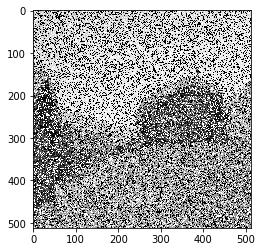

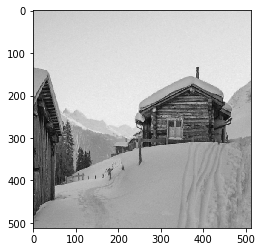

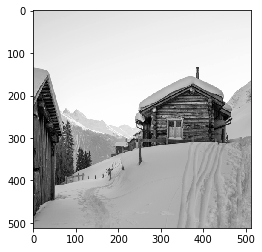

7.874676585197449
34.59280729293823
6.815310756755727
28.29222656701292
0.025405815512135707
0.8017670435845194


In [16]:
X_train = X_train.reshape(-1, 512, 512, 1)
result = model.predict(X_train, batch_size=1)
result = result.reshape(-1, 512, 512)
X_train = X_train.reshape(-1, 512, 512)
y_train = y_train.reshape(-1, 512, 512)
img = X_train[1]
plt.imshow(img, cmap="gray")
plt.show()
# show the image
img = result[1]
plt.imshow(img, cmap="gray")
plt.show()
img = y_train[1]
plt.imshow(img, cmap="gray")
plt.show()
print(PSNR(y_train[1], X_train[1]) )
print(PSNR(y_train[1], result[1]) )

totalPSNR = 0
for i in range(2800):
    totalPSNR += PSNR(y_train[i], X_train[i])
#print(totalPSNR)
print(totalPSNR / 2800)

totalPSNR = 0
for i in range(2800):
    totalPSNR += PSNR(y_train[i], result[i])
#print(totalPSNR)
print(totalPSNR / 2800)

totalSSIM = 0
for i in range(2800):
    totalSSIM += SSIM(y_train[i], X_train[i], 1.0, multichannel=True)
#print(totalSSIM)
print(totalSSIM / 2800)

totalSSIM = 0
for i in range(2800):
    totalSSIM += SSIM(y_train[i], result[i], 1.0, multichannel=True)
#print(totalSSIM)
print(totalSSIM / 2800)


In [14]:
_max = 0
count = 0
for i in range(1999, 2001):
    X_train = X_train.reshape(-1, 512, 512, 1)
    model = SRCNN("gan4/_generator_" + str(i) + "00.h5")
    result = model.predict(X_train[:16], batch_size=8)
    X_train = X_train.reshape(-1, 512, 512)
    result = result.reshape(-1, 512, 512)
    ytrain = y_train[:20].reshape(-1, 512, 512)
    psnr = 0
    for j in range(16):
        psnr += PSNR(ytrain[j], result[j]) 
    psnr /= 16
    print(psnr)
    if _max < psnr:
        _max = psnr
        count = i
    
print("")
print(_max, count)

28.014158457517624
27.79309257864952

28.014158457517624 1999
